In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime
import seaborn as sns
from prophet import Prophet
from prophet.diagnostics import cross_validation
import itertools
from prophet.diagnostics import performance_metrics

bus_data = pd.read_csv("municipality_bus_utilization.csv", parse_dates= ['timestamp'])

In [2]:
bus_data.isna().sum()

timestamp          0
municipality_id    0
usage              0
total_capacity     0
dtype: int64

In [3]:
bus_data1 = bus_data[(bus_data['municipality_id'] == 0)]

In [4]:
#bus_data1["usage"] = bus_data1[["usage", "total_capacity"]].max(axis=1)

In [5]:
bus_data1

,timestamp,municipality_id,usage,total_capacity
3,2017-06-04 07:59:42,0,204,2813
18,2017-06-04 08:25:42,0,247,2813
29,2017-06-04 08:59:42,0,332,2813
34,2017-06-04 09:32:46,0,429,2813
47,2017-06-04 09:59:48,0,485,2813
...,...,...,...,...
13024,2017-08-19 14:30:33,0,1285,2813
13031,2017-08-19 15:03:34,0,1283,2813
13041,2017-08-19 15:29:33,0,1286,2813
13059,2017-08-19 16:03:35,0,1276,2813


In [6]:
#bus_data1.plot( 'timestamp' , 'usage' )

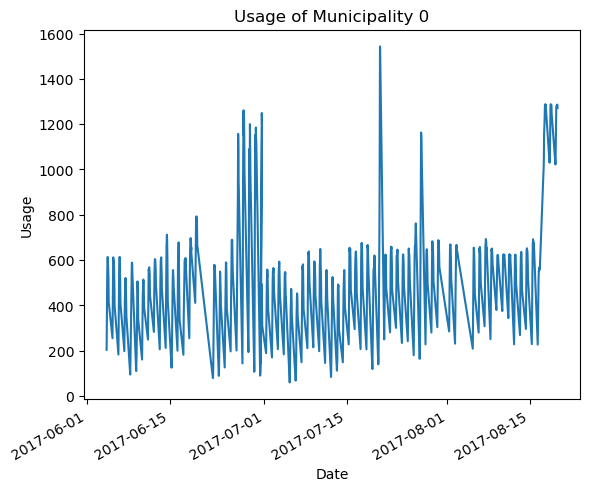

<Figure size 65000x200 with 0 Axes>

In [7]:
plt.plot(bus_data1.timestamp, bus_data1.usage)
plt.xticks(rotation=30, ha='right')
 
plt.title('Usage of Municipality 0')
 
plt.xlabel('Date')
plt.ylabel('Usage')
plt.figure(figsize=(650, 2))
plt.tight_layout()
plt.show()

In [8]:
tot_readings = 1307 # total number of rows in your df
# find max per hour:
records_per_dt = 2
max_values_per_dt = pd.DataFrame({}) # final data frame where to store maxs and times
for h in np.arange(0, tot_readings, records_per_dt):
    df_sliced = bus_data1[h:h+records_per_dt] # takes only minutes_per_dt rows starting from h
    tmp_max = pd.DataFrame(df_sliced.max()).transpose() # here you have a row with the time and the max values for the current hour analysed in the loop
    max_values_per_dt = max_values_per_dt.append(tmp_max) # append the maxs and the times into your final dataframe

/var/folders/v5/c3k3td4j2z19c3_jqh_f01_w0000gn/T/ipykernel_92901/1384802553.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_values_per_dt = max_values_per_dt.append(tmp_max) # append the maxs and the times into your final dataframe
/var/folders/v5/c3k3td4j2z19c3_jqh_f01_w0000gn/T/ipykernel_92901/1384802553.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_values_per_dt = max_values_per_dt.append(tmp_max) # append the maxs and the times into your final dataframe
/var/folders/v5/c3k3td4j2z19c3_jqh_f01_w0000gn/T/ipykernel_92901/1384802553.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_values_per_dt = max_values_per_dt.append(tmp_max) # append the maxs and the times into your final dataframe
/var/folders/

/var/folders/v5/c3k3td4j2z19c3_jqh_f01_w0000gn/T/ipykernel_92901/1384802553.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_values_per_dt = max_values_per_dt.append(tmp_max) # append the maxs and the times into your final dataframe
/var/folders/v5/c3k3td4j2z19c3_jqh_f01_w0000gn/T/ipykernel_92901/1384802553.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_values_per_dt = max_values_per_dt.append(tmp_max) # append the maxs and the times into your final dataframe
/var/folders/v5/c3k3td4j2z19c3_jqh_f01_w0000gn/T/ipykernel_92901/1384802553.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_values_per_dt = max_values_per_dt.append(tmp_max) # append the maxs and the times into your final dataframe
/var/folders/

/var/folders/v5/c3k3td4j2z19c3_jqh_f01_w0000gn/T/ipykernel_92901/1384802553.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_values_per_dt = max_values_per_dt.append(tmp_max) # append the maxs and the times into your final dataframe
/var/folders/v5/c3k3td4j2z19c3_jqh_f01_w0000gn/T/ipykernel_92901/1384802553.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_values_per_dt = max_values_per_dt.append(tmp_max) # append the maxs and the times into your final dataframe
/var/folders/v5/c3k3td4j2z19c3_jqh_f01_w0000gn/T/ipykernel_92901/1384802553.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_values_per_dt = max_values_per_dt.append(tmp_max) # append the maxs and the times into your final dataframe
/var/folders/

/var/folders/v5/c3k3td4j2z19c3_jqh_f01_w0000gn/T/ipykernel_92901/1384802553.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_values_per_dt = max_values_per_dt.append(tmp_max) # append the maxs and the times into your final dataframe
/var/folders/v5/c3k3td4j2z19c3_jqh_f01_w0000gn/T/ipykernel_92901/1384802553.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_values_per_dt = max_values_per_dt.append(tmp_max) # append the maxs and the times into your final dataframe
/var/folders/v5/c3k3td4j2z19c3_jqh_f01_w0000gn/T/ipykernel_92901/1384802553.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_values_per_dt = max_values_per_dt.append(tmp_max) # append the maxs and the times into your final dataframe
/var/folders/

/var/folders/v5/c3k3td4j2z19c3_jqh_f01_w0000gn/T/ipykernel_92901/1384802553.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_values_per_dt = max_values_per_dt.append(tmp_max) # append the maxs and the times into your final dataframe
/var/folders/v5/c3k3td4j2z19c3_jqh_f01_w0000gn/T/ipykernel_92901/1384802553.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_values_per_dt = max_values_per_dt.append(tmp_max) # append the maxs and the times into your final dataframe
/var/folders/v5/c3k3td4j2z19c3_jqh_f01_w0000gn/T/ipykernel_92901/1384802553.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_values_per_dt = max_values_per_dt.append(tmp_max) # append the maxs and the times into your final dataframe
/var/folders/

In [9]:
max_values_per_dt

,timestamp,municipality_id,usage,total_capacity
0,2017-06-04 08:25:42,0,247,2813
0,2017-06-04 09:32:46,0,429,2813
0,2017-06-04 10:26:49,0,534,2813
0,2017-06-04 11:25:47,0,597,2813
0,2017-06-04 12:29:45,0,614,2813
...,...,...,...,...
0,2017-08-19 13:03:30,0,1281,2813
0,2017-08-19 14:03:31,0,1283,2813
0,2017-08-19 15:03:34,0,1285,2813
0,2017-08-19 16:03:35,0,1286,2813


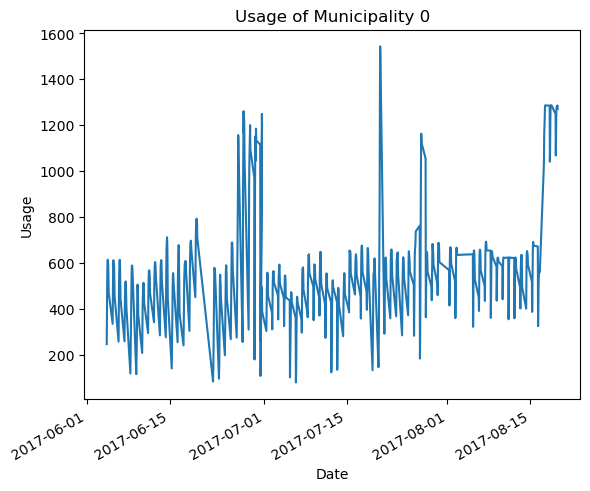

<Figure size 600x100 with 0 Axes>

In [10]:
plt.plot(max_values_per_dt.timestamp, max_values_per_dt.usage)
plt.xticks(rotation=30, ha='right')
 
plt.title('Usage of Municipality 0')
 
plt.xlabel('Date')
plt.ylabel('Usage')
plt.figure(figsize=(6, 1))
plt.tight_layout()
plt.show()

In [12]:
max_values_per_dt['timestamp'] =  pd.to_datetime(max_values_per_dt['timestamp'], format='%Y-%m-%d %H:%M:%S', errors='coerce')

In [13]:
max_values_per_dt.dtypes

timestamp          datetime64[ns]
municipality_id            object
usage                      object
total_capacity             object
dtype: object

In [14]:
max_values_per_dt.isna().sum()

timestamp          0
municipality_id    0
usage              0
total_capacity     0
dtype: int64

In [16]:
max_values_per_dt.isna().sum()

timestamp          0
municipality_id    0
usage              0
total_capacity     0
dtype: int64

In [17]:
max_values_per_dt['year']=max_values_per_dt.timestamp.dt.year
max_values_per_dt['month']=max_values_per_dt.timestamp.dt.month 
max_values_per_dt['day']=max_values_per_dt.timestamp.dt.day    
max_values_per_dt['Hour']=max_values_per_dt.timestamp.dt.hour

In [18]:
def applyer(row):
    if row.dayofweek == 5 or row.dayofweek == 6:
        return 1
    else:
        return 0
temp2 = max_values_per_dt['timestamp'].apply(applyer) 
max_values_per_dt['weekend']=temp2

/var/folders/v5/c3k3td4j2z19c3_jqh_f01_w0000gn/T/ipykernel_92901/3832194338.py:2: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  df=max_values_per_dt.drop('municipality_id',1)


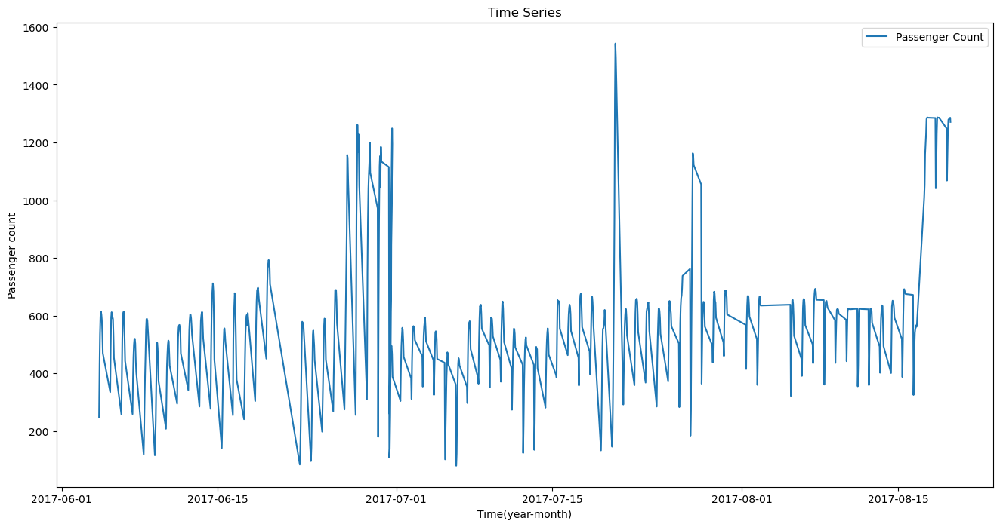

In [19]:
max_values_per_dt.index = max_values_per_dt['timestamp'] 
df=max_values_per_dt.drop('municipality_id',1) 
ts = df['usage'] 
plt.figure(figsize=(16,8)) 
plt.plot(ts, label='Passenger Count') 
plt.title('Time Series') 
plt.xlabel("Time(year-month)") 
plt.ylabel("Passenger count") 
plt.legend(loc='best')

In [20]:
def create_features(df, label=None):
    """
    Creates time series features from datetime index.
    """
    df = df.copy()
    df['timestamp'] = df.index
    print(max_values_per_dt.dtypes)
    df['hour'] = df['timestamp'].dt.hour
    df['dayofweek'] = df['timestamp'].dt.dayofweek
    df['quarter'] = df['timestamp'].dt.quarter
    df['month'] = df['timestamp'].dt.month
    df['year'] = df['timestamp'].dt.year
    df['dayofyear'] = df['timestamp'].dt.dayofyear
    df['dayofmonth'] = df['timestamp'].dt.day
    df['weekofyear'] = df['timestamp'].dt.weekofyear
    
    X = df[['hour','dayofweek','quarter','month','year',
           'dayofyear','dayofmonth','weekofyear']]
    if label:
        y = df[label]
        return X, y
    return X

X, y = create_features(max_values_per_dt, label='usage')

features_and_target = pd.concat([X, y], axis=1)

timestamp          datetime64[ns]
municipality_id            object
usage                      object
total_capacity             object
year                        int64
month                       int64
day                         int64
Hour                        int64
weekend                     int64
dtype: object


/var/folders/v5/c3k3td4j2z19c3_jqh_f01_w0000gn/T/ipykernel_92901/3592538035.py:15: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  df['weekofyear'] = df['timestamp'].dt.weekofyear


In [21]:
max_values_per_dt

,timestamp,municipality_id,usage,total_capacity,year,month,day,Hour,weekend
timestamp,,,,,,,,,
2017-06-04 08:25:42,2017-06-04 08:25:42,0,247,2813,2017,6,4,8,1
2017-06-04 09:32:46,2017-06-04 09:32:46,0,429,2813,2017,6,4,9,1
2017-06-04 10:26:49,2017-06-04 10:26:49,0,534,2813,2017,6,4,10,1
2017-06-04 11:25:47,2017-06-04 11:25:47,0,597,2813,2017,6,4,11,1
2017-06-04 12:29:45,2017-06-04 12:29:45,0,614,2813,2017,6,4,12,1
...,...,...,...,...,...,...,...,...,...
2017-08-19 13:03:30,2017-08-19 13:03:30,0,1281,2813,2017,8,19,13,1
2017-08-19 14:03:31,2017-08-19 14:03:31,0,1283,2813,2017,8,19,14,1
2017-08-19 15:03:34,2017-08-19 15:03:34,0,1285,2813,2017,8,19,15,1


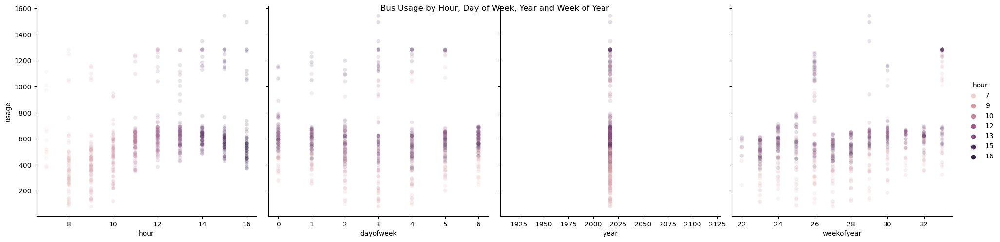

In [22]:
sns.pairplot(features_and_target.dropna(),
             hue='hour',
             x_vars=['hour','dayofweek',
                     'year','weekofyear'],
             y_vars='usage',
             height=5,
             plot_kws={'alpha':0.15, 'linewidth':0}
            )
plt.suptitle('Bus Usage by Hour, Day of Week, Year and Week of Year')
plt.show()

In [23]:
split_date = '2017-08-01 00:00:00'
municipality_train = max_values_per_dt.loc[max_values_per_dt.index <= split_date].copy()
municipality_test = max_values_per_dt.loc[max_values_per_dt.index > split_date].copy()

In [24]:
municipality_train = municipality_train.drop(['timestamp', 'total_capacity', 'year', 'month', 'day', 'Hour', 'weekend', 'municipality_id'], axis=1)
municipality_test = municipality_test.drop(['timestamp', 'total_capacity', 'year', 'month', 'day', 'Hour', 'weekend', 'municipality_id'], axis=1)

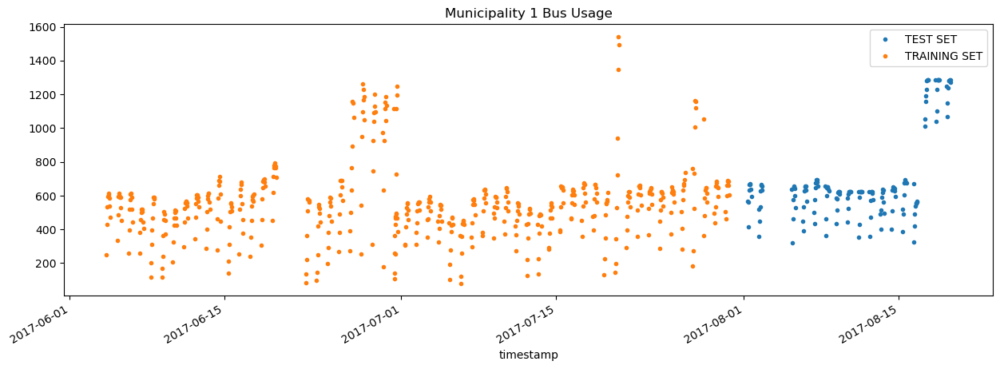

In [25]:
# Plotting train and test so we can see where we have split
municipality_test \
    .rename(columns={'usage': 'TEST SET'}) \
    .join(municipality_train.rename(columns={'usage': 'TRAINING SET'}),
          how='outer') \
    .plot(figsize=(15,5), title='Municipality 1 Bus Usage', style='.')
plt.show()

In [26]:
# Format data for prophet model using ds and y since Prophet expects the dataset to be named in a specific way
municipality_train.reset_index() \
    .rename(columns={'timestamp':'ds',
                     'usage':'y'}).head()

,ds,y
0,2017-06-04 08:25:42,247
1,2017-06-04 09:32:46,429
2,2017-06-04 10:26:49,534
3,2017-06-04 11:25:47,597
4,2017-06-04 12:29:45,614


In [27]:
# Setting up and training model and fitting
model = Prophet()
model.fit(municipality_train.reset_index() \
              .rename(columns={'timestamp':'ds',
                               'usage':'y'}))

# Predicting on training set with model
municipality_test_fcst = model.predict(df=municipality_test.reset_index() \
                                   .rename(columns={'timestamp':'ds'}))

21:15:08 - cmdstanpy - INFO - Chain [1] start processing
21:15:08 - cmdstanpy - INFO - Chain [1] done processing


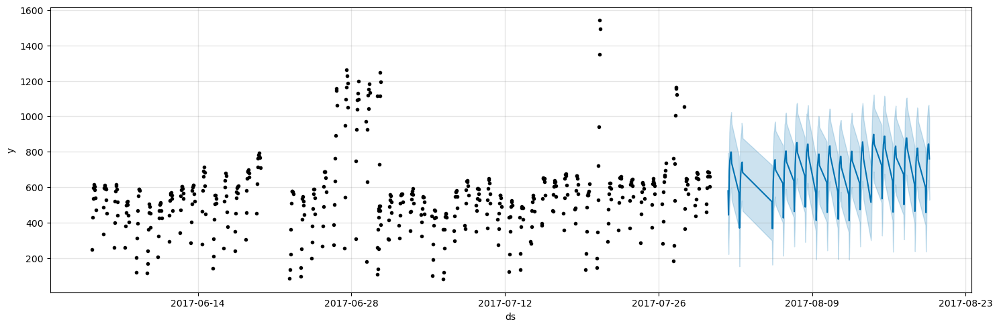

In [28]:
# Plotting the forecast
f, ax = plt.subplots(1)
f.set_figheight(5)
f.set_figwidth(15)
fig = model.plot(municipality_test_fcst,
                 ax=ax)
plt.show()

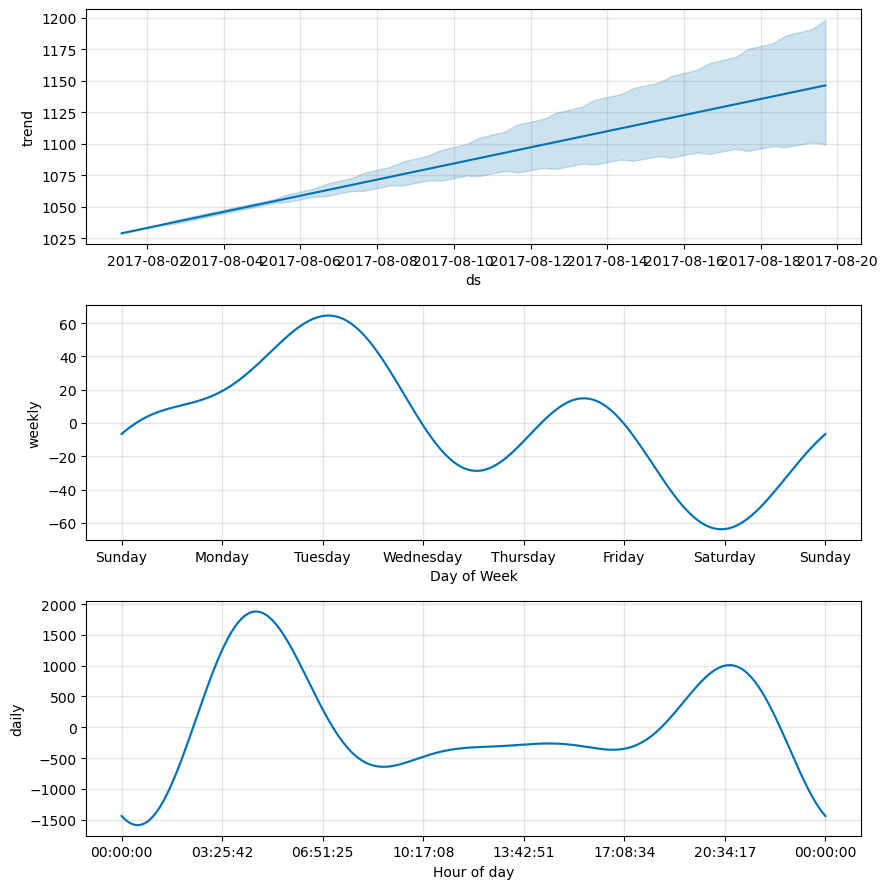

In [29]:
# Plotting the components of the model
fig = model.plot_components(municipality_test_fcst)

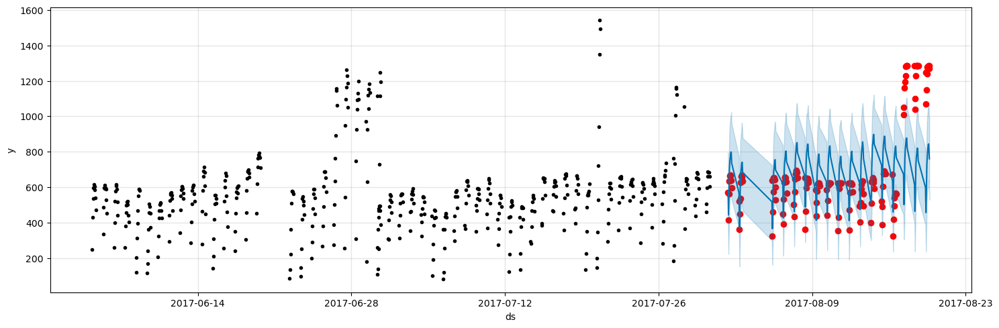

In [30]:
# Plot the forecast with the actuals
f, ax = plt.subplots(1)
f.set_figheight(5)
f.set_figwidth(15)
ax.scatter(municipality_test.index, municipality_test['usage'], color='r')
fig = model.plot(municipality_test_fcst, ax=ax)

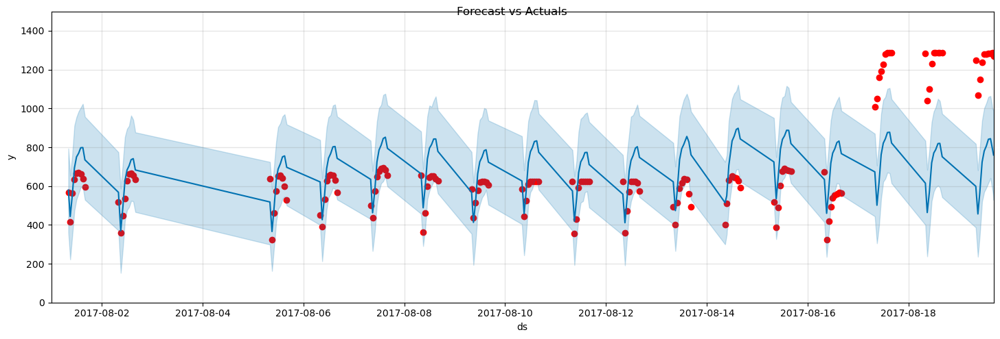

In [31]:
f, ax = plt.subplots(1)
f.set_figheight(5)
f.set_figwidth(15)
ax.scatter(municipality_test.index, municipality_test['usage'], color='r')
fig = model.plot(municipality_test_fcst, ax=ax)
ax.set_xbound(lower='2017-08-01 00:00:00', upper='2017-08-19 16:30:35')
ax.set_ylim(0, 1500)
plot = plt.suptitle('Forecast vs Actuals')

In [32]:
def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

print("MAPE of the Forecast(%): ", mean_absolute_percentage_error(y_true=municipality_test['usage'],
                   y_pred=municipality_test_fcst['yhat']))

MAPE of the Forecast(%):  24.944178992527792


In [33]:
param_grid = {  
    'changepoint_prior_scale': [0.001, 0.01, 0.1, 0.5, 1.0],
    'seasonality_prior_scale': [0.01, 0.1, 1.0, 10.0],
    'holidays_prior_scale': [0.01, 0.1, 1.0, 10.0],
    'seasonality_mode': ['additive', 'multiplicative']
}
mapes = []

# Generate all combinations of parameters
all_params = [dict(zip(param_grid.keys(), v)) for v in itertools.product(*param_grid.values())]

for params in all_params:
    m = Prophet(**params).fit(municipality_train.reset_index() \
              .rename(columns={'timestamp':'ds',
                               'usage':'y'}))  # Fit model with given params
    df_cv = cross_validation(m, horizon='1 hour', parallel="processes")
    df_p = performance_metrics(df_cv, rolling_window=1)
    mapes.append(df_p['mape'].values[0])

# Find the best parameters
tuning_results = pd.DataFrame(all_params)
tuning_results['mape'] = mapes
print(tuning_results)

21:15:09 - cmdstanpy - INFO - Chain [1] start processing
21:15:09 - cmdstanpy - INFO - Chain [1] done processing
21:15:17 - cmdstanpy - INFO - Chain [1] start processing
21:15:17 - cmdstanpy - INFO - Chain [1] start processing
21:15:17 - cmdstanpy - INFO - Chain [1] start processing
21:15:17 - cmdstanpy - INFO - Chain [1] start processing
21:15:17 - cmdstanpy - INFO - Chain [1] start processing
21:15:17 - cmdstanpy - INFO - Chain [1] start processing
21:15:17 - cmdstanpy - INFO - Chain [1] start processing
21:15:17 - cmdstanpy - INFO - Chain [1] start processing
21:15:17 - cmdstanpy - INFO - Chain [1] done processing
21:15:17 - cmdstanpy - INFO - Chain [1] done processing
21:15:17 - cmdstanpy - INFO - Chain [1] done processing
21:15:17 - cmdstanpy - INFO - Chain [1] done processing
21:15:17 - cmdstanpy - INFO - Chain [1] start processing
21:15:17 - cmdstanpy - INFO - Chain [1] start processing
21:15:17 - cmdstanpy - INFO - Chain [1] start processing
21:15:17 - cmdstanpy - INFO - Chain 

21:15:27 - cmdstanpy - INFO - Chain [1] start processing
21:15:27 - cmdstanpy - INFO - Chain [1] done processing
21:15:27 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:15:27 - cmdstanpy - INFO - Chain [1] start processing
21:15:27 - cmdstanpy - INFO - Chain [1] done processing
21:15:27 - cmdstanpy - INFO - Chain [1] start processing
21:15:27 - cmdstanpy - INFO - Chain [1] done processing
21:15:27 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:15:27 - cmdstanpy - INFO - Chain [1] start processing
21:15:27 - cmdstanpy - INFO - Chain [1] done processing
21:15:27 - cmdstanpy - INFO - Chain [1] done processing
21:15:27 - cmdstanpy - INFO - Chain [1] start processing
21:15:27 - cmdstanpy - INFO - Chain [1] done processing
21:15:27 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:15:30 - cmdstanpy - INFO - Chain [1] start processing
21:15:30 - cmdstanpy - INFO - Chain [1] start processing
21:15:30 - cmdstanpy - INFO - Chain [1] done processing
21:15:30 - cmdstanpy - INFO - Chain [1] done processing
21:15:30 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:15:30 - cmdstanpy - INFO - Chain [1] start processing
21:15:30 - cmdstanpy - INFO - Chain [1] done processing
21:15:30 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:15:30 - cmdstanpy - INFO - Chain [1] start processing
21:15:30 - cmdstanpy - INFO - Chain [1] done processing
21:15:30 - cmdstanpy - INFO - Chain [1] start processing
21:15:30 - cmdstanpy - INFO - Chain [1] done processing
21:15:30 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:15:32 - cmdstanpy - INFO - Chain [1] done processing
21:15:32 - cmdstanpy - INFO - Chain [1] done processing
21:15:32 - cmdstanpy - INFO - Chain [1] done processing
21:15:32 - cmdstanpy - INFO - Chain [1] done processing
21:15:32 - cmdstanpy - INFO - Chain [1] start processing
21:15:32 - cmdstanpy - INFO - Chain [1] start processing
21:15:32 - cmdstanpy - INFO - Chain [1] done processing
21:15:32 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:15:32 - cmdstanpy - INFO - Chain [1] done processing
21:15:32 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:15:32 - cmdstanpy - INFO - Chain [1] start processing
21:15:32 - cmdstanpy - INFO - Chain [1] start processing
21:15:32 - cmdstanpy - INFO - Chain [1] start processing
21:15:32 - cmdstanpy - INFO - Chain [1] done processing
21:15:32 - cmds

21:15:38 - cmdstanpy - INFO - Chain [1] done processing
21:15:38 - cmdstanpy - INFO - Chain [1] start processing
21:15:38 - cmdstanpy - INFO - Chain [1] done processing
21:15:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:15:38 - cmdstanpy - INFO - Chain [1] start processing
21:15:38 - cmdstanpy - INFO - Chain [1] done processing
21:15:38 - cmdstanpy - INFO - Chain [1] start processing
21:15:38 - cmdstanpy - INFO - Chain [1] done processing
21:15:38 - cmdstanpy - INFO - Chain [1] done processing
21:15:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:15:38 - cmdstanpy - INFO - Chain [1] done processing
21:15:38 - cmdstanpy - INFO - Chain [1] start processing
21:15:38 - cmdstanpy - INFO - Chain [1] done processing
21:15:38 - cmdstanpy - INFO - Chain [1] start processing
21:15:38 - cmds

21:15:42 - cmdstanpy - INFO - Chain [1] start processing
21:15:42 - cmdstanpy - INFO - Chain [1] done processing
21:15:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:15:42 - cmdstanpy - INFO - Chain [1] done processing
21:15:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:15:42 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:15:42 - cmdstanpy - INFO - Chain [1] start processing
21:15:42 - cmdstanpy - INFO - Chain [1] done processing
21:15:42 - cmdstanpy - INFO - Chain [1] done processing
21:15:42 - cmdstanpy - INFO - Chain [1] done processing
21:15:42 - cmdstanpy - INFO - Chain [1] start processing
21:15:42 - cmdstanpy - INFO - Chain [1] done processing
21:15:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally

21:15:47 - cmdstanpy - INFO - Chain [1] done processing
21:15:47 - cmdstanpy - INFO - Chain [1] done processing
21:15:47 - cmdstanpy - INFO - Chain [1] done processing
21:15:47 - cmdstanpy - INFO - Chain [1] start processing
21:15:47 - cmdstanpy - INFO - Chain [1] start processing
21:15:47 - cmdstanpy - INFO - Chain [1] done processing
21:15:47 - cmdstanpy - INFO - Chain [1] done processing
21:15:47 - cmdstanpy - INFO - Chain [1] done processing
21:15:47 - cmdstanpy - INFO - Chain [1] start processing
21:15:47 - cmdstanpy - INFO - Chain [1] done processing
21:15:47 - cmdstanpy - INFO - Chain [1] start processing
21:15:47 - cmdstanpy - INFO - Chain [1] start processing
21:15:47 - cmdstanpy - INFO - Chain [1] done processing
21:15:47 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:15:47 - cmdstanpy - INFO - Chain [1] start processing
21:15:47 - cmdstanpy - INFO - Chain [1] done processing


21:15:50 - cmdstanpy - INFO - Chain [1] start processing
21:15:50 - cmdstanpy - INFO - Chain [1] done processing
21:15:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:15:50 - cmdstanpy - INFO - Chain [1] start processing
21:15:50 - cmdstanpy - INFO - Chain [1] done processing
21:15:50 - cmdstanpy - INFO - Chain [1] start processing
21:15:50 - cmdstanpy - INFO - Chain [1] done processing
21:15:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:15:50 - cmdstanpy - INFO - Chain [1] start processing
21:15:50 - cmdstanpy - INFO - Chain [1] done processing
21:15:50 - cmdstanpy - INFO - Chain [1] done processing
21:15:50 - cmdstanpy - INFO - Chain [1] done processing
21:15:50 - cmdstanpy - INFO - Chain [1] done processing
21:15:50 - cmdstanpy - INFO - Chain [1] start processing
21:15:51 - cmds

21:15:54 - cmdstanpy - INFO - Chain [1] done processing
21:15:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:15:54 - cmdstanpy - INFO - Chain [1] start processing
21:15:54 - cmdstanpy - INFO - Chain [1] done processing
21:15:55 - cmdstanpy - INFO - Chain [1] start processing
21:15:55 - cmdstanpy - INFO - Chain [1] done processing
21:15:55 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:15:55 - cmdstanpy - INFO - Chain [1] start processing
21:15:55 - cmdstanpy - INFO - Chain [1] done processing
21:15:55 - cmdstanpy - INFO - Chain [1] start processing
21:15:55 - cmdstanpy - INFO - Chain [1] done processing
21:15:55 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:15:55 - cmdstanpy - INFO - 

21:15:58 - cmdstanpy - INFO - Chain [1] done processing
21:15:59 - cmdstanpy - INFO - Chain [1] start processing
21:15:59 - cmdstanpy - INFO - Chain [1] done processing
21:15:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:15:59 - cmdstanpy - INFO - Chain [1] start processing
21:15:59 - cmdstanpy - INFO - Chain [1] done processing
21:15:59 - cmdstanpy - INFO - Chain [1] start processing
21:15:59 - cmdstanpy - INFO - Chain [1] done processing
21:15:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:15:59 - cmdstanpy - INFO - Chain [1] start processing
21:15:59 - cmdstanpy - INFO - Chain [1] done processing
21:15:59 - cmdstanpy - INFO - Chain [1] done processing
21:15:59 - cmdstanpy - INFO - Chain [1] done processing
21:15:59 - cmdstanpy - INFO - Chain [1] start processing
21:15:59 - cmds

21:16:03 - cmdstanpy - INFO - Chain [1] done processing
21:16:03 - cmdstanpy - INFO - Chain [1] start processing
21:16:03 - cmdstanpy - INFO - Chain [1] done processing
21:16:03 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:16:03 - cmdstanpy - INFO - Chain [1] start processing
21:16:03 - cmdstanpy - INFO - Chain [1] done processing
21:16:03 - cmdstanpy - INFO - Chain [1] start processing
21:16:03 - cmdstanpy - INFO - Chain [1] done processing
21:16:03 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:16:03 - cmdstanpy - INFO - Chain [1] start processing
21:16:03 - cmdstanpy - INFO - Chain [1] start processing
21:16:03 - cmdstanpy - INFO - Chain [1] done processing
21:16:03 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:16:07 - cmdstanpy - INFO - Chain [1] start processing
21:16:07 - cmdstanpy - INFO - Chain [1] done processing
21:16:07 - cmdstanpy - INFO - Chain [1] done processing
21:16:07 - cmdstanpy - INFO - Chain [1] done processing
21:16:07 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:16:07 - cmdstanpy - INFO - Chain [1] done processing
21:16:07 - cmdstanpy - INFO - Chain [1] start processing
21:16:07 - cmdstanpy - INFO - Chain [1] start processing
21:16:07 - cmdstanpy - INFO - Chain [1] done processing
21:16:07 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:16:07 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:16:07 - cmdstanpy - INFO - Chain [1] start processing
21:16:07 - cmdstanpy - INFO - Chain [1] start processing
21:16:07 - cmdstanpy - INFO - Chain [1] done processing
21:16:07 - cmd

21:16:10 - cmdstanpy - INFO - Chain [1] done processing
21:16:11 - cmdstanpy - INFO - Chain [1] done processing
21:16:11 - cmdstanpy - INFO - Chain [1] start processing
21:16:11 - cmdstanpy - INFO - Chain [1] done processing
21:16:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:16:11 - cmdstanpy - INFO - Chain [1] start processing
21:16:11 - cmdstanpy - INFO - Chain [1] start processing
21:16:11 - cmdstanpy - INFO - Chain [1] done processing
21:16:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:16:11 - cmdstanpy - INFO - Chain [1] done processing
21:16:11 - cmdstanpy - INFO - Chain [1] done processing
21:16:11 - cmdstanpy - INFO - Chain [1] start processing
21:16:11 - cmdstanpy - INFO - Chain [1] done processing
21:16:11 - cmdstanpy - INFO - Chain [1] start processing
21:16:11 - cmds

21:16:15 - cmdstanpy - INFO - Chain [1] start processing
21:16:15 - cmdstanpy - INFO - Chain [1] done processing
21:16:15 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:16:15 - cmdstanpy - INFO - Chain [1] start processing
21:16:15 - cmdstanpy - INFO - Chain [1] done processing
21:16:15 - cmdstanpy - INFO - Chain [1] done processing
21:16:15 - cmdstanpy - INFO - Chain [1] done processing
21:16:15 - cmdstanpy - INFO - Chain [1] start processing
21:16:15 - cmdstanpy - INFO - Chain [1] done processing
21:16:15 - cmdstanpy - INFO - Chain [1] done processing
21:16:15 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:16:15 - cmdstanpy - INFO - Chain [1] start processing
21:16:15 - cmdstanpy - INFO - Chain [1] start processing
21:16:15 - cmdstanpy - INFO - Chain [1] done processing
21:16:15 - cmds

21:16:18 - cmdstanpy - INFO - Chain [1] start processing
21:16:18 - cmdstanpy - INFO - Chain [1] start processing
21:16:18 - cmdstanpy - INFO - Chain [1] done processing
21:16:18 - cmdstanpy - INFO - Chain [1] start processing
21:16:18 - cmdstanpy - INFO - Chain [1] done processing
21:16:19 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:16:19 - cmdstanpy - INFO - Chain [1] start processing
21:16:19 - cmdstanpy - INFO - Chain [1] done processing
21:16:19 - cmdstanpy - INFO - Chain [1] done processing
21:16:19 - cmdstanpy - INFO - Chain [1] start processing
21:16:19 - cmdstanpy - INFO - Chain [1] start processing
21:16:19 - cmdstanpy - INFO - Chain [1] done processing
21:16:19 - cmdstanpy - INFO - Chain [1] done processing
21:16:19 - cmdstanpy - INFO - Chain [1] done processing
21:16:19 - cmdstanpy - INFO - Chain [1] done processing
21:16:19 - cmdstanpy - INFO - Chain [1] start processing

21:16:22 - cmdstanpy - INFO - Chain [1] done processing
21:16:22 - cmdstanpy - INFO - Chain [1] done processing
21:16:22 - cmdstanpy - INFO - Chain [1] done processing
21:16:23 - cmdstanpy - INFO - Chain [1] done processing
21:16:23 - cmdstanpy - INFO - Chain [1] start processing
21:16:23 - cmdstanpy - INFO - Chain [1] start processing
21:16:23 - cmdstanpy - INFO - Chain [1] start processing
21:16:23 - cmdstanpy - INFO - Chain [1] done processing
21:16:23 - cmdstanpy - INFO - Chain [1] done processing
21:16:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:16:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:16:23 - cmdstanpy - INFO - Chain [1] done processing
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:16:23 - cmdstanpy - INFO - Chain [1] start processing
21:16:23 - cmdstanpy - INFO - Chain [1] start processing
21:16:23 - cmds

21:16:27 - cmdstanpy - INFO - Chain [1] done processing
21:16:27 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:16:28 - cmdstanpy - INFO - Chain [1] done processing
21:16:28 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:16:28 - cmdstanpy - INFO - Chain [1] done processing
21:16:28 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:16:28 - cmdstanpy - INFO - Chain [1] start processing
21:16:28 - cmdstanpy - INFO - Chain [1] start processing
21:16:28 - cmdstanpy - INFO - Chain [1] start processing
21:16:28 - cmdstanpy - INFO - Chain [1] start processing
21:16:28 - cmdstanpy - INFO - Chain [1] start processing
21:16:28 - cmdstanpy - INFO - Chain [1] done processing
21:16:28 - cmdstanpy - ERROR 

21:16:32 - cmdstanpy - INFO - Chain [1] done processing
21:16:32 - cmdstanpy - INFO - Chain [1] start processing
21:16:32 - cmdstanpy - INFO - Chain [1] start processing
21:16:32 - cmdstanpy - INFO - Chain [1] done processing
21:16:32 - cmdstanpy - INFO - Chain [1] done processing
21:16:32 - cmdstanpy - INFO - Chain [1] start processing
21:16:32 - cmdstanpy - INFO - Chain [1] done processing
21:16:32 - cmdstanpy - INFO - Chain [1] start processing
21:16:32 - cmdstanpy - INFO - Chain [1] done processing
21:16:32 - cmdstanpy - INFO - Chain [1] done processing
21:16:32 - cmdstanpy - INFO - Chain [1] start processing
21:16:32 - cmdstanpy - INFO - Chain [1] start processing
21:16:32 - cmdstanpy - INFO - Chain [1] done processing
21:16:32 - cmdstanpy - INFO - Chain [1] start processing
21:16:33 - cmdstanpy - INFO - Chain [1] done processing
21:16:33 - cmdstanpy - INFO - Chain [1] start processing
21:16:33 - cmdstanpy - INFO - Chain [1] done processing
21:16:33 - cmdstanpy - ERROR - Chain [1]

21:16:36 - cmdstanpy - INFO - Chain [1] start processing
21:16:36 - cmdstanpy - INFO - Chain [1] start processing
21:16:36 - cmdstanpy - INFO - Chain [1] done processing
21:16:36 - cmdstanpy - INFO - Chain [1] done processing
21:16:36 - cmdstanpy - INFO - Chain [1] start processing
21:16:36 - cmdstanpy - INFO - Chain [1] done processing
21:16:36 - cmdstanpy - INFO - Chain [1] start processing
21:16:36 - cmdstanpy - INFO - Chain [1] done processing
21:16:36 - cmdstanpy - INFO - Chain [1] start processing
21:16:36 - cmdstanpy - INFO - Chain [1] done processing
21:16:36 - cmdstanpy - INFO - Chain [1] start processing
21:16:36 - cmdstanpy - INFO - Chain [1] done processing
21:16:37 - cmdstanpy - INFO - Chain [1] start processing
21:16:37 - cmdstanpy - INFO - Chain [1] done processing
21:16:37 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:16:37 - cmdstanpy - INFO - Chain [1] start processin

21:16:41 - cmdstanpy - INFO - Chain [1] done processing
21:16:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:16:41 - cmdstanpy - INFO - Chain [1] start processing
21:16:41 - cmdstanpy - INFO - Chain [1] done processing
21:16:41 - cmdstanpy - INFO - Chain [1] start processing
21:16:41 - cmdstanpy - INFO - Chain [1] done processing
21:16:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:16:41 - cmdstanpy - INFO - Chain [1] start processing
21:16:41 - cmdstanpy - INFO - Chain [1] start processing
21:16:41 - cmdstanpy - INFO - Chain [1] done processing
21:16:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:16:41 - cmdstanpy - INFO - Chain [1] start processing
21:16:42 - cmdstanpy - INFO -

21:16:46 - cmdstanpy - INFO - Chain [1] start processing
21:16:46 - cmdstanpy - INFO - Chain [1] start processing
21:16:46 - cmdstanpy - INFO - Chain [1] start processing
21:16:46 - cmdstanpy - INFO - Chain [1] done processing
21:16:46 - cmdstanpy - INFO - Chain [1] done processing
21:16:46 - cmdstanpy - INFO - Chain [1] done processing
21:16:46 - cmdstanpy - INFO - Chain [1] start processing
21:16:46 - cmdstanpy - INFO - Chain [1] start processing
21:16:46 - cmdstanpy - INFO - Chain [1] start processing
21:16:46 - cmdstanpy - INFO - Chain [1] done processing
21:16:46 - cmdstanpy - INFO - Chain [1] done processing
21:16:46 - cmdstanpy - INFO - Chain [1] done processing
21:16:47 - cmdstanpy - INFO - Chain [1] start processing
21:16:47 - cmdstanpy - INFO - Chain [1] start processing
21:16:47 - cmdstanpy - INFO - Chain [1] start processing
21:16:47 - cmdstanpy - INFO - Chain [1] done processing
21:16:47 - cmdstanpy - INFO - Chain [1] done processing
21:16:47 - cmdstanpy - INFO - Chain [1]

21:16:52 - cmdstanpy - INFO - Chain [1] done processing
21:16:52 - cmdstanpy - INFO - Chain [1] done processing
21:16:53 - cmdstanpy - INFO - Chain [1] start processing
21:16:53 - cmdstanpy - INFO - Chain [1] done processing
21:16:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:16:53 - cmdstanpy - INFO - Chain [1] start processing
21:16:53 - cmdstanpy - INFO - Chain [1] start processing
21:16:53 - cmdstanpy - INFO - Chain [1] done processing
21:16:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:16:53 - cmdstanpy - INFO - Chain [1] start processing
21:16:53 - cmdstanpy - INFO - Chain [1] done processing
21:16:53 - cmdstanpy - INFO - Chain [1] done processing
21:16:53 - cmdstanpy - INFO - Chain [1] start processing
21:16:53 - cmdstanpy - INFO - Chain [1] done processing
21:16:53 - cmds

21:16:59 - cmdstanpy - INFO - Chain [1] start processing
21:16:59 - cmdstanpy - INFO - Chain [1] done processing
21:16:59 - cmdstanpy - INFO - Chain [1] done processing
21:16:59 - cmdstanpy - INFO - Chain [1] start processing
21:16:59 - cmdstanpy - INFO - Chain [1] start processing
21:16:59 - cmdstanpy - INFO - Chain [1] start processing
21:16:59 - cmdstanpy - INFO - Chain [1] done processing
21:16:59 - cmdstanpy - INFO - Chain [1] start processing
21:16:59 - cmdstanpy - INFO - Chain [1] done processing
21:16:59 - cmdstanpy - INFO - Chain [1] done processing
21:16:59 - cmdstanpy - INFO - Chain [1] start processing
21:16:59 - cmdstanpy - INFO - Chain [1] done processing
21:16:59 - cmdstanpy - INFO - Chain [1] done processing
21:17:00 - cmdstanpy - INFO - Chain [1] done processing
21:17:00 - cmdstanpy - INFO - Chain [1] done processing
21:17:00 - cmdstanpy - INFO - Chain [1] start processing
21:17:00 - cmdstanpy - INFO - Chain [1] done processing
21:17:08 - cmdstanpy - INFO - Chain [1] s

21:17:17 - cmdstanpy - INFO - Chain [1] done processing
21:17:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:17:17 - cmdstanpy - INFO - Chain [1] start processing
21:17:17 - cmdstanpy - INFO - Chain [1] start processing
21:17:17 - cmdstanpy - INFO - Chain [1] done processing
21:17:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:17:17 - cmdstanpy - INFO - Chain [1] start processing
21:17:17 - cmdstanpy - INFO - Chain [1] done processing
21:17:17 - cmdstanpy - INFO - Chain [1] done processing
21:17:17 - cmdstanpy - INFO - Chain [1] start processing
21:17:17 - cmdstanpy - INFO - Chain [1] done processing
21:17:17 - cmdstanpy - INFO - Chain [1] start processing
21:17:17 - cmdstanpy - INFO - Chain [1] done processing
21:17:17 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:17:19 - cmdstanpy - INFO - Chain [1] done processing
21:17:19 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:17:19 - cmdstanpy - INFO - Chain [1] start processing
21:17:20 - cmdstanpy - INFO - Chain [1] done processing
21:17:20 - cmdstanpy - INFO - Chain [1] done processing
21:17:20 - cmdstanpy - INFO - Chain [1] start processing
21:17:20 - cmdstanpy - INFO - Chain [1] done processing
21:17:20 - cmdstanpy - INFO - Chain [1] done processing
21:17:20 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:17:20 - cmdstanpy - INFO - Chain [1] start processing
21:17:20 - cmdstanpy - INFO - Chain [1] start processing
21:17:20 - cmdstanpy - INFO - Chain [1] done processing
21:17:20 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally

21:17:23 - cmdstanpy - INFO - Chain [1] start processing
21:17:23 - cmdstanpy - INFO - Chain [1] done processing
21:17:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:17:23 - cmdstanpy - INFO - Chain [1] start processing
21:17:23 - cmdstanpy - INFO - Chain [1] start processing
21:17:23 - cmdstanpy - INFO - Chain [1] done processing
21:17:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:17:23 - cmdstanpy - INFO - Chain [1] start processing
21:17:23 - cmdstanpy - INFO - Chain [1] done processing
21:17:23 - cmdstanpy - INFO - Chain [1] done processing
21:17:23 - cmdstanpy - INFO - Chain [1] done processing
21:17:23 - cmdstanpy - INFO - Chain [1] done processing
21:17:23 - cmdstanpy - INFO - Chain [1] start processing
21:17:23 - cmdstanpy - INFO - Chain [1] start processing
21:17:23 - cmd

21:17:27 - cmdstanpy - INFO - Chain [1] done processing
21:17:27 - cmdstanpy - INFO - Chain [1] start processing
21:17:27 - cmdstanpy - INFO - Chain [1] done processing
21:17:27 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:17:27 - cmdstanpy - INFO - Chain [1] start processing
21:17:27 - cmdstanpy - INFO - Chain [1] done processing
21:17:27 - cmdstanpy - INFO - Chain [1] done processing
21:17:27 - cmdstanpy - INFO - Chain [1] done processing
21:17:28 - cmdstanpy - INFO - Chain [1] done processing
21:17:28 - cmdstanpy - INFO - Chain [1] start processing
21:17:28 - cmdstanpy - INFO - Chain [1] start processing
21:17:28 - cmdstanpy - INFO - Chain [1] done processing
21:17:28 - cmdstanpy - INFO - Chain [1] done processing
21:17:28 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:17:28 - cmdst

21:17:30 - cmdstanpy - INFO - Chain [1] done processing
21:17:30 - cmdstanpy - INFO - Chain [1] start processing
21:17:30 - cmdstanpy - INFO - Chain [1] done processing
21:17:30 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:17:30 - cmdstanpy - INFO - Chain [1] start processing
21:17:30 - cmdstanpy - INFO - Chain [1] start processing
21:17:30 - cmdstanpy - INFO - Chain [1] done processing
21:17:30 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:17:30 - cmdstanpy - INFO - Chain [1] start processing
21:17:31 - cmdstanpy - INFO - Chain [1] done processing
21:17:31 - cmdstanpy - INFO - Chain [1] done processing
21:17:31 - cmdstanpy - INFO - Chain [1] start processing
21:17:31 - cmdstanpy - INFO - Chain [1] start processing
21:17:31 - cmdstanpy - INFO - Chain [1] done processing
21:17:31 - cmd

21:17:34 - cmdstanpy - INFO - Chain [1] done processing
21:17:34 - cmdstanpy - INFO - Chain [1] start processing
21:17:34 - cmdstanpy - INFO - Chain [1] done processing
21:17:34 - cmdstanpy - INFO - Chain [1] done processing
21:17:34 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:17:34 - cmdstanpy - INFO - Chain [1] start processing
21:17:34 - cmdstanpy - INFO - Chain [1] start processing
21:17:34 - cmdstanpy - INFO - Chain [1] done processing
21:17:34 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:17:34 - cmdstanpy - INFO - Chain [1] start processing
21:17:34 - cmdstanpy - INFO - Chain [1] done processing
21:17:35 - cmdstanpy - INFO - Chain [1] done processing
21:17:35 - cmdstanpy - INFO - Chain [1] done processing
21:17:35 - cmdstanpy - INFO - Chain [1] done processing
21:17:35 - cmdst

21:17:37 - cmdstanpy - INFO - Chain [1] done processing
21:17:37 - cmdstanpy - INFO - Chain [1] done processing
21:17:37 - cmdstanpy - INFO - Chain [1] start processing
21:17:37 - cmdstanpy - INFO - Chain [1] done processing
21:17:37 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:17:37 - cmdstanpy - INFO - Chain [1] start processing
21:17:38 - cmdstanpy - INFO - Chain [1] done processing
21:17:38 - cmdstanpy - INFO - Chain [1] start processing
21:17:38 - cmdstanpy - INFO - Chain [1] done processing
21:17:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:17:38 - cmdstanpy - INFO - Chain [1] start processing
21:17:38 - cmdstanpy - INFO - Chain [1] start processing
21:17:38 - cmdstanpy - INFO - Chain [1] done processing
21:17:38 - cmdstanpy - INFO - Chain [1] done processing
21:17:38 - cmds

21:17:41 - cmdstanpy - INFO - Chain [1] done processing
21:17:41 - cmdstanpy - INFO - Chain [1] start processing
21:17:41 - cmdstanpy - INFO - Chain [1] done processing
21:17:41 - cmdstanpy - INFO - Chain [1] done processing
21:17:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:17:42 - cmdstanpy - INFO - Chain [1] start processing
21:17:42 - cmdstanpy - INFO - Chain [1] done processing
21:17:42 - cmdstanpy - INFO - Chain [1] start processing
21:17:42 - cmdstanpy - INFO - Chain [1] done processing
21:17:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:17:42 - cmdstanpy - INFO - Chain [1] start processing
21:17:42 - cmdstanpy - INFO - Chain [1] start processing
21:17:42 - cmdstanpy - INFO - Chain [1] done processing
21:17:42 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:17:46 - cmdstanpy - INFO - Chain [1] start processing
21:17:46 - cmdstanpy - INFO - Chain [1] done processing
21:17:46 - cmdstanpy - INFO - Chain [1] done processing
21:17:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:17:46 - cmdstanpy - INFO - Chain [1] done processing
21:17:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:17:46 - cmdstanpy - INFO - Chain [1] start processing
21:17:46 - cmdstanpy - INFO - Chain [1] start processing
21:17:46 - cmdstanpy - INFO - Chain [1] start processing
21:17:46 - cmdstanpy - INFO - Chain [1] done processing
21:17:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:17:46 - cmdstanpy - INFO - Chain [1] start processing
21:17:46 - cmdstanpy - INFO -

21:17:49 - cmdstanpy - INFO - Chain [1] start processing
21:17:49 - cmdstanpy - INFO - Chain [1] done processing
21:17:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:17:49 - cmdstanpy - INFO - Chain [1] done processing
21:17:49 - cmdstanpy - INFO - Chain [1] start processing
21:17:49 - cmdstanpy - INFO - Chain [1] start processing
21:17:49 - cmdstanpy - INFO - Chain [1] done processing
21:17:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:17:49 - cmdstanpy - INFO - Chain [1] done processing
21:17:49 - cmdstanpy - INFO - Chain [1] start processing
21:17:49 - cmdstanpy - INFO - Chain [1] done processing
21:17:49 - cmdstanpy - INFO - Chain [1] start processing
21:17:49 - cmdstanpy - INFO - Chain [1] done processing
21:17:49 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:17:52 - cmdstanpy - INFO - Chain [1] start processing
21:17:52 - cmdstanpy - INFO - Chain [1] done processing
21:17:52 - cmdstanpy - INFO - Chain [1] done processing
21:17:53 - cmdstanpy - INFO - Chain [1] done processing
21:17:53 - cmdstanpy - INFO - Chain [1] start processing
21:17:53 - cmdstanpy - INFO - Chain [1] start processing
21:17:53 - cmdstanpy - INFO - Chain [1] done processing
21:17:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:17:53 - cmdstanpy - INFO - Chain [1] done processing
21:17:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:17:53 - cmdstanpy - INFO - Chain [1] start processing
21:17:53 - cmdstanpy - INFO - Chain [1] start processing
21:17:53 - cmdstanpy - INFO - Chain [1] start processing
21:17:53 - cmdstanpy - INFO - Chain [1] done processing
21:17:53 - cmd

21:17:56 - cmdstanpy - INFO - Chain [1] done processing
21:17:57 - cmdstanpy - INFO - Chain [1] done processing
21:17:57 - cmdstanpy - INFO - Chain [1] start processing
21:17:57 - cmdstanpy - INFO - Chain [1] done processing
21:17:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:17:57 - cmdstanpy - INFO - Chain [1] done processing
21:17:57 - cmdstanpy - INFO - Chain [1] start processing
21:17:57 - cmdstanpy - INFO - Chain [1] start processing
21:17:57 - cmdstanpy - INFO - Chain [1] done processing
21:17:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:17:57 - cmdstanpy - INFO - Chain [1] start processing
21:17:57 - cmdstanpy - INFO - Chain [1] start processing
21:17:57 - cmdstanpy - INFO - Chain [1] done processing
21:17:57 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:18:01 - cmdstanpy - INFO - Chain [1] done processing
21:18:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:18:01 - cmdstanpy - INFO - Chain [1] start processing
21:18:01 - cmdstanpy - INFO - Chain [1] start processing
21:18:01 - cmdstanpy - INFO - Chain [1] done processing
21:18:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:18:01 - cmdstanpy - INFO - Chain [1] start processing
21:18:02 - cmdstanpy - INFO - Chain [1] done processing
21:18:02 - cmdstanpy - INFO - Chain [1] done processing
21:18:02 - cmdstanpy - INFO - Chain [1] done processing
21:18:02 - cmdstanpy - INFO - Chain [1] start processing
21:18:02 - cmdstanpy - INFO - Chain [1] start processing
21:18:02 - cmdstanpy - INFO - Chain [1] done processing
21:18:02 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:18:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:18:05 - cmdstanpy - INFO - Chain [1] start processing
21:18:05 - cmdstanpy - INFO - Chain [1] done processing
21:18:05 - cmdstanpy - INFO - Chain [1] start processing
21:18:06 - cmdstanpy - INFO - Chain [1] done processing
21:18:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:18:06 - cmdstanpy - INFO - Chain [1] start processing
21:18:06 - cmdstanpy - INFO - Chain [1] done processing
21:18:06 - cmdstanpy - INFO - Chain [1] done processing
21:18:06 - cmdstanpy - INFO - Chain [1] done processing
21:18:06 - cmdstanpy - INFO - Chain [1] start processing
21:18:06 - cmdstanpy - INFO - Chain [1] done processing
21:18:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally

21:18:09 - cmdstanpy - INFO - Chain [1] done processing
21:18:09 - cmdstanpy - INFO - Chain [1] done processing
21:18:10 - cmdstanpy - INFO - Chain [1] start processing
21:18:10 - cmdstanpy - INFO - Chain [1] done processing
21:18:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:18:10 - cmdstanpy - INFO - Chain [1] start processing
21:18:10 - cmdstanpy - INFO - Chain [1] start processing
21:18:10 - cmdstanpy - INFO - Chain [1] done processing
21:18:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:18:10 - cmdstanpy - INFO - Chain [1] start processing
21:18:10 - cmdstanpy - INFO - Chain [1] done processing
21:18:10 - cmdstanpy - INFO - Chain [1] done processing
21:18:10 - cmdstanpy - INFO - Chain [1] done processing
21:18:10 - cmdstanpy - INFO - Chain [1] done processing
21:18:10 - cmdst

21:18:13 - cmdstanpy - INFO - Chain [1] start processing
21:18:13 - cmdstanpy - INFO - Chain [1] start processing
21:18:14 - cmdstanpy - INFO - Chain [1] done processing
21:18:14 - cmdstanpy - INFO - Chain [1] done processing
21:18:15 - cmdstanpy - INFO - Chain [1] start processing
21:18:15 - cmdstanpy - INFO - Chain [1] start processing
21:18:15 - cmdstanpy - INFO - Chain [1] done processing
21:18:15 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:18:15 - cmdstanpy - INFO - Chain [1] done processing
21:18:15 - cmdstanpy - INFO - Chain [1] done processing
21:18:15 - cmdstanpy - INFO - Chain [1] start processing
21:18:15 - cmdstanpy - INFO - Chain [1] done processing
21:18:15 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:18:15 - cmdstanpy - INFO - Chain [1] start processing
21:18:15 - cmd

Optimization terminated abnormally. Falling back to Newton.
21:18:19 - cmdstanpy - INFO - Chain [1] start processing
21:18:19 - cmdstanpy - INFO - Chain [1] start processing
21:18:19 - cmdstanpy - INFO - Chain [1] done processing
21:18:19 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:18:19 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:18:19 - cmdstanpy - INFO - Chain [1] start processing
21:18:19 - cmdstanpy - INFO - Chain [1] done processing
21:18:19 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:18:19 - cmdstanpy - INFO - Chain [1] start processing
21:18:19 - cmdstanpy - INFO - Chain [1] start processing
21:18:19 - cmdstanpy - INFO - Chain [1] done processing
21:18:19 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abno

21:18:22 - cmdstanpy - INFO - Chain [1] start processing
21:18:22 - cmdstanpy - INFO - Chain [1] done processing
21:18:22 - cmdstanpy - INFO - Chain [1] done processing
21:18:22 - cmdstanpy - INFO - Chain [1] done processing
21:18:22 - cmdstanpy - INFO - Chain [1] done processing
21:18:23 - cmdstanpy - INFO - Chain [1] start processing
21:18:23 - cmdstanpy - INFO - Chain [1] done processing
21:18:23 - cmdstanpy - INFO - Chain [1] start processing
21:18:23 - cmdstanpy - INFO - Chain [1] start processing
21:18:23 - cmdstanpy - INFO - Chain [1] start processing
21:18:23 - cmdstanpy - INFO - Chain [1] done processing
21:18:23 - cmdstanpy - INFO - Chain [1] done processing
21:18:23 - cmdstanpy - INFO - Chain [1] done processing
21:18:23 - cmdstanpy - INFO - Chain [1] start processing
21:18:23 - cmdstanpy - INFO - Chain [1] done processing
21:18:23 - cmdstanpy - INFO - Chain [1] start processing
21:18:23 - cmdstanpy - INFO - Chain [1] start processing
21:18:23 - cmdstanpy - INFO - Chain [1] 

21:18:26 - cmdstanpy - INFO - Chain [1] start processing
21:18:26 - cmdstanpy - INFO - Chain [1] done processing
21:18:26 - cmdstanpy - INFO - Chain [1] start processing
21:18:26 - cmdstanpy - INFO - Chain [1] done processing
21:18:26 - cmdstanpy - INFO - Chain [1] start processing
21:18:26 - cmdstanpy - INFO - Chain [1] start processing
21:18:26 - cmdstanpy - INFO - Chain [1] done processing
21:18:26 - cmdstanpy - INFO - Chain [1] done processing
21:18:26 - cmdstanpy - INFO - Chain [1] done processing
21:18:26 - cmdstanpy - INFO - Chain [1] done processing
21:18:26 - cmdstanpy - INFO - Chain [1] done processing
21:18:27 - cmdstanpy - INFO - Chain [1] start processing
21:18:27 - cmdstanpy - INFO - Chain [1] start processing
21:18:27 - cmdstanpy - INFO - Chain [1] start processing
21:18:27 - cmdstanpy - INFO - Chain [1] start processing
21:18:27 - cmdstanpy - INFO - Chain [1] done processing
21:18:27 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Op

21:18:30 - cmdstanpy - INFO - Chain [1] start processing
21:18:30 - cmdstanpy - INFO - Chain [1] start processing
21:18:30 - cmdstanpy - INFO - Chain [1] start processing
21:18:30 - cmdstanpy - INFO - Chain [1] done processing
21:18:30 - cmdstanpy - INFO - Chain [1] start processing
21:18:30 - cmdstanpy - INFO - Chain [1] done processing
21:18:30 - cmdstanpy - INFO - Chain [1] start processing
21:18:31 - cmdstanpy - INFO - Chain [1] start processing
21:18:31 - cmdstanpy - INFO - Chain [1] done processing
21:18:31 - cmdstanpy - INFO - Chain [1] done processing
21:18:31 - cmdstanpy - INFO - Chain [1] start processing
21:18:31 - cmdstanpy - INFO - Chain [1] start processing
21:18:31 - cmdstanpy - INFO - Chain [1] done processing
21:18:31 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:18:31 - cmdstanpy - INFO - Chain [1] done processing
Optimization terminated abnormally. Falling back to Newton.
21:18:31 - cmdstanpy - INFO - Chain [1] done processin

21:18:34 - cmdstanpy - INFO - Chain [1] done processing
21:18:34 - cmdstanpy - INFO - Chain [1] start processing
21:18:34 - cmdstanpy - INFO - Chain [1] start processing
21:18:34 - cmdstanpy - INFO - Chain [1] done processing
21:18:34 - cmdstanpy - INFO - Chain [1] start processing
21:18:34 - cmdstanpy - INFO - Chain [1] done processing
21:18:34 - cmdstanpy - INFO - Chain [1] done processing
21:18:34 - cmdstanpy - INFO - Chain [1] start processing
21:18:34 - cmdstanpy - INFO - Chain [1] start processing
21:18:34 - cmdstanpy - INFO - Chain [1] done processing
21:18:34 - cmdstanpy - INFO - Chain [1] done processing
21:18:34 - cmdstanpy - INFO - Chain [1] done processing
21:18:34 - cmdstanpy - INFO - Chain [1] start processing
21:18:34 - cmdstanpy - INFO - Chain [1] start processing
21:18:34 - cmdstanpy - INFO - Chain [1] done processing
21:18:34 - cmdstanpy - INFO - Chain [1] done processing
21:18:34 - cmdstanpy - INFO - Chain [1] done processing
21:18:34 - cmdstanpy - INFO - Chain [1] s

21:18:39 - cmdstanpy - INFO - Chain [1] start processing
21:18:39 - cmdstanpy - INFO - Chain [1] done processing
21:18:39 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:18:39 - cmdstanpy - INFO - Chain [1] start processing
21:18:39 - cmdstanpy - INFO - Chain [1] done processing
21:18:39 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:18:39 - cmdstanpy - INFO - Chain [1] start processing
21:18:39 - cmdstanpy - INFO - Chain [1] start processing
21:18:39 - cmdstanpy - INFO - Chain [1] done processing
21:18:39 - cmdstanpy - INFO - Chain [1] done processing
21:18:39 - cmdstanpy - INFO - Chain [1] start processing
21:18:39 - cmdstanpy - INFO - Chain [1] start processing
21:18:39 - cmdstanpy - INFO - Chain [1] done processing
21:18:39 - cmdstanpy - INFO - Chain [1] done processing
21:18:39 - cmd

21:18:53 - cmdstanpy - INFO - Chain [1] start processing
21:18:53 - cmdstanpy - INFO - Chain [1] start processing
21:18:53 - cmdstanpy - INFO - Chain [1] start processing
21:18:53 - cmdstanpy - INFO - Chain [1] done processing
21:18:53 - cmdstanpy - INFO - Chain [1] start processing
21:18:53 - cmdstanpy - INFO - Chain [1] done processing
21:18:53 - cmdstanpy - INFO - Chain [1] done processing
21:18:53 - cmdstanpy - INFO - Chain [1] done processing
21:18:53 - cmdstanpy - INFO - Chain [1] start processing
21:18:53 - cmdstanpy - INFO - Chain [1] start processing
21:18:54 - cmdstanpy - INFO - Chain [1] start processing
21:18:54 - cmdstanpy - INFO - Chain [1] done processing
21:18:54 - cmdstanpy - INFO - Chain [1] done processing
21:18:54 - cmdstanpy - INFO - Chain [1] start processing
21:18:54 - cmdstanpy - INFO - Chain [1] done processing
21:18:54 - cmdstanpy - INFO - Chain [1] done processing
21:18:54 - cmdstanpy - INFO - Chain [1] start processing
21:18:54 - cmdstanpy - INFO - Chain [1]

21:19:03 - cmdstanpy - INFO - Chain [1] done processing
21:19:03 - cmdstanpy - INFO - Chain [1] start processing
21:19:03 - cmdstanpy - INFO - Chain [1] done processing
21:19:03 - cmdstanpy - INFO - Chain [1] start processing
21:19:03 - cmdstanpy - INFO - Chain [1] done processing
21:19:03 - cmdstanpy - INFO - Chain [1] done processing
21:19:03 - cmdstanpy - INFO - Chain [1] start processing
21:19:03 - cmdstanpy - INFO - Chain [1] start processing
21:19:03 - cmdstanpy - INFO - Chain [1] done processing
21:19:03 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:19:03 - cmdstanpy - INFO - Chain [1] done processing
21:19:03 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:19:03 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:19:03 - cmdstanpy - INFO - Chain [1] start processing
21:19:03 - cmd

21:19:05 - cmdstanpy - INFO - Chain [1] start processing
21:19:05 - cmdstanpy - INFO - Chain [1] done processing
21:19:06 - cmdstanpy - INFO - Chain [1] done processing
21:19:06 - cmdstanpy - INFO - Chain [1] done processing
21:19:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:19:06 - cmdstanpy - INFO - Chain [1] start processing
21:19:06 - cmdstanpy - INFO - Chain [1] start processing
21:19:06 - cmdstanpy - INFO - Chain [1] done processing
21:19:06 - cmdstanpy - INFO - Chain [1] done processing
21:19:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:19:06 - cmdstanpy - INFO - Chain [1] done processing
21:19:06 - cmdstanpy - INFO - Chain [1] start processing
21:19:06 - cmdstanpy - INFO - Chain [1] start processing
21:19:06 - cmdstanpy - INFO - Chain [1] start processing
21:19:06 - cmd

21:19:09 - cmdstanpy - INFO - Chain [1] done processing
21:19:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:19:09 - cmdstanpy - INFO - Chain [1] start processing
21:19:09 - cmdstanpy - INFO - Chain [1] done processing
21:19:09 - cmdstanpy - INFO - Chain [1] done processing
21:19:09 - cmdstanpy - INFO - Chain [1] done processing
21:19:09 - cmdstanpy - INFO - Chain [1] done processing
21:19:10 - cmdstanpy - INFO - Chain [1] start processing
21:19:10 - cmdstanpy - INFO - Chain [1] start processing
21:19:10 - cmdstanpy - INFO - Chain [1] done processing
21:19:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:19:10 - cmdstanpy - INFO - Chain [1] done processing
21:19:10 - cmdstanpy - INFO - Chain [1] start processing
21:19:10 - cmdstanpy - INFO - Chain [1] start processing
21:19:10 - cmds

21:19:12 - cmdstanpy - INFO - Chain [1] done processing
21:19:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:19:12 - cmdstanpy - INFO - Chain [1] done processing
21:19:12 - cmdstanpy - INFO - Chain [1] start processing
21:19:12 - cmdstanpy - INFO - Chain [1] done processing
21:19:12 - cmdstanpy - INFO - Chain [1] done processing
21:19:12 - cmdstanpy - INFO - Chain [1] start processing
21:19:12 - cmdstanpy - INFO - Chain [1] done processing
21:19:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:19:12 - cmdstanpy - INFO - Chain [1] start processing
21:19:12 - cmdstanpy - INFO - Chain [1] start processing
21:19:12 - cmdstanpy - INFO - Chain [1] start processing
21:19:12 - cmdstanpy - INFO - Chain [1] done processing
21:19:12 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:19:16 - cmdstanpy - INFO - Chain [1] done processing
21:19:16 - cmdstanpy - INFO - Chain [1] start processing
21:19:16 - cmdstanpy - INFO - Chain [1] done processing
21:19:16 - cmdstanpy - INFO - Chain [1] done processing
21:19:16 - cmdstanpy - INFO - Chain [1] done processing
21:19:16 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:19:16 - cmdstanpy - INFO - Chain [1] done processing
Optimization terminated abnormally. Falling back to Newton.
21:19:16 - cmdstanpy - INFO - Chain [1] start processing
21:19:16 - cmdstanpy - INFO - Chain [1] done processing
21:19:16 - cmdstanpy - INFO - Chain [1] done processing
21:19:16 - cmdstanpy - INFO - Chain [1] done processing
21:19:16 - cmdstanpy - INFO - Chain [1] start processing
21:19:16 - cmdstanpy - INFO - Chain [1] start processing
21:19:16 - cmdstanpy - INFO - Chain [1] start processing
21:19:16 - cmdstanpy - INFO - Chain [1] done processing
21:19:16 - cmdstanpy - ERROR - Chain [1] error: error dur

21:19:21 - cmdstanpy - INFO - Chain [1] start processing
21:19:21 - cmdstanpy - INFO - Chain [1] start processing
21:19:21 - cmdstanpy - INFO - Chain [1] done processing
21:19:21 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:19:21 - cmdstanpy - INFO - Chain [1] start processing
21:19:21 - cmdstanpy - INFO - Chain [1] start processing
21:19:21 - cmdstanpy - INFO - Chain [1] done processing
21:19:21 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:19:21 - cmdstanpy - INFO - Chain [1] start processing
21:19:21 - cmdstanpy - INFO - Chain [1] done processing
21:19:21 - cmdstanpy - INFO - Chain [1] done processing
21:19:21 - cmdstanpy - INFO - Chain [1] done processing
21:19:21 - cmdstanpy - INFO - Chain [1] start processing
21:19:21 - cmdstanpy - INFO - Chain [1] done processing
21:19:21 - cmd

21:19:25 - cmdstanpy - INFO - Chain [1] start processing
21:19:25 - cmdstanpy - INFO - Chain [1] start processing
21:19:25 - cmdstanpy - INFO - Chain [1] done processing
21:19:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:19:25 - cmdstanpy - INFO - Chain [1] done processing
21:19:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:19:25 - cmdstanpy - INFO - Chain [1] start processing
21:19:25 - cmdstanpy - INFO - Chain [1] start processing
21:19:25 - cmdstanpy - INFO - Chain [1] done processing
21:19:25 - cmdstanpy - INFO - Chain [1] done processing
21:19:25 - cmdstanpy - INFO - Chain [1] start processing
21:19:25 - cmdstanpy - INFO - Chain [1] done processing
21:19:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:19:29 - cmdstanpy - INFO - Chain [1] done processing
21:19:29 - cmdstanpy - INFO - Chain [1] done processing
21:19:29 - cmdstanpy - INFO - Chain [1] start processing
21:19:29 - cmdstanpy - INFO - Chain [1] done processing
21:19:29 - cmdstanpy - INFO - Chain [1] done processing
21:19:29 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:19:29 - cmdstanpy - INFO - Chain [1] start processing
21:19:29 - cmdstanpy - INFO - Chain [1] start processing
21:19:29 - cmdstanpy - INFO - Chain [1] done processing
21:19:29 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:19:29 - cmdstanpy - INFO - Chain [1] start processing
21:19:29 - cmdstanpy - INFO - Chain [1] start processing
21:19:29 - cmdstanpy - INFO - Chain [1] done processing
21:19:29 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:19:33 - cmdstanpy - INFO - Chain [1] done processing
21:19:33 - cmdstanpy - INFO - Chain [1] done processing
21:19:33 - cmdstanpy - INFO - Chain [1] start processing
21:19:33 - cmdstanpy - INFO - Chain [1] done processing
21:19:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:19:33 - cmdstanpy - INFO - Chain [1] start processing
21:19:33 - cmdstanpy - INFO - Chain [1] start processing
21:19:33 - cmdstanpy - INFO - Chain [1] done processing
21:19:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:19:33 - cmdstanpy - INFO - Chain [1] start processing
21:19:33 - cmdstanpy - INFO - Chain [1] done processing
21:19:33 - cmdstanpy - INFO - Chain [1] done processing
21:19:33 - cmdstanpy - INFO - Chain [1] start processing
21:19:33 - cmdstanpy - INFO - Chain [1] done processing
21:19:33 - cmds

21:19:39 - cmdstanpy - INFO - Chain [1] done processing
21:19:39 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:19:39 - cmdstanpy - INFO - Chain [1] start processing
21:19:39 - cmdstanpy - INFO - Chain [1] done processing
21:19:39 - cmdstanpy - INFO - Chain [1] start processing
21:19:39 - cmdstanpy - INFO - Chain [1] done processing
21:19:39 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:19:39 - cmdstanpy - INFO - Chain [1] start processing
21:19:39 - cmdstanpy - INFO - Chain [1] done processing
21:19:40 - cmdstanpy - INFO - Chain [1] start processing
21:19:40 - cmdstanpy - INFO - Chain [1] done processing
21:19:40 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:19:40 - cmdstanpy - INFO - 

21:19:43 - cmdstanpy - INFO - Chain [1] start processing
21:19:43 - cmdstanpy - INFO - Chain [1] start processing
21:19:43 - cmdstanpy - INFO - Chain [1] start processing
21:19:43 - cmdstanpy - INFO - Chain [1] start processing
21:19:43 - cmdstanpy - INFO - Chain [1] done processing
21:19:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:19:43 - cmdstanpy - INFO - Chain [1] done processing
21:19:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:19:43 - cmdstanpy - INFO - Chain [1] start processing
21:19:43 - cmdstanpy - INFO - Chain [1] done processing
21:19:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:19:43 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:19:43 - cmdstanpy - INFO 

21:19:47 - cmdstanpy - INFO - Chain [1] start processing
21:19:47 - cmdstanpy - INFO - Chain [1] start processing
21:19:47 - cmdstanpy - INFO - Chain [1] done processing
21:19:47 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:19:47 - cmdstanpy - INFO - Chain [1] start processing
21:19:47 - cmdstanpy - INFO - Chain [1] start processing
21:19:47 - cmdstanpy - INFO - Chain [1] done processing
21:19:47 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:19:47 - cmdstanpy - INFO - Chain [1] done processing
21:19:47 - cmdstanpy - INFO - Chain [1] start processing
21:19:47 - cmdstanpy - INFO - Chain [1] start processing
21:19:47 - cmdstanpy - INFO - Chain [1] done processing
21:19:47 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormal

21:19:51 - cmdstanpy - INFO - Chain [1] start processing
21:19:51 - cmdstanpy - INFO - Chain [1] done processing
21:19:51 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:19:51 - cmdstanpy - INFO - Chain [1] start processing
21:19:51 - cmdstanpy - INFO - Chain [1] done processing
21:19:51 - cmdstanpy - INFO - Chain [1] done processing
21:19:51 - cmdstanpy - INFO - Chain [1] start processing
21:19:51 - cmdstanpy - INFO - Chain [1] done processing
21:19:51 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:19:51 - cmdstanpy - INFO - Chain [1] start processing
21:19:51 - cmdstanpy - INFO - Chain [1] start processing
21:19:52 - cmdstanpy - INFO - Chain [1] done processing
21:19:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:19:56 - cmdstanpy - INFO - Chain [1] start processing
21:19:56 - cmdstanpy - INFO - Chain [1] start processing
21:19:56 - cmdstanpy - INFO - Chain [1] done processing
21:19:56 - cmdstanpy - INFO - Chain [1] done processing
21:19:56 - cmdstanpy - INFO - Chain [1] done processing
21:19:56 - cmdstanpy - INFO - Chain [1] done processing
21:19:56 - cmdstanpy - INFO - Chain [1] done processing
21:19:56 - cmdstanpy - INFO - Chain [1] start processing
21:19:56 - cmdstanpy - INFO - Chain [1] start processing
21:19:56 - cmdstanpy - INFO - Chain [1] done processing
21:19:56 - cmdstanpy - INFO - Chain [1] done processing
21:19:56 - cmdstanpy - INFO - Chain [1] done processing
21:19:56 - cmdstanpy - INFO - Chain [1] start processing
21:19:56 - cmdstanpy - INFO - Chain [1] start processing
21:19:56 - cmdstanpy - INFO - Chain [1] start processing
21:19:56 - cmdstanpy - INFO - Chain [1] done processing
21:19:56 - cmdstanpy - INFO - Chain [1] done processing
21:19:56 - cmdstanpy - INFO - Chain [1] d

21:20:00 - cmdstanpy - INFO - Chain [1] start processing
21:20:00 - cmdstanpy - INFO - Chain [1] start processing
21:20:00 - cmdstanpy - INFO - Chain [1] done processing
21:20:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:20:00 - cmdstanpy - INFO - Chain [1] start processing
21:20:00 - cmdstanpy - INFO - Chain [1] done processing
21:20:00 - cmdstanpy - INFO - Chain [1] done processing
21:20:00 - cmdstanpy - INFO - Chain [1] done processing
21:20:01 - cmdstanpy - INFO - Chain [1] start processing
21:20:01 - cmdstanpy - INFO - Chain [1] start processing
21:20:01 - cmdstanpy - INFO - Chain [1] done processing
21:20:01 - cmdstanpy - INFO - Chain [1] done processing
21:20:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:20:01 - cmdstanpy - INFO - Chain [1] done processing
21:20:01 - cmds

21:20:04 - cmdstanpy - INFO - Chain [1] done processing
21:20:04 - cmdstanpy - INFO - Chain [1] done processing
21:20:04 - cmdstanpy - INFO - Chain [1] start processing
21:20:04 - cmdstanpy - INFO - Chain [1] start processing
21:20:04 - cmdstanpy - INFO - Chain [1] done processing
21:20:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:20:04 - cmdstanpy - INFO - Chain [1] start processing
21:20:04 - cmdstanpy - INFO - Chain [1] done processing
21:20:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:20:04 - cmdstanpy - INFO - Chain [1] start processing
21:20:04 - cmdstanpy - INFO - Chain [1] done processing
21:20:05 - cmdstanpy - INFO - Chain [1] start processing
21:20:05 - cmdstanpy - INFO - Chain [1] done processing
21:20:05 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:20:08 - cmdstanpy - INFO - Chain [1] start processing
21:20:09 - cmdstanpy - INFO - Chain [1] done processing
21:20:09 - cmdstanpy - INFO - Chain [1] start processing
21:20:09 - cmdstanpy - INFO - Chain [1] done processing
21:20:09 - cmdstanpy - INFO - Chain [1] done processing
21:20:09 - cmdstanpy - INFO - Chain [1] start processing
21:20:09 - cmdstanpy - INFO - Chain [1] done processing
21:20:09 - cmdstanpy - INFO - Chain [1] done processing
21:20:09 - cmdstanpy - INFO - Chain [1] start processing
21:20:09 - cmdstanpy - INFO - Chain [1] start processing
21:20:09 - cmdstanpy - INFO - Chain [1] done processing
21:20:09 - cmdstanpy - INFO - Chain [1] done processing
21:20:09 - cmdstanpy - INFO - Chain [1] start processing
21:20:09 - cmdstanpy - INFO - Chain [1] start processing
21:20:09 - cmdstanpy - INFO - Chain [1] done processing
21:20:09 - cmdstanpy - INFO - Chain [1] done processing
21:20:09 - cmdstanpy - INFO - Chain [1] start processing
21:20:09 - cmdstanpy - INFO - Chain [1] 

21:20:12 - cmdstanpy - INFO - Chain [1] start processing
21:20:12 - cmdstanpy - INFO - Chain [1] start processing
21:20:12 - cmdstanpy - INFO - Chain [1] done processing
21:20:12 - cmdstanpy - INFO - Chain [1] done processing
21:20:12 - cmdstanpy - INFO - Chain [1] start processing
21:20:12 - cmdstanpy - INFO - Chain [1] done processing
21:20:12 - cmdstanpy - INFO - Chain [1] start processing
21:20:13 - cmdstanpy - INFO - Chain [1] start processing
21:20:13 - cmdstanpy - INFO - Chain [1] done processing
21:20:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:20:13 - cmdstanpy - INFO - Chain [1] done processing
21:20:13 - cmdstanpy - INFO - Chain [1] start processing
21:20:13 - cmdstanpy - INFO - Chain [1] start processing
21:20:13 - cmdstanpy - INFO - Chain [1] done processing
21:20:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization term

21:20:18 - cmdstanpy - INFO - Chain [1] done processing
21:20:18 - cmdstanpy - INFO - Chain [1] start processing
21:20:18 - cmdstanpy - INFO - Chain [1] start processing
21:20:18 - cmdstanpy - INFO - Chain [1] start processing
21:20:18 - cmdstanpy - INFO - Chain [1] start processing
21:20:18 - cmdstanpy - INFO - Chain [1] start processing
21:20:18 - cmdstanpy - INFO - Chain [1] done processing
21:20:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:20:18 - cmdstanpy - INFO - Chain [1] done processing
21:20:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:20:18 - cmdstanpy - INFO - Chain [1] start processing
21:20:18 - cmdstanpy - INFO - Chain [1] done processing
21:20:18 - cmdstanpy - INFO - Chain [1] done processing
21:20:18 - cmdstanpy - INFO - Chain [1] start processing
21:20:18 - cm

21:20:22 - cmdstanpy - INFO - Chain [1] done processing
21:20:22 - cmdstanpy - INFO - Chain [1] start processing
21:20:22 - cmdstanpy - INFO - Chain [1] done processing
21:20:22 - cmdstanpy - INFO - Chain [1] start processing
21:20:22 - cmdstanpy - INFO - Chain [1] done processing
21:20:22 - cmdstanpy - INFO - Chain [1] start processing
21:20:22 - cmdstanpy - INFO - Chain [1] done processing
21:20:23 - cmdstanpy - INFO - Chain [1] start processing
21:20:23 - cmdstanpy - INFO - Chain [1] done processing
21:20:23 - cmdstanpy - INFO - Chain [1] start processing
21:20:23 - cmdstanpy - INFO - Chain [1] done processing
21:20:23 - cmdstanpy - INFO - Chain [1] start processing
21:20:23 - cmdstanpy - INFO - Chain [1] done processing
21:20:23 - cmdstanpy - INFO - Chain [1] start processing
21:20:23 - cmdstanpy - INFO - Chain [1] done processing
21:20:23 - cmdstanpy - INFO - Chain [1] done processing
21:20:23 - cmdstanpy - INFO - Chain [1] done processing
21:20:23 - cmdstanpy - INFO - Chain [1] s

21:20:28 - cmdstanpy - INFO - Chain [1] done processing
21:20:28 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:20:28 - cmdstanpy - INFO - Chain [1] start processing
21:20:28 - cmdstanpy - INFO - Chain [1] start processing
21:20:28 - cmdstanpy - INFO - Chain [1] done processing
21:20:28 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:20:28 - cmdstanpy - INFO - Chain [1] start processing
21:20:29 - cmdstanpy - INFO - Chain [1] done processing
21:20:29 - cmdstanpy - INFO - Chain [1] done processing
21:20:29 - cmdstanpy - INFO - Chain [1] start processing
21:20:29 - cmdstanpy - INFO - Chain [1] start processing
21:20:30 - cmdstanpy - INFO - Chain [1] done processing
21:20:30 - cmdstanpy - INFO - Chain [1] done processing
21:20:30 - cmdstanpy - INFO - Chain [1] start processing
21:20:30 - cmd

21:20:45 - cmdstanpy - INFO - Chain [1] done processing
21:20:45 - cmdstanpy - INFO - Chain [1] done processing
21:20:45 - cmdstanpy - INFO - Chain [1] done processing
21:20:45 - cmdstanpy - INFO - Chain [1] done processing
21:20:45 - cmdstanpy - INFO - Chain [1] start processing
21:20:45 - cmdstanpy - INFO - Chain [1] done processing
21:20:45 - cmdstanpy - INFO - Chain [1] start processing
21:20:45 - cmdstanpy - INFO - Chain [1] done processing
21:20:45 - cmdstanpy - INFO - Chain [1] start processing
21:20:45 - cmdstanpy - INFO - Chain [1] start processing
21:20:45 - cmdstanpy - INFO - Chain [1] start processing
21:20:45 - cmdstanpy - INFO - Chain [1] start processing
21:20:45 - cmdstanpy - INFO - Chain [1] done processing
21:20:45 - cmdstanpy - INFO - Chain [1] done processing
21:20:45 - cmdstanpy - INFO - Chain [1] done processing
21:20:45 - cmdstanpy - INFO - Chain [1] done processing
21:20:45 - cmdstanpy - INFO - Chain [1] start processing
21:20:45 - cmdstanpy - INFO - Chain [1] s

Optimization terminated abnormally. Falling back to Newton.
21:20:57 - cmdstanpy - INFO - Chain [1] start processing
21:20:57 - cmdstanpy - INFO - Chain [1] start processing
21:20:57 - cmdstanpy - INFO - Chain [1] done processing
21:20:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:20:57 - cmdstanpy - INFO - Chain [1] start processing
21:20:57 - cmdstanpy - INFO - Chain [1] start processing
21:20:57 - cmdstanpy - INFO - Chain [1] done processing
21:20:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:20:57 - cmdstanpy - INFO - Chain [1] done processing
21:20:57 - cmdstanpy - INFO - Chain [1] start processing
21:20:57 - cmdstanpy - INFO - Chain [1] start processing
21:20:57 - cmdstanpy - INFO - Chain [1] done processing
21:20:57 - cmdstanpy - INFO - Chain [1] done processing
21:20:57 -

Optimization terminated abnormally. Falling back to Newton.
21:21:02 - cmdstanpy - INFO - Chain [1] start processing
21:21:02 - cmdstanpy - INFO - Chain [1] start processing
21:21:02 - cmdstanpy - INFO - Chain [1] start processing
21:21:02 - cmdstanpy - INFO - Chain [1] done processing
21:21:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:02 - cmdstanpy - INFO - Chain [1] start processing
21:21:02 - cmdstanpy - INFO - Chain [1] done processing
21:21:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:02 - cmdstanpy - INFO - Chain [1] start processing
21:21:02 - cmdstanpy - INFO - Chain [1] done processing
21:21:02 - cmdstanpy - INFO - Chain [1] start processing
21:21:02 - cmdstanpy - INFO - Chain [1] done processing
21:21:02 - cmdstanpy - INFO - Chain [1] done processing
21:21:02 -

21:21:05 - cmdstanpy - INFO - Chain [1] done processing
21:21:05 - cmdstanpy - INFO - Chain [1] done processing
21:21:05 - cmdstanpy - INFO - Chain [1] done processing
21:21:05 - cmdstanpy - INFO - Chain [1] done processing
21:21:05 - cmdstanpy - INFO - Chain [1] start processing
21:21:05 - cmdstanpy - INFO - Chain [1] start processing
21:21:05 - cmdstanpy - INFO - Chain [1] done processing
21:21:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:21:05 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:21:05 - cmdstanpy - INFO - Chain [1] start processing
21:21:05 - cmdstanpy - INFO - Chain [1] done processing
21:21:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:05 - cmdstanpy - INFO - Chain [1] start processing
21:21:05 - cmdstanpy - INFO - Chain [1] done processing
21:21:05 - cmds

21:21:09 - cmdstanpy - INFO - Chain [1] done processing
21:21:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:09 - cmdstanpy - INFO - Chain [1] start processing
21:21:09 - cmdstanpy - INFO - Chain [1] done processing
21:21:09 - cmdstanpy - INFO - Chain [1] done processing
21:21:09 - cmdstanpy - INFO - Chain [1] start processing
21:21:09 - cmdstanpy - INFO - Chain [1] start processing
21:21:09 - cmdstanpy - INFO - Chain [1] done processing
21:21:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:09 - cmdstanpy - INFO - Chain [1] done processing
21:21:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:09 - cmdstanpy - INFO - Chain [1] start processing
21:21:09 - cmdstanpy - INFO - 

21:21:12 - cmdstanpy - INFO - Chain [1] start processing
21:21:12 - cmdstanpy - INFO - Chain [1] start processing
21:21:12 - cmdstanpy - INFO - Chain [1] done processing
21:21:12 - cmdstanpy - INFO - Chain [1] done processing
21:21:12 - cmdstanpy - INFO - Chain [1] start processing
21:21:12 - cmdstanpy - INFO - Chain [1] start processing
21:21:13 - cmdstanpy - INFO - Chain [1] done processing
21:21:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:21:13 - cmdstanpy - INFO - Chain [1] done processing
21:21:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:21:13 - cmdstanpy - INFO - Chain [1] start processing
21:21:13 - cmdstanpy - INFO - Chain [1] start processing
21:21:13 - cmdstanpy - INFO - Chain [1] done processing
21:21:13 - cmdstanpy - INFO - Chain [1] done processing
21:21:13 - cmd

21:21:16 - cmdstanpy - INFO - Chain [1] start processing
21:21:16 - cmdstanpy - INFO - Chain [1] done processing
21:21:16 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:16 - cmdstanpy - INFO - Chain [1] start processing
21:21:16 - cmdstanpy - INFO - Chain [1] start processing
21:21:16 - cmdstanpy - INFO - Chain [1] done processing
21:21:16 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:16 - cmdstanpy - INFO - Chain [1] start processing
21:21:16 - cmdstanpy - INFO - Chain [1] done processing
21:21:17 - cmdstanpy - INFO - Chain [1] start processing
21:21:17 - cmdstanpy - INFO - Chain [1] done processing
21:21:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:17 - cmdstanpy - INFO -

21:21:20 - cmdstanpy - INFO - Chain [1] start processing
21:21:20 - cmdstanpy - INFO - Chain [1] done processing
21:21:20 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:20 - cmdstanpy - INFO - Chain [1] done processing
21:21:20 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:20 - cmdstanpy - INFO - Chain [1] start processing
21:21:20 - cmdstanpy - INFO - Chain [1] start processing
21:21:20 - cmdstanpy - INFO - Chain [1] start processing
21:21:20 - cmdstanpy - INFO - Chain [1] done processing
21:21:20 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:20 - cmdstanpy - INFO - Chain [1] start processing
21:21:20 - cmdstanpy - INFO - Chain [1] done processing
21:21:20 - cmdstanpy - INFO -

21:21:24 - cmdstanpy - INFO - Chain [1] done processing
21:21:24 - cmdstanpy - INFO - Chain [1] start processing
21:21:24 - cmdstanpy - INFO - Chain [1] done processing
21:21:24 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:24 - cmdstanpy - INFO - Chain [1] start processing
21:21:24 - cmdstanpy - INFO - Chain [1] done processing
21:21:24 - cmdstanpy - INFO - Chain [1] done processing
21:21:24 - cmdstanpy - INFO - Chain [1] done processing
21:21:24 - cmdstanpy - INFO - Chain [1] done processing
21:21:24 - cmdstanpy - INFO - Chain [1] done processing
21:21:24 - cmdstanpy - INFO - Chain [1] start processing
21:21:24 - cmdstanpy - INFO - Chain [1] done processing
21:21:24 - cmdstanpy - INFO - Chain [1] start processing
21:21:24 - cmdstanpy - INFO - Chain [1] done processing
21:21:24 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization termina

21:21:27 - cmdstanpy - INFO - Chain [1] done processing
21:21:27 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:27 - cmdstanpy - INFO - Chain [1] done processing
21:21:27 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:27 - cmdstanpy - INFO - Chain [1] start processing
21:21:27 - cmdstanpy - INFO - Chain [1] start processing
21:21:27 - cmdstanpy - INFO - Chain [1] done processing
21:21:27 - cmdstanpy - INFO - Chain [1] start processing
21:21:27 - cmdstanpy - INFO - Chain [1] done processing
21:21:27 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:27 - cmdstanpy - INFO - Chain [1] done processing
21:21:27 - cmdstanpy - INFO - Chain [1] start processing
21:21:27 - cmdstanpy - INFO - 

21:21:30 - cmdstanpy - INFO - Chain [1] start processing
21:21:30 - cmdstanpy - INFO - Chain [1] start processing
21:21:30 - cmdstanpy - INFO - Chain [1] done processing
21:21:30 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:30 - cmdstanpy - INFO - Chain [1] start processing
21:21:31 - cmdstanpy - INFO - Chain [1] done processing
21:21:31 - cmdstanpy - INFO - Chain [1] done processing
21:21:31 - cmdstanpy - INFO - Chain [1] done processing
21:21:31 - cmdstanpy - INFO - Chain [1] done processing
21:21:31 - cmdstanpy - INFO - Chain [1] start processing
21:21:31 - cmdstanpy - INFO - Chain [1] start processing
21:21:31 - cmdstanpy - INFO - Chain [1] start processing
21:21:31 - cmdstanpy - INFO - Chain [1] done processing
21:21:31 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:21:31 - cmdstanpy - INFO - Chain [1] done processing
Optimization termi

21:21:35 - cmdstanpy - INFO - Chain [1] start processing
21:21:35 - cmdstanpy - INFO - Chain [1] done processing
21:21:35 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:35 - cmdstanpy - INFO - Chain [1] start processing
21:21:35 - cmdstanpy - INFO - Chain [1] start processing
21:21:35 - cmdstanpy - INFO - Chain [1] done processing
21:21:35 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:35 - cmdstanpy - INFO - Chain [1] start processing
21:21:35 - cmdstanpy - INFO - Chain [1] done processing
21:21:35 - cmdstanpy - INFO - Chain [1] done processing
21:21:35 - cmdstanpy - INFO - Chain [1] start processing
21:21:35 - cmdstanpy - INFO - Chain [1] done processing
21:21:35 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:21:38 - cmdstanpy - INFO - Chain [1] done processing
21:21:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:38 - cmdstanpy - INFO - Chain [1] start processing
21:21:38 - cmdstanpy - INFO - Chain [1] start processing
21:21:39 - cmdstanpy - INFO - Chain [1] start processing
21:21:39 - cmdstanpy - INFO - Chain [1] done processing
21:21:39 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:39 - cmdstanpy - INFO - Chain [1] start processing
21:21:39 - cmdstanpy - INFO - Chain [1] done processing
21:21:39 - cmdstanpy - INFO - Chain [1] done processing
21:21:39 - cmdstanpy - INFO - Chain [1] done processing
21:21:39 - cmdstanpy - INFO - Chain [1] done processing
21:21:39 - cmdstanpy - INFO - Chain [1] done processing
21:21:39 - cmdstanpy - INFO - Chain [1] start processing
21:21:40 - cmds

21:21:43 - cmdstanpy - INFO - Chain [1] done processing
21:21:43 - cmdstanpy - INFO - Chain [1] start processing
21:21:43 - cmdstanpy - INFO - Chain [1] done processing
21:21:43 - cmdstanpy - INFO - Chain [1] done processing
21:21:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:43 - cmdstanpy - INFO - Chain [1] start processing
21:21:43 - cmdstanpy - INFO - Chain [1] done processing
21:21:43 - cmdstanpy - INFO - Chain [1] done processing
21:21:43 - cmdstanpy - INFO - Chain [1] start processing
21:21:43 - cmdstanpy - INFO - Chain [1] done processing
21:21:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:43 - cmdstanpy - INFO - Chain [1] done processing
21:21:43 - cmdstanpy - INFO - Chain [1] start processing
21:21:43 - cmdstanpy - INFO - Chain [1] start processing
21:21:43 - cmds

21:21:46 - cmdstanpy - INFO - Chain [1] start processing
21:21:46 - cmdstanpy - INFO - Chain [1] start processing
21:21:46 - cmdstanpy - INFO - Chain [1] done processing
21:21:46 - cmdstanpy - INFO - Chain [1] done processing
21:21:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:21:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:21:46 - cmdstanpy - INFO - Chain [1] start processing
21:21:46 - cmdstanpy - INFO - Chain [1] start processing
21:21:48 - cmdstanpy - INFO - Chain [1] done processing
21:21:48 - cmdstanpy - INFO - Chain [1] done processing
21:21:48 - cmdstanpy - INFO - Chain [1] done processing
21:21:48 - cmdstanpy - INFO - Chain [1] start processing
21:21:48 - cmdstanpy - INFO - Chain [1] done processing
21:21:48 - cmdstanpy - INFO - Chain [1] done processing
21:21:48 - cmds

21:21:51 - cmdstanpy - INFO - Chain [1] done processing
21:21:51 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:21:51 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:21:52 - cmdstanpy - INFO - Chain [1] start processing
21:21:52 - cmdstanpy - INFO - Chain [1] done processing
21:21:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:52 - cmdstanpy - INFO - Chain [1] start processing
21:21:52 - cmdstanpy - INFO - Chain [1] start processing
21:21:52 - cmdstanpy - INFO - Chain [1] done processing
21:21:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:21:52 - cmdstanpy - INFO - Chain [1] start processing
21:21:52 - cmdstanpy - INFO - Chain [1] done processing
21:21:52 - cmdstanpy - INFO -

21:21:56 - cmdstanpy - INFO - Chain [1] start processing
21:21:56 - cmdstanpy - INFO - Chain [1] done processing
21:21:56 - cmdstanpy - INFO - Chain [1] done processing
21:21:56 - cmdstanpy - INFO - Chain [1] done processing
21:21:56 - cmdstanpy - INFO - Chain [1] start processing
21:21:56 - cmdstanpy - INFO - Chain [1] done processing
21:21:56 - cmdstanpy - INFO - Chain [1] start processing
21:21:56 - cmdstanpy - INFO - Chain [1] start processing
21:21:56 - cmdstanpy - INFO - Chain [1] done processing
21:21:56 - cmdstanpy - INFO - Chain [1] done processing
21:21:56 - cmdstanpy - INFO - Chain [1] done processing
21:21:56 - cmdstanpy - INFO - Chain [1] start processing
21:21:56 - cmdstanpy - INFO - Chain [1] start processing
21:21:57 - cmdstanpy - INFO - Chain [1] done processing
21:21:57 - cmdstanpy - INFO - Chain [1] start processing
21:21:57 - cmdstanpy - INFO - Chain [1] done processing
21:21:57 - cmdstanpy - INFO - Chain [1] done processing
21:21:57 - cmdstanpy - INFO - Chain [1] s

21:22:00 - cmdstanpy - INFO - Chain [1] start processing
21:22:00 - cmdstanpy - INFO - Chain [1] done processing
21:22:00 - cmdstanpy - INFO - Chain [1] start processing
21:22:00 - cmdstanpy - INFO - Chain [1] done processing
21:22:00 - cmdstanpy - INFO - Chain [1] start processing
21:22:00 - cmdstanpy - INFO - Chain [1] done processing
21:22:00 - cmdstanpy - INFO - Chain [1] start processing
21:22:00 - cmdstanpy - INFO - Chain [1] done processing
21:22:00 - cmdstanpy - INFO - Chain [1] done processing
21:22:00 - cmdstanpy - INFO - Chain [1] start processing
21:22:00 - cmdstanpy - INFO - Chain [1] done processing
21:22:00 - cmdstanpy - INFO - Chain [1] start processing
21:22:00 - cmdstanpy - INFO - Chain [1] start processing
21:22:00 - cmdstanpy - INFO - Chain [1] done processing
21:22:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:22:00 - cmdstanpy - INFO - Chain [1] start processin

21:22:04 - cmdstanpy - INFO - Chain [1] start processing
21:22:04 - cmdstanpy - INFO - Chain [1] done processing
21:22:04 - cmdstanpy - INFO - Chain [1] start processing
21:22:04 - cmdstanpy - INFO - Chain [1] start processing
21:22:04 - cmdstanpy - INFO - Chain [1] done processing
21:22:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:22:04 - cmdstanpy - INFO - Chain [1] done processing
21:22:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:22:04 - cmdstanpy - INFO - Chain [1] start processing
21:22:04 - cmdstanpy - INFO - Chain [1] start processing
21:22:04 - cmdstanpy - INFO - Chain [1] start processing
21:22:04 - cmdstanpy - INFO - Chain [1] done processing
21:22:04 - cmdstanpy - INFO - Chain [1] start processing
21:22:04 - cmdstanpy - INFO - Chain [1] start processing
21:22:04 - c

21:22:08 - cmdstanpy - INFO - Chain [1] start processing
21:22:08 - cmdstanpy - INFO - Chain [1] start processing
21:22:08 - cmdstanpy - INFO - Chain [1] start processing
21:22:08 - cmdstanpy - INFO - Chain [1] start processing
21:22:08 - cmdstanpy - INFO - Chain [1] start processing
21:22:08 - cmdstanpy - INFO - Chain [1] done processing
21:22:08 - cmdstanpy - INFO - Chain [1] done processing
21:22:08 - cmdstanpy - INFO - Chain [1] done processing
21:22:08 - cmdstanpy - INFO - Chain [1] start processing
21:22:08 - cmdstanpy - INFO - Chain [1] done processing
21:22:08 - cmdstanpy - INFO - Chain [1] done processing
21:22:08 - cmdstanpy - INFO - Chain [1] done processing
21:22:08 - cmdstanpy - INFO - Chain [1] start processing
21:22:08 - cmdstanpy - INFO - Chain [1] start processing
21:22:08 - cmdstanpy - INFO - Chain [1] start processing
21:22:08 - cmdstanpy - INFO - Chain [1] done processing
21:22:08 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
O

21:22:12 - cmdstanpy - INFO - Chain [1] start processing
21:22:12 - cmdstanpy - INFO - Chain [1] start processing
21:22:12 - cmdstanpy - INFO - Chain [1] done processing
21:22:12 - cmdstanpy - INFO - Chain [1] done processing
21:22:12 - cmdstanpy - INFO - Chain [1] start processing
21:22:12 - cmdstanpy - INFO - Chain [1] start processing
21:22:12 - cmdstanpy - INFO - Chain [1] done processing
21:22:12 - cmdstanpy - INFO - Chain [1] done processing
21:22:12 - cmdstanpy - INFO - Chain [1] start processing
21:22:12 - cmdstanpy - INFO - Chain [1] start processing
21:22:12 - cmdstanpy - INFO - Chain [1] done processing
21:22:12 - cmdstanpy - INFO - Chain [1] done processing
21:22:13 - cmdstanpy - INFO - Chain [1] start processing
21:22:13 - cmdstanpy - INFO - Chain [1] start processing
21:22:13 - cmdstanpy - INFO - Chain [1] done processing
21:22:13 - cmdstanpy - INFO - Chain [1] done processing
21:22:13 - cmdstanpy - INFO - Chain [1] done processing
21:22:13 - cmdstanpy - INFO - Chain [1] 

21:22:27 - cmdstanpy - INFO - Chain [1] start processing
21:22:27 - cmdstanpy - INFO - Chain [1] done processing
21:22:27 - cmdstanpy - INFO - Chain [1] done processing
21:22:27 - cmdstanpy - INFO - Chain [1] start processing
21:22:27 - cmdstanpy - INFO - Chain [1] start processing
21:22:27 - cmdstanpy - INFO - Chain [1] done processing
21:22:27 - cmdstanpy - INFO - Chain [1] done processing
21:22:27 - cmdstanpy - INFO - Chain [1] done processing
21:22:27 - cmdstanpy - INFO - Chain [1] start processing
21:22:27 - cmdstanpy - INFO - Chain [1] start processing
21:22:27 - cmdstanpy - INFO - Chain [1] done processing
21:22:27 - cmdstanpy - INFO - Chain [1] start processing
21:22:27 - cmdstanpy - INFO - Chain [1] done processing
21:22:27 - cmdstanpy - INFO - Chain [1] start processing
21:22:27 - cmdstanpy - INFO - Chain [1] start processing
21:22:27 - cmdstanpy - INFO - Chain [1] done processing
21:22:27 - cmdstanpy - INFO - Chain [1] start processing
21:22:28 - cmdstanpy - INFO - Chain [1]

21:22:36 - cmdstanpy - INFO - Chain [1] done processing
21:22:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:22:36 - cmdstanpy - INFO - Chain [1] start processing
21:22:36 - cmdstanpy - INFO - Chain [1] start processing
21:22:36 - cmdstanpy - INFO - Chain [1] done processing
21:22:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:22:36 - cmdstanpy - INFO - Chain [1] start processing
21:22:36 - cmdstanpy - INFO - Chain [1] start processing
21:22:36 - cmdstanpy - INFO - Chain [1] done processing
21:22:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:22:36 - cmdstanpy - INFO - Chain [1] start processing
21:22:36 - cmdstanpy - INFO - Chain [1] done processing
21:22:36 - cmdstanpy - INFO -

21:22:38 - cmdstanpy - INFO - Chain [1] done processing
21:22:38 - cmdstanpy - INFO - Chain [1] start processing
21:22:38 - cmdstanpy - INFO - Chain [1] done processing
21:22:38 - cmdstanpy - INFO - Chain [1] done processing
21:22:38 - cmdstanpy - INFO - Chain [1] done processing
21:22:38 - cmdstanpy - INFO - Chain [1] start processing
21:22:38 - cmdstanpy - INFO - Chain [1] done processing
21:22:38 - cmdstanpy - INFO - Chain [1] done processing
21:22:38 - cmdstanpy - INFO - Chain [1] done processing
21:22:38 - cmdstanpy - INFO - Chain [1] start processing
21:22:38 - cmdstanpy - INFO - Chain [1] start processing
21:22:38 - cmdstanpy - INFO - Chain [1] done processing
21:22:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:22:38 - cmdstanpy - INFO - Chain [1] start processing
21:22:38 - cmdstanpy - INFO - Chain [1] done processing
21:22:38 - cmdstanpy - ERROR - Chain [1] error: error dur

21:22:42 - cmdstanpy - INFO - Chain [1] start processing
21:22:42 - cmdstanpy - INFO - Chain [1] done processing
21:22:42 - cmdstanpy - INFO - Chain [1] done processing
21:22:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:22:42 - cmdstanpy - INFO - Chain [1] start processing
21:22:42 - cmdstanpy - INFO - Chain [1] done processing
21:22:42 - cmdstanpy - INFO - Chain [1] done processing
21:22:42 - cmdstanpy - INFO - Chain [1] start processing
21:22:42 - cmdstanpy - INFO - Chain [1] done processing
21:22:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:22:42 - cmdstanpy - INFO - Chain [1] start processing
21:22:42 - cmdstanpy - INFO - Chain [1] start processing
21:22:42 - cmdstanpy - INFO - Chain [1] done processing
21:22:42 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:22:45 - cmdstanpy - INFO - Chain [1] done processing
21:22:45 - cmdstanpy - INFO - Chain [1] start processing
21:22:46 - cmdstanpy - INFO - Chain [1] done processing
21:22:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:22:46 - cmdstanpy - INFO - Chain [1] start processing
21:22:46 - cmdstanpy - INFO - Chain [1] done processing
21:22:46 - cmdstanpy - INFO - Chain [1] start processing
21:22:46 - cmdstanpy - INFO - Chain [1] done processing
21:22:46 - cmdstanpy - INFO - Chain [1] done processing
21:22:46 - cmdstanpy - INFO - Chain [1] done processing
21:22:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:22:46 - cmdstanpy - INFO - Chain [1] start processing
21:22:46 - cmdstanpy - INFO - Chain [1] done processing
21:22:46 - cmdstanpy - INFO - Chain [1] start processing
21:22:46 - cmds

21:22:49 - cmdstanpy - INFO - Chain [1] done processing
21:22:49 - cmdstanpy - INFO - Chain [1] start processing
21:22:49 - cmdstanpy - INFO - Chain [1] done processing
21:22:49 - cmdstanpy - INFO - Chain [1] done processing
21:22:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:22:49 - cmdstanpy - INFO - Chain [1] start processing
21:22:49 - cmdstanpy - INFO - Chain [1] start processing
21:22:49 - cmdstanpy - INFO - Chain [1] start processing
21:22:49 - cmdstanpy - INFO - Chain [1] start processing
21:22:49 - cmdstanpy - INFO - Chain [1] done processing
21:22:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:22:49 - cmdstanpy - INFO - Chain [1] done processing
21:22:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:22:54 - cmdstanpy - INFO - Chain [1] done processing
21:22:54 - cmdstanpy - INFO - Chain [1] done processing
21:22:54 - cmdstanpy - INFO - Chain [1] done processing
21:22:54 - cmdstanpy - INFO - Chain [1] done processing
21:22:54 - cmdstanpy - INFO - Chain [1] start processing
21:22:54 - cmdstanpy - INFO - Chain [1] done processing
21:22:54 - cmdstanpy - INFO - Chain [1] start processing
21:22:54 - cmdstanpy - INFO - Chain [1] done processing
21:22:54 - cmdstanpy - INFO - Chain [1] start processing
21:22:54 - cmdstanpy - INFO - Chain [1] start processing
21:22:54 - cmdstanpy - INFO - Chain [1] done processing
21:22:54 - cmdstanpy - INFO - Chain [1] done processing
21:22:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:22:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:22:54 - cmdst

21:22:57 - cmdstanpy - INFO - Chain [1] done processing
21:22:57 - cmdstanpy - INFO - Chain [1] done processing
21:22:57 - cmdstanpy - INFO - Chain [1] start processing
21:22:57 - cmdstanpy - INFO - Chain [1] done processing
21:22:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:22:57 - cmdstanpy - INFO - Chain [1] start processing
21:22:57 - cmdstanpy - INFO - Chain [1] start processing
21:22:57 - cmdstanpy - INFO - Chain [1] done processing
21:22:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:22:57 - cmdstanpy - INFO - Chain [1] start processing
21:22:57 - cmdstanpy - INFO - Chain [1] done processing
21:22:57 - cmdstanpy - INFO - Chain [1] done processing
21:22:57 - cmdstanpy - INFO - Chain [1] done processing
21:22:57 - cmdstanpy - INFO - Chain [1] done processing
21:22:57 - cmdst

21:23:01 - cmdstanpy - INFO - Chain [1] start processing
21:23:01 - cmdstanpy - INFO - Chain [1] start processing
21:23:01 - cmdstanpy - INFO - Chain [1] done processing
21:23:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:23:01 - cmdstanpy - INFO - Chain [1] done processing
21:23:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:23:01 - cmdstanpy - INFO - Chain [1] start processing
21:23:01 - cmdstanpy - INFO - Chain [1] start processing
21:23:01 - cmdstanpy - INFO - Chain [1] done processing
21:23:02 - cmdstanpy - INFO - Chain [1] start processing
21:23:02 - cmdstanpy - INFO - Chain [1] done processing
21:23:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:23:02 - cmdstanpy - INFO -

21:23:05 - cmdstanpy - INFO - Chain [1] done processing
21:23:05 - cmdstanpy - INFO - Chain [1] start processing
21:23:05 - cmdstanpy - INFO - Chain [1] done processing
21:23:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:23:05 - cmdstanpy - INFO - Chain [1] start processing
21:23:05 - cmdstanpy - INFO - Chain [1] start processing
21:23:05 - cmdstanpy - INFO - Chain [1] done processing
21:23:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:23:05 - cmdstanpy - INFO - Chain [1] done processing
21:23:05 - cmdstanpy - INFO - Chain [1] done processing
21:23:05 - cmdstanpy - INFO - Chain [1] start processing
21:23:05 - cmdstanpy - INFO - Chain [1] start processing
21:23:05 - cmdstanpy - INFO - Chain [1] start processing
21:23:05 - cmdstanpy - INFO - Chain [1] done processing
21:23:05 - cmd

21:23:09 - cmdstanpy - INFO - Chain [1] start processing
21:23:09 - cmdstanpy - INFO - Chain [1] done processing
21:23:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:23:09 - cmdstanpy - INFO - Chain [1] start processing
21:23:09 - cmdstanpy - INFO - Chain [1] done processing
21:23:09 - cmdstanpy - INFO - Chain [1] start processing
21:23:09 - cmdstanpy - INFO - Chain [1] done processing
21:23:09 - cmdstanpy - INFO - Chain [1] done processing
21:23:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:23:09 - cmdstanpy - INFO - Chain [1] start processing
21:23:09 - cmdstanpy - INFO - Chain [1] done processing
21:23:09 - cmdstanpy - INFO - Chain [1] done processing
21:23:09 - cmdstanpy - INFO - Chain [1] start processing
21:23:09 - cmdstanpy - INFO - Chain [1] done processing
21:23:10 - cmds

21:23:13 - cmdstanpy - INFO - Chain [1] start processing
21:23:13 - cmdstanpy - INFO - Chain [1] done processing
21:23:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:23:13 - cmdstanpy - INFO - Chain [1] start processing
21:23:13 - cmdstanpy - INFO - Chain [1] done processing
21:23:13 - cmdstanpy - INFO - Chain [1] done processing
21:23:13 - cmdstanpy - INFO - Chain [1] done processing
21:23:13 - cmdstanpy - INFO - Chain [1] done processing
21:23:13 - cmdstanpy - INFO - Chain [1] start processing
21:23:13 - cmdstanpy - INFO - Chain [1] done processing
21:23:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:23:13 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:23:13 - cmdstanpy - INFO - Chain [1] start processing
21:23:13 - cmdstanpy - INFO - Chain [1] start processing
21:23:13 - cmd

21:23:16 - cmdstanpy - INFO - Chain [1] done processing
21:23:16 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:23:16 - cmdstanpy - INFO - Chain [1] start processing
21:23:16 - cmdstanpy - INFO - Chain [1] done processing
21:23:16 - cmdstanpy - INFO - Chain [1] start processing
21:23:16 - cmdstanpy - INFO - Chain [1] done processing
21:23:16 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:23:16 - cmdstanpy - INFO - Chain [1] start processing
21:23:17 - cmdstanpy - INFO - Chain [1] done processing
21:23:17 - cmdstanpy - INFO - Chain [1] done processing
21:23:17 - cmdstanpy - INFO - Chain [1] done processing
21:23:17 - cmdstanpy - INFO - Chain [1] done processing
21:23:17 - cmdstanpy - INFO - Chain [1] start processing
21:23:17 - cmdstanpy - INFO - Chain [1] start processing
21:23:17 - cmds

21:23:21 - cmdstanpy - INFO - Chain [1] start processing
21:23:21 - cmdstanpy - INFO - Chain [1] done processing
21:23:21 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:23:21 - cmdstanpy - INFO - Chain [1] start processing
21:23:22 - cmdstanpy - INFO - Chain [1] done processing
21:23:22 - cmdstanpy - INFO - Chain [1] done processing
21:23:22 - cmdstanpy - INFO - Chain [1] start processing
21:23:22 - cmdstanpy - INFO - Chain [1] done processing
21:23:22 - cmdstanpy - INFO - Chain [1] done processing
21:23:22 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:23:22 - cmdstanpy - INFO - Chain [1] start processing
21:23:22 - cmdstanpy - INFO - Chain [1] done processing
21:23:22 - cmdstanpy - INFO - Chain [1] start processing
21:23:22 - cmdstanpy - INFO - Chain [1] done processing
21:23:22 - cmds

21:23:25 - cmdstanpy - INFO - Chain [1] start processing
21:23:25 - cmdstanpy - INFO - Chain [1] done processing
21:23:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:23:25 - cmdstanpy - INFO - Chain [1] start processing
21:23:25 - cmdstanpy - INFO - Chain [1] done processing
21:23:25 - cmdstanpy - INFO - Chain [1] start processing
21:23:25 - cmdstanpy - INFO - Chain [1] done processing
21:23:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:23:25 - cmdstanpy - INFO - Chain [1] start processing
21:23:26 - cmdstanpy - INFO - Chain [1] done processing
21:23:26 - cmdstanpy - INFO - Chain [1] done processing
21:23:26 - cmdstanpy - INFO - Chain [1] start processing
21:23:26 - cmdstanpy - INFO - Chain [1] start processing
21:23:26 - cmdstanpy - INFO - Chain [1] done processing
21:23:26 - cmd

21:23:29 - cmdstanpy - INFO - Chain [1] start processing
21:23:29 - cmdstanpy - INFO - Chain [1] done processing
21:23:29 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:23:29 - cmdstanpy - INFO - Chain [1] start processing
21:23:29 - cmdstanpy - INFO - Chain [1] done processing
21:23:29 - cmdstanpy - INFO - Chain [1] done processing
21:23:29 - cmdstanpy - INFO - Chain [1] done processing
21:23:29 - cmdstanpy - INFO - Chain [1] done processing
21:23:29 - cmdstanpy - INFO - Chain [1] start processing
21:23:29 - cmdstanpy - INFO - Chain [1] start processing
21:23:29 - cmdstanpy - INFO - Chain [1] done processing
21:23:29 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:23:29 - cmdstanpy - INFO - Chain [1] start processing
21:23:29 - cmdstanpy - INFO - Chain [1] done processing
21:23:29 - cmds

21:23:33 - cmdstanpy - INFO - Chain [1] done processing
21:23:33 - cmdstanpy - INFO - Chain [1] start processing
21:23:33 - cmdstanpy - INFO - Chain [1] done processing
21:23:33 - cmdstanpy - INFO - Chain [1] done processing
21:23:33 - cmdstanpy - INFO - Chain [1] done processing
21:23:33 - cmdstanpy - INFO - Chain [1] start processing
21:23:33 - cmdstanpy - INFO - Chain [1] done processing
21:23:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:23:33 - cmdstanpy - INFO - Chain [1] start processing
21:23:33 - cmdstanpy - INFO - Chain [1] start processing
21:23:33 - cmdstanpy - INFO - Chain [1] start processing
21:23:33 - cmdstanpy - INFO - Chain [1] start processing
21:23:33 - cmdstanpy - INFO - Chain [1] start processing
21:23:33 - cmdstanpy - INFO - Chain [1] done processing
21:23:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization term

21:23:37 - cmdstanpy - INFO - Chain [1] start processing
21:23:37 - cmdstanpy - INFO - Chain [1] done processing
21:23:37 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:23:37 - cmdstanpy - INFO - Chain [1] start processing
21:23:37 - cmdstanpy - INFO - Chain [1] done processing
21:23:37 - cmdstanpy - INFO - Chain [1] start processing
21:23:37 - cmdstanpy - INFO - Chain [1] done processing
21:23:37 - cmdstanpy - INFO - Chain [1] done processing
21:23:37 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:23:37 - cmdstanpy - INFO - Chain [1] start processing
21:23:37 - cmdstanpy - INFO - Chain [1] done processing
21:23:37 - cmdstanpy - INFO - Chain [1] start processing
21:23:38 - cmdstanpy - INFO - Chain [1] done processing
21:23:38 - cmdstanpy - INFO - Chain [1] done processing
21:23:38 - cmds

21:23:41 - cmdstanpy - INFO - Chain [1] done processing
21:23:41 - cmdstanpy - INFO - Chain [1] start processing
21:23:41 - cmdstanpy - INFO - Chain [1] done processing
21:23:41 - cmdstanpy - INFO - Chain [1] start processing
21:23:41 - cmdstanpy - INFO - Chain [1] done processing
21:23:41 - cmdstanpy - INFO - Chain [1] done processing
21:23:41 - cmdstanpy - INFO - Chain [1] done processing
21:23:41 - cmdstanpy - INFO - Chain [1] start processing
21:23:41 - cmdstanpy - INFO - Chain [1] start processing
21:23:41 - cmdstanpy - INFO - Chain [1] start processing
21:23:41 - cmdstanpy - INFO - Chain [1] done processing
21:23:41 - cmdstanpy - INFO - Chain [1] start processing
21:23:41 - cmdstanpy - INFO - Chain [1] done processing
21:23:41 - cmdstanpy - INFO - Chain [1] done processing
21:23:41 - cmdstanpy - INFO - Chain [1] done processing
21:23:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:23:41 - cmdstanpy - INFO - Chain [1] start processing
Opt

21:23:45 - cmdstanpy - INFO - Chain [1] start processing
21:23:45 - cmdstanpy - INFO - Chain [1] done processing
21:23:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:23:45 - cmdstanpy - INFO - Chain [1] start processing
21:23:45 - cmdstanpy - INFO - Chain [1] start processing
21:23:45 - cmdstanpy - INFO - Chain [1] done processing
21:23:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:23:45 - cmdstanpy - INFO - Chain [1] start processing
21:23:46 - cmdstanpy - INFO - Chain [1] done processing
21:23:46 - cmdstanpy - INFO - Chain [1] done processing
21:23:46 - cmdstanpy - INFO - Chain [1] done processing
21:23:46 - cmdstanpy - INFO - Chain [1] start processing
21:23:46 - cmdstanpy - INFO - Chain [1] start processing
21:23:46 - cmdstanpy - INFO - Chain [1] done processing
21:23:46 - cmd

21:23:50 - cmdstanpy - INFO - Chain [1] done processing
21:23:50 - cmdstanpy - INFO - Chain [1] start processing
21:23:51 - cmdstanpy - INFO - Chain [1] done processing
21:23:51 - cmdstanpy - INFO - Chain [1] start processing
21:23:51 - cmdstanpy - INFO - Chain [1] done processing
21:23:51 - cmdstanpy - INFO - Chain [1] start processing
21:23:51 - cmdstanpy - INFO - Chain [1] done processing
21:23:51 - cmdstanpy - INFO - Chain [1] start processing
21:23:51 - cmdstanpy - INFO - Chain [1] done processing
21:23:51 - cmdstanpy - INFO - Chain [1] done processing
21:23:51 - cmdstanpy - INFO - Chain [1] done processing
21:23:51 - cmdstanpy - INFO - Chain [1] start processing
21:23:51 - cmdstanpy - INFO - Chain [1] done processing
21:23:51 - cmdstanpy - INFO - Chain [1] start processing
21:23:51 - cmdstanpy - INFO - Chain [1] start processing
21:23:51 - cmdstanpy - INFO - Chain [1] start processing
21:23:51 - cmdstanpy - INFO - Chain [1] done processing
21:23:51 - cmdstanpy - INFO - Chain [1] 

21:23:56 - cmdstanpy - INFO - Chain [1] done processing
21:23:56 - cmdstanpy - INFO - Chain [1] start processing
21:23:56 - cmdstanpy - INFO - Chain [1] done processing
21:23:56 - cmdstanpy - INFO - Chain [1] start processing
21:23:56 - cmdstanpy - INFO - Chain [1] done processing
21:23:56 - cmdstanpy - INFO - Chain [1] done processing
21:23:56 - cmdstanpy - INFO - Chain [1] start processing
21:23:56 - cmdstanpy - INFO - Chain [1] done processing
21:23:56 - cmdstanpy - INFO - Chain [1] start processing
21:23:56 - cmdstanpy - INFO - Chain [1] done processing
21:23:56 - cmdstanpy - INFO - Chain [1] start processing
21:23:56 - cmdstanpy - INFO - Chain [1] done processing
21:23:56 - cmdstanpy - INFO - Chain [1] done processing
21:23:56 - cmdstanpy - INFO - Chain [1] start processing
21:23:56 - cmdstanpy - INFO - Chain [1] start processing
21:23:57 - cmdstanpy - INFO - Chain [1] done processing
21:23:57 - cmdstanpy - INFO - Chain [1] done processing
21:23:57 - cmdstanpy - INFO - Chain [1] s

21:24:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:24:02 - cmdstanpy - INFO - Chain [1] start processing
21:24:02 - cmdstanpy - INFO - Chain [1] done processing
21:24:02 - cmdstanpy - INFO - Chain [1] start processing
21:24:02 - cmdstanpy - INFO - Chain [1] start processing
21:24:02 - cmdstanpy - INFO - Chain [1] done processing
21:24:02 - cmdstanpy - INFO - Chain [1] start processing
21:24:02 - cmdstanpy - INFO - Chain [1] done processing
21:24:02 - cmdstanpy - INFO - Chain [1] done processing
21:24:02 - cmdstanpy - INFO - Chain [1] done processing
21:24:02 - cmdstanpy - INFO - Chain [1] start processing
21:24:02 - cmdstanpy - INFO - Chain [1] start processing
21:24:02 - cmdstanpy - INFO - Chain [1] done processing
21:24:02 - cmdstanpy - INFO - Chain [1] start processing
21:24:02 - cmdstanpy - INFO - Chain [1] done processing
21:24:03 - cmdstanpy - INFO - Chain [1] done processing

21:24:17 - cmdstanpy - INFO - Chain [1] done processing
21:24:17 - cmdstanpy - INFO - Chain [1] done processing
21:24:17 - cmdstanpy - INFO - Chain [1] start processing
21:24:17 - cmdstanpy - INFO - Chain [1] start processing
21:24:18 - cmdstanpy - INFO - Chain [1] done processing
21:24:18 - cmdstanpy - INFO - Chain [1] done processing
21:24:18 - cmdstanpy - INFO - Chain [1] start processing
21:24:18 - cmdstanpy - INFO - Chain [1] start processing
21:24:18 - cmdstanpy - INFO - Chain [1] done processing
21:24:18 - cmdstanpy - INFO - Chain [1] start processing
21:24:18 - cmdstanpy - INFO - Chain [1] done processing
21:24:18 - cmdstanpy - INFO - Chain [1] done processing
21:24:18 - cmdstanpy - INFO - Chain [1] start processing
21:24:18 - cmdstanpy - INFO - Chain [1] start processing
21:24:19 - cmdstanpy - INFO - Chain [1] done processing
21:24:19 - cmdstanpy - INFO - Chain [1] start processing
21:24:19 - cmdstanpy - INFO - Chain [1] done processing
21:24:19 - cmdstanpy - INFO - Chain [1] 

21:24:23 - cmdstanpy - INFO - Chain [1] done processing
21:24:23 - cmdstanpy - INFO - Chain [1] start processing
21:24:23 - cmdstanpy - INFO - Chain [1] done processing
21:24:23 - cmdstanpy - INFO - Chain [1] start processing
21:24:23 - cmdstanpy - INFO - Chain [1] start processing
21:24:23 - cmdstanpy - INFO - Chain [1] done processing
21:24:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:24:23 - cmdstanpy - INFO - Chain [1] start processing
21:24:23 - cmdstanpy - INFO - Chain [1] done processing
21:24:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:24:23 - cmdstanpy - INFO - Chain [1] start processing
21:24:23 - cmdstanpy - INFO - Chain [1] done processing
21:24:23 - cmdstanpy - INFO - Chain [1] done processing
21:24:23 - cmdstanpy - INFO - Chain [1] start processing
21:24:23 - cmd

21:24:26 - cmdstanpy - INFO - Chain [1] done processing
21:24:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:24:26 - cmdstanpy - INFO - Chain [1] done processing
21:24:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:24:26 - cmdstanpy - INFO - Chain [1] start processing
21:24:26 - cmdstanpy - INFO - Chain [1] done processing
21:24:26 - cmdstanpy - INFO - Chain [1] start processing
21:24:26 - cmdstanpy - INFO - Chain [1] start processing
21:24:26 - cmdstanpy - INFO - Chain [1] done processing
21:24:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:24:26 - cmdstanpy - INFO - Chain [1] start processing
21:24:26 - cmdstanpy - INFO - Chain [1] done processing
21:24:26 - cmdstanpy - INFO - 

21:24:30 - cmdstanpy - INFO - Chain [1] start processing
21:24:30 - cmdstanpy - INFO - Chain [1] done processing
21:24:30 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:24:30 - cmdstanpy - INFO - Chain [1] start processing
21:24:30 - cmdstanpy - INFO - Chain [1] start processing
21:24:30 - cmdstanpy - INFO - Chain [1] done processing
21:24:30 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:24:30 - cmdstanpy - INFO - Chain [1] start processing
21:24:30 - cmdstanpy - INFO - Chain [1] done processing
21:24:30 - cmdstanpy - INFO - Chain [1] done processing
21:24:30 - cmdstanpy - INFO - Chain [1] done processing
21:24:30 - cmdstanpy - INFO - Chain [1] done processing
21:24:30 - cmdstanpy - INFO - Chain [1] done processing
21:24:30 - cmdstanpy - INFO - Chain [1] start processing
21:24:30 - cmds

21:24:33 - cmdstanpy - INFO - Chain [1] done processing
21:24:33 - cmdstanpy - INFO - Chain [1] start processing
21:24:33 - cmdstanpy - INFO - Chain [1] done processing
21:24:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:24:33 - cmdstanpy - INFO - Chain [1] start processing
21:24:33 - cmdstanpy - INFO - Chain [1] done processing
21:24:33 - cmdstanpy - INFO - Chain [1] start processing
21:24:33 - cmdstanpy - INFO - Chain [1] done processing
21:24:33 - cmdstanpy - INFO - Chain [1] done processing
21:24:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:24:33 - cmdstanpy - INFO - Chain [1] start processing
21:24:33 - cmdstanpy - INFO - Chain [1] start processing
21:24:33 - cmdstanpy - INFO - Chain [1] done processing
21:24:33 - cmdstanpy - INFO - Chain [1] done processing
21:24:33 - cmds

Optimization terminated abnormally. Falling back to Newton.
21:24:37 - cmdstanpy - INFO - Chain [1] start processing
21:24:37 - cmdstanpy - INFO - Chain [1] done processing
21:24:37 - cmdstanpy - INFO - Chain [1] done processing
21:24:37 - cmdstanpy - INFO - Chain [1] start processing
21:24:37 - cmdstanpy - INFO - Chain [1] start processing
21:24:37 - cmdstanpy - INFO - Chain [1] done processing
21:24:37 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:24:37 - cmdstanpy - INFO - Chain [1] start processing
21:24:37 - cmdstanpy - INFO - Chain [1] done processing
21:24:37 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:24:37 - cmdstanpy - INFO - Chain [1] done processing
21:24:37 - cmdstanpy - INFO - Chain [1] start processing
21:24:37 - cmdstanpy - INFO - Chain [1] start processing
21:24:37 -

21:24:41 - cmdstanpy - INFO - Chain [1] start processing
21:24:41 - cmdstanpy - INFO - Chain [1] done processing
21:24:41 - cmdstanpy - INFO - Chain [1] done processing
21:24:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:24:41 - cmdstanpy - INFO - Chain [1] done processing
21:24:41 - cmdstanpy - INFO - Chain [1] done processing
21:24:41 - cmdstanpy - INFO - Chain [1] start processing
21:24:41 - cmdstanpy - INFO - Chain [1] start processing
21:24:41 - cmdstanpy - INFO - Chain [1] start processing
21:24:41 - cmdstanpy - INFO - Chain [1] start processing
21:24:41 - cmdstanpy - INFO - Chain [1] done processing
21:24:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:24:41 - cmdstanpy - INFO - Chain [1] start processing
21:24:41 - cmdstanpy - INFO - Chain [1] done processing
21:24:41 - cmd

21:24:44 - cmdstanpy - INFO - Chain [1] start processing
21:24:44 - cmdstanpy - INFO - Chain [1] done processing
21:24:44 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:24:44 - cmdstanpy - INFO - Chain [1] start processing
21:24:45 - cmdstanpy - INFO - Chain [1] done processing
21:24:45 - cmdstanpy - INFO - Chain [1] start processing
21:24:45 - cmdstanpy - INFO - Chain [1] done processing
21:24:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:24:45 - cmdstanpy - INFO - Chain [1] start processing
21:24:45 - cmdstanpy - INFO - Chain [1] done processing
21:24:45 - cmdstanpy - INFO - Chain [1] done processing
21:24:45 - cmdstanpy - INFO - Chain [1] done processing
21:24:45 - cmdstanpy - INFO - Chain [1] start processing
21:24:45 - cmdstanpy - INFO - Chain [1] start processing
21:24:45 - cmd

21:24:48 - cmdstanpy - INFO - Chain [1] done processing
21:24:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:24:48 - cmdstanpy - INFO - Chain [1] start processing
21:24:48 - cmdstanpy - INFO - Chain [1] start processing
21:24:48 - cmdstanpy - INFO - Chain [1] done processing
21:24:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:24:48 - cmdstanpy - INFO - Chain [1] start processing
21:24:48 - cmdstanpy - INFO - Chain [1] done processing
21:24:49 - cmdstanpy - INFO - Chain [1] start processing
21:24:49 - cmdstanpy - INFO - Chain [1] done processing
21:24:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:24:49 - cmdstanpy - INFO - Chain [1] start processing
21:24:49 - cmdstanpy - INFO -

21:24:52 - cmdstanpy - INFO - Chain [1] start processing
21:24:52 - cmdstanpy - INFO - Chain [1] start processing
21:24:52 - cmdstanpy - INFO - Chain [1] done processing
21:24:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:24:52 - cmdstanpy - INFO - Chain [1] done processing
21:24:52 - cmdstanpy - INFO - Chain [1] done processing
21:24:52 - cmdstanpy - INFO - Chain [1] start processing
21:24:52 - cmdstanpy - INFO - Chain [1] done processing
21:24:52 - cmdstanpy - INFO - Chain [1] start processing
21:24:52 - cmdstanpy - INFO - Chain [1] start processing
21:24:52 - cmdstanpy - INFO - Chain [1] done processing
21:24:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:24:52 - cmdstanpy - INFO - Chain [1] done processing
21:24:52 - cmdstanpy - ERROR - Chain [1] error: error during processing

Optimization terminated abnormally. Falling back to Newton.
21:24:56 - cmdstanpy - INFO - Chain [1] start processing
21:24:56 - cmdstanpy - INFO - Chain [1] done processing
21:24:56 - cmdstanpy - INFO - Chain [1] start processing
21:24:56 - cmdstanpy - INFO - Chain [1] start processing
21:24:56 - cmdstanpy - INFO - Chain [1] done processing
21:24:56 - cmdstanpy - INFO - Chain [1] start processing
21:24:56 - cmdstanpy - INFO - Chain [1] done processing
21:24:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:24:56 - cmdstanpy - INFO - Chain [1] start processing
21:24:56 - cmdstanpy - INFO - Chain [1] start processing
21:24:56 - cmdstanpy - INFO - Chain [1] start processing
21:24:56 - cmdstanpy - INFO - Chain [1] done processing
21:24:56 - cmdstanpy - INFO - Chain [1] done processing
21:24:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization 

21:25:00 - cmdstanpy - INFO - Chain [1] start processing
21:25:00 - cmdstanpy - INFO - Chain [1] start processing
21:25:00 - cmdstanpy - INFO - Chain [1] done processing
21:25:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:25:00 - cmdstanpy - INFO - Chain [1] done processing
21:25:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:25:00 - cmdstanpy - INFO - Chain [1] start processing
21:25:00 - cmdstanpy - INFO - Chain [1] start processing
21:25:00 - cmdstanpy - INFO - Chain [1] done processing
21:25:00 - cmdstanpy - INFO - Chain [1] start processing
21:25:00 - cmdstanpy - INFO - Chain [1] done processing
21:25:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:25:00 - cmdstanpy - INFO -

21:25:04 - cmdstanpy - INFO - Chain [1] done processing
21:25:04 - cmdstanpy - INFO - Chain [1] start processing
21:25:04 - cmdstanpy - INFO - Chain [1] done processing
21:25:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:25:04 - cmdstanpy - INFO - Chain [1] start processing
21:25:04 - cmdstanpy - INFO - Chain [1] done processing
21:25:04 - cmdstanpy - INFO - Chain [1] start processing
21:25:04 - cmdstanpy - INFO - Chain [1] done processing
21:25:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:25:04 - cmdstanpy - INFO - Chain [1] start processing
21:25:04 - cmdstanpy - INFO - Chain [1] start processing
21:25:04 - cmdstanpy - INFO - Chain [1] done processing
21:25:04 - cmdstanpy - INFO - Chain [1] done processing
21:25:04 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:25:08 - cmdstanpy - INFO - Chain [1] start processing
21:25:08 - cmdstanpy - INFO - Chain [1] start processing
21:25:08 - cmdstanpy - INFO - Chain [1] start processing
21:25:08 - cmdstanpy - INFO - Chain [1] done processing
21:25:08 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:25:08 - cmdstanpy - INFO - Chain [1] done processing
21:25:08 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:25:08 - cmdstanpy - INFO - Chain [1] start processing
21:25:08 - cmdstanpy - INFO - Chain [1] start processing
21:25:08 - cmdstanpy - INFO - Chain [1] start processing
21:25:08 - cmdstanpy - INFO - Chain [1] done processing
21:25:08 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:25:08 - cmdstanpy - INFO 

21:25:12 - cmdstanpy - INFO - Chain [1] start processing
21:25:12 - cmdstanpy - INFO - Chain [1] start processing
21:25:12 - cmdstanpy - INFO - Chain [1] done processing
21:25:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:25:12 - cmdstanpy - INFO - Chain [1] start processing
21:25:12 - cmdstanpy - INFO - Chain [1] done processing
21:25:12 - cmdstanpy - INFO - Chain [1] done processing
21:25:12 - cmdstanpy - INFO - Chain [1] start processing
21:25:12 - cmdstanpy - INFO - Chain [1] start processing
21:25:12 - cmdstanpy - INFO - Chain [1] done processing
21:25:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:25:12 - cmdstanpy - INFO - Chain [1] start processing
21:25:12 - cmdstanpy - INFO - Chain [1] done processing
21:25:12 - cmdstanpy - ERROR - Chain [1] error: error during processin

21:25:16 - cmdstanpy - INFO - Chain [1] start processing
21:25:16 - cmdstanpy - INFO - Chain [1] start processing
21:25:16 - cmdstanpy - INFO - Chain [1] done processing
21:25:16 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:25:16 - cmdstanpy - INFO - Chain [1] done processing
21:25:16 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:25:16 - cmdstanpy - INFO - Chain [1] start processing
21:25:16 - cmdstanpy - INFO - Chain [1] start processing
21:25:16 - cmdstanpy - INFO - Chain [1] done processing
21:25:16 - cmdstanpy - INFO - Chain [1] start processing
21:25:16 - cmdstanpy - INFO - Chain [1] done processing
21:25:16 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:25:16 - cmdstanpy - INFO -

21:25:21 - cmdstanpy - INFO - Chain [1] done processing
21:25:21 - cmdstanpy - INFO - Chain [1] done processing
21:25:21 - cmdstanpy - INFO - Chain [1] start processing
21:25:21 - cmdstanpy - INFO - Chain [1] done processing
21:25:21 - cmdstanpy - INFO - Chain [1] start processing
21:25:21 - cmdstanpy - INFO - Chain [1] done processing
21:25:21 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:25:21 - cmdstanpy - INFO - Chain [1] start processing
21:25:21 - cmdstanpy - INFO - Chain [1] done processing
21:25:21 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:25:21 - cmdstanpy - INFO - Chain [1] start processing
21:25:21 - cmdstanpy - INFO - Chain [1] done processing
21:25:21 - cmdstanpy - INFO - Chain [1] start processing
21:25:21 - cmdstanpy - INFO - Chain [1] done processing
21:25:21 - cmds

21:25:25 - cmdstanpy - INFO - Chain [1] start processing
21:25:25 - cmdstanpy - INFO - Chain [1] start processing
21:25:25 - cmdstanpy - INFO - Chain [1] start processing
21:25:25 - cmdstanpy - INFO - Chain [1] start processing
21:25:25 - cmdstanpy - INFO - Chain [1] done processing
21:25:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:25:25 - cmdstanpy - INFO - Chain [1] done processing
21:25:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:25:25 - cmdstanpy - INFO - Chain [1] done processing
21:25:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:25:25 - cmdstanpy - INFO - Chain [1] start processing
21:25:25 - cmdstanpy - INFO - Chain [1] done processing
21:25:25 - cmdstanpy - INFO -

21:25:28 - cmdstanpy - INFO - Chain [1] done processing
21:25:29 - cmdstanpy - INFO - Chain [1] done processing
21:25:29 - cmdstanpy - INFO - Chain [1] start processing
21:25:29 - cmdstanpy - INFO - Chain [1] done processing
21:25:29 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:25:29 - cmdstanpy - INFO - Chain [1] start processing
21:25:29 - cmdstanpy - INFO - Chain [1] start processing
21:25:29 - cmdstanpy - INFO - Chain [1] done processing
21:25:29 - cmdstanpy - INFO - Chain [1] start processing
21:25:29 - cmdstanpy - INFO - Chain [1] done processing
21:25:29 - cmdstanpy - INFO - Chain [1] start processing
21:25:29 - cmdstanpy - INFO - Chain [1] done processing
21:25:29 - cmdstanpy - INFO - Chain [1] done processing
21:25:30 - cmdstanpy - INFO - Chain [1] done processing
21:25:30 - cmdstanpy - INFO - Chain [1] start processing
21:25:30 - cmdstanpy - INFO - Chain [1] done processing


21:25:33 - cmdstanpy - INFO - Chain [1] done processing
21:25:33 - cmdstanpy - INFO - Chain [1] done processing
21:25:33 - cmdstanpy - INFO - Chain [1] start processing
21:25:33 - cmdstanpy - INFO - Chain [1] done processing
21:25:33 - cmdstanpy - INFO - Chain [1] start processing
21:25:33 - cmdstanpy - INFO - Chain [1] done processing
21:25:33 - cmdstanpy - INFO - Chain [1] done processing
21:25:34 - cmdstanpy - INFO - Chain [1] done processing
21:25:34 - cmdstanpy - INFO - Chain [1] start processing
21:25:34 - cmdstanpy - INFO - Chain [1] start processing
21:25:34 - cmdstanpy - INFO - Chain [1] start processing
21:25:34 - cmdstanpy - INFO - Chain [1] start processing
21:25:34 - cmdstanpy - INFO - Chain [1] done processing
21:25:34 - cmdstanpy - INFO - Chain [1] done processing
21:25:34 - cmdstanpy - INFO - Chain [1] done processing
21:25:34 - cmdstanpy - INFO - Chain [1] done processing
21:25:34 - cmdstanpy - INFO - Chain [1] done processing
21:25:34 - cmdstanpy - INFO - Chain [1] do

21:25:37 - cmdstanpy - INFO - Chain [1] start processing
21:25:37 - cmdstanpy - INFO - Chain [1] start processing
21:25:37 - cmdstanpy - INFO - Chain [1] start processing
21:25:37 - cmdstanpy - INFO - Chain [1] done processing
21:25:37 - cmdstanpy - INFO - Chain [1] start processing
21:25:37 - cmdstanpy - INFO - Chain [1] done processing
21:25:37 - cmdstanpy - INFO - Chain [1] done processing
21:25:37 - cmdstanpy - INFO - Chain [1] done processing
21:25:37 - cmdstanpy - INFO - Chain [1] done processing
21:25:37 - cmdstanpy - INFO - Chain [1] start processing
21:25:37 - cmdstanpy - INFO - Chain [1] start processing
21:25:37 - cmdstanpy - INFO - Chain [1] start processing
21:25:37 - cmdstanpy - INFO - Chain [1] done processing
21:25:37 - cmdstanpy - INFO - Chain [1] done processing
21:25:37 - cmdstanpy - INFO - Chain [1] done processing
21:25:37 - cmdstanpy - INFO - Chain [1] start processing
21:25:37 - cmdstanpy - INFO - Chain [1] done processing
21:25:37 - cmdstanpy - INFO - Chain [1] 

21:25:41 - cmdstanpy - INFO - Chain [1] done processing
21:25:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:25:41 - cmdstanpy - INFO - Chain [1] done processing
21:25:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:25:41 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:25:41 - cmdstanpy - INFO - Chain [1] done processing
21:25:41 - cmdstanpy - INFO - Chain [1] start processing
21:25:41 - cmdstanpy - INFO - Chain [1] start processing
21:25:41 - cmdstanpy - INFO - Chain [1] done processing
21:25:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:25:41 - cmdstanpy - INFO - Chain [1] start processing
21:25:41 - cmdstanpy - INFO - Chain [1] start processing
21:25:41 - cmdstanpy - INFO -

21:25:54 - cmdstanpy - INFO - Chain [1] done processing
21:25:54 - cmdstanpy - INFO - Chain [1] done processing
21:25:54 - cmdstanpy - INFO - Chain [1] start processing
21:25:54 - cmdstanpy - INFO - Chain [1] start processing
21:25:55 - cmdstanpy - INFO - Chain [1] done processing
21:25:55 - cmdstanpy - INFO - Chain [1] done processing
21:25:55 - cmdstanpy - INFO - Chain [1] done processing
21:25:55 - cmdstanpy - INFO - Chain [1] done processing
21:25:55 - cmdstanpy - INFO - Chain [1] start processing
21:25:55 - cmdstanpy - INFO - Chain [1] done processing
21:25:55 - cmdstanpy - INFO - Chain [1] start processing
21:25:55 - cmdstanpy - INFO - Chain [1] start processing
21:25:55 - cmdstanpy - INFO - Chain [1] start processing
21:25:55 - cmdstanpy - INFO - Chain [1] start processing
21:25:55 - cmdstanpy - INFO - Chain [1] done processing
21:25:55 - cmdstanpy - INFO - Chain [1] start processing
21:25:55 - cmdstanpy - INFO - Chain [1] done processing
21:25:55 - cmdstanpy - INFO - Chain [1] 

21:26:04 - cmdstanpy - INFO - Chain [1] start processing
21:26:04 - cmdstanpy - INFO - Chain [1] done processing
21:26:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:26:04 - cmdstanpy - INFO - Chain [1] start processing
21:26:04 - cmdstanpy - INFO - Chain [1] done processing
21:26:04 - cmdstanpy - INFO - Chain [1] start processing
21:26:04 - cmdstanpy - INFO - Chain [1] done processing
21:26:04 - cmdstanpy - INFO - Chain [1] done processing
21:26:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:26:04 - cmdstanpy - INFO - Chain [1] start processing
21:26:04 - cmdstanpy - INFO - Chain [1] start processing
21:26:04 - cmdstanpy - INFO - Chain [1] done processing
21:26:04 - cmdstanpy - INFO - Chain [1] done processing
21:26:04 - cmdstanpy - INFO - Chain [1] start processing
21:26:04 - cmd

21:26:09 - cmdstanpy - INFO - Chain [1] done processing
21:26:09 - cmdstanpy - INFO - Chain [1] done processing
21:26:09 - cmdstanpy - INFO - Chain [1] done processing
21:26:09 - cmdstanpy - INFO - Chain [1] done processing
21:26:09 - cmdstanpy - INFO - Chain [1] start processing
21:26:09 - cmdstanpy - INFO - Chain [1] start processing
21:26:09 - cmdstanpy - INFO - Chain [1] done processing
21:26:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:26:09 - cmdstanpy - INFO - Chain [1] done processing
21:26:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:26:09 - cmdstanpy - INFO - Chain [1] start processing
21:26:09 - cmdstanpy - INFO - Chain [1] start processing
21:26:09 - cmdstanpy - INFO - Chain [1] start processing
21:26:09 - cmdstanpy - INFO - Chain [1] done processing
21:26:09 - cmds

21:26:12 - cmdstanpy - INFO - Chain [1] done processing
21:26:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:26:12 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:26:12 - cmdstanpy - INFO - Chain [1] done processing
21:26:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:26:12 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:26:13 - cmdstanpy - INFO - Chain [1] start processing
21:26:13 - cmdstanpy - INFO - Chain [1] start processing
21:26:13 - cmdstanpy - INFO - Chain [1] done processing
21:26:13 - cmdstanpy - INFO - Chain [1] done processing
21:26:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:26:13 - cmdstanpy - INFO - Chain [1] start processing
21:26:13 - cmdstanpy - INFO -

21:26:18 - cmdstanpy - INFO - Chain [1] done processing
21:26:18 - cmdstanpy - INFO - Chain [1] start processing
21:26:18 - cmdstanpy - INFO - Chain [1] start processing
21:26:18 - cmdstanpy - INFO - Chain [1] done processing
21:26:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:26:18 - cmdstanpy - INFO - Chain [1] done processing
21:26:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:26:18 - cmdstanpy - INFO - Chain [1] start processing
21:26:18 - cmdstanpy - INFO - Chain [1] start processing
21:26:18 - cmdstanpy - INFO - Chain [1] start processing
21:26:18 - cmdstanpy - INFO - Chain [1] done processing
21:26:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:26:18 - cmdstanpy - INFO -

21:26:23 - cmdstanpy - INFO - Chain [1] done processing
21:26:23 - cmdstanpy - INFO - Chain [1] done processing
21:26:23 - cmdstanpy - INFO - Chain [1] done processing
21:26:23 - cmdstanpy - INFO - Chain [1] start processing
21:26:23 - cmdstanpy - INFO - Chain [1] start processing
21:26:23 - cmdstanpy - INFO - Chain [1] done processing
21:26:23 - cmdstanpy - INFO - Chain [1] start processing
21:26:23 - cmdstanpy - INFO - Chain [1] done processing
21:26:23 - cmdstanpy - INFO - Chain [1] done processing
21:26:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:26:23 - cmdstanpy - INFO - Chain [1] done processing
21:26:23 - cmdstanpy - INFO - Chain [1] start processing
21:26:23 - cmdstanpy - INFO - Chain [1] start processing
21:26:23 - cmdstanpy - INFO - Chain [1] start processing
21:26:23 - cmdstanpy - INFO - Chain [1] done processing
21:26:23 - cmdstanpy - INFO - Chain [1] done processing


21:26:28 - cmdstanpy - INFO - Chain [1] done processing
21:26:28 - cmdstanpy - INFO - Chain [1] done processing
21:26:28 - cmdstanpy - INFO - Chain [1] start processing
21:26:28 - cmdstanpy - INFO - Chain [1] done processing
21:26:28 - cmdstanpy - INFO - Chain [1] done processing
21:26:28 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:26:28 - cmdstanpy - INFO - Chain [1] start processing
21:26:29 - cmdstanpy - INFO - Chain [1] start processing
21:26:29 - cmdstanpy - INFO - Chain [1] done processing
21:26:29 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:26:29 - cmdstanpy - INFO - Chain [1] start processing
21:26:29 - cmdstanpy - INFO - Chain [1] start processing
21:26:29 - cmdstanpy - INFO - Chain [1] done processing
21:26:29 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:26:33 - cmdstanpy - INFO - Chain [1] start processing
21:26:33 - cmdstanpy - INFO - Chain [1] done processing
21:26:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:26:33 - cmdstanpy - INFO - Chain [1] done processing
21:26:33 - cmdstanpy - INFO - Chain [1] start processing
21:26:33 - cmdstanpy - INFO - Chain [1] done processing
21:26:33 - cmdstanpy - INFO - Chain [1] done processing
21:26:33 - cmdstanpy - INFO - Chain [1] start processing
21:26:33 - cmdstanpy - INFO - Chain [1] done processing
21:26:33 - cmdstanpy - INFO - Chain [1] done processing
21:26:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:26:33 - cmdstanpy - INFO - Chain [1] start processing
21:26:33 - cmdstanpy - INFO - Chain [1] start processing
21:26:33 - cmdstanpy - INFO - Chain [1] start processing
21:26:33 - cmd

21:26:37 - cmdstanpy - INFO - Chain [1] done processing
21:26:37 - cmdstanpy - INFO - Chain [1] start processing
21:26:38 - cmdstanpy - INFO - Chain [1] done processing
21:26:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:26:38 - cmdstanpy - INFO - Chain [1] start processing
21:26:38 - cmdstanpy - INFO - Chain [1] done processing
21:26:38 - cmdstanpy - INFO - Chain [1] done processing
21:26:38 - cmdstanpy - INFO - Chain [1] start processing
21:26:38 - cmdstanpy - INFO - Chain [1] done processing
21:26:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:26:38 - cmdstanpy - INFO - Chain [1] start processing
21:26:38 - cmdstanpy - INFO - Chain [1] start processing
21:26:38 - cmdstanpy - INFO - Chain [1] done processing
21:26:38 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:26:41 - cmdstanpy - INFO - Chain [1] done processing
21:26:41 - cmdstanpy - INFO - Chain [1] done processing
21:26:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:26:41 - cmdstanpy - INFO - Chain [1] start processing
21:26:41 - cmdstanpy - INFO - Chain [1] done processing
21:26:41 - cmdstanpy - INFO - Chain [1] start processing
21:26:41 - cmdstanpy - INFO - Chain [1] done processing
21:26:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:26:41 - cmdstanpy - INFO - Chain [1] start processing
21:26:41 - cmdstanpy - INFO - Chain [1] done processing
21:26:41 - cmdstanpy - INFO - Chain [1] start processing
21:26:41 - cmdstanpy - INFO - Chain [1] done processing
21:26:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally

21:26:45 - cmdstanpy - INFO - Chain [1] start processing
21:26:45 - cmdstanpy - INFO - Chain [1] start processing
21:26:45 - cmdstanpy - INFO - Chain [1] start processing
21:26:45 - cmdstanpy - INFO - Chain [1] done processing
21:26:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:26:45 - cmdstanpy - INFO - Chain [1] done processing
21:26:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:26:45 - cmdstanpy - INFO - Chain [1] start processing
21:26:45 - cmdstanpy - INFO - Chain [1] start processing
21:26:45 - cmdstanpy - INFO - Chain [1] done processing
21:26:46 - cmdstanpy - INFO - Chain [1] done processing
21:26:46 - cmdstanpy - INFO - Chain [1] done processing
21:26:46 - cmdstanpy - INFO - Chain [1] done processing
21:26:46 - cmdstanpy - INFO - Chain [1] start processing
21:26:46 - cmd

21:26:49 - cmdstanpy - INFO - Chain [1] done processing
21:26:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:26:49 - cmdstanpy - INFO - Chain [1] done processing
Optimization terminated abnormally. Falling back to Newton.
21:26:49 - cmdstanpy - INFO - Chain [1] start processing
21:26:49 - cmdstanpy - INFO - Chain [1] start processing
21:26:49 - cmdstanpy - INFO - Chain [1] done processing
21:26:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:26:49 - cmdstanpy - INFO - Chain [1] start processing
21:26:49 - cmdstanpy - INFO - Chain [1] done processing
21:26:49 - cmdstanpy - INFO - Chain [1] done processing
21:26:50 - cmdstanpy - INFO - Chain [1] start processing
21:26:50 - cmdstanpy - INFO - Chain [1] done processing
21:26:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally

21:26:53 - cmdstanpy - INFO - Chain [1] start processing
21:26:53 - cmdstanpy - INFO - Chain [1] start processing
21:26:53 - cmdstanpy - INFO - Chain [1] done processing
21:26:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:26:53 - cmdstanpy - INFO - Chain [1] done processing
21:26:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:26:53 - cmdstanpy - INFO - Chain [1] start processing
21:26:53 - cmdstanpy - INFO - Chain [1] start processing
21:26:53 - cmdstanpy - INFO - Chain [1] done processing
21:26:53 - cmdstanpy - INFO - Chain [1] done processing
21:26:53 - cmdstanpy - INFO - Chain [1] done processing
21:26:53 - cmdstanpy - INFO - Chain [1] start processing
21:26:53 - cmdstanpy - INFO - Chain [1] done processing
21:26:53 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:26:56 - cmdstanpy - INFO - Chain [1] done processing
21:26:56 - cmdstanpy - INFO - Chain [1] done processing
21:26:57 - cmdstanpy - INFO - Chain [1] start processing
21:26:57 - cmdstanpy - INFO - Chain [1] start processing
21:26:57 - cmdstanpy - INFO - Chain [1] done processing
21:26:57 - cmdstanpy - INFO - Chain [1] done processing
21:26:57 - cmdstanpy - INFO - Chain [1] start processing
21:26:57 - cmdstanpy - INFO - Chain [1] start processing
21:26:57 - cmdstanpy - INFO - Chain [1] done processing
21:26:57 - cmdstanpy - INFO - Chain [1] done processing
21:26:57 - cmdstanpy - INFO - Chain [1] done processing
21:26:57 - cmdstanpy - INFO - Chain [1] done processing
21:26:57 - cmdstanpy - INFO - Chain [1] done processing
21:26:57 - cmdstanpy - INFO - Chain [1] start processing
21:26:57 - cmdstanpy - INFO - Chain [1] start processing
21:26:57 - cmdstanpy - INFO - Chain [1] start processing
21:26:57 - cmdstanpy - INFO - Chain [1] done processing
21:26:57 - cmdstanpy - INFO - Chain [1] s

21:27:01 - cmdstanpy - INFO - Chain [1] done processing
21:27:01 - cmdstanpy - INFO - Chain [1] done processing
21:27:01 - cmdstanpy - INFO - Chain [1] start processing
21:27:01 - cmdstanpy - INFO - Chain [1] done processing
21:27:01 - cmdstanpy - INFO - Chain [1] done processing
21:27:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:27:01 - cmdstanpy - INFO - Chain [1] start processing
21:27:01 - cmdstanpy - INFO - Chain [1] done processing
21:27:01 - cmdstanpy - INFO - Chain [1] start processing
21:27:01 - cmdstanpy - INFO - Chain [1] start processing
21:27:01 - cmdstanpy - INFO - Chain [1] done processing
21:27:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:27:01 - cmdstanpy - INFO - Chain [1] done processing
21:27:01 - cmdstanpy - ERROR - Chain [1] error: error during processing 

21:27:05 - cmdstanpy - INFO - Chain [1] start processing
21:27:05 - cmdstanpy - INFO - Chain [1] done processing
21:27:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:27:05 - cmdstanpy - INFO - Chain [1] start processing
21:27:05 - cmdstanpy - INFO - Chain [1] done processing
21:27:05 - cmdstanpy - INFO - Chain [1] start processing
21:27:05 - cmdstanpy - INFO - Chain [1] done processing
21:27:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:27:05 - cmdstanpy - INFO - Chain [1] start processing
21:27:05 - cmdstanpy - INFO - Chain [1] done processing
21:27:06 - cmdstanpy - INFO - Chain [1] start processing
21:27:06 - cmdstanpy - INFO - Chain [1] done processing
21:27:06 - cmdstanpy - INFO - Chain [1] done processing
21:27:06 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:27:10 - cmdstanpy - INFO - Chain [1] done processing
21:27:10 - cmdstanpy - INFO - Chain [1] done processing
21:27:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:27:10 - cmdstanpy - INFO - Chain [1] done processing
21:27:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:27:10 - cmdstanpy - INFO - Chain [1] done processing
21:27:10 - cmdstanpy - INFO - Chain [1] start processing
21:27:10 - cmdstanpy - INFO - Chain [1] start processing
21:27:10 - cmdstanpy - INFO - Chain [1] done processing
21:27:10 - cmdstanpy - INFO - Chain [1] start processing
21:27:10 - cmdstanpy - INFO - Chain [1] start processing
21:27:10 - cmdstanpy - INFO - Chain [1] start processing
21:27:10 - cmdstanpy - INFO - Chain [1] done processing
21:27:10 - cmdstanpy - INFO - Chain [1] done processing
21:27:10 - cmds

21:27:14 - cmdstanpy - INFO - Chain [1] done processing
21:27:14 - cmdstanpy - INFO - Chain [1] done processing
21:27:14 - cmdstanpy - INFO - Chain [1] start processing
21:27:14 - cmdstanpy - INFO - Chain [1] start processing
21:27:14 - cmdstanpy - INFO - Chain [1] done processing
21:27:14 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:27:14 - cmdstanpy - INFO - Chain [1] done processing
21:27:14 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:27:14 - cmdstanpy - INFO - Chain [1] start processing
21:27:14 - cmdstanpy - INFO - Chain [1] start processing
21:27:14 - cmdstanpy - INFO - Chain [1] start processing
21:27:14 - cmdstanpy - INFO - Chain [1] start processing
21:27:14 - cmdstanpy - INFO - Chain [1] done processing
21:27:14 - cmdstanpy - INFO - Chain [1] done processing
21:27:14 - cmd

21:27:19 - cmdstanpy - INFO - Chain [1] done processing
21:27:19 - cmdstanpy - INFO - Chain [1] done processing
21:27:19 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:27:19 - cmdstanpy - INFO - Chain [1] done processing
21:27:19 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:27:20 - cmdstanpy - INFO - Chain [1] start processing
21:27:20 - cmdstanpy - INFO - Chain [1] start processing
21:27:20 - cmdstanpy - INFO - Chain [1] start processing
21:27:20 - cmdstanpy - INFO - Chain [1] done processing
21:27:20 - cmdstanpy - INFO - Chain [1] start processing
21:27:20 - cmdstanpy - INFO - Chain [1] done processing
21:27:20 - cmdstanpy - INFO - Chain [1] start processing
21:27:20 - cmdstanpy - INFO - Chain [1] done processing
21:27:20 - cmdstanpy - INFO - Chain [1] start processing
21:27:20 - cmd

21:27:25 - cmdstanpy - INFO - Chain [1] start processing
21:27:25 - cmdstanpy - INFO - Chain [1] done processing
21:27:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:27:25 - cmdstanpy - INFO - Chain [1] start processing
21:27:25 - cmdstanpy - INFO - Chain [1] done processing
21:27:25 - cmdstanpy - INFO - Chain [1] done processing
21:27:25 - cmdstanpy - INFO - Chain [1] start processing
21:27:25 - cmdstanpy - INFO - Chain [1] start processing
21:27:25 - cmdstanpy - INFO - Chain [1] done processing
21:27:25 - cmdstanpy - INFO - Chain [1] done processing
21:27:25 - cmdstanpy - INFO - Chain [1] start processing
21:27:25 - cmdstanpy - INFO - Chain [1] start processing
21:27:26 - cmdstanpy - INFO - Chain [1] done processing
21:27:26 - cmdstanpy - INFO - Chain [1] done processing
21:27:26 - cmdstanpy - INFO - Chain [1] start processing
21:27:26 - cmdstanpy - INFO - Chain [1] done processing

21:27:32 - cmdstanpy - INFO - Chain [1] done processing
21:27:32 - cmdstanpy - INFO - Chain [1] done processing
21:27:32 - cmdstanpy - INFO - Chain [1] start processing
21:27:32 - cmdstanpy - INFO - Chain [1] done processing
21:27:32 - cmdstanpy - INFO - Chain [1] start processing
21:27:32 - cmdstanpy - INFO - Chain [1] start processing
21:27:32 - cmdstanpy - INFO - Chain [1] done processing
21:27:32 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:27:32 - cmdstanpy - INFO - Chain [1] start processing
21:27:32 - cmdstanpy - INFO - Chain [1] start processing
21:27:32 - cmdstanpy - INFO - Chain [1] done processing
21:27:32 - cmdstanpy - INFO - Chain [1] done processing
21:27:32 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:27:32 - cmdstanpy - INFO - Chain [1] start processing
21:27:32 - cmd

21:27:47 - cmdstanpy - INFO - Chain [1] start processing
21:27:47 - cmdstanpy - INFO - Chain [1] done processing
21:27:47 - cmdstanpy - INFO - Chain [1] done processing
21:27:47 - cmdstanpy - INFO - Chain [1] start processing
21:27:47 - cmdstanpy - INFO - Chain [1] start processing
21:27:48 - cmdstanpy - INFO - Chain [1] done processing
21:27:48 - cmdstanpy - INFO - Chain [1] done processing
21:27:48 - cmdstanpy - INFO - Chain [1] done processing
21:27:48 - cmdstanpy - INFO - Chain [1] start processing
21:27:48 - cmdstanpy - INFO - Chain [1] start processing
21:27:48 - cmdstanpy - INFO - Chain [1] start processing
21:27:48 - cmdstanpy - INFO - Chain [1] done processing
21:27:48 - cmdstanpy - INFO - Chain [1] start processing
21:27:48 - cmdstanpy - INFO - Chain [1] done processing
21:27:48 - cmdstanpy - INFO - Chain [1] start processing
21:27:48 - cmdstanpy - INFO - Chain [1] done processing
21:27:48 - cmdstanpy - INFO - Chain [1] done processing
21:27:48 - cmdstanpy - INFO - Chain [1] 

21:27:53 - cmdstanpy - INFO - Chain [1] start processing
21:27:53 - cmdstanpy - INFO - Chain [1] done processing
21:27:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:27:53 - cmdstanpy - INFO - Chain [1] done processing
21:27:53 - cmdstanpy - INFO - Chain [1] start processing
21:27:53 - cmdstanpy - INFO - Chain [1] done processing
21:27:53 - cmdstanpy - INFO - Chain [1] start processing
21:27:53 - cmdstanpy - INFO - Chain [1] done processing
21:27:53 - cmdstanpy - INFO - Chain [1] start processing
21:27:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:27:53 - cmdstanpy - INFO - Chain [1] start processing
21:27:53 - cmdstanpy - INFO - Chain [1] done processing
21:27:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:27:56 - cmdstanpy - INFO - Chain [1] start processing
21:27:56 - cmdstanpy - INFO - Chain [1] done processing
21:27:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:27:56 - cmdstanpy - INFO - Chain [1] start processing
21:27:56 - cmdstanpy - INFO - Chain [1] done processing
21:27:56 - cmdstanpy - INFO - Chain [1] done processing
21:27:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:27:56 - cmdstanpy - INFO - Chain [1] start processing
21:27:56 - cmdstanpy - INFO - Chain [1] start processing
21:27:56 - cmdstanpy - INFO - Chain [1] start processing
21:27:56 - cmdstanpy - INFO - Chain [1] done processing
21:27:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:27:56 - cmdstanpy - INFO -

21:28:00 - cmdstanpy - INFO - Chain [1] start processing
21:28:00 - cmdstanpy - INFO - Chain [1] done processing
21:28:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:28:00 - cmdstanpy - INFO - Chain [1] start processing
21:28:01 - cmdstanpy - INFO - Chain [1] done processing
21:28:01 - cmdstanpy - INFO - Chain [1] done processing
21:28:01 - cmdstanpy - INFO - Chain [1] done processing
21:28:01 - cmdstanpy - INFO - Chain [1] done processing
21:28:01 - cmdstanpy - INFO - Chain [1] done processing
21:28:01 - cmdstanpy - INFO - Chain [1] start processing
21:28:01 - cmdstanpy - INFO - Chain [1] start processing
21:28:01 - cmdstanpy - INFO - Chain [1] done processing
21:28:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:28:01 - cmdstanpy - INFO - Chain [1] done processing
21:28:01 - cmdst

21:28:04 - cmdstanpy - INFO - Chain [1] done processing
21:28:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:28:04 - cmdstanpy - INFO - Chain [1] start processing
21:28:04 - cmdstanpy - INFO - Chain [1] start processing
21:28:04 - cmdstanpy - INFO - Chain [1] done processing
21:28:04 - cmdstanpy - INFO - Chain [1] done processing
21:28:04 - cmdstanpy - INFO - Chain [1] done processing
21:28:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:28:04 - cmdstanpy - INFO - Chain [1] start processing
21:28:04 - cmdstanpy - INFO - Chain [1] start processing
21:28:04 - cmdstanpy - INFO - Chain [1] start processing
21:28:04 - cmdstanpy - INFO - Chain [1] done processing
21:28:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:28:08 - cmdstanpy - INFO - Chain [1] done processing
21:28:08 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:28:08 - cmdstanpy - INFO - Chain [1] start processing
21:28:08 - cmdstanpy - INFO - Chain [1] start processing
21:28:08 - cmdstanpy - INFO - Chain [1] start processing
21:28:08 - cmdstanpy - INFO - Chain [1] done processing
21:28:08 - cmdstanpy - INFO - Chain [1] done processing
21:28:08 - cmdstanpy - INFO - Chain [1] done processing
21:28:08 - cmdstanpy - INFO - Chain [1] start processing
21:28:08 - cmdstanpy - INFO - Chain [1] done processing
21:28:08 - cmdstanpy - INFO - Chain [1] start processing
21:28:08 - cmdstanpy - INFO - Chain [1] done processing
21:28:08 - cmdstanpy - INFO - Chain [1] start processing
21:28:08 - cmdstanpy - INFO - Chain [1] done processing
21:28:08 - cmdstanpy - INFO - Chain [1] start processing
21:28:08 - cmdstanpy - INFO - Chain [1] done processing

21:28:11 - cmdstanpy - INFO - Chain [1] start processing
21:28:11 - cmdstanpy - INFO - Chain [1] done processing
21:28:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:28:11 - cmdstanpy - INFO - Chain [1] start processing
21:28:11 - cmdstanpy - INFO - Chain [1] start processing
21:28:11 - cmdstanpy - INFO - Chain [1] done processing
21:28:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:28:11 - cmdstanpy - INFO - Chain [1] start processing
21:28:11 - cmdstanpy - INFO - Chain [1] done processing
21:28:11 - cmdstanpy - INFO - Chain [1] done processing
21:28:11 - cmdstanpy - INFO - Chain [1] start processing
21:28:11 - cmdstanpy - INFO - Chain [1] done processing
21:28:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:28:14 - cmdstanpy - INFO - Chain [1] done processing
21:28:14 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:28:14 - cmdstanpy - INFO - Chain [1] done processing
21:28:14 - cmdstanpy - INFO - Chain [1] start processing
21:28:14 - cmdstanpy - INFO - Chain [1] done processing
21:28:14 - cmdstanpy - INFO - Chain [1] start processing
21:28:15 - cmdstanpy - INFO - Chain [1] done processing
21:28:15 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:28:15 - cmdstanpy - INFO - Chain [1] start processing
21:28:15 - cmdstanpy - INFO - Chain [1] start processing
21:28:15 - cmdstanpy - INFO - Chain [1] done processing
21:28:15 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:28:15 - cmdstanpy - INFO - 

21:28:19 - cmdstanpy - INFO - Chain [1] done processing
21:28:19 - cmdstanpy - INFO - Chain [1] done processing
21:28:19 - cmdstanpy - INFO - Chain [1] done processing
21:28:19 - cmdstanpy - INFO - Chain [1] done processing
21:28:19 - cmdstanpy - INFO - Chain [1] start processing
21:28:19 - cmdstanpy - INFO - Chain [1] start processing
21:28:19 - cmdstanpy - INFO - Chain [1] done processing
21:28:19 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:28:19 - cmdstanpy - INFO - Chain [1] done processing
21:28:19 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:28:19 - cmdstanpy - INFO - Chain [1] start processing
21:28:19 - cmdstanpy - INFO - Chain [1] start processing
21:28:19 - cmdstanpy - INFO - Chain [1] start processing
21:28:19 - cmdstanpy - INFO - Chain [1] start processing
21:28:19 - cmd

21:28:22 - cmdstanpy - INFO - Chain [1] start processing
21:28:22 - cmdstanpy - INFO - Chain [1] done processing
21:28:23 - cmdstanpy - INFO - Chain [1] start processing
21:28:23 - cmdstanpy - INFO - Chain [1] done processing
21:28:23 - cmdstanpy - INFO - Chain [1] done processing
21:28:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:28:23 - cmdstanpy - INFO - Chain [1] start processing
21:28:23 - cmdstanpy - INFO - Chain [1] done processing
21:28:23 - cmdstanpy - INFO - Chain [1] start processing
21:28:23 - cmdstanpy - INFO - Chain [1] start processing
21:28:23 - cmdstanpy - INFO - Chain [1] done processing
21:28:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:28:23 - cmdstanpy - INFO - Chain [1] start processing
21:28:23 - cmdstanpy - INFO - Chain [1] done processing
21:28:23 - cmd

21:28:26 - cmdstanpy - INFO - Chain [1] done processing
21:28:26 - cmdstanpy - INFO - Chain [1] start processing
21:28:26 - cmdstanpy - INFO - Chain [1] start processing
21:28:26 - cmdstanpy - INFO - Chain [1] start processing
21:28:26 - cmdstanpy - INFO - Chain [1] start processing
21:28:26 - cmdstanpy - INFO - Chain [1] done processing
21:28:26 - cmdstanpy - INFO - Chain [1] done processing
21:28:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:28:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:28:26 - cmdstanpy - INFO - Chain [1] start processing
21:28:26 - cmdstanpy - INFO - Chain [1] done processing
21:28:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:28:26 - cmdstanpy - INFO -

21:28:29 - cmdstanpy - INFO - Chain [1] done processing
21:28:29 - cmdstanpy - INFO - Chain [1] done processing
21:28:29 - cmdstanpy - INFO - Chain [1] start processing
21:28:29 - cmdstanpy - INFO - Chain [1] done processing
21:28:29 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:28:29 - cmdstanpy - INFO - Chain [1] start processing
21:28:29 - cmdstanpy - INFO - Chain [1] start processing
21:28:29 - cmdstanpy - INFO - Chain [1] done processing
21:28:29 - cmdstanpy - INFO - Chain [1] done processing
21:28:29 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:28:29 - cmdstanpy - INFO - Chain [1] start processing
21:28:29 - cmdstanpy - INFO - Chain [1] start processing
21:28:29 - cmdstanpy - INFO - Chain [1] done processing
21:28:29 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:28:33 - cmdstanpy - INFO - Chain [1] start processing
21:28:33 - cmdstanpy - INFO - Chain [1] done processing
21:28:33 - cmdstanpy - INFO - Chain [1] start processing
21:28:34 - cmdstanpy - INFO - Chain [1] start processing
21:28:34 - cmdstanpy - INFO - Chain [1] done processing
21:28:34 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:28:34 - cmdstanpy - INFO - Chain [1] start processing
21:28:34 - cmdstanpy - INFO - Chain [1] done processing
21:28:34 - cmdstanpy - INFO - Chain [1] start processing
21:28:34 - cmdstanpy - INFO - Chain [1] done processing
21:28:34 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:28:34 - cmdstanpy - INFO - Chain [1] start processing
21:28:34 - cmdstanpy - INFO - Chain [1] done processing
21:28:34 - cmdstanpy - INFO - Chain [1] done processing
21:28:34 - cmd

21:28:38 - cmdstanpy - INFO - Chain [1] done processing
21:28:38 - cmdstanpy - INFO - Chain [1] start processing
21:28:38 - cmdstanpy - INFO - Chain [1] done processing
21:28:38 - cmdstanpy - INFO - Chain [1] done processing
21:28:38 - cmdstanpy - INFO - Chain [1] start processing
21:28:38 - cmdstanpy - INFO - Chain [1] done processing
21:28:38 - cmdstanpy - INFO - Chain [1] start processing
21:28:38 - cmdstanpy - INFO - Chain [1] done processing
21:28:38 - cmdstanpy - INFO - Chain [1] start processing
21:28:38 - cmdstanpy - INFO - Chain [1] done processing
21:28:38 - cmdstanpy - INFO - Chain [1] start processing
21:28:38 - cmdstanpy - INFO - Chain [1] done processing
21:28:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:28:38 - cmdstanpy - INFO - Chain [1] start processing
21:28:38 - cmdstanpy - INFO - Chain [1] start processing
21:28:38 - cmdstanpy - INFO - Chain [1] done processing

21:28:42 - cmdstanpy - INFO - Chain [1] start processing
21:28:42 - cmdstanpy - INFO - Chain [1] start processing
21:28:42 - cmdstanpy - INFO - Chain [1] done processing
21:28:42 - cmdstanpy - INFO - Chain [1] start processing
21:28:42 - cmdstanpy - INFO - Chain [1] done processing
21:28:42 - cmdstanpy - INFO - Chain [1] done processing
21:28:42 - cmdstanpy - INFO - Chain [1] done processing
21:28:42 - cmdstanpy - INFO - Chain [1] start processing
21:28:42 - cmdstanpy - INFO - Chain [1] start processing
21:28:42 - cmdstanpy - INFO - Chain [1] done processing
21:28:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:28:42 - cmdstanpy - INFO - Chain [1] start processing
21:28:42 - cmdstanpy - INFO - Chain [1] done processing
21:28:42 - cmdstanpy - INFO - Chain [1] start processing
21:28:42 - cmdstanpy - INFO - Chain [1] start processing
21:28:42 - cmdstanpy - INFO - Chain [1] done processin

21:28:45 - cmdstanpy - INFO - Chain [1] start processing
21:28:45 - cmdstanpy - INFO - Chain [1] start processing
21:28:45 - cmdstanpy - INFO - Chain [1] start processing
21:28:45 - cmdstanpy - INFO - Chain [1] done processing
21:28:45 - cmdstanpy - INFO - Chain [1] done processing
21:28:45 - cmdstanpy - INFO - Chain [1] start processing
21:28:45 - cmdstanpy - INFO - Chain [1] start processing
21:28:45 - cmdstanpy - INFO - Chain [1] done processing
21:28:45 - cmdstanpy - INFO - Chain [1] done processing
21:28:46 - cmdstanpy - INFO - Chain [1] start processing
21:28:46 - cmdstanpy - INFO - Chain [1] start processing
21:28:46 - cmdstanpy - INFO - Chain [1] done processing
21:28:46 - cmdstanpy - INFO - Chain [1] done processing
21:28:46 - cmdstanpy - INFO - Chain [1] start processing
21:28:46 - cmdstanpy - INFO - Chain [1] start processing
21:28:46 - cmdstanpy - INFO - Chain [1] done processing
21:28:46 - cmdstanpy - INFO - Chain [1] done processing
21:28:46 - cmdstanpy - ERROR - Chain [1

21:28:50 - cmdstanpy - INFO - Chain [1] start processing
21:28:50 - cmdstanpy - INFO - Chain [1] done processing
21:28:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:28:50 - cmdstanpy - INFO - Chain [1] start processing
21:28:50 - cmdstanpy - INFO - Chain [1] start processing
21:28:50 - cmdstanpy - INFO - Chain [1] start processing
21:28:50 - cmdstanpy - INFO - Chain [1] done processing
21:28:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:28:50 - cmdstanpy - INFO - Chain [1] done processing
21:28:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:28:50 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:28:50 - cmdstanpy - INFO - Chain [1] start processing
21:28:50 - cmdstanpy - INFO 

21:28:55 - cmdstanpy - INFO - Chain [1] start processing
21:28:55 - cmdstanpy - INFO - Chain [1] done processing
21:28:55 - cmdstanpy - INFO - Chain [1] done processing
21:28:55 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:28:55 - cmdstanpy - INFO - Chain [1] start processing
21:28:55 - cmdstanpy - INFO - Chain [1] start processing
21:28:55 - cmdstanpy - INFO - Chain [1] start processing
21:28:55 - cmdstanpy - INFO - Chain [1] done processing
21:28:55 - cmdstanpy - INFO - Chain [1] start processing
21:28:55 - cmdstanpy - INFO - Chain [1] done processing
21:28:55 - cmdstanpy - INFO - Chain [1] done processing
21:28:55 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:28:55 - cmdstanpy - INFO - Chain [1] start processing
21:28:55 - cmdstanpy - INFO - Chain [1] done processing
21:28:55 - cmd

21:28:58 - cmdstanpy - INFO - Chain [1] start processing
21:28:58 - cmdstanpy - INFO - Chain [1] start processing
21:28:58 - cmdstanpy - INFO - Chain [1] done processing
21:28:58 - cmdstanpy - INFO - Chain [1] done processing
21:28:58 - cmdstanpy - INFO - Chain [1] start processing
21:28:58 - cmdstanpy - INFO - Chain [1] start processing
21:28:58 - cmdstanpy - INFO - Chain [1] done processing
21:28:58 - cmdstanpy - INFO - Chain [1] done processing
21:28:58 - cmdstanpy - INFO - Chain [1] done processing
21:28:58 - cmdstanpy - INFO - Chain [1] done processing
21:28:58 - cmdstanpy - INFO - Chain [1] start processing
21:28:58 - cmdstanpy - INFO - Chain [1] start processing
21:28:58 - cmdstanpy - INFO - Chain [1] start processing
21:28:58 - cmdstanpy - INFO - Chain [1] done processing
21:28:58 - cmdstanpy - INFO - Chain [1] done processing
21:28:58 - cmdstanpy - INFO - Chain [1] done processing
21:28:58 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Opt

21:29:02 - cmdstanpy - INFO - Chain [1] done processing
21:29:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:29:02 - cmdstanpy - INFO - Chain [1] done processing
21:29:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:29:02 - cmdstanpy - INFO - Chain [1] start processing
21:29:02 - cmdstanpy - INFO - Chain [1] done processing
21:29:02 - cmdstanpy - INFO - Chain [1] start processing
21:29:02 - cmdstanpy - INFO - Chain [1] done processing
21:29:02 - cmdstanpy - INFO - Chain [1] done processing
21:29:02 - cmdstanpy - INFO - Chain [1] start processing
21:29:02 - cmdstanpy - INFO - Chain [1] start processing
21:29:02 - cmdstanpy - INFO - Chain [1] start processing
21:29:02 - cmdstanpy - INFO - Chain [1] done processing
21:29:02 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:29:05 - cmdstanpy - INFO - Chain [1] start processing
21:29:05 - cmdstanpy - INFO - Chain [1] start processing
21:29:05 - cmdstanpy - INFO - Chain [1] done processing
21:29:05 - cmdstanpy - INFO - Chain [1] start processing
21:29:06 - cmdstanpy - INFO - Chain [1] start processing
21:29:06 - cmdstanpy - INFO - Chain [1] done processing
21:29:06 - cmdstanpy - INFO - Chain [1] done processing
21:29:06 - cmdstanpy - INFO - Chain [1] start processing
21:29:06 - cmdstanpy - INFO - Chain [1] done processing
21:29:06 - cmdstanpy - INFO - Chain [1] start processing
21:29:06 - cmdstanpy - INFO - Chain [1] start processing
21:29:06 - cmdstanpy - INFO - Chain [1] done processing
21:29:06 - cmdstanpy - INFO - Chain [1] done processing
21:29:06 - cmdstanpy - INFO - Chain [1] start processing
21:29:06 - cmdstanpy - INFO - Chain [1] done processing
21:29:06 - cmdstanpy - INFO - Chain [1] start processing
21:29:06 - cmdstanpy - INFO - Chain [1] start processing
21:29:06 - cmdstanpy - INFO - Chain [1

21:29:10 - cmdstanpy - INFO - Chain [1] start processing
21:29:10 - cmdstanpy - INFO - Chain [1] done processing
21:29:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:29:10 - cmdstanpy - INFO - Chain [1] start processing
21:29:10 - cmdstanpy - INFO - Chain [1] start processing
21:29:10 - cmdstanpy - INFO - Chain [1] start processing
21:29:10 - cmdstanpy - INFO - Chain [1] start processing
21:29:10 - cmdstanpy - INFO - Chain [1] done processing
21:29:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:29:10 - cmdstanpy - INFO - Chain [1] done processing
21:29:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:29:10 - cmdstanpy - INFO - Chain [1] done processing
21:29:10 - cmdstanpy - ERROR 

21:29:14 - cmdstanpy - INFO - Chain [1] done processing
21:29:14 - cmdstanpy - INFO - Chain [1] start processing
21:29:14 - cmdstanpy - INFO - Chain [1] done processing
21:29:14 - cmdstanpy - INFO - Chain [1] done processing
21:29:14 - cmdstanpy - INFO - Chain [1] start processing
21:29:14 - cmdstanpy - INFO - Chain [1] done processing
21:29:14 - cmdstanpy - INFO - Chain [1] start processing
21:29:14 - cmdstanpy - INFO - Chain [1] start processing
21:29:14 - cmdstanpy - INFO - Chain [1] start processing
21:29:14 - cmdstanpy - INFO - Chain [1] done processing
21:29:14 - cmdstanpy - INFO - Chain [1] done processing
21:29:15 - cmdstanpy - INFO - Chain [1] done processing
21:29:15 - cmdstanpy - INFO - Chain [1] done processing
21:29:15 - cmdstanpy - INFO - Chain [1] start processing
21:29:15 - cmdstanpy - INFO - Chain [1] done processing
21:29:15 - cmdstanpy - INFO - Chain [1] done processing
21:29:15 - cmdstanpy - INFO - Chain [1] done processing
21:29:15 - cmdstanpy - INFO - Chain [1] do

21:29:32 - cmdstanpy - INFO - Chain [1] done processing
21:29:32 - cmdstanpy - INFO - Chain [1] done processing
21:29:32 - cmdstanpy - INFO - Chain [1] start processing
21:29:32 - cmdstanpy - INFO - Chain [1] done processing
21:29:32 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:29:32 - cmdstanpy - INFO - Chain [1] done processing
21:29:32 - cmdstanpy - INFO - Chain [1] start processing
21:29:32 - cmdstanpy - INFO - Chain [1] start processing
21:29:32 - cmdstanpy - INFO - Chain [1] done processing
21:29:32 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:29:32 - cmdstanpy - INFO - Chain [1] start processing
21:29:32 - cmdstanpy - INFO - Chain [1] start processing
21:29:32 - cmdstanpy - INFO - Chain [1] done processing
21:29:32 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:29:36 - cmdstanpy - INFO - Chain [1] done processing
21:29:36 - cmdstanpy - INFO - Chain [1] start processing
21:29:36 - cmdstanpy - INFO - Chain [1] start processing
21:29:36 - cmdstanpy - INFO - Chain [1] done processing
21:29:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:29:36 - cmdstanpy - INFO - Chain [1] done processing
21:29:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:29:36 - cmdstanpy - INFO - Chain [1] start processing
21:29:36 - cmdstanpy - INFO - Chain [1] start processing
21:29:37 - cmdstanpy - INFO - Chain [1] start processing
21:29:37 - cmdstanpy - INFO - Chain [1] done processing
21:29:37 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:29:37 - cmdstanpy - INFO -

21:29:39 - cmdstanpy - INFO - Chain [1] done processing
21:29:39 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:29:40 - cmdstanpy - INFO - Chain [1] start processing
21:29:40 - cmdstanpy - INFO - Chain [1] done processing
21:29:40 - cmdstanpy - INFO - Chain [1] start processing
21:29:40 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:29:40 - cmdstanpy - INFO - Chain [1] done processing
21:29:40 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:29:40 - cmdstanpy - INFO - Chain [1] start processing
21:29:40 - cmdstanpy - INFO - Chain [1] start processing
21:29:40 - cmdstanpy - INFO - Chain [1] done processing
21:29:40 - cmdstanpy - INFO - Chain [1] start processing
21:29:40 - cmdstanpy - INFO -

21:29:43 - cmdstanpy - INFO - Chain [1] start processing
21:29:43 - cmdstanpy - INFO - Chain [1] start processing
21:29:43 - cmdstanpy - INFO - Chain [1] start processing
21:29:43 - cmdstanpy - INFO - Chain [1] done processing
21:29:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:29:43 - cmdstanpy - INFO - Chain [1] done processing
21:29:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:29:43 - cmdstanpy - INFO - Chain [1] start processing
21:29:43 - cmdstanpy - INFO - Chain [1] done processing
21:29:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:29:43 - cmdstanpy - INFO - Chain [1] start processing
21:29:43 - cmdstanpy - INFO - Chain [1] start processing
21:29:44 - cmdstanpy - INFO 

21:29:48 - cmdstanpy - INFO - Chain [1] start processing
21:29:48 - cmdstanpy - INFO - Chain [1] done processing
21:29:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:29:48 - cmdstanpy - INFO - Chain [1] start processing
21:29:48 - cmdstanpy - INFO - Chain [1] start processing
21:29:48 - cmdstanpy - INFO - Chain [1] done processing
21:29:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:29:48 - cmdstanpy - INFO - Chain [1] start processing
21:29:49 - cmdstanpy - INFO - Chain [1] done processing
21:29:49 - cmdstanpy - INFO - Chain [1] done processing
21:29:49 - cmdstanpy - INFO - Chain [1] start processing
21:29:49 - cmdstanpy - INFO - Chain [1] start processing
21:29:49 - cmdstanpy - INFO - Chain [1] done processing
21:29:49 - cmdstanpy - INFO - Chain [1] done processing
21:29:49 - cmd

21:29:52 - cmdstanpy - INFO - Chain [1] done processing
21:29:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:29:52 - cmdstanpy - INFO - Chain [1] start processing
21:29:52 - cmdstanpy - INFO - Chain [1] done processing
21:29:53 - cmdstanpy - INFO - Chain [1] start processing
21:29:53 - cmdstanpy - INFO - Chain [1] done processing
21:29:53 - cmdstanpy - INFO - Chain [1] done processing
21:29:53 - cmdstanpy - INFO - Chain [1] done processing
21:29:53 - cmdstanpy - INFO - Chain [1] done processing
21:29:53 - cmdstanpy - INFO - Chain [1] start processing
21:29:53 - cmdstanpy - INFO - Chain [1] start processing
21:29:53 - cmdstanpy - INFO - Chain [1] start processing
21:29:53 - cmdstanpy - INFO - Chain [1] done processing
21:29:53 - cmdstanpy - INFO - Chain [1] done processing
21:29:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization termin

21:29:56 - cmdstanpy - INFO - Chain [1] done processing
21:29:56 - cmdstanpy - INFO - Chain [1] start processing
21:29:56 - cmdstanpy - INFO - Chain [1] done processing
21:29:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:29:56 - cmdstanpy - INFO - Chain [1] start processing
21:29:56 - cmdstanpy - INFO - Chain [1] start processing
21:29:56 - cmdstanpy - INFO - Chain [1] done processing
21:29:56 - cmdstanpy - INFO - Chain [1] done processing
21:29:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:29:56 - cmdstanpy - INFO - Chain [1] done processing
21:29:56 - cmdstanpy - INFO - Chain [1] start processing
21:29:57 - cmdstanpy - INFO - Chain [1] start processing
21:29:57 - cmdstanpy - INFO - Chain [1] start processing
21:29:57 - cmdstanpy - INFO - Chain [1] done processing
21:29:57 - cmd

21:30:00 - cmdstanpy - INFO - Chain [1] done processing
21:30:00 - cmdstanpy - INFO - Chain [1] start processing
21:30:00 - cmdstanpy - INFO - Chain [1] done processing
21:30:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:00 - cmdstanpy - INFO - Chain [1] start processing
21:30:00 - cmdstanpy - INFO - Chain [1] start processing
21:30:00 - cmdstanpy - INFO - Chain [1] done processing
21:30:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:00 - cmdstanpy - INFO - Chain [1] done processing
21:30:00 - cmdstanpy - INFO - Chain [1] start processing
21:30:00 - cmdstanpy - INFO - Chain [1] start processing
21:30:00 - cmdstanpy - INFO - Chain [1] done processing
21:30:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:30:04 - cmdstanpy - INFO - Chain [1] done processing
21:30:04 - cmdstanpy - INFO - Chain [1] start processing
21:30:04 - cmdstanpy - INFO - Chain [1] start processing
21:30:04 - cmdstanpy - INFO - Chain [1] start processing
21:30:04 - cmdstanpy - INFO - Chain [1] done processing
21:30:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:30:04 - cmdstanpy - INFO - Chain [1] done processing
21:30:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:30:04 - cmdstanpy - INFO - Chain [1] start processing
21:30:04 - cmdstanpy - INFO - Chain [1] done processing
21:30:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:04 - cmdstanpy - INFO - Chain [1] start processing
21:30:04 - cmdstanpy - INFO -

21:30:07 - cmdstanpy - INFO - Chain [1] done processing
21:30:07 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:07 - cmdstanpy - INFO - Chain [1] start processing
21:30:07 - cmdstanpy - INFO - Chain [1] done processing
21:30:07 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:07 - cmdstanpy - INFO - Chain [1] start processing
21:30:07 - cmdstanpy - INFO - Chain [1] done processing
21:30:07 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:30:07 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:30:07 - cmdstanpy - INFO - Chain [1] start processing
21:30:07 - cmdstanpy - INFO - Chain [1] done processing
21:30:07 - cmdstanpy - INFO - Chain [1] done processing
21:30:07 - cmdstanpy - INFO - 

21:30:12 - cmdstanpy - INFO - Chain [1] start processing
21:30:12 - cmdstanpy - INFO - Chain [1] done processing
21:30:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:12 - cmdstanpy - INFO - Chain [1] start processing
21:30:12 - cmdstanpy - INFO - Chain [1] done processing
21:30:12 - cmdstanpy - INFO - Chain [1] done processing
21:30:12 - cmdstanpy - INFO - Chain [1] start processing
21:30:12 - cmdstanpy - INFO - Chain [1] start processing
21:30:12 - cmdstanpy - INFO - Chain [1] done processing
21:30:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:12 - cmdstanpy - INFO - Chain [1] done processing
21:30:12 - cmdstanpy - INFO - Chain [1] done processing
21:30:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally

21:30:17 - cmdstanpy - INFO - Chain [1] start processing
21:30:17 - cmdstanpy - INFO - Chain [1] start processing
21:30:17 - cmdstanpy - INFO - Chain [1] done processing
21:30:17 - cmdstanpy - INFO - Chain [1] done processing
21:30:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:17 - cmdstanpy - INFO - Chain [1] start processing
21:30:18 - cmdstanpy - INFO - Chain [1] start processing
21:30:18 - cmdstanpy - INFO - Chain [1] done processing
21:30:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:18 - cmdstanpy - INFO - Chain [1] start processing
21:30:18 - cmdstanpy - INFO - Chain [1] done processing
21:30:18 - cmdstanpy - INFO - Chain [1] start processing
21:30:18 - cmdstanpy - INFO - Chain [1] done processing
21:30:18 - cmdstanpy - ERROR - Chain [1] error: error during processin

Optimization terminated abnormally. Falling back to Newton.
21:30:22 - cmdstanpy - INFO - Chain [1] start processing
21:30:22 - cmdstanpy - INFO - Chain [1] start processing
21:30:23 - cmdstanpy - INFO - Chain [1] done processing
21:30:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:23 - cmdstanpy - INFO - Chain [1] start processing
21:30:23 - cmdstanpy - INFO - Chain [1] start processing
21:30:23 - cmdstanpy - INFO - Chain [1] done processing
21:30:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:23 - cmdstanpy - INFO - Chain [1] start processing
21:30:23 - cmdstanpy - INFO - Chain [1] done processing
21:30:23 - cmdstanpy - INFO - Chain [1] start processing
21:30:23 - cmdstanpy - INFO - Chain [1] done processing
21:30:23 - cmdstanpy - ERROR - Chain [1] error: error during proce

21:30:27 - cmdstanpy - INFO - Chain [1] done processing
21:30:27 - cmdstanpy - INFO - Chain [1] done processing
21:30:27 - cmdstanpy - INFO - Chain [1] start processing
21:30:27 - cmdstanpy - INFO - Chain [1] start processing
21:30:27 - cmdstanpy - INFO - Chain [1] done processing
21:30:27 - cmdstanpy - INFO - Chain [1] done processing
21:30:27 - cmdstanpy - INFO - Chain [1] done processing
21:30:27 - cmdstanpy - INFO - Chain [1] done processing
21:30:27 - cmdstanpy - INFO - Chain [1] done processing
21:30:27 - cmdstanpy - INFO - Chain [1] done processing
21:30:27 - cmdstanpy - INFO - Chain [1] start processing
21:30:27 - cmdstanpy - INFO - Chain [1] start processing
21:30:27 - cmdstanpy - INFO - Chain [1] start processing
21:30:27 - cmdstanpy - INFO - Chain [1] start processing
21:30:27 - cmdstanpy - INFO - Chain [1] start processing
21:30:27 - cmdstanpy - INFO - Chain [1] done processing
21:30:27 - cmdstanpy - INFO - Chain [1] done processing
21:30:27 - cmdstanpy - INFO - Chain [1] s

21:30:30 - cmdstanpy - INFO - Chain [1] done processing
21:30:30 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:30 - cmdstanpy - INFO - Chain [1] start processing
21:30:30 - cmdstanpy - INFO - Chain [1] start processing
21:30:31 - cmdstanpy - INFO - Chain [1] start processing
21:30:31 - cmdstanpy - INFO - Chain [1] start processing
21:30:31 - cmdstanpy - INFO - Chain [1] done processing
21:30:31 - cmdstanpy - INFO - Chain [1] done processing
21:30:31 - cmdstanpy - INFO - Chain [1] start processing
21:30:31 - cmdstanpy - INFO - Chain [1] start processing
21:30:31 - cmdstanpy - INFO - Chain [1] done processing
21:30:31 - cmdstanpy - INFO - Chain [1] done processing
21:30:31 - cmdstanpy - INFO - Chain [1] start processing
21:30:31 - cmdstanpy - INFO - Chain [1] start processing
21:30:31 - cmdstanpy - INFO - Chain [1] done processing
21:30:31 - cmdstanpy - INFO - Chain [1] done processin

21:30:35 - cmdstanpy - INFO - Chain [1] start processing
21:30:35 - cmdstanpy - INFO - Chain [1] done processing
21:30:35 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:35 - cmdstanpy - INFO - Chain [1] done processing
21:30:35 - cmdstanpy - INFO - Chain [1] start processing
21:30:35 - cmdstanpy - INFO - Chain [1] done processing
21:30:36 - cmdstanpy - INFO - Chain [1] start processing
21:30:36 - cmdstanpy - INFO - Chain [1] start processing
21:30:36 - cmdstanpy - INFO - Chain [1] done processing
21:30:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:36 - cmdstanpy - INFO - Chain [1] done processing
21:30:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:36 - cmdstanpy - INFO - 

21:30:40 - cmdstanpy - INFO - Chain [1] start processing
21:30:40 - cmdstanpy - INFO - Chain [1] done processing
21:30:40 - cmdstanpy - INFO - Chain [1] done processing
21:30:40 - cmdstanpy - INFO - Chain [1] start processing
21:30:40 - cmdstanpy - INFO - Chain [1] start processing
21:30:40 - cmdstanpy - INFO - Chain [1] done processing
21:30:40 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:40 - cmdstanpy - INFO - Chain [1] done processing
21:30:40 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:40 - cmdstanpy - INFO - Chain [1] start processing
21:30:40 - cmdstanpy - INFO - Chain [1] start processing
21:30:40 - cmdstanpy - INFO - Chain [1] start processing
21:30:40 - cmdstanpy - INFO - Chain [1] start processing
21:30:40 - cmdstanpy - INFO - Chain [1] done processing
21:30:40 - cm

21:30:44 - cmdstanpy - INFO - Chain [1] done processing
21:30:44 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:44 - cmdstanpy - INFO - Chain [1] start processing
21:30:44 - cmdstanpy - INFO - Chain [1] done processing
21:30:44 - cmdstanpy - INFO - Chain [1] start processing
21:30:44 - cmdstanpy - INFO - Chain [1] done processing
21:30:44 - cmdstanpy - INFO - Chain [1] done processing
21:30:44 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:44 - cmdstanpy - INFO - Chain [1] start processing
21:30:44 - cmdstanpy - INFO - Chain [1] start processing
21:30:44 - cmdstanpy - INFO - Chain [1] start processing
21:30:44 - cmdstanpy - INFO - Chain [1] done processing
21:30:44 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:30:49 - cmdstanpy - INFO - Chain [1] done processing
21:30:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:49 - cmdstanpy - INFO - Chain [1] start processing
21:30:49 - cmdstanpy - INFO - Chain [1] start processing
21:30:49 - cmdstanpy - INFO - Chain [1] done processing
21:30:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:49 - cmdstanpy - INFO - Chain [1] done processing
21:30:49 - cmdstanpy - INFO - Chain [1] start processing
21:30:49 - cmdstanpy - INFO - Chain [1] done processing
21:30:50 - cmdstanpy - INFO - Chain [1] start processing
21:30:50 - cmdstanpy - INFO - Chain [1] done processing
21:30:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:50 - cmdstanpy - INFO - 

21:30:53 - cmdstanpy - INFO - Chain [1] start processing
21:30:53 - cmdstanpy - INFO - Chain [1] done processing
21:30:53 - cmdstanpy - INFO - Chain [1] done processing
21:30:53 - cmdstanpy - INFO - Chain [1] done processing
21:30:53 - cmdstanpy - INFO - Chain [1] done processing
21:30:53 - cmdstanpy - INFO - Chain [1] start processing
21:30:53 - cmdstanpy - INFO - Chain [1] done processing
21:30:53 - cmdstanpy - INFO - Chain [1] start processing
21:30:53 - cmdstanpy - INFO - Chain [1] start processing
21:30:53 - cmdstanpy - INFO - Chain [1] done processing
21:30:53 - cmdstanpy - INFO - Chain [1] done processing
21:30:53 - cmdstanpy - INFO - Chain [1] done processing
21:30:53 - cmdstanpy - INFO - Chain [1] start processing
21:30:53 - cmdstanpy - INFO - Chain [1] start processing
21:30:53 - cmdstanpy - INFO - Chain [1] done processing
21:30:53 - cmdstanpy - INFO - Chain [1] start processing
21:30:53 - cmdstanpy - INFO - Chain [1] done processing
21:30:53 - cmdstanpy - INFO - Chain [1] s

21:30:57 - cmdstanpy - INFO - Chain [1] done processing
21:30:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:30:57 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:30:57 - cmdstanpy - INFO - Chain [1] start processing
21:30:57 - cmdstanpy - INFO - Chain [1] start processing
21:30:57 - cmdstanpy - INFO - Chain [1] done processing
21:30:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:57 - cmdstanpy - INFO - Chain [1] done processing
21:30:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:30:57 - cmdstanpy - INFO - Chain [1] done processing
21:30:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back 

21:31:02 - cmdstanpy - INFO - Chain [1] done processing
21:31:02 - cmdstanpy - INFO - Chain [1] done processing
21:31:02 - cmdstanpy - INFO - Chain [1] start processing
21:31:02 - cmdstanpy - INFO - Chain [1] done processing
21:31:10 - cmdstanpy - INFO - Chain [1] start processing
21:31:10 - cmdstanpy - INFO - Chain [1] start processing
21:31:10 - cmdstanpy - INFO - Chain [1] start processing
21:31:10 - cmdstanpy - INFO - Chain [1] start processing
21:31:10 - cmdstanpy - INFO - Chain [1] start processing
21:31:10 - cmdstanpy - INFO - Chain [1] start processing
21:31:10 - cmdstanpy - INFO - Chain [1] start processing
21:31:10 - cmdstanpy - INFO - Chain [1] start processing
21:31:11 - cmdstanpy - INFO - Chain [1] done processing
21:31:11 - cmdstanpy - INFO - Chain [1] start processing
21:31:11 - cmdstanpy - INFO - Chain [1] done processing
21:31:11 - cmdstanpy - INFO - Chain [1] start processing
21:31:11 - cmdstanpy - INFO - Chain [1] done processing
21:31:12 - cmdstanpy - INFO - Chain [

21:31:24 - cmdstanpy - INFO - Chain [1] done processing
21:31:24 - cmdstanpy - INFO - Chain [1] done processing
21:31:24 - cmdstanpy - INFO - Chain [1] start processing
21:31:24 - cmdstanpy - INFO - Chain [1] done processing
21:31:24 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:31:24 - cmdstanpy - INFO - Chain [1] start processing
21:31:24 - cmdstanpy - INFO - Chain [1] start processing
21:31:24 - cmdstanpy - INFO - Chain [1] done processing
21:31:24 - cmdstanpy - INFO - Chain [1] done processing
21:31:24 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:31:24 - cmdstanpy - INFO - Chain [1] start processing
21:31:25 - cmdstanpy - INFO - Chain [1] done processing
21:31:25 - cmdstanpy - INFO - Chain [1] start processing
21:31:25 - cmdstanpy - INFO - Chain [1] done processing
21:31:25 - cmds

21:31:29 - cmdstanpy - INFO - Chain [1] start processing
21:31:29 - cmdstanpy - INFO - Chain [1] done processing
21:31:29 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:31:29 - cmdstanpy - INFO - Chain [1] start processing
21:31:29 - cmdstanpy - INFO - Chain [1] done processing
21:31:29 - cmdstanpy - INFO - Chain [1] done processing
21:31:30 - cmdstanpy - INFO - Chain [1] done processing
21:31:30 - cmdstanpy - INFO - Chain [1] start processing
21:31:30 - cmdstanpy - INFO - Chain [1] start processing
21:31:30 - cmdstanpy - INFO - Chain [1] done processing
21:31:30 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:31:30 - cmdstanpy - INFO - Chain [1] done processing
21:31:30 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:31:30 - cmdstanpy - INFO - Chai

21:31:33 - cmdstanpy - INFO - Chain [1] start processing
21:31:33 - cmdstanpy - INFO - Chain [1] done processing
21:31:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:31:34 - cmdstanpy - INFO - Chain [1] done processing
21:31:34 - cmdstanpy - INFO - Chain [1] start processing
21:31:34 - cmdstanpy - INFO - Chain [1] done processing
21:31:34 - cmdstanpy - INFO - Chain [1] start processing
21:31:34 - cmdstanpy - INFO - Chain [1] start processing
21:31:34 - cmdstanpy - INFO - Chain [1] done processing
21:31:34 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:31:34 - cmdstanpy - INFO - Chain [1] start processing
21:31:34 - cmdstanpy - INFO - Chain [1] done processing
21:31:34 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:31:38 - cmdstanpy - INFO - Chain [1] start processing
21:31:38 - cmdstanpy - INFO - Chain [1] start processing
21:31:38 - cmdstanpy - INFO - Chain [1] start processing
21:31:38 - cmdstanpy - INFO - Chain [1] done processing
21:31:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:31:38 - cmdstanpy - INFO - Chain [1] done processing
21:31:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:31:38 - cmdstanpy - INFO - Chain [1] done processing
21:31:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:31:38 - cmdstanpy - INFO - Chain [1] start processing
21:31:38 - cmdstanpy - INFO - Chain [1] start processing
21:31:38 - cmdstanpy - INFO - Chain [1] start processing
21:31:38 - cmdstanpy - INFO 

21:31:42 - cmdstanpy - INFO - Chain [1] start processing
21:31:42 - cmdstanpy - INFO - Chain [1] done processing
21:31:42 - cmdstanpy - INFO - Chain [1] done processing
21:31:43 - cmdstanpy - INFO - Chain [1] start processing
21:31:43 - cmdstanpy - INFO - Chain [1] start processing
21:31:43 - cmdstanpy - INFO - Chain [1] done processing
21:31:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:31:43 - cmdstanpy - INFO - Chain [1] done processing
21:31:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:31:43 - cmdstanpy - INFO - Chain [1] start processing
21:31:43 - cmdstanpy - INFO - Chain [1] start processing
21:31:43 - cmdstanpy - INFO - Chain [1] done processing
21:31:43 - cmdstanpy - INFO - Chain [1] done processing
21:31:43 - cmdstanpy - INFO - Chain [1] start processing
21:31:43 - cmd

21:31:48 - cmdstanpy - INFO - Chain [1] done processing
21:31:48 - cmdstanpy - INFO - Chain [1] start processing
21:31:48 - cmdstanpy - INFO - Chain [1] done processing
21:31:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:31:48 - cmdstanpy - INFO - Chain [1] start processing
21:31:48 - cmdstanpy - INFO - Chain [1] done processing
21:31:48 - cmdstanpy - INFO - Chain [1] done processing
21:31:49 - cmdstanpy - INFO - Chain [1] start processing
21:31:49 - cmdstanpy - INFO - Chain [1] done processing
21:31:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:31:49 - cmdstanpy - INFO - Chain [1] start processing
21:31:49 - cmdstanpy - INFO - Chain [1] done processing
21:31:49 - cmdstanpy - INFO - Chain [1] start processing
21:31:49 - cmdstanpy - INFO - Chain [1] done processing
21:31:49 - cmds

21:31:53 - cmdstanpy - INFO - Chain [1] start processing
21:31:53 - cmdstanpy - INFO - Chain [1] start processing
21:31:53 - cmdstanpy - INFO - Chain [1] start processing
21:31:54 - cmdstanpy - INFO - Chain [1] done processing
21:31:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:31:54 - cmdstanpy - INFO - Chain [1] start processing
21:31:54 - cmdstanpy - INFO - Chain [1] done processing
21:31:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:31:54 - cmdstanpy - INFO - Chain [1] done processing
21:31:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:31:54 - cmdstanpy - INFO - Chain [1] start processing
21:31:54 - cmdstanpy - INFO - Chain [1] start processing
21:31:54 - cmdstanpy - INFO 

21:31:57 - cmdstanpy - INFO - Chain [1] start processing
21:31:57 - cmdstanpy - INFO - Chain [1] done processing
21:31:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:31:57 - cmdstanpy - INFO - Chain [1] done processing
21:31:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:31:57 - cmdstanpy - INFO - Chain [1] done processing
21:31:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:31:57 - cmdstanpy - INFO - Chain [1] start processing
21:31:57 - cmdstanpy - INFO - Chain [1] start processing
21:31:57 - cmdstanpy - INFO - Chain [1] start processing
21:31:57 - cmdstanpy - INFO - Chain [1] start processing
21:31:57 - cmdstanpy - INFO - Chain [1] done processing
21:31:57 - cmdstanpy - ERROR 

21:32:01 - cmdstanpy - INFO - Chain [1] done processing
21:32:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:01 - cmdstanpy - INFO - Chain [1] start processing
21:32:01 - cmdstanpy - INFO - Chain [1] done processing
21:32:01 - cmdstanpy - INFO - Chain [1] done processing
21:32:01 - cmdstanpy - INFO - Chain [1] start processing
21:32:01 - cmdstanpy - INFO - Chain [1] start processing
21:32:02 - cmdstanpy - INFO - Chain [1] done processing
21:32:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:02 - cmdstanpy - INFO - Chain [1] done processing
21:32:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:02 - cmdstanpy - INFO - Chain [1] start processing
21:32:02 - cmdstanpy - INFO - 

21:32:06 - cmdstanpy - INFO - Chain [1] start processing
21:32:06 - cmdstanpy - INFO - Chain [1] start processing
21:32:06 - cmdstanpy - INFO - Chain [1] done processing
21:32:06 - cmdstanpy - INFO - Chain [1] start processing
21:32:06 - cmdstanpy - INFO - Chain [1] done processing
21:32:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:06 - cmdstanpy - INFO - Chain [1] start processing
21:32:06 - cmdstanpy - INFO - Chain [1] start processing
21:32:06 - cmdstanpy - INFO - Chain [1] done processing
21:32:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:07 - cmdstanpy - INFO - Chain [1] start processing
21:32:07 - cmdstanpy - INFO - Chain [1] done processing
21:32:07 - cmdstanpy - INFO - Chain [1] done processing
21:32:07 - cmdstanpy - INFO - Chain [1] start processing
21:32:07 - cm

21:32:17 - cmdstanpy - INFO - Chain [1] start processing
21:32:17 - cmdstanpy - INFO - Chain [1] start processing
21:32:17 - cmdstanpy - INFO - Chain [1] done processing
21:32:17 - cmdstanpy - INFO - Chain [1] start processing
21:32:17 - cmdstanpy - INFO - Chain [1] done processing
21:32:17 - cmdstanpy - INFO - Chain [1] done processing
21:32:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:17 - cmdstanpy - INFO - Chain [1] start processing
21:32:17 - cmdstanpy - INFO - Chain [1] done processing
21:32:17 - cmdstanpy - INFO - Chain [1] start processing
21:32:18 - cmdstanpy - INFO - Chain [1] done processing
21:32:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:18 - cmdstanpy - INFO - Chain [1] start processing
21:32:18 - cmdstanpy - INFO - Chain [1] start processing
21:32:18 - cm

21:32:24 - cmdstanpy - INFO - Chain [1] done processing
21:32:24 - cmdstanpy - INFO - Chain [1] done processing
21:32:24 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:24 - cmdstanpy - INFO - Chain [1] start processing
21:32:24 - cmdstanpy - INFO - Chain [1] done processing
21:32:24 - cmdstanpy - INFO - Chain [1] start processing
21:32:24 - cmdstanpy - INFO - Chain [1] done processing
21:32:24 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:24 - cmdstanpy - INFO - Chain [1] start processing
21:32:24 - cmdstanpy - INFO - Chain [1] start processing
21:32:24 - cmdstanpy - INFO - Chain [1] done processing
21:32:24 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:24 - cmdstanpy - INFO - 

21:32:31 - cmdstanpy - INFO - Chain [1] done processing
21:32:31 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:31 - cmdstanpy - INFO - Chain [1] start processing
21:32:31 - cmdstanpy - INFO - Chain [1] done processing
21:32:31 - cmdstanpy - INFO - Chain [1] done processing
21:32:31 - cmdstanpy - INFO - Chain [1] start processing
21:32:31 - cmdstanpy - INFO - Chain [1] done processing
21:32:31 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:31 - cmdstanpy - INFO - Chain [1] start processing
21:32:31 - cmdstanpy - INFO - Chain [1] start processing
21:32:31 - cmdstanpy - INFO - Chain [1] done processing
21:32:31 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:31 - cmdstanpy - INFO - 

21:32:36 - cmdstanpy - INFO - Chain [1] done processing
21:32:36 - cmdstanpy - INFO - Chain [1] done processing
21:32:36 - cmdstanpy - INFO - Chain [1] start processing
21:32:36 - cmdstanpy - INFO - Chain [1] done processing
21:32:36 - cmdstanpy - INFO - Chain [1] done processing
21:32:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:36 - cmdstanpy - INFO - Chain [1] start processing
21:32:36 - cmdstanpy - INFO - Chain [1] start processing
21:32:36 - cmdstanpy - INFO - Chain [1] done processing
21:32:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:36 - cmdstanpy - INFO - Chain [1] start processing
21:32:36 - cmdstanpy - INFO - Chain [1] done processing
21:32:36 - cmdstanpy - INFO - Chain [1] start processing
21:32:36 - cmdstanpy - INFO - Chain [1] done processing
21:32:36 - cmds

21:32:40 - cmdstanpy - INFO - Chain [1] done processing
21:32:40 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:40 - cmdstanpy - INFO - Chain [1] start processing
21:32:41 - cmdstanpy - INFO - Chain [1] done processing
21:32:41 - cmdstanpy - INFO - Chain [1] done processing
21:32:41 - cmdstanpy - INFO - Chain [1] start processing
21:32:41 - cmdstanpy - INFO - Chain [1] start processing
21:32:41 - cmdstanpy - INFO - Chain [1] done processing
21:32:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:41 - cmdstanpy - INFO - Chain [1] done processing
21:32:41 - cmdstanpy - INFO - Chain [1] done processing
21:32:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:41 - cmdstanpy - INFO - C

21:32:45 - cmdstanpy - INFO - Chain [1] done processing
21:32:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:45 - cmdstanpy - INFO - Chain [1] start processing
21:32:46 - cmdstanpy - INFO - Chain [1] done processing
21:32:46 - cmdstanpy - INFO - Chain [1] done processing
21:32:46 - cmdstanpy - INFO - Chain [1] start processing
21:32:46 - cmdstanpy - INFO - Chain [1] start processing
21:32:46 - cmdstanpy - INFO - Chain [1] done processing
21:32:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:46 - cmdstanpy - INFO - Chain [1] start processing
21:32:46 - cmdstanpy - INFO - Chain [1] done processing
21:32:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:46 - cmdstanpy - INFO - 

21:32:50 - cmdstanpy - INFO - Chain [1] done processing
21:32:50 - cmdstanpy - INFO - Chain [1] start processing
21:32:50 - cmdstanpy - INFO - Chain [1] start processing
21:32:50 - cmdstanpy - INFO - Chain [1] done processing
21:32:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:51 - cmdstanpy - INFO - Chain [1] start processing
21:32:51 - cmdstanpy - INFO - Chain [1] done processing
21:32:51 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:51 - cmdstanpy - INFO - Chain [1] start processing
21:32:51 - cmdstanpy - INFO - Chain [1] done processing
21:32:51 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:32:51 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:32:51 - cmdstanpy - INFO -

21:32:55 - cmdstanpy - INFO - Chain [1] done processing
21:32:55 - cmdstanpy - INFO - Chain [1] done processing
21:32:55 - cmdstanpy - INFO - Chain [1] start processing
21:32:55 - cmdstanpy - INFO - Chain [1] done processing
21:32:55 - cmdstanpy - INFO - Chain [1] start processing
21:32:55 - cmdstanpy - INFO - Chain [1] start processing
21:32:55 - cmdstanpy - INFO - Chain [1] start processing
21:32:55 - cmdstanpy - INFO - Chain [1] start processing
21:32:55 - cmdstanpy - INFO - Chain [1] done processing
21:32:55 - cmdstanpy - INFO - Chain [1] done processing
21:32:55 - cmdstanpy - INFO - Chain [1] done processing
21:32:55 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:55 - cmdstanpy - INFO - Chain [1] done processing
21:32:55 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:55 - cmds

21:32:59 - cmdstanpy - INFO - Chain [1] done processing
21:32:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:59 - cmdstanpy - INFO - Chain [1] start processing
21:32:59 - cmdstanpy - INFO - Chain [1] done processing
21:32:59 - cmdstanpy - INFO - Chain [1] done processing
21:32:59 - cmdstanpy - INFO - Chain [1] start processing
21:32:59 - cmdstanpy - INFO - Chain [1] done processing
21:32:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:32:59 - cmdstanpy - INFO - Chain [1] start processing
21:32:59 - cmdstanpy - INFO - Chain [1] done processing
21:32:59 - cmdstanpy - INFO - Chain [1] done processing
21:32:59 - cmdstanpy - INFO - Chain [1] start processing
21:32:59 - cmdstanpy - INFO - Chain [1] done processing
21:32:59 - cmdstanpy - INFO - Chain [1] start processing
21:32:59 - cmds

21:33:05 - cmdstanpy - INFO - Chain [1] start processing
21:33:05 - cmdstanpy - INFO - Chain [1] start processing
21:33:05 - cmdstanpy - INFO - Chain [1] start processing
21:33:05 - cmdstanpy - INFO - Chain [1] done processing
21:33:05 - cmdstanpy - INFO - Chain [1] done processing
21:33:05 - cmdstanpy - INFO - Chain [1] done processing
21:33:05 - cmdstanpy - INFO - Chain [1] done processing
21:33:05 - cmdstanpy - INFO - Chain [1] start processing
21:33:05 - cmdstanpy - INFO - Chain [1] start processing
21:33:05 - cmdstanpy - INFO - Chain [1] start processing
21:33:05 - cmdstanpy - INFO - Chain [1] done processing
21:33:05 - cmdstanpy - INFO - Chain [1] start processing
21:33:05 - cmdstanpy - INFO - Chain [1] done processing
21:33:05 - cmdstanpy - INFO - Chain [1] done processing
21:33:05 - cmdstanpy - INFO - Chain [1] done processing
21:33:05 - cmdstanpy - INFO - Chain [1] done processing
21:33:05 - cmdstanpy - INFO - Chain [1] start processing
21:33:05 - cmdstanpy - INFO - Chain [1] 

21:33:09 - cmdstanpy - INFO - Chain [1] done processing
21:33:09 - cmdstanpy - INFO - Chain [1] start processing
21:33:09 - cmdstanpy - INFO - Chain [1] start processing
21:33:09 - cmdstanpy - INFO - Chain [1] start processing
21:33:09 - cmdstanpy - INFO - Chain [1] done processing
21:33:09 - cmdstanpy - INFO - Chain [1] done processing
21:33:09 - cmdstanpy - INFO - Chain [1] done processing
21:33:09 - cmdstanpy - INFO - Chain [1] start processing
21:33:09 - cmdstanpy - INFO - Chain [1] done processing
21:33:09 - cmdstanpy - INFO - Chain [1] start processing
21:33:09 - cmdstanpy - INFO - Chain [1] done processing
21:33:09 - cmdstanpy - INFO - Chain [1] done processing
21:33:09 - cmdstanpy - INFO - Chain [1] start processing
21:33:09 - cmdstanpy - INFO - Chain [1] start processing
21:33:09 - cmdstanpy - INFO - Chain [1] start processing
21:33:09 - cmdstanpy - INFO - Chain [1] start processing
21:33:09 - cmdstanpy - INFO - Chain [1] done processing
21:33:09 - cmdstanpy - INFO - Chain [1]

21:33:13 - cmdstanpy - INFO - Chain [1] start processing
21:33:13 - cmdstanpy - INFO - Chain [1] done processing
21:33:13 - cmdstanpy - INFO - Chain [1] done processing
21:33:13 - cmdstanpy - INFO - Chain [1] start processing
21:33:13 - cmdstanpy - INFO - Chain [1] start processing
21:33:13 - cmdstanpy - INFO - Chain [1] done processing
21:33:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:33:13 - cmdstanpy - INFO - Chain [1] start processing
21:33:13 - cmdstanpy - INFO - Chain [1] done processing
21:33:13 - cmdstanpy - INFO - Chain [1] done processing
21:33:14 - cmdstanpy - INFO - Chain [1] start processing
21:33:14 - cmdstanpy - INFO - Chain [1] start processing
21:33:14 - cmdstanpy - INFO - Chain [1] done processing
21:33:14 - cmdstanpy - INFO - Chain [1] done processing
21:33:14 - cmdstanpy - INFO - Chain [1] start processing
21:33:14 - cmdstanpy - INFO - Chain [1] start processin

21:33:27 - cmdstanpy - INFO - Chain [1] start processing
21:33:27 - cmdstanpy - INFO - Chain [1] start processing
21:33:27 - cmdstanpy - INFO - Chain [1] done processing
21:33:27 - cmdstanpy - INFO - Chain [1] done processing
21:33:28 - cmdstanpy - INFO - Chain [1] start processing
21:33:28 - cmdstanpy - INFO - Chain [1] done processing
21:33:28 - cmdstanpy - INFO - Chain [1] done processing
21:33:28 - cmdstanpy - INFO - Chain [1] done processing
21:33:28 - cmdstanpy - INFO - Chain [1] start processing
21:33:28 - cmdstanpy - INFO - Chain [1] done processing
21:33:28 - cmdstanpy - INFO - Chain [1] start processing
21:33:28 - cmdstanpy - INFO - Chain [1] start processing
21:33:28 - cmdstanpy - INFO - Chain [1] start processing
21:33:28 - cmdstanpy - INFO - Chain [1] start processing
21:33:28 - cmdstanpy - INFO - Chain [1] done processing
21:33:28 - cmdstanpy - INFO - Chain [1] start processing
21:33:28 - cmdstanpy - INFO - Chain [1] done processing
21:33:28 - cmdstanpy - INFO - Chain [1]

21:33:36 - cmdstanpy - INFO - Chain [1] start processing
21:33:36 - cmdstanpy - INFO - Chain [1] done processing
21:33:36 - cmdstanpy - INFO - Chain [1] done processing
21:33:36 - cmdstanpy - INFO - Chain [1] done processing
21:33:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:33:36 - cmdstanpy - INFO - Chain [1] start processing
21:33:36 - cmdstanpy - INFO - Chain [1] start processing
21:33:36 - cmdstanpy - INFO - Chain [1] start processing
21:33:36 - cmdstanpy - INFO - Chain [1] done processing
21:33:36 - cmdstanpy - INFO - Chain [1] done processing
21:33:36 - cmdstanpy - INFO - Chain [1] start processing
21:33:36 - cmdstanpy - INFO - Chain [1] start processing
21:33:37 - cmdstanpy - INFO - Chain [1] done processing
21:33:37 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:33:37 - cmd

21:33:40 - cmdstanpy - INFO - Chain [1] start processing
21:33:40 - cmdstanpy - INFO - Chain [1] done processing
21:33:40 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:33:40 - cmdstanpy - INFO - Chain [1] start processing
21:33:40 - cmdstanpy - INFO - Chain [1] done processing
21:33:40 - cmdstanpy - INFO - Chain [1] start processing
21:33:40 - cmdstanpy - INFO - Chain [1] done processing
21:33:40 - cmdstanpy - INFO - Chain [1] start processing
21:33:40 - cmdstanpy - INFO - Chain [1] done processing
21:33:40 - cmdstanpy - INFO - Chain [1] done processing
21:33:40 - cmdstanpy - INFO - Chain [1] done processing
21:33:40 - cmdstanpy - INFO - Chain [1] done processing
21:33:40 - cmdstanpy - INFO - Chain [1] start processing
21:33:40 - cmdstanpy - INFO - Chain [1] start processing
21:33:40 - cmdstanpy - INFO - Chain [1] start processing
21:33:40 - cmdstanpy - INFO - Chain [1] done processing

21:33:44 - cmdstanpy - INFO - Chain [1] start processing
21:33:44 - cmdstanpy - INFO - Chain [1] start processing
21:33:44 - cmdstanpy - INFO - Chain [1] done processing
21:33:44 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:33:44 - cmdstanpy - INFO - Chain [1] start processing
21:33:44 - cmdstanpy - INFO - Chain [1] done processing
21:33:44 - cmdstanpy - INFO - Chain [1] start processing
21:33:44 - cmdstanpy - INFO - Chain [1] done processing
21:33:44 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:33:44 - cmdstanpy - INFO - Chain [1] start processing
21:33:44 - cmdstanpy - INFO - Chain [1] done processing
21:33:44 - cmdstanpy - INFO - Chain [1] done processing
21:33:44 - cmdstanpy - INFO - Chain [1] start processing
21:33:44 - cmdstanpy - INFO - Chain [1] done processing
21:33:44 - cmd

21:33:48 - cmdstanpy - INFO - Chain [1] done processing
21:33:48 - cmdstanpy - INFO - Chain [1] start processing
21:33:48 - cmdstanpy - INFO - Chain [1] done processing
21:33:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:33:48 - cmdstanpy - INFO - Chain [1] start processing
21:33:48 - cmdstanpy - INFO - Chain [1] done processing
21:33:48 - cmdstanpy - INFO - Chain [1] done processing
21:33:48 - cmdstanpy - INFO - Chain [1] done processing
21:33:48 - cmdstanpy - INFO - Chain [1] start processing
21:33:48 - cmdstanpy - INFO - Chain [1] start processing
21:33:48 - cmdstanpy - INFO - Chain [1] done processing
21:33:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:33:48 - cmdstanpy - INFO - Chain [1] start processing
21:33:48 - cmdstanpy - INFO - Chain [1] start processing
21:33:48 - cmd

21:33:52 - cmdstanpy - INFO - Chain [1] start processing
21:33:52 - cmdstanpy - INFO - Chain [1] start processing
21:33:52 - cmdstanpy - INFO - Chain [1] done processing
21:33:52 - cmdstanpy - INFO - Chain [1] done processing
21:33:52 - cmdstanpy - INFO - Chain [1] done processing
21:33:52 - cmdstanpy - INFO - Chain [1] done processing
21:33:52 - cmdstanpy - INFO - Chain [1] start processing
21:33:52 - cmdstanpy - INFO - Chain [1] start processing
21:33:52 - cmdstanpy - INFO - Chain [1] done processing
21:33:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:33:52 - cmdstanpy - INFO - Chain [1] start processing
21:33:52 - cmdstanpy - INFO - Chain [1] start processing
21:33:52 - cmdstanpy - INFO - Chain [1] done processing
21:33:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:33:52 - cmd

21:33:55 - cmdstanpy - INFO - Chain [1] done processing
21:33:55 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:33:55 - cmdstanpy - INFO - Chain [1] start processing
21:33:55 - cmdstanpy - INFO - Chain [1] start processing
21:33:55 - cmdstanpy - INFO - Chain [1] done processing
21:33:55 - cmdstanpy - INFO - Chain [1] done processing
21:33:55 - cmdstanpy - INFO - Chain [1] done processing
21:33:55 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:33:55 - cmdstanpy - INFO - Chain [1] start processing
21:33:55 - cmdstanpy - INFO - Chain [1] start processing
21:33:55 - cmdstanpy - INFO - Chain [1] done processing
21:33:55 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:33:55 - cmdstanpy - INFO - 

21:33:58 - cmdstanpy - INFO - Chain [1] start processing
21:33:58 - cmdstanpy - INFO - Chain [1] done processing
21:33:58 - cmdstanpy - INFO - Chain [1] start processing
21:33:58 - cmdstanpy - INFO - Chain [1] done processing
21:33:58 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:33:58 - cmdstanpy - INFO - Chain [1] start processing
21:33:58 - cmdstanpy - INFO - Chain [1] done processing
21:33:58 - cmdstanpy - INFO - Chain [1] done processing
21:33:58 - cmdstanpy - INFO - Chain [1] start processing
21:33:58 - cmdstanpy - INFO - Chain [1] start processing
21:33:58 - cmdstanpy - INFO - Chain [1] done processing
21:33:58 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:33:58 - cmdstanpy - INFO - Chain [1] start processing
21:33:58 - cmdstanpy - INFO - Chain [1] done processing
21:33:58 - cmd

21:34:01 - cmdstanpy - INFO - Chain [1] done processing
21:34:01 - cmdstanpy - INFO - Chain [1] done processing
21:34:01 - cmdstanpy - INFO - Chain [1] done processing
21:34:01 - cmdstanpy - INFO - Chain [1] start processing
21:34:01 - cmdstanpy - INFO - Chain [1] done processing
21:34:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:34:01 - cmdstanpy - INFO - Chain [1] start processing
21:34:01 - cmdstanpy - INFO - Chain [1] start processing
21:34:01 - cmdstanpy - INFO - Chain [1] done processing
21:34:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:34:01 - cmdstanpy - INFO - Chain [1] start processing
21:34:01 - cmdstanpy - INFO - Chain [1] start processing
21:34:01 - cmdstanpy - INFO - Chain [1] done processing
21:34:01 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:34:05 - cmdstanpy - INFO - Chain [1] start processing
21:34:05 - cmdstanpy - INFO - Chain [1] done processing
21:34:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:34:05 - cmdstanpy - INFO - Chain [1] done processing
21:34:05 - cmdstanpy - INFO - Chain [1] start processing
21:34:05 - cmdstanpy - INFO - Chain [1] done processing
21:34:05 - cmdstanpy - INFO - Chain [1] done processing
21:34:06 - cmdstanpy - INFO - Chain [1] done processing
21:34:06 - cmdstanpy - INFO - Chain [1] start processing
21:34:06 - cmdstanpy - INFO - Chain [1] done processing
21:34:06 - cmdstanpy - INFO - Chain [1] done processing
21:34:06 - cmdstanpy - INFO - Chain [1] done processing
21:34:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:34:06 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:34:06 - cmdst

21:34:09 - cmdstanpy - INFO - Chain [1] start processing
21:34:09 - cmdstanpy - INFO - Chain [1] done processing
21:34:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:34:09 - cmdstanpy - INFO - Chain [1] done processing
21:34:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:34:09 - cmdstanpy - INFO - Chain [1] start processing
21:34:09 - cmdstanpy - INFO - Chain [1] start processing
21:34:09 - cmdstanpy - INFO - Chain [1] start processing
21:34:09 - cmdstanpy - INFO - Chain [1] start processing
21:34:09 - cmdstanpy - INFO - Chain [1] start processing
21:34:09 - cmdstanpy - INFO - Chain [1] done processing
21:34:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:34:09 - cmdstanpy - INFO 

21:34:13 - cmdstanpy - INFO - Chain [1] start processing
21:34:13 - cmdstanpy - INFO - Chain [1] start processing
21:34:13 - cmdstanpy - INFO - Chain [1] start processing
21:34:13 - cmdstanpy - INFO - Chain [1] done processing
21:34:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:34:13 - cmdstanpy - INFO - Chain [1] done processing
21:34:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:34:13 - cmdstanpy - INFO - Chain [1] start processing
21:34:13 - cmdstanpy - INFO - Chain [1] start processing
21:34:14 - cmdstanpy - INFO - Chain [1] done processing
21:34:14 - cmdstanpy - INFO - Chain [1] start processing
21:34:14 - cmdstanpy - INFO - Chain [1] done processing
21:34:14 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormal

21:34:19 - cmdstanpy - INFO - Chain [1] start processing
21:34:19 - cmdstanpy - INFO - Chain [1] start processing
21:34:19 - cmdstanpy - INFO - Chain [1] start processing
21:34:19 - cmdstanpy - INFO - Chain [1] done processing
21:34:19 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:34:19 - cmdstanpy - INFO - Chain [1] start processing
21:34:19 - cmdstanpy - INFO - Chain [1] done processing
21:34:19 - cmdstanpy - INFO - Chain [1] done processing
21:34:19 - cmdstanpy - INFO - Chain [1] start processing
21:34:19 - cmdstanpy - INFO - Chain [1] done processing
21:34:19 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:34:19 - cmdstanpy - INFO - Chain [1] start processing
21:34:20 - cmdstanpy - INFO - Chain [1] start processing
21:34:20 - cmdstanpy - INFO - Chain [1] done processing
21:34:20 - cm

21:34:24 - cmdstanpy - INFO - Chain [1] start processing
21:34:24 - cmdstanpy - INFO - Chain [1] start processing
21:34:24 - cmdstanpy - INFO - Chain [1] start processing
21:34:24 - cmdstanpy - INFO - Chain [1] start processing
21:34:24 - cmdstanpy - INFO - Chain [1] start processing
21:34:24 - cmdstanpy - INFO - Chain [1] done processing
21:34:24 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:34:24 - cmdstanpy - INFO - Chain [1] start processing
21:34:24 - cmdstanpy - INFO - Chain [1] done processing
21:34:24 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:34:24 - cmdstanpy - INFO - Chain [1] done processing
21:34:24 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:34:24 - cmdstanpy - INFO 

21:34:29 - cmdstanpy - INFO - Chain [1] done processing
21:34:29 - cmdstanpy - INFO - Chain [1] done processing
21:34:29 - cmdstanpy - INFO - Chain [1] done processing
21:34:29 - cmdstanpy - INFO - Chain [1] start processing
21:34:29 - cmdstanpy - INFO - Chain [1] start processing
21:34:29 - cmdstanpy - INFO - Chain [1] done processing
21:34:29 - cmdstanpy - INFO - Chain [1] done processing
21:34:29 - cmdstanpy - INFO - Chain [1] done processing
21:34:29 - cmdstanpy - INFO - Chain [1] done processing
21:34:29 - cmdstanpy - INFO - Chain [1] start processing
21:34:29 - cmdstanpy - INFO - Chain [1] done processing
21:34:29 - cmdstanpy - INFO - Chain [1] done processing
21:34:29 - cmdstanpy - INFO - Chain [1] start processing
21:34:29 - cmdstanpy - INFO - Chain [1] start processing
21:34:29 - cmdstanpy - INFO - Chain [1] start processing
21:34:29 - cmdstanpy - INFO - Chain [1] done processing
21:34:29 - cmdstanpy - INFO - Chain [1] start processing
21:34:29 - cmdstanpy - INFO - Chain [1] d

21:34:32 - cmdstanpy - INFO - Chain [1] start processing
21:34:32 - cmdstanpy - INFO - Chain [1] done processing
21:34:32 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:34:32 - cmdstanpy - INFO - Chain [1] done processing
21:34:32 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:34:32 - cmdstanpy - INFO - Chain [1] done processing
21:34:32 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:34:32 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:34:32 - cmdstanpy - INFO - Chain [1] start processing
21:34:32 - cmdstanpy - INFO - Chain [1] start processing
21:34:32 - cmdstanpy - INFO - Chain [1] start processing
21:34:32 - cmdstanpy - INFO - Chain [1] start processing
21:34:32 - cmdstanpy - INFO 

21:34:37 - cmdstanpy - INFO - Chain [1] start processing
21:34:37 - cmdstanpy - INFO - Chain [1] done processing
21:34:37 - cmdstanpy - INFO - Chain [1] done processing
21:34:37 - cmdstanpy - INFO - Chain [1] start processing
21:34:37 - cmdstanpy - INFO - Chain [1] start processing
21:34:37 - cmdstanpy - INFO - Chain [1] done processing
21:34:37 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:34:37 - cmdstanpy - INFO - Chain [1] done processing
21:34:37 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:34:37 - cmdstanpy - INFO - Chain [1] start processing
21:34:37 - cmdstanpy - INFO - Chain [1] start processing
21:34:37 - cmdstanpy - INFO - Chain [1] done processing
21:34:37 - cmdstanpy - INFO - Chain [1] done processing
21:34:37 - cmdstanpy - INFO - Chain [1] done processing
21:34:37 - cmds

21:34:42 - cmdstanpy - INFO - Chain [1] start processing
21:34:42 - cmdstanpy - INFO - Chain [1] done processing
21:34:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:34:42 - cmdstanpy - INFO - Chain [1] done processing
21:34:42 - cmdstanpy - INFO - Chain [1] start processing
21:34:42 - cmdstanpy - INFO - Chain [1] done processing
21:34:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:34:42 - cmdstanpy - INFO - Chain [1] start processing
21:34:42 - cmdstanpy - INFO - Chain [1] start processing
21:34:42 - cmdstanpy - INFO - Chain [1] done processing
21:34:42 - cmdstanpy - INFO - Chain [1] done processing
21:34:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:34:42 - cmdstanpy - INFO - 

21:34:46 - cmdstanpy - INFO - Chain [1] start processing
21:34:46 - cmdstanpy - INFO - Chain [1] done processing
21:34:46 - cmdstanpy - INFO - Chain [1] done processing
21:34:46 - cmdstanpy - INFO - Chain [1] start processing
21:34:46 - cmdstanpy - INFO - Chain [1] done processing
21:34:46 - cmdstanpy - INFO - Chain [1] done processing
21:34:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:34:46 - cmdstanpy - INFO - Chain [1] start processing
21:34:46 - cmdstanpy - INFO - Chain [1] start processing
21:34:46 - cmdstanpy - INFO - Chain [1] done processing
21:34:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:34:46 - cmdstanpy - INFO - Chain [1] start processing
21:34:46 - cmdstanpy - INFO - Chain [1] done processing
21:34:46 - cmdstanpy - INFO - Chain [1] start processing
21:34:46 - cmd

Optimization terminated abnormally. Falling back to Newton.
21:34:50 - cmdstanpy - INFO - Chain [1] start processing
21:34:50 - cmdstanpy - INFO - Chain [1] done processing
21:34:50 - cmdstanpy - INFO - Chain [1] done processing
21:34:50 - cmdstanpy - INFO - Chain [1] start processing
21:34:50 - cmdstanpy - INFO - Chain [1] done processing
21:34:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:34:50 - cmdstanpy - INFO - Chain [1] start processing
21:34:51 - cmdstanpy - INFO - Chain [1] start processing
21:34:51 - cmdstanpy - INFO - Chain [1] done processing
21:34:51 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:34:51 - cmdstanpy - INFO - Chain [1] start processing
21:34:51 - cmdstanpy - INFO - Chain [1] done processing
21:34:51 - cmdstanpy - INFO - Chain [1] done processing
21:34:51 - 

21:34:54 - cmdstanpy - INFO - Chain [1] start processing
21:34:54 - cmdstanpy - INFO - Chain [1] start processing
21:34:54 - cmdstanpy - INFO - Chain [1] done processing
21:34:54 - cmdstanpy - INFO - Chain [1] done processing
21:34:54 - cmdstanpy - INFO - Chain [1] done processing
21:34:54 - cmdstanpy - INFO - Chain [1] done processing
21:34:54 - cmdstanpy - INFO - Chain [1] done processing
21:34:54 - cmdstanpy - INFO - Chain [1] start processing
21:34:54 - cmdstanpy - INFO - Chain [1] start processing
21:34:54 - cmdstanpy - INFO - Chain [1] done processing
21:34:54 - cmdstanpy - INFO - Chain [1] done processing
21:34:54 - cmdstanpy - INFO - Chain [1] start processing
21:34:54 - cmdstanpy - INFO - Chain [1] done processing
21:34:54 - cmdstanpy - INFO - Chain [1] start processing
21:34:54 - cmdstanpy - INFO - Chain [1] start processing
21:34:54 - cmdstanpy - INFO - Chain [1] done processing
21:34:54 - cmdstanpy - INFO - Chain [1] done processing
21:34:54 - cmdstanpy - INFO - Chain [1] s

21:34:58 - cmdstanpy - INFO - Chain [1] start processing
21:34:58 - cmdstanpy - INFO - Chain [1] done processing
21:34:58 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:34:58 - cmdstanpy - INFO - Chain [1] start processing
21:34:58 - cmdstanpy - INFO - Chain [1] start processing
21:34:58 - cmdstanpy - INFO - Chain [1] done processing
21:34:58 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:34:58 - cmdstanpy - INFO - Chain [1] start processing
21:35:00 - cmdstanpy - INFO - Chain [1] done processing
21:35:00 - cmdstanpy - INFO - Chain [1] done processing
21:35:00 - cmdstanpy - INFO - Chain [1] done processing
21:35:00 - cmdstanpy - INFO - Chain [1] start processing
21:35:00 - cmdstanpy - INFO - Chain [1] done processing
21:35:00 - cmdstanpy - INFO - Chain [1] done processing
21:35:00 - cmds

21:35:03 - cmdstanpy - INFO - Chain [1] done processing
21:35:03 - cmdstanpy - INFO - Chain [1] done processing
21:35:04 - cmdstanpy - INFO - Chain [1] done processing
21:35:04 - cmdstanpy - INFO - Chain [1] done processing
21:35:04 - cmdstanpy - INFO - Chain [1] start processing
21:35:04 - cmdstanpy - INFO - Chain [1] done processing
21:35:13 - cmdstanpy - INFO - Chain [1] start processing
21:35:13 - cmdstanpy - INFO - Chain [1] start processing
21:35:13 - cmdstanpy - INFO - Chain [1] start processing
21:35:13 - cmdstanpy - INFO - Chain [1] start processing
21:35:13 - cmdstanpy - INFO - Chain [1] start processing
21:35:13 - cmdstanpy - INFO - Chain [1] start processing
21:35:13 - cmdstanpy - INFO - Chain [1] start processing
21:35:13 - cmdstanpy - INFO - Chain [1] start processing
21:35:13 - cmdstanpy - INFO - Chain [1] done processing
21:35:14 - cmdstanpy - INFO - Chain [1] start processing
21:35:14 - cmdstanpy - INFO - Chain [1] done processing
21:35:14 - cmdstanpy - INFO - Chain [1

21:35:26 - cmdstanpy - INFO - Chain [1] done processing
21:35:27 - cmdstanpy - INFO - Chain [1] start processing
21:35:27 - cmdstanpy - INFO - Chain [1] done processing
21:35:27 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:35:27 - cmdstanpy - INFO - Chain [1] start processing
21:35:27 - cmdstanpy - INFO - Chain [1] done processing
21:35:27 - cmdstanpy - INFO - Chain [1] done processing
21:35:27 - cmdstanpy - INFO - Chain [1] done processing
21:35:27 - cmdstanpy - INFO - Chain [1] start processing
21:35:27 - cmdstanpy - INFO - Chain [1] start processing
21:35:27 - cmdstanpy - INFO - Chain [1] done processing
21:35:27 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:35:27 - cmdstanpy - INFO - Chain [1] done processing
21:35:27 - cmdstanpy - ERROR - Chain [1] error: error during processing 

21:35:32 - cmdstanpy - INFO - Chain [1] done processing
21:35:32 - cmdstanpy - INFO - Chain [1] done processing
21:35:32 - cmdstanpy - INFO - Chain [1] start processing
21:35:32 - cmdstanpy - INFO - Chain [1] done processing
21:35:32 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:35:32 - cmdstanpy - INFO - Chain [1] done processing
21:35:32 - cmdstanpy - INFO - Chain [1] start processing
21:35:32 - cmdstanpy - INFO - Chain [1] start processing
21:35:32 - cmdstanpy - INFO - Chain [1] done processing
21:35:32 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:35:32 - cmdstanpy - INFO - Chain [1] start processing
21:35:32 - cmdstanpy - INFO - Chain [1] start processing
21:35:32 - cmdstanpy - INFO - Chain [1] done processing
21:35:32 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:35:36 - cmdstanpy - INFO - Chain [1] done processing
21:35:36 - cmdstanpy - INFO - Chain [1] done processing
21:35:36 - cmdstanpy - INFO - Chain [1] start processing
21:35:36 - cmdstanpy - INFO - Chain [1] start processing
21:35:36 - cmdstanpy - INFO - Chain [1] start processing
21:35:36 - cmdstanpy - INFO - Chain [1] done processing
21:35:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:35:36 - cmdstanpy - INFO - Chain [1] done processing
21:35:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:35:36 - cmdstanpy - INFO - Chain [1] start processing
21:35:36 - cmdstanpy - INFO - Chain [1] start processing
21:35:37 - cmdstanpy - INFO - Chain [1] done processing
21:35:37 - cmdstanpy - INFO - Chain [1] done processing
21:35:37 - cmdstanpy - INFO - Chain [1] done processing
21:35:37 - cmds

21:35:41 - cmdstanpy - INFO - Chain [1] done processing
21:35:41 - cmdstanpy - INFO - Chain [1] start processing
21:35:41 - cmdstanpy - INFO - Chain [1] done processing
21:35:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:35:41 - cmdstanpy - INFO - Chain [1] start processing
21:35:41 - cmdstanpy - INFO - Chain [1] start processing
21:35:41 - cmdstanpy - INFO - Chain [1] done processing
21:35:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:35:41 - cmdstanpy - INFO - Chain [1] start processing
21:35:41 - cmdstanpy - INFO - Chain [1] start processing
21:35:41 - cmdstanpy - INFO - Chain [1] done processing
21:35:41 - cmdstanpy - INFO - Chain [1] done processing
21:35:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:35:45 - cmdstanpy - INFO - Chain [1] done processing
21:35:45 - cmdstanpy - INFO - Chain [1] done processing
21:35:45 - cmdstanpy - INFO - Chain [1] done processing
21:35:45 - cmdstanpy - INFO - Chain [1] done processing
21:35:45 - cmdstanpy - INFO - Chain [1] start processing
21:35:45 - cmdstanpy - INFO - Chain [1] done processing
21:35:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:35:45 - cmdstanpy - INFO - Chain [1] start processing
21:35:45 - cmdstanpy - INFO - Chain [1] start processing
21:35:45 - cmdstanpy - INFO - Chain [1] done processing
21:35:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:35:46 - cmdstanpy - INFO - Chain [1] start processing
21:35:46 - cmdstanpy - INFO - Chain [1] start processing
21:35:46 - cmdstanpy - INFO - Chain [1] start processing
21:35:46 - cmd

21:35:51 - cmdstanpy - INFO - Chain [1] done processing
21:35:51 - cmdstanpy - INFO - Chain [1] start processing
21:35:51 - cmdstanpy - INFO - Chain [1] start processing
21:35:51 - cmdstanpy - INFO - Chain [1] done processing
21:35:51 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:35:51 - cmdstanpy - INFO - Chain [1] start processing
21:35:51 - cmdstanpy - INFO - Chain [1] done processing
21:35:51 - cmdstanpy - INFO - Chain [1] done processing
21:35:51 - cmdstanpy - INFO - Chain [1] start processing
21:35:51 - cmdstanpy - INFO - Chain [1] done processing
21:35:51 - cmdstanpy - INFO - Chain [1] start processing
21:35:51 - cmdstanpy - INFO - Chain [1] done processing
21:35:51 - cmdstanpy - INFO - Chain [1] start processing
21:35:51 - cmdstanpy - INFO - Chain [1] done processing
21:35:51 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization termi

Optimization terminated abnormally. Falling back to Newton.
21:35:57 - cmdstanpy - INFO - Chain [1] start processing
21:35:57 - cmdstanpy - INFO - Chain [1] done processing
21:35:57 - cmdstanpy - INFO - Chain [1] start processing
21:35:57 - cmdstanpy - INFO - Chain [1] done processing
21:35:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:35:57 - cmdstanpy - INFO - Chain [1] start processing
21:35:57 - cmdstanpy - INFO - Chain [1] start processing
21:35:57 - cmdstanpy - INFO - Chain [1] done processing
21:35:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:35:57 - cmdstanpy - INFO - Chain [1] start processing
21:35:58 - cmdstanpy - INFO - Chain [1] done processing
21:35:58 - cmdstanpy - INFO - Chain [1] start processing
21:35:58 - cmdstanpy - INFO - Chain [1] done processing
21:35:58 -

21:36:01 - cmdstanpy - INFO - Chain [1] start processing
21:36:01 - cmdstanpy - INFO - Chain [1] done processing
21:36:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:36:01 - cmdstanpy - INFO - Chain [1] start processing
21:36:01 - cmdstanpy - INFO - Chain [1] done processing
21:36:02 - cmdstanpy - INFO - Chain [1] start processing
21:36:02 - cmdstanpy - INFO - Chain [1] done processing
21:36:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:36:02 - cmdstanpy - INFO - Chain [1] start processing
21:36:02 - cmdstanpy - INFO - Chain [1] done processing
21:36:02 - cmdstanpy - INFO - Chain [1] start processing
21:36:02 - cmdstanpy - INFO - Chain [1] done processing
21:36:02 - cmdstanpy - INFO - Chain [1] done processing
21:36:02 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:36:09 - cmdstanpy - INFO - Chain [1] done processing
21:36:10 - cmdstanpy - INFO - Chain [1] start processing
21:36:10 - cmdstanpy - INFO - Chain [1] done processing
21:36:10 - cmdstanpy - INFO - Chain [1] done processing
21:36:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:36:10 - cmdstanpy - INFO - Chain [1] start processing
21:36:10 - cmdstanpy - INFO - Chain [1] start processing
21:36:10 - cmdstanpy - INFO - Chain [1] done processing
21:36:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:36:10 - cmdstanpy - INFO - Chain [1] start processing
21:36:10 - cmdstanpy - INFO - Chain [1] done processing
21:36:10 - cmdstanpy - INFO - Chain [1] done processing
21:36:11 - cmdstanpy - INFO - Chain [1] start processing
21:36:11 - cmdstanpy - INFO - Chain [1] done processing
21:36:11 - cmds

21:36:24 - cmdstanpy - INFO - Chain [1] start processing
21:36:24 - cmdstanpy - INFO - Chain [1] start processing
21:36:24 - cmdstanpy - INFO - Chain [1] done processing
21:36:24 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:36:24 - cmdstanpy - INFO - Chain [1] start processing
21:36:24 - cmdstanpy - INFO - Chain [1] done processing
21:36:24 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:36:24 - cmdstanpy - INFO - Chain [1] start processing
21:36:24 - cmdstanpy - INFO - Chain [1] done processing
21:36:24 - cmdstanpy - INFO - Chain [1] start processing
21:36:24 - cmdstanpy - INFO - Chain [1] done processing
21:36:24 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:36:24 - cmdstanpy - INFO -

21:36:31 - cmdstanpy - INFO - Chain [1] start processing
21:36:32 - cmdstanpy - INFO - Chain [1] done processing
21:36:32 - cmdstanpy - INFO - Chain [1] start processing
21:36:32 - cmdstanpy - INFO - Chain [1] done processing
21:36:32 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:36:32 - cmdstanpy - INFO - Chain [1] start processing
21:36:33 - cmdstanpy - INFO - Chain [1] done processing
21:36:33 - cmdstanpy - INFO - Chain [1] start processing
21:36:33 - cmdstanpy - INFO - Chain [1] done processing
21:36:33 - cmdstanpy - INFO - Chain [1] done processing
21:36:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:36:33 - cmdstanpy - INFO - Chain [1] start processing
21:36:33 - cmdstanpy - INFO - Chain [1] done processing
21:36:33 - cmdstanpy - INFO - Chain [1] start processing
21:36:33 - cmd

21:36:39 - cmdstanpy - INFO - Chain [1] done processing
21:36:39 - cmdstanpy - INFO - Chain [1] done processing
21:36:39 - cmdstanpy - INFO - Chain [1] done processing
21:36:39 - cmdstanpy - INFO - Chain [1] done processing
21:36:39 - cmdstanpy - INFO - Chain [1] start processing
21:36:39 - cmdstanpy - INFO - Chain [1] done processing
21:36:39 - cmdstanpy - INFO - Chain [1] done processing
21:36:39 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:36:39 - cmdstanpy - INFO - Chain [1] start processing
21:36:39 - cmdstanpy - INFO - Chain [1] start processing
21:36:39 - cmdstanpy - INFO - Chain [1] done processing
21:36:39 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:36:39 - cmdstanpy - INFO - Chain [1] start processing
21:36:39 - cmdstanpy - INFO - Chain [1] start processing
21:36:39 - cmds

21:36:43 - cmdstanpy - INFO - Chain [1] start processing
21:36:43 - cmdstanpy - INFO - Chain [1] done processing
21:36:43 - cmdstanpy - INFO - Chain [1] done processing
21:36:43 - cmdstanpy - INFO - Chain [1] start processing
21:36:43 - cmdstanpy - INFO - Chain [1] done processing
21:36:43 - cmdstanpy - INFO - Chain [1] done processing
21:36:43 - cmdstanpy - INFO - Chain [1] start processing
21:36:43 - cmdstanpy - INFO - Chain [1] done processing
21:36:43 - cmdstanpy - INFO - Chain [1] start processing
21:36:43 - cmdstanpy - INFO - Chain [1] start processing
21:36:44 - cmdstanpy - INFO - Chain [1] done processing
21:36:44 - cmdstanpy - INFO - Chain [1] done processing
21:36:44 - cmdstanpy - INFO - Chain [1] start processing
21:36:44 - cmdstanpy - INFO - Chain [1] done processing
21:36:44 - cmdstanpy - INFO - Chain [1] done processing
21:36:44 - cmdstanpy - INFO - Chain [1] start processing
21:36:44 - cmdstanpy - INFO - Chain [1] start processing
21:36:44 - cmdstanpy - INFO - Chain [1] 

21:36:48 - cmdstanpy - INFO - Chain [1] start processing
21:36:48 - cmdstanpy - INFO - Chain [1] start processing
21:36:48 - cmdstanpy - INFO - Chain [1] done processing
21:36:48 - cmdstanpy - INFO - Chain [1] done processing
21:36:48 - cmdstanpy - INFO - Chain [1] start processing
21:36:48 - cmdstanpy - INFO - Chain [1] done processing
21:36:48 - cmdstanpy - INFO - Chain [1] start processing
21:36:48 - cmdstanpy - INFO - Chain [1] done processing
21:36:48 - cmdstanpy - INFO - Chain [1] start processing
21:36:48 - cmdstanpy - INFO - Chain [1] start processing
21:36:48 - cmdstanpy - INFO - Chain [1] done processing
21:36:48 - cmdstanpy - INFO - Chain [1] done processing
21:36:48 - cmdstanpy - INFO - Chain [1] start processing
21:36:48 - cmdstanpy - INFO - Chain [1] done processing
21:36:48 - cmdstanpy - INFO - Chain [1] start processing
21:36:48 - cmdstanpy - INFO - Chain [1] done processing
21:36:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Op

21:36:53 - cmdstanpy - INFO - Chain [1] start processing
21:36:53 - cmdstanpy - INFO - Chain [1] done processing
21:36:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:36:53 - cmdstanpy - INFO - Chain [1] start processing
21:36:54 - cmdstanpy - INFO - Chain [1] done processing
21:36:54 - cmdstanpy - INFO - Chain [1] done processing
21:36:54 - cmdstanpy - INFO - Chain [1] start processing
21:36:54 - cmdstanpy - INFO - Chain [1] done processing
21:36:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:36:54 - cmdstanpy - INFO - Chain [1] start processing
21:36:54 - cmdstanpy - INFO - Chain [1] start processing
21:36:54 - cmdstanpy - INFO - Chain [1] done processing
21:36:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:36:58 - cmdstanpy - INFO - Chain [1] done processing
21:36:58 - cmdstanpy - INFO - Chain [1] done processing
21:36:58 - cmdstanpy - INFO - Chain [1] start processing
21:36:58 - cmdstanpy - INFO - Chain [1] start processing
21:36:59 - cmdstanpy - INFO - Chain [1] done processing
21:36:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:36:59 - cmdstanpy - INFO - Chain [1] done processing
21:36:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:36:59 - cmdstanpy - INFO - Chain [1] start processing
21:36:59 - cmdstanpy - INFO - Chain [1] start processing
21:36:59 - cmdstanpy - INFO - Chain [1] done processing
21:36:59 - cmdstanpy - INFO - Chain [1] done processing
21:36:59 - cmdstanpy - INFO - Chain [1] done processing
21:36:59 - cmdstanpy - INFO - Chain [1] start processing
21:36:59 - cmds

21:37:02 - cmdstanpy - INFO - Chain [1] done processing
21:37:02 - cmdstanpy - INFO - Chain [1] done processing
21:37:02 - cmdstanpy - INFO - Chain [1] start processing
21:37:02 - cmdstanpy - INFO - Chain [1] start processing
21:37:02 - cmdstanpy - INFO - Chain [1] done processing
21:37:02 - cmdstanpy - INFO - Chain [1] done processing
21:37:02 - cmdstanpy - INFO - Chain [1] done processing
21:37:02 - cmdstanpy - INFO - Chain [1] done processing
21:37:02 - cmdstanpy - INFO - Chain [1] start processing
21:37:02 - cmdstanpy - INFO - Chain [1] start processing
21:37:03 - cmdstanpy - INFO - Chain [1] done processing
21:37:03 - cmdstanpy - INFO - Chain [1] done processing
21:37:03 - cmdstanpy - INFO - Chain [1] start processing
21:37:03 - cmdstanpy - INFO - Chain [1] start processing
21:37:03 - cmdstanpy - INFO - Chain [1] done processing
21:37:03 - cmdstanpy - INFO - Chain [1] done processing
21:37:03 - cmdstanpy - INFO - Chain [1] start processing
21:37:03 - cmdstanpy - INFO - Chain [1] s

21:37:06 - cmdstanpy - INFO - Chain [1] start processing
21:37:06 - cmdstanpy - INFO - Chain [1] done processing
21:37:06 - cmdstanpy - INFO - Chain [1] done processing
21:37:06 - cmdstanpy - INFO - Chain [1] start processing
21:37:06 - cmdstanpy - INFO - Chain [1] done processing
21:37:06 - cmdstanpy - INFO - Chain [1] start processing
21:37:06 - cmdstanpy - INFO - Chain [1] start processing
21:37:06 - cmdstanpy - INFO - Chain [1] done processing
21:37:06 - cmdstanpy - INFO - Chain [1] done processing
21:37:06 - cmdstanpy - INFO - Chain [1] start processing
21:37:06 - cmdstanpy - INFO - Chain [1] done processing
21:37:06 - cmdstanpy - INFO - Chain [1] start processing
21:37:06 - cmdstanpy - INFO - Chain [1] done processing
21:37:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:37:06 - cmdstanpy - INFO - Chain [1] start processing
21:37:06 - cmdstanpy - INFO - Chain [1] start processin

21:37:11 - cmdstanpy - INFO - Chain [1] done processing
21:37:11 - cmdstanpy - INFO - Chain [1] start processing
21:37:12 - cmdstanpy - INFO - Chain [1] done processing
21:37:12 - cmdstanpy - INFO - Chain [1] start processing
21:37:12 - cmdstanpy - INFO - Chain [1] start processing
21:37:12 - cmdstanpy - INFO - Chain [1] start processing
21:37:12 - cmdstanpy - INFO - Chain [1] start processing
21:37:12 - cmdstanpy - INFO - Chain [1] done processing
21:37:12 - cmdstanpy - INFO - Chain [1] done processing
21:37:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:37:12 - cmdstanpy - INFO - Chain [1] done processing
21:37:12 - cmdstanpy - INFO - Chain [1] done processing
21:37:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:37:12 - cmdstanpy - INFO - Chain [1] start processing
21:37:12 - cmd

21:37:15 - cmdstanpy - INFO - Chain [1] start processing
21:37:15 - cmdstanpy - INFO - Chain [1] done processing
21:37:15 - cmdstanpy - INFO - Chain [1] start processing
21:37:15 - cmdstanpy - INFO - Chain [1] done processing
21:37:15 - cmdstanpy - INFO - Chain [1] done processing
21:37:15 - cmdstanpy - INFO - Chain [1] start processing
21:37:15 - cmdstanpy - INFO - Chain [1] done processing
21:37:15 - cmdstanpy - INFO - Chain [1] done processing
21:37:15 - cmdstanpy - INFO - Chain [1] start processing
21:37:15 - cmdstanpy - INFO - Chain [1] start processing
21:37:15 - cmdstanpy - INFO - Chain [1] done processing
21:37:15 - cmdstanpy - INFO - Chain [1] start processing
21:37:15 - cmdstanpy - INFO - Chain [1] done processing
21:37:15 - cmdstanpy - INFO - Chain [1] start processing
21:37:15 - cmdstanpy - INFO - Chain [1] done processing
21:37:15 - cmdstanpy - INFO - Chain [1] done processing
21:37:15 - cmdstanpy - INFO - Chain [1] start processing
21:37:15 - cmdstanpy - INFO - Chain [1] 

21:37:20 - cmdstanpy - INFO - Chain [1] start processing
21:37:20 - cmdstanpy - INFO - Chain [1] done processing
21:37:20 - cmdstanpy - INFO - Chain [1] done processing
21:37:20 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:37:20 - cmdstanpy - INFO - Chain [1] start processing
21:37:20 - cmdstanpy - INFO - Chain [1] done processing
21:37:20 - cmdstanpy - INFO - Chain [1] start processing
21:37:20 - cmdstanpy - INFO - Chain [1] done processing
21:37:20 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:37:20 - cmdstanpy - INFO - Chain [1] start processing
21:37:20 - cmdstanpy - INFO - Chain [1] start processing
21:37:20 - cmdstanpy - INFO - Chain [1] done processing
21:37:20 - cmdstanpy - INFO - Chain [1] done processing
21:37:20 - cmdstanpy - INFO - Chain [1] start processing
21:37:20 - cmd

21:37:36 - cmdstanpy - INFO - Chain [1] start processing
21:37:36 - cmdstanpy - INFO - Chain [1] start processing
21:37:36 - cmdstanpy - INFO - Chain [1] start processing
21:37:36 - cmdstanpy - INFO - Chain [1] done processing
21:37:36 - cmdstanpy - INFO - Chain [1] done processing
21:37:36 - cmdstanpy - INFO - Chain [1] done processing
21:37:36 - cmdstanpy - INFO - Chain [1] start processing
21:37:36 - cmdstanpy - INFO - Chain [1] done processing
21:37:36 - cmdstanpy - INFO - Chain [1] start processing
21:37:36 - cmdstanpy - INFO - Chain [1] start processing
21:37:36 - cmdstanpy - INFO - Chain [1] start processing
21:37:36 - cmdstanpy - INFO - Chain [1] done processing
21:37:36 - cmdstanpy - INFO - Chain [1] done processing
21:37:36 - cmdstanpy - INFO - Chain [1] done processing
21:37:36 - cmdstanpy - INFO - Chain [1] start processing
21:37:36 - cmdstanpy - INFO - Chain [1] done processing
21:37:36 - cmdstanpy - INFO - Chain [1] start processing
21:37:36 - cmdstanpy - INFO - Chain [1]

21:37:45 - cmdstanpy - INFO - Chain [1] done processing
21:37:45 - cmdstanpy - INFO - Chain [1] done processing
21:37:45 - cmdstanpy - INFO - Chain [1] start processing
21:37:45 - cmdstanpy - INFO - Chain [1] done processing
21:37:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:37:45 - cmdstanpy - INFO - Chain [1] start processing
21:37:45 - cmdstanpy - INFO - Chain [1] start processing
21:37:45 - cmdstanpy - INFO - Chain [1] start processing
21:37:45 - cmdstanpy - INFO - Chain [1] done processing
21:37:45 - cmdstanpy - INFO - Chain [1] done processing
21:37:45 - cmdstanpy - INFO - Chain [1] start processing
21:37:45 - cmdstanpy - INFO - Chain [1] done processing
21:37:45 - cmdstanpy - INFO - Chain [1] start processing
21:37:45 - cmdstanpy - INFO - Chain [1] done processing
21:37:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization termi

21:37:48 - cmdstanpy - INFO - Chain [1] done processing
21:37:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:37:48 - cmdstanpy - INFO - Chain [1] start processing
21:37:49 - cmdstanpy - INFO - Chain [1] done processing
21:37:49 - cmdstanpy - INFO - Chain [1] start processing
21:37:49 - cmdstanpy - INFO - Chain [1] done processing
21:37:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:37:49 - cmdstanpy - INFO - Chain [1] start processing
21:37:49 - cmdstanpy - INFO - Chain [1] done processing
21:37:49 - cmdstanpy - INFO - Chain [1] start processing
21:37:49 - cmdstanpy - INFO - Chain [1] done processing
21:37:49 - cmdstanpy - INFO - Chain [1] start processing
21:37:49 - cmdstanpy - INFO - Chain [1] done processing
21:37:49 - cmdstanpy - INFO - Chain [1] done processing
21:37:49 - cmds

21:37:52 - cmdstanpy - INFO - Chain [1] start processing
21:37:52 - cmdstanpy - INFO - Chain [1] done processing
21:37:52 - cmdstanpy - INFO - Chain [1] done processing
21:37:52 - cmdstanpy - INFO - Chain [1] start processing
21:37:52 - cmdstanpy - INFO - Chain [1] done processing
21:37:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:37:52 - cmdstanpy - INFO - Chain [1] start processing
21:37:52 - cmdstanpy - INFO - Chain [1] start processing
21:37:52 - cmdstanpy - INFO - Chain [1] done processing
21:37:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:37:52 - cmdstanpy - INFO - Chain [1] start processing
21:37:53 - cmdstanpy - INFO - Chain [1] done processing
21:37:53 - cmdstanpy - INFO - Chain [1] done processing
21:37:53 - cmdstanpy - INFO - Chain [1] done processing
21:37:53 - cmds

21:37:56 - cmdstanpy - INFO - Chain [1] start processing
21:37:56 - cmdstanpy - INFO - Chain [1] done processing
21:37:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:37:56 - cmdstanpy - INFO - Chain [1] start processing
21:37:56 - cmdstanpy - INFO - Chain [1] done processing
21:37:56 - cmdstanpy - INFO - Chain [1] done processing
21:37:56 - cmdstanpy - INFO - Chain [1] done processing
21:37:56 - cmdstanpy - INFO - Chain [1] start processing
21:37:56 - cmdstanpy - INFO - Chain [1] start processing
21:37:57 - cmdstanpy - INFO - Chain [1] done processing
21:37:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:37:57 - cmdstanpy - INFO - Chain [1] done processing
21:37:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally

21:38:01 - cmdstanpy - INFO - Chain [1] start processing
21:38:01 - cmdstanpy - INFO - Chain [1] start processing
21:38:01 - cmdstanpy - INFO - Chain [1] done processing
21:38:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:01 - cmdstanpy - INFO - Chain [1] done processing
21:38:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:01 - cmdstanpy - INFO - Chain [1] start processing
21:38:01 - cmdstanpy - INFO - Chain [1] start processing
21:38:01 - cmdstanpy - INFO - Chain [1] start processing
21:38:01 - cmdstanpy - INFO - Chain [1] start processing
21:38:01 - cmdstanpy - INFO - Chain [1] done processing
21:38:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:01 - cmdstanpy - INFO 

21:38:06 - cmdstanpy - INFO - Chain [1] start processing
21:38:06 - cmdstanpy - INFO - Chain [1] done processing
21:38:06 - cmdstanpy - INFO - Chain [1] done processing
21:38:06 - cmdstanpy - INFO - Chain [1] start processing
21:38:06 - cmdstanpy - INFO - Chain [1] done processing
21:38:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:06 - cmdstanpy - INFO - Chain [1] start processing
21:38:06 - cmdstanpy - INFO - Chain [1] done processing
21:38:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:06 - cmdstanpy - INFO - Chain [1] start processing
21:38:06 - cmdstanpy - INFO - Chain [1] done processing
21:38:07 - cmdstanpy - INFO - Chain [1] start processing
21:38:07 - cmdstanpy - INFO - Chain [1] start processing
21:38:07 - cmdstanpy - INFO - Chain [1] done processing
21:38:07 - cmd

21:38:11 - cmdstanpy - INFO - Chain [1] start processing
21:38:11 - cmdstanpy - INFO - Chain [1] done processing
21:38:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:11 - cmdstanpy - INFO - Chain [1] start processing
21:38:11 - cmdstanpy - INFO - Chain [1] done processing
21:38:11 - cmdstanpy - INFO - Chain [1] start processing
21:38:11 - cmdstanpy - INFO - Chain [1] done processing
21:38:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:11 - cmdstanpy - INFO - Chain [1] start processing
21:38:11 - cmdstanpy - INFO - Chain [1] done processing
21:38:11 - cmdstanpy - INFO - Chain [1] done processing
21:38:11 - cmdstanpy - INFO - Chain [1] done processing
21:38:11 - cmdstanpy - INFO - Chain [1] done processing
21:38:11 - cmdstanpy - INFO - Chain [1] start processing
21:38:11 - cmds

21:38:16 - cmdstanpy - INFO - Chain [1] start processing
21:38:16 - cmdstanpy - INFO - Chain [1] done processing
21:38:16 - cmdstanpy - INFO - Chain [1] done processing
21:38:16 - cmdstanpy - INFO - Chain [1] done processing
21:38:16 - cmdstanpy - INFO - Chain [1] start processing
21:38:17 - cmdstanpy - INFO - Chain [1] done processing
21:38:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:17 - cmdstanpy - INFO - Chain [1] done processing
21:38:17 - cmdstanpy - INFO - Chain [1] start processing
21:38:17 - cmdstanpy - INFO - Chain [1] start processing
21:38:17 - cmdstanpy - INFO - Chain [1] start processing
21:38:17 - cmdstanpy - INFO - Chain [1] done processing
21:38:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:17 - cmdstanpy - INFO - Chain [1] done processing
21:38:17 - cmds

21:38:20 - cmdstanpy - INFO - Chain [1] start processing
21:38:20 - cmdstanpy - INFO - Chain [1] done processing
21:38:20 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:20 - cmdstanpy - INFO - Chain [1] done processing
21:38:20 - cmdstanpy - INFO - Chain [1] start processing
21:38:20 - cmdstanpy - INFO - Chain [1] done processing
21:38:20 - cmdstanpy - INFO - Chain [1] done processing
21:38:20 - cmdstanpy - INFO - Chain [1] start processing
21:38:20 - cmdstanpy - INFO - Chain [1] done processing
21:38:20 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:21 - cmdstanpy - INFO - Chain [1] start processing
21:38:21 - cmdstanpy - INFO - Chain [1] start processing
21:38:21 - cmdstanpy - INFO - Chain [1] done processing
21:38:21 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:38:25 - cmdstanpy - INFO - Chain [1] done processing
21:38:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:25 - cmdstanpy - INFO - Chain [1] done processing
21:38:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:25 - cmdstanpy - INFO - Chain [1] start processing
21:38:25 - cmdstanpy - INFO - Chain [1] start processing
21:38:25 - cmdstanpy - INFO - Chain [1] done processing
21:38:26 - cmdstanpy - INFO - Chain [1] done processing
21:38:26 - cmdstanpy - INFO - Chain [1] start processing
21:38:26 - cmdstanpy - INFO - Chain [1] done processing
21:38:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:26 - cmdstanpy - INFO - Chain [1] start processing
21:38:26 - cmdstanpy - INFO - 

21:38:31 - cmdstanpy - INFO - Chain [1] done processing
21:38:31 - cmdstanpy - INFO - Chain [1] start processing
21:38:31 - cmdstanpy - INFO - Chain [1] done processing
21:38:31 - cmdstanpy - INFO - Chain [1] done processing
21:38:31 - cmdstanpy - INFO - Chain [1] start processing
21:38:31 - cmdstanpy - INFO - Chain [1] start processing
21:38:31 - cmdstanpy - INFO - Chain [1] done processing
21:38:31 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:31 - cmdstanpy - INFO - Chain [1] start processing
21:38:31 - cmdstanpy - INFO - Chain [1] start processing
21:38:31 - cmdstanpy - INFO - Chain [1] done processing
21:38:31 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:31 - cmdstanpy - INFO - Chain [1] start processing
21:38:31 - cmdstanpy - INFO - Chain [1] done processing
21:38:31 - cmd

21:38:36 - cmdstanpy - INFO - Chain [1] start processing
21:38:36 - cmdstanpy - INFO - Chain [1] done processing
21:38:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:36 - cmdstanpy - INFO - Chain [1] start processing
21:38:36 - cmdstanpy - INFO - Chain [1] start processing
21:38:36 - cmdstanpy - INFO - Chain [1] start processing
21:38:36 - cmdstanpy - INFO - Chain [1] done processing
21:38:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:38:36 - cmdstanpy - INFO - Chain [1] done processing
Optimization terminated abnormally. Falling back to Newton.
21:38:36 - cmdstanpy - INFO - Chain [1] done processing
21:38:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:36 - cmdstanpy - INFO - Chain [1] start processing
21:38:36 - cmdstanpy - INFO -

21:38:40 - cmdstanpy - INFO - Chain [1] start processing
21:38:40 - cmdstanpy - INFO - Chain [1] done processing
21:38:40 - cmdstanpy - INFO - Chain [1] start processing
21:38:40 - cmdstanpy - INFO - Chain [1] start processing
21:38:40 - cmdstanpy - INFO - Chain [1] done processing
21:38:40 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:40 - cmdstanpy - INFO - Chain [1] done processing
21:38:40 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:38:40 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:38:40 - cmdstanpy - INFO - Chain [1] done processing
21:38:40 - cmdstanpy - INFO - Chain [1] start processing
21:38:40 - cmdstanpy - INFO - Chain [1] start processing
21:38:40 - cmdstanpy - INFO - Chain [1] start processing
21:38:40 - cmdstanpy - INFO - Chain [1] start processing
21:38:40 - c

21:38:43 - cmdstanpy - INFO - Chain [1] done processing
21:38:43 - cmdstanpy - INFO - Chain [1] start processing
21:38:43 - cmdstanpy - INFO - Chain [1] done processing
21:38:44 - cmdstanpy - INFO - Chain [1] done processing
21:38:44 - cmdstanpy - INFO - Chain [1] start processing
21:38:44 - cmdstanpy - INFO - Chain [1] done processing
21:38:44 - cmdstanpy - INFO - Chain [1] done processing
21:38:44 - cmdstanpy - INFO - Chain [1] start processing
21:38:44 - cmdstanpy - INFO - Chain [1] done processing
21:38:44 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:44 - cmdstanpy - INFO - Chain [1] start processing
21:38:44 - cmdstanpy - INFO - Chain [1] start processing
21:38:44 - cmdstanpy - INFO - Chain [1] done processing
21:38:44 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:44 - cmds

21:38:48 - cmdstanpy - INFO - Chain [1] done processing
21:38:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:48 - cmdstanpy - INFO - Chain [1] done processing
21:38:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:48 - cmdstanpy - INFO - Chain [1] start processing
21:38:48 - cmdstanpy - INFO - Chain [1] start processing
21:38:48 - cmdstanpy - INFO - Chain [1] done processing
21:38:48 - cmdstanpy - INFO - Chain [1] done processing
21:38:48 - cmdstanpy - INFO - Chain [1] done processing
21:38:48 - cmdstanpy - INFO - Chain [1] done processing
21:38:48 - cmdstanpy - INFO - Chain [1] start processing
21:38:48 - cmdstanpy - INFO - Chain [1] done processing
21:38:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally.

21:38:52 - cmdstanpy - INFO - Chain [1] done processing
21:38:52 - cmdstanpy - INFO - Chain [1] done processing
21:38:52 - cmdstanpy - INFO - Chain [1] start processing
21:38:52 - cmdstanpy - INFO - Chain [1] done processing
21:38:53 - cmdstanpy - INFO - Chain [1] start processing
21:38:53 - cmdstanpy - INFO - Chain [1] start processing
21:38:53 - cmdstanpy - INFO - Chain [1] done processing
21:38:53 - cmdstanpy - INFO - Chain [1] done processing
21:38:53 - cmdstanpy - INFO - Chain [1] start processing
21:38:53 - cmdstanpy - INFO - Chain [1] start processing
21:38:53 - cmdstanpy - INFO - Chain [1] done processing
21:38:53 - cmdstanpy - INFO - Chain [1] done processing
21:38:53 - cmdstanpy - INFO - Chain [1] start processing
21:38:53 - cmdstanpy - INFO - Chain [1] done processing
21:38:53 - cmdstanpy - INFO - Chain [1] done processing
21:38:53 - cmdstanpy - INFO - Chain [1] start processing
21:38:53 - cmdstanpy - INFO - Chain [1] done processing
21:38:53 - cmdstanpy - INFO - Chain [1] s

21:38:56 - cmdstanpy - INFO - Chain [1] start processing
21:38:56 - cmdstanpy - INFO - Chain [1] done processing
21:38:56 - cmdstanpy - INFO - Chain [1] start processing
21:38:57 - cmdstanpy - INFO - Chain [1] done processing
21:38:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:57 - cmdstanpy - INFO - Chain [1] start processing
21:38:57 - cmdstanpy - INFO - Chain [1] done processing
21:38:57 - cmdstanpy - INFO - Chain [1] done processing
21:38:57 - cmdstanpy - INFO - Chain [1] start processing
21:38:57 - cmdstanpy - INFO - Chain [1] done processing
21:38:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:38:57 - cmdstanpy - INFO - Chain [1] start processing
21:38:57 - cmdstanpy - INFO - Chain [1] start processing
21:38:57 - cmdstanpy - INFO - Chain [1] done processing
21:38:57 - cmd

21:39:02 - cmdstanpy - INFO - Chain [1] done processing
21:39:02 - cmdstanpy - INFO - Chain [1] done processing
21:39:02 - cmdstanpy - INFO - Chain [1] start processing
21:39:02 - cmdstanpy - INFO - Chain [1] done processing
21:39:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:39:02 - cmdstanpy - INFO - Chain [1] start processing
21:39:02 - cmdstanpy - INFO - Chain [1] done processing
21:39:02 - cmdstanpy - INFO - Chain [1] start processing
21:39:02 - cmdstanpy - INFO - Chain [1] done processing
21:39:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:39:02 - cmdstanpy - INFO - Chain [1] start processing
21:39:02 - cmdstanpy - INFO - Chain [1] start processing
21:39:02 - cmdstanpy - INFO - Chain [1] done processing
21:39:02 - cmdstanpy - INFO - Chain [1] done processing
21:39:02 - cmds

21:39:05 - cmdstanpy - INFO - Chain [1] start processing
21:39:05 - cmdstanpy - INFO - Chain [1] done processing
21:39:06 - cmdstanpy - INFO - Chain [1] done processing
21:39:06 - cmdstanpy - INFO - Chain [1] done processing
21:39:06 - cmdstanpy - INFO - Chain [1] start processing
21:39:06 - cmdstanpy - INFO - Chain [1] done processing
21:39:06 - cmdstanpy - INFO - Chain [1] start processing
21:39:06 - cmdstanpy - INFO - Chain [1] start processing
21:39:06 - cmdstanpy - INFO - Chain [1] done processing
21:39:06 - cmdstanpy - INFO - Chain [1] done processing
21:39:06 - cmdstanpy - INFO - Chain [1] done processing
21:39:06 - cmdstanpy - INFO - Chain [1] done processing
21:39:06 - cmdstanpy - INFO - Chain [1] start processing
21:39:06 - cmdstanpy - INFO - Chain [1] start processing
21:39:06 - cmdstanpy - INFO - Chain [1] start processing
21:39:06 - cmdstanpy - INFO - Chain [1] start processing
21:39:06 - cmdstanpy - INFO - Chain [1] start processing
21:39:06 - cmdstanpy - INFO - Chain [1]

21:39:09 - cmdstanpy - INFO - Chain [1] done processing
21:39:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:39:09 - cmdstanpy - INFO - Chain [1] done processing
Optimization terminated abnormally. Falling back to Newton.
21:39:09 - cmdstanpy - INFO - Chain [1] start processing
21:39:09 - cmdstanpy - INFO - Chain [1] done processing
21:39:09 - cmdstanpy - INFO - Chain [1] start processing
21:39:09 - cmdstanpy - INFO - Chain [1] start processing
21:39:09 - cmdstanpy - INFO - Chain [1] start processing
21:39:09 - cmdstanpy - INFO - Chain [1] done processing
21:39:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:39:09 - cmdstanpy - INFO - Chain [1] done processing
21:39:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:39:09 - cmdstanpy - INFO - 

21:39:14 - cmdstanpy - INFO - Chain [1] start processing
21:39:14 - cmdstanpy - INFO - Chain [1] start processing
21:39:14 - cmdstanpy - INFO - Chain [1] start processing
21:39:14 - cmdstanpy - INFO - Chain [1] start processing
21:39:14 - cmdstanpy - INFO - Chain [1] done processing
21:39:14 - cmdstanpy - INFO - Chain [1] done processing
21:39:14 - cmdstanpy - INFO - Chain [1] done processing
21:39:14 - cmdstanpy - INFO - Chain [1] start processing
21:39:14 - cmdstanpy - INFO - Chain [1] done processing
21:39:14 - cmdstanpy - INFO - Chain [1] start processing
21:39:14 - cmdstanpy - INFO - Chain [1] start processing
21:39:14 - cmdstanpy - INFO - Chain [1] start processing
21:39:14 - cmdstanpy - INFO - Chain [1] done processing
21:39:14 - cmdstanpy - INFO - Chain [1] done processing
21:39:14 - cmdstanpy - INFO - Chain [1] done processing
21:39:14 - cmdstanpy - INFO - Chain [1] start processing
21:39:14 - cmdstanpy - INFO - Chain [1] done processing
21:39:14 - cmdstanpy - INFO - Chain [1]

21:39:36 - cmdstanpy - INFO - Chain [1] start processing
21:39:36 - cmdstanpy - INFO - Chain [1] start processing
21:39:36 - cmdstanpy - INFO - Chain [1] start processing
21:39:36 - cmdstanpy - INFO - Chain [1] done processing
21:39:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:39:36 - cmdstanpy - INFO - Chain [1] start processing
21:39:36 - cmdstanpy - INFO - Chain [1] done processing
21:39:36 - cmdstanpy - INFO - Chain [1] done processing
21:39:36 - cmdstanpy - INFO - Chain [1] start processing
21:39:36 - cmdstanpy - INFO - Chain [1] start processing
21:39:36 - cmdstanpy - INFO - Chain [1] done processing
21:39:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:39:36 - cmdstanpy - INFO - Chain [1] done processing
21:39:36 - cmdstanpy - INFO - Chain [1] start processing
21:39:37 - cm

21:39:41 - cmdstanpy - INFO - Chain [1] done processing
21:39:41 - cmdstanpy - INFO - Chain [1] done processing
21:39:41 - cmdstanpy - INFO - Chain [1] start processing
21:39:41 - cmdstanpy - INFO - Chain [1] done processing
21:39:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:39:41 - cmdstanpy - INFO - Chain [1] done processing
21:39:41 - cmdstanpy - INFO - Chain [1] start processing
21:39:41 - cmdstanpy - INFO - Chain [1] start processing
21:39:41 - cmdstanpy - INFO - Chain [1] done processing
21:39:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:39:41 - cmdstanpy - INFO - Chain [1] start processing
21:39:41 - cmdstanpy - INFO - Chain [1] start processing
21:39:41 - cmdstanpy - INFO - Chain [1] done processing
21:39:41 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:39:45 - cmdstanpy - INFO - Chain [1] done processing
21:39:45 - cmdstanpy - INFO - Chain [1] done processing
21:39:45 - cmdstanpy - INFO - Chain [1] start processing
21:39:45 - cmdstanpy - INFO - Chain [1] start processing
21:39:45 - cmdstanpy - INFO - Chain [1] done processing
21:39:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:39:45 - cmdstanpy - INFO - Chain [1] done processing
21:39:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:39:45 - cmdstanpy - INFO - Chain [1] start processing
21:39:45 - cmdstanpy - INFO - Chain [1] start processing
21:39:45 - cmdstanpy - INFO - Chain [1] done processing
21:39:45 - cmdstanpy - INFO - Chain [1] done processing
21:39:46 - cmdstanpy - INFO - Chain [1] start processing
21:39:46 - cmdstanpy - INFO - Chain [1] done processing
21:39:46 - cmds

21:39:50 - cmdstanpy - INFO - Chain [1] done processing
21:39:50 - cmdstanpy - INFO - Chain [1] done processing
21:39:50 - cmdstanpy - INFO - Chain [1] start processing
21:39:50 - cmdstanpy - INFO - Chain [1] done processing
21:39:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:39:50 - cmdstanpy - INFO - Chain [1] start processing
21:39:50 - cmdstanpy - INFO - Chain [1] start processing
21:39:50 - cmdstanpy - INFO - Chain [1] done processing
21:39:50 - cmdstanpy - INFO - Chain [1] done processing
21:39:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:39:50 - cmdstanpy - INFO - Chain [1] start processing
21:39:50 - cmdstanpy - INFO - Chain [1] done processing
21:39:50 - cmdstanpy - INFO - Chain [1] done processing
21:39:50 - cmdstanpy - INFO - Chain [1] done processing
21:39:50 - cmdst

21:39:54 - cmdstanpy - INFO - Chain [1] start processing
21:39:54 - cmdstanpy - INFO - Chain [1] done processing
21:39:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:39:54 - cmdstanpy - INFO - Chain [1] start processing
21:39:54 - cmdstanpy - INFO - Chain [1] done processing
21:39:54 - cmdstanpy - INFO - Chain [1] done processing
21:39:54 - cmdstanpy - INFO - Chain [1] start processing
21:39:54 - cmdstanpy - INFO - Chain [1] start processing
21:39:54 - cmdstanpy - INFO - Chain [1] done processing
21:39:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:39:54 - cmdstanpy - INFO - Chain [1] done processing
21:39:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:39:54 - cmdstanpy - INFO - 

21:39:59 - cmdstanpy - INFO - Chain [1] start processing
21:39:59 - cmdstanpy - INFO - Chain [1] done processing
21:39:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:39:59 - cmdstanpy - INFO - Chain [1] start processing
21:39:59 - cmdstanpy - INFO - Chain [1] done processing
21:39:59 - cmdstanpy - INFO - Chain [1] start processing
21:39:59 - cmdstanpy - INFO - Chain [1] done processing
21:39:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:39:59 - cmdstanpy - INFO - Chain [1] start processing
21:39:59 - cmdstanpy - INFO - Chain [1] done processing
21:39:59 - cmdstanpy - INFO - Chain [1] done processing
21:39:59 - cmdstanpy - INFO - Chain [1] done processing
21:39:59 - cmdstanpy - INFO - Chain [1] start processing
21:39:59 - cmdstanpy - INFO - Chain [1] start processing
21:39:59 - cmd

21:40:05 - cmdstanpy - INFO - Chain [1] start processing
21:40:05 - cmdstanpy - INFO - Chain [1] done processing
21:40:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:40:05 - cmdstanpy - INFO - Chain [1] start processing
21:40:05 - cmdstanpy - INFO - Chain [1] done processing
21:40:05 - cmdstanpy - INFO - Chain [1] done processing
21:40:05 - cmdstanpy - INFO - Chain [1] start processing
21:40:05 - cmdstanpy - INFO - Chain [1] start processing
21:40:05 - cmdstanpy - INFO - Chain [1] done processing
21:40:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:40:05 - cmdstanpy - INFO - Chain [1] done processing
21:40:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:40:05 - cmdstanpy - INFO - 

21:40:09 - cmdstanpy - INFO - Chain [1] start processing
21:40:09 - cmdstanpy - INFO - Chain [1] start processing
21:40:09 - cmdstanpy - INFO - Chain [1] done processing
21:40:09 - cmdstanpy - INFO - Chain [1] start processing
21:40:09 - cmdstanpy - INFO - Chain [1] done processing
21:40:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:40:09 - cmdstanpy - INFO - Chain [1] start processing
21:40:09 - cmdstanpy - INFO - Chain [1] done processing
21:40:09 - cmdstanpy - INFO - Chain [1] start processing
21:40:09 - cmdstanpy - INFO - Chain [1] done processing
21:40:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:40:09 - cmdstanpy - INFO - Chain [1] start processing
21:40:09 - cmdstanpy - INFO - Chain [1] done processing
21:40:09 - cmdstanpy - INFO - Chain [1] start processing
21:40:09 - cm

21:40:13 - cmdstanpy - INFO - Chain [1] done processing
21:40:13 - cmdstanpy - INFO - Chain [1] done processing
21:40:13 - cmdstanpy - INFO - Chain [1] done processing
21:40:13 - cmdstanpy - INFO - Chain [1] done processing
21:40:13 - cmdstanpy - INFO - Chain [1] start processing
21:40:13 - cmdstanpy - INFO - Chain [1] done processing
21:40:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:40:13 - cmdstanpy - INFO - Chain [1] start processing
21:40:13 - cmdstanpy - INFO - Chain [1] start processing
21:40:13 - cmdstanpy - INFO - Chain [1] done processing
21:40:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:40:13 - cmdstanpy - INFO - Chain [1] start processing
21:40:13 - cmdstanpy - INFO - Chain [1] start processing
21:40:13 - cmdstanpy - INFO - Chain [1] start processing
21:40:13 - cmd

21:40:17 - cmdstanpy - INFO - Chain [1] done processing
21:40:17 - cmdstanpy - INFO - Chain [1] done processing
21:40:17 - cmdstanpy - INFO - Chain [1] start processing
21:40:17 - cmdstanpy - INFO - Chain [1] start processing
21:40:17 - cmdstanpy - INFO - Chain [1] done processing
21:40:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:40:17 - cmdstanpy - INFO - Chain [1] start processing
21:40:17 - cmdstanpy - INFO - Chain [1] done processing
21:40:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:40:17 - cmdstanpy - INFO - Chain [1] start processing
21:40:18 - cmdstanpy - INFO - Chain [1] done processing
21:40:18 - cmdstanpy - INFO - Chain [1] done processing
21:40:18 - cmdstanpy - INFO - Chain [1] done processing
21:40:18 - cmdstanpy - INFO - Chain [1] done processing
21:40:18 - cmdst

21:40:28 - cmdstanpy - INFO - Chain [1] done processing
21:40:28 - cmdstanpy - INFO - Chain [1] start processing
21:40:28 - cmdstanpy - INFO - Chain [1] done processing
21:40:28 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:40:28 - cmdstanpy - INFO - Chain [1] start processing
21:40:29 - cmdstanpy - INFO - Chain [1] done processing
21:40:29 - cmdstanpy - INFO - Chain [1] done processing
21:40:29 - cmdstanpy - INFO - Chain [1] start processing
21:40:29 - cmdstanpy - INFO - Chain [1] done processing
21:40:29 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:40:29 - cmdstanpy - INFO - Chain [1] start processing
21:40:29 - cmdstanpy - INFO - Chain [1] start processing
21:40:29 - cmdstanpy - INFO - Chain [1] done processing
21:40:29 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:40:35 - cmdstanpy - INFO - Chain [1] start processing
21:40:35 - cmdstanpy - INFO - Chain [1] done processing
21:40:36 - cmdstanpy - INFO - Chain [1] start processing
21:40:36 - cmdstanpy - INFO - Chain [1] done processing
21:40:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:40:36 - cmdstanpy - INFO - Chain [1] start processing
21:40:36 - cmdstanpy - INFO - Chain [1] done processing
21:40:36 - cmdstanpy - INFO - Chain [1] start processing
21:40:36 - cmdstanpy - INFO - Chain [1] done processing
21:40:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:40:36 - cmdstanpy - INFO - Chain [1] done processing
21:40:36 - cmdstanpy - INFO - Chain [1] start processing
21:40:36 - cmdstanpy - INFO - Chain [1] start processing
21:40:36 - cmdstanpy - INFO - Chain [1] done processing
21:40:36 - cmd

21:40:42 - cmdstanpy - INFO - Chain [1] done processing
21:40:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:40:42 - cmdstanpy - INFO - Chain [1] start processing
21:40:43 - cmdstanpy - INFO - Chain [1] done processing
21:40:43 - cmdstanpy - INFO - Chain [1] start processing
21:40:43 - cmdstanpy - INFO - Chain [1] done processing
21:40:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:40:43 - cmdstanpy - INFO - Chain [1] start processing
21:40:43 - cmdstanpy - INFO - Chain [1] done processing
21:40:43 - cmdstanpy - INFO - Chain [1] done processing
21:40:43 - cmdstanpy - INFO - Chain [1] start processing
21:40:43 - cmdstanpy - INFO - Chain [1] done processing
21:40:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally

21:40:47 - cmdstanpy - INFO - Chain [1] done processing
21:40:47 - cmdstanpy - INFO - Chain [1] done processing
21:40:47 - cmdstanpy - INFO - Chain [1] start processing
21:40:47 - cmdstanpy - INFO - Chain [1] start processing
21:40:47 - cmdstanpy - INFO - Chain [1] done processing
21:40:47 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:40:47 - cmdstanpy - INFO - Chain [1] done processing
21:40:47 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:40:47 - cmdstanpy - INFO - Chain [1] start processing
21:40:47 - cmdstanpy - INFO - Chain [1] start processing
21:40:47 - cmdstanpy - INFO - Chain [1] done processing
21:40:47 - cmdstanpy - INFO - Chain [1] done processing
21:40:47 - cmdstanpy - INFO - Chain [1] done processing
21:40:47 - cmdstanpy - INFO - Chain [1] start processing
21:40:48 - cmds

21:40:51 - cmdstanpy - INFO - Chain [1] start processing
21:40:51 - cmdstanpy - INFO - Chain [1] start processing
21:40:51 - cmdstanpy - INFO - Chain [1] done processing
21:40:51 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:40:51 - cmdstanpy - INFO - Chain [1] done processing
21:40:51 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:40:51 - cmdstanpy - INFO - Chain [1] start processing
21:40:51 - cmdstanpy - INFO - Chain [1] start processing
21:40:52 - cmdstanpy - INFO - Chain [1] done processing
21:40:52 - cmdstanpy - INFO - Chain [1] done processing
21:40:53 - cmdstanpy - INFO - Chain [1] start processing
21:40:53 - cmdstanpy - INFO - Chain [1] start processing
21:40:53 - cmdstanpy - INFO - Chain [1] done processing
21:40:53 - cmdstanpy - ERROR - Chain [1] error: error during processin

21:40:58 - cmdstanpy - INFO - Chain [1] done processing
21:40:58 - cmdstanpy - INFO - Chain [1] done processing
21:40:58 - cmdstanpy - INFO - Chain [1] start processing
21:40:58 - cmdstanpy - INFO - Chain [1] start processing
21:40:58 - cmdstanpy - INFO - Chain [1] done processing
21:40:58 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:40:58 - cmdstanpy - INFO - Chain [1] done processing
21:40:58 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:40:58 - cmdstanpy - INFO - Chain [1] start processing
21:40:58 - cmdstanpy - INFO - Chain [1] done processing
21:40:58 - cmdstanpy - INFO - Chain [1] done processing
21:40:58 - cmdstanpy - INFO - Chain [1] start processing
21:40:58 - cmdstanpy - INFO - Chain [1] start processing
21:40:58 - cmdstanpy - INFO - Chain [1] start processing
21:40:58 - cmd

21:41:02 - cmdstanpy - INFO - Chain [1] start processing
21:41:02 - cmdstanpy - INFO - Chain [1] start processing
21:41:02 - cmdstanpy - INFO - Chain [1] done processing
21:41:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:41:02 - cmdstanpy - INFO - Chain [1] done processing
21:41:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:41:02 - cmdstanpy - INFO - Chain [1] start processing
21:41:02 - cmdstanpy - INFO - Chain [1] start processing
21:41:02 - cmdstanpy - INFO - Chain [1] start processing
21:41:02 - cmdstanpy - INFO - Chain [1] done processing
21:41:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:41:02 - cmdstanpy - INFO - Chain [1] start processing
21:41:03 - cmdstanpy - INFO 

21:41:07 - cmdstanpy - INFO - Chain [1] start processing
21:41:07 - cmdstanpy - INFO - Chain [1] start processing
21:41:07 - cmdstanpy - INFO - Chain [1] start processing
21:41:07 - cmdstanpy - INFO - Chain [1] done processing
21:41:07 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:41:07 - cmdstanpy - INFO - Chain [1] done processing
21:41:07 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:41:07 - cmdstanpy - INFO - Chain [1] start processing
21:41:07 - cmdstanpy - INFO - Chain [1] start processing
21:41:07 - cmdstanpy - INFO - Chain [1] start processing
21:41:07 - cmdstanpy - INFO - Chain [1] done processing
21:41:07 - cmdstanpy - INFO - Chain [1] done processing
21:41:07 - cmdstanpy - INFO - Chain [1] start processing
21:41:07 - cmdstanpy - INFO - Chain [1] start processing
21:41:07 - c

21:41:10 - cmdstanpy - INFO - Chain [1] done processing
21:41:10 - cmdstanpy - INFO - Chain [1] start processing
21:41:10 - cmdstanpy - INFO - Chain [1] done processing
21:41:11 - cmdstanpy - INFO - Chain [1] start processing
21:41:11 - cmdstanpy - INFO - Chain [1] start processing
21:41:11 - cmdstanpy - INFO - Chain [1] done processing
21:41:11 - cmdstanpy - INFO - Chain [1] done processing
21:41:11 - cmdstanpy - INFO - Chain [1] start processing
21:41:11 - cmdstanpy - INFO - Chain [1] done processing
21:41:11 - cmdstanpy - INFO - Chain [1] start processing
21:41:11 - cmdstanpy - INFO - Chain [1] start processing
21:41:11 - cmdstanpy - INFO - Chain [1] done processing
21:41:11 - cmdstanpy - INFO - Chain [1] done processing
21:41:11 - cmdstanpy - INFO - Chain [1] start processing
21:41:11 - cmdstanpy - INFO - Chain [1] done processing
21:41:11 - cmdstanpy - INFO - Chain [1] start processing
21:41:11 - cmdstanpy - INFO - Chain [1] start processing
21:41:11 - cmdstanpy - INFO - Chain [1]

21:41:18 - cmdstanpy - INFO - Chain [1] start processing
21:41:18 - cmdstanpy - INFO - Chain [1] start processing
21:41:18 - cmdstanpy - INFO - Chain [1] done processing
21:41:18 - cmdstanpy - INFO - Chain [1] start processing
21:41:18 - cmdstanpy - INFO - Chain [1] done processing
21:41:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:41:18 - cmdstanpy - INFO - Chain [1] start processing
21:41:18 - cmdstanpy - INFO - Chain [1] done processing
21:41:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:41:18 - cmdstanpy - INFO - Chain [1] start processing
21:41:18 - cmdstanpy - INFO - Chain [1] done processing
21:41:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:41:18 - cmdstanpy - INFO -

21:41:22 - cmdstanpy - INFO - Chain [1] start processing
21:41:22 - cmdstanpy - INFO - Chain [1] done processing
21:41:22 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:41:22 - cmdstanpy - INFO - Chain [1] start processing
21:41:22 - cmdstanpy - INFO - Chain [1] done processing
21:41:22 - cmdstanpy - INFO - Chain [1] start processing
21:41:22 - cmdstanpy - INFO - Chain [1] done processing
21:41:22 - cmdstanpy - INFO - Chain [1] done processing
21:41:22 - cmdstanpy - INFO - Chain [1] done processing
21:41:22 - cmdstanpy - INFO - Chain [1] done processing
21:41:22 - cmdstanpy - INFO - Chain [1] start processing
21:41:22 - cmdstanpy - INFO - Chain [1] start processing
21:41:22 - cmdstanpy - INFO - Chain [1] start processing
21:41:22 - cmdstanpy - INFO - Chain [1] done processing
21:41:22 - cmdstanpy - INFO - Chain [1] start processing
21:41:22 - cmdstanpy - INFO - Chain [1] done processing

21:41:28 - cmdstanpy - INFO - Chain [1] start processing
21:41:28 - cmdstanpy - INFO - Chain [1] done processing
21:41:28 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:41:28 - cmdstanpy - INFO - Chain [1] start processing
21:41:28 - cmdstanpy - INFO - Chain [1] start processing
21:41:28 - cmdstanpy - INFO - Chain [1] done processing
21:41:28 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:41:28 - cmdstanpy - INFO - Chain [1] start processing
21:41:28 - cmdstanpy - INFO - Chain [1] start processing
21:41:28 - cmdstanpy - INFO - Chain [1] start processing
21:41:28 - cmdstanpy - INFO - Chain [1] start processing
21:41:28 - cmdstanpy - INFO - Chain [1] start processing
21:41:28 - cmdstanpy - INFO - Chain [1] done processing
21:41:28 - cmdstanpy - INFO - Chain [1] done processing
21:41:28 - c

21:41:45 - cmdstanpy - INFO - Chain [1] done processing
21:41:45 - cmdstanpy - INFO - Chain [1] done processing
21:41:45 - cmdstanpy - INFO - Chain [1] done processing
21:41:45 - cmdstanpy - INFO - Chain [1] start processing
21:41:45 - cmdstanpy - INFO - Chain [1] start processing
21:41:45 - cmdstanpy - INFO - Chain [1] start processing
21:41:45 - cmdstanpy - INFO - Chain [1] done processing
21:41:45 - cmdstanpy - INFO - Chain [1] done processing
21:41:45 - cmdstanpy - INFO - Chain [1] done processing
21:41:45 - cmdstanpy - INFO - Chain [1] start processing
21:41:45 - cmdstanpy - INFO - Chain [1] start processing
21:41:45 - cmdstanpy - INFO - Chain [1] start processing
21:41:46 - cmdstanpy - INFO - Chain [1] done processing
21:41:46 - cmdstanpy - INFO - Chain [1] done processing
21:41:46 - cmdstanpy - INFO - Chain [1] start processing
21:41:46 - cmdstanpy - INFO - Chain [1] start processing
21:41:46 - cmdstanpy - INFO - Chain [1] done processing
21:41:46 - cmdstanpy - ERROR - Chain [1]

21:41:50 - cmdstanpy - INFO - Chain [1] done processing
21:41:50 - cmdstanpy - INFO - Chain [1] done processing
21:41:50 - cmdstanpy - INFO - Chain [1] start processing
21:41:50 - cmdstanpy - INFO - Chain [1] done processing
21:41:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:41:50 - cmdstanpy - INFO - Chain [1] start processing
21:41:50 - cmdstanpy - INFO - Chain [1] start processing
21:41:50 - cmdstanpy - INFO - Chain [1] done processing
21:41:50 - cmdstanpy - INFO - Chain [1] done processing
21:41:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:41:50 - cmdstanpy - INFO - Chain [1] start processing
21:41:51 - cmdstanpy - INFO - Chain [1] done processing
21:41:51 - cmdstanpy - INFO - Chain [1] start processing
21:41:51 - cmdstanpy - INFO - Chain [1] done processing
21:41:51 - cmds

21:41:53 - cmdstanpy - INFO - Chain [1] done processing
21:41:54 - cmdstanpy - INFO - Chain [1] start processing
21:41:54 - cmdstanpy - INFO - Chain [1] done processing
21:41:54 - cmdstanpy - INFO - Chain [1] done processing
21:41:54 - cmdstanpy - INFO - Chain [1] done processing
21:41:54 - cmdstanpy - INFO - Chain [1] start processing
21:41:54 - cmdstanpy - INFO - Chain [1] start processing
21:41:54 - cmdstanpy - INFO - Chain [1] done processing
21:41:54 - cmdstanpy - INFO - Chain [1] start processing
21:41:54 - cmdstanpy - INFO - Chain [1] done processing
21:41:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:41:54 - cmdstanpy - INFO - Chain [1] done processing
21:41:54 - cmdstanpy - INFO - Chain [1] done processing
21:41:54 - cmdstanpy - INFO - Chain [1] start processing
21:41:54 - cmdstanpy - INFO - Chain [1] done processing
21:41:54 - cmdstanpy - ERROR - Chain [1] error: error dur

21:41:57 - cmdstanpy - INFO - Chain [1] done processing
21:41:57 - cmdstanpy - INFO - Chain [1] done processing
21:41:57 - cmdstanpy - INFO - Chain [1] done processing
21:41:58 - cmdstanpy - INFO - Chain [1] start processing
21:41:58 - cmdstanpy - INFO - Chain [1] start processing
21:41:58 - cmdstanpy - INFO - Chain [1] done processing
21:41:58 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:41:58 - cmdstanpy - INFO - Chain [1] done processing
21:41:58 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:41:58 - cmdstanpy - INFO - Chain [1] start processing
21:41:58 - cmdstanpy - INFO - Chain [1] start processing
21:41:58 - cmdstanpy - INFO - Chain [1] start processing
21:41:58 - cmdstanpy - INFO - Chain [1] done processing
21:41:58 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:42:02 - cmdstanpy - INFO - Chain [1] done processing
21:42:02 - cmdstanpy - INFO - Chain [1] done processing
21:42:03 - cmdstanpy - INFO - Chain [1] start processing
21:42:03 - cmdstanpy - INFO - Chain [1] done processing
21:42:03 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:42:03 - cmdstanpy - INFO - Chain [1] done processing
Optimization terminated abnormally. Falling back to Newton.
21:42:03 - cmdstanpy - INFO - Chain [1] start processing
21:42:03 - cmdstanpy - INFO - Chain [1] start processing
21:42:03 - cmdstanpy - INFO - Chain [1] done processing
21:42:03 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:03 - cmdstanpy - INFO - Chain [1] start processing
21:42:03 - cmdstanpy - INFO - Chain [1] done processing
21:42:03 - cmdstanpy - INFO - Chain [1] start processing
21:42:03 - cmdstanpy - INFO - Chain [1] done processing
21:42:03 - cmds

21:42:06 - cmdstanpy - INFO - Chain [1] start processing
21:42:06 - cmdstanpy - INFO - Chain [1] done processing
21:42:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:06 - cmdstanpy - INFO - Chain [1] start processing
21:42:06 - cmdstanpy - INFO - Chain [1] start processing
21:42:06 - cmdstanpy - INFO - Chain [1] start processing
21:42:06 - cmdstanpy - INFO - Chain [1] done processing
21:42:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:06 - cmdstanpy - INFO - Chain [1] done processing
21:42:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:06 - cmdstanpy - INFO - Chain [1] start processing
21:42:06 - cmdstanpy - INFO - Chain [1] start processing
21:42:06 - cmdstanpy - INFO 

21:42:08 - cmdstanpy - INFO - Chain [1] done processing
21:42:08 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:08 - cmdstanpy - INFO - Chain [1] done processing
21:42:08 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:08 - cmdstanpy - INFO - Chain [1] start processing
21:42:08 - cmdstanpy - INFO - Chain [1] start processing
21:42:08 - cmdstanpy - INFO - Chain [1] start processing
21:42:08 - cmdstanpy - INFO - Chain [1] start processing
21:42:08 - cmdstanpy - INFO - Chain [1] done processing
21:42:08 - cmdstanpy - INFO - Chain [1] done processing
21:42:08 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:09 - cmdstanpy - INFO - Chain [1] done processing
21:42:09 - cmdstanpy - ERROR -

21:42:11 - cmdstanpy - INFO - Chain [1] start processing
21:42:11 - cmdstanpy - INFO - Chain [1] start processing
21:42:11 - cmdstanpy - INFO - Chain [1] start processing
21:42:11 - cmdstanpy - INFO - Chain [1] done processing
21:42:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:11 - cmdstanpy - INFO - Chain [1] done processing
21:42:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:11 - cmdstanpy - INFO - Chain [1] done processing
21:42:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:11 - cmdstanpy - INFO - Chain [1] start processing
21:42:11 - cmdstanpy - INFO - Chain [1] start processing
21:42:11 - cmdstanpy - INFO - Chain [1] start processing
21:42:12 - cmdstanpy - INFO 

21:42:15 - cmdstanpy - INFO - Chain [1] start processing
21:42:15 - cmdstanpy - INFO - Chain [1] done processing
21:42:15 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:15 - cmdstanpy - INFO - Chain [1] start processing
21:42:15 - cmdstanpy - INFO - Chain [1] start processing
21:42:15 - cmdstanpy - INFO - Chain [1] done processing
21:42:15 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:15 - cmdstanpy - INFO - Chain [1] start processing
21:42:15 - cmdstanpy - INFO - Chain [1] done processing
21:42:16 - cmdstanpy - INFO - Chain [1] done processing
21:42:16 - cmdstanpy - INFO - Chain [1] done processing
21:42:16 - cmdstanpy - INFO - Chain [1] start processing
21:42:16 - cmdstanpy - INFO - Chain [1] done processing
21:42:16 - cmdstanpy - ERROR - Chain [1] error: error during processing

Optimization terminated abnormally. Falling back to Newton.
21:42:18 - cmdstanpy - INFO - Chain [1] start processing
21:42:19 - cmdstanpy - INFO - Chain [1] start processing
21:42:19 - cmdstanpy - INFO - Chain [1] start processing
21:42:19 - cmdstanpy - INFO - Chain [1] done processing
21:42:19 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:19 - cmdstanpy - INFO - Chain [1] done processing
21:42:19 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:19 - cmdstanpy - INFO - Chain [1] start processing
21:42:19 - cmdstanpy - INFO - Chain [1] start processing
21:42:19 - cmdstanpy - INFO - Chain [1] done processing
21:42:19 - cmdstanpy - INFO - Chain [1] start processing
21:42:19 - cmdstanpy - INFO - Chain [1] done processing
21:42:19 - cmdstanpy - ERROR - Chain [1] error: error during proce

21:42:23 - cmdstanpy - INFO - Chain [1] done processing
21:42:23 - cmdstanpy - INFO - Chain [1] done processing
21:42:23 - cmdstanpy - INFO - Chain [1] start processing
21:42:23 - cmdstanpy - INFO - Chain [1] done processing
21:42:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:23 - cmdstanpy - INFO - Chain [1] start processing
21:42:23 - cmdstanpy - INFO - Chain [1] start processing
21:42:23 - cmdstanpy - INFO - Chain [1] start processing
21:42:23 - cmdstanpy - INFO - Chain [1] start processing
21:42:23 - cmdstanpy - INFO - Chain [1] done processing
21:42:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:42:23 - cmdstanpy - INFO - Chain [1] done processing
21:42:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormall

21:42:28 - cmdstanpy - INFO - Chain [1] start processing
21:42:28 - cmdstanpy - INFO - Chain [1] done processing
21:42:28 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:28 - cmdstanpy - INFO - Chain [1] start processing
21:42:28 - cmdstanpy - INFO - Chain [1] done processing
21:42:28 - cmdstanpy - INFO - Chain [1] start processing
21:42:28 - cmdstanpy - INFO - Chain [1] done processing
21:42:28 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:28 - cmdstanpy - INFO - Chain [1] start processing
21:42:28 - cmdstanpy - INFO - Chain [1] done processing
21:42:28 - cmdstanpy - INFO - Chain [1] start processing
21:42:28 - cmdstanpy - INFO - Chain [1] done processing
21:42:28 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:42:34 - cmdstanpy - INFO - Chain [1] start processing
21:42:34 - cmdstanpy - INFO - Chain [1] done processing
21:42:34 - cmdstanpy - INFO - Chain [1] done processing
21:42:34 - cmdstanpy - INFO - Chain [1] start processing
21:42:34 - cmdstanpy - INFO - Chain [1] done processing
21:42:34 - cmdstanpy - INFO - Chain [1] done processing
21:42:34 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:34 - cmdstanpy - INFO - Chain [1] start processing
21:42:34 - cmdstanpy - INFO - Chain [1] start processing
21:42:34 - cmdstanpy - INFO - Chain [1] done processing
21:42:34 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:34 - cmdstanpy - INFO - Chain [1] start processing
21:42:34 - cmdstanpy - INFO - Chain [1] start processing
21:42:34 - cmdstanpy - INFO - Chain [1] done processing
21:42:34 - cmd

21:42:38 - cmdstanpy - INFO - Chain [1] start processing
21:42:38 - cmdstanpy - INFO - Chain [1] start processing
21:42:38 - cmdstanpy - INFO - Chain [1] done processing
21:42:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:38 - cmdstanpy - INFO - Chain [1] done processing
21:42:38 - cmdstanpy - INFO - Chain [1] done processing
21:42:38 - cmdstanpy - INFO - Chain [1] start processing
21:42:38 - cmdstanpy - INFO - Chain [1] start processing
21:42:38 - cmdstanpy - INFO - Chain [1] start processing
21:42:38 - cmdstanpy - INFO - Chain [1] done processing
21:42:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:38 - cmdstanpy - INFO - Chain [1] done processing
21:42:38 - cmdstanpy - INFO - Chain [1] done processing
21:42:38 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:42:41 - cmdstanpy - INFO - Chain [1] done processing
21:42:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:41 - cmdstanpy - INFO - Chain [1] start processing
21:42:41 - cmdstanpy - INFO - Chain [1] start processing
21:42:41 - cmdstanpy - INFO - Chain [1] start processing
21:42:41 - cmdstanpy - INFO - Chain [1] done processing
21:42:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:42:41 - cmdstanpy - INFO - Chain [1] done processing
21:42:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:42:41 - cmdstanpy - INFO - Chain [1] start processing
21:42:41 - cmdstanpy - INFO - Chain [1] start processing
21:42:41 - cmdstanpy - INFO - Chain [1] start processing
21:42:42 - cmdstanpy - INFO 

21:42:45 - cmdstanpy - INFO - Chain [1] done processing
21:42:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:45 - cmdstanpy - INFO - Chain [1] start processing
21:42:45 - cmdstanpy - INFO - Chain [1] start processing
21:42:45 - cmdstanpy - INFO - Chain [1] done processing
21:42:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:45 - cmdstanpy - INFO - Chain [1] start processing
21:42:45 - cmdstanpy - INFO - Chain [1] done processing
21:42:46 - cmdstanpy - INFO - Chain [1] done processing
21:42:46 - cmdstanpy - INFO - Chain [1] start processing
21:42:46 - cmdstanpy - INFO - Chain [1] start processing
21:42:46 - cmdstanpy - INFO - Chain [1] done processing
21:42:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

Optimization terminated abnormally. Falling back to Newton.
21:42:50 - cmdstanpy - INFO - Chain [1] done processing
21:42:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:50 - cmdstanpy - INFO - Chain [1] start processing
21:42:50 - cmdstanpy - INFO - Chain [1] start processing
21:42:51 - cmdstanpy - INFO - Chain [1] done processing
21:42:51 - cmdstanpy - INFO - Chain [1] done processing
21:42:51 - cmdstanpy - INFO - Chain [1] start processing
21:42:51 - cmdstanpy - INFO - Chain [1] start processing
21:42:51 - cmdstanpy - INFO - Chain [1] done processing
21:42:51 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:51 - cmdstanpy - INFO - Chain [1] done processing
21:42:51 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnorm

21:42:55 - cmdstanpy - INFO - Chain [1] start processing
21:42:55 - cmdstanpy - INFO - Chain [1] start processing
21:42:55 - cmdstanpy - INFO - Chain [1] start processing
21:42:55 - cmdstanpy - INFO - Chain [1] start processing
21:42:55 - cmdstanpy - INFO - Chain [1] start processing
21:42:55 - cmdstanpy - INFO - Chain [1] done processing
21:42:55 - cmdstanpy - INFO - Chain [1] done processing
21:42:55 - cmdstanpy - INFO - Chain [1] done processing
21:42:55 - cmdstanpy - INFO - Chain [1] done processing
21:42:55 - cmdstanpy - INFO - Chain [1] done processing
21:42:55 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:55 - cmdstanpy - INFO - Chain [1] start processing
21:42:55 - cmdstanpy - INFO - Chain [1] start processing
21:42:55 - cmdstanpy - INFO - Chain [1] start processing
21:42:55 - cmdstanpy - INFO - Chain [1] start processing
21:42:55 - cmdstanpy - INFO - Chain [1] done processi

21:42:58 - cmdstanpy - INFO - Chain [1] done processing
21:42:58 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:42:58 - cmdstanpy - INFO - Chain [1] start processing
21:42:58 - cmdstanpy - INFO - Chain [1] start processing
21:42:58 - cmdstanpy - INFO - Chain [1] start processing
21:42:58 - cmdstanpy - INFO - Chain [1] done processing
21:42:58 - cmdstanpy - INFO - Chain [1] start processing
21:42:58 - cmdstanpy - INFO - Chain [1] done processing
21:42:58 - cmdstanpy - INFO - Chain [1] done processing
21:42:58 - cmdstanpy - INFO - Chain [1] start processing
21:42:59 - cmdstanpy - INFO - Chain [1] start processing
21:42:59 - cmdstanpy - INFO - Chain [1] start processing
21:42:59 - cmdstanpy - INFO - Chain [1] done processing
21:42:59 - cmdstanpy - INFO - Chain [1] done processing
21:42:59 - cmdstanpy - INFO - Chain [1] done processing
21:42:59 - cmdstanpy - INFO - Chain [1] start processin

21:43:04 - cmdstanpy - INFO - Chain [1] done processing
21:43:04 - cmdstanpy - INFO - Chain [1] start processing
21:43:04 - cmdstanpy - INFO - Chain [1] start processing
21:43:04 - cmdstanpy - INFO - Chain [1] start processing
21:43:04 - cmdstanpy - INFO - Chain [1] done processing
21:43:04 - cmdstanpy - INFO - Chain [1] done processing
21:43:04 - cmdstanpy - INFO - Chain [1] done processing
21:43:04 - cmdstanpy - INFO - Chain [1] done processing
21:43:04 - cmdstanpy - INFO - Chain [1] start processing
21:43:04 - cmdstanpy - INFO - Chain [1] done processing
21:43:04 - cmdstanpy - INFO - Chain [1] start processing
21:43:04 - cmdstanpy - INFO - Chain [1] done processing
21:43:04 - cmdstanpy - INFO - Chain [1] start processing
21:43:04 - cmdstanpy - INFO - Chain [1] start processing
21:43:04 - cmdstanpy - INFO - Chain [1] done processing
21:43:04 - cmdstanpy - INFO - Chain [1] start processing
21:43:04 - cmdstanpy - INFO - Chain [1] done processing
21:43:04 - cmdstanpy - INFO - Chain [1] 

21:43:08 - cmdstanpy - INFO - Chain [1] done processing
21:43:08 - cmdstanpy - INFO - Chain [1] done processing
21:43:08 - cmdstanpy - INFO - Chain [1] done processing
21:43:08 - cmdstanpy - INFO - Chain [1] start processing
21:43:08 - cmdstanpy - INFO - Chain [1] start processing
21:43:08 - cmdstanpy - INFO - Chain [1] done processing
21:43:09 - cmdstanpy - INFO - Chain [1] start processing
21:43:09 - cmdstanpy - INFO - Chain [1] done processing
21:43:09 - cmdstanpy - INFO - Chain [1] done processing
21:43:09 - cmdstanpy - INFO - Chain [1] start processing
21:43:09 - cmdstanpy - INFO - Chain [1] start processing
21:43:09 - cmdstanpy - INFO - Chain [1] start processing
21:43:09 - cmdstanpy - INFO - Chain [1] done processing
21:43:09 - cmdstanpy - INFO - Chain [1] done processing
21:43:09 - cmdstanpy - INFO - Chain [1] done processing
21:43:09 - cmdstanpy - INFO - Chain [1] start processing
21:43:09 - cmdstanpy - INFO - Chain [1] done processing
21:43:09 - cmdstanpy - INFO - Chain [1] s

21:43:13 - cmdstanpy - INFO - Chain [1] start processing
21:43:13 - cmdstanpy - INFO - Chain [1] done processing
21:43:13 - cmdstanpy - INFO - Chain [1] start processing
21:43:13 - cmdstanpy - INFO - Chain [1] done processing
21:43:13 - cmdstanpy - INFO - Chain [1] start processing
21:43:13 - cmdstanpy - INFO - Chain [1] done processing
21:43:13 - cmdstanpy - INFO - Chain [1] start processing
21:43:13 - cmdstanpy - INFO - Chain [1] start processing
21:43:13 - cmdstanpy - INFO - Chain [1] done processing
21:43:13 - cmdstanpy - INFO - Chain [1] done processing
21:43:13 - cmdstanpy - INFO - Chain [1] start processing
21:43:14 - cmdstanpy - INFO - Chain [1] done processing
21:43:14 - cmdstanpy - INFO - Chain [1] start processing
21:43:14 - cmdstanpy - INFO - Chain [1] done processing
21:43:14 - cmdstanpy - INFO - Chain [1] start processing
21:43:14 - cmdstanpy - INFO - Chain [1] done processing
21:43:14 - cmdstanpy - INFO - Chain [1] start processing
21:43:14 - cmdstanpy - INFO - Chain [1]

21:43:28 - cmdstanpy - INFO - Chain [1] start processing
21:43:28 - cmdstanpy - INFO - Chain [1] done processing
21:43:28 - cmdstanpy - INFO - Chain [1] done processing
21:43:28 - cmdstanpy - INFO - Chain [1] start processing
21:43:28 - cmdstanpy - INFO - Chain [1] start processing
21:43:28 - cmdstanpy - INFO - Chain [1] done processing
21:43:28 - cmdstanpy - INFO - Chain [1] start processing
21:43:28 - cmdstanpy - INFO - Chain [1] done processing
21:43:28 - cmdstanpy - INFO - Chain [1] start processing
21:43:28 - cmdstanpy - INFO - Chain [1] done processing
21:43:29 - cmdstanpy - INFO - Chain [1] start processing
21:43:29 - cmdstanpy - INFO - Chain [1] done processing
21:43:29 - cmdstanpy - INFO - Chain [1] done processing
21:43:29 - cmdstanpy - INFO - Chain [1] start processing
21:43:29 - cmdstanpy - INFO - Chain [1] start processing
21:43:29 - cmdstanpy - INFO - Chain [1] done processing
21:43:29 - cmdstanpy - INFO - Chain [1] start processing
21:43:29 - cmdstanpy - INFO - Chain [1]

21:43:39 - cmdstanpy - INFO - Chain [1] start processing
21:43:39 - cmdstanpy - INFO - Chain [1] done processing
21:43:39 - cmdstanpy - INFO - Chain [1] done processing
21:43:39 - cmdstanpy - INFO - Chain [1] start processing
21:43:39 - cmdstanpy - INFO - Chain [1] done processing
21:43:39 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:43:39 - cmdstanpy - INFO - Chain [1] done processing
21:43:39 - cmdstanpy - INFO - Chain [1] start processing
21:43:39 - cmdstanpy - INFO - Chain [1] start processing
21:43:39 - cmdstanpy - INFO - Chain [1] start processing
21:43:39 - cmdstanpy - INFO - Chain [1] done processing
21:43:39 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:43:39 - cmdstanpy - INFO - Chain [1] start processing
21:43:39 - cmdstanpy - INFO - Chain [1] done processing
21:43:39 - cmd

21:43:44 - cmdstanpy - INFO - Chain [1] start processing
21:43:44 - cmdstanpy - INFO - Chain [1] start processing
21:43:44 - cmdstanpy - INFO - Chain [1] done processing
21:43:44 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:43:44 - cmdstanpy - INFO - Chain [1] start processing
21:43:44 - cmdstanpy - INFO - Chain [1] start processing
21:43:44 - cmdstanpy - INFO - Chain [1] done processing
21:43:44 - cmdstanpy - INFO - Chain [1] done processing
21:43:44 - cmdstanpy - INFO - Chain [1] start processing
21:43:44 - cmdstanpy - INFO - Chain [1] start processing
21:43:44 - cmdstanpy - INFO - Chain [1] done processing
21:43:44 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:43:44 - cmdstanpy - INFO - Chain [1] done processing
21:43:44 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. 

Optimization terminated abnormally. Falling back to Newton.
21:43:48 - cmdstanpy - INFO - Chain [1] start processing
21:43:48 - cmdstanpy - INFO - Chain [1] start processing
21:43:48 - cmdstanpy - INFO - Chain [1] start processing
21:43:48 - cmdstanpy - INFO - Chain [1] done processing
21:43:48 - cmdstanpy - INFO - Chain [1] start processing
21:43:48 - cmdstanpy - INFO - Chain [1] done processing
21:43:48 - cmdstanpy - INFO - Chain [1] start processing
21:43:48 - cmdstanpy - INFO - Chain [1] done processing
21:43:48 - cmdstanpy - INFO - Chain [1] done processing
21:43:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:43:48 - cmdstanpy - INFO - Chain [1] start processing
21:43:48 - cmdstanpy - INFO - Chain [1] done processing
21:43:48 - cmdstanpy - INFO - Chain [1] done processing
21:43:49 - cmdstanpy - INFO - Chain [1] start processing
21:43:49 - cmdstanpy - INFO - Chain [1] done proces

21:43:54 - cmdstanpy - INFO - Chain [1] done processing
21:43:54 - cmdstanpy - INFO - Chain [1] start processing
21:43:54 - cmdstanpy - INFO - Chain [1] done processing
21:43:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:43:54 - cmdstanpy - INFO - Chain [1] start processing
21:43:54 - cmdstanpy - INFO - Chain [1] done processing
21:43:54 - cmdstanpy - INFO - Chain [1] start processing
21:43:54 - cmdstanpy - INFO - Chain [1] done processing
21:43:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:43:54 - cmdstanpy - INFO - Chain [1] start processing
21:43:54 - cmdstanpy - INFO - Chain [1] done processing
21:43:54 - cmdstanpy - INFO - Chain [1] done processing
21:43:54 - cmdstanpy - INFO - Chain [1] done processing
21:43:54 - cmdstanpy - INFO - Chain [1] start processing
21:43:54 - cmds

21:43:58 - cmdstanpy - INFO - Chain [1] done processing
21:43:58 - cmdstanpy - INFO - Chain [1] start processing
21:43:59 - cmdstanpy - INFO - Chain [1] done processing
21:43:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:43:59 - cmdstanpy - INFO - Chain [1] start processing
21:43:59 - cmdstanpy - INFO - Chain [1] done processing
21:43:59 - cmdstanpy - INFO - Chain [1] start processing
21:43:59 - cmdstanpy - INFO - Chain [1] done processing
21:43:59 - cmdstanpy - INFO - Chain [1] start processing
21:43:59 - cmdstanpy - INFO - Chain [1] done processing
21:43:59 - cmdstanpy - INFO - Chain [1] done processing
21:43:59 - cmdstanpy - INFO - Chain [1] start processing
21:43:59 - cmdstanpy - INFO - Chain [1] done processing
21:43:59 - cmdstanpy - INFO - Chain [1] start processing
21:43:59 - cmdstanpy - INFO - Chain [1] done processing
21:43:59 - cmdstanpy - INFO - Chain [1] done processing


21:44:04 - cmdstanpy - INFO - Chain [1] done processing
21:44:04 - cmdstanpy - INFO - Chain [1] done processing
21:44:04 - cmdstanpy - INFO - Chain [1] start processing
21:44:04 - cmdstanpy - INFO - Chain [1] done processing
21:44:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:44:04 - cmdstanpy - INFO - Chain [1] done processing
21:44:04 - cmdstanpy - INFO - Chain [1] start processing
21:44:04 - cmdstanpy - INFO - Chain [1] start processing
21:44:04 - cmdstanpy - INFO - Chain [1] done processing
21:44:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:44:04 - cmdstanpy - INFO - Chain [1] start processing
21:44:04 - cmdstanpy - INFO - Chain [1] start processing
21:44:04 - cmdstanpy - INFO - Chain [1] done processing
21:44:04 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:44:09 - cmdstanpy - INFO - Chain [1] start processing
21:44:09 - cmdstanpy - INFO - Chain [1] done processing
21:44:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:44:09 - cmdstanpy - INFO - Chain [1] start processing
21:44:09 - cmdstanpy - INFO - Chain [1] done processing
21:44:09 - cmdstanpy - INFO - Chain [1] done processing
21:44:09 - cmdstanpy - INFO - Chain [1] done processing
21:44:09 - cmdstanpy - INFO - Chain [1] start processing
21:44:09 - cmdstanpy - INFO - Chain [1] done processing
21:44:09 - cmdstanpy - INFO - Chain [1] done processing
21:44:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:44:09 - cmdstanpy - INFO - Chain [1] start processing
21:44:09 - cmdstanpy - INFO - Chain [1] start processing
21:44:09 - cmdstanpy - INFO - Chain [1] done processing
21:44:09 - cmds

21:44:13 - cmdstanpy - INFO - Chain [1] done processing
21:44:13 - cmdstanpy - INFO - Chain [1] start processing
21:44:13 - cmdstanpy - INFO - Chain [1] done processing
21:44:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:44:13 - cmdstanpy - INFO - Chain [1] start processing
21:44:13 - cmdstanpy - INFO - Chain [1] done processing
21:44:14 - cmdstanpy - INFO - Chain [1] start processing
21:44:14 - cmdstanpy - INFO - Chain [1] done processing
21:44:14 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:44:14 - cmdstanpy - INFO - Chain [1] start processing
21:44:14 - cmdstanpy - INFO - Chain [1] done processing
21:44:14 - cmdstanpy - INFO - Chain [1] done processing
21:44:14 - cmdstanpy - INFO - Chain [1] start processing
21:44:14 - cmdstanpy - INFO - Chain [1] done processing
21:44:14 - cmds

21:44:17 - cmdstanpy - INFO - Chain [1] done processing
21:44:17 - cmdstanpy - INFO - Chain [1] done processing
21:44:17 - cmdstanpy - INFO - Chain [1] done processing
21:44:17 - cmdstanpy - INFO - Chain [1] start processing
21:44:17 - cmdstanpy - INFO - Chain [1] start processing
21:44:17 - cmdstanpy - INFO - Chain [1] done processing
21:44:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:44:17 - cmdstanpy - INFO - Chain [1] done processing
21:44:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:44:17 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:44:17 - cmdstanpy - INFO - Chain [1] start processing
21:44:18 - cmdstanpy - INFO - Chain [1] done processing
21:44:18 - cmdstanpy - INFO - Chain [1] start processing
21:44:18 - cmdstanpy - INFO - Chain [1] done processing
21:44:18 - cmds

21:44:28 - cmdstanpy - INFO - Chain [1] done processing
21:44:28 - cmdstanpy - INFO - Chain [1] done processing
21:44:28 - cmdstanpy - INFO - Chain [1] done processing
21:44:28 - cmdstanpy - INFO - Chain [1] done processing
21:44:28 - cmdstanpy - INFO - Chain [1] start processing
21:44:28 - cmdstanpy - INFO - Chain [1] start processing
21:44:28 - cmdstanpy - INFO - Chain [1] done processing
21:44:28 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:44:28 - cmdstanpy - INFO - Chain [1] start processing
21:44:28 - cmdstanpy - INFO - Chain [1] start processing
21:44:28 - cmdstanpy - INFO - Chain [1] start processing
21:44:28 - cmdstanpy - INFO - Chain [1] done processing
21:44:28 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:44:28 - cmdstanpy - INFO - Chain [1] done processing
21:44:28 - cmds

21:44:35 - cmdstanpy - INFO - Chain [1] done processing
21:44:35 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:44:35 - cmdstanpy - INFO - Chain [1] start processing
21:44:35 - cmdstanpy - INFO - Chain [1] start processing
21:44:35 - cmdstanpy - INFO - Chain [1] done processing
21:44:35 - cmdstanpy - INFO - Chain [1] start processing
21:44:35 - cmdstanpy - INFO - Chain [1] done processing
21:44:35 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:44:35 - cmdstanpy - INFO - Chain [1] start processing
21:44:36 - cmdstanpy - INFO - Chain [1] done processing
21:44:36 - cmdstanpy - INFO - Chain [1] start processing
21:44:36 - cmdstanpy - INFO - Chain [1] done processing
21:44:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:44:41 - cmdstanpy - INFO - Chain [1] start processing
21:44:41 - cmdstanpy - INFO - Chain [1] start processing
21:44:41 - cmdstanpy - INFO - Chain [1] done processing
21:44:42 - cmdstanpy - INFO - Chain [1] done processing
21:44:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:44:42 - cmdstanpy - INFO - Chain [1] start processing
21:44:42 - cmdstanpy - INFO - Chain [1] done processing
21:44:42 - cmdstanpy - INFO - Chain [1] start processing
21:44:42 - cmdstanpy - INFO - Chain [1] done processing
21:44:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:44:42 - cmdstanpy - INFO - Chain [1] start processing
21:44:42 - cmdstanpy - INFO - Chain [1] start processing
21:44:42 - cmdstanpy - INFO - Chain [1] done processing
21:44:42 - cmdstanpy - ERROR - Chain [1] error: error during processin

21:44:46 - cmdstanpy - INFO - Chain [1] start processing
21:44:46 - cmdstanpy - INFO - Chain [1] done processing
21:44:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:44:46 - cmdstanpy - INFO - Chain [1] start processing
21:44:46 - cmdstanpy - INFO - Chain [1] start processing
21:44:46 - cmdstanpy - INFO - Chain [1] start processing
21:44:46 - cmdstanpy - INFO - Chain [1] start processing
21:44:46 - cmdstanpy - INFO - Chain [1] done processing
21:44:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:44:46 - cmdstanpy - INFO - Chain [1] done processing
21:44:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:44:46 - cmdstanpy - INFO - Chain [1] done processing
21:44:46 - cmdstanpy - ERROR 

21:44:51 - cmdstanpy - INFO - Chain [1] start processing
21:44:51 - cmdstanpy - INFO - Chain [1] done processing
21:44:51 - cmdstanpy - INFO - Chain [1] done processing
21:44:51 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:44:51 - cmdstanpy - INFO - Chain [1] start processing
21:44:51 - cmdstanpy - INFO - Chain [1] start processing
21:44:51 - cmdstanpy - INFO - Chain [1] done processing
21:44:51 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:44:51 - cmdstanpy - INFO - Chain [1] done processing
21:44:51 - cmdstanpy - INFO - Chain [1] start processing
21:44:51 - cmdstanpy - INFO - Chain [1] done processing
21:44:51 - cmdstanpy - INFO - Chain [1] start processing
21:44:51 - cmdstanpy - INFO - Chain [1] done processing
21:44:51 - cmdstanpy - ERROR - Chain [1] error: error during processing

Optimization terminated abnormally. Falling back to Newton.
21:44:56 - cmdstanpy - INFO - Chain [1] start processing
21:44:56 - cmdstanpy - INFO - Chain [1] start processing
21:44:56 - cmdstanpy - INFO - Chain [1] done processing
21:44:56 - cmdstanpy - INFO - Chain [1] done processing
21:44:56 - cmdstanpy - INFO - Chain [1] start processing
21:44:56 - cmdstanpy - INFO - Chain [1] done processing
21:44:56 - cmdstanpy - INFO - Chain [1] done processing
21:44:56 - cmdstanpy - INFO - Chain [1] start processing
21:44:56 - cmdstanpy - INFO - Chain [1] start processing
21:44:56 - cmdstanpy - INFO - Chain [1] done processing
21:44:56 - cmdstanpy - INFO - Chain [1] start processing
21:44:56 - cmdstanpy - INFO - Chain [1] done processing
21:44:56 - cmdstanpy - INFO - Chain [1] start processing
21:44:56 - cmdstanpy - INFO - Chain [1] done processing
21:44:56 - cmdstanpy - INFO - Chain [1] done processing
21:44:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle

21:45:01 - cmdstanpy - INFO - Chain [1] start processing
21:45:01 - cmdstanpy - INFO - Chain [1] start processing
21:45:01 - cmdstanpy - INFO - Chain [1] done processing
21:45:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:45:01 - cmdstanpy - INFO - Chain [1] start processing
21:45:02 - cmdstanpy - INFO - Chain [1] done processing
21:45:02 - cmdstanpy - INFO - Chain [1] done processing
21:45:02 - cmdstanpy - INFO - Chain [1] done processing
21:45:02 - cmdstanpy - INFO - Chain [1] start processing
21:45:02 - cmdstanpy - INFO - Chain [1] done processing
21:45:02 - cmdstanpy - INFO - Chain [1] start processing
21:45:02 - cmdstanpy - INFO - Chain [1] done processing
21:45:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:45:02 - cmdstanpy - INFO - Chain [1] done processing
21:45:02 - cmds

Optimization terminated abnormally. Falling back to Newton.
21:45:06 - cmdstanpy - INFO - Chain [1] done processing
21:45:06 - cmdstanpy - INFO - Chain [1] start processing
21:45:06 - cmdstanpy - INFO - Chain [1] start processing
21:45:06 - cmdstanpy - INFO - Chain [1] done processing
21:45:06 - cmdstanpy - INFO - Chain [1] start processing
21:45:06 - cmdstanpy - INFO - Chain [1] start processing
21:45:06 - cmdstanpy - INFO - Chain [1] done processing
21:45:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:45:06 - cmdstanpy - INFO - Chain [1] done processing
21:45:06 - cmdstanpy - INFO - Chain [1] start processing
21:45:06 - cmdstanpy - INFO - Chain [1] start processing
21:45:06 - cmdstanpy - INFO - Chain [1] start processing
21:45:06 - cmdstanpy - INFO - Chain [1] done processing
21:45:06 - cmdstanpy - INFO - Chain [1] done processing
21:45:06 - cmdstanpy - INFO - Chain [1] done proces

21:45:09 - cmdstanpy - INFO - Chain [1] done processing
21:45:09 - cmdstanpy - INFO - Chain [1] start processing
21:45:09 - cmdstanpy - INFO - Chain [1] done processing
21:45:09 - cmdstanpy - INFO - Chain [1] start processing
21:45:09 - cmdstanpy - INFO - Chain [1] done processing
21:45:09 - cmdstanpy - INFO - Chain [1] start processing
21:45:09 - cmdstanpy - INFO - Chain [1] done processing
21:45:09 - cmdstanpy - INFO - Chain [1] start processing
21:45:09 - cmdstanpy - INFO - Chain [1] done processing
21:45:09 - cmdstanpy - INFO - Chain [1] done processing
21:45:09 - cmdstanpy - INFO - Chain [1] done processing
21:45:09 - cmdstanpy - INFO - Chain [1] start processing
21:45:10 - cmdstanpy - INFO - Chain [1] start processing
21:45:10 - cmdstanpy - INFO - Chain [1] start processing
21:45:10 - cmdstanpy - INFO - Chain [1] done processing
21:45:10 - cmdstanpy - INFO - Chain [1] start processing
21:45:10 - cmdstanpy - INFO - Chain [1] done processing
21:45:10 - cmdstanpy - ERROR - Chain [1]

21:45:13 - cmdstanpy - INFO - Chain [1] start processing
21:45:14 - cmdstanpy - INFO - Chain [1] done processing
21:45:14 - cmdstanpy - INFO - Chain [1] start processing
21:45:14 - cmdstanpy - INFO - Chain [1] done processing
21:45:14 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:45:14 - cmdstanpy - INFO - Chain [1] start processing
21:45:15 - cmdstanpy - INFO - Chain [1] done processing
21:45:15 - cmdstanpy - INFO - Chain [1] done processing
21:45:15 - cmdstanpy - INFO - Chain [1] start processing
21:45:15 - cmdstanpy - INFO - Chain [1] done processing
21:45:15 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:45:15 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:45:15 - cmdstanpy - INFO - Chain [1] start processing
21:45:15 - cmdstanpy - INFO - Chain [1] done processing
21:45:15 - cmd

21:45:19 - cmdstanpy - INFO - Chain [1] done processing
21:45:19 - cmdstanpy - INFO - Chain [1] start processing
21:45:19 - cmdstanpy - INFO - Chain [1] start processing
21:45:19 - cmdstanpy - INFO - Chain [1] done processing
21:45:19 - cmdstanpy - INFO - Chain [1] done processing
21:45:19 - cmdstanpy - INFO - Chain [1] start processing
21:45:19 - cmdstanpy - INFO - Chain [1] start processing
21:45:19 - cmdstanpy - INFO - Chain [1] start processing
21:45:19 - cmdstanpy - INFO - Chain [1] done processing
21:45:19 - cmdstanpy - INFO - Chain [1] done processing
21:45:19 - cmdstanpy - INFO - Chain [1] done processing
21:45:19 - cmdstanpy - INFO - Chain [1] start processing
21:45:19 - cmdstanpy - INFO - Chain [1] done processing
21:45:19 - cmdstanpy - INFO - Chain [1] done processing
21:45:19 - cmdstanpy - INFO - Chain [1] start processing
21:45:19 - cmdstanpy - INFO - Chain [1] done processing
21:45:19 - cmdstanpy - INFO - Chain [1] done processing
21:45:19 - cmdstanpy - INFO - Chain [1] s

21:45:22 - cmdstanpy - INFO - Chain [1] start processing
21:45:22 - cmdstanpy - INFO - Chain [1] start processing
21:45:22 - cmdstanpy - INFO - Chain [1] start processing
21:45:22 - cmdstanpy - INFO - Chain [1] start processing
21:45:22 - cmdstanpy - INFO - Chain [1] done processing
21:45:22 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:45:22 - cmdstanpy - INFO - Chain [1] done processing
21:45:22 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:45:22 - cmdstanpy - INFO - Chain [1] done processing
21:45:22 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:45:22 - cmdstanpy - INFO - Chain [1] done processing
21:45:22 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file

21:45:28 - cmdstanpy - INFO - Chain [1] start processing
21:45:28 - cmdstanpy - INFO - Chain [1] start processing
21:45:28 - cmdstanpy - INFO - Chain [1] done processing
21:45:28 - cmdstanpy - INFO - Chain [1] done processing
21:45:29 - cmdstanpy - INFO - Chain [1] done processing
21:45:29 - cmdstanpy - INFO - Chain [1] done processing
21:45:29 - cmdstanpy - INFO - Chain [1] done processing
21:45:29 - cmdstanpy - INFO - Chain [1] done processing
21:45:29 - cmdstanpy - INFO - Chain [1] start processing
21:45:29 - cmdstanpy - INFO - Chain [1] done processing
21:45:38 - cmdstanpy - INFO - Chain [1] start processing
21:45:38 - cmdstanpy - INFO - Chain [1] start processing
21:45:38 - cmdstanpy - INFO - Chain [1] start processing
21:45:38 - cmdstanpy - INFO - Chain [1] start processing
21:45:38 - cmdstanpy - INFO - Chain [1] start processing
21:45:38 - cmdstanpy - INFO - Chain [1] start processing
21:45:38 - cmdstanpy - INFO - Chain [1] start processing
21:45:38 - cmdstanpy - INFO - Chain [1

21:45:45 - cmdstanpy - INFO - Chain [1] start processing
21:45:45 - cmdstanpy - INFO - Chain [1] done processing
21:45:45 - cmdstanpy - INFO - Chain [1] done processing
21:45:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:45:45 - cmdstanpy - INFO - Chain [1] start processing
21:45:46 - cmdstanpy - INFO - Chain [1] start processing
21:45:46 - cmdstanpy - INFO - Chain [1] done processing
21:45:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:45:46 - cmdstanpy - INFO - Chain [1] start processing
21:45:46 - cmdstanpy - INFO - Chain [1] done processing
21:45:46 - cmdstanpy - INFO - Chain [1] done processing
21:45:46 - cmdstanpy - INFO - Chain [1] done processing
21:45:46 - cmdstanpy - INFO - Chain [1] start processing
21:45:46 - cmdstanpy - INFO - Chain [1] start processing
21:45:46 - cmd

21:45:50 - cmdstanpy - INFO - Chain [1] start processing
21:45:50 - cmdstanpy - INFO - Chain [1] done processing
21:45:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:45:50 - cmdstanpy - INFO - Chain [1] start processing
21:45:50 - cmdstanpy - INFO - Chain [1] done processing
21:45:50 - cmdstanpy - INFO - Chain [1] done processing
21:45:50 - cmdstanpy - INFO - Chain [1] start processing
21:45:50 - cmdstanpy - INFO - Chain [1] start processing
21:45:50 - cmdstanpy - INFO - Chain [1] done processing
21:45:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:45:50 - cmdstanpy - INFO - Chain [1] start processing
21:45:50 - cmdstanpy - INFO - Chain [1] done processing
21:45:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:45:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:45:52 - cmdstanpy - INFO - Chain [1] start processing
21:45:52 - cmdstanpy - INFO - Chain [1] start processing
21:45:52 - cmdstanpy - INFO - Chain [1] done processing
21:45:52 - cmdstanpy - INFO - Chain [1] start processing
21:45:52 - cmdstanpy - INFO - Chain [1] done processing
21:45:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:45:52 - cmdstanpy - INFO - Chain [1] start processing
21:45:53 - cmdstanpy - INFO - Chain [1] start processing
21:45:53 - cmdstanpy - INFO - Chain [1] done processing
21:45:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:45:53 - cmdstanpy - INFO - Chain [1] start processing
21:45:53 - cmdstanpy - INFO 

21:45:56 - cmdstanpy - INFO - Chain [1] done processing
21:45:56 - cmdstanpy - INFO - Chain [1] start processing
21:45:56 - cmdstanpy - INFO - Chain [1] done processing
21:45:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:45:56 - cmdstanpy - INFO - Chain [1] start processing
21:45:56 - cmdstanpy - INFO - Chain [1] start processing
21:45:56 - cmdstanpy - INFO - Chain [1] done processing
21:45:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:45:56 - cmdstanpy - INFO - Chain [1] start processing
21:45:56 - cmdstanpy - INFO - Chain [1] done processing
21:45:56 - cmdstanpy - INFO - Chain [1] done processing
21:45:56 - cmdstanpy - INFO - Chain [1] start processing
21:45:56 - cmdstanpy - INFO - Chain [1] start processing
21:45:56 - cmdstanpy - INFO - Chain [1] done processing
21:45:56 - cmd

21:46:00 - cmdstanpy - INFO - Chain [1] done processing
21:46:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:46:00 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:46:00 - cmdstanpy - INFO - Chain [1] start processing
21:46:00 - cmdstanpy - INFO - Chain [1] done processing
21:46:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:46:00 - cmdstanpy - INFO - Chain [1] start processing
21:46:00 - cmdstanpy - INFO - Chain [1] done processing
21:46:00 - cmdstanpy - INFO - Chain [1] done processing
21:46:00 - cmdstanpy - INFO - Chain [1] start processing
21:46:00 - cmdstanpy - INFO - Chain [1] start processing
21:46:00 - cmdstanpy - INFO - Chain [1] done processing
21:46:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:46:03 - cmdstanpy - INFO - Chain [1] done processing
21:46:03 - cmdstanpy - INFO - Chain [1] done processing
21:46:03 - cmdstanpy - INFO - Chain [1] done processing
21:46:03 - cmdstanpy - INFO - Chain [1] done processing
21:46:03 - cmdstanpy - INFO - Chain [1] done processing
21:46:03 - cmdstanpy - INFO - Chain [1] done processing
21:46:03 - cmdstanpy - INFO - Chain [1] done processing
21:46:03 - cmdstanpy - INFO - Chain [1] done processing
21:46:03 - cmdstanpy - INFO - Chain [1] start processing
21:46:03 - cmdstanpy - INFO - Chain [1] start processing
21:46:03 - cmdstanpy - INFO - Chain [1] start processing
21:46:03 - cmdstanpy - INFO - Chain [1] done processing
21:46:03 - cmdstanpy - INFO - Chain [1] start processing
21:46:03 - cmdstanpy - INFO - Chain [1] done processing
21:46:03 - cmdstanpy - INFO - Chain [1] done processing
21:46:03 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21

21:46:05 - cmdstanpy - INFO - Chain [1] start processing
21:46:05 - cmdstanpy - INFO - Chain [1] done processing
21:46:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:46:05 - cmdstanpy - INFO - Chain [1] start processing
21:46:05 - cmdstanpy - INFO - Chain [1] done processing
21:46:06 - cmdstanpy - INFO - Chain [1] done processing
21:46:06 - cmdstanpy - INFO - Chain [1] start processing
21:46:06 - cmdstanpy - INFO - Chain [1] done processing
21:46:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:46:06 - cmdstanpy - INFO - Chain [1] start processing
21:46:06 - cmdstanpy - INFO - Chain [1] start processing
21:46:06 - cmdstanpy - INFO - Chain [1] done processing
21:46:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

Optimization terminated abnormally. Falling back to Newton.
21:46:08 - cmdstanpy - INFO - Chain [1] start processing
21:46:08 - cmdstanpy - INFO - Chain [1] start processing
21:46:08 - cmdstanpy - INFO - Chain [1] start processing
21:46:08 - cmdstanpy - INFO - Chain [1] done processing
21:46:08 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:46:08 - cmdstanpy - INFO - Chain [1] done processing
21:46:08 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:46:08 - cmdstanpy - INFO - Chain [1] start processing
21:46:08 - cmdstanpy - INFO - Chain [1] start processing
21:46:08 - cmdstanpy - INFO - Chain [1] done processing
21:46:09 - cmdstanpy - INFO - Chain [1] done processing
21:46:09 - cmdstanpy - INFO - Chain [1] start processing
21:46:09 - cmdstanpy - INFO - Chain [1] start processing
21:46:09 

21:46:12 - cmdstanpy - INFO - Chain [1] done processing
21:46:12 - cmdstanpy - INFO - Chain [1] done processing
21:46:12 - cmdstanpy - INFO - Chain [1] done processing
21:46:12 - cmdstanpy - INFO - Chain [1] start processing
21:46:12 - cmdstanpy - INFO - Chain [1] done processing
21:46:12 - cmdstanpy - INFO - Chain [1] done processing
21:46:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:46:12 - cmdstanpy - INFO - Chain [1] start processing
21:46:12 - cmdstanpy - INFO - Chain [1] start processing
21:46:12 - cmdstanpy - INFO - Chain [1] done processing
21:46:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:46:12 - cmdstanpy - INFO - Chain [1] start processing
21:46:12 - cmdstanpy - INFO - Chain [1] start processing
21:46:12 - cmdstanpy - INFO - Chain [1] done processing
21:46:12 - cmds

21:46:22 - cmdstanpy - INFO - Chain [1] done processing
21:46:23 - cmdstanpy - INFO - Chain [1] done processing
21:46:23 - cmdstanpy - INFO - Chain [1] start processing
21:46:23 - cmdstanpy - INFO - Chain [1] done processing
21:46:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:46:23 - cmdstanpy - INFO - Chain [1] start processing
21:46:23 - cmdstanpy - INFO - Chain [1] start processing
21:46:23 - cmdstanpy - INFO - Chain [1] done processing
21:46:23 - cmdstanpy - INFO - Chain [1] done processing
21:46:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:46:23 - cmdstanpy - INFO - Chain [1] start processing
21:46:23 - cmdstanpy - INFO - Chain [1] done processing
21:46:23 - cmdstanpy - INFO - Chain [1] start processing
21:46:23 - cmdstanpy - INFO - Chain [1] done processing
21:46:23 - cmds

21:46:27 - cmdstanpy - INFO - Chain [1] start processing
21:46:27 - cmdstanpy - INFO - Chain [1] done processing
21:46:27 - cmdstanpy - INFO - Chain [1] start processing
21:46:27 - cmdstanpy - INFO - Chain [1] done processing
21:46:27 - cmdstanpy - INFO - Chain [1] done processing
21:46:27 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:46:27 - cmdstanpy - INFO - Chain [1] start processing
21:46:27 - cmdstanpy - INFO - Chain [1] done processing
21:46:28 - cmdstanpy - INFO - Chain [1] start processing
21:46:28 - cmdstanpy - INFO - Chain [1] start processing
21:46:28 - cmdstanpy - INFO - Chain [1] done processing
21:46:28 - cmdstanpy - INFO - Chain [1] done processing
21:46:28 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:46:28 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. F

21:46:34 - cmdstanpy - INFO - Chain [1] start processing
21:46:34 - cmdstanpy - INFO - Chain [1] start processing
21:46:34 - cmdstanpy - INFO - Chain [1] done processing
21:46:34 - cmdstanpy - INFO - Chain [1] start processing
21:46:34 - cmdstanpy - INFO - Chain [1] done processing
21:46:34 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:46:34 - cmdstanpy - INFO - Chain [1] start processing
21:46:35 - cmdstanpy - INFO - Chain [1] done processing
21:46:35 - cmdstanpy - INFO - Chain [1] start processing
21:46:35 - cmdstanpy - INFO - Chain [1] done processing
21:46:35 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:46:35 - cmdstanpy - INFO - Chain [1] done processing
21:46:35 - cmdstanpy - INFO - Chain [1] start processing
21:46:35 - cmdstanpy - INFO - Chain [1] start processing
21:46:35 - cm

21:46:39 - cmdstanpy - INFO - Chain [1] start processing
21:46:39 - cmdstanpy - INFO - Chain [1] start processing
21:46:39 - cmdstanpy - INFO - Chain [1] start processing
21:46:39 - cmdstanpy - INFO - Chain [1] done processing
21:46:39 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:46:39 - cmdstanpy - INFO - Chain [1] start processing
21:46:39 - cmdstanpy - INFO - Chain [1] done processing
21:46:39 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:46:39 - cmdstanpy - INFO - Chain [1] start processing
21:46:39 - cmdstanpy - INFO - Chain [1] done processing
21:46:39 - cmdstanpy - INFO - Chain [1] done processing
21:46:40 - cmdstanpy - INFO - Chain [1] start processing
21:46:40 - cmdstanpy - INFO - Chain [1] done processing
21:46:40 - cmdstanpy - ERROR - Chain [1] error: error during processin

21:46:43 - cmdstanpy - INFO - Chain [1] done processing
21:46:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:46:43 - cmdstanpy - INFO - Chain [1] done processing
21:46:43 - cmdstanpy - INFO - Chain [1] start processing
21:46:43 - cmdstanpy - INFO - Chain [1] start processing
21:46:43 - cmdstanpy - INFO - Chain [1] done processing
21:46:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:46:43 - cmdstanpy - INFO - Chain [1] start processing
21:46:43 - cmdstanpy - INFO - Chain [1] start processing
21:46:43 - cmdstanpy - INFO - Chain [1] start processing
21:46:43 - cmdstanpy - INFO - Chain [1] done processing
21:46:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:46:43 - cmdstanpy - INFO -

Optimization terminated abnormally. Falling back to Newton.
21:46:47 - cmdstanpy - INFO - Chain [1] start processing
21:46:47 - cmdstanpy - INFO - Chain [1] done processing
21:46:47 - cmdstanpy - INFO - Chain [1] done processing
21:46:47 - cmdstanpy - INFO - Chain [1] start processing
21:46:47 - cmdstanpy - INFO - Chain [1] done processing
21:46:47 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:46:47 - cmdstanpy - INFO - Chain [1] start processing
21:46:47 - cmdstanpy - INFO - Chain [1] start processing
21:46:47 - cmdstanpy - INFO - Chain [1] done processing
21:46:47 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:46:47 - cmdstanpy - INFO - Chain [1] start processing
21:46:47 - cmdstanpy - INFO - Chain [1] done processing
21:46:47 - cmdstanpy - INFO - Chain [1] done processing
21:46:47 - 

21:46:52 - cmdstanpy - INFO - Chain [1] done processing
21:46:52 - cmdstanpy - INFO - Chain [1] start processing
21:46:52 - cmdstanpy - INFO - Chain [1] done processing
21:46:52 - cmdstanpy - INFO - Chain [1] start processing
21:46:52 - cmdstanpy - INFO - Chain [1] done processing
21:46:52 - cmdstanpy - INFO - Chain [1] done processing
21:46:52 - cmdstanpy - INFO - Chain [1] start processing
21:46:52 - cmdstanpy - INFO - Chain [1] done processing
21:46:52 - cmdstanpy - INFO - Chain [1] done processing
21:46:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:46:52 - cmdstanpy - INFO - Chain [1] start processing
21:46:52 - cmdstanpy - INFO - Chain [1] start processing
21:46:52 - cmdstanpy - INFO - Chain [1] done processing
21:46:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:46:52 - cmds

21:46:57 - cmdstanpy - INFO - Chain [1] done processing
21:46:57 - cmdstanpy - INFO - Chain [1] start processing
21:46:57 - cmdstanpy - INFO - Chain [1] done processing
21:46:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:46:57 - cmdstanpy - INFO - Chain [1] done processing
Optimization terminated abnormally. Falling back to Newton.
21:46:57 - cmdstanpy - INFO - Chain [1] start processing
21:46:57 - cmdstanpy - INFO - Chain [1] done processing
21:46:57 - cmdstanpy - INFO - Chain [1] start processing
21:46:57 - cmdstanpy - INFO - Chain [1] done processing
21:46:57 - cmdstanpy - INFO - Chain [1] done processing
21:46:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:46:57 - cmdstanpy - INFO - Chain [1] start processing
21:46:58 - cmdstanpy - INFO - Chain [1] start processing
21:46:58 - cmdstanpy - INFO - Chain [1] done processing
21:46:58 - cmds

21:47:01 - cmdstanpy - INFO - Chain [1] start processing
21:47:01 - cmdstanpy - INFO - Chain [1] start processing
21:47:01 - cmdstanpy - INFO - Chain [1] start processing
21:47:01 - cmdstanpy - INFO - Chain [1] start processing
21:47:01 - cmdstanpy - INFO - Chain [1] done processing
21:47:01 - cmdstanpy - INFO - Chain [1] done processing
21:47:01 - cmdstanpy - INFO - Chain [1] done processing
21:47:01 - cmdstanpy - INFO - Chain [1] done processing
21:47:02 - cmdstanpy - INFO - Chain [1] start processing
21:47:02 - cmdstanpy - INFO - Chain [1] start processing
21:47:02 - cmdstanpy - INFO - Chain [1] start processing
21:47:02 - cmdstanpy - INFO - Chain [1] start processing
21:47:02 - cmdstanpy - INFO - Chain [1] done processing
21:47:02 - cmdstanpy - INFO - Chain [1] done processing
21:47:02 - cmdstanpy - INFO - Chain [1] done processing
21:47:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton

21:47:05 - cmdstanpy - INFO - Chain [1] start processing
21:47:05 - cmdstanpy - INFO - Chain [1] start processing
21:47:05 - cmdstanpy - INFO - Chain [1] done processing
21:47:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:47:05 - cmdstanpy - INFO - Chain [1] done processing
21:47:05 - cmdstanpy - INFO - Chain [1] start processing
21:47:06 - cmdstanpy - INFO - Chain [1] done processing
21:47:06 - cmdstanpy - INFO - Chain [1] start processing
21:47:06 - cmdstanpy - INFO - Chain [1] done processing
21:47:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:47:06 - cmdstanpy - INFO - Chain [1] start processing
21:47:06 - cmdstanpy - INFO - Chain [1] start processing
21:47:06 - cmdstanpy - INFO - Chain [1] done processing
21:47:06 - cmdstanpy - ERROR - Chain [1] error: error during processin

21:47:10 - cmdstanpy - INFO - Chain [1] done processing
21:47:10 - cmdstanpy - INFO - Chain [1] start processing
21:47:10 - cmdstanpy - INFO - Chain [1] done processing
21:47:10 - cmdstanpy - INFO - Chain [1] start processing
21:47:11 - cmdstanpy - INFO - Chain [1] done processing
21:47:11 - cmdstanpy - INFO - Chain [1] start processing
21:47:11 - cmdstanpy - INFO - Chain [1] start processing
21:47:11 - cmdstanpy - INFO - Chain [1] done processing
21:47:11 - cmdstanpy - INFO - Chain [1] done processing
21:47:11 - cmdstanpy - INFO - Chain [1] done processing
21:47:11 - cmdstanpy - INFO - Chain [1] start processing
21:47:11 - cmdstanpy - INFO - Chain [1] done processing
21:47:11 - cmdstanpy - INFO - Chain [1] done processing
21:47:11 - cmdstanpy - INFO - Chain [1] start processing
21:47:11 - cmdstanpy - INFO - Chain [1] done processing
21:47:11 - cmdstanpy - INFO - Chain [1] done processing
21:47:11 - cmdstanpy - INFO - Chain [1] start processing
21:47:11 - cmdstanpy - INFO - Chain [1] s

21:47:17 - cmdstanpy - INFO - Chain [1] done processing
21:47:17 - cmdstanpy - INFO - Chain [1] start processing
21:47:17 - cmdstanpy - INFO - Chain [1] start processing
21:47:17 - cmdstanpy - INFO - Chain [1] start processing
21:47:17 - cmdstanpy - INFO - Chain [1] done processing
21:47:17 - cmdstanpy - INFO - Chain [1] done processing
21:47:17 - cmdstanpy - INFO - Chain [1] done processing
21:47:17 - cmdstanpy - INFO - Chain [1] done processing
21:47:17 - cmdstanpy - INFO - Chain [1] done processing
21:47:17 - cmdstanpy - INFO - Chain [1] start processing
21:47:17 - cmdstanpy - INFO - Chain [1] start processing
21:47:17 - cmdstanpy - INFO - Chain [1] start processing
21:47:17 - cmdstanpy - INFO - Chain [1] start processing
21:47:17 - cmdstanpy - INFO - Chain [1] done processing
21:47:17 - cmdstanpy - INFO - Chain [1] done processing
21:47:17 - cmdstanpy - INFO - Chain [1] done processing
21:47:17 - cmdstanpy - INFO - Chain [1] done processing
21:47:17 - cmdstanpy - INFO - Chain [1] s

21:47:22 - cmdstanpy - INFO - Chain [1] start processing
21:47:22 - cmdstanpy - INFO - Chain [1] done processing
21:47:22 - cmdstanpy - INFO - Chain [1] start processing
21:47:22 - cmdstanpy - INFO - Chain [1] done processing
21:47:22 - cmdstanpy - INFO - Chain [1] start processing
21:47:22 - cmdstanpy - INFO - Chain [1] done processing
21:47:22 - cmdstanpy - INFO - Chain [1] done processing
21:47:23 - cmdstanpy - INFO - Chain [1] start processing
21:47:23 - cmdstanpy - INFO - Chain [1] done processing
21:47:23 - cmdstanpy - INFO - Chain [1] start processing
21:47:23 - cmdstanpy - INFO - Chain [1] done processing
21:47:23 - cmdstanpy - INFO - Chain [1] start processing
21:47:23 - cmdstanpy - INFO - Chain [1] done processing
21:47:23 - cmdstanpy - INFO - Chain [1] start processing
21:47:23 - cmdstanpy - INFO - Chain [1] done processing
21:47:23 - cmdstanpy - INFO - Chain [1] start processing
21:47:23 - cmdstanpy - INFO - Chain [1] start processing
21:47:23 - cmdstanpy - INFO - Chain [1]

21:47:40 - cmdstanpy - INFO - Chain [1] done processing
21:47:40 - cmdstanpy - INFO - Chain [1] start processing
21:47:41 - cmdstanpy - INFO - Chain [1] done processing
21:47:41 - cmdstanpy - INFO - Chain [1] start processing
21:47:41 - cmdstanpy - INFO - Chain [1] done processing
21:47:41 - cmdstanpy - INFO - Chain [1] done processing
21:47:41 - cmdstanpy - INFO - Chain [1] start processing
21:47:41 - cmdstanpy - INFO - Chain [1] start processing
21:47:42 - cmdstanpy - INFO - Chain [1] done processing
21:47:42 - cmdstanpy - INFO - Chain [1] done processing
21:47:42 - cmdstanpy - INFO - Chain [1] start processing
21:47:42 - cmdstanpy - INFO - Chain [1] start processing
21:47:42 - cmdstanpy - INFO - Chain [1] done processing
21:47:42 - cmdstanpy - INFO - Chain [1] start processing
21:47:42 - cmdstanpy - INFO - Chain [1] done processing
21:47:42 - cmdstanpy - INFO - Chain [1] done processing
21:47:42 - cmdstanpy - INFO - Chain [1] done processing
21:47:42 - cmdstanpy - INFO - Chain [1] d

21:47:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:47:45 - cmdstanpy - INFO - Chain [1] start processing
21:47:45 - cmdstanpy - INFO - Chain [1] done processing
21:47:45 - cmdstanpy - INFO - Chain [1] start processing
21:47:45 - cmdstanpy - INFO - Chain [1] done processing
21:47:45 - cmdstanpy - INFO - Chain [1] done processing
21:47:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:47:45 - cmdstanpy - INFO - Chain [1] start processing
21:47:45 - cmdstanpy - INFO - Chain [1] start processing
21:47:45 - cmdstanpy - INFO - Chain [1] done processing
21:47:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:47:45 - cmdstanpy - INFO - Chain [1] start processing
21:47:45 - cmdstanpy - INFO -

21:47:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:47:48 - cmdstanpy - INFO - Chain [1] done processing
21:47:48 - cmdstanpy - INFO - Chain [1] start processing
21:47:49 - cmdstanpy - INFO - Chain [1] start processing
21:47:49 - cmdstanpy - INFO - Chain [1] done processing
21:47:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:47:49 - cmdstanpy - INFO - Chain [1] start processing
21:47:49 - cmdstanpy - INFO - Chain [1] done processing
21:47:49 - cmdstanpy - INFO - Chain [1] done processing
21:47:49 - cmdstanpy - INFO - Chain [1] done processing
21:47:49 - cmdstanpy - INFO - Chain [1] start processing
21:47:49 - cmdstanpy - INFO - Chain [1] start processing
21:47:49 - cmdstanpy - INFO - Chain [1] start processing
21:47:49 - cmdstanpy - INFO - Chain [1] done processing
21:47:49 - cmd

Optimization terminated abnormally. Falling back to Newton.
21:47:52 - cmdstanpy - INFO - Chain [1] start processing
21:47:53 - cmdstanpy - INFO - Chain [1] done processing
21:47:53 - cmdstanpy - INFO - Chain [1] done processing
21:47:53 - cmdstanpy - INFO - Chain [1] start processing
21:47:53 - cmdstanpy - INFO - Chain [1] start processing
21:47:53 - cmdstanpy - INFO - Chain [1] done processing
21:47:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:47:53 - cmdstanpy - INFO - Chain [1] done processing
21:47:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:47:53 - cmdstanpy - INFO - Chain [1] start processing
21:47:53 - cmdstanpy - INFO - Chain [1] start processing
21:47:53 - cmdstanpy - INFO - Chain [1] done processing
21:47:53 - cmdstanpy - INFO - Chain [1] done processing
21:47:53 - 

21:47:59 - cmdstanpy - INFO - Chain [1] start processing
21:47:59 - cmdstanpy - INFO - Chain [1] start processing
21:47:59 - cmdstanpy - INFO - Chain [1] done processing
21:47:59 - cmdstanpy - INFO - Chain [1] start processing
21:47:59 - cmdstanpy - INFO - Chain [1] done processing
21:47:59 - cmdstanpy - INFO - Chain [1] done processing
21:47:59 - cmdstanpy - INFO - Chain [1] done processing
21:47:59 - cmdstanpy - INFO - Chain [1] start processing
21:47:59 - cmdstanpy - INFO - Chain [1] start processing
21:47:59 - cmdstanpy - INFO - Chain [1] start processing
21:47:59 - cmdstanpy - INFO - Chain [1] done processing
21:47:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:47:59 - cmdstanpy - INFO - Chain [1] done processing
21:47:59 - cmdstanpy - INFO - Chain [1] done processing
21:47:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:47:59 - cmdstan

21:48:02 - cmdstanpy - INFO - Chain [1] start processing
21:48:02 - cmdstanpy - INFO - Chain [1] done processing
21:48:02 - cmdstanpy - INFO - Chain [1] done processing
21:48:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:48:02 - cmdstanpy - INFO - Chain [1] start processing
21:48:02 - cmdstanpy - INFO - Chain [1] start processing
21:48:02 - cmdstanpy - INFO - Chain [1] done processing
21:48:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:48:02 - cmdstanpy - INFO - Chain [1] start processing
21:48:02 - cmdstanpy - INFO - Chain [1] start processing
21:48:02 - cmdstanpy - INFO - Chain [1] done processing
21:48:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:48:02 - cmdstanpy - INFO -

21:48:06 - cmdstanpy - INFO - Chain [1] done processing
21:48:06 - cmdstanpy - INFO - Chain [1] done processing
21:48:06 - cmdstanpy - INFO - Chain [1] done processing
21:48:06 - cmdstanpy - INFO - Chain [1] start processing
21:48:06 - cmdstanpy - INFO - Chain [1] done processing
21:48:06 - cmdstanpy - INFO - Chain [1] done processing
21:48:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:48:06 - cmdstanpy - INFO - Chain [1] start processing
21:48:06 - cmdstanpy - INFO - Chain [1] start processing
21:48:06 - cmdstanpy - INFO - Chain [1] start processing
21:48:06 - cmdstanpy - INFO - Chain [1] done processing
21:48:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:48:06 - cmdstanpy - INFO - Chain [1] start processing
21:48:06 - cmdstanpy - INFO - Chain [1] done processing
21:48:06 - cmds

21:48:10 - cmdstanpy - INFO - Chain [1] start processing
21:48:10 - cmdstanpy - INFO - Chain [1] done processing
21:48:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:48:10 - cmdstanpy - INFO - Chain [1] done processing
21:48:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:48:10 - cmdstanpy - INFO - Chain [1] done processing
21:48:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:48:10 - cmdstanpy - INFO - Chain [1] start processing
21:48:11 - cmdstanpy - INFO - Chain [1] start processing
21:48:11 - cmdstanpy - INFO - Chain [1] start processing
21:48:11 - cmdstanpy - INFO - Chain [1] done processing
21:48:11 - cmdstanpy - INFO - Chain [1] done processing
21:48:11 - cmdstanpy - INFO - 

21:48:18 - cmdstanpy - INFO - Chain [1] start processing
21:48:18 - cmdstanpy - INFO - Chain [1] start processing
21:48:18 - cmdstanpy - INFO - Chain [1] start processing
21:48:18 - cmdstanpy - INFO - Chain [1] done processing
21:48:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:48:18 - cmdstanpy - INFO - Chain [1] start processing
21:48:18 - cmdstanpy - INFO - Chain [1] done processing
21:48:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:48:18 - cmdstanpy - INFO - Chain [1] start processing
21:48:19 - cmdstanpy - INFO - Chain [1] done processing
21:48:19 - cmdstanpy - INFO - Chain [1] done processing
21:48:19 - cmdstanpy - INFO - Chain [1] done processing
21:48:19 - cmdstanpy - INFO - Chain [1] start processing
21:48:19 - cmdstanpy - INFO - Chain [1] start processing
21:48:19 - cm

21:48:25 - cmdstanpy - INFO - Chain [1] start processing
21:48:25 - cmdstanpy - INFO - Chain [1] done processing
21:48:25 - cmdstanpy - INFO - Chain [1] done processing
21:48:25 - cmdstanpy - INFO - Chain [1] done processing
21:48:26 - cmdstanpy - INFO - Chain [1] start processing
21:48:26 - cmdstanpy - INFO - Chain [1] start processing
21:48:26 - cmdstanpy - INFO - Chain [1] start processing
21:48:26 - cmdstanpy - INFO - Chain [1] done processing
21:48:26 - cmdstanpy - INFO - Chain [1] done processing
21:48:26 - cmdstanpy - INFO - Chain [1] done processing
21:48:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:48:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:48:26 - cmdstanpy - INFO - Chain [1] done processing
21:48:26 - cmdstanpy - ERROR - Chain [1] error: error during processing 

21:48:33 - cmdstanpy - INFO - Chain [1] start processing
21:48:33 - cmdstanpy - INFO - Chain [1] start processing
21:48:33 - cmdstanpy - INFO - Chain [1] start processing
21:48:33 - cmdstanpy - INFO - Chain [1] done processing
21:48:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:48:33 - cmdstanpy - INFO - Chain [1] done processing
21:48:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:48:33 - cmdstanpy - INFO - Chain [1] done processing
21:48:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:48:33 - cmdstanpy - INFO - Chain [1] start processing
21:48:33 - cmdstanpy - INFO - Chain [1] start processing
21:48:33 - cmdstanpy - INFO - Chain [1] start processing
21:48:33 - cmdstanpy - INFO 

Optimization terminated abnormally. Falling back to Newton.
21:48:38 - cmdstanpy - INFO - Chain [1] start processing
21:48:38 - cmdstanpy - INFO - Chain [1] start processing
21:48:38 - cmdstanpy - INFO - Chain [1] done processing
21:48:38 - cmdstanpy - INFO - Chain [1] done processing
21:48:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:48:38 - cmdstanpy - INFO - Chain [1] start processing
21:48:38 - cmdstanpy - INFO - Chain [1] start processing
21:48:38 - cmdstanpy - INFO - Chain [1] done processing
21:48:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:48:38 - cmdstanpy - INFO - Chain [1] start processing
21:48:38 - cmdstanpy - INFO - Chain [1] done processing
21:48:38 - cmdstanpy - INFO - Chain [1] done processing
21:48:38 - cmdstanpy - INFO - Chain [1] start processing
21:48:38 -

21:48:43 - cmdstanpy - INFO - Chain [1] start processing
21:48:43 - cmdstanpy - INFO - Chain [1] done processing
21:48:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:48:43 - cmdstanpy - INFO - Chain [1] done processing
21:48:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:48:43 - cmdstanpy - INFO - Chain [1] start processing
21:48:43 - cmdstanpy - INFO - Chain [1] start processing
21:48:44 - cmdstanpy - INFO - Chain [1] done processing
21:48:44 - cmdstanpy - INFO - Chain [1] start processing
21:48:44 - cmdstanpy - INFO - Chain [1] done processing
21:48:44 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:48:44 - cmdstanpy - INFO - Chain [1] start processing
21:48:44 - cmdstanpy - INFO -

21:48:47 - cmdstanpy - INFO - Chain [1] done processing
21:48:47 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:48:47 - cmdstanpy - INFO - Chain [1] start processing
21:48:47 - cmdstanpy - INFO - Chain [1] start processing
21:48:47 - cmdstanpy - INFO - Chain [1] done processing
21:48:47 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:48:48 - cmdstanpy - INFO - Chain [1] start processing
21:48:48 - cmdstanpy - INFO - Chain [1] done processing
21:48:48 - cmdstanpy - INFO - Chain [1] done processing
21:48:48 - cmdstanpy - INFO - Chain [1] start processing
21:48:48 - cmdstanpy - INFO - Chain [1] start processing
21:48:48 - cmdstanpy - INFO - Chain [1] done processing
21:48:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:48:52 - cmdstanpy - INFO - Chain [1] done processing
21:48:52 - cmdstanpy - INFO - Chain [1] done processing
21:48:52 - cmdstanpy - INFO - Chain [1] start processing
21:48:52 - cmdstanpy - INFO - Chain [1] start processing
21:48:52 - cmdstanpy - INFO - Chain [1] done processing
21:48:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:48:52 - cmdstanpy - INFO - Chain [1] done processing
21:48:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:48:52 - cmdstanpy - INFO - Chain [1] start processing
21:48:52 - cmdstanpy - INFO - Chain [1] start processing
21:48:53 - cmdstanpy - INFO - Chain [1] done processing
21:48:53 - cmdstanpy - INFO - Chain [1] done processing
21:48:53 - cmdstanpy - INFO - Chain [1] done processing
21:48:53 - cmdstanpy - INFO - Chain [1] start processing
21:48:53 - cmds

21:48:57 - cmdstanpy - INFO - Chain [1] start processing
21:48:57 - cmdstanpy - INFO - Chain [1] done processing
21:48:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:48:57 - cmdstanpy - INFO - Chain [1] done processing
21:48:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:48:57 - cmdstanpy - INFO - Chain [1] start processing
21:48:57 - cmdstanpy - INFO - Chain [1] start processing
21:48:57 - cmdstanpy - INFO - Chain [1] done processing
21:48:58 - cmdstanpy - INFO - Chain [1] start processing
21:48:58 - cmdstanpy - INFO - Chain [1] done processing
21:48:58 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:48:58 - cmdstanpy - INFO - Chain [1] start processing
21:48:58 - cmdstanpy - INFO -

21:49:02 - cmdstanpy - INFO - Chain [1] start processing
21:49:02 - cmdstanpy - INFO - Chain [1] start processing
21:49:03 - cmdstanpy - INFO - Chain [1] start processing
21:49:03 - cmdstanpy - INFO - Chain [1] start processing
21:49:03 - cmdstanpy - INFO - Chain [1] done processing
21:49:03 - cmdstanpy - INFO - Chain [1] done processing
21:49:03 - cmdstanpy - INFO - Chain [1] done processing
21:49:03 - cmdstanpy - INFO - Chain [1] done processing
21:49:03 - cmdstanpy - INFO - Chain [1] start processing
21:49:03 - cmdstanpy - INFO - Chain [1] done processing
21:49:03 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:49:03 - cmdstanpy - INFO - Chain [1] start processing
21:49:03 - cmdstanpy - INFO - Chain [1] start processing
21:49:03 - cmdstanpy - INFO - Chain [1] start processing
21:49:03 - cmdstanpy - INFO - Chain [1] start processing
21:49:03 - cmdstanpy - INFO - Chain [1] start process

21:49:06 - cmdstanpy - INFO - Chain [1] start processing
21:49:06 - cmdstanpy - INFO - Chain [1] start processing
21:49:06 - cmdstanpy - INFO - Chain [1] done processing
21:49:06 - cmdstanpy - INFO - Chain [1] done processing
21:49:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:49:06 - cmdstanpy - INFO - Chain [1] start processing
21:49:06 - cmdstanpy - INFO - Chain [1] done processing
21:49:06 - cmdstanpy - INFO - Chain [1] start processing
21:49:06 - cmdstanpy - INFO - Chain [1] start processing
21:49:06 - cmdstanpy - INFO - Chain [1] done processing
21:49:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:49:07 - cmdstanpy - INFO - Chain [1] done processing
21:49:07 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:49:12 - cmdstanpy - INFO - Chain [1] start processing
21:49:12 - cmdstanpy - INFO - Chain [1] done processing
21:49:12 - cmdstanpy - INFO - Chain [1] start processing
21:49:12 - cmdstanpy - INFO - Chain [1] done processing
21:49:12 - cmdstanpy - INFO - Chain [1] start processing
21:49:12 - cmdstanpy - INFO - Chain [1] done processing
21:49:12 - cmdstanpy - INFO - Chain [1] done processing
21:49:12 - cmdstanpy - INFO - Chain [1] done processing
21:49:13 - cmdstanpy - INFO - Chain [1] start processing
21:49:13 - cmdstanpy - INFO - Chain [1] start processing
21:49:13 - cmdstanpy - INFO - Chain [1] done processing
21:49:13 - cmdstanpy - INFO - Chain [1] done processing
21:49:13 - cmdstanpy - INFO - Chain [1] start processing
21:49:13 - cmdstanpy - INFO - Chain [1] done processing
21:49:13 - cmdstanpy - INFO - Chain [1] done processing
21:49:13 - cmdstanpy - INFO - Chain [1] done processing
21:49:13 - cmdstanpy - INFO - Chain [1] done processing
21:49:13 - cmdstanpy - INFO - Chain [1] st

21:49:16 - cmdstanpy - INFO - Chain [1] start processing
21:49:16 - cmdstanpy - INFO - Chain [1] start processing
21:49:16 - cmdstanpy - INFO - Chain [1] done processing
21:49:16 - cmdstanpy - INFO - Chain [1] done processing
21:49:16 - cmdstanpy - INFO - Chain [1] start processing
21:49:16 - cmdstanpy - INFO - Chain [1] start processing
21:49:16 - cmdstanpy - INFO - Chain [1] done processing
21:49:16 - cmdstanpy - INFO - Chain [1] done processing
21:49:16 - cmdstanpy - INFO - Chain [1] done processing
21:49:16 - cmdstanpy - INFO - Chain [1] start processing
21:49:16 - cmdstanpy - INFO - Chain [1] start processing
21:49:16 - cmdstanpy - INFO - Chain [1] done processing
21:49:16 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:49:16 - cmdstanpy - INFO - Chain [1] done processing
Optimization terminated abnormally. Falling back to Newton.
21:49:16 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization termi

21:49:23 - cmdstanpy - INFO - Chain [1] done processing
21:49:23 - cmdstanpy - INFO - Chain [1] done processing
21:49:23 - cmdstanpy - INFO - Chain [1] start processing
21:49:23 - cmdstanpy - INFO - Chain [1] done processing
21:49:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:49:23 - cmdstanpy - INFO - Chain [1] start processing
21:49:23 - cmdstanpy - INFO - Chain [1] start processing
21:49:23 - cmdstanpy - INFO - Chain [1] done processing
21:49:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:49:23 - cmdstanpy - INFO - Chain [1] start processing
21:49:24 - cmdstanpy - INFO - Chain [1] done processing
21:49:25 - cmdstanpy - INFO - Chain [1] done processing
21:49:25 - cmdstanpy - INFO - Chain [1] start processing
21:49:25 - cmdstanpy - INFO - Chain [1] done processing
21:49:25 - cmds

21:49:39 - cmdstanpy - INFO - Chain [1] done processing
21:49:40 - cmdstanpy - INFO - Chain [1] done processing
21:49:40 - cmdstanpy - INFO - Chain [1] done processing
21:49:40 - cmdstanpy - INFO - Chain [1] start processing
21:49:40 - cmdstanpy - INFO - Chain [1] start processing
21:49:40 - cmdstanpy - INFO - Chain [1] start processing
21:49:41 - cmdstanpy - INFO - Chain [1] done processing
21:49:41 - cmdstanpy - INFO - Chain [1] done processing
21:49:41 - cmdstanpy - INFO - Chain [1] start processing
21:49:41 - cmdstanpy - INFO - Chain [1] start processing
21:49:41 - cmdstanpy - INFO - Chain [1] done processing
21:49:41 - cmdstanpy - INFO - Chain [1] done processing
21:49:41 - cmdstanpy - INFO - Chain [1] start processing
21:49:41 - cmdstanpy - INFO - Chain [1] start processing
21:49:41 - cmdstanpy - INFO - Chain [1] done processing
21:49:41 - cmdstanpy - INFO - Chain [1] done processing
21:49:41 - cmdstanpy - INFO - Chain [1] start processing
21:49:41 - cmdstanpy - INFO - Chain [1] 

21:49:48 - cmdstanpy - INFO - Chain [1] done processing
21:49:48 - cmdstanpy - INFO - Chain [1] done processing
21:49:48 - cmdstanpy - INFO - Chain [1] start processing
21:49:48 - cmdstanpy - INFO - Chain [1] done processing
21:49:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:49:48 - cmdstanpy - INFO - Chain [1] start processing
21:49:48 - cmdstanpy - INFO - Chain [1] start processing
21:49:48 - cmdstanpy - INFO - Chain [1] done processing
21:49:48 - cmdstanpy - INFO - Chain [1] done processing
21:49:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:49:48 - cmdstanpy - INFO - Chain [1] start processing
21:49:48 - cmdstanpy - INFO - Chain [1] start processing
21:49:48 - cmdstanpy - INFO - Chain [1] done processing
21:49:48 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:49:52 - cmdstanpy - INFO - Chain [1] start processing
21:49:52 - cmdstanpy - INFO - Chain [1] done processing
21:49:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:49:52 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:49:52 - cmdstanpy - INFO - Chain [1] done processing
21:49:52 - cmdstanpy - INFO - Chain [1] start processing
21:49:52 - cmdstanpy - INFO - Chain [1] done processing
21:49:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:49:52 - cmdstanpy - INFO - Chain [1] start processing
21:49:52 - cmdstanpy - INFO - Chain [1] done processing
21:49:52 - cmdstanpy - INFO - Chain [1] done processing
21:49:52 - cmdstanpy - INFO - Chain [1] start processing
21:49:52 - cmdstanpy - INFO - Chain [1] start processing
21:49:52 - cmdstanpy - INFO - Chain [1] done processing
21:49:52 - cmd

21:49:54 - cmdstanpy - INFO - Chain [1] done processing
21:49:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:49:54 - cmdstanpy - INFO - Chain [1] start processing
21:49:54 - cmdstanpy - INFO - Chain [1] done processing
21:49:54 - cmdstanpy - INFO - Chain [1] done processing
21:49:54 - cmdstanpy - INFO - Chain [1] start processing
21:49:54 - cmdstanpy - INFO - Chain [1] done processing
21:49:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:49:54 - cmdstanpy - INFO - Chain [1] start processing
21:49:54 - cmdstanpy - INFO - Chain [1] start processing
21:49:54 - cmdstanpy - INFO - Chain [1] start processing
21:49:54 - cmdstanpy - INFO - Chain [1] done processing
21:49:54 - cmdstanpy - INFO - Chain [1] done processing
21:49:54 - cmdstanpy - INFO - Chain [1] done processing
21:49:55 - cmds

Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:49:57 - cmdstanpy - INFO - Chain [1] start processing
21:49:57 - cmdstanpy - INFO - Chain [1] start processing
21:49:57 - cmdstanpy - INFO - Chain [1] done processing
21:49:57 - cmdstanpy - INFO - Chain [1] done processing
21:49:57 - cmdstanpy - INFO - Chain [1] start processing
21:49:58 - cmdstanpy - INFO - Chain [1] done processing
21:49:58 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:49:58 - cmdstanpy - INFO - Chain [1] start processing
21:49:58 - cmdstanpy - INFO - Chain [1] start processing
21:49:58 - cmdstanpy - INFO - Chain [1] done processing
21:49:58 - cmdstanpy - INFO - Chain [1] done processing
21:49:58 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:49:5

21:50:03 - cmdstanpy - INFO - Chain [1] done processing
21:50:03 - cmdstanpy - INFO - Chain [1] done processing
21:50:03 - cmdstanpy - INFO - Chain [1] done processing
21:50:03 - cmdstanpy - INFO - Chain [1] done processing
21:50:03 - cmdstanpy - INFO - Chain [1] done processing
21:50:03 - cmdstanpy - INFO - Chain [1] done processing
21:50:03 - cmdstanpy - INFO - Chain [1] start processing
21:50:03 - cmdstanpy - INFO - Chain [1] done processing
21:50:03 - cmdstanpy - INFO - Chain [1] done processing
21:50:03 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:50:04 - cmdstanpy - INFO - Chain [1] start processing
21:50:04 - cmdstanpy - INFO - Chain [1] start processing
21:50:04 - cmdstanpy - INFO - Chain [1] start processing
21:50:04 - cmdstanpy - INFO - Chain [1] start processing
21:50:04 - cmdstanpy - INFO - Chain [1] start processing
21:50:04 - cmdstanpy - INFO - Chain [1] done processing


21:50:06 - cmdstanpy - INFO - Chain [1] start processing
21:50:06 - cmdstanpy - INFO - Chain [1] done processing
21:50:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:50:06 - cmdstanpy - INFO - Chain [1] start processing
21:50:06 - cmdstanpy - INFO - Chain [1] done processing
21:50:06 - cmdstanpy - INFO - Chain [1] done processing
21:50:06 - cmdstanpy - INFO - Chain [1] done processing
21:50:06 - cmdstanpy - INFO - Chain [1] start processing
21:50:06 - cmdstanpy - INFO - Chain [1] done processing
21:50:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:50:06 - cmdstanpy - INFO - Chain [1] done processing
21:50:06 - cmdstanpy - INFO - Chain [1] start processing
21:50:06 - cmdstanpy - INFO - Chain [1] start processing
21:50:06 - cmdstanpy - INFO - Chain [1] done processing
21:50:06 - cmds

21:50:08 - cmdstanpy - INFO - Chain [1] start processing
21:50:08 - cmdstanpy - INFO - Chain [1] done processing
21:50:08 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:50:08 - cmdstanpy - INFO - Chain [1] start processing
21:50:09 - cmdstanpy - INFO - Chain [1] done processing
21:50:09 - cmdstanpy - INFO - Chain [1] done processing
21:50:09 - cmdstanpy - INFO - Chain [1] start processing
21:50:09 - cmdstanpy - INFO - Chain [1] start processing
21:50:09 - cmdstanpy - INFO - Chain [1] done processing
21:50:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:50:09 - cmdstanpy - INFO - Chain [1] done processing
21:50:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:50:09 - cmdstanpy - INFO - 

21:50:12 - cmdstanpy - INFO - Chain [1] done processing
21:50:12 - cmdstanpy - INFO - Chain [1] done processing
21:50:12 - cmdstanpy - INFO - Chain [1] start processing
21:50:12 - cmdstanpy - INFO - Chain [1] start processing
21:50:12 - cmdstanpy - INFO - Chain [1] done processing
21:50:12 - cmdstanpy - INFO - Chain [1] done processing
21:50:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:50:12 - cmdstanpy - INFO - Chain [1] done processing
Optimization terminated abnormally. Falling back to Newton.
21:50:12 - cmdstanpy - INFO - Chain [1] done processing
21:50:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:50:12 - cmdstanpy - INFO - Chain [1] start processing
21:50:12 - cmdstanpy - INFO - Chain [1] start processing
21:50:12 - cmdstanpy - INFO - Chain [1] start processing
21:50:12 - cmdstanpy - INFO - Chain [1] start processing
21:50:12 - cmd

21:50:18 - cmdstanpy - INFO - Chain [1] start processing
21:50:18 - cmdstanpy - INFO - Chain [1] start processing
21:50:18 - cmdstanpy - INFO - Chain [1] start processing
21:50:18 - cmdstanpy - INFO - Chain [1] done processing
21:50:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:50:18 - cmdstanpy - INFO - Chain [1] start processing
21:50:18 - cmdstanpy - INFO - Chain [1] done processing
21:50:18 - cmdstanpy - INFO - Chain [1] start processing
21:50:18 - cmdstanpy - INFO - Chain [1] done processing
21:50:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:50:18 - cmdstanpy - INFO - Chain [1] start processing
21:50:21 - cmdstanpy - INFO - Chain [1] done processing
21:50:21 - cmdstanpy - INFO - Chain [1] start processing
21:50:21 - cmdstanpy - INFO - Chain [1] done processing
21:50:21 - cm

21:50:27 - cmdstanpy - INFO - Chain [1] done processing
21:50:27 - cmdstanpy - INFO - Chain [1] done processing
21:50:27 - cmdstanpy - INFO - Chain [1] start processing
21:50:27 - cmdstanpy - INFO - Chain [1] done processing
21:50:27 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:50:27 - cmdstanpy - INFO - Chain [1] start processing
21:50:27 - cmdstanpy - INFO - Chain [1] start processing
21:50:27 - cmdstanpy - INFO - Chain [1] done processing
21:50:27 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:50:27 - cmdstanpy - INFO - Chain [1] start processing
21:50:27 - cmdstanpy - INFO - Chain [1] done processing
21:50:27 - cmdstanpy - INFO - Chain [1] done processing
21:50:27 - cmdstanpy - INFO - Chain [1] done processing
21:50:27 - cmdstanpy - INFO - Chain [1] start processing
21:50:27 - cmds

21:50:33 - cmdstanpy - INFO - Chain [1] done processing
21:50:33 - cmdstanpy - INFO - Chain [1] done processing
21:50:33 - cmdstanpy - INFO - Chain [1] done processing
21:50:33 - cmdstanpy - INFO - Chain [1] done processing
21:50:33 - cmdstanpy - INFO - Chain [1] start processing
21:50:33 - cmdstanpy - INFO - Chain [1] start processing
21:50:33 - cmdstanpy - INFO - Chain [1] start processing
21:50:33 - cmdstanpy - INFO - Chain [1] done processing
21:50:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:50:33 - cmdstanpy - INFO - Chain [1] start processing
21:50:33 - cmdstanpy - INFO - Chain [1] start processing
21:50:33 - cmdstanpy - INFO - Chain [1] done processing
21:50:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:50:33 - cmdstanpy - INFO - Chain [1] done processing
21:50:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Sta

21:50:38 - cmdstanpy - INFO - Chain [1] start processing
21:50:38 - cmdstanpy - INFO - Chain [1] done processing
21:50:38 - cmdstanpy - INFO - Chain [1] done processing
21:50:38 - cmdstanpy - INFO - Chain [1] done processing
21:50:38 - cmdstanpy - INFO - Chain [1] start processing
21:50:39 - cmdstanpy - INFO - Chain [1] start processing
21:50:39 - cmdstanpy - INFO - Chain [1] done processing
21:50:39 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:50:39 - cmdstanpy - INFO - Chain [1] start processing
21:50:39 - cmdstanpy - INFO - Chain [1] start processing
21:50:39 - cmdstanpy - INFO - Chain [1] done processing
21:50:39 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:50:39 - cmdstanpy - INFO - Chain [1] done processing
21:50:39 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:50:42 - cmdstanpy - INFO - Chain [1] done processing
21:50:42 - cmdstanpy - INFO - Chain [1] done processing
21:50:42 - cmdstanpy - INFO - Chain [1] done processing
21:50:42 - cmdstanpy - INFO - Chain [1] start processing
21:50:42 - cmdstanpy - INFO - Chain [1] done processing
21:50:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:50:42 - cmdstanpy - INFO - Chain [1] start processing
21:50:42 - cmdstanpy - INFO - Chain [1] start processing
21:50:42 - cmdstanpy - INFO - Chain [1] done processing
21:50:42 - cmdstanpy - INFO - Chain [1] done processing
21:50:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:50:42 - cmdstanpy - INFO - Chain [1] start processing
21:50:42 - cmdstanpy - INFO - Chain [1] start processing
21:50:42 - cmdstanpy - INFO - Chain [1] done processing
21:50:42 - cmds

21:50:46 - cmdstanpy - INFO - Chain [1] start processing
21:50:46 - cmdstanpy - INFO - Chain [1] done processing
21:50:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:50:46 - cmdstanpy - INFO - Chain [1] done processing
21:50:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:50:46 - cmdstanpy - INFO - Chain [1] start processing
21:50:46 - cmdstanpy - INFO - Chain [1] start processing
21:50:46 - cmdstanpy - INFO - Chain [1] done processing
21:50:46 - cmdstanpy - INFO - Chain [1] done processing
21:50:46 - cmdstanpy - INFO - Chain [1] done processing
21:50:46 - cmdstanpy - INFO - Chain [1] done processing
21:50:46 - cmdstanpy - INFO - Chain [1] start processing
21:50:46 - cmdstanpy - INFO - Chain [1] start processing
21:50:46 - cmdstanpy - INFO - Chain [1] start processing
21:50:46 - cmd

21:50:50 - cmdstanpy - INFO - Chain [1] start processing
21:50:51 - cmdstanpy - INFO - Chain [1] done processing
21:50:51 - cmdstanpy - INFO - Chain [1] done processing
21:50:51 - cmdstanpy - INFO - Chain [1] done processing
21:50:51 - cmdstanpy - INFO - Chain [1] start processing
21:50:51 - cmdstanpy - INFO - Chain [1] done processing
21:50:51 - cmdstanpy - INFO - Chain [1] start processing
21:50:51 - cmdstanpy - INFO - Chain [1] done processing
21:50:51 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:50:51 - cmdstanpy - INFO - Chain [1] done processing
21:50:51 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:50:51 - cmdstanpy - INFO - Chain [1] start processing
21:50:51 - cmdstanpy - INFO - Chain [1] start processing
21:50:51 - cmdstanpy - INFO - Chain [1] start processing
21:50:51 - cmd

21:50:55 - cmdstanpy - INFO - Chain [1] start processing
21:50:56 - cmdstanpy - INFO - Chain [1] done processing
21:50:56 - cmdstanpy - INFO - Chain [1] start processing
21:50:56 - cmdstanpy - INFO - Chain [1] done processing
21:50:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:50:56 - cmdstanpy - INFO - Chain [1] done processing
Optimization terminated abnormally. Falling back to Newton.
21:50:56 - cmdstanpy - INFO - Chain [1] start processing
21:50:56 - cmdstanpy - INFO - Chain [1] done processing
21:50:56 - cmdstanpy - INFO - Chain [1] start processing
21:50:56 - cmdstanpy - INFO - Chain [1] done processing
21:50:56 - cmdstanpy - INFO - Chain [1] done processing
21:50:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:50:56 - cmdstanpy - INFO - Chain [1] start processing
21:50:56 - cmdstanpy - INFO - Chain [1] start processing
21:50:56 - cmd

21:51:00 - cmdstanpy - INFO - Chain [1] start processing
21:51:00 - cmdstanpy - INFO - Chain [1] start processing
21:51:00 - cmdstanpy - INFO - Chain [1] done processing
21:51:00 - cmdstanpy - INFO - Chain [1] start processing
21:51:00 - cmdstanpy - INFO - Chain [1] done processing
21:51:00 - cmdstanpy - INFO - Chain [1] start processing
21:51:01 - cmdstanpy - INFO - Chain [1] done processing
21:51:01 - cmdstanpy - INFO - Chain [1] start processing
21:51:01 - cmdstanpy - INFO - Chain [1] done processing
21:51:01 - cmdstanpy - INFO - Chain [1] done processing
21:51:01 - cmdstanpy - INFO - Chain [1] start processing
21:51:01 - cmdstanpy - INFO - Chain [1] done processing
21:51:01 - cmdstanpy - INFO - Chain [1] done processing
21:51:01 - cmdstanpy - INFO - Chain [1] start processing
21:51:01 - cmdstanpy - INFO - Chain [1] done processing
21:51:01 - cmdstanpy - INFO - Chain [1] start processing
21:51:01 - cmdstanpy - INFO - Chain [1] start processing
21:51:01 - cmdstanpy - INFO - Chain [1]

21:51:05 - cmdstanpy - INFO - Chain [1] start processing
21:51:05 - cmdstanpy - INFO - Chain [1] done processing
21:51:05 - cmdstanpy - INFO - Chain [1] start processing
21:51:05 - cmdstanpy - INFO - Chain [1] done processing
21:51:05 - cmdstanpy - INFO - Chain [1] done processing
21:51:05 - cmdstanpy - INFO - Chain [1] done processing
21:51:05 - cmdstanpy - INFO - Chain [1] start processing
21:51:05 - cmdstanpy - INFO - Chain [1] done processing
21:51:05 - cmdstanpy - INFO - Chain [1] done processing
21:51:05 - cmdstanpy - INFO - Chain [1] done processing
21:51:05 - cmdstanpy - INFO - Chain [1] start processing
21:51:05 - cmdstanpy - INFO - Chain [1] start processing
21:51:05 - cmdstanpy - INFO - Chain [1] start processing
21:51:05 - cmdstanpy - INFO - Chain [1] done processing
21:51:05 - cmdstanpy - INFO - Chain [1] start processing
21:51:06 - cmdstanpy - INFO - Chain [1] done processing
21:51:06 - cmdstanpy - INFO - Chain [1] start processing
21:51:06 - cmdstanpy - INFO - Chain [1] 

21:51:10 - cmdstanpy - INFO - Chain [1] start processing
21:51:10 - cmdstanpy - INFO - Chain [1] start processing
21:51:10 - cmdstanpy - INFO - Chain [1] start processing
21:51:10 - cmdstanpy - INFO - Chain [1] start processing
21:51:10 - cmdstanpy - INFO - Chain [1] done processing
21:51:10 - cmdstanpy - INFO - Chain [1] start processing
21:51:10 - cmdstanpy - INFO - Chain [1] start processing
21:51:10 - cmdstanpy - INFO - Chain [1] done processing
21:51:10 - cmdstanpy - INFO - Chain [1] done processing
21:51:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:51:10 - cmdstanpy - INFO - Chain [1] done processing
21:51:10 - cmdstanpy - INFO - Chain [1] done processing
21:51:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:51:10 - cmdstanpy - INFO - Chain [1] done processing
21:51:10 - cmd

21:51:13 - cmdstanpy - INFO - Chain [1] start processing
21:51:14 - cmdstanpy - INFO - Chain [1] start processing
21:51:14 - cmdstanpy - INFO - Chain [1] done processing
21:51:14 - cmdstanpy - INFO - Chain [1] done processing
21:51:14 - cmdstanpy - INFO - Chain [1] start processing
21:51:14 - cmdstanpy - INFO - Chain [1] start processing
21:51:14 - cmdstanpy - INFO - Chain [1] done processing
21:51:14 - cmdstanpy - INFO - Chain [1] done processing
21:51:14 - cmdstanpy - INFO - Chain [1] start processing
21:51:14 - cmdstanpy - INFO - Chain [1] start processing
21:51:14 - cmdstanpy - INFO - Chain [1] done processing
21:51:14 - cmdstanpy - INFO - Chain [1] done processing
21:51:14 - cmdstanpy - INFO - Chain [1] done processing
21:51:14 - cmdstanpy - INFO - Chain [1] start processing
21:51:14 - cmdstanpy - INFO - Chain [1] start processing
21:51:14 - cmdstanpy - INFO - Chain [1] done processing
21:51:14 - cmdstanpy - INFO - Chain [1] done processing
21:51:14 - cmdstanpy - INFO - Chain [1] 

21:51:20 - cmdstanpy - INFO - Chain [1] start processing
21:51:20 - cmdstanpy - INFO - Chain [1] done processing
21:51:20 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:51:20 - cmdstanpy - INFO - Chain [1] start processing
21:51:20 - cmdstanpy - INFO - Chain [1] done processing
21:51:21 - cmdstanpy - INFO - Chain [1] start processing
21:51:21 - cmdstanpy - INFO - Chain [1] done processing
21:51:21 - cmdstanpy - INFO - Chain [1] start processing
21:51:21 - cmdstanpy - INFO - Chain [1] done processing
21:51:21 - cmdstanpy - INFO - Chain [1] done processing
21:51:21 - cmdstanpy - INFO - Chain [1] start processing
21:51:21 - cmdstanpy - INFO - Chain [1] done processing
21:51:21 - cmdstanpy - INFO - Chain [1] start processing
21:51:21 - cmdstanpy - INFO - Chain [1] done processing
21:51:21 - cmdstanpy - INFO - Chain [1] start processing
21:51:22 - cmdstanpy - INFO - Chain [1] done processing

21:51:36 - cmdstanpy - INFO - Chain [1] done processing
21:51:36 - cmdstanpy - INFO - Chain [1] done processing
21:51:36 - cmdstanpy - INFO - Chain [1] done processing
21:51:36 - cmdstanpy - INFO - Chain [1] start processing
21:51:36 - cmdstanpy - INFO - Chain [1] start processing
21:51:36 - cmdstanpy - INFO - Chain [1] done processing
21:51:36 - cmdstanpy - INFO - Chain [1] start processing
21:51:36 - cmdstanpy - INFO - Chain [1] start processing
21:51:37 - cmdstanpy - INFO - Chain [1] done processing
21:51:37 - cmdstanpy - INFO - Chain [1] start processing
21:51:37 - cmdstanpy - INFO - Chain [1] done processing
21:51:37 - cmdstanpy - INFO - Chain [1] start processing
21:51:37 - cmdstanpy - INFO - Chain [1] done processing
21:51:37 - cmdstanpy - INFO - Chain [1] start processing
21:51:38 - cmdstanpy - INFO - Chain [1] done processing
21:51:38 - cmdstanpy - INFO - Chain [1] done processing
21:51:38 - cmdstanpy - INFO - Chain [1] start processing
21:51:38 - cmdstanpy - INFO - Chain [1] 

21:51:45 - cmdstanpy - INFO - Chain [1] done processing
21:51:45 - cmdstanpy - INFO - Chain [1] done processing
21:51:46 - cmdstanpy - INFO - Chain [1] start processing
21:51:46 - cmdstanpy - INFO - Chain [1] done processing
21:51:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:51:46 - cmdstanpy - INFO - Chain [1] start processing
21:51:46 - cmdstanpy - INFO - Chain [1] start processing
21:51:46 - cmdstanpy - INFO - Chain [1] done processing
21:51:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:51:46 - cmdstanpy - INFO - Chain [1] start processing
21:51:46 - cmdstanpy - INFO - Chain [1] done processing
21:51:46 - cmdstanpy - INFO - Chain [1] done processing
21:51:46 - cmdstanpy - INFO - Chain [1] done processing
21:51:46 - cmdstanpy - INFO - Chain [1] done processing
21:51:46 - cmdst

21:51:49 - cmdstanpy - INFO - Chain [1] start processing
21:51:49 - cmdstanpy - INFO - Chain [1] done processing
21:51:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:51:49 - cmdstanpy - INFO - Chain [1] start processing
21:51:49 - cmdstanpy - INFO - Chain [1] done processing
21:51:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:51:49 - cmdstanpy - INFO - Chain [1] start processing
21:51:49 - cmdstanpy - INFO - Chain [1] done processing
21:51:49 - cmdstanpy - INFO - Chain [1] done processing
21:51:49 - cmdstanpy - INFO - Chain [1] done processing
21:51:49 - cmdstanpy - INFO - Chain [1] done processing
21:51:49 - cmdstanpy - INFO - Chain [1] start processing
21:51:49 - cmdstanpy - INFO - Chain [1] start processing
21:51:49 - cmdstanpy - INFO - Chain [1] done processing
21:51:49 - cmds

21:51:52 - cmdstanpy - INFO - Chain [1] start processing
21:51:52 - cmdstanpy - INFO - Chain [1] start processing
21:51:52 - cmdstanpy - INFO - Chain [1] done processing
21:51:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:51:52 - cmdstanpy - INFO - Chain [1] start processing
21:51:52 - cmdstanpy - INFO - Chain [1] done processing
21:51:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:51:52 - cmdstanpy - INFO - Chain [1] start processing
21:51:52 - cmdstanpy - INFO - Chain [1] start processing
21:51:52 - cmdstanpy - INFO - Chain [1] done processing
21:51:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:51:52 - cmdstanpy - INFO - Chain [1] start processing
21:51:53 - cmdstanpy - INFO 

21:51:57 - cmdstanpy - INFO - Chain [1] start processing
21:51:57 - cmdstanpy - INFO - Chain [1] start processing
21:51:57 - cmdstanpy - INFO - Chain [1] start processing
21:51:57 - cmdstanpy - INFO - Chain [1] done processing
21:51:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:51:57 - cmdstanpy - INFO - Chain [1] done processing
21:51:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:51:57 - cmdstanpy - INFO - Chain [1] done processing
21:51:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:51:57 - cmdstanpy - INFO - Chain [1] start processing
21:51:57 - cmdstanpy - INFO - Chain [1] start processing
21:51:57 - cmdstanpy - INFO - Chain [1] start processing
21:51:57 - cmdstanpy - INFO 

21:51:59 - cmdstanpy - INFO - Chain [1] done processing
Optimization terminated abnormally. Falling back to Newton.
21:51:59 - cmdstanpy - INFO - Chain [1] start processing
21:51:59 - cmdstanpy - INFO - Chain [1] start processing
21:51:59 - cmdstanpy - INFO - Chain [1] done processing
21:51:59 - cmdstanpy - INFO - Chain [1] done processing
21:51:59 - cmdstanpy - INFO - Chain [1] start processing
21:51:59 - cmdstanpy - INFO - Chain [1] done processing
21:52:00 - cmdstanpy - INFO - Chain [1] start processing
21:52:00 - cmdstanpy - INFO - Chain [1] start processing
21:52:00 - cmdstanpy - INFO - Chain [1] done processing
21:52:00 - cmdstanpy - INFO - Chain [1] done processing
21:52:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:52:00 - cmdstanpy - INFO - Chain [1] done processing
21:52:00 - cmdstanpy - INFO - Chain [1] start processing
21:52:00 - cmdstanpy - INFO - Chain [1] start proces

21:52:02 - cmdstanpy - INFO - Chain [1] done processing
21:52:02 - cmdstanpy - INFO - Chain [1] done processing
21:52:02 - cmdstanpy - INFO - Chain [1] start processing
21:52:02 - cmdstanpy - INFO - Chain [1] done processing
21:52:02 - cmdstanpy - INFO - Chain [1] start processing
21:52:02 - cmdstanpy - INFO - Chain [1] done processing
21:52:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:52:02 - cmdstanpy - INFO - Chain [1] done processing
21:52:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:52:02 - cmdstanpy - INFO - Chain [1] start processing
21:52:02 - cmdstanpy - INFO - Chain [1] start processing
21:52:02 - cmdstanpy - INFO - Chain [1] done processing
21:52:02 - cmdstanpy - INFO - Chain [1] start processing
21:52:02 - cmdstanpy - INFO - Chain [1] done processing
21:52:02 - cmds

21:52:05 - cmdstanpy - INFO - Chain [1] done processing
21:52:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:52:05 - cmdstanpy - INFO - Chain [1] start processing
21:52:05 - cmdstanpy - INFO - Chain [1] start processing
21:52:05 - cmdstanpy - INFO - Chain [1] start processing
21:52:05 - cmdstanpy - INFO - Chain [1] done processing
21:52:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:52:05 - cmdstanpy - INFO - Chain [1] start processing
21:52:06 - cmdstanpy - INFO - Chain [1] done processing
21:52:06 - cmdstanpy - INFO - Chain [1] done processing
21:52:06 - cmdstanpy - INFO - Chain [1] done processing
21:52:06 - cmdstanpy - INFO - Chain [1] start processing
21:52:06 - cmdstanpy - INFO - Chain [1] start processing
21:52:06 - cmdstanpy - INFO - Chain [1] done processing
21:52:06 - cmd

21:52:10 - cmdstanpy - INFO - Chain [1] done processing
21:52:10 - cmdstanpy - INFO - Chain [1] start processing
21:52:10 - cmdstanpy - INFO - Chain [1] done processing
21:52:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:52:10 - cmdstanpy - INFO - Chain [1] start processing
21:52:10 - cmdstanpy - INFO - Chain [1] done processing
21:52:10 - cmdstanpy - INFO - Chain [1] done processing
21:52:10 - cmdstanpy - INFO - Chain [1] done processing
21:52:10 - cmdstanpy - INFO - Chain [1] done processing
21:52:11 - cmdstanpy - INFO - Chain [1] start processing
21:52:11 - cmdstanpy - INFO - Chain [1] start processing
21:52:11 - cmdstanpy - INFO - Chain [1] start processing
21:52:11 - cmdstanpy - INFO - Chain [1] done processing
21:52:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:52:11 - cmds

21:52:18 - cmdstanpy - INFO - Chain [1] done processing
21:52:18 - cmdstanpy - INFO - Chain [1] done processing
21:52:18 - cmdstanpy - INFO - Chain [1] start processing
21:52:18 - cmdstanpy - INFO - Chain [1] done processing
21:52:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:52:18 - cmdstanpy - INFO - Chain [1] start processing
21:52:18 - cmdstanpy - INFO - Chain [1] start processing
21:52:18 - cmdstanpy - INFO - Chain [1] done processing
21:52:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:52:18 - cmdstanpy - INFO - Chain [1] start processing
21:52:18 - cmdstanpy - INFO - Chain [1] done processing
21:52:18 - cmdstanpy - INFO - Chain [1] done processing
21:52:19 - cmdstanpy - INFO - Chain [1] start processing
21:52:19 - cmdstanpy - INFO - Chain [1] done processing
21:52:19 - cmds

21:52:25 - cmdstanpy - INFO - Chain [1] done processing
21:52:25 - cmdstanpy - INFO - Chain [1] start processing
21:52:26 - cmdstanpy - INFO - Chain [1] done processing
21:52:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:52:26 - cmdstanpy - INFO - Chain [1] start processing
21:52:26 - cmdstanpy - INFO - Chain [1] done processing
21:52:26 - cmdstanpy - INFO - Chain [1] start processing
21:52:26 - cmdstanpy - INFO - Chain [1] done processing
21:52:26 - cmdstanpy - INFO - Chain [1] done processing
21:52:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:52:26 - cmdstanpy - INFO - Chain [1] start processing
21:52:26 - cmdstanpy - INFO - Chain [1] start processing
21:52:26 - cmdstanpy - INFO - Chain [1] done processing
21:52:26 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:52:32 - cmdstanpy - INFO - Chain [1] start processing
21:52:32 - cmdstanpy - INFO - Chain [1] done processing
21:52:32 - cmdstanpy - INFO - Chain [1] done processing
21:52:32 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:52:32 - cmdstanpy - INFO - Chain [1] start processing
21:52:33 - cmdstanpy - INFO - Chain [1] done processing
21:52:33 - cmdstanpy - INFO - Chain [1] start processing
21:52:33 - cmdstanpy - INFO - Chain [1] done processing
21:52:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:52:33 - cmdstanpy - INFO - Chain [1] start processing
21:52:33 - cmdstanpy - INFO - Chain [1] start processing
21:52:33 - cmdstanpy - INFO - Chain [1] done processing
21:52:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:52:37 - cmdstanpy - INFO - Chain [1] done processing
21:52:37 - cmdstanpy - INFO - Chain [1] done processing
21:52:37 - cmdstanpy - INFO - Chain [1] start processing
21:52:37 - cmdstanpy - INFO - Chain [1] done processing
21:52:37 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:52:37 - cmdstanpy - INFO - Chain [1] start processing
21:52:37 - cmdstanpy - INFO - Chain [1] start processing
21:52:37 - cmdstanpy - INFO - Chain [1] done processing
21:52:37 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:52:37 - cmdstanpy - INFO - Chain [1] done processing
21:52:37 - cmdstanpy - INFO - Chain [1] start processing
21:52:38 - cmdstanpy - INFO - Chain [1] done processing
21:52:38 - cmdstanpy - INFO - Chain [1] start processing
21:52:38 - cmdstanpy - INFO - Chain [1] done processing
21:52:38 - cmds

21:52:43 - cmdstanpy - INFO - Chain [1] done processing
21:52:43 - cmdstanpy - INFO - Chain [1] start processing
21:52:43 - cmdstanpy - INFO - Chain [1] done processing
21:52:43 - cmdstanpy - INFO - Chain [1] done processing
21:52:43 - cmdstanpy - INFO - Chain [1] start processing
21:52:43 - cmdstanpy - INFO - Chain [1] start processing
21:52:43 - cmdstanpy - INFO - Chain [1] done processing
21:52:43 - cmdstanpy - INFO - Chain [1] start processing
21:52:43 - cmdstanpy - INFO - Chain [1] done processing
21:52:43 - cmdstanpy - INFO - Chain [1] done processing
21:52:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:52:43 - cmdstanpy - INFO - Chain [1] start processing
21:52:43 - cmdstanpy - INFO - Chain [1] done processing
21:52:43 - cmdstanpy - INFO - Chain [1] done processing
21:52:43 - cmdstanpy - INFO - Chain [1] start processing
21:52:43 - cmdstanpy - INFO - Chain [1] start processing

21:52:47 - cmdstanpy - INFO - Chain [1] done processing
21:52:47 - cmdstanpy - INFO - Chain [1] done processing
21:52:47 - cmdstanpy - INFO - Chain [1] done processing
21:52:47 - cmdstanpy - INFO - Chain [1] done processing
21:52:47 - cmdstanpy - INFO - Chain [1] start processing
21:52:47 - cmdstanpy - INFO - Chain [1] start processing
21:52:47 - cmdstanpy - INFO - Chain [1] done processing
21:52:47 - cmdstanpy - INFO - Chain [1] start processing
21:52:47 - cmdstanpy - INFO - Chain [1] done processing
21:52:47 - cmdstanpy - INFO - Chain [1] done processing
21:52:47 - cmdstanpy - INFO - Chain [1] start processing
21:52:47 - cmdstanpy - INFO - Chain [1] done processing
21:52:47 - cmdstanpy - INFO - Chain [1] start processing
21:52:47 - cmdstanpy - INFO - Chain [1] start processing
21:52:47 - cmdstanpy - INFO - Chain [1] done processing
21:52:47 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.


21:52:51 - cmdstanpy - INFO - Chain [1] done processing
21:52:51 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:52:51 - cmdstanpy - INFO - Chain [1] start processing
21:52:51 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:52:51 - cmdstanpy - INFO - Chain [1] start processing
21:52:51 - cmdstanpy - INFO - Chain [1] start processing
21:52:51 - cmdstanpy - INFO - Chain [1] done processing
21:52:51 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:52:51 - cmdstanpy - INFO - Chain [1] done processing
21:52:51 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:52:51 - cmdstanpy - INFO - Chain [1] start processing
21:52:51 - cmdstanpy - INFO - Chain [1] start processing
21:52:51 - cmdstanpy - INFO 

21:52:56 - cmdstanpy - INFO - Chain [1] start processing
21:52:56 - cmdstanpy - INFO - Chain [1] start processing
21:52:56 - cmdstanpy - INFO - Chain [1] start processing
21:52:56 - cmdstanpy - INFO - Chain [1] done processing
21:52:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:52:56 - cmdstanpy - INFO - Chain [1] done processing
21:52:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:52:56 - cmdstanpy - INFO - Chain [1] start processing
21:52:56 - cmdstanpy - INFO - Chain [1] start processing
21:52:57 - cmdstanpy - INFO - Chain [1] done processing
21:52:57 - cmdstanpy - INFO - Chain [1] done processing
21:52:57 - cmdstanpy - INFO - Chain [1] done processing
21:52:57 - cmdstanpy - INFO - Chain [1] done processing
21:52:57 - cmdstanpy - INFO - Chain [1] start processing
21:52:57 - cmd

21:53:02 - cmdstanpy - INFO - Chain [1] start processing
21:53:02 - cmdstanpy - INFO - Chain [1] start processing
21:53:02 - cmdstanpy - INFO - Chain [1] start processing
21:53:02 - cmdstanpy - INFO - Chain [1] done processing
21:53:02 - cmdstanpy - INFO - Chain [1] done processing
21:53:02 - cmdstanpy - INFO - Chain [1] done processing
21:53:02 - cmdstanpy - INFO - Chain [1] start processing
21:53:02 - cmdstanpy - INFO - Chain [1] start processing
21:53:02 - cmdstanpy - INFO - Chain [1] done processing
21:53:02 - cmdstanpy - INFO - Chain [1] start processing
21:53:02 - cmdstanpy - INFO - Chain [1] done processing
21:53:02 - cmdstanpy - INFO - Chain [1] done processing
21:53:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:53:02 - cmdstanpy - INFO - Chain [1] start processing
21:53:02 - cmdstanpy - INFO - Chain [1] done processing
21:53:02 - cmdstanpy - INFO - Chain [1] start processin

21:53:05 - cmdstanpy - INFO - Chain [1] done processing
21:53:05 - cmdstanpy - INFO - Chain [1] start processing
21:53:05 - cmdstanpy - INFO - Chain [1] start processing
21:53:05 - cmdstanpy - INFO - Chain [1] done processing
21:53:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:53:05 - cmdstanpy - INFO - Chain [1] start processing
21:53:05 - cmdstanpy - INFO - Chain [1] start processing
21:53:05 - cmdstanpy - INFO - Chain [1] done processing
21:53:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:53:05 - cmdstanpy - INFO - Chain [1] start processing
21:53:05 - cmdstanpy - INFO - Chain [1] start processing
21:53:05 - cmdstanpy - INFO - Chain [1] done processing
21:53:05 - cmdstanpy - INFO - Chain [1] start processing
21:53:05 - cmdstanpy - INFO - Chain [1] done processing
21:53:05 - cm

21:53:10 - cmdstanpy - INFO - Chain [1] done processing
21:53:11 - cmdstanpy - INFO - Chain [1] start processing
21:53:11 - cmdstanpy - INFO - Chain [1] done processing
21:53:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:53:11 - cmdstanpy - INFO - Chain [1] start processing
21:53:11 - cmdstanpy - INFO - Chain [1] done processing
21:53:11 - cmdstanpy - INFO - Chain [1] done processing
21:53:11 - cmdstanpy - INFO - Chain [1] start processing
21:53:11 - cmdstanpy - INFO - Chain [1] done processing
21:53:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:53:11 - cmdstanpy - INFO - Chain [1] start processing
21:53:11 - cmdstanpy - INFO - Chain [1] start processing
21:53:11 - cmdstanpy - INFO - Chain [1] done processing
21:53:11 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:53:15 - cmdstanpy - INFO - Chain [1] done processing
21:53:15 - cmdstanpy - INFO - Chain [1] start processing
21:53:15 - cmdstanpy - INFO - Chain [1] start processing
21:53:15 - cmdstanpy - INFO - Chain [1] done processing
21:53:15 - cmdstanpy - INFO - Chain [1] done processing
21:53:15 - cmdstanpy - INFO - Chain [1] done processing
21:53:15 - cmdstanpy - INFO - Chain [1] done processing
21:53:15 - cmdstanpy - INFO - Chain [1] start processing
21:53:15 - cmdstanpy - INFO - Chain [1] done processing
21:53:15 - cmdstanpy - INFO - Chain [1] done processing
21:53:15 - cmdstanpy - INFO - Chain [1] start processing
21:53:15 - cmdstanpy - INFO - Chain [1] start processing
21:53:15 - cmdstanpy - INFO - Chain [1] start processing
21:53:15 - cmdstanpy - INFO - Chain [1] start processing
21:53:15 - cmdstanpy - INFO - Chain [1] done processing
21:53:15 - cmdstanpy - INFO - Chain [1] start processing
21:53:15 - cmdstanpy - INFO - Chain [1] done processing
21:53:15 - cmdstanpy - INFO - Chain [1] 

21:53:19 - cmdstanpy - INFO - Chain [1] start processing
21:53:19 - cmdstanpy - INFO - Chain [1] done processing
21:53:19 - cmdstanpy - INFO - Chain [1] start processing
21:53:19 - cmdstanpy - INFO - Chain [1] start processing
21:53:19 - cmdstanpy - INFO - Chain [1] start processing
21:53:19 - cmdstanpy - INFO - Chain [1] done processing
21:53:19 - cmdstanpy - INFO - Chain [1] done processing
21:53:19 - cmdstanpy - INFO - Chain [1] done processing
21:53:20 - cmdstanpy - INFO - Chain [1] start processing
21:53:20 - cmdstanpy - INFO - Chain [1] done processing
21:53:20 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:53:20 - cmdstanpy - INFO - Chain [1] start processing
21:53:20 - cmdstanpy - INFO - Chain [1] start processing
21:53:20 - cmdstanpy - INFO - Chain [1] start processing
21:53:20 - cmdstanpy - INFO - Chain [1] done processing
21:53:20 - cmdstanpy - ERROR - Chain [1] error: error 

21:53:26 - cmdstanpy - INFO - Chain [1] start processing
21:53:26 - cmdstanpy - INFO - Chain [1] start processing
21:53:26 - cmdstanpy - INFO - Chain [1] start processing
21:53:27 - cmdstanpy - INFO - Chain [1] done processing
21:53:27 - cmdstanpy - INFO - Chain [1] done processing
21:53:27 - cmdstanpy - INFO - Chain [1] done processing
21:53:27 - cmdstanpy - INFO - Chain [1] start processing
21:53:27 - cmdstanpy - INFO - Chain [1] start processing
21:53:27 - cmdstanpy - INFO - Chain [1] start processing
21:53:27 - cmdstanpy - INFO - Chain [1] done processing
21:53:27 - cmdstanpy - INFO - Chain [1] done processing
21:53:27 - cmdstanpy - INFO - Chain [1] done processing
21:53:27 - cmdstanpy - INFO - Chain [1] done processing
21:53:27 - cmdstanpy - INFO - Chain [1] start processing
21:53:27 - cmdstanpy - INFO - Chain [1] start processing
21:53:27 - cmdstanpy - INFO - Chain [1] done processing
21:53:27 - cmdstanpy - INFO - Chain [1] start processing
21:53:27 - cmdstanpy - INFO - Chain [1]

21:53:45 - cmdstanpy - INFO - Chain [1] start processing
21:53:45 - cmdstanpy - INFO - Chain [1] start processing
21:53:45 - cmdstanpy - INFO - Chain [1] done processing
21:53:45 - cmdstanpy - INFO - Chain [1] done processing
21:53:45 - cmdstanpy - INFO - Chain [1] done processing
21:53:45 - cmdstanpy - INFO - Chain [1] done processing
21:53:45 - cmdstanpy - INFO - Chain [1] done processing
21:53:45 - cmdstanpy - INFO - Chain [1] done processing
21:53:45 - cmdstanpy - INFO - Chain [1] start processing
21:53:45 - cmdstanpy - INFO - Chain [1] start processing
21:53:45 - cmdstanpy - INFO - Chain [1] start processing
21:53:45 - cmdstanpy - INFO - Chain [1] start processing
21:53:45 - cmdstanpy - INFO - Chain [1] start processing
21:53:45 - cmdstanpy - INFO - Chain [1] start processing
21:53:46 - cmdstanpy - INFO - Chain [1] done processing
21:53:46 - cmdstanpy - INFO - Chain [1] done processing
21:53:46 - cmdstanpy - INFO - Chain [1] done processing
21:53:46 - cmdstanpy - INFO - Chain [1] 

21:53:50 - cmdstanpy - INFO - Chain [1] done processing
21:53:50 - cmdstanpy - INFO - Chain [1] done processing
21:53:50 - cmdstanpy - INFO - Chain [1] start processing
21:53:50 - cmdstanpy - INFO - Chain [1] done processing
21:53:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:53:50 - cmdstanpy - INFO - Chain [1] start processing
21:53:50 - cmdstanpy - INFO - Chain [1] start processing
21:53:50 - cmdstanpy - INFO - Chain [1] done processing
21:53:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:53:50 - cmdstanpy - INFO - Chain [1] start processing
21:53:50 - cmdstanpy - INFO - Chain [1] start processing
21:53:50 - cmdstanpy - INFO - Chain [1] done processing
21:53:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:53:53 - cmdstanpy - INFO - Chain [1] start processing
21:53:53 - cmdstanpy - INFO - Chain [1] start processing
21:53:53 - cmdstanpy - INFO - Chain [1] done processing
21:53:53 - cmdstanpy - INFO - Chain [1] done processing
21:53:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:53:53 - cmdstanpy - INFO - Chain [1] done processing
21:53:53 - cmdstanpy - INFO - Chain [1] start processing
21:53:53 - cmdstanpy - INFO - Chain [1] done processing
21:53:53 - cmdstanpy - INFO - Chain [1] start processing
21:53:53 - cmdstanpy - INFO - Chain [1] start processing
21:53:53 - cmdstanpy - INFO - Chain [1] start processing
21:53:53 - cmdstanpy - INFO - Chain [1] done processing
21:53:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:53:53 - cmdstanpy - INFO - Chain [1] done processing
21:53:53 - cmd

21:53:55 - cmdstanpy - INFO - Chain [1] start processing
21:53:55 - cmdstanpy - INFO - Chain [1] start processing
21:53:55 - cmdstanpy - INFO - Chain [1] done processing
21:53:55 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:53:55 - cmdstanpy - INFO - Chain [1] done processing
21:53:55 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:53:55 - cmdstanpy - INFO - Chain [1] start processing
21:53:55 - cmdstanpy - INFO - Chain [1] start processing
21:53:55 - cmdstanpy - INFO - Chain [1] done processing
21:53:56 - cmdstanpy - INFO - Chain [1] start processing
21:53:56 - cmdstanpy - INFO - Chain [1] done processing
21:53:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:53:56 - cmdstanpy - INFO -

21:53:59 - cmdstanpy - INFO - Chain [1] done processing
21:53:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:53:59 - cmdstanpy - INFO - Chain [1] start processing
21:53:59 - cmdstanpy - INFO - Chain [1] start processing
21:53:59 - cmdstanpy - INFO - Chain [1] start processing
21:53:59 - cmdstanpy - INFO - Chain [1] done processing
21:53:59 - cmdstanpy - INFO - Chain [1] done processing
21:53:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:53:59 - cmdstanpy - INFO - Chain [1] done processing
21:53:59 - cmdstanpy - INFO - Chain [1] done processing
21:53:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:53:59 - cmdstanpy - INFO - Chain [1] start processing
21:53:59 - cmdstanpy - INFO - 

21:54:02 - cmdstanpy - INFO - Chain [1] start processing
21:54:02 - cmdstanpy - INFO - Chain [1] start processing
21:54:02 - cmdstanpy - INFO - Chain [1] done processing
21:54:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:02 - cmdstanpy - INFO - Chain [1] start processing
21:54:02 - cmdstanpy - INFO - Chain [1] start processing
21:54:02 - cmdstanpy - INFO - Chain [1] done processing
21:54:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:54:02 - cmdstanpy - INFO - Chain [1] done processing
21:54:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:54:02 - cmdstanpy - INFO - Chain [1] start processing
21:54:02 - cmdstanpy - INFO - Chain [1] start processing
21:54:02 - cmdstanpy - INFO 

21:54:07 - cmdstanpy - INFO - Chain [1] done processing
21:54:07 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:07 - cmdstanpy - INFO - Chain [1] start processing
21:54:08 - cmdstanpy - INFO - Chain [1] start processing
21:54:08 - cmdstanpy - INFO - Chain [1] start processing
21:54:08 - cmdstanpy - INFO - Chain [1] done processing
21:54:08 - cmdstanpy - INFO - Chain [1] done processing
21:54:08 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:08 - cmdstanpy - INFO - Chain [1] done processing
21:54:08 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:08 - cmdstanpy - INFO - Chain [1] start processing
21:54:08 - cmdstanpy - INFO - Chain [1] start processing
21:54:08 - cmdstanpy - INFO -

21:54:10 - cmdstanpy - INFO - Chain [1] start processing
21:54:10 - cmdstanpy - INFO - Chain [1] done processing
21:54:10 - cmdstanpy - INFO - Chain [1] start processing
21:54:10 - cmdstanpy - INFO - Chain [1] start processing
21:54:10 - cmdstanpy - INFO - Chain [1] done processing
21:54:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:10 - cmdstanpy - INFO - Chain [1] start processing
21:54:11 - cmdstanpy - INFO - Chain [1] start processing
21:54:11 - cmdstanpy - INFO - Chain [1] done processing
21:54:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:11 - cmdstanpy - INFO - Chain [1] start processing
21:54:11 - cmdstanpy - INFO - Chain [1] done processing
21:54:11 - cmdstanpy - INFO - Chain [1] done processing
21:54:11 - cmdstanpy - INFO - Chain [1] start processing
21:54:11 - cm

21:54:15 - cmdstanpy - INFO - Chain [1] done processing
21:54:15 - cmdstanpy - INFO - Chain [1] start processing
21:54:15 - cmdstanpy - INFO - Chain [1] start processing
21:54:15 - cmdstanpy - INFO - Chain [1] done processing
21:54:15 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:15 - cmdstanpy - INFO - Chain [1] done processing
21:54:15 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:15 - cmdstanpy - INFO - Chain [1] start processing
21:54:15 - cmdstanpy - INFO - Chain [1] start processing
21:54:16 - cmdstanpy - INFO - Chain [1] start processing
21:54:16 - cmdstanpy - INFO - Chain [1] done processing
21:54:16 - cmdstanpy - INFO - Chain [1] done processing
21:54:16 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:54:25 - cmdstanpy - INFO - Chain [1] done processing
21:54:25 - cmdstanpy - INFO - Chain [1] start processing
21:54:25 - cmdstanpy - INFO - Chain [1] done processing
21:54:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:25 - cmdstanpy - INFO - Chain [1] done processing
21:54:25 - cmdstanpy - INFO - Chain [1] start processing
21:54:25 - cmdstanpy - INFO - Chain [1] done processing
21:54:25 - cmdstanpy - INFO - Chain [1] start processing
21:54:25 - cmdstanpy - INFO - Chain [1] done processing
21:54:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:25 - cmdstanpy - INFO - Chain [1] start processing
21:54:25 - cmdstanpy - INFO - Chain [1] start processing
21:54:25 - cmdstanpy - INFO - Chain [1] done processing
21:54:25 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:54:29 - cmdstanpy - INFO - Chain [1] start processing
21:54:29 - cmdstanpy - INFO - Chain [1] done processing
21:54:29 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:29 - cmdstanpy - INFO - Chain [1] start processing
21:54:30 - cmdstanpy - INFO - Chain [1] done processing
21:54:30 - cmdstanpy - INFO - Chain [1] done processing
21:54:30 - cmdstanpy - INFO - Chain [1] done processing
21:54:30 - cmdstanpy - INFO - Chain [1] start processing
21:54:30 - cmdstanpy - INFO - Chain [1] start processing
21:54:30 - cmdstanpy - INFO - Chain [1] done processing
21:54:30 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:30 - cmdstanpy - INFO - Chain [1] done processing
21:54:30 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally

21:54:37 - cmdstanpy - INFO - Chain [1] done processing
21:54:37 - cmdstanpy - INFO - Chain [1] start processing
21:54:37 - cmdstanpy - INFO - Chain [1] start processing
21:54:37 - cmdstanpy - INFO - Chain [1] done processing
21:54:37 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:37 - cmdstanpy - INFO - Chain [1] start processing
21:54:37 - cmdstanpy - INFO - Chain [1] done processing
21:54:37 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:37 - cmdstanpy - INFO - Chain [1] start processing
21:54:37 - cmdstanpy - INFO - Chain [1] start processing
21:54:37 - cmdstanpy - INFO - Chain [1] done processing
21:54:37 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:37 - cmdstanpy - INFO -

21:54:41 - cmdstanpy - INFO - Chain [1] start processing
21:54:41 - cmdstanpy - INFO - Chain [1] done processing
21:54:41 - cmdstanpy - INFO - Chain [1] done processing
21:54:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:42 - cmdstanpy - INFO - Chain [1] start processing
21:54:42 - cmdstanpy - INFO - Chain [1] start processing
21:54:42 - cmdstanpy - INFO - Chain [1] done processing
21:54:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:42 - cmdstanpy - INFO - Chain [1] start processing
21:54:42 - cmdstanpy - INFO - Chain [1] done processing
21:54:42 - cmdstanpy - INFO - Chain [1] done processing
21:54:42 - cmdstanpy - INFO - Chain [1] start processing
21:54:42 - cmdstanpy - INFO - Chain [1] done processing
21:54:42 - cmdstanpy - INFO - Chain [1] start processing
21:54:42 - cmd

21:54:45 - cmdstanpy - INFO - Chain [1] done processing
21:54:45 - cmdstanpy - INFO - Chain [1] done processing
21:54:45 - cmdstanpy - INFO - Chain [1] start processing
21:54:45 - cmdstanpy - INFO - Chain [1] start processing
21:54:45 - cmdstanpy - INFO - Chain [1] done processing
21:54:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:45 - cmdstanpy - INFO - Chain [1] done processing
21:54:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:45 - cmdstanpy - INFO - Chain [1] start processing
21:54:46 - cmdstanpy - INFO - Chain [1] done processing
21:54:46 - cmdstanpy - INFO - Chain [1] start processing
21:54:46 - cmdstanpy - INFO - Chain [1] done processing
21:54:46 - cmdstanpy - INFO - Chain [1] done processing
21:54:46 - cmdstanpy - INFO - Chain [1] start processing
21:54:46 - cmds

21:54:49 - cmdstanpy - INFO - Chain [1] done processing
21:54:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:49 - cmdstanpy - INFO - Chain [1] start processing
21:54:49 - cmdstanpy - INFO - Chain [1] done processing
21:54:49 - cmdstanpy - INFO - Chain [1] start processing
21:54:49 - cmdstanpy - INFO - Chain [1] done processing
21:54:49 - cmdstanpy - INFO - Chain [1] done processing
21:54:49 - cmdstanpy - INFO - Chain [1] done processing
21:54:49 - cmdstanpy - INFO - Chain [1] start processing
21:54:49 - cmdstanpy - INFO - Chain [1] done processing
21:54:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:49 - cmdstanpy - INFO - Chain [1] start processing
21:54:49 - cmdstanpy - INFO - Chain [1] start processing
21:54:49 - cmdstanpy - INFO - Chain [1] start processing
21:54:49 - cmd

21:54:54 - cmdstanpy - INFO - Chain [1] start processing
21:54:54 - cmdstanpy - INFO - Chain [1] done processing
21:54:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:54 - cmdstanpy - INFO - Chain [1] start processing
21:54:54 - cmdstanpy - INFO - Chain [1] done processing
21:54:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:54 - cmdstanpy - INFO - Chain [1] start processing
21:54:54 - cmdstanpy - INFO - Chain [1] done processing
21:54:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:54:54 - cmdstanpy - INFO - Chain [1] start processing
21:54:54 - cmdstanpy - INFO - Chain [1] start processing
21:54:54 - cmdstanpy - INFO - Chain [1] done processing
21:54:54 - cmdstanpy - INFO -

21:55:00 - cmdstanpy - INFO - Chain [1] start processing
21:55:00 - cmdstanpy - INFO - Chain [1] done processing
21:55:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:55:00 - cmdstanpy - INFO - Chain [1] done processing
21:55:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:55:00 - cmdstanpy - INFO - Chain [1] start processing
21:55:00 - cmdstanpy - INFO - Chain [1] start processing
21:55:00 - cmdstanpy - INFO - Chain [1] start processing
21:55:00 - cmdstanpy - INFO - Chain [1] start processing
21:55:00 - cmdstanpy - INFO - Chain [1] done processing
21:55:00 - cmdstanpy - INFO - Chain [1] start processing
21:55:00 - cmdstanpy - INFO - Chain [1] done processing
21:55:00 - cmdstanpy - INFO - Chain [1] done processing
21:55:00 - cmdstanpy - INFO - Chain [1] start processing
21:55:00 - cm

21:55:04 - cmdstanpy - INFO - Chain [1] start processing
21:55:04 - cmdstanpy - INFO - Chain [1] start processing
21:55:04 - cmdstanpy - INFO - Chain [1] done processing
21:55:04 - cmdstanpy - INFO - Chain [1] done processing
21:55:05 - cmdstanpy - INFO - Chain [1] start processing
21:55:05 - cmdstanpy - INFO - Chain [1] start processing
21:55:05 - cmdstanpy - INFO - Chain [1] done processing
21:55:05 - cmdstanpy - INFO - Chain [1] done processing
21:55:05 - cmdstanpy - INFO - Chain [1] start processing
21:55:05 - cmdstanpy - INFO - Chain [1] start processing
21:55:05 - cmdstanpy - INFO - Chain [1] done processing
21:55:05 - cmdstanpy - INFO - Chain [1] done processing
21:55:05 - cmdstanpy - INFO - Chain [1] done processing
21:55:05 - cmdstanpy - INFO - Chain [1] start processing
21:55:05 - cmdstanpy - INFO - Chain [1] done processing
21:55:05 - cmdstanpy - INFO - Chain [1] start processing
21:55:05 - cmdstanpy - INFO - Chain [1] done processing
21:55:05 - cmdstanpy - INFO - Chain [1] 

21:55:09 - cmdstanpy - INFO - Chain [1] start processing
21:55:09 - cmdstanpy - INFO - Chain [1] done processing
21:55:10 - cmdstanpy - INFO - Chain [1] start processing
21:55:10 - cmdstanpy - INFO - Chain [1] done processing
21:55:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:55:10 - cmdstanpy - INFO - Chain [1] start processing
21:55:10 - cmdstanpy - INFO - Chain [1] done processing
21:55:10 - cmdstanpy - INFO - Chain [1] done processing
21:55:10 - cmdstanpy - INFO - Chain [1] done processing
21:55:10 - cmdstanpy - INFO - Chain [1] done processing
21:55:10 - cmdstanpy - INFO - Chain [1] done processing
21:55:10 - cmdstanpy - INFO - Chain [1] start processing
21:55:10 - cmdstanpy - INFO - Chain [1] start processing
21:55:10 - cmdstanpy - INFO - Chain [1] done processing
21:55:10 - cmdstanpy - INFO - Chain [1] done processing
21:55:10 - cmdstanpy - ERROR - Chain [1] error: error dur

21:55:13 - cmdstanpy - INFO - Chain [1] done processing
21:55:13 - cmdstanpy - INFO - Chain [1] start processing
21:55:13 - cmdstanpy - INFO - Chain [1] done processing
21:55:13 - cmdstanpy - INFO - Chain [1] start processing
21:55:13 - cmdstanpy - INFO - Chain [1] done processing
21:55:13 - cmdstanpy - INFO - Chain [1] start processing
21:55:13 - cmdstanpy - INFO - Chain [1] done processing
21:55:13 - cmdstanpy - INFO - Chain [1] start processing
21:55:14 - cmdstanpy - INFO - Chain [1] done processing
21:55:14 - cmdstanpy - INFO - Chain [1] start processing
21:55:14 - cmdstanpy - INFO - Chain [1] done processing
21:55:14 - cmdstanpy - INFO - Chain [1] start processing
21:55:14 - cmdstanpy - INFO - Chain [1] done processing
21:55:14 - cmdstanpy - INFO - Chain [1] start processing
21:55:14 - cmdstanpy - INFO - Chain [1] done processing
21:55:14 - cmdstanpy - INFO - Chain [1] start processing
21:55:14 - cmdstanpy - INFO - Chain [1] done processing
21:55:14 - cmdstanpy - INFO - Chain [1] 

21:55:21 - cmdstanpy - INFO - Chain [1] done processing
21:55:21 - cmdstanpy - INFO - Chain [1] done processing
21:55:21 - cmdstanpy - INFO - Chain [1] start processing
21:55:21 - cmdstanpy - INFO - Chain [1] done processing
21:55:21 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:55:21 - cmdstanpy - INFO - Chain [1] done processing
21:55:21 - cmdstanpy - INFO - Chain [1] start processing
21:55:21 - cmdstanpy - INFO - Chain [1] start processing
21:55:21 - cmdstanpy - INFO - Chain [1] done processing
21:55:21 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:55:21 - cmdstanpy - INFO - Chain [1] start processing
21:55:21 - cmdstanpy - INFO - Chain [1] start processing
21:55:21 - cmdstanpy - INFO - Chain [1] done processing
21:55:21 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:55:25 - cmdstanpy - INFO - Chain [1] start processing
21:55:25 - cmdstanpy - INFO - Chain [1] start processing
21:55:25 - cmdstanpy - INFO - Chain [1] done processing
21:55:25 - cmdstanpy - INFO - Chain [1] done processing
21:55:26 - cmdstanpy - INFO - Chain [1] done processing
21:55:26 - cmdstanpy - INFO - Chain [1] done processing
21:55:26 - cmdstanpy - INFO - Chain [1] start processing
21:55:26 - cmdstanpy - INFO - Chain [1] done processing
21:55:34 - cmdstanpy - INFO - Chain [1] start processing
21:55:34 - cmdstanpy - INFO - Chain [1] start processing
21:55:34 - cmdstanpy - INFO - Chain [1] start processing
21:55:34 - cmdstanpy - INFO - Chain [1] start processing
21:55:34 - cmdstanpy - INFO - Chain [1] start processing
21:55:34 - cmdstanpy - INFO - Chain [1] start processing
21:55:34 - cmdstanpy - INFO - Chain [1] start processing
21:55:34 - cmdstanpy - INFO - Chain [1] start processing
21:55:34 - cmdstanpy - INFO - Chain [1] done processing
21:55:34 - cmdstanpy - INFO - Chain [

21:55:45 - cmdstanpy - INFO - Chain [1] start processing
21:55:45 - cmdstanpy - INFO - Chain [1] done processing
21:55:45 - cmdstanpy - INFO - Chain [1] done processing
21:55:45 - cmdstanpy - INFO - Chain [1] done processing
21:55:45 - cmdstanpy - INFO - Chain [1] done processing
21:55:46 - cmdstanpy - INFO - Chain [1] start processing
21:55:46 - cmdstanpy - INFO - Chain [1] start processing
21:55:46 - cmdstanpy - INFO - Chain [1] start processing
21:55:46 - cmdstanpy - INFO - Chain [1] done processing
21:55:46 - cmdstanpy - INFO - Chain [1] done processing
21:55:46 - cmdstanpy - INFO - Chain [1] done processing
21:55:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:55:46 - cmdstanpy - INFO - Chain [1] start processing
21:55:46 - cmdstanpy - INFO - Chain [1] start processing
21:55:46 - cmdstanpy - INFO - Chain [1] done processing
21:55:46 - cmdstanpy - ERROR - Chain [1] error: error du

21:55:48 - cmdstanpy - INFO - Chain [1] start processing
21:55:48 - cmdstanpy - INFO - Chain [1] done processing
21:55:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:55:49 - cmdstanpy - INFO - Chain [1] start processing
21:55:49 - cmdstanpy - INFO - Chain [1] done processing
21:55:49 - cmdstanpy - INFO - Chain [1] start processing
21:55:49 - cmdstanpy - INFO - Chain [1] done processing
21:55:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:55:49 - cmdstanpy - INFO - Chain [1] start processing
21:55:49 - cmdstanpy - INFO - Chain [1] done processing
21:55:49 - cmdstanpy - INFO - Chain [1] start processing
21:55:49 - cmdstanpy - INFO - Chain [1] done processing
21:55:49 - cmdstanpy - INFO - Chain [1] done processing
21:55:49 - cmdstanpy - INFO - Chain [1] done processing
21:55:49 - cmds

21:55:53 - cmdstanpy - INFO - Chain [1] done processing
21:55:53 - cmdstanpy - INFO - Chain [1] start processing
21:55:53 - cmdstanpy - INFO - Chain [1] start processing
21:55:53 - cmdstanpy - INFO - Chain [1] done processing
21:55:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:55:53 - cmdstanpy - INFO - Chain [1] start processing
21:55:53 - cmdstanpy - INFO - Chain [1] done processing
21:55:53 - cmdstanpy - INFO - Chain [1] start processing
21:55:53 - cmdstanpy - INFO - Chain [1] done processing
21:55:53 - cmdstanpy - INFO - Chain [1] done processing
21:55:53 - cmdstanpy - INFO - Chain [1] done processing
21:55:53 - cmdstanpy - INFO - Chain [1] done processing
21:55:53 - cmdstanpy - INFO - Chain [1] start processing
21:55:53 - cmdstanpy - INFO - Chain [1] start processing
21:55:53 - cmdstanpy - INFO - Chain [1] start processing
21:55:53 - cmdstanpy - INFO - Chain [1] done processing

21:55:56 - cmdstanpy - INFO - Chain [1] start processing
21:55:56 - cmdstanpy - INFO - Chain [1] done processing
21:55:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:55:56 - cmdstanpy - INFO - Chain [1] start processing
21:55:56 - cmdstanpy - INFO - Chain [1] start processing
21:55:56 - cmdstanpy - INFO - Chain [1] done processing
21:55:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:55:56 - cmdstanpy - INFO - Chain [1] start processing
21:55:56 - cmdstanpy - INFO - Chain [1] done processing
21:55:57 - cmdstanpy - INFO - Chain [1] done processing
21:55:57 - cmdstanpy - INFO - Chain [1] start processing
21:55:57 - cmdstanpy - INFO - Chain [1] done processing
21:55:57 - cmdstanpy - INFO - Chain [1] done processing
21:55:57 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:55:59 - cmdstanpy - INFO - Chain [1] done processing
21:55:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:55:59 - cmdstanpy - INFO - Chain [1] start processing
21:55:59 - cmdstanpy - INFO - Chain [1] done processing
21:56:00 - cmdstanpy - INFO - Chain [1] start processing
21:56:00 - cmdstanpy - INFO - Chain [1] done processing
21:56:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:56:00 - cmdstanpy - INFO - Chain [1] start processing
21:56:00 - cmdstanpy - INFO - Chain [1] done processing
21:56:00 - cmdstanpy - INFO - Chain [1] done processing
21:56:00 - cmdstanpy - INFO - Chain [1] start processing
21:56:00 - cmdstanpy - INFO - Chain [1] start processing
21:56:00 - cmdstanpy - INFO - Chain [1] done processing
21:56:00 - cmdstanpy - INFO - Chain [1] done processing
21:56:00 - cmds

21:56:07 - cmdstanpy - INFO - Chain [1] start processing
21:56:07 - cmdstanpy - INFO - Chain [1] start processing
21:56:07 - cmdstanpy - INFO - Chain [1] done processing
21:56:07 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:56:07 - cmdstanpy - INFO - Chain [1] done processing
21:56:07 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:56:07 - cmdstanpy - INFO - Chain [1] done processing
21:56:07 - cmdstanpy - INFO - Chain [1] start processing
21:56:07 - cmdstanpy - INFO - Chain [1] start processing
21:56:07 - cmdstanpy - INFO - Chain [1] done processing
21:56:07 - cmdstanpy - INFO - Chain [1] done processing
21:56:07 - cmdstanpy - INFO - Chain [1] start processing
21:56:07 - cmdstanpy - INFO - Chain [1] start processing
21:56:07 - cmdstanpy - INFO - Chain [1] done processing
21:56:07 - cmd

21:56:12 - cmdstanpy - INFO - Chain [1] start processing
21:56:12 - cmdstanpy - INFO - Chain [1] done processing
21:56:12 - cmdstanpy - INFO - Chain [1] start processing
21:56:12 - cmdstanpy - INFO - Chain [1] done processing
21:56:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:56:12 - cmdstanpy - INFO - Chain [1] done processing
21:56:12 - cmdstanpy - INFO - Chain [1] start processing
21:56:12 - cmdstanpy - INFO - Chain [1] done processing
21:56:12 - cmdstanpy - INFO - Chain [1] start processing
21:56:12 - cmdstanpy - INFO - Chain [1] done processing
21:56:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:56:12 - cmdstanpy - INFO - Chain [1] start processing
21:56:12 - cmdstanpy - INFO - Chain [1] start processing
21:56:12 - cmdstanpy - INFO - Chain [1] start processing
21:56:12 - cm

21:56:20 - cmdstanpy - INFO - Chain [1] done processing
21:56:20 - cmdstanpy - INFO - Chain [1] start processing
21:56:20 - cmdstanpy - INFO - Chain [1] done processing
21:56:20 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:56:20 - cmdstanpy - INFO - Chain [1] start processing
21:56:21 - cmdstanpy - INFO - Chain [1] done processing
21:56:21 - cmdstanpy - INFO - Chain [1] done processing
21:56:21 - cmdstanpy - INFO - Chain [1] start processing
21:56:21 - cmdstanpy - INFO - Chain [1] start processing
21:56:22 - cmdstanpy - INFO - Chain [1] done processing
21:56:22 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:56:22 - cmdstanpy - INFO - Chain [1] done processing
21:56:22 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally

21:56:29 - cmdstanpy - INFO - Chain [1] done processing
21:56:29 - cmdstanpy - INFO - Chain [1] done processing
21:56:29 - cmdstanpy - INFO - Chain [1] done processing
21:56:29 - cmdstanpy - INFO - Chain [1] start processing
21:56:29 - cmdstanpy - INFO - Chain [1] done processing
21:56:29 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:56:29 - cmdstanpy - INFO - Chain [1] start processing
21:56:29 - cmdstanpy - INFO - Chain [1] start processing
21:56:29 - cmdstanpy - INFO - Chain [1] done processing
21:56:29 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:56:29 - cmdstanpy - INFO - Chain [1] start processing
21:56:29 - cmdstanpy - INFO - Chain [1] start processing
21:56:29 - cmdstanpy - INFO - Chain [1] done processing
21:56:29 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:56:38 - cmdstanpy - INFO - Chain [1] start processing
21:56:38 - cmdstanpy - INFO - Chain [1] done processing
21:56:38 - cmdstanpy - INFO - Chain [1] done processing
21:56:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:56:38 - cmdstanpy - INFO - Chain [1] start processing
21:56:38 - cmdstanpy - INFO - Chain [1] start processing
21:56:38 - cmdstanpy - INFO - Chain [1] done processing
21:56:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:56:38 - cmdstanpy - INFO - Chain [1] start processing
21:56:38 - cmdstanpy - INFO - Chain [1] done processing
21:56:39 - cmdstanpy - INFO - Chain [1] start processing
21:56:39 - cmdstanpy - INFO - Chain [1] done processing
21:56:39 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

21:56:43 - cmdstanpy - INFO - Chain [1] start processing
21:56:43 - cmdstanpy - INFO - Chain [1] start processing
21:56:43 - cmdstanpy - INFO - Chain [1] done processing
21:56:43 - cmdstanpy - INFO - Chain [1] done processing
21:56:43 - cmdstanpy - INFO - Chain [1] start processing
21:56:43 - cmdstanpy - INFO - Chain [1] start processing
21:56:43 - cmdstanpy - INFO - Chain [1] done processing
21:56:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:56:43 - cmdstanpy - INFO - Chain [1] done processing
21:56:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:56:43 - cmdstanpy - INFO - Chain [1] done processing
21:56:43 - cmdstanpy - INFO - Chain [1] start processing
21:56:43 - cmdstanpy - INFO - Chain [1] start processing
21:56:43 - cmdstanpy - INFO - Chain [1] done processing
21:56:43 - cmd

21:56:49 - cmdstanpy - INFO - Chain [1] start processing
21:56:49 - cmdstanpy - INFO - Chain [1] start processing
21:56:49 - cmdstanpy - INFO - Chain [1] done processing
21:56:49 - cmdstanpy - INFO - Chain [1] start processing
21:56:49 - cmdstanpy - INFO - Chain [1] done processing
21:56:49 - cmdstanpy - INFO - Chain [1] done processing
21:56:49 - cmdstanpy - INFO - Chain [1] start processing
21:56:49 - cmdstanpy - INFO - Chain [1] start processing
21:56:49 - cmdstanpy - INFO - Chain [1] start processing
21:56:49 - cmdstanpy - INFO - Chain [1] done processing
21:56:49 - cmdstanpy - INFO - Chain [1] done processing
21:56:49 - cmdstanpy - INFO - Chain [1] done processing
21:56:49 - cmdstanpy - INFO - Chain [1] start processing
21:56:49 - cmdstanpy - INFO - Chain [1] start processing
21:56:49 - cmdstanpy - INFO - Chain [1] done processing
21:56:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton

21:56:54 - cmdstanpy - INFO - Chain [1] start processing
21:56:54 - cmdstanpy - INFO - Chain [1] start processing
21:56:54 - cmdstanpy - INFO - Chain [1] done processing
21:56:54 - cmdstanpy - INFO - Chain [1] done processing
21:56:54 - cmdstanpy - INFO - Chain [1] start processing
21:56:54 - cmdstanpy - INFO - Chain [1] start processing
21:56:54 - cmdstanpy - INFO - Chain [1] done processing
21:56:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:56:54 - cmdstanpy - INFO - Chain [1] done processing
21:56:54 - cmdstanpy - INFO - Chain [1] start processing
21:56:54 - cmdstanpy - INFO - Chain [1] start processing
21:56:54 - cmdstanpy - INFO - Chain [1] start processing
21:56:54 - cmdstanpy - INFO - Chain [1] done processing
21:56:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:56:54 - cm

21:56:58 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:56:58 - cmdstanpy - INFO - Chain [1] done processing
21:56:58 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:56:58 - cmdstanpy - INFO - Chain [1] start processing
21:56:58 - cmdstanpy - INFO - Chain [1] start processing
21:56:58 - cmdstanpy - INFO - Chain [1] done processing
21:56:58 - cmdstanpy - INFO - Chain [1] start processing
21:56:58 - cmdstanpy - INFO - Chain [1] done processing
21:56:58 - cmdstanpy - INFO - Chain [1] done processing
21:56:59 - cmdstanpy - INFO - Chain [1] start processing
21:56:59 - cmdstanpy - INFO - Chain [1] start processing
21:56:59 - cmdstanpy - INFO - Chain [1] done processing
21:56:59 - cmdstanpy - INFO - Chain [1] done processing
21:56:59 - cmdstanpy - INFO - Chain [1] start processing
21:56:59 - cmd

21:57:06 - cmdstanpy - INFO - Chain [1] done processing
21:57:06 - cmdstanpy - INFO - Chain [1] start processing
21:57:06 - cmdstanpy - INFO - Chain [1] start processing
21:57:06 - cmdstanpy - INFO - Chain [1] done processing
21:57:06 - cmdstanpy - INFO - Chain [1] done processing
21:57:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:57:06 - cmdstanpy - INFO - Chain [1] done processing
21:57:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:57:06 - cmdstanpy - INFO - Chain [1] start processing
21:57:06 - cmdstanpy - INFO - Chain [1] start processing
21:57:06 - cmdstanpy - INFO - Chain [1] start processing
21:57:06 - cmdstanpy - INFO - Chain [1] done processing
21:57:06 - cmdstanpy - INFO - Chain [1] start processing
21:57:06 - cmdstanpy - INFO - Chain [1] done processing
21:57:06 - cmd

21:57:13 - cmdstanpy - INFO - Chain [1] done processing
21:57:13 - cmdstanpy - INFO - Chain [1] start processing
21:57:13 - cmdstanpy - INFO - Chain [1] done processing
21:57:14 - cmdstanpy - INFO - Chain [1] start processing
21:57:14 - cmdstanpy - INFO - Chain [1] start processing
21:57:14 - cmdstanpy - INFO - Chain [1] done processing
21:57:14 - cmdstanpy - INFO - Chain [1] done processing
21:57:14 - cmdstanpy - INFO - Chain [1] start processing
21:57:14 - cmdstanpy - INFO - Chain [1] done processing
21:57:14 - cmdstanpy - INFO - Chain [1] start processing
21:57:14 - cmdstanpy - INFO - Chain [1] done processing
21:57:14 - cmdstanpy - INFO - Chain [1] done processing
21:57:14 - cmdstanpy - INFO - Chain [1] done processing
21:57:14 - cmdstanpy - INFO - Chain [1] start processing
21:57:14 - cmdstanpy - INFO - Chain [1] done processing
21:57:14 - cmdstanpy - INFO - Chain [1] done processing
21:57:14 - cmdstanpy - INFO - Chain [1] start processing
21:57:14 - cmdstanpy - INFO - Chain [1] s

21:57:18 - cmdstanpy - INFO - Chain [1] start processing
21:57:18 - cmdstanpy - INFO - Chain [1] done processing
21:57:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:57:18 - cmdstanpy - INFO - Chain [1] start processing
21:57:19 - cmdstanpy - INFO - Chain [1] done processing
21:57:19 - cmdstanpy - INFO - Chain [1] done processing
21:57:19 - cmdstanpy - INFO - Chain [1] done processing
21:57:19 - cmdstanpy - INFO - Chain [1] start processing
21:57:19 - cmdstanpy - INFO - Chain [1] done processing
21:57:19 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:57:19 - cmdstanpy - INFO - Chain [1] start processing
21:57:19 - cmdstanpy - INFO - Chain [1] done processing
21:57:19 - cmdstanpy - INFO - Chain [1] start processing
21:57:19 - cmdstanpy - INFO - Chain [1] done processing
21:57:19 - cmds

21:57:25 - cmdstanpy - INFO - Chain [1] start processing
21:57:25 - cmdstanpy - INFO - Chain [1] done processing
21:57:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:57:25 - cmdstanpy - INFO - Chain [1] start processing
21:57:25 - cmdstanpy - INFO - Chain [1] done processing
21:57:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:57:25 - cmdstanpy - INFO - Chain [1] start processing
21:57:25 - cmdstanpy - INFO - Chain [1] done processing
21:57:25 - cmdstanpy - INFO - Chain [1] start processing
21:57:25 - cmdstanpy - INFO - Chain [1] start processing
21:57:25 - cmdstanpy - INFO - Chain [1] done processing
21:57:25 - cmdstanpy - INFO - Chain [1] start processing
21:57:25 - cmdstanpy - INFO - Chain [1] done processing
21:57:25 - cmdstanpy - INFO - Chain [1] start processing
21:57:25 - cm

21:57:29 - cmdstanpy - INFO - Chain [1] done processing
21:57:29 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:57:29 - cmdstanpy - INFO - Chain [1] start processing
21:57:29 - cmdstanpy - INFO - Chain [1] start processing
21:57:29 - cmdstanpy - INFO - Chain [1] done processing
21:57:29 - cmdstanpy - INFO - Chain [1] start processing
21:57:29 - cmdstanpy - INFO - Chain [1] done processing
21:57:29 - cmdstanpy - INFO - Chain [1] done processing
21:57:29 - cmdstanpy - INFO - Chain [1] done processing
21:57:29 - cmdstanpy - INFO - Chain [1] done processing
21:57:30 - cmdstanpy - INFO - Chain [1] start processing
21:57:30 - cmdstanpy - INFO - Chain [1] start processing
21:57:30 - cmdstanpy - INFO - Chain [1] start processing
21:57:30 - cmdstanpy - INFO - Chain [1] done processing
21:57:30 - cmdstanpy - INFO - Chain [1] done processing
21:57:30 - cmdstanpy - INFO - Chain [1] start processing

21:57:38 - cmdstanpy - INFO - Chain [1] done processing
21:57:38 - cmdstanpy - INFO - Chain [1] start processing
21:57:38 - cmdstanpy - INFO - Chain [1] start processing
21:57:38 - cmdstanpy - INFO - Chain [1] done processing
21:57:38 - cmdstanpy - INFO - Chain [1] done processing
21:57:38 - cmdstanpy - INFO - Chain [1] done processing
21:57:38 - cmdstanpy - INFO - Chain [1] start processing
21:57:39 - cmdstanpy - INFO - Chain [1] done processing
21:57:39 - cmdstanpy - INFO - Chain [1] done processing
21:57:39 - cmdstanpy - INFO - Chain [1] start processing
21:57:39 - cmdstanpy - INFO - Chain [1] start processing
21:57:39 - cmdstanpy - INFO - Chain [1] start processing
21:57:39 - cmdstanpy - INFO - Chain [1] done processing
21:57:39 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:57:39 - cmdstanpy - INFO - Chain [1] start processing
21:57:39 - cmdstanpy - INFO - Chain [1] done processing

21:58:00 - cmdstanpy - INFO - Chain [1] start processing
21:58:00 - cmdstanpy - INFO - Chain [1] done processing
21:58:00 - cmdstanpy - INFO - Chain [1] start processing
21:58:00 - cmdstanpy - INFO - Chain [1] done processing
21:58:00 - cmdstanpy - INFO - Chain [1] start processing
21:58:01 - cmdstanpy - INFO - Chain [1] done processing
21:58:01 - cmdstanpy - INFO - Chain [1] done processing
21:58:01 - cmdstanpy - INFO - Chain [1] start processing
21:58:01 - cmdstanpy - INFO - Chain [1] done processing
21:58:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:01 - cmdstanpy - INFO - Chain [1] start processing
21:58:01 - cmdstanpy - INFO - Chain [1] done processing
21:58:01 - cmdstanpy - INFO - Chain [1] start processing
21:58:01 - cmdstanpy - INFO - Chain [1] done processing
21:58:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization termi

21:58:05 - cmdstanpy - INFO - Chain [1] start processing
21:58:05 - cmdstanpy - INFO - Chain [1] start processing
21:58:05 - cmdstanpy - INFO - Chain [1] done processing
21:58:05 - cmdstanpy - INFO - Chain [1] done processing
21:58:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:05 - cmdstanpy - INFO - Chain [1] start processing
21:58:05 - cmdstanpy - INFO - Chain [1] start processing
21:58:05 - cmdstanpy - INFO - Chain [1] done processing
21:58:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:05 - cmdstanpy - INFO - Chain [1] start processing
21:58:05 - cmdstanpy - INFO - Chain [1] start processing
21:58:05 - cmdstanpy - INFO - Chain [1] done processing
21:58:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormal

21:58:09 - cmdstanpy - INFO - Chain [1] start processing
21:58:09 - cmdstanpy - INFO - Chain [1] done processing
21:58:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:09 - cmdstanpy - INFO - Chain [1] start processing
21:58:09 - cmdstanpy - INFO - Chain [1] done processing
21:58:09 - cmdstanpy - INFO - Chain [1] done processing
21:58:09 - cmdstanpy - INFO - Chain [1] done processing
21:58:09 - cmdstanpy - INFO - Chain [1] start processing
21:58:10 - cmdstanpy - INFO - Chain [1] done processing
21:58:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:10 - cmdstanpy - INFO - Chain [1] start processing
21:58:10 - cmdstanpy - INFO - Chain [1] start processing
21:58:10 - cmdstanpy - INFO - Chain [1] start processing
21:58:10 - cmdstanpy - INFO - Chain [1] done processing
21:58:10 - cmd

21:58:13 - cmdstanpy - INFO - Chain [1] start processing
21:58:13 - cmdstanpy - INFO - Chain [1] start processing
21:58:13 - cmdstanpy - INFO - Chain [1] start processing
21:58:13 - cmdstanpy - INFO - Chain [1] done processing
21:58:13 - cmdstanpy - INFO - Chain [1] done processing
21:58:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:13 - cmdstanpy - INFO - Chain [1] done processing
21:58:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:58:13 - cmdstanpy - INFO - Chain [1] start processing
21:58:13 - cmdstanpy - INFO - Chain [1] done processing
21:58:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
21:58:13 - cmdstanpy - INFO - Chain [1] start processing
21:58:13 - cmdstanpy - INFO -

21:58:17 - cmdstanpy - INFO - Chain [1] done processing
21:58:17 - cmdstanpy - INFO - Chain [1] start processing
21:58:17 - cmdstanpy - INFO - Chain [1] start processing
21:58:17 - cmdstanpy - INFO - Chain [1] done processing
21:58:17 - cmdstanpy - INFO - Chain [1] done processing
21:58:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:17 - cmdstanpy - INFO - Chain [1] done processing
21:58:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:17 - cmdstanpy - INFO - Chain [1] start processing
21:58:17 - cmdstanpy - INFO - Chain [1] start processing
21:58:17 - cmdstanpy - INFO - Chain [1] done processing
21:58:17 - cmdstanpy - INFO - Chain [1] done processing
21:58:17 - cmdstanpy - INFO - Chain [1] done processing
21:58:17 - cmdstanpy - INFO - Chain [1] start processing
21:58:17 - cmds

21:58:19 - cmdstanpy - INFO - Chain [1] start processing
21:58:19 - cmdstanpy - INFO - Chain [1] done processing
21:58:19 - cmdstanpy - INFO - Chain [1] start processing
21:58:19 - cmdstanpy - INFO - Chain [1] done processing
21:58:19 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:19 - cmdstanpy - INFO - Chain [1] start processing
21:58:19 - cmdstanpy - INFO - Chain [1] done processing
21:58:19 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:19 - cmdstanpy - INFO - Chain [1] start processing
21:58:19 - cmdstanpy - INFO - Chain [1] start processing
21:58:19 - cmdstanpy - INFO - Chain [1] done processing
21:58:19 - cmdstanpy - INFO - Chain [1] done processing
21:58:19 - cmdstanpy - INFO - Chain [1] done processing
21:58:19 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:58:22 - cmdstanpy - INFO - Chain [1] start processing
21:58:22 - cmdstanpy - INFO - Chain [1] done processing
21:58:22 - cmdstanpy - INFO - Chain [1] done processing
21:58:22 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:22 - cmdstanpy - INFO - Chain [1] start processing
21:58:23 - cmdstanpy - INFO - Chain [1] done processing
21:58:23 - cmdstanpy - INFO - Chain [1] start processing
21:58:23 - cmdstanpy - INFO - Chain [1] done processing
21:58:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:23 - cmdstanpy - INFO - Chain [1] start processing
21:58:23 - cmdstanpy - INFO - Chain [1] done processing
21:58:23 - cmdstanpy - INFO - Chain [1] start processing
21:58:23 - cmdstanpy - INFO - Chain [1] done processing
21:58:23 - cmdstanpy - ERROR - Chain [1] error: error during processing

21:58:26 - cmdstanpy - INFO - Chain [1] done processing
21:58:26 - cmdstanpy - INFO - Chain [1] done processing
21:58:26 - cmdstanpy - INFO - Chain [1] start processing
21:58:26 - cmdstanpy - INFO - Chain [1] done processing
21:58:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:58:26 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:58:26 - cmdstanpy - INFO - Chain [1] start processing
21:58:26 - cmdstanpy - INFO - Chain [1] done processing
21:58:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:58:26 - cmdstanpy - INFO - Chain [1] done processing
Optimization terminated abnormally. Falling back to Newton.
21:58:26 - cmdstanpy - INFO - Chain [1] start processing
21:58:26 - cmdstanpy - INFO - Chain [1] done processing
21:58:26 - cmdstanpy - INFO - Chain [1] done processing
21:58:26 - cmdstanpy - INFO - Chain [1] start processing
21:58:26 - cmds

21:58:32 - cmdstanpy - INFO - Chain [1] done processing
21:58:32 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:32 - cmdstanpy - INFO - Chain [1] start processing
21:58:32 - cmdstanpy - INFO - Chain [1] done processing
21:58:32 - cmdstanpy - INFO - Chain [1] start processing
21:58:32 - cmdstanpy - INFO - Chain [1] done processing
21:58:32 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:32 - cmdstanpy - INFO - Chain [1] start processing
21:58:33 - cmdstanpy - INFO - Chain [1] done processing
21:58:33 - cmdstanpy - INFO - Chain [1] start processing
21:58:33 - cmdstanpy - INFO - Chain [1] done processing
21:58:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:33 - cmdstanpy - INFO - 

21:58:41 - cmdstanpy - INFO - Chain [1] start processing
21:58:41 - cmdstanpy - INFO - Chain [1] start processing
21:58:41 - cmdstanpy - INFO - Chain [1] done processing
21:58:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:41 - cmdstanpy - INFO - Chain [1] done processing
21:58:41 - cmdstanpy - INFO - Chain [1] start processing
21:58:41 - cmdstanpy - INFO - Chain [1] start processing
21:58:41 - cmdstanpy - INFO - Chain [1] start processing
21:58:41 - cmdstanpy - INFO - Chain [1] done processing
21:58:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:41 - cmdstanpy - INFO - Chain [1] done processing
21:58:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:41 - cmdstanpy - INFO -

21:58:46 - cmdstanpy - INFO - Chain [1] done processing
21:58:47 - cmdstanpy - INFO - Chain [1] start processing
21:58:47 - cmdstanpy - INFO - Chain [1] done processing
21:58:47 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:47 - cmdstanpy - INFO - Chain [1] start processing
21:58:47 - cmdstanpy - INFO - Chain [1] done processing
21:58:47 - cmdstanpy - INFO - Chain [1] start processing
21:58:47 - cmdstanpy - INFO - Chain [1] done processing
21:58:47 - cmdstanpy - INFO - Chain [1] done processing
21:58:47 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:47 - cmdstanpy - INFO - Chain [1] done processing
21:58:47 - cmdstanpy - INFO - Chain [1] start processing
21:58:47 - cmdstanpy - INFO - Chain [1] start processing
21:58:47 - cmdstanpy - INFO - Chain [1] start processing
21:58:47 - cmd

21:58:53 - cmdstanpy - INFO - Chain [1] start processing
21:58:53 - cmdstanpy - INFO - Chain [1] start processing
21:58:53 - cmdstanpy - INFO - Chain [1] start processing
21:58:53 - cmdstanpy - INFO - Chain [1] done processing
21:58:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:53 - cmdstanpy - INFO - Chain [1] done processing
21:58:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:53 - cmdstanpy - INFO - Chain [1] start processing
21:58:53 - cmdstanpy - INFO - Chain [1] done processing
21:58:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:53 - cmdstanpy - INFO - Chain [1] start processing
21:58:53 - cmdstanpy - INFO - Chain [1] start processing
21:58:53 - cmdstanpy - INFO 

21:58:56 - cmdstanpy - INFO - Chain [1] start processing
21:58:56 - cmdstanpy - INFO - Chain [1] done processing
21:58:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:58:56 - cmdstanpy - INFO - Chain [1] start processing
21:58:57 - cmdstanpy - INFO - Chain [1] start processing
21:58:57 - cmdstanpy - INFO - Chain [1] start processing
21:58:57 - cmdstanpy - INFO - Chain [1] done processing
21:58:57 - cmdstanpy - INFO - Chain [1] done processing
21:58:57 - cmdstanpy - INFO - Chain [1] done processing
21:58:57 - cmdstanpy - INFO - Chain [1] done processing
21:58:57 - cmdstanpy - INFO - Chain [1] done processing
21:58:57 - cmdstanpy - INFO - Chain [1] start processing
21:58:57 - cmdstanpy - INFO - Chain [1] start processing
21:58:57 - cmdstanpy - INFO - Chain [1] done processing
21:58:57 - cmdstanpy - INFO - Chain [1] done processing
21:58:57 - cmdstanpy - INFO - Chain [1] start processing

21:59:01 - cmdstanpy - INFO - Chain [1] start processing
21:59:01 - cmdstanpy - INFO - Chain [1] done processing
21:59:01 - cmdstanpy - INFO - Chain [1] start processing
21:59:01 - cmdstanpy - INFO - Chain [1] done processing
21:59:01 - cmdstanpy - INFO - Chain [1] start processing
21:59:01 - cmdstanpy - INFO - Chain [1] start processing
21:59:01 - cmdstanpy - INFO - Chain [1] done processing
21:59:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:59:01 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:59:01 - cmdstanpy - INFO - Chain [1] done processing
21:59:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
21:59:01 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
21:59:01 - cmdstanpy - INFO - Chain [1] done processing
21:59:01 - cmdstanpy - ERROR - Chain [1] error: error during processin

21:59:06 - cmdstanpy - INFO - Chain [1] done processing
21:59:06 - cmdstanpy - INFO - Chain [1] done processing
21:59:06 - cmdstanpy - INFO - Chain [1] start processing
21:59:06 - cmdstanpy - INFO - Chain [1] start processing
21:59:06 - cmdstanpy - INFO - Chain [1] done processing
21:59:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:59:06 - cmdstanpy - INFO - Chain [1] done processing
21:59:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:59:06 - cmdstanpy - INFO - Chain [1] start processing
21:59:06 - cmdstanpy - INFO - Chain [1] start processing
21:59:06 - cmdstanpy - INFO - Chain [1] done processing
21:59:06 - cmdstanpy - INFO - Chain [1] done processing
21:59:06 - cmdstanpy - INFO - Chain [1] done processing
21:59:06 - cmdstanpy - INFO - Chain [1] done processing
21:59:07 - cmdst

21:59:10 - cmdstanpy - INFO - Chain [1] done processing
21:59:11 - cmdstanpy - INFO - Chain [1] done processing
21:59:11 - cmdstanpy - INFO - Chain [1] start processing
21:59:11 - cmdstanpy - INFO - Chain [1] done processing
21:59:11 - cmdstanpy - INFO - Chain [1] done processing
21:59:11 - cmdstanpy - INFO - Chain [1] done processing
21:59:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:59:11 - cmdstanpy - INFO - Chain [1] start processing
21:59:11 - cmdstanpy - INFO - Chain [1] start processing
21:59:11 - cmdstanpy - INFO - Chain [1] done processing
21:59:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:59:11 - cmdstanpy - INFO - Chain [1] start processing
21:59:11 - cmdstanpy - INFO - Chain [1] start processing
21:59:11 - cmdstanpy - INFO - Chain [1] start processing
21:59:11 - cmd

21:59:15 - cmdstanpy - INFO - Chain [1] start processing
21:59:15 - cmdstanpy - INFO - Chain [1] start processing
21:59:15 - cmdstanpy - INFO - Chain [1] done processing
21:59:15 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:59:15 - cmdstanpy - INFO - Chain [1] start processing
21:59:15 - cmdstanpy - INFO - Chain [1] done processing
21:59:15 - cmdstanpy - INFO - Chain [1] start processing
21:59:15 - cmdstanpy - INFO - Chain [1] start processing
21:59:15 - cmdstanpy - INFO - Chain [1] start processing
21:59:15 - cmdstanpy - INFO - Chain [1] done processing
21:59:15 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:59:15 - cmdstanpy - INFO - Chain [1] done processing
21:59:15 - cmdstanpy - INFO - Chain [1] start processing
21:59:15 - cmdstanpy - INFO - Chain [1] start processing
21:59:15 - c

21:59:21 - cmdstanpy - INFO - Chain [1] done processing
21:59:21 - cmdstanpy - INFO - Chain [1] done processing
21:59:21 - cmdstanpy - INFO - Chain [1] done processing
21:59:21 - cmdstanpy - INFO - Chain [1] done processing
21:59:21 - cmdstanpy - INFO - Chain [1] done processing
21:59:21 - cmdstanpy - INFO - Chain [1] start processing
21:59:21 - cmdstanpy - INFO - Chain [1] start processing
21:59:21 - cmdstanpy - INFO - Chain [1] done processing
21:59:21 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:59:21 - cmdstanpy - INFO - Chain [1] done processing
21:59:21 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:59:21 - cmdstanpy - INFO - Chain [1] start processing
21:59:21 - cmdstanpy - INFO - Chain [1] start processing
21:59:21 - cmdstanpy - INFO - Chain [1] done processing
21:59:21 - cmdst

21:59:25 - cmdstanpy - INFO - Chain [1] done processing
21:59:25 - cmdstanpy - INFO - Chain [1] done processing
21:59:25 - cmdstanpy - INFO - Chain [1] done processing
21:59:25 - cmdstanpy - INFO - Chain [1] done processing
21:59:25 - cmdstanpy - INFO - Chain [1] start processing
21:59:25 - cmdstanpy - INFO - Chain [1] start processing
21:59:25 - cmdstanpy - INFO - Chain [1] start processing
21:59:25 - cmdstanpy - INFO - Chain [1] done processing
21:59:25 - cmdstanpy - INFO - Chain [1] done processing
21:59:25 - cmdstanpy - INFO - Chain [1] done processing
21:59:25 - cmdstanpy - INFO - Chain [1] start processing
21:59:25 - cmdstanpy - INFO - Chain [1] start processing
21:59:25 - cmdstanpy - INFO - Chain [1] start processing
21:59:25 - cmdstanpy - INFO - Chain [1] done processing
21:59:25 - cmdstanpy - INFO - Chain [1] done processing
21:59:25 - cmdstanpy - INFO - Chain [1] start processing
21:59:25 - cmdstanpy - INFO - Chain [1] done processing
21:59:25 - cmdstanpy - INFO - Chain [1] s

21:59:32 - cmdstanpy - INFO - Chain [1] start processing
21:59:32 - cmdstanpy - INFO - Chain [1] done processing
21:59:32 - cmdstanpy - INFO - Chain [1] done processing
21:59:32 - cmdstanpy - INFO - Chain [1] start processing
21:59:32 - cmdstanpy - INFO - Chain [1] done processing
21:59:32 - cmdstanpy - INFO - Chain [1] start processing
21:59:32 - cmdstanpy - INFO - Chain [1] start processing
21:59:32 - cmdstanpy - INFO - Chain [1] start processing
21:59:32 - cmdstanpy - INFO - Chain [1] done processing
21:59:32 - cmdstanpy - INFO - Chain [1] start processing
21:59:32 - cmdstanpy - INFO - Chain [1] done processing
21:59:32 - cmdstanpy - INFO - Chain [1] done processing
21:59:32 - cmdstanpy - INFO - Chain [1] done processing
21:59:32 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
21:59:32 - cmdstanpy - INFO - Chain [1] start processing
21:59:32 - cmdstanpy - INFO - Chain [1] start processin

21:59:37 - cmdstanpy - INFO - Chain [1] start processing
21:59:37 - cmdstanpy - INFO - Chain [1] start processing
21:59:37 - cmdstanpy - INFO - Chain [1] done processing
21:59:37 - cmdstanpy - INFO - Chain [1] start processing
21:59:38 - cmdstanpy - INFO - Chain [1] done processing
21:59:38 - cmdstanpy - INFO - Chain [1] start processing
21:59:38 - cmdstanpy - INFO - Chain [1] done processing
21:59:38 - cmdstanpy - INFO - Chain [1] done processing
21:59:38 - cmdstanpy - INFO - Chain [1] start processing
21:59:38 - cmdstanpy - INFO - Chain [1] done processing
21:59:38 - cmdstanpy - INFO - Chain [1] start processing
21:59:38 - cmdstanpy - INFO - Chain [1] start processing
21:59:38 - cmdstanpy - INFO - Chain [1] done processing
21:59:38 - cmdstanpy - INFO - Chain [1] start processing
21:59:38 - cmdstanpy - INFO - Chain [1] done processing
21:59:38 - cmdstanpy - INFO - Chain [1] done processing
21:59:38 - cmdstanpy - INFO - Chain [1] start processing
21:59:38 - cmdstanpy - INFO - Chain [1]

21:59:56 - cmdstanpy - INFO - Chain [1] done processing
21:59:56 - cmdstanpy - INFO - Chain [1] start processing
21:59:56 - cmdstanpy - INFO - Chain [1] done processing
21:59:56 - cmdstanpy - INFO - Chain [1] start processing
21:59:57 - cmdstanpy - INFO - Chain [1] done processing
21:59:57 - cmdstanpy - INFO - Chain [1] done processing
21:59:57 - cmdstanpy - INFO - Chain [1] start processing
21:59:57 - cmdstanpy - INFO - Chain [1] start processing
21:59:57 - cmdstanpy - INFO - Chain [1] done processing
21:59:57 - cmdstanpy - INFO - Chain [1] done processing
21:59:57 - cmdstanpy - INFO - Chain [1] start processing
21:59:57 - cmdstanpy - INFO - Chain [1] start processing
21:59:57 - cmdstanpy - INFO - Chain [1] done processing
21:59:57 - cmdstanpy - INFO - Chain [1] start processing
21:59:58 - cmdstanpy - INFO - Chain [1] done processing
21:59:58 - cmdstanpy - INFO - Chain [1] done processing
21:59:58 - cmdstanpy - INFO - Chain [1] done processing
21:59:58 - cmdstanpy - INFO - Chain [1] d

22:00:00 - cmdstanpy - INFO - Chain [1] done processing
22:00:01 - cmdstanpy - INFO - Chain [1] done processing
22:00:01 - cmdstanpy - INFO - Chain [1] start processing
22:00:01 - cmdstanpy - INFO - Chain [1] done processing
22:00:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:01 - cmdstanpy - INFO - Chain [1] done processing
22:00:01 - cmdstanpy - INFO - Chain [1] start processing
22:00:01 - cmdstanpy - INFO - Chain [1] start processing
22:00:01 - cmdstanpy - INFO - Chain [1] done processing
22:00:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:01 - cmdstanpy - INFO - Chain [1] start processing
22:00:01 - cmdstanpy - INFO - Chain [1] done processing
22:00:01 - cmdstanpy - INFO - Chain [1] start processing
22:00:01 - cmdstanpy - INFO - Chain [1] done processing
22:00:01 - cmds

22:00:05 - cmdstanpy - INFO - Chain [1] start processing
22:00:05 - cmdstanpy - INFO - Chain [1] done processing
22:00:05 - cmdstanpy - INFO - Chain [1] start processing
22:00:05 - cmdstanpy - INFO - Chain [1] done processing
22:00:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:05 - cmdstanpy - INFO - Chain [1] start processing
22:00:05 - cmdstanpy - INFO - Chain [1] start processing
22:00:05 - cmdstanpy - INFO - Chain [1] done processing
22:00:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:05 - cmdstanpy - INFO - Chain [1] done processing
22:00:05 - cmdstanpy - INFO - Chain [1] start processing
22:00:05 - cmdstanpy - INFO - Chain [1] done processing
22:00:05 - cmdstanpy - INFO - Chain [1] start processing
22:00:05 - cmdstanpy - INFO - Chain [1] start processing
22:00:05 - cm

22:00:08 - cmdstanpy - INFO - Chain [1] start processing
22:00:08 - cmdstanpy - INFO - Chain [1] done processing
22:00:08 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:08 - cmdstanpy - INFO - Chain [1] done processing
22:00:08 - cmdstanpy - INFO - Chain [1] start processing
22:00:08 - cmdstanpy - INFO - Chain [1] done processing
22:00:08 - cmdstanpy - INFO - Chain [1] start processing
22:00:08 - cmdstanpy - INFO - Chain [1] done processing
22:00:08 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:09 - cmdstanpy - INFO - Chain [1] done processing
22:00:09 - cmdstanpy - INFO - Chain [1] start processing
22:00:09 - cmdstanpy - INFO - Chain [1] start processing
22:00:09 - cmdstanpy - INFO - Chain [1] done processing
22:00:09 - cmdstanpy - INFO - Chain [1] done processing
22:00:09 - cmds

22:00:11 - cmdstanpy - INFO - Chain [1] start processing
22:00:11 - cmdstanpy - INFO - Chain [1] done processing
22:00:11 - cmdstanpy - INFO - Chain [1] done processing
22:00:12 - cmdstanpy - INFO - Chain [1] start processing
22:00:12 - cmdstanpy - INFO - Chain [1] done processing
22:00:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:12 - cmdstanpy - INFO - Chain [1] start processing
22:00:12 - cmdstanpy - INFO - Chain [1] start processing
22:00:12 - cmdstanpy - INFO - Chain [1] done processing
22:00:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:12 - cmdstanpy - INFO - Chain [1] start processing
22:00:12 - cmdstanpy - INFO - Chain [1] done processing
22:00:12 - cmdstanpy - INFO - Chain [1] done processing
22:00:12 - cmdstanpy - INFO - Chain [1] done processing
22:00:12 - cmds

Optimization terminated abnormally. Falling back to Newton.
22:00:14 - cmdstanpy - INFO - Chain [1] done processing
22:00:14 - cmdstanpy - INFO - Chain [1] start processing
22:00:14 - cmdstanpy - INFO - Chain [1] start processing
22:00:14 - cmdstanpy - INFO - Chain [1] done processing
22:00:14 - cmdstanpy - INFO - Chain [1] done processing
22:00:14 - cmdstanpy - INFO - Chain [1] done processing
22:00:14 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:14 - cmdstanpy - INFO - Chain [1] start processing
22:00:14 - cmdstanpy - INFO - Chain [1] done processing
22:00:15 - cmdstanpy - INFO - Chain [1] start processing
22:00:15 - cmdstanpy - INFO - Chain [1] start processing
22:00:15 - cmdstanpy - INFO - Chain [1] done processing
22:00:15 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:15 - 

22:00:17 - cmdstanpy - INFO - Chain [1] start processing
22:00:17 - cmdstanpy - INFO - Chain [1] done processing
22:00:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:17 - cmdstanpy - INFO - Chain [1] start processing
22:00:17 - cmdstanpy - INFO - Chain [1] done processing
22:00:18 - cmdstanpy - INFO - Chain [1] start processing
22:00:18 - cmdstanpy - INFO - Chain [1] done processing
22:00:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:18 - cmdstanpy - INFO - Chain [1] start processing
22:00:18 - cmdstanpy - INFO - Chain [1] done processing
22:00:18 - cmdstanpy - INFO - Chain [1] done processing
22:00:18 - cmdstanpy - INFO - Chain [1] start processing
22:00:18 - cmdstanpy - INFO - Chain [1] done processing
22:00:18 - cmdstanpy - ERROR - Chain [1] error: error during processing

22:00:21 - cmdstanpy - INFO - Chain [1] start processing
22:00:21 - cmdstanpy - INFO - Chain [1] done processing
22:00:21 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:21 - cmdstanpy - INFO - Chain [1] done processing
22:00:21 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:21 - cmdstanpy - INFO - Chain [1] start processing
22:00:21 - cmdstanpy - INFO - Chain [1] start processing
22:00:21 - cmdstanpy - INFO - Chain [1] start processing
22:00:21 - cmdstanpy - INFO - Chain [1] done processing
22:00:21 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:21 - cmdstanpy - INFO - Chain [1] start processing
22:00:22 - cmdstanpy - INFO - Chain [1] done processing
22:00:22 - cmdstanpy - INFO -

22:00:26 - cmdstanpy - INFO - Chain [1] done processing
22:00:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:26 - cmdstanpy - INFO - Chain [1] done processing
22:00:26 - cmdstanpy - INFO - Chain [1] start processing
22:00:26 - cmdstanpy - INFO - Chain [1] start processing
22:00:26 - cmdstanpy - INFO - Chain [1] done processing
22:00:26 - cmdstanpy - INFO - Chain [1] done processing
22:00:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:00:26 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
22:00:26 - cmdstanpy - INFO - Chain [1] start processing
22:00:26 - cmdstanpy - INFO - Chain [1] done processing
22:00:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:26 - cmdstanpy - INFO - 

22:00:33 - cmdstanpy - INFO - Chain [1] done processing
22:00:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:33 - cmdstanpy - INFO - Chain [1] start processing
22:00:34 - cmdstanpy - INFO - Chain [1] done processing
22:00:34 - cmdstanpy - INFO - Chain [1] done processing
22:00:34 - cmdstanpy - INFO - Chain [1] start processing
22:00:35 - cmdstanpy - INFO - Chain [1] done processing
22:00:35 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:35 - cmdstanpy - INFO - Chain [1] start processing
22:00:35 - cmdstanpy - INFO - Chain [1] done processing
22:00:35 - cmdstanpy - INFO - Chain [1] start processing
22:00:35 - cmdstanpy - INFO - Chain [1] done processing
22:00:35 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally

22:00:42 - cmdstanpy - INFO - Chain [1] start processing
22:00:42 - cmdstanpy - INFO - Chain [1] done processing
22:00:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:42 - cmdstanpy - INFO - Chain [1] start processing
22:00:42 - cmdstanpy - INFO - Chain [1] done processing
22:00:42 - cmdstanpy - INFO - Chain [1] start processing
22:00:42 - cmdstanpy - INFO - Chain [1] done processing
22:00:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:42 - cmdstanpy - INFO - Chain [1] start processing
22:00:42 - cmdstanpy - INFO - Chain [1] done processing
22:00:43 - cmdstanpy - INFO - Chain [1] start processing
22:00:43 - cmdstanpy - INFO - Chain [1] done processing
22:00:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

22:00:49 - cmdstanpy - INFO - Chain [1] done processing
22:00:49 - cmdstanpy - INFO - Chain [1] done processing
22:00:49 - cmdstanpy - INFO - Chain [1] start processing
22:00:49 - cmdstanpy - INFO - Chain [1] start processing
22:00:49 - cmdstanpy - INFO - Chain [1] done processing
22:00:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:49 - cmdstanpy - INFO - Chain [1] done processing
22:00:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:49 - cmdstanpy - INFO - Chain [1] start processing
22:00:49 - cmdstanpy - INFO - Chain [1] start processing
22:00:49 - cmdstanpy - INFO - Chain [1] done processing
22:00:50 - cmdstanpy - INFO - Chain [1] start processing
22:00:50 - cmdstanpy - INFO - Chain [1] done processing
22:00:50 - cmdstanpy - INFO - Chain [1] done processing
22:00:50 - cmds

22:00:54 - cmdstanpy - INFO - Chain [1] start processing
22:00:54 - cmdstanpy - INFO - Chain [1] start processing
22:00:54 - cmdstanpy - INFO - Chain [1] done processing
22:00:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:54 - cmdstanpy - INFO - Chain [1] done processing
22:00:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:54 - cmdstanpy - INFO - Chain [1] done processing
22:00:54 - cmdstanpy - INFO - Chain [1] start processing
22:00:54 - cmdstanpy - INFO - Chain [1] start processing
22:00:54 - cmdstanpy - INFO - Chain [1] start processing
22:00:54 - cmdstanpy - INFO - Chain [1] done processing
22:00:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:54 - cmdstanpy - INFO -

22:00:59 - cmdstanpy - INFO - Chain [1] start processing
22:00:59 - cmdstanpy - INFO - Chain [1] done processing
22:00:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:59 - cmdstanpy - INFO - Chain [1] start processing
22:00:59 - cmdstanpy - INFO - Chain [1] start processing
22:00:59 - cmdstanpy - INFO - Chain [1] done processing
22:00:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:00:59 - cmdstanpy - INFO - Chain [1] start processing
22:00:59 - cmdstanpy - INFO - Chain [1] done processing
22:00:59 - cmdstanpy - INFO - Chain [1] done processing
22:00:59 - cmdstanpy - INFO - Chain [1] start processing
22:00:59 - cmdstanpy - INFO - Chain [1] done processing
22:00:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

22:01:04 - cmdstanpy - INFO - Chain [1] done processing
22:01:04 - cmdstanpy - INFO - Chain [1] done processing
22:01:04 - cmdstanpy - INFO - Chain [1] done processing
22:01:04 - cmdstanpy - INFO - Chain [1] start processing
22:01:04 - cmdstanpy - INFO - Chain [1] done processing
22:01:04 - cmdstanpy - INFO - Chain [1] done processing
22:01:05 - cmdstanpy - INFO - Chain [1] start processing
22:01:05 - cmdstanpy - INFO - Chain [1] start processing
22:01:05 - cmdstanpy - INFO - Chain [1] done processing
22:01:05 - cmdstanpy - INFO - Chain [1] done processing
22:01:05 - cmdstanpy - INFO - Chain [1] start processing
22:01:05 - cmdstanpy - INFO - Chain [1] start processing
22:01:05 - cmdstanpy - INFO - Chain [1] done processing
22:01:05 - cmdstanpy - INFO - Chain [1] done processing
22:01:05 - cmdstanpy - INFO - Chain [1] start processing
22:01:05 - cmdstanpy - INFO - Chain [1] start processing
22:01:05 - cmdstanpy - INFO - Chain [1] done processing
22:01:05 - cmdstanpy - INFO - Chain [1] d

22:01:10 - cmdstanpy - INFO - Chain [1] start processing
22:01:10 - cmdstanpy - INFO - Chain [1] start processing
22:01:10 - cmdstanpy - INFO - Chain [1] start processing
22:01:10 - cmdstanpy - INFO - Chain [1] start processing
22:01:10 - cmdstanpy - INFO - Chain [1] done processing
22:01:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:01:10 - cmdstanpy - INFO - Chain [1] done processing
22:01:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:01:10 - cmdstanpy - INFO - Chain [1] start processing
22:01:10 - cmdstanpy - INFO - Chain [1] start processing
22:01:10 - cmdstanpy - INFO - Chain [1] done processing
22:01:11 - cmdstanpy - INFO - Chain [1] done processing
22:01:11 - cmdstanpy - INFO - Chain [1] done processing
22:01:11 - cmdstanpy - INFO - Chain [1] done processing
22:01:11 - cmd

22:01:16 - cmdstanpy - INFO - Chain [1] done processing
22:01:16 - cmdstanpy - INFO - Chain [1] start processing
22:01:16 - cmdstanpy - INFO - Chain [1] done processing
22:01:16 - cmdstanpy - INFO - Chain [1] done processing
22:01:16 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:01:16 - cmdstanpy - INFO - Chain [1] done processing
22:01:16 - cmdstanpy - INFO - Chain [1] start processing
22:01:16 - cmdstanpy - INFO - Chain [1] start processing
22:01:16 - cmdstanpy - INFO - Chain [1] done processing
22:01:16 - cmdstanpy - INFO - Chain [1] done processing
22:01:16 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:01:16 - cmdstanpy - INFO - Chain [1] done processing
22:01:16 - cmdstanpy - INFO - Chain [1] start processing
22:01:16 - cmdstanpy - INFO - Chain [1] start processing
22:01:16 - cmds

22:01:21 - cmdstanpy - INFO - Chain [1] start processing
22:01:21 - cmdstanpy - INFO - Chain [1] done processing
22:01:21 - cmdstanpy - INFO - Chain [1] done processing
22:01:21 - cmdstanpy - INFO - Chain [1] done processing
22:01:21 - cmdstanpy - INFO - Chain [1] start processing
22:01:21 - cmdstanpy - INFO - Chain [1] start processing
22:01:21 - cmdstanpy - INFO - Chain [1] done processing
22:01:21 - cmdstanpy - INFO - Chain [1] done processing
22:01:21 - cmdstanpy - INFO - Chain [1] start processing
22:01:21 - cmdstanpy - INFO - Chain [1] start processing
22:01:21 - cmdstanpy - INFO - Chain [1] start processing
22:01:21 - cmdstanpy - INFO - Chain [1] done processing
22:01:21 - cmdstanpy - INFO - Chain [1] done processing
22:01:21 - cmdstanpy - INFO - Chain [1] done processing
22:01:21 - cmdstanpy - INFO - Chain [1] start processing
22:01:21 - cmdstanpy - INFO - Chain [1] start processing
22:01:21 - cmdstanpy - INFO - Chain [1] start processing
22:01:21 - cmdstanpy - INFO - Chain [1]

22:01:25 - cmdstanpy - INFO - Chain [1] start processing
22:01:25 - cmdstanpy - INFO - Chain [1] start processing
22:01:25 - cmdstanpy - INFO - Chain [1] done processing
22:01:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:01:25 - cmdstanpy - INFO - Chain [1] done processing
22:01:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:01:25 - cmdstanpy - INFO - Chain [1] start processing
22:01:25 - cmdstanpy - INFO - Chain [1] start processing
22:01:26 - cmdstanpy - INFO - Chain [1] done processing
22:01:27 - cmdstanpy - INFO - Chain [1] done processing
22:01:27 - cmdstanpy - INFO - Chain [1] done processing
22:01:27 - cmdstanpy - INFO - Chain [1] start processing
22:01:27 - cmdstanpy - INFO - Chain [1] start processing
22:01:27 - cmdstanpy - INFO - Chain [1] done processing
22:01:27 - cmd

22:01:31 - cmdstanpy - INFO - Chain [1] start processing
22:01:31 - cmdstanpy - INFO - Chain [1] start processing
22:01:31 - cmdstanpy - INFO - Chain [1] start processing
22:01:31 - cmdstanpy - INFO - Chain [1] done processing
22:01:31 - cmdstanpy - INFO - Chain [1] start processing
22:01:31 - cmdstanpy - INFO - Chain [1] done processing
22:01:31 - cmdstanpy - INFO - Chain [1] done processing
22:01:31 - cmdstanpy - INFO - Chain [1] done processing
22:01:31 - cmdstanpy - INFO - Chain [1] start processing
22:01:31 - cmdstanpy - INFO - Chain [1] start processing
22:01:31 - cmdstanpy - INFO - Chain [1] start processing
22:01:31 - cmdstanpy - INFO - Chain [1] start processing
22:01:31 - cmdstanpy - INFO - Chain [1] done processing
22:01:31 - cmdstanpy - INFO - Chain [1] done processing
22:01:31 - cmdstanpy - INFO - Chain [1] done processing
22:01:31 - cmdstanpy - INFO - Chain [1] done processing
22:01:32 - cmdstanpy - INFO - Chain [1] start processing
22:01:32 - cmdstanpy - INFO - Chain [1]

22:01:35 - cmdstanpy - INFO - Chain [1] done processing
22:01:35 - cmdstanpy - INFO - Chain [1] start processing
22:01:35 - cmdstanpy - INFO - Chain [1] done processing
22:01:35 - cmdstanpy - INFO - Chain [1] start processing
22:01:35 - cmdstanpy - INFO - Chain [1] start processing
22:01:35 - cmdstanpy - INFO - Chain [1] done processing
22:01:35 - cmdstanpy - INFO - Chain [1] done processing
22:01:35 - cmdstanpy - INFO - Chain [1] start processing
22:01:35 - cmdstanpy - INFO - Chain [1] done processing
22:01:35 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:01:36 - cmdstanpy - INFO - Chain [1] start processing
22:01:36 - cmdstanpy - INFO - Chain [1] done processing
22:01:36 - cmdstanpy - INFO - Chain [1] start processing
22:01:36 - cmdstanpy - INFO - Chain [1] start processing
22:01:36 - cmdstanpy - INFO - Chain [1] done processing
22:01:36 - cmdstanpy - ERROR - Chain [1] error: error d

22:01:42 - cmdstanpy - INFO - Chain [1] start processing
22:01:42 - cmdstanpy - INFO - Chain [1] start processing
22:01:42 - cmdstanpy - INFO - Chain [1] done processing
22:01:42 - cmdstanpy - INFO - Chain [1] start processing
22:01:42 - cmdstanpy - INFO - Chain [1] done processing
22:01:43 - cmdstanpy - INFO - Chain [1] start processing
22:01:43 - cmdstanpy - INFO - Chain [1] done processing
22:01:43 - cmdstanpy - INFO - Chain [1] done processing
22:01:43 - cmdstanpy - INFO - Chain [1] done processing
22:01:43 - cmdstanpy - INFO - Chain [1] start processing
22:01:43 - cmdstanpy - INFO - Chain [1] start processing
22:01:43 - cmdstanpy - INFO - Chain [1] done processing
22:01:43 - cmdstanpy - INFO - Chain [1] start processing
22:01:43 - cmdstanpy - INFO - Chain [1] done processing
22:01:43 - cmdstanpy - INFO - Chain [1] done processing
22:01:43 - cmdstanpy - INFO - Chain [1] done processing
22:01:43 - cmdstanpy - INFO - Chain [1] done processing
22:01:43 - cmdstanpy - INFO - Chain [1] s

22:02:00 - cmdstanpy - INFO - Chain [1] done processing
22:02:00 - cmdstanpy - INFO - Chain [1] done processing
22:02:00 - cmdstanpy - INFO - Chain [1] start processing
22:02:00 - cmdstanpy - INFO - Chain [1] start processing
22:02:01 - cmdstanpy - INFO - Chain [1] done processing
22:02:01 - cmdstanpy - INFO - Chain [1] done processing
22:02:01 - cmdstanpy - INFO - Chain [1] start processing
22:02:01 - cmdstanpy - INFO - Chain [1] start processing
22:02:01 - cmdstanpy - INFO - Chain [1] done processing
22:02:01 - cmdstanpy - INFO - Chain [1] start processing
22:02:01 - cmdstanpy - INFO - Chain [1] done processing
22:02:01 - cmdstanpy - INFO - Chain [1] done processing
22:02:01 - cmdstanpy - INFO - Chain [1] start processing
22:02:01 - cmdstanpy - INFO - Chain [1] start processing
22:02:02 - cmdstanpy - INFO - Chain [1] done processing
22:02:02 - cmdstanpy - INFO - Chain [1] done processing
22:02:02 - cmdstanpy - INFO - Chain [1] start processing
22:02:02 - cmdstanpy - INFO - Chain [1] 

22:02:14 - cmdstanpy - INFO - Chain [1] done processing
22:02:15 - cmdstanpy - INFO - Chain [1] start processing
22:02:15 - cmdstanpy - INFO - Chain [1] done processing
22:02:15 - cmdstanpy - INFO - Chain [1] done processing
22:02:15 - cmdstanpy - INFO - Chain [1] done processing
22:02:15 - cmdstanpy - INFO - Chain [1] done processing
22:02:15 - cmdstanpy - INFO - Chain [1] start processing
22:02:15 - cmdstanpy - INFO - Chain [1] start processing
22:02:15 - cmdstanpy - INFO - Chain [1] done processing
22:02:15 - cmdstanpy - INFO - Chain [1] done processing
22:02:15 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:02:15 - cmdstanpy - INFO - Chain [1] start processing
22:02:15 - cmdstanpy - INFO - Chain [1] start processing
22:02:15 - cmdstanpy - INFO - Chain [1] start processing
22:02:15 - cmdstanpy - INFO - Chain [1] done processing
22:02:15 - cmdstanpy - ERROR - Chain [1] error: error du

22:02:19 - cmdstanpy - INFO - Chain [1] done processing
22:02:19 - cmdstanpy - INFO - Chain [1] done processing
22:02:19 - cmdstanpy - INFO - Chain [1] done processing
22:02:19 - cmdstanpy - INFO - Chain [1] done processing
22:02:19 - cmdstanpy - INFO - Chain [1] start processing
22:02:19 - cmdstanpy - INFO - Chain [1] start processing
22:02:19 - cmdstanpy - INFO - Chain [1] done processing
22:02:19 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:02:19 - cmdstanpy - INFO - Chain [1] start processing
22:02:19 - cmdstanpy - INFO - Chain [1] done processing
22:02:19 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:02:19 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
22:02:19 - cmdstanpy - INFO - Chain [1] start processing
22:02:19 - cmdstanpy - INFO - Chain [1] start processing
22:02:19 - cmd

22:02:22 - cmdstanpy - INFO - Chain [1] start processing
22:02:22 - cmdstanpy - INFO - Chain [1] done processing
22:02:22 - cmdstanpy - INFO - Chain [1] done processing
22:02:22 - cmdstanpy - INFO - Chain [1] done processing
22:02:23 - cmdstanpy - INFO - Chain [1] done processing
22:02:23 - cmdstanpy - INFO - Chain [1] start processing
22:02:23 - cmdstanpy - INFO - Chain [1] done processing
22:02:23 - cmdstanpy - INFO - Chain [1] done processing
22:02:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:02:23 - cmdstanpy - INFO - Chain [1] start processing
22:02:23 - cmdstanpy - INFO - Chain [1] start processing
22:02:23 - cmdstanpy - INFO - Chain [1] start processing
22:02:23 - cmdstanpy - INFO - Chain [1] done processing
22:02:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:02:23 - cmds

22:02:27 - cmdstanpy - INFO - Chain [1] start processing
22:02:27 - cmdstanpy - INFO - Chain [1] done processing
22:02:27 - cmdstanpy - INFO - Chain [1] start processing
22:02:27 - cmdstanpy - INFO - Chain [1] done processing
22:02:27 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:02:27 - cmdstanpy - INFO - Chain [1] done processing
22:02:27 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:02:27 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
22:02:27 - cmdstanpy - INFO - Chain [1] start processing
22:02:27 - cmdstanpy - INFO - Chain [1] start processing
22:02:27 - cmdstanpy - INFO - Chain [1] done processing
22:02:27 - cmdstanpy - INFO - Chain [1] done processing
22:02:27 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

22:02:31 - cmdstanpy - INFO - Chain [1] done processing
22:02:31 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:02:31 - cmdstanpy - INFO - Chain [1] done processing
22:02:31 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
22:02:31 - cmdstanpy - INFO - Chain [1] done processing
22:02:31 - cmdstanpy - INFO - Chain [1] start processing
22:02:31 - cmdstanpy - INFO - Chain [1] start processing
22:02:31 - cmdstanpy - INFO - Chain [1] start processing
22:02:31 - cmdstanpy - INFO - Chain [1] done processing
22:02:31 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:02:31 - cmdstanpy - INFO - Chain [1] start processing
22:02:31 - cmdstanpy - INFO - Chain [1] done processing
22:02:31 - cmdstanpy - INFO - 

22:02:34 - cmdstanpy - INFO - Chain [1] start processing
22:02:34 - cmdstanpy - INFO - Chain [1] done processing
22:02:34 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:02:34 - cmdstanpy - INFO - Chain [1] start processing
22:02:34 - cmdstanpy - INFO - Chain [1] done processing
22:02:34 - cmdstanpy - INFO - Chain [1] done processing
22:02:34 - cmdstanpy - INFO - Chain [1] start processing
22:02:34 - cmdstanpy - INFO - Chain [1] start processing
22:02:34 - cmdstanpy - INFO - Chain [1] done processing
22:02:34 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:02:34 - cmdstanpy - INFO - Chain [1] start processing
22:02:34 - cmdstanpy - INFO - Chain [1] done processing
22:02:34 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

22:02:38 - cmdstanpy - INFO - Chain [1] done processing
22:02:38 - cmdstanpy - INFO - Chain [1] done processing
22:02:38 - cmdstanpy - INFO - Chain [1] done processing
22:02:38 - cmdstanpy - INFO - Chain [1] done processing
22:02:38 - cmdstanpy - INFO - Chain [1] start processing
22:02:38 - cmdstanpy - INFO - Chain [1] done processing
22:02:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:02:38 - cmdstanpy - INFO - Chain [1] start processing
22:02:38 - cmdstanpy - INFO - Chain [1] start processing
22:02:38 - cmdstanpy - INFO - Chain [1] start processing
22:02:38 - cmdstanpy - INFO - Chain [1] start processing
22:02:38 - cmdstanpy - INFO - Chain [1] done processing
22:02:38 - cmdstanpy - INFO - Chain [1] done processing
22:02:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:02:38 - cmds

22:02:42 - cmdstanpy - INFO - Chain [1] done processing
22:02:42 - cmdstanpy - INFO - Chain [1] done processing
22:02:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:02:42 - cmdstanpy - INFO - Chain [1] start processing
22:02:42 - cmdstanpy - INFO - Chain [1] start processing
22:02:42 - cmdstanpy - INFO - Chain [1] start processing
22:02:42 - cmdstanpy - INFO - Chain [1] done processing
22:02:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:02:42 - cmdstanpy - INFO - Chain [1] done processing
22:02:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:02:42 - cmdstanpy - INFO - Chain [1] start processing
22:02:42 - cmdstanpy - INFO - Chain [1] start processing
22:02:42 - cmdstanpy - INFO -

22:02:46 - cmdstanpy - INFO - Chain [1] done processing
22:02:47 - cmdstanpy - INFO - Chain [1] done processing
22:02:47 - cmdstanpy - INFO - Chain [1] start processing
22:02:47 - cmdstanpy - INFO - Chain [1] done processing
22:02:47 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:02:47 - cmdstanpy - INFO - Chain [1] done processing
22:02:47 - cmdstanpy - INFO - Chain [1] start processing
22:02:47 - cmdstanpy - INFO - Chain [1] start processing
22:02:47 - cmdstanpy - INFO - Chain [1] done processing
22:02:47 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:02:47 - cmdstanpy - INFO - Chain [1] start processing
22:02:47 - cmdstanpy - INFO - Chain [1] done processing
22:02:47 - cmdstanpy - INFO - Chain [1] start processing
22:02:47 - cmdstanpy - INFO - Chain [1] done processing
22:02:47 - cmds

22:02:51 - cmdstanpy - INFO - Chain [1] start processing
22:02:51 - cmdstanpy - INFO - Chain [1] done processing
22:02:51 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:02:51 - cmdstanpy - INFO - Chain [1] start processing
22:02:51 - cmdstanpy - INFO - Chain [1] start processing
22:02:51 - cmdstanpy - INFO - Chain [1] done processing
22:02:51 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:02:51 - cmdstanpy - INFO - Chain [1] start processing
22:02:52 - cmdstanpy - INFO - Chain [1] done processing
22:02:52 - cmdstanpy - INFO - Chain [1] done processing
22:02:52 - cmdstanpy - INFO - Chain [1] start processing
22:02:52 - cmdstanpy - INFO - Chain [1] start processing
22:02:52 - cmdstanpy - INFO - Chain [1] done processing
22:02:52 - cmdstanpy - ERROR - Chain [1] error: error during processin

22:02:56 - cmdstanpy - INFO - Chain [1] done processing
22:02:56 - cmdstanpy - INFO - Chain [1] done processing
22:02:56 - cmdstanpy - INFO - Chain [1] done processing
22:02:56 - cmdstanpy - INFO - Chain [1] start processing
22:02:56 - cmdstanpy - INFO - Chain [1] start processing
22:02:56 - cmdstanpy - INFO - Chain [1] start processing
22:02:56 - cmdstanpy - INFO - Chain [1] done processing
22:02:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:02:56 - cmdstanpy - INFO - Chain [1] done processing
22:02:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:02:56 - cmdstanpy - INFO - Chain [1] done processing
22:02:56 - cmdstanpy - INFO - Chain [1] done processing
22:02:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally.

22:03:01 - cmdstanpy - INFO - Chain [1] done processing
22:03:01 - cmdstanpy - INFO - Chain [1] start processing
22:03:01 - cmdstanpy - INFO - Chain [1] done processing
22:03:01 - cmdstanpy - INFO - Chain [1] done processing
22:03:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:03:01 - cmdstanpy - INFO - Chain [1] start processing
22:03:01 - cmdstanpy - INFO - Chain [1] done processing
22:03:01 - cmdstanpy - INFO - Chain [1] start processing
22:03:01 - cmdstanpy - INFO - Chain [1] done processing
22:03:01 - cmdstanpy - INFO - Chain [1] done processing
22:03:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:03:01 - cmdstanpy - INFO - Chain [1] start processing
22:03:01 - cmdstanpy - INFO - Chain [1] start processing
22:03:01 - cmdstanpy - INFO - Chain [1] done processing
22:03:01 - cmds

22:03:05 - cmdstanpy - INFO - Chain [1] done processing
22:03:05 - cmdstanpy - INFO - Chain [1] done processing
22:03:05 - cmdstanpy - INFO - Chain [1] done processing
22:03:05 - cmdstanpy - INFO - Chain [1] done processing
22:03:05 - cmdstanpy - INFO - Chain [1] done processing
22:03:05 - cmdstanpy - INFO - Chain [1] done processing
22:03:05 - cmdstanpy - INFO - Chain [1] start processing
22:03:05 - cmdstanpy - INFO - Chain [1] start processing
22:03:05 - cmdstanpy - INFO - Chain [1] done processing
22:03:05 - cmdstanpy - INFO - Chain [1] start processing
22:03:05 - cmdstanpy - INFO - Chain [1] done processing
22:03:05 - cmdstanpy - INFO - Chain [1] start processing
22:03:05 - cmdstanpy - INFO - Chain [1] done processing
22:03:05 - cmdstanpy - INFO - Chain [1] done processing
22:03:05 - cmdstanpy - INFO - Chain [1] start processing
22:03:05 - cmdstanpy - INFO - Chain [1] start processing
22:03:05 - cmdstanpy - INFO - Chain [1] done processing
22:03:05 - cmdstanpy - INFO - Chain [1] do

22:03:09 - cmdstanpy - INFO - Chain [1] start processing
22:03:09 - cmdstanpy - INFO - Chain [1] start processing
22:03:09 - cmdstanpy - INFO - Chain [1] done processing
22:03:09 - cmdstanpy - INFO - Chain [1] done processing
22:03:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:03:09 - cmdstanpy - INFO - Chain [1] done processing
22:03:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
22:03:09 - cmdstanpy - INFO - Chain [1] start processing
22:03:09 - cmdstanpy - INFO - Chain [1] start processing
22:03:09 - cmdstanpy - INFO - Chain [1] done processing
22:03:09 - cmdstanpy - INFO - Chain [1] start processing
22:03:09 - cmdstanpy - INFO - Chain [1] done processing
22:03:09 - cmdstanpy - INFO - Chain [1] start processing
22:03:09 - cmdstanpy - INFO - Chain [1] done processing
22:03:09 - cmd

22:03:12 - cmdstanpy - INFO - Chain [1] done processing
22:03:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:03:12 - cmdstanpy - INFO - Chain [1] start processing
22:03:12 - cmdstanpy - INFO - Chain [1] start processing
22:03:13 - cmdstanpy - INFO - Chain [1] done processing
22:03:13 - cmdstanpy - INFO - Chain [1] done processing
22:03:13 - cmdstanpy - INFO - Chain [1] start processing
22:03:13 - cmdstanpy - INFO - Chain [1] done processing
22:03:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:03:13 - cmdstanpy - INFO - Chain [1] start processing
22:03:13 - cmdstanpy - INFO - Chain [1] start processing
22:03:13 - cmdstanpy - INFO - Chain [1] done processing
22:03:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

22:03:18 - cmdstanpy - INFO - Chain [1] start processing
22:03:18 - cmdstanpy - INFO - Chain [1] done processing
22:03:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:03:18 - cmdstanpy - INFO - Chain [1] start processing
22:03:18 - cmdstanpy - INFO - Chain [1] start processing
22:03:18 - cmdstanpy - INFO - Chain [1] done processing
22:03:18 - cmdstanpy - INFO - Chain [1] done processing
22:03:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:03:18 - cmdstanpy - INFO - Chain [1] start processing
22:03:18 - cmdstanpy - INFO - Chain [1] start processing
22:03:18 - cmdstanpy - INFO - Chain [1] done processing
22:03:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:03:18 - cmdstanpy - INFO - Chain [1] done processing
Optimization terminated abnormall

22:03:21 - cmdstanpy - INFO - Chain [1] start processing
22:03:21 - cmdstanpy - INFO - Chain [1] done processing
22:03:21 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:03:21 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
22:03:21 - cmdstanpy - INFO - Chain [1] done processing
22:03:21 - cmdstanpy - INFO - Chain [1] start processing
22:03:21 - cmdstanpy - INFO - Chain [1] start processing
22:03:21 - cmdstanpy - INFO - Chain [1] done processing
22:03:21 - cmdstanpy - INFO - Chain [1] start processing
22:03:21 - cmdstanpy - INFO - Chain [1] done processing
22:03:21 - cmdstanpy - INFO - Chain [1] start processing
22:03:22 - cmdstanpy - INFO - Chain [1] done processing
22:03:22 - cmdstanpy - INFO - Chain [1] start processing
22:03:22 - cmdstanpy - INFO - Chain [1] done processing
22:03:22 - cmdstanpy - INFO - Chain [1] start processing
22:03:22 - cmdstanpy - INFO - Chain [1] done processin

22:03:26 - cmdstanpy - INFO - Chain [1] done processing
22:03:26 - cmdstanpy - INFO - Chain [1] done processing
22:03:26 - cmdstanpy - INFO - Chain [1] start processing
22:03:26 - cmdstanpy - INFO - Chain [1] done processing
22:03:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:03:26 - cmdstanpy - INFO - Chain [1] start processing
22:03:26 - cmdstanpy - INFO - Chain [1] done processing
22:03:26 - cmdstanpy - INFO - Chain [1] start processing
22:03:26 - cmdstanpy - INFO - Chain [1] done processing
22:03:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:03:26 - cmdstanpy - INFO - Chain [1] start processing
22:03:26 - cmdstanpy - INFO - Chain [1] start processing
22:03:26 - cmdstanpy - INFO - Chain [1] done processing
22:03:26 - cmdstanpy - ERROR - Chain [1] error: error during processing

22:03:29 - cmdstanpy - INFO - Chain [1] done processing
22:03:29 - cmdstanpy - INFO - Chain [1] start processing
22:03:29 - cmdstanpy - INFO - Chain [1] start processing
22:03:30 - cmdstanpy - INFO - Chain [1] done processing
22:03:30 - cmdstanpy - INFO - Chain [1] done processing
22:03:30 - cmdstanpy - INFO - Chain [1] start processing
22:03:30 - cmdstanpy - INFO - Chain [1] done processing
22:03:30 - cmdstanpy - INFO - Chain [1] start processing
22:03:30 - cmdstanpy - INFO - Chain [1] start processing
22:03:30 - cmdstanpy - INFO - Chain [1] done processing
22:03:30 - cmdstanpy - INFO - Chain [1] done processing
22:03:30 - cmdstanpy - INFO - Chain [1] start processing
22:03:30 - cmdstanpy - INFO - Chain [1] done processing
22:03:30 - cmdstanpy - INFO - Chain [1] done processing
22:03:30 - cmdstanpy - INFO - Chain [1] done processing
22:03:30 - cmdstanpy - INFO - Chain [1] start processing
22:03:30 - cmdstanpy - INFO - Chain [1] start processing
22:03:30 - cmdstanpy - INFO - Chain [1] 

22:03:35 - cmdstanpy - INFO - Chain [1] done processing
22:03:35 - cmdstanpy - INFO - Chain [1] done processing
22:03:35 - cmdstanpy - INFO - Chain [1] done processing
22:03:35 - cmdstanpy - INFO - Chain [1] start processing
22:03:35 - cmdstanpy - INFO - Chain [1] done processing
22:03:35 - cmdstanpy - INFO - Chain [1] done processing
22:03:35 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:03:35 - cmdstanpy - INFO - Chain [1] start processing
22:03:35 - cmdstanpy - INFO - Chain [1] start processing
22:03:35 - cmdstanpy - INFO - Chain [1] start processing
22:03:35 - cmdstanpy - INFO - Chain [1] start processing
22:03:35 - cmdstanpy - INFO - Chain [1] done processing
22:03:35 - cmdstanpy - INFO - Chain [1] done processing
22:03:35 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:03:35 - cmdstanpy - ERROR - Chain [1] error: error during processing Sta

22:03:39 - cmdstanpy - INFO - Chain [1] done processing
22:03:39 - cmdstanpy - INFO - Chain [1] done processing
22:03:40 - cmdstanpy - INFO - Chain [1] start processing
22:03:40 - cmdstanpy - INFO - Chain [1] done processing
22:03:48 - cmdstanpy - INFO - Chain [1] start processing
22:03:48 - cmdstanpy - INFO - Chain [1] start processing
22:03:48 - cmdstanpy - INFO - Chain [1] start processing
22:03:48 - cmdstanpy - INFO - Chain [1] start processing
22:03:48 - cmdstanpy - INFO - Chain [1] start processing
22:03:48 - cmdstanpy - INFO - Chain [1] start processing
22:03:48 - cmdstanpy - INFO - Chain [1] start processing
22:03:48 - cmdstanpy - INFO - Chain [1] start processing
22:03:48 - cmdstanpy - INFO - Chain [1] done processing
22:03:48 - cmdstanpy - INFO - Chain [1] done processing
22:03:48 - cmdstanpy - INFO - Chain [1] start processing
22:03:48 - cmdstanpy - INFO - Chain [1] start processing
22:03:48 - cmdstanpy - INFO - Chain [1] done processing
22:03:48 - cmdstanpy - INFO - Chain [

22:04:00 - cmdstanpy - INFO - Chain [1] done processing
22:04:01 - cmdstanpy - INFO - Chain [1] done processing
22:04:01 - cmdstanpy - INFO - Chain [1] start processing
22:04:01 - cmdstanpy - INFO - Chain [1] done processing
22:04:01 - cmdstanpy - INFO - Chain [1] done processing
22:04:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:01 - cmdstanpy - INFO - Chain [1] start processing
22:04:01 - cmdstanpy - INFO - Chain [1] start processing
22:04:01 - cmdstanpy - INFO - Chain [1] done processing
22:04:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:01 - cmdstanpy - INFO - Chain [1] start processing
22:04:01 - cmdstanpy - INFO - Chain [1] done processing
22:04:01 - cmdstanpy - INFO - Chain [1] start processing
22:04:01 - cmdstanpy - INFO - Chain [1] done processing
22:04:01 - cmds

22:04:04 - cmdstanpy - INFO - Chain [1] done processing
22:04:04 - cmdstanpy - INFO - Chain [1] start processing
22:04:04 - cmdstanpy - INFO - Chain [1] done processing
22:04:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:04 - cmdstanpy - INFO - Chain [1] start processing
22:04:04 - cmdstanpy - INFO - Chain [1] start processing
22:04:04 - cmdstanpy - INFO - Chain [1] done processing
22:04:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:04 - cmdstanpy - INFO - Chain [1] start processing
22:04:04 - cmdstanpy - INFO - Chain [1] done processing
22:04:04 - cmdstanpy - INFO - Chain [1] done processing
22:04:05 - cmdstanpy - INFO - Chain [1] start processing
22:04:05 - cmdstanpy - INFO - Chain [1] start processing
22:04:05 - cmdstanpy - INFO - Chain [1] done processing
22:04:05 - cmd

22:04:07 - cmdstanpy - INFO - Chain [1] start processing
22:04:07 - cmdstanpy - INFO - Chain [1] done processing
22:04:07 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:07 - cmdstanpy - INFO - Chain [1] start processing
22:04:07 - cmdstanpy - INFO - Chain [1] start processing
22:04:07 - cmdstanpy - INFO - Chain [1] done processing
22:04:07 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:07 - cmdstanpy - INFO - Chain [1] done processing
22:04:07 - cmdstanpy - INFO - Chain [1] start processing
22:04:07 - cmdstanpy - INFO - Chain [1] start processing
22:04:07 - cmdstanpy - INFO - Chain [1] start processing
22:04:07 - cmdstanpy - INFO - Chain [1] done processing
22:04:07 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormal

22:04:10 - cmdstanpy - INFO - Chain [1] done processing
22:04:10 - cmdstanpy - INFO - Chain [1] start processing
22:04:10 - cmdstanpy - INFO - Chain [1] done processing
22:04:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:10 - cmdstanpy - INFO - Chain [1] start processing
22:04:10 - cmdstanpy - INFO - Chain [1] start processing
22:04:10 - cmdstanpy - INFO - Chain [1] start processing
22:04:10 - cmdstanpy - INFO - Chain [1] done processing
22:04:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:04:10 - cmdstanpy - INFO - Chain [1] done processing
Optimization terminated abnormally. Falling back to Newton.
22:04:10 - cmdstanpy - INFO - Chain [1] done processing
22:04:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:10 - cmdstanpy - INFO - 

22:04:13 - cmdstanpy - INFO - Chain [1] start processing
22:04:13 - cmdstanpy - INFO - Chain [1] done processing
22:04:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:13 - cmdstanpy - INFO - Chain [1] start processing
22:04:13 - cmdstanpy - INFO - Chain [1] start processing
22:04:13 - cmdstanpy - INFO - Chain [1] start processing
22:04:13 - cmdstanpy - INFO - Chain [1] done processing
22:04:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:04:13 - cmdstanpy - INFO - Chain [1] done processing
22:04:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
22:04:13 - cmdstanpy - INFO - Chain [1] start processing
22:04:13 - cmdstanpy - INFO - Chain [1] start processing
22:04:14 - cmdstanpy - INFO 

22:04:17 - cmdstanpy - INFO - Chain [1] done processing
22:04:17 - cmdstanpy - INFO - Chain [1] start processing
22:04:17 - cmdstanpy - INFO - Chain [1] done processing
22:04:17 - cmdstanpy - INFO - Chain [1] done processing
22:04:17 - cmdstanpy - INFO - Chain [1] done processing
22:04:17 - cmdstanpy - INFO - Chain [1] done processing
22:04:17 - cmdstanpy - INFO - Chain [1] done processing
22:04:17 - cmdstanpy - INFO - Chain [1] start processing
22:04:17 - cmdstanpy - INFO - Chain [1] start processing
22:04:17 - cmdstanpy - INFO - Chain [1] done processing
22:04:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:17 - cmdstanpy - INFO - Chain [1] start processing
22:04:17 - cmdstanpy - INFO - Chain [1] start processing
22:04:17 - cmdstanpy - INFO - Chain [1] start processing
22:04:17 - cmdstanpy - INFO - Chain [1] done processing
22:04:17 - cmdstanpy - ERROR - Chain [1] error: error du

22:04:22 - cmdstanpy - INFO - Chain [1] done processing
22:04:22 - cmdstanpy - INFO - Chain [1] start processing
22:04:22 - cmdstanpy - INFO - Chain [1] done processing
22:04:22 - cmdstanpy - INFO - Chain [1] done processing
22:04:22 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:22 - cmdstanpy - INFO - Chain [1] start processing
22:04:22 - cmdstanpy - INFO - Chain [1] start processing
22:04:22 - cmdstanpy - INFO - Chain [1] done processing
22:04:22 - cmdstanpy - INFO - Chain [1] done processing
22:04:22 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:22 - cmdstanpy - INFO - Chain [1] start processing
22:04:23 - cmdstanpy - INFO - Chain [1] start processing
22:04:23 - cmdstanpy - INFO - Chain [1] done processing
22:04:23 - cmdstanpy - ERROR - Chain [1] error: error during processing

22:04:26 - cmdstanpy - INFO - Chain [1] start processing
22:04:26 - cmdstanpy - INFO - Chain [1] start processing
22:04:26 - cmdstanpy - INFO - Chain [1] done processing
22:04:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:26 - cmdstanpy - INFO - Chain [1] done processing
22:04:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:26 - cmdstanpy - INFO - Chain [1] start processing
22:04:26 - cmdstanpy - INFO - Chain [1] start processing
22:04:26 - cmdstanpy - INFO - Chain [1] done processing
22:04:27 - cmdstanpy - INFO - Chain [1] done processing
22:04:27 - cmdstanpy - INFO - Chain [1] start processing
22:04:27 - cmdstanpy - INFO - Chain [1] done processing
22:04:27 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

22:04:33 - cmdstanpy - INFO - Chain [1] start processing
22:04:34 - cmdstanpy - INFO - Chain [1] done processing
22:04:34 - cmdstanpy - INFO - Chain [1] done processing
22:04:34 - cmdstanpy - INFO - Chain [1] start processing
22:04:34 - cmdstanpy - INFO - Chain [1] done processing
22:04:34 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:34 - cmdstanpy - INFO - Chain [1] start processing
22:04:34 - cmdstanpy - INFO - Chain [1] start processing
22:04:34 - cmdstanpy - INFO - Chain [1] done processing
22:04:34 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:34 - cmdstanpy - INFO - Chain [1] start processing
22:04:34 - cmdstanpy - INFO - Chain [1] done processing
22:04:34 - cmdstanpy - INFO - Chain [1] start processing
22:04:34 - cmdstanpy - INFO - Chain [1] done processing
22:04:34 - cmd

22:04:40 - cmdstanpy - INFO - Chain [1] done processing
22:04:40 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:04:40 - cmdstanpy - INFO - Chain [1] done processing
22:04:40 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
22:04:40 - cmdstanpy - INFO - Chain [1] start processing
22:04:40 - cmdstanpy - INFO - Chain [1] start processing
22:04:40 - cmdstanpy - INFO - Chain [1] done processing
22:04:40 - cmdstanpy - INFO - Chain [1] done processing
22:04:40 - cmdstanpy - INFO - Chain [1] start processing
22:04:40 - cmdstanpy - INFO - Chain [1] done processing
22:04:40 - cmdstanpy - INFO - Chain [1] done processing
22:04:40 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:40 - cmdstanpy - INFO - C

22:04:44 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:04:44 - cmdstanpy - INFO - Chain [1] done processing
Optimization terminated abnormally. Falling back to Newton.
22:04:44 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:44 - cmdstanpy - INFO - Chain [1] start processing
22:04:44 - cmdstanpy - INFO - Chain [1] start processing
22:04:44 - cmdstanpy - INFO - Chain [1] start processing
22:04:44 - cmdstanpy - INFO - Chain [1] start processing
22:04:44 - cmdstanpy - INFO - Chain [1] done processing
22:04:44 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:44 - cmdstanpy - INFO - Chain [1] start processing
22:04:45 - cmdstanpy - INFO - Chain [1] done processing
22:04:45 - cmdstanpy - INFO - Chain [1] done processing
22:04:45 - cmdstanpy - INFO -

22:04:48 - cmdstanpy - INFO - Chain [1] done processing
22:04:48 - cmdstanpy - INFO - Chain [1] start processing
22:04:48 - cmdstanpy - INFO - Chain [1] done processing
22:04:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:48 - cmdstanpy - INFO - Chain [1] start processing
22:04:49 - cmdstanpy - INFO - Chain [1] done processing
22:04:49 - cmdstanpy - INFO - Chain [1] start processing
22:04:49 - cmdstanpy - INFO - Chain [1] done processing
22:04:49 - cmdstanpy - INFO - Chain [1] done processing
22:04:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:49 - cmdstanpy - INFO - Chain [1] done processing
22:04:49 - cmdstanpy - INFO - Chain [1] start processing
22:04:49 - cmdstanpy - INFO - Chain [1] start processing
22:04:49 - cmdstanpy - INFO - Chain [1] done processing
22:04:49 - cmds

22:04:53 - cmdstanpy - INFO - Chain [1] start processing
22:04:53 - cmdstanpy - INFO - Chain [1] start processing
22:04:54 - cmdstanpy - INFO - Chain [1] done processing
22:04:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:54 - cmdstanpy - INFO - Chain [1] start processing
22:04:54 - cmdstanpy - INFO - Chain [1] done processing
22:04:54 - cmdstanpy - INFO - Chain [1] done processing
22:04:54 - cmdstanpy - INFO - Chain [1] done processing
22:04:54 - cmdstanpy - INFO - Chain [1] start processing
22:04:54 - cmdstanpy - INFO - Chain [1] done processing
22:04:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:54 - cmdstanpy - INFO - Chain [1] start processing
22:04:54 - cmdstanpy - INFO - Chain [1] start processing
22:04:54 - cmdstanpy - INFO - Chain [1] start processing
22:04:54 - cm

22:04:58 - cmdstanpy - INFO - Chain [1] done processing
22:04:58 - cmdstanpy - INFO - Chain [1] done processing
22:04:58 - cmdstanpy - INFO - Chain [1] done processing
22:04:58 - cmdstanpy - INFO - Chain [1] done processing
22:04:58 - cmdstanpy - INFO - Chain [1] start processing
22:04:58 - cmdstanpy - INFO - Chain [1] start processing
22:04:58 - cmdstanpy - INFO - Chain [1] done processing
22:04:58 - cmdstanpy - INFO - Chain [1] done processing
22:04:58 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:58 - cmdstanpy - INFO - Chain [1] done processing
22:04:58 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:04:59 - cmdstanpy - INFO - Chain [1] start processing
22:04:59 - cmdstanpy - INFO - Chain [1] start processing
22:04:59 - cmdstanpy - INFO - Chain [1] start processing
22:04:59 - cmds

22:05:03 - cmdstanpy - INFO - Chain [1] done processing
22:05:03 - cmdstanpy - INFO - Chain [1] done processing
22:05:03 - cmdstanpy - INFO - Chain [1] start processing
22:05:03 - cmdstanpy - INFO - Chain [1] done processing
22:05:03 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:05:03 - cmdstanpy - INFO - Chain [1] start processing
22:05:03 - cmdstanpy - INFO - Chain [1] start processing
22:05:03 - cmdstanpy - INFO - Chain [1] done processing
22:05:03 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:05:03 - cmdstanpy - INFO - Chain [1] start processing
22:05:03 - cmdstanpy - INFO - Chain [1] done processing
22:05:03 - cmdstanpy - INFO - Chain [1] done processing
22:05:03 - cmdstanpy - INFO - Chain [1] done processing
22:05:03 - cmdstanpy - INFO - Chain [1] start processing
22:05:03 - cmds

22:05:07 - cmdstanpy - INFO - Chain [1] start processing
22:05:07 - cmdstanpy - INFO - Chain [1] start processing
22:05:07 - cmdstanpy - INFO - Chain [1] done processing
22:05:07 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:05:07 - cmdstanpy - INFO - Chain [1] done processing
22:05:07 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:05:07 - cmdstanpy - INFO - Chain [1] start processing
22:05:07 - cmdstanpy - INFO - Chain [1] start processing
22:05:07 - cmdstanpy - INFO - Chain [1] start processing
22:05:08 - cmdstanpy - INFO - Chain [1] done processing
22:05:08 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:05:08 - cmdstanpy - INFO - Chain [1] done processing
22:05:08 - cmdstanpy - INFO -

22:05:12 - cmdstanpy - INFO - Chain [1] done processing
22:05:12 - cmdstanpy - INFO - Chain [1] start processing
22:05:12 - cmdstanpy - INFO - Chain [1] start processing
22:05:13 - cmdstanpy - INFO - Chain [1] done processing
22:05:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:05:13 - cmdstanpy - INFO - Chain [1] done processing
22:05:13 - cmdstanpy - INFO - Chain [1] done processing
22:05:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:05:13 - cmdstanpy - INFO - Chain [1] start processing
22:05:13 - cmdstanpy - INFO - Chain [1] done processing
22:05:13 - cmdstanpy - INFO - Chain [1] start processing
22:05:13 - cmdstanpy - INFO - Chain [1] start processing
22:05:13 - cmdstanpy - INFO - Chain [1] done processing
22:05:13 - cmdstanpy - ERROR - Chain [1] error: error during processing

22:05:16 - cmdstanpy - INFO - Chain [1] done processing
22:05:16 - cmdstanpy - INFO - Chain [1] done processing
22:05:16 - cmdstanpy - INFO - Chain [1] done processing
22:05:16 - cmdstanpy - INFO - Chain [1] done processing
22:05:16 - cmdstanpy - INFO - Chain [1] start processing
22:05:16 - cmdstanpy - INFO - Chain [1] done processing
22:05:16 - cmdstanpy - INFO - Chain [1] start processing
22:05:16 - cmdstanpy - INFO - Chain [1] start processing
22:05:16 - cmdstanpy - INFO - Chain [1] start processing
22:05:16 - cmdstanpy - INFO - Chain [1] done processing
22:05:16 - cmdstanpy - INFO - Chain [1] done processing
22:05:16 - cmdstanpy - INFO - Chain [1] start processing
22:05:16 - cmdstanpy - INFO - Chain [1] done processing
22:05:16 - cmdstanpy - INFO - Chain [1] start processing
22:05:16 - cmdstanpy - INFO - Chain [1] done processing
22:05:16 - cmdstanpy - INFO - Chain [1] done processing
22:05:16 - cmdstanpy - INFO - Chain [1] start processing
22:05:16 - cmdstanpy - INFO - Chain [1] d

22:05:20 - cmdstanpy - INFO - Chain [1] done processing
22:05:20 - cmdstanpy - INFO - Chain [1] start processing
22:05:20 - cmdstanpy - INFO - Chain [1] start processing
22:05:20 - cmdstanpy - INFO - Chain [1] done processing
22:05:20 - cmdstanpy - INFO - Chain [1] done processing
22:05:20 - cmdstanpy - INFO - Chain [1] start processing
22:05:20 - cmdstanpy - INFO - Chain [1] done processing
22:05:20 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:05:20 - cmdstanpy - INFO - Chain [1] start processing
22:05:20 - cmdstanpy - INFO - Chain [1] start processing
22:05:20 - cmdstanpy - INFO - Chain [1] start processing
22:05:20 - cmdstanpy - INFO - Chain [1] done processing
22:05:20 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:05:20 - cmdstanpy - INFO - Chain [1] done processing
22:05:20 - cmd

22:05:25 - cmdstanpy - INFO - Chain [1] start processing
22:05:25 - cmdstanpy - INFO - Chain [1] done processing
22:05:25 - cmdstanpy - INFO - Chain [1] start processing
22:05:25 - cmdstanpy - INFO - Chain [1] start processing
22:05:25 - cmdstanpy - INFO - Chain [1] done processing
22:05:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:05:25 - cmdstanpy - INFO - Chain [1] done processing
Optimization terminated abnormally. Falling back to Newton.
22:05:25 - cmdstanpy - INFO - Chain [1] done processing
22:05:26 - cmdstanpy - INFO - Chain [1] start processing
22:05:26 - cmdstanpy - INFO - Chain [1] start processing
22:05:26 - cmdstanpy - INFO - Chain [1] done processing
22:05:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:05:26 - cmdstanpy - INFO - Chain [1] done processing
22:05:26 - cmdstanpy - INFO - Chain [1] start processing
22:05:26 - cmd

22:05:30 - cmdstanpy - INFO - Chain [1] start processing
22:05:30 - cmdstanpy - INFO - Chain [1] done processing
22:05:30 - cmdstanpy - INFO - Chain [1] start processing
22:05:31 - cmdstanpy - INFO - Chain [1] done processing
22:05:31 - cmdstanpy - INFO - Chain [1] done processing
22:05:31 - cmdstanpy - INFO - Chain [1] start processing
22:05:31 - cmdstanpy - INFO - Chain [1] start processing
22:05:31 - cmdstanpy - INFO - Chain [1] start processing
22:05:31 - cmdstanpy - INFO - Chain [1] done processing
22:05:31 - cmdstanpy - INFO - Chain [1] done processing
22:05:31 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:05:31 - cmdstanpy - INFO - Chain [1] done processing
22:05:31 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
22:05:31 - cmdstanpy - INFO - Chain [1] start processing
22:05:31 - cmd

22:05:36 - cmdstanpy - INFO - Chain [1] done processing
22:05:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:05:36 - cmdstanpy - INFO - Chain [1] done processing
22:05:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:05:36 - cmdstanpy - INFO - Chain [1] start processing
22:05:36 - cmdstanpy - INFO - Chain [1] start processing
22:05:36 - cmdstanpy - INFO - Chain [1] start processing
22:05:36 - cmdstanpy - INFO - Chain [1] start processing
22:05:36 - cmdstanpy - INFO - Chain [1] start processing
22:05:36 - cmdstanpy - INFO - Chain [1] start processing
22:05:36 - cmdstanpy - INFO - Chain [1] done processing
22:05:36 - cmdstanpy - INFO - Chain [1] done processing
22:05:36 - cmdstanpy - INFO - Chain [1] done processing
22:05:36 - cmdstanpy - INFO - Chain [1] done processing
22:05:36 - cmd

22:06:01 - cmdstanpy - INFO - Chain [1] done processing
22:06:01 - cmdstanpy - INFO - Chain [1] done processing
22:06:01 - cmdstanpy - INFO - Chain [1] start processing
22:06:01 - cmdstanpy - INFO - Chain [1] start processing
22:06:01 - cmdstanpy - INFO - Chain [1] done processing
22:06:01 - cmdstanpy - INFO - Chain [1] done processing
22:06:01 - cmdstanpy - INFO - Chain [1] start processing
22:06:01 - cmdstanpy - INFO - Chain [1] start processing
22:06:02 - cmdstanpy - INFO - Chain [1] done processing
22:06:02 - cmdstanpy - INFO - Chain [1] done processing
22:06:02 - cmdstanpy - INFO - Chain [1] start processing
22:06:02 - cmdstanpy - INFO - Chain [1] start processing
22:06:02 - cmdstanpy - INFO - Chain [1] done processing
22:06:02 - cmdstanpy - INFO - Chain [1] done processing
22:06:02 - cmdstanpy - INFO - Chain [1] start processing
22:06:02 - cmdstanpy - INFO - Chain [1] start processing
22:06:02 - cmdstanpy - INFO - Chain [1] done processing
22:06:02 - cmdstanpy - ERROR - Chain [1]

22:06:06 - cmdstanpy - INFO - Chain [1] start processing
22:06:06 - cmdstanpy - INFO - Chain [1] start processing
22:06:06 - cmdstanpy - INFO - Chain [1] start processing
22:06:06 - cmdstanpy - INFO - Chain [1] done processing
22:06:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:06 - cmdstanpy - INFO - Chain [1] start processing
22:06:06 - cmdstanpy - INFO - Chain [1] done processing
22:06:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:06 - cmdstanpy - INFO - Chain [1] start processing
22:06:06 - cmdstanpy - INFO - Chain [1] start processing
22:06:06 - cmdstanpy - INFO - Chain [1] done processing
22:06:06 - cmdstanpy - INFO - Chain [1] done processing
22:06:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormal

22:06:08 - cmdstanpy - INFO - Chain [1] done processing
22:06:08 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:08 - cmdstanpy - INFO - Chain [1] start processing
22:06:08 - cmdstanpy - INFO - Chain [1] start processing
22:06:08 - cmdstanpy - INFO - Chain [1] start processing
22:06:08 - cmdstanpy - INFO - Chain [1] start processing
22:06:08 - cmdstanpy - INFO - Chain [1] done processing
22:06:08 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:08 - cmdstanpy - INFO - Chain [1] start processing
22:06:08 - cmdstanpy - INFO - Chain [1] done processing
22:06:08 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:08 - cmdstanpy - INFO - Chain [1] done processing
22:06:08 - cmdstanpy - ERROR 

22:06:11 - cmdstanpy - INFO - Chain [1] done processing
22:06:11 - cmdstanpy - INFO - Chain [1] done processing
22:06:11 - cmdstanpy - INFO - Chain [1] done processing
22:06:11 - cmdstanpy - INFO - Chain [1] start processing
22:06:11 - cmdstanpy - INFO - Chain [1] done processing
22:06:11 - cmdstanpy - INFO - Chain [1] done processing
22:06:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:11 - cmdstanpy - INFO - Chain [1] start processing
22:06:11 - cmdstanpy - INFO - Chain [1] done processing
22:06:11 - cmdstanpy - INFO - Chain [1] start processing
22:06:11 - cmdstanpy - INFO - Chain [1] start processing
22:06:11 - cmdstanpy - INFO - Chain [1] done processing
22:06:11 - cmdstanpy - INFO - Chain [1] start processing
22:06:11 - cmdstanpy - INFO - Chain [1] done processing
22:06:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization termin

22:06:15 - cmdstanpy - INFO - Chain [1] done processing
22:06:15 - cmdstanpy - INFO - Chain [1] done processing
22:06:15 - cmdstanpy - INFO - Chain [1] start processing
22:06:15 - cmdstanpy - INFO - Chain [1] done processing
22:06:15 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:15 - cmdstanpy - INFO - Chain [1] start processing
22:06:15 - cmdstanpy - INFO - Chain [1] start processing
22:06:15 - cmdstanpy - INFO - Chain [1] done processing
22:06:15 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:15 - cmdstanpy - INFO - Chain [1] start processing
22:06:15 - cmdstanpy - INFO - Chain [1] done processing
22:06:16 - cmdstanpy - INFO - Chain [1] done processing
22:06:16 - cmdstanpy - INFO - Chain [1] start processing
22:06:16 - cmdstanpy - INFO - Chain [1] start processing
22:06:16 - cmd

22:06:20 - cmdstanpy - INFO - Chain [1] start processing
22:06:20 - cmdstanpy - INFO - Chain [1] done processing
22:06:20 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:20 - cmdstanpy - INFO - Chain [1] done processing
22:06:20 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:06:20 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
22:06:20 - cmdstanpy - INFO - Chain [1] done processing
22:06:20 - cmdstanpy - INFO - Chain [1] start processing
22:06:20 - cmdstanpy - INFO - Chain [1] start processing
22:06:20 - cmdstanpy - INFO - Chain [1] done processing
22:06:20 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:20 - cmdstanpy - INFO - Chain [1] start processing
22:06:20 - cmdstanpy - INFO -

22:06:23 - cmdstanpy - INFO - Chain [1] done processing
22:06:23 - cmdstanpy - INFO - Chain [1] start processing
22:06:23 - cmdstanpy - INFO - Chain [1] done processing
22:06:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:23 - cmdstanpy - INFO - Chain [1] start processing
22:06:23 - cmdstanpy - INFO - Chain [1] start processing
22:06:23 - cmdstanpy - INFO - Chain [1] done processing
22:06:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:23 - cmdstanpy - INFO - Chain [1] start processing
22:06:23 - cmdstanpy - INFO - Chain [1] done processing
22:06:23 - cmdstanpy - INFO - Chain [1] done processing
22:06:23 - cmdstanpy - INFO - Chain [1] start processing
22:06:23 - cmdstanpy - INFO - Chain [1] done processing
22:06:23 - cmdstanpy - ERROR - Chain [1] error: error during processing

22:06:26 - cmdstanpy - INFO - Chain [1] done processing
22:06:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:26 - cmdstanpy - INFO - Chain [1] start processing
22:06:26 - cmdstanpy - INFO - Chain [1] start processing
22:06:26 - cmdstanpy - INFO - Chain [1] done processing
22:06:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:26 - cmdstanpy - INFO - Chain [1] start processing
22:06:26 - cmdstanpy - INFO - Chain [1] done processing
22:06:26 - cmdstanpy - INFO - Chain [1] start processing
22:06:26 - cmdstanpy - INFO - Chain [1] done processing
22:06:26 - cmdstanpy - INFO - Chain [1] done processing
22:06:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:26 - cmdstanpy - INFO - 

22:06:29 - cmdstanpy - INFO - Chain [1] start processing
22:06:29 - cmdstanpy - INFO - Chain [1] done processing
22:06:29 - cmdstanpy - INFO - Chain [1] start processing
22:06:29 - cmdstanpy - INFO - Chain [1] done processing
22:06:29 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:29 - cmdstanpy - INFO - Chain [1] start processing
22:06:30 - cmdstanpy - INFO - Chain [1] done processing
22:06:30 - cmdstanpy - INFO - Chain [1] done processing
22:06:30 - cmdstanpy - INFO - Chain [1] done processing
22:06:30 - cmdstanpy - INFO - Chain [1] done processing
22:06:30 - cmdstanpy - INFO - Chain [1] start processing
22:06:30 - cmdstanpy - INFO - Chain [1] start processing
22:06:30 - cmdstanpy - INFO - Chain [1] done processing
22:06:30 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:30 - cmds

22:06:33 - cmdstanpy - INFO - Chain [1] done processing
22:06:33 - cmdstanpy - INFO - Chain [1] done processing
22:06:33 - cmdstanpy - INFO - Chain [1] done processing
22:06:33 - cmdstanpy - INFO - Chain [1] done processing
22:06:33 - cmdstanpy - INFO - Chain [1] start processing
22:06:33 - cmdstanpy - INFO - Chain [1] done processing
22:06:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:33 - cmdstanpy - INFO - Chain [1] start processing
22:06:33 - cmdstanpy - INFO - Chain [1] start processing
22:06:33 - cmdstanpy - INFO - Chain [1] start processing
22:06:33 - cmdstanpy - INFO - Chain [1] done processing
22:06:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:06:33 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
22:06:33 - cmdstanpy - INFO - Chain [1] start processing
22:06:33 - cmd

22:06:37 - cmdstanpy - INFO - Chain [1] done processing
22:06:37 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:37 - cmdstanpy - INFO - Chain [1] start processing
22:06:37 - cmdstanpy - INFO - Chain [1] start processing
22:06:37 - cmdstanpy - INFO - Chain [1] done processing
22:06:37 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:38 - cmdstanpy - INFO - Chain [1] start processing
22:06:38 - cmdstanpy - INFO - Chain [1] start processing
22:06:38 - cmdstanpy - INFO - Chain [1] start processing
22:06:38 - cmdstanpy - INFO - Chain [1] done processing
22:06:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:38 - cmdstanpy - INFO - Chain [1] done processing
22:06:38 - cmdstanpy - ERROR 

22:06:42 - cmdstanpy - INFO - Chain [1] start processing
22:06:42 - cmdstanpy - INFO - Chain [1] done processing
22:06:42 - cmdstanpy - INFO - Chain [1] start processing
22:06:42 - cmdstanpy - INFO - Chain [1] done processing
22:06:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:42 - cmdstanpy - INFO - Chain [1] start processing
22:06:42 - cmdstanpy - INFO - Chain [1] start processing
22:06:42 - cmdstanpy - INFO - Chain [1] done processing
22:06:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:42 - cmdstanpy - INFO - Chain [1] start processing
22:06:42 - cmdstanpy - INFO - Chain [1] done processing
22:06:42 - cmdstanpy - INFO - Chain [1] done processing
22:06:42 - cmdstanpy - INFO - Chain [1] start processing
22:06:42 - cmdstanpy - INFO - Chain [1] done processing
22:06:42 - cmd

22:06:46 - cmdstanpy - INFO - Chain [1] start processing
22:06:46 - cmdstanpy - INFO - Chain [1] start processing
22:06:46 - cmdstanpy - INFO - Chain [1] done processing
22:06:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:46 - cmdstanpy - INFO - Chain [1] done processing
22:06:46 - cmdstanpy - INFO - Chain [1] done processing
22:06:46 - cmdstanpy - INFO - Chain [1] start processing
22:06:46 - cmdstanpy - INFO - Chain [1] start processing
22:06:47 - cmdstanpy - INFO - Chain [1] start processing
22:06:47 - cmdstanpy - INFO - Chain [1] done processing
22:06:47 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:47 - cmdstanpy - INFO - Chain [1] done processing
22:06:47 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

22:06:52 - cmdstanpy - INFO - Chain [1] start processing
22:06:52 - cmdstanpy - INFO - Chain [1] start processing
22:06:52 - cmdstanpy - INFO - Chain [1] done processing
22:06:52 - cmdstanpy - INFO - Chain [1] done processing
22:06:52 - cmdstanpy - INFO - Chain [1] start processing
22:06:52 - cmdstanpy - INFO - Chain [1] start processing
22:06:52 - cmdstanpy - INFO - Chain [1] done processing
22:06:52 - cmdstanpy - INFO - Chain [1] done processing
22:06:52 - cmdstanpy - INFO - Chain [1] done processing
22:06:52 - cmdstanpy - INFO - Chain [1] done processing
22:06:52 - cmdstanpy - INFO - Chain [1] done processing
22:06:52 - cmdstanpy - INFO - Chain [1] done processing
22:06:52 - cmdstanpy - INFO - Chain [1] start processing
22:06:52 - cmdstanpy - INFO - Chain [1] start processing
22:06:52 - cmdstanpy - INFO - Chain [1] start processing
22:06:52 - cmdstanpy - INFO - Chain [1] start processing
22:06:52 - cmdstanpy - INFO - Chain [1] done processing
22:06:52 - cmdstanpy - INFO - Chain [1] 

22:06:55 - cmdstanpy - INFO - Chain [1] done processing
22:06:55 - cmdstanpy - INFO - Chain [1] done processing
22:06:55 - cmdstanpy - INFO - Chain [1] start processing
22:06:55 - cmdstanpy - INFO - Chain [1] start processing
22:06:55 - cmdstanpy - INFO - Chain [1] start processing
22:06:55 - cmdstanpy - INFO - Chain [1] done processing
22:06:55 - cmdstanpy - INFO - Chain [1] done processing
22:06:55 - cmdstanpy - INFO - Chain [1] start processing
22:06:55 - cmdstanpy - INFO - Chain [1] done processing
22:06:56 - cmdstanpy - INFO - Chain [1] start processing
22:06:56 - cmdstanpy - INFO - Chain [1] start processing
22:06:56 - cmdstanpy - INFO - Chain [1] done processing
22:06:56 - cmdstanpy - INFO - Chain [1] done processing
22:06:56 - cmdstanpy - INFO - Chain [1] done processing
22:06:56 - cmdstanpy - INFO - Chain [1] start processing
22:06:56 - cmdstanpy - INFO - Chain [1] start processing
22:06:56 - cmdstanpy - INFO - Chain [1] start processing
22:06:56 - cmdstanpy - INFO - Chain [1]

22:06:59 - cmdstanpy - INFO - Chain [1] start processing
22:06:59 - cmdstanpy - INFO - Chain [1] done processing
22:06:59 - cmdstanpy - INFO - Chain [1] start processing
22:06:59 - cmdstanpy - INFO - Chain [1] done processing
22:06:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:59 - cmdstanpy - INFO - Chain [1] start processing
22:06:59 - cmdstanpy - INFO - Chain [1] done processing
22:06:59 - cmdstanpy - INFO - Chain [1] start processing
22:06:59 - cmdstanpy - INFO - Chain [1] done processing
22:06:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:06:59 - cmdstanpy - INFO - Chain [1] start processing
22:07:00 - cmdstanpy - INFO - Chain [1] start processing
22:07:00 - cmdstanpy - INFO - Chain [1] done processing
22:07:00 - cmdstanpy - INFO - Chain [1] done processing
22:07:00 - cmd

22:07:03 - cmdstanpy - INFO - Chain [1] done processing
22:07:03 - cmdstanpy - INFO - Chain [1] start processing
22:07:03 - cmdstanpy - INFO - Chain [1] done processing
22:07:03 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:07:03 - cmdstanpy - INFO - Chain [1] start processing
22:07:03 - cmdstanpy - INFO - Chain [1] done processing
22:07:04 - cmdstanpy - INFO - Chain [1] start processing
22:07:04 - cmdstanpy - INFO - Chain [1] done processing
22:07:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:07:04 - cmdstanpy - INFO - Chain [1] done processing
22:07:04 - cmdstanpy - INFO - Chain [1] start processing
22:07:04 - cmdstanpy - INFO - Chain [1] done processing
22:07:04 - cmdstanpy - INFO - Chain [1] start processing
22:07:04 - cmdstanpy - INFO - Chain [1] done processing
22:07:04 - cmds

22:07:09 - cmdstanpy - INFO - Chain [1] start processing
22:07:09 - cmdstanpy - INFO - Chain [1] start processing
22:07:09 - cmdstanpy - INFO - Chain [1] done processing
22:07:09 - cmdstanpy - INFO - Chain [1] done processing
22:07:09 - cmdstanpy - INFO - Chain [1] start processing
22:07:09 - cmdstanpy - INFO - Chain [1] done processing
22:07:09 - cmdstanpy - INFO - Chain [1] start processing
22:07:09 - cmdstanpy - INFO - Chain [1] start processing
22:07:09 - cmdstanpy - INFO - Chain [1] done processing
22:07:09 - cmdstanpy - INFO - Chain [1] done processing
22:07:09 - cmdstanpy - INFO - Chain [1] done processing
22:07:09 - cmdstanpy - INFO - Chain [1] done processing
22:07:09 - cmdstanpy - INFO - Chain [1] start processing
22:07:09 - cmdstanpy - INFO - Chain [1] start processing
22:07:09 - cmdstanpy - INFO - Chain [1] done processing
22:07:09 - cmdstanpy - INFO - Chain [1] done processing
22:07:09 - cmdstanpy - INFO - Chain [1] start processing
22:07:09 - cmdstanpy - INFO - Chain [1] 

22:07:12 - cmdstanpy - INFO - Chain [1] done processing
22:07:12 - cmdstanpy - INFO - Chain [1] start processing
22:07:12 - cmdstanpy - INFO - Chain [1] start processing
22:07:12 - cmdstanpy - INFO - Chain [1] done processing
22:07:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:07:12 - cmdstanpy - INFO - Chain [1] start processing
22:07:12 - cmdstanpy - INFO - Chain [1] done processing
22:07:12 - cmdstanpy - INFO - Chain [1] start processing
22:07:12 - cmdstanpy - INFO - Chain [1] start processing
22:07:12 - cmdstanpy - INFO - Chain [1] done processing
22:07:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:07:12 - cmdstanpy - INFO - Chain [1] done processing
22:07:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

22:07:17 - cmdstanpy - INFO - Chain [1] start processing
22:07:17 - cmdstanpy - INFO - Chain [1] done processing
22:07:17 - cmdstanpy - INFO - Chain [1] done processing
22:07:17 - cmdstanpy - INFO - Chain [1] start processing
22:07:17 - cmdstanpy - INFO - Chain [1] done processing
22:07:17 - cmdstanpy - INFO - Chain [1] start processing
22:07:17 - cmdstanpy - INFO - Chain [1] start processing
22:07:17 - cmdstanpy - INFO - Chain [1] done processing
22:07:17 - cmdstanpy - INFO - Chain [1] done processing
22:07:17 - cmdstanpy - INFO - Chain [1] start processing
22:07:17 - cmdstanpy - INFO - Chain [1] done processing
22:07:17 - cmdstanpy - INFO - Chain [1] done processing
22:07:17 - cmdstanpy - INFO - Chain [1] done processing
22:07:17 - cmdstanpy - INFO - Chain [1] start processing
22:07:17 - cmdstanpy - INFO - Chain [1] done processing
22:07:17 - cmdstanpy - INFO - Chain [1] start processing
22:07:17 - cmdstanpy - INFO - Chain [1] start processing
22:07:17 - cmdstanpy - INFO - Chain [1] 

22:07:21 - cmdstanpy - INFO - Chain [1] start processing
22:07:21 - cmdstanpy - INFO - Chain [1] start processing
22:07:21 - cmdstanpy - INFO - Chain [1] start processing
22:07:21 - cmdstanpy - INFO - Chain [1] start processing
22:07:21 - cmdstanpy - INFO - Chain [1] start processing
22:07:21 - cmdstanpy - INFO - Chain [1] done processing
22:07:21 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:07:21 - cmdstanpy - INFO - Chain [1] done processing
Optimization terminated abnormally. Falling back to Newton.
22:07:21 - cmdstanpy - INFO - Chain [1] done processing
22:07:21 - cmdstanpy - INFO - Chain [1] done processing
22:07:21 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:07:21 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
22:07:21 - cmdstanpy - INFO -

22:07:26 - cmdstanpy - INFO - Chain [1] start processing
22:07:26 - cmdstanpy - INFO - Chain [1] start processing
22:07:26 - cmdstanpy - INFO - Chain [1] done processing
22:07:26 - cmdstanpy - INFO - Chain [1] done processing
22:07:26 - cmdstanpy - INFO - Chain [1] done processing
22:07:26 - cmdstanpy - INFO - Chain [1] done processing
22:07:26 - cmdstanpy - INFO - Chain [1] start processing
22:07:26 - cmdstanpy - INFO - Chain [1] start processing
22:07:26 - cmdstanpy - INFO - Chain [1] start processing
22:07:26 - cmdstanpy - INFO - Chain [1] start processing
22:07:26 - cmdstanpy - INFO - Chain [1] done processing
22:07:26 - cmdstanpy - INFO - Chain [1] done processing
22:07:26 - cmdstanpy - INFO - Chain [1] done processing
22:07:26 - cmdstanpy - INFO - Chain [1] done processing
22:07:26 - cmdstanpy - INFO - Chain [1] start processing
22:07:26 - cmdstanpy - INFO - Chain [1] start processing
22:07:26 - cmdstanpy - INFO - Chain [1] start processing
22:07:26 - cmdstanpy - INFO - Chain [1]

22:07:41 - cmdstanpy - INFO - Chain [1] start processing
22:07:41 - cmdstanpy - INFO - Chain [1] done processing
22:07:41 - cmdstanpy - INFO - Chain [1] done processing
22:07:41 - cmdstanpy - INFO - Chain [1] start processing
22:07:41 - cmdstanpy - INFO - Chain [1] start processing
22:07:41 - cmdstanpy - INFO - Chain [1] done processing
22:07:41 - cmdstanpy - INFO - Chain [1] start processing
22:07:42 - cmdstanpy - INFO - Chain [1] start processing
22:07:42 - cmdstanpy - INFO - Chain [1] done processing
22:07:42 - cmdstanpy - INFO - Chain [1] done processing
22:07:42 - cmdstanpy - INFO - Chain [1] start processing
22:07:42 - cmdstanpy - INFO - Chain [1] start processing
22:07:42 - cmdstanpy - INFO - Chain [1] done processing
22:07:42 - cmdstanpy - INFO - Chain [1] done processing
22:07:43 - cmdstanpy - INFO - Chain [1] start processing
22:07:43 - cmdstanpy - INFO - Chain [1] start processing
22:07:43 - cmdstanpy - INFO - Chain [1] done processing
22:07:43 - cmdstanpy - INFO - Chain [1]

22:07:52 - cmdstanpy - INFO - Chain [1] start processing
22:07:52 - cmdstanpy - INFO - Chain [1] done processing
22:07:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:07:52 - cmdstanpy - INFO - Chain [1] start processing
22:07:52 - cmdstanpy - INFO - Chain [1] done processing
22:07:52 - cmdstanpy - INFO - Chain [1] done processing
22:07:52 - cmdstanpy - INFO - Chain [1] done processing
22:07:52 - cmdstanpy - INFO - Chain [1] done processing
22:07:52 - cmdstanpy - INFO - Chain [1] start processing
22:07:52 - cmdstanpy - INFO - Chain [1] done processing
22:07:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:07:52 - cmdstanpy - INFO - Chain [1] start processing
22:07:52 - cmdstanpy - INFO - Chain [1] start processing
22:07:52 - cmdstanpy - INFO - Chain [1] start processing
22:07:52 - cmd

Optimization terminated abnormally. Falling back to Newton.
22:07:55 - cmdstanpy - INFO - Chain [1] start processing
22:07:55 - cmdstanpy - INFO - Chain [1] done processing
22:07:55 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:07:55 - cmdstanpy - INFO - Chain [1] start processing
22:07:56 - cmdstanpy - INFO - Chain [1] start processing
22:07:56 - cmdstanpy - INFO - Chain [1] done processing
22:07:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:07:56 - cmdstanpy - INFO - Chain [1] start processing
22:07:56 - cmdstanpy - INFO - Chain [1] start processing
22:07:56 - cmdstanpy - INFO - Chain [1] start processing
22:07:56 - cmdstanpy - INFO - Chain [1] done processing
22:07:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:07:56 - cmdstanpy - INFO 

22:07:58 - cmdstanpy - INFO - Chain [1] start processing
22:07:58 - cmdstanpy - INFO - Chain [1] start processing
22:07:58 - cmdstanpy - INFO - Chain [1] done processing
22:07:58 - cmdstanpy - INFO - Chain [1] start processing
22:07:58 - cmdstanpy - INFO - Chain [1] done processing
22:07:58 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:07:58 - cmdstanpy - INFO - Chain [1] start processing
22:07:58 - cmdstanpy - INFO - Chain [1] start processing
22:07:58 - cmdstanpy - INFO - Chain [1] done processing
22:07:58 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:07:58 - cmdstanpy - INFO - Chain [1] start processing
22:07:59 - cmdstanpy - INFO - Chain [1] done processing
22:07:59 - cmdstanpy - INFO - Chain [1] done processing
22:07:59 - cmdstanpy - INFO - Chain [1] done processing
22:07:59 - cmd

22:08:01 - cmdstanpy - INFO - Chain [1] start processing
22:08:01 - cmdstanpy - INFO - Chain [1] done processing
22:08:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:01 - cmdstanpy - INFO - Chain [1] start processing
22:08:01 - cmdstanpy - INFO - Chain [1] done processing
22:08:01 - cmdstanpy - INFO - Chain [1] start processing
22:08:01 - cmdstanpy - INFO - Chain [1] done processing
22:08:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:01 - cmdstanpy - INFO - Chain [1] start processing
22:08:01 - cmdstanpy - INFO - Chain [1] start processing
22:08:01 - cmdstanpy - INFO - Chain [1] done processing
22:08:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:01 - cmdstanpy - INFO -

22:08:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:04 - cmdstanpy - INFO - Chain [1] done processing
22:08:04 - cmdstanpy - INFO - Chain [1] done processing
22:08:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:04 - cmdstanpy - INFO - Chain [1] start processing
22:08:04 - cmdstanpy - INFO - Chain [1] start processing
22:08:04 - cmdstanpy - INFO - Chain [1] done processing
22:08:04 - cmdstanpy - INFO - Chain [1] start processing
22:08:04 - cmdstanpy - INFO - Chain [1] done processing
22:08:04 - cmdstanpy - INFO - Chain [1] start processing
22:08:04 - cmdstanpy - INFO - Chain [1] done processing
22:08:04 - cmdstanpy - INFO - Chain [1] start processing
22:08:04 - cmdstanpy - INFO - Chain [1] done processing
22:08:04 - cmdstanpy - INFO - Chain [1] start processing
22:08:04 - cmd

22:08:07 - cmdstanpy - INFO - Chain [1] done processing
22:08:07 - cmdstanpy - INFO - Chain [1] done processing
22:08:07 - cmdstanpy - INFO - Chain [1] start processing
22:08:07 - cmdstanpy - INFO - Chain [1] start processing
22:08:07 - cmdstanpy - INFO - Chain [1] done processing
22:08:07 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:07 - cmdstanpy - INFO - Chain [1] done processing
22:08:07 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:07 - cmdstanpy - INFO - Chain [1] start processing
22:08:07 - cmdstanpy - INFO - Chain [1] start processing
22:08:08 - cmdstanpy - INFO - Chain [1] done processing
22:08:08 - cmdstanpy - INFO - Chain [1] start processing
22:08:08 - cmdstanpy - INFO - Chain [1] done processing
22:08:08 - cmdstanpy - ERROR - Chain [1] error: error during processing

22:08:11 - cmdstanpy - INFO - Chain [1] done processing
22:08:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:11 - cmdstanpy - INFO - Chain [1] start processing
22:08:11 - cmdstanpy - INFO - Chain [1] start processing
22:08:11 - cmdstanpy - INFO - Chain [1] done processing
22:08:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:11 - cmdstanpy - INFO - Chain [1] start processing
22:08:12 - cmdstanpy - INFO - Chain [1] done processing
22:08:12 - cmdstanpy - INFO - Chain [1] done processing
22:08:12 - cmdstanpy - INFO - Chain [1] start processing
22:08:12 - cmdstanpy - INFO - Chain [1] done processing
22:08:12 - cmdstanpy - INFO - Chain [1] start processing
22:08:12 - cmdstanpy - INFO - Chain [1] done processing
22:08:12 - cmdstanpy - ERROR - Chain [1] error: error during processing

22:08:16 - cmdstanpy - INFO - Chain [1] done processing
22:08:16 - cmdstanpy - INFO - Chain [1] done processing
22:08:16 - cmdstanpy - INFO - Chain [1] start processing
22:08:16 - cmdstanpy - INFO - Chain [1] done processing
22:08:16 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:16 - cmdstanpy - INFO - Chain [1] start processing
22:08:16 - cmdstanpy - INFO - Chain [1] start processing
22:08:16 - cmdstanpy - INFO - Chain [1] done processing
22:08:16 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:16 - cmdstanpy - INFO - Chain [1] start processing
22:08:16 - cmdstanpy - INFO - Chain [1] done processing
22:08:16 - cmdstanpy - INFO - Chain [1] start processing
22:08:16 - cmdstanpy - INFO - Chain [1] done processing
22:08:16 - cmdstanpy - ERROR - Chain [1] error: error during processing

22:08:24 - cmdstanpy - INFO - Chain [1] start processing
22:08:24 - cmdstanpy - INFO - Chain [1] done processing
22:08:24 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:24 - cmdstanpy - INFO - Chain [1] start processing
22:08:24 - cmdstanpy - INFO - Chain [1] done processing
22:08:24 - cmdstanpy - INFO - Chain [1] done processing
22:08:24 - cmdstanpy - INFO - Chain [1] start processing
22:08:24 - cmdstanpy - INFO - Chain [1] done processing
22:08:24 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:24 - cmdstanpy - INFO - Chain [1] start processing
22:08:24 - cmdstanpy - INFO - Chain [1] done processing
22:08:24 - cmdstanpy - INFO - Chain [1] start processing
22:08:25 - cmdstanpy - INFO - Chain [1] done processing
22:08:25 - cmdstanpy - ERROR - Chain [1] error: error during processing

22:08:29 - cmdstanpy - INFO - Chain [1] done processing
22:08:29 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:29 - cmdstanpy - INFO - Chain [1] start processing
22:08:29 - cmdstanpy - INFO - Chain [1] start processing
22:08:30 - cmdstanpy - INFO - Chain [1] done processing
22:08:30 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:30 - cmdstanpy - INFO - Chain [1] start processing
22:08:30 - cmdstanpy - INFO - Chain [1] done processing
22:08:30 - cmdstanpy - INFO - Chain [1] start processing
22:08:30 - cmdstanpy - INFO - Chain [1] done processing
22:08:30 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:30 - cmdstanpy - INFO - Chain [1] start processing
22:08:31 - cmdstanpy - INFO -

22:08:34 - cmdstanpy - INFO - Chain [1] start processing
22:08:34 - cmdstanpy - INFO - Chain [1] done processing
22:08:34 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:34 - cmdstanpy - INFO - Chain [1] start processing
22:08:34 - cmdstanpy - INFO - Chain [1] done processing
22:08:34 - cmdstanpy - INFO - Chain [1] done processing
22:08:34 - cmdstanpy - INFO - Chain [1] done processing
22:08:34 - cmdstanpy - INFO - Chain [1] start processing
22:08:34 - cmdstanpy - INFO - Chain [1] start processing
22:08:34 - cmdstanpy - INFO - Chain [1] start processing
22:08:34 - cmdstanpy - INFO - Chain [1] done processing
22:08:34 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:08:34 - cmdstanpy - INFO - Chain [1] done processing
22:08:34 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. F

22:08:38 - cmdstanpy - INFO - Chain [1] done processing
22:08:38 - cmdstanpy - INFO - Chain [1] done processing
22:08:38 - cmdstanpy - INFO - Chain [1] start processing
22:08:38 - cmdstanpy - INFO - Chain [1] done processing
22:08:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:38 - cmdstanpy - INFO - Chain [1] start processing
22:08:38 - cmdstanpy - INFO - Chain [1] start processing
22:08:38 - cmdstanpy - INFO - Chain [1] start processing
22:08:38 - cmdstanpy - INFO - Chain [1] done processing
22:08:38 - cmdstanpy - INFO - Chain [1] done processing
22:08:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:08:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
22:08:38 - cmdstanpy - INFO - 

22:08:43 - cmdstanpy - INFO - Chain [1] done processing
22:08:43 - cmdstanpy - INFO - Chain [1] done processing
22:08:43 - cmdstanpy - INFO - Chain [1] done processing
22:08:43 - cmdstanpy - INFO - Chain [1] start processing
22:08:43 - cmdstanpy - INFO - Chain [1] done processing
22:08:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:43 - cmdstanpy - INFO - Chain [1] start processing
22:08:43 - cmdstanpy - INFO - Chain [1] start processing
22:08:43 - cmdstanpy - INFO - Chain [1] start processing
22:08:43 - cmdstanpy - INFO - Chain [1] done processing
22:08:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:43 - cmdstanpy - INFO - Chain [1] start processing
22:08:43 - cmdstanpy - INFO - Chain [1] done processing
22:08:43 - cmdstanpy - INFO - Chain [1] start processing
22:08:43 - cmd

22:08:48 - cmdstanpy - INFO - Chain [1] start processing
22:08:48 - cmdstanpy - INFO - Chain [1] start processing
22:08:48 - cmdstanpy - INFO - Chain [1] done processing
22:08:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:48 - cmdstanpy - INFO - Chain [1] done processing
22:08:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:48 - cmdstanpy - INFO - Chain [1] start processing
22:08:48 - cmdstanpy - INFO - Chain [1] start processing
22:08:48 - cmdstanpy - INFO - Chain [1] start processing
22:08:48 - cmdstanpy - INFO - Chain [1] done processing
22:08:48 - cmdstanpy - INFO - Chain [1] done processing
22:08:48 - cmdstanpy - INFO - Chain [1] start processing
22:08:48 - cmdstanpy - INFO - Chain [1] start processing
22:08:48 - cmdstanpy - INFO - Chain [1] done processing
22:08:48 - cm

22:08:52 - cmdstanpy - INFO - Chain [1] start processing
22:08:52 - cmdstanpy - INFO - Chain [1] start processing
22:08:53 - cmdstanpy - INFO - Chain [1] done processing
22:08:53 - cmdstanpy - INFO - Chain [1] done processing
22:08:53 - cmdstanpy - INFO - Chain [1] start processing
22:08:53 - cmdstanpy - INFO - Chain [1] done processing
22:08:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:53 - cmdstanpy - INFO - Chain [1] start processing
22:08:53 - cmdstanpy - INFO - Chain [1] start processing
22:08:53 - cmdstanpy - INFO - Chain [1] done processing
22:08:53 - cmdstanpy - INFO - Chain [1] done processing
22:08:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:53 - cmdstanpy - INFO - Chain [1] start processing
22:08:53 - cmdstanpy - INFO - Chain [1] start processing
22:08:53 - cm

22:08:57 - cmdstanpy - INFO - Chain [1] done processing
22:08:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:57 - cmdstanpy - INFO - Chain [1] done processing
22:08:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:08:57 - cmdstanpy - INFO - Chain [1] start processing
22:08:57 - cmdstanpy - INFO - Chain [1] start processing
22:08:57 - cmdstanpy - INFO - Chain [1] start processing
22:08:57 - cmdstanpy - INFO - Chain [1] start processing
22:08:57 - cmdstanpy - INFO - Chain [1] done processing
22:08:57 - cmdstanpy - INFO - Chain [1] done processing
22:08:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:08:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to 

22:09:06 - cmdstanpy - INFO - Chain [1] start processing
22:09:06 - cmdstanpy - INFO - Chain [1] start processing
22:09:06 - cmdstanpy - INFO - Chain [1] start processing
22:09:06 - cmdstanpy - INFO - Chain [1] done processing
22:09:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:09:06 - cmdstanpy - INFO - Chain [1] done processing
22:09:06 - cmdstanpy - INFO - Chain [1] done processing
22:09:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:09:06 - cmdstanpy - INFO - Chain [1] start processing
22:09:06 - cmdstanpy - INFO - Chain [1] start processing
22:09:06 - cmdstanpy - INFO - Chain [1] start processing
22:09:07 - cmdstanpy - INFO - Chain [1] done processing
22:09:07 - cmdstanpy - INFO - Chain [1] done processing
22:09:07 - cmdstanpy - INFO - Chain [1] done processing
22:09:07 - cmd

22:09:10 - cmdstanpy - INFO - Chain [1] start processing
22:09:10 - cmdstanpy - INFO - Chain [1] done processing
22:09:10 - cmdstanpy - INFO - Chain [1] done processing
22:09:10 - cmdstanpy - INFO - Chain [1] start processing
22:09:10 - cmdstanpy - INFO - Chain [1] start processing
22:09:10 - cmdstanpy - INFO - Chain [1] done processing
22:09:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:09:10 - cmdstanpy - INFO - Chain [1] done processing
22:09:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:09:10 - cmdstanpy - INFO - Chain [1] start processing
22:09:10 - cmdstanpy - INFO - Chain [1] start processing
22:09:11 - cmdstanpy - INFO - Chain [1] done processing
22:09:11 - cmdstanpy - INFO - Chain [1] done processing
22:09:11 - cmdstanpy - INFO - Chain [1] done processing
22:09:11 - cmds

22:09:16 - cmdstanpy - INFO - Chain [1] done processing
22:09:16 - cmdstanpy - INFO - Chain [1] done processing
22:09:16 - cmdstanpy - INFO - Chain [1] start processing
22:09:16 - cmdstanpy - INFO - Chain [1] start processing
22:09:16 - cmdstanpy - INFO - Chain [1] done processing
22:09:16 - cmdstanpy - INFO - Chain [1] start processing
22:09:16 - cmdstanpy - INFO - Chain [1] start processing
22:09:16 - cmdstanpy - INFO - Chain [1] done processing
22:09:16 - cmdstanpy - INFO - Chain [1] done processing
22:09:16 - cmdstanpy - INFO - Chain [1] done processing
22:09:16 - cmdstanpy - INFO - Chain [1] start processing
22:09:16 - cmdstanpy - INFO - Chain [1] start processing
22:09:16 - cmdstanpy - INFO - Chain [1] done processing
22:09:16 - cmdstanpy - INFO - Chain [1] start processing
22:09:16 - cmdstanpy - INFO - Chain [1] done processing
22:09:16 - cmdstanpy - INFO - Chain [1] start processing
22:09:16 - cmdstanpy - INFO - Chain [1] done processing
22:09:16 - cmdstanpy - INFO - Chain [1] 

22:09:21 - cmdstanpy - INFO - Chain [1] done processing
22:09:21 - cmdstanpy - INFO - Chain [1] start processing
22:09:21 - cmdstanpy - INFO - Chain [1] done processing
22:09:22 - cmdstanpy - INFO - Chain [1] start processing
22:09:22 - cmdstanpy - INFO - Chain [1] done processing
22:09:22 - cmdstanpy - INFO - Chain [1] start processing
22:09:22 - cmdstanpy - INFO - Chain [1] done processing
22:09:22 - cmdstanpy - INFO - Chain [1] start processing
22:09:22 - cmdstanpy - INFO - Chain [1] done processing
22:09:22 - cmdstanpy - INFO - Chain [1] done processing
22:09:22 - cmdstanpy - INFO - Chain [1] start processing
22:09:22 - cmdstanpy - INFO - Chain [1] done processing
22:09:22 - cmdstanpy - INFO - Chain [1] done processing
22:09:22 - cmdstanpy - INFO - Chain [1] start processing
22:09:22 - cmdstanpy - INFO - Chain [1] start processing
22:09:22 - cmdstanpy - INFO - Chain [1] done processing
22:09:22 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Opt

22:09:31 - cmdstanpy - INFO - Chain [1] done processing
22:09:31 - cmdstanpy - INFO - Chain [1] done processing
22:09:32 - cmdstanpy - INFO - Chain [1] start processing
22:09:32 - cmdstanpy - INFO - Chain [1] done processing
22:09:42 - cmdstanpy - INFO - Chain [1] start processing
22:09:42 - cmdstanpy - INFO - Chain [1] start processing
22:09:42 - cmdstanpy - INFO - Chain [1] start processing
22:09:42 - cmdstanpy - INFO - Chain [1] start processing
22:09:42 - cmdstanpy - INFO - Chain [1] start processing
22:09:42 - cmdstanpy - INFO - Chain [1] start processing
22:09:42 - cmdstanpy - INFO - Chain [1] start processing
22:09:42 - cmdstanpy - INFO - Chain [1] start processing
22:09:42 - cmdstanpy - INFO - Chain [1] done processing
22:09:42 - cmdstanpy - INFO - Chain [1] done processing
22:09:42 - cmdstanpy - INFO - Chain [1] done processing
22:09:42 - cmdstanpy - INFO - Chain [1] start processing
22:09:42 - cmdstanpy - INFO - Chain [1] start processing
22:09:42 - cmdstanpy - INFO - Chain [

Optimization terminated abnormally. Falling back to Newton.
22:10:00 - cmdstanpy - INFO - Chain [1] start processing
22:10:00 - cmdstanpy - INFO - Chain [1] start processing
22:10:00 - cmdstanpy - INFO - Chain [1] done processing
22:10:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:10:00 - cmdstanpy - INFO - Chain [1] start processing
22:10:00 - cmdstanpy - INFO - Chain [1] done processing
22:10:01 - cmdstanpy - INFO - Chain [1] done processing
22:10:01 - cmdstanpy - INFO - Chain [1] start processing
22:10:01 - cmdstanpy - INFO - Chain [1] done processing
22:10:01 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:10:01 - cmdstanpy - INFO - Chain [1] start processing
22:10:01 - cmdstanpy - INFO - Chain [1] done processing
22:10:01 - cmdstanpy - INFO - Chain [1] start processing
22:10:01 -

Optimization terminated abnormally. Falling back to Newton.
22:10:04 - cmdstanpy - INFO - Chain [1] start processing
22:10:04 - cmdstanpy - INFO - Chain [1] done processing
22:10:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:10:04 - cmdstanpy - INFO - Chain [1] start processing
22:10:04 - cmdstanpy - INFO - Chain [1] start processing
22:10:04 - cmdstanpy - INFO - Chain [1] done processing
22:10:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:10:04 - cmdstanpy - INFO - Chain [1] start processing
22:10:05 - cmdstanpy - INFO - Chain [1] done processing
22:10:05 - cmdstanpy - INFO - Chain [1] done processing
22:10:05 - cmdstanpy - INFO - Chain [1] done processing
22:10:05 - cmdstanpy - INFO - Chain [1] done processing
22:10:05 - cmdstanpy - INFO - Chain [1] start processing
22:10:05 - 

22:10:07 - cmdstanpy - INFO - Chain [1] done processing
22:10:07 - cmdstanpy - INFO - Chain [1] done processing
22:10:07 - cmdstanpy - INFO - Chain [1] done processing
22:10:07 - cmdstanpy - INFO - Chain [1] start processing
22:10:07 - cmdstanpy - INFO - Chain [1] done processing
22:10:07 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:10:07 - cmdstanpy - INFO - Chain [1] done processing
22:10:07 - cmdstanpy - INFO - Chain [1] start processing
22:10:07 - cmdstanpy - INFO - Chain [1] start processing
22:10:07 - cmdstanpy - INFO - Chain [1] done processing
22:10:07 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:10:07 - cmdstanpy - INFO - Chain [1] start processing
22:10:07 - cmdstanpy - INFO - Chain [1] start processing
22:10:07 - cmdstanpy - INFO - Chain [1] done processing
22:10:07 - cmds

Optimization terminated abnormally. Falling back to Newton.
22:10:10 - cmdstanpy - INFO - Chain [1] start processing
22:10:10 - cmdstanpy - INFO - Chain [1] start processing
22:10:10 - cmdstanpy - INFO - Chain [1] start processing
22:10:10 - cmdstanpy - INFO - Chain [1] done processing
22:10:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:10:10 - cmdstanpy - INFO - Chain [1] done processing
22:10:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:10:10 - cmdstanpy - INFO - Chain [1] start processing
22:10:10 - cmdstanpy - INFO - Chain [1] start processing
22:10:10 - cmdstanpy - INFO - Chain [1] start processing
22:10:10 - cmdstanpy - INFO - Chain [1] done processing
22:10:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abno

22:10:15 - cmdstanpy - INFO - Chain [1] done processing
22:10:15 - cmdstanpy - INFO - Chain [1] done processing
22:10:15 - cmdstanpy - INFO - Chain [1] start processing
22:10:15 - cmdstanpy - INFO - Chain [1] done processing
22:10:15 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:10:15 - cmdstanpy - INFO - Chain [1] done processing
22:10:15 - cmdstanpy - INFO - Chain [1] start processing
22:10:15 - cmdstanpy - INFO - Chain [1] start processing
22:10:15 - cmdstanpy - INFO - Chain [1] done processing
22:10:15 - cmdstanpy - INFO - Chain [1] done processing
22:10:15 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:10:15 - cmdstanpy - INFO - Chain [1] start processing
22:10:15 - cmdstanpy - INFO - Chain [1] start processing
22:10:15 - cmdstanpy - INFO - Chain [1] start processing
22:10:15 - cmd

22:10:19 - cmdstanpy - INFO - Chain [1] done processing
22:10:19 - cmdstanpy - INFO - Chain [1] done processing
22:10:19 - cmdstanpy - INFO - Chain [1] done processing
22:10:19 - cmdstanpy - INFO - Chain [1] start processing
22:10:19 - cmdstanpy - INFO - Chain [1] start processing
22:10:19 - cmdstanpy - INFO - Chain [1] done processing
22:10:19 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:10:19 - cmdstanpy - INFO - Chain [1] done processing
22:10:19 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
22:10:19 - cmdstanpy - INFO - Chain [1] start processing
22:10:19 - cmdstanpy - INFO - Chain [1] start processing
22:10:19 - cmdstanpy - INFO - Chain [1] start processing
22:10:19 - cmdstanpy - INFO - Chain [1] done processing
22:10:19 - cmdstanpy - ERROR - Chain [1] error: error during processing

22:10:22 - cmdstanpy - INFO - Chain [1] done processing
22:10:22 - cmdstanpy - INFO - Chain [1] done processing
22:10:22 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:10:22 - cmdstanpy - INFO - Chain [1] done processing
22:10:22 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
22:10:22 - cmdstanpy - INFO - Chain [1] start processing
22:10:22 - cmdstanpy - INFO - Chain [1] start processing
22:10:22 - cmdstanpy - INFO - Chain [1] done processing
22:10:22 - cmdstanpy - INFO - Chain [1] start processing
22:10:22 - cmdstanpy - INFO - Chain [1] done processing
22:10:22 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:10:22 - cmdstanpy - INFO - Chain [1] done processing
Optimization terminated abnormally. Falling back to Newton.
22:10:22 - cmdstanpy - INFO - C

22:10:26 - cmdstanpy - INFO - Chain [1] done processing
22:10:26 - cmdstanpy - INFO - Chain [1] done processing
22:10:26 - cmdstanpy - INFO - Chain [1] done processing
22:10:26 - cmdstanpy - INFO - Chain [1] done processing
22:10:26 - cmdstanpy - INFO - Chain [1] start processing
22:10:26 - cmdstanpy - INFO - Chain [1] done processing
22:10:26 - cmdstanpy - INFO - Chain [1] done processing
22:10:26 - cmdstanpy - INFO - Chain [1] done processing
22:10:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:10:26 - cmdstanpy - INFO - Chain [1] start processing
22:10:26 - cmdstanpy - INFO - Chain [1] start processing
22:10:26 - cmdstanpy - INFO - Chain [1] start processing
22:10:26 - cmdstanpy - INFO - Chain [1] done processing
22:10:26 - cmdstanpy - INFO - Chain [1] done processing
22:10:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:10:26 - cmdstanpy

22:10:29 - cmdstanpy - INFO - Chain [1] done processing
22:10:29 - cmdstanpy - INFO - Chain [1] done processing
22:10:29 - cmdstanpy - INFO - Chain [1] done processing
22:10:30 - cmdstanpy - INFO - Chain [1] start processing
22:10:30 - cmdstanpy - INFO - Chain [1] start processing
22:10:30 - cmdstanpy - INFO - Chain [1] done processing
22:10:30 - cmdstanpy - INFO - Chain [1] done processing
22:10:30 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:10:30 - cmdstanpy - INFO - Chain [1] start processing
22:10:30 - cmdstanpy - INFO - Chain [1] start processing
22:10:30 - cmdstanpy - INFO - Chain [1] done processing
22:10:30 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:10:30 - cmdstanpy - INFO - Chain [1] start processing
22:10:30 - cmdstanpy - INFO - Chain [1] start processing
22:10:30 - cmd

22:10:33 - cmdstanpy - INFO - Chain [1] done processing
22:10:33 - cmdstanpy - INFO - Chain [1] done processing
22:10:33 - cmdstanpy - INFO - Chain [1] start processing
22:10:33 - cmdstanpy - INFO - Chain [1] start processing
22:10:33 - cmdstanpy - INFO - Chain [1] done processing
22:10:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:10:33 - cmdstanpy - INFO - Chain [1] done processing
22:10:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:10:33 - cmdstanpy - INFO - Chain [1] start processing
22:10:33 - cmdstanpy - INFO - Chain [1] start processing
22:10:33 - cmdstanpy - INFO - Chain [1] start processing
22:10:33 - cmdstanpy - INFO - Chain [1] done processing
22:10:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

22:10:38 - cmdstanpy - INFO - Chain [1] start processing
22:10:38 - cmdstanpy - INFO - Chain [1] done processing
22:10:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:10:38 - cmdstanpy - INFO - Chain [1] start processing
22:10:38 - cmdstanpy - INFO - Chain [1] done processing
22:10:38 - cmdstanpy - INFO - Chain [1] done processing
22:10:38 - cmdstanpy - INFO - Chain [1] start processing
22:10:38 - cmdstanpy - INFO - Chain [1] done processing
22:10:38 - cmdstanpy - INFO - Chain [1] start processing
22:10:38 - cmdstanpy - INFO - Chain [1] done processing
22:10:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:10:38 - cmdstanpy - INFO - Chain [1] done processing
22:10:38 - cmdstanpy - INFO - Chain [1] done processing
22:10:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Fa

22:10:42 - cmdstanpy - INFO - Chain [1] start processing
22:10:42 - cmdstanpy - INFO - Chain [1] start processing
22:10:42 - cmdstanpy - INFO - Chain [1] done processing
22:10:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:10:42 - cmdstanpy - INFO - Chain [1] done processing
22:10:42 - cmdstanpy - INFO - Chain [1] start processing
22:10:42 - cmdstanpy - INFO - Chain [1] start processing
22:10:43 - cmdstanpy - INFO - Chain [1] done processing
22:10:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:10:43 - cmdstanpy - INFO - Chain [1] start processing
22:10:43 - cmdstanpy - INFO - Chain [1] done processing
22:10:43 - cmdstanpy - INFO - Chain [1] done processing
22:10:43 - cmdstanpy - INFO - Chain [1] done processing
22:10:43 - cmdstanpy - INFO - Chain [1] start processing
22:10:43 - cmd

22:10:48 - cmdstanpy - INFO - Chain [1] start processing
22:10:48 - cmdstanpy - INFO - Chain [1] done processing
22:10:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:10:48 - cmdstanpy - INFO - Chain [1] start processing
22:10:48 - cmdstanpy - INFO - Chain [1] done processing
22:10:48 - cmdstanpy - INFO - Chain [1] done processing
22:10:48 - cmdstanpy - INFO - Chain [1] done processing
22:10:48 - cmdstanpy - INFO - Chain [1] done processing
22:10:49 - cmdstanpy - INFO - Chain [1] start processing
22:10:49 - cmdstanpy - INFO - Chain [1] start processing
22:10:49 - cmdstanpy - INFO - Chain [1] start processing
22:10:49 - cmdstanpy - INFO - Chain [1] start processing
22:10:49 - cmdstanpy - INFO - Chain [1] done processing
22:10:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:10:49 - cmdstanpy - INFO - Chain [1] done processing
Optimization termi

22:10:52 - cmdstanpy - INFO - Chain [1] start processing
22:10:52 - cmdstanpy - INFO - Chain [1] done processing
22:10:52 - cmdstanpy - INFO - Chain [1] done processing
22:10:52 - cmdstanpy - INFO - Chain [1] start processing
22:10:52 - cmdstanpy - INFO - Chain [1] done processing
22:10:52 - cmdstanpy - INFO - Chain [1] done processing
22:10:52 - cmdstanpy - INFO - Chain [1] done processing
22:10:52 - cmdstanpy - INFO - Chain [1] done processing
22:10:52 - cmdstanpy - INFO - Chain [1] start processing
22:10:52 - cmdstanpy - INFO - Chain [1] start processing
22:10:52 - cmdstanpy - INFO - Chain [1] done processing
22:10:52 - cmdstanpy - INFO - Chain [1] done processing
22:10:52 - cmdstanpy - INFO - Chain [1] start processing
22:10:52 - cmdstanpy - INFO - Chain [1] start processing
22:10:52 - cmdstanpy - INFO - Chain [1] start processing
22:10:52 - cmdstanpy - INFO - Chain [1] done processing
22:10:53 - cmdstanpy - INFO - Chain [1] done processing
22:10:53 - cmdstanpy - ERROR - Chain [1] 

22:10:56 - cmdstanpy - INFO - Chain [1] done processing
22:10:56 - cmdstanpy - INFO - Chain [1] done processing
22:10:56 - cmdstanpy - INFO - Chain [1] start processing
22:10:56 - cmdstanpy - INFO - Chain [1] done processing
22:10:56 - cmdstanpy - INFO - Chain [1] done processing
22:10:56 - cmdstanpy - INFO - Chain [1] start processing
22:10:56 - cmdstanpy - INFO - Chain [1] start processing
22:10:56 - cmdstanpy - INFO - Chain [1] start processing
22:10:56 - cmdstanpy - INFO - Chain [1] start processing
22:10:56 - cmdstanpy - INFO - Chain [1] done processing
22:10:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:10:56 - cmdstanpy - INFO - Chain [1] done processing
22:10:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:10:56 - cmdstanpy - INFO - Chain [1] done processing
22:10:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Sta

22:11:00 - cmdstanpy - INFO - Chain [1] start processing
22:11:00 - cmdstanpy - INFO - Chain [1] done processing
22:11:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:11:00 - cmdstanpy - INFO - Chain [1] start processing
22:11:00 - cmdstanpy - INFO - Chain [1] done processing
22:11:00 - cmdstanpy - INFO - Chain [1] start processing
22:11:00 - cmdstanpy - INFO - Chain [1] done processing
22:11:00 - cmdstanpy - INFO - Chain [1] done processing
22:11:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:11:00 - cmdstanpy - INFO - Chain [1] start processing
22:11:00 - cmdstanpy - INFO - Chain [1] start processing
22:11:00 - cmdstanpy - INFO - Chain [1] start processing
22:11:00 - cmdstanpy - INFO - Chain [1] done processing
22:11:00 - cmdstanpy - ERROR - Chain [1] error: error during processin

22:11:04 - cmdstanpy - INFO - Chain [1] done processing
22:11:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:11:04 - cmdstanpy - INFO - Chain [1] start processing
22:11:05 - cmdstanpy - INFO - Chain [1] start processing
22:11:05 - cmdstanpy - INFO - Chain [1] done processing
22:11:05 - cmdstanpy - INFO - Chain [1] done processing
22:11:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:11:05 - cmdstanpy - INFO - Chain [1] start processing
22:11:05 - cmdstanpy - INFO - Chain [1] start processing
22:11:05 - cmdstanpy - INFO - Chain [1] done processing
22:11:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:11:05 - cmdstanpy - INFO - Chain [1] start processing
22:11:05 - cmdstanpy - INFO -

22:11:08 - cmdstanpy - INFO - Chain [1] done processing
22:11:08 - cmdstanpy - INFO - Chain [1] start processing
22:11:08 - cmdstanpy - INFO - Chain [1] done processing
22:11:08 - cmdstanpy - INFO - Chain [1] done processing
22:11:09 - cmdstanpy - INFO - Chain [1] start processing
22:11:09 - cmdstanpy - INFO - Chain [1] done processing
22:11:09 - cmdstanpy - INFO - Chain [1] done processing
22:11:09 - cmdstanpy - INFO - Chain [1] start processing
22:11:09 - cmdstanpy - INFO - Chain [1] done processing
22:11:09 - cmdstanpy - INFO - Chain [1] start processing
22:11:09 - cmdstanpy - INFO - Chain [1] start processing
22:11:09 - cmdstanpy - INFO - Chain [1] done processing
22:11:09 - cmdstanpy - INFO - Chain [1] done processing
22:11:09 - cmdstanpy - INFO - Chain [1] start processing
22:11:09 - cmdstanpy - INFO - Chain [1] done processing
22:11:09 - cmdstanpy - INFO - Chain [1] start processing
22:11:09 - cmdstanpy - INFO - Chain [1] start processing
22:11:09 - cmdstanpy - INFO - Chain [1] 

22:11:12 - cmdstanpy - INFO - Chain [1] done processing
22:11:12 - cmdstanpy - INFO - Chain [1] start processing
22:11:12 - cmdstanpy - INFO - Chain [1] start processing
22:11:12 - cmdstanpy - INFO - Chain [1] done processing
22:11:12 - cmdstanpy - INFO - Chain [1] start processing
22:11:12 - cmdstanpy - INFO - Chain [1] done processing
22:11:12 - cmdstanpy - INFO - Chain [1] done processing
22:11:13 - cmdstanpy - INFO - Chain [1] done processing
22:11:13 - cmdstanpy - INFO - Chain [1] done processing
22:11:13 - cmdstanpy - INFO - Chain [1] start processing
22:11:13 - cmdstanpy - INFO - Chain [1] start processing
22:11:13 - cmdstanpy - INFO - Chain [1] done processing
22:11:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:11:13 - cmdstanpy - INFO - Chain [1] done processing
22:11:13 - cmdstanpy - INFO - Chain [1] start processing
22:11:13 - cmdstanpy - INFO - Chain [1] start processing

22:11:17 - cmdstanpy - INFO - Chain [1] done processing
22:11:17 - cmdstanpy - INFO - Chain [1] start processing
22:11:17 - cmdstanpy - INFO - Chain [1] done processing
22:11:17 - cmdstanpy - INFO - Chain [1] done processing
22:11:17 - cmdstanpy - INFO - Chain [1] start processing
22:11:17 - cmdstanpy - INFO - Chain [1] start processing
22:11:17 - cmdstanpy - INFO - Chain [1] start processing
22:11:17 - cmdstanpy - INFO - Chain [1] done processing
22:11:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:11:17 - cmdstanpy - INFO - Chain [1] start processing
22:11:17 - cmdstanpy - INFO - Chain [1] done processing
22:11:17 - cmdstanpy - INFO - Chain [1] start processing
22:11:17 - cmdstanpy - INFO - Chain [1] start processing
22:11:17 - cmdstanpy - INFO - Chain [1] done processing
22:11:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:11:17 - cmdsta

22:11:21 - cmdstanpy - INFO - Chain [1] start processing
22:11:21 - cmdstanpy - INFO - Chain [1] start processing
22:11:21 - cmdstanpy - INFO - Chain [1] start processing
22:11:21 - cmdstanpy - INFO - Chain [1] start processing
22:11:21 - cmdstanpy - INFO - Chain [1] done processing
22:11:21 - cmdstanpy - INFO - Chain [1] done processing
22:11:21 - cmdstanpy - INFO - Chain [1] done processing
22:11:21 - cmdstanpy - INFO - Chain [1] done processing
22:11:21 - cmdstanpy - INFO - Chain [1] done processing
22:11:21 - cmdstanpy - INFO - Chain [1] start processing
22:11:21 - cmdstanpy - INFO - Chain [1] start processing
22:11:21 - cmdstanpy - INFO - Chain [1] start processing
22:11:21 - cmdstanpy - INFO - Chain [1] done processing
22:11:21 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:11:21 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
22:11:21 - cmdstanpy - INFO - Chain [1] start processi

22:11:26 - cmdstanpy - INFO - Chain [1] done processing
22:11:26 - cmdstanpy - INFO - Chain [1] done processing
22:11:26 - cmdstanpy - INFO - Chain [1] start processing
22:11:26 - cmdstanpy - INFO - Chain [1] start processing
22:11:26 - cmdstanpy - INFO - Chain [1] done processing
22:11:26 - cmdstanpy - INFO - Chain [1] done processing
22:11:26 - cmdstanpy - INFO - Chain [1] done processing
22:11:26 - cmdstanpy - INFO - Chain [1] done processing
22:11:27 - cmdstanpy - INFO - Chain [1] start processing
22:11:27 - cmdstanpy - INFO - Chain [1] start processing
22:11:27 - cmdstanpy - INFO - Chain [1] start processing
22:11:27 - cmdstanpy - INFO - Chain [1] start processing
22:11:27 - cmdstanpy - INFO - Chain [1] done processing
22:11:27 - cmdstanpy - INFO - Chain [1] done processing
22:11:27 - cmdstanpy - INFO - Chain [1] done processing
22:11:27 - cmdstanpy - INFO - Chain [1] done processing
22:11:27 - cmdstanpy - INFO - Chain [1] start processing
22:11:27 - cmdstanpy - INFO - Chain [1] s

22:11:42 - cmdstanpy - INFO - Chain [1] start processing
22:11:42 - cmdstanpy - INFO - Chain [1] done processing
22:11:43 - cmdstanpy - INFO - Chain [1] done processing
22:11:43 - cmdstanpy - INFO - Chain [1] start processing
22:11:43 - cmdstanpy - INFO - Chain [1] done processing
22:11:43 - cmdstanpy - INFO - Chain [1] start processing
22:11:43 - cmdstanpy - INFO - Chain [1] done processing
22:11:43 - cmdstanpy - INFO - Chain [1] done processing
22:11:43 - cmdstanpy - INFO - Chain [1] start processing
22:11:43 - cmdstanpy - INFO - Chain [1] start processing
22:11:43 - cmdstanpy - INFO - Chain [1] start processing
22:11:43 - cmdstanpy - INFO - Chain [1] done processing
22:11:43 - cmdstanpy - INFO - Chain [1] done processing
22:11:43 - cmdstanpy - INFO - Chain [1] start processing
22:11:43 - cmdstanpy - INFO - Chain [1] start processing
22:11:44 - cmdstanpy - INFO - Chain [1] done processing
22:11:44 - cmdstanpy - INFO - Chain [1] done processing
22:11:44 - cmdstanpy - INFO - Chain [1] 

22:11:53 - cmdstanpy - INFO - Chain [1] done processing
22:11:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:11:53 - cmdstanpy - INFO - Chain [1] start processing
22:11:53 - cmdstanpy - INFO - Chain [1] start processing
22:11:53 - cmdstanpy - INFO - Chain [1] done processing
22:11:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:11:53 - cmdstanpy - INFO - Chain [1] start processing
22:11:53 - cmdstanpy - INFO - Chain [1] start processing
22:11:53 - cmdstanpy - INFO - Chain [1] done processing
22:11:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:11:53 - cmdstanpy - INFO - Chain [1] start processing
22:11:53 - cmdstanpy - INFO - Chain [1] done processing
22:11:53 - cmdstanpy - INFO -

22:11:57 - cmdstanpy - INFO - Chain [1] done processing
22:11:57 - cmdstanpy - INFO - Chain [1] done processing
22:11:57 - cmdstanpy - INFO - Chain [1] done processing
22:11:57 - cmdstanpy - INFO - Chain [1] done processing
22:11:57 - cmdstanpy - INFO - Chain [1] done processing
22:11:57 - cmdstanpy - INFO - Chain [1] start processing
22:11:57 - cmdstanpy - INFO - Chain [1] start processing
22:11:57 - cmdstanpy - INFO - Chain [1] done processing
22:11:57 - cmdstanpy - INFO - Chain [1] start processing
22:11:57 - cmdstanpy - INFO - Chain [1] done processing
22:11:57 - cmdstanpy - INFO - Chain [1] done processing
22:11:57 - cmdstanpy - INFO - Chain [1] done processing
22:11:57 - cmdstanpy - INFO - Chain [1] done processing
22:11:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:11:57 - cmdstanpy - INFO - Chain [1] start processing
22:11:57 - cmdstanpy - INFO - Chain [1] start processing
2

22:11:59 - cmdstanpy - INFO - Chain [1] start processing
22:11:59 - cmdstanpy - INFO - Chain [1] start processing
22:11:59 - cmdstanpy - INFO - Chain [1] start processing
22:11:59 - cmdstanpy - INFO - Chain [1] done processing
22:11:59 - cmdstanpy - INFO - Chain [1] done processing
22:11:59 - cmdstanpy - INFO - Chain [1] start processing
22:12:00 - cmdstanpy - INFO - Chain [1] done processing
22:12:00 - cmdstanpy - INFO - Chain [1] done processing
22:12:00 - cmdstanpy - INFO - Chain [1] done processing
22:12:00 - cmdstanpy - INFO - Chain [1] done processing
22:12:00 - cmdstanpy - INFO - Chain [1] start processing
22:12:00 - cmdstanpy - INFO - Chain [1] start processing
22:12:00 - cmdstanpy - INFO - Chain [1] done processing
22:12:00 - cmdstanpy - INFO - Chain [1] start processing
22:12:00 - cmdstanpy - INFO - Chain [1] done processing
22:12:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.

22:12:02 - cmdstanpy - INFO - Chain [1] done processing
22:12:02 - cmdstanpy - INFO - Chain [1] done processing
22:12:02 - cmdstanpy - INFO - Chain [1] start processing
22:12:02 - cmdstanpy - INFO - Chain [1] done processing
22:12:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:02 - cmdstanpy - INFO - Chain [1] start processing
22:12:02 - cmdstanpy - INFO - Chain [1] done processing
22:12:02 - cmdstanpy - INFO - Chain [1] start processing
22:12:02 - cmdstanpy - INFO - Chain [1] start processing
22:12:02 - cmdstanpy - INFO - Chain [1] done processing
22:12:02 - cmdstanpy - INFO - Chain [1] done processing
22:12:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:02 - cmdstanpy - INFO - Chain [1] done processing
22:12:02 - cmdstanpy - ERROR - Chain [1] error: error during processing 

22:12:05 - cmdstanpy - INFO - Chain [1] done processing
22:12:05 - cmdstanpy - INFO - Chain [1] done processing
22:12:05 - cmdstanpy - INFO - Chain [1] start processing
22:12:05 - cmdstanpy - INFO - Chain [1] done processing
22:12:05 - cmdstanpy - INFO - Chain [1] done processing
22:12:05 - cmdstanpy - INFO - Chain [1] start processing
22:12:05 - cmdstanpy - INFO - Chain [1] done processing
22:12:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:05 - cmdstanpy - INFO - Chain [1] start processing
22:12:05 - cmdstanpy - INFO - Chain [1] done processing
22:12:05 - cmdstanpy - INFO - Chain [1] done processing
22:12:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:12:05 - cmdstanpy - INFO - Chain [1] done processing
Optimization terminated abnormally. Falling back to Newton.
22:12:05 - cmdstanpy - INFO - Chain [1] done processing
22:12:05 - cmdsta

22:12:09 - cmdstanpy - INFO - Chain [1] start processing
22:12:09 - cmdstanpy - INFO - Chain [1] start processing
22:12:09 - cmdstanpy - INFO - Chain [1] done processing
22:12:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:09 - cmdstanpy - INFO - Chain [1] start processing
22:12:09 - cmdstanpy - INFO - Chain [1] start processing
22:12:09 - cmdstanpy - INFO - Chain [1] done processing
22:12:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:09 - cmdstanpy - INFO - Chain [1] start processing
22:12:09 - cmdstanpy - INFO - Chain [1] done processing
22:12:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:09 - cmdstanpy - INFO - Chain [1] start processing
22:12:09 - cmdstanpy - INFO 

22:12:13 - cmdstanpy - INFO - Chain [1] done processing
22:12:13 - cmdstanpy - INFO - Chain [1] done processing
22:12:13 - cmdstanpy - INFO - Chain [1] start processing
22:12:13 - cmdstanpy - INFO - Chain [1] done processing
22:12:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:13 - cmdstanpy - INFO - Chain [1] start processing
22:12:13 - cmdstanpy - INFO - Chain [1] start processing
22:12:13 - cmdstanpy - INFO - Chain [1] done processing
22:12:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:13 - cmdstanpy - INFO - Chain [1] start processing
22:12:14 - cmdstanpy - INFO - Chain [1] done processing
22:12:14 - cmdstanpy - INFO - Chain [1] done processing
22:12:14 - cmdstanpy - INFO - Chain [1] start processing
22:12:14 - cmdstanpy - INFO - Chain [1] done processing
22:12:14 - cmds

22:12:17 - cmdstanpy - INFO - Chain [1] done processing
22:12:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:17 - cmdstanpy - INFO - Chain [1] start processing
22:12:18 - cmdstanpy - INFO - Chain [1] done processing
22:12:18 - cmdstanpy - INFO - Chain [1] done processing
22:12:18 - cmdstanpy - INFO - Chain [1] start processing
22:12:18 - cmdstanpy - INFO - Chain [1] done processing
22:12:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:18 - cmdstanpy - INFO - Chain [1] start processing
22:12:18 - cmdstanpy - INFO - Chain [1] done processing
22:12:18 - cmdstanpy - INFO - Chain [1] start processing
22:12:18 - cmdstanpy - INFO - Chain [1] done processing
22:12:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally

22:12:26 - cmdstanpy - INFO - Chain [1] start processing
22:12:27 - cmdstanpy - INFO - Chain [1] start processing
22:12:27 - cmdstanpy - INFO - Chain [1] done processing
22:12:27 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:27 - cmdstanpy - INFO - Chain [1] start processing
22:12:27 - cmdstanpy - INFO - Chain [1] start processing
22:12:27 - cmdstanpy - INFO - Chain [1] done processing
22:12:27 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:27 - cmdstanpy - INFO - Chain [1] start processing
22:12:27 - cmdstanpy - INFO - Chain [1] done processing
22:12:27 - cmdstanpy - INFO - Chain [1] start processing
22:12:27 - cmdstanpy - INFO - Chain [1] done processing
22:12:27 - cmdstanpy - INFO - Chain [1] done processing
22:12:27 - cmdstanpy - ERROR - Chain [1] error: error during processin

22:12:32 - cmdstanpy - INFO - Chain [1] done processing
22:12:32 - cmdstanpy - INFO - Chain [1] done processing
22:12:32 - cmdstanpy - INFO - Chain [1] start processing
22:12:32 - cmdstanpy - INFO - Chain [1] done processing
22:12:32 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:32 - cmdstanpy - INFO - Chain [1] start processing
22:12:33 - cmdstanpy - INFO - Chain [1] start processing
22:12:33 - cmdstanpy - INFO - Chain [1] done processing
22:12:33 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:33 - cmdstanpy - INFO - Chain [1] done processing
22:12:33 - cmdstanpy - INFO - Chain [1] start processing
22:12:33 - cmdstanpy - INFO - Chain [1] done processing
22:12:33 - cmdstanpy - INFO - Chain [1] start processing
22:12:33 - cmdstanpy - INFO - Chain [1] done processing
22:12:33 - cmds

22:12:36 - cmdstanpy - INFO - Chain [1] start processing
22:12:36 - cmdstanpy - INFO - Chain [1] start processing
22:12:36 - cmdstanpy - INFO - Chain [1] start processing
22:12:36 - cmdstanpy - INFO - Chain [1] done processing
22:12:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:36 - cmdstanpy - INFO - Chain [1] start processing
22:12:36 - cmdstanpy - INFO - Chain [1] start processing
22:12:36 - cmdstanpy - INFO - Chain [1] done processing
22:12:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:36 - cmdstanpy - INFO - Chain [1] start processing
22:12:37 - cmdstanpy - INFO - Chain [1] done processing
22:12:37 - cmdstanpy - INFO - Chain [1] done processing
22:12:37 - cmdstanpy - INFO - Chain [1] done processing
22:12:37 - cmdstanpy - INFO - Chain [1] start processing
22:12:37 - cm

22:12:40 - cmdstanpy - INFO - Chain [1] done processing
22:12:40 - cmdstanpy - INFO - Chain [1] start processing
22:12:41 - cmdstanpy - INFO - Chain [1] done processing
22:12:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:41 - cmdstanpy - INFO - Chain [1] start processing
22:12:41 - cmdstanpy - INFO - Chain [1] done processing
22:12:41 - cmdstanpy - INFO - Chain [1] start processing
22:12:41 - cmdstanpy - INFO - Chain [1] done processing
22:12:41 - cmdstanpy - INFO - Chain [1] done processing
22:12:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:41 - cmdstanpy - INFO - Chain [1] done processing
22:12:41 - cmdstanpy - INFO - Chain [1] start processing
22:12:41 - cmdstanpy - INFO - Chain [1] start processing
22:12:41 - cmdstanpy - INFO - Chain [1] start processing
22:12:41 - cmd

22:12:45 - cmdstanpy - INFO - Chain [1] start processing
22:12:45 - cmdstanpy - INFO - Chain [1] start processing
22:12:45 - cmdstanpy - INFO - Chain [1] done processing
22:12:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:45 - cmdstanpy - INFO - Chain [1] start processing
22:12:45 - cmdstanpy - INFO - Chain [1] done processing
22:12:46 - cmdstanpy - INFO - Chain [1] start processing
22:12:46 - cmdstanpy - INFO - Chain [1] done processing
22:12:46 - cmdstanpy - INFO - Chain [1] done processing
22:12:46 - cmdstanpy - INFO - Chain [1] done processing
22:12:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:46 - cmdstanpy - INFO - Chain [1] start processing
22:12:46 - cmdstanpy - INFO - Chain [1] start processing
22:12:46 - cmdstanpy - INFO - Chain [1] start processing
22:12:46 - cm

22:12:50 - cmdstanpy - INFO - Chain [1] done processing
22:12:50 - cmdstanpy - INFO - Chain [1] done processing
22:12:50 - cmdstanpy - INFO - Chain [1] done processing
22:12:50 - cmdstanpy - INFO - Chain [1] done processing
22:12:50 - cmdstanpy - INFO - Chain [1] done processing
22:12:50 - cmdstanpy - INFO - Chain [1] start processing
22:12:50 - cmdstanpy - INFO - Chain [1] start processing
22:12:50 - cmdstanpy - INFO - Chain [1] done processing
22:12:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:50 - cmdstanpy - INFO - Chain [1] start processing
22:12:50 - cmdstanpy - INFO - Chain [1] done processing
22:12:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:50 - cmdstanpy - INFO - Chain [1] start processing
22:12:50 - cmdstanpy - INFO - Chain [1] start processing
22:12:50 - cmds

22:12:54 - cmdstanpy - INFO - Chain [1] start processing
22:12:54 - cmdstanpy - INFO - Chain [1] start processing
22:12:54 - cmdstanpy - INFO - Chain [1] done processing
22:12:54 - cmdstanpy - INFO - Chain [1] done processing
22:12:54 - cmdstanpy - INFO - Chain [1] start processing
22:12:54 - cmdstanpy - INFO - Chain [1] done processing
22:12:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:54 - cmdstanpy - INFO - Chain [1] start processing
22:12:54 - cmdstanpy - INFO - Chain [1] start processing
22:12:54 - cmdstanpy - INFO - Chain [1] done processing
22:12:54 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:54 - cmdstanpy - INFO - Chain [1] start processing
22:12:55 - cmdstanpy - INFO - Chain [1] done processing
22:12:55 - cmdstanpy - INFO - Chain [1] done processing
22:12:55 - cmd

22:12:59 - cmdstanpy - INFO - Chain [1] done processing
22:12:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:59 - cmdstanpy - INFO - Chain [1] start processing
22:12:59 - cmdstanpy - INFO - Chain [1] start processing
22:12:59 - cmdstanpy - INFO - Chain [1] start processing
22:12:59 - cmdstanpy - INFO - Chain [1] done processing
22:12:59 - cmdstanpy - INFO - Chain [1] done processing
22:12:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:12:59 - cmdstanpy - INFO - Chain [1] start processing
22:12:59 - cmdstanpy - INFO - Chain [1] start processing
22:12:59 - cmdstanpy - INFO - Chain [1] done processing
22:12:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:13:00 - cmdstanpy - INFO -

Optimization terminated abnormally. Falling back to Newton.
22:13:04 - cmdstanpy - INFO - Chain [1] done processing
22:13:04 - cmdstanpy - INFO - Chain [1] start processing
22:13:04 - cmdstanpy - INFO - Chain [1] start processing
22:13:04 - cmdstanpy - INFO - Chain [1] start processing
22:13:04 - cmdstanpy - INFO - Chain [1] done processing
22:13:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:13:04 - cmdstanpy - INFO - Chain [1] start processing
22:13:04 - cmdstanpy - INFO - Chain [1] done processing
22:13:04 - cmdstanpy - INFO - Chain [1] start processing
22:13:04 - cmdstanpy - INFO - Chain [1] done processing
22:13:04 - cmdstanpy - INFO - Chain [1] start processing
22:13:05 - cmdstanpy - INFO - Chain [1] done processing
22:13:05 - cmdstanpy - INFO - Chain [1] start processing
22:13:05 - cmdstanpy - INFO - Chain [1] start processing
22:13:05 - cmdstanpy - INFO - Chain [1] done proce

22:13:08 - cmdstanpy - INFO - Chain [1] start processing
22:13:08 - cmdstanpy - INFO - Chain [1] start processing
22:13:08 - cmdstanpy - INFO - Chain [1] done processing
22:13:08 - cmdstanpy - INFO - Chain [1] start processing
22:13:08 - cmdstanpy - INFO - Chain [1] start processing
22:13:08 - cmdstanpy - INFO - Chain [1] done processing
22:13:08 - cmdstanpy - INFO - Chain [1] done processing
22:13:08 - cmdstanpy - INFO - Chain [1] done processing
22:13:08 - cmdstanpy - INFO - Chain [1] start processing
22:13:08 - cmdstanpy - INFO - Chain [1] start processing
22:13:08 - cmdstanpy - INFO - Chain [1] done processing
22:13:08 - cmdstanpy - INFO - Chain [1] start processing
22:13:08 - cmdstanpy - INFO - Chain [1] done processing
22:13:08 - cmdstanpy - INFO - Chain [1] done processing
22:13:08 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:13:08 - cmdstanpy - INFO - Chain [1] start processin

22:13:12 - cmdstanpy - INFO - Chain [1] start processing
22:13:12 - cmdstanpy - INFO - Chain [1] done processing
22:13:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:13:12 - cmdstanpy - INFO - Chain [1] start processing
22:13:12 - cmdstanpy - INFO - Chain [1] start processing
22:13:12 - cmdstanpy - INFO - Chain [1] start processing
22:13:12 - cmdstanpy - INFO - Chain [1] done processing
22:13:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:13:12 - cmdstanpy - INFO - Chain [1] done processing
22:13:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:13:12 - cmdstanpy - INFO - Chain [1] start processing
22:13:12 - cmdstanpy - INFO - Chain [1] start processing
22:13:13 - cmdstanpy - INFO 

22:13:17 - cmdstanpy - INFO - Chain [1] done processing
22:13:17 - cmdstanpy - INFO - Chain [1] start processing
22:13:17 - cmdstanpy - INFO - Chain [1] done processing
22:13:17 - cmdstanpy - INFO - Chain [1] start processing
22:13:17 - cmdstanpy - INFO - Chain [1] done processing
22:13:17 - cmdstanpy - INFO - Chain [1] start processing
22:13:17 - cmdstanpy - INFO - Chain [1] start processing
22:13:17 - cmdstanpy - INFO - Chain [1] done processing
22:13:17 - cmdstanpy - INFO - Chain [1] done processing
22:13:17 - cmdstanpy - INFO - Chain [1] start processing
22:13:17 - cmdstanpy - INFO - Chain [1] done processing
22:13:18 - cmdstanpy - INFO - Chain [1] start processing
22:13:18 - cmdstanpy - INFO - Chain [1] done processing
22:13:18 - cmdstanpy - INFO - Chain [1] done processing
22:13:18 - cmdstanpy - INFO - Chain [1] start processing
22:13:18 - cmdstanpy - INFO - Chain [1] start processing
22:13:18 - cmdstanpy - INFO - Chain [1] done processing
22:13:18 - cmdstanpy - ERROR - Chain [1]

22:13:22 - cmdstanpy - INFO - Chain [1] start processing
22:13:22 - cmdstanpy - INFO - Chain [1] done processing
22:13:22 - cmdstanpy - INFO - Chain [1] start processing
22:13:22 - cmdstanpy - INFO - Chain [1] done processing
22:13:22 - cmdstanpy - INFO - Chain [1] done processing
22:13:23 - cmdstanpy - INFO - Chain [1] start processing
22:13:23 - cmdstanpy - INFO - Chain [1] done processing
22:13:23 - cmdstanpy - INFO - Chain [1] start processing
22:13:23 - cmdstanpy - INFO - Chain [1] done processing
22:13:23 - cmdstanpy - INFO - Chain [1] start processing
22:13:23 - cmdstanpy - INFO - Chain [1] done processing
22:13:23 - cmdstanpy - INFO - Chain [1] done processing
22:13:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:13:23 - cmdstanpy - INFO - Chain [1] start processing
22:13:23 - cmdstanpy - INFO - Chain [1] start processing
22:13:23 - cmdstanpy - INFO - Chain [1] done processing

22:13:29 - cmdstanpy - INFO - Chain [1] done processing
22:13:29 - cmdstanpy - INFO - Chain [1] start processing
22:13:29 - cmdstanpy - INFO - Chain [1] start processing
22:13:29 - cmdstanpy - INFO - Chain [1] start processing
22:13:29 - cmdstanpy - INFO - Chain [1] start processing
22:13:29 - cmdstanpy - INFO - Chain [1] done processing
22:13:29 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:13:29 - cmdstanpy - INFO - Chain [1] done processing
22:13:29 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:13:29 - cmdstanpy - INFO - Chain [1] done processing
22:13:29 - cmdstanpy - INFO - Chain [1] start processing
22:13:29 - cmdstanpy - INFO - Chain [1] done processing
22:13:29 - cmdstanpy - INFO - Chain [1] start processing
22:13:29 - cmdstanpy - INFO - Chain [1] start processing
22:13:29 - cm

22:13:56 - cmdstanpy - INFO - Chain [1] done processing
22:13:56 - cmdstanpy - INFO - Chain [1] start processing
22:13:56 - cmdstanpy - INFO - Chain [1] done processing
22:13:56 - cmdstanpy - INFO - Chain [1] start processing
22:13:56 - cmdstanpy - INFO - Chain [1] done processing
22:13:56 - cmdstanpy - INFO - Chain [1] start processing
22:13:57 - cmdstanpy - INFO - Chain [1] done processing
22:13:57 - cmdstanpy - INFO - Chain [1] done processing
22:13:57 - cmdstanpy - INFO - Chain [1] start processing
22:13:57 - cmdstanpy - INFO - Chain [1] start processing
22:13:57 - cmdstanpy - INFO - Chain [1] done processing
22:13:57 - cmdstanpy - INFO - Chain [1] done processing
22:13:57 - cmdstanpy - INFO - Chain [1] start processing
22:13:57 - cmdstanpy - INFO - Chain [1] start processing
22:13:58 - cmdstanpy - INFO - Chain [1] done processing
22:13:58 - cmdstanpy - INFO - Chain [1] start processing
22:13:58 - cmdstanpy - INFO - Chain [1] done processing
22:13:58 - cmdstanpy - INFO - Chain [1] 

22:14:04 - cmdstanpy - INFO - Chain [1] start processing
22:14:04 - cmdstanpy - INFO - Chain [1] done processing
22:14:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:14:04 - cmdstanpy - INFO - Chain [1] start processing
22:14:04 - cmdstanpy - INFO - Chain [1] start processing
22:14:04 - cmdstanpy - INFO - Chain [1] done processing
22:14:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:14:04 - cmdstanpy - INFO - Chain [1] start processing
22:14:04 - cmdstanpy - INFO - Chain [1] done processing
22:14:04 - cmdstanpy - INFO - Chain [1] start processing
22:14:04 - cmdstanpy - INFO - Chain [1] done processing
22:14:04 - cmdstanpy - INFO - Chain [1] done processing
22:14:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

22:14:08 - cmdstanpy - INFO - Chain [1] start processing
22:14:08 - cmdstanpy - INFO - Chain [1] done processing
22:14:08 - cmdstanpy - INFO - Chain [1] start processing
22:14:08 - cmdstanpy - INFO - Chain [1] done processing
22:14:08 - cmdstanpy - INFO - Chain [1] done processing
22:14:08 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:14:08 - cmdstanpy - INFO - Chain [1] done processing
22:14:08 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:14:08 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
22:14:08 - cmdstanpy - INFO - Chain [1] start processing
22:14:08 - cmdstanpy - INFO - Chain [1] start processing
22:14:08 - cmdstanpy - INFO - Chain [1] done processing
22:14:08 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

22:14:12 - cmdstanpy - INFO - Chain [1] start processing
22:14:12 - cmdstanpy - INFO - Chain [1] done processing
22:14:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:14:12 - cmdstanpy - INFO - Chain [1] done processing
22:14:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:14:12 - cmdstanpy - INFO - Chain [1] start processing
22:14:12 - cmdstanpy - INFO - Chain [1] start processing
22:14:12 - cmdstanpy - INFO - Chain [1] done processing
22:14:12 - cmdstanpy - INFO - Chain [1] done processing
22:14:12 - cmdstanpy - INFO - Chain [1] start processing
22:14:12 - cmdstanpy - INFO - Chain [1] start processing
22:14:12 - cmdstanpy - INFO - Chain [1] done processing
22:14:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

Optimization terminated abnormally. Falling back to Newton.
22:14:17 - cmdstanpy - INFO - Chain [1] start processing
22:14:17 - cmdstanpy - INFO - Chain [1] done processing
22:14:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:14:17 - cmdstanpy - INFO - Chain [1] start processing
22:14:17 - cmdstanpy - INFO - Chain [1] start processing
22:14:17 - cmdstanpy - INFO - Chain [1] done processing
22:14:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:14:17 - cmdstanpy - INFO - Chain [1] start processing
22:14:17 - cmdstanpy - INFO - Chain [1] done processing
22:14:18 - cmdstanpy - INFO - Chain [1] start processing
22:14:18 - cmdstanpy - INFO - Chain [1] done processing
22:14:18 - cmdstanpy - INFO - Chain [1] done processing
22:14:18 - cmdstanpy - ERROR - Chain [1] error: error during proces

22:14:22 - cmdstanpy - INFO - Chain [1] start processing
22:14:22 - cmdstanpy - INFO - Chain [1] done processing
22:14:22 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:14:22 - cmdstanpy - INFO - Chain [1] start processing
22:14:22 - cmdstanpy - INFO - Chain [1] start processing
22:14:22 - cmdstanpy - INFO - Chain [1] done processing
22:14:22 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:14:22 - cmdstanpy - INFO - Chain [1] start processing
22:14:22 - cmdstanpy - INFO - Chain [1] done processing
22:14:22 - cmdstanpy - INFO - Chain [1] done processing
22:14:23 - cmdstanpy - INFO - Chain [1] start processing
22:14:23 - cmdstanpy - INFO - Chain [1] start processing
22:14:23 - cmdstanpy - INFO - Chain [1] done processing
22:14:23 - cmdstanpy - INFO - Chain [1] done processing
22:14:23 - cmd

22:14:28 - cmdstanpy - INFO - Chain [1] done processing
22:14:28 - cmdstanpy - INFO - Chain [1] done processing
22:14:28 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:14:28 - cmdstanpy - INFO - Chain [1] start processing
22:14:28 - cmdstanpy - INFO - Chain [1] start processing
22:14:28 - cmdstanpy - INFO - Chain [1] done processing
22:14:28 - cmdstanpy - INFO - Chain [1] done processing
22:14:28 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:14:28 - cmdstanpy - INFO - Chain [1] start processing
22:14:28 - cmdstanpy - INFO - Chain [1] start processing
22:14:28 - cmdstanpy - INFO - Chain [1] done processing
22:14:28 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:14:28 - cmdstanpy - INFO - 

Optimization terminated abnormally. Falling back to Newton.
22:14:31 - cmdstanpy - INFO - Chain [1] done processing
22:14:31 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:14:31 - cmdstanpy - INFO - Chain [1] done processing
22:14:31 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:14:31 - cmdstanpy - INFO - Chain [1] start processing
22:14:31 - cmdstanpy - INFO - Chain [1] start processing
22:14:31 - cmdstanpy - INFO - Chain [1] done processing
22:14:31 - cmdstanpy - INFO - Chain [1] start processing
22:14:31 - cmdstanpy - INFO - Chain [1] start processing
22:14:31 - cmdstanpy - INFO - Chain [1] done processing
22:14:31 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:14:31 - cmdstanpy - INF

22:14:35 - cmdstanpy - INFO - Chain [1] done processing
22:14:35 - cmdstanpy - INFO - Chain [1] done processing
22:14:36 - cmdstanpy - INFO - Chain [1] start processing
22:14:36 - cmdstanpy - INFO - Chain [1] start processing
22:14:36 - cmdstanpy - INFO - Chain [1] done processing
22:14:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:14:36 - cmdstanpy - INFO - Chain [1] done processing
22:14:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:14:36 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
22:14:36 - cmdstanpy - INFO - Chain [1] start processing
22:14:36 - cmdstanpy - INFO - Chain [1] done processing
22:14:36 - cmdstanpy - INFO - Chain [1] start processing
22:14:36 - cmdstanpy - INFO - Chain [1] done processing
22:14:36 - cmdstanpy - ERROR - Chain [1] error: error during processing

22:14:42 - cmdstanpy - INFO - Chain [1] done processing
22:14:42 - cmdstanpy - INFO - Chain [1] start processing
22:14:42 - cmdstanpy - INFO - Chain [1] done processing
22:14:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:14:42 - cmdstanpy - INFO - Chain [1] done processing
Optimization terminated abnormally. Falling back to Newton.
22:14:42 - cmdstanpy - INFO - Chain [1] start processing
22:14:42 - cmdstanpy - INFO - Chain [1] start processing
22:14:42 - cmdstanpy - INFO - Chain [1] done processing
22:14:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:14:42 - cmdstanpy - INFO - Chain [1] start processing
22:14:42 - cmdstanpy - INFO - Chain [1] start processing
22:14:42 - cmdstanpy - INFO - Chain [1] done processing
22:14:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

22:14:47 - cmdstanpy - INFO - Chain [1] start processing
22:14:47 - cmdstanpy - INFO - Chain [1] start processing
22:14:47 - cmdstanpy - INFO - Chain [1] done processing
22:14:47 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:14:47 - cmdstanpy - INFO - Chain [1] done processing
22:14:47 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:14:47 - cmdstanpy - INFO - Chain [1] start processing
22:14:47 - cmdstanpy - INFO - Chain [1] start processing
22:14:48 - cmdstanpy - INFO - Chain [1] done processing
22:14:48 - cmdstanpy - INFO - Chain [1] start processing
22:14:48 - cmdstanpy - INFO - Chain [1] done processing
22:14:48 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:14:48 - cmdstanpy - INFO -

22:14:52 - cmdstanpy - INFO - Chain [1] start processing
22:14:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:14:52 - cmdstanpy - INFO - Chain [1] start processing
22:14:52 - cmdstanpy - INFO - Chain [1] done processing
22:14:52 - cmdstanpy - INFO - Chain [1] done processing
22:14:52 - cmdstanpy - INFO - Chain [1] done processing
22:14:53 - cmdstanpy - INFO - Chain [1] start processing
22:14:53 - cmdstanpy - INFO - Chain [1] done processing
22:14:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:14:53 - cmdstanpy - INFO - Chain [1] start processing
22:14:53 - cmdstanpy - INFO - Chain [1] start processing
22:14:53 - cmdstanpy - INFO - Chain [1] done processing
22:14:53 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:14:53 - cmdstanpy - INFO - Cha

Optimization terminated abnormally. Falling back to Newton.
22:14:56 - cmdstanpy - INFO - Chain [1] start processing
22:14:56 - cmdstanpy - INFO - Chain [1] start processing
22:14:56 - cmdstanpy - INFO - Chain [1] start processing
22:14:56 - cmdstanpy - INFO - Chain [1] start processing
22:14:56 - cmdstanpy - INFO - Chain [1] start processing
22:14:56 - cmdstanpy - INFO - Chain [1] start processing
22:14:56 - cmdstanpy - INFO - Chain [1] done processing
22:14:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:14:56 - cmdstanpy - INFO - Chain [1] done processing
22:14:56 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
22:14:56 - cmdstanpy - INFO - Chain [1] start processing
22:14:56 - cmdstanpy - INFO - Chain [1] start processing
22:14:56 - cmdstanpy - INFO - Chain [1] start processing
22:14:5

22:15:00 - cmdstanpy - INFO - Chain [1] done processing
22:15:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:15:00 - cmdstanpy - INFO - Chain [1] start processing
22:15:00 - cmdstanpy - INFO - Chain [1] done processing
22:15:00 - cmdstanpy - INFO - Chain [1] done processing
22:15:00 - cmdstanpy - INFO - Chain [1] start processing
22:15:00 - cmdstanpy - INFO - Chain [1] start processing
22:15:00 - cmdstanpy - INFO - Chain [1] done processing
22:15:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:15:00 - cmdstanpy - INFO - Chain [1] done processing
22:15:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
22:15:00 - cmdstanpy - INFO - Chain [1] start processing
22:15:00 - cmdstanpy - INFO - 

22:15:04 - cmdstanpy - INFO - Chain [1] start processing
22:15:04 - cmdstanpy - INFO - Chain [1] done processing
22:15:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:15:04 - cmdstanpy - INFO - Chain [1] done processing
22:15:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:15:04 - cmdstanpy - INFO - Chain [1] start processing
22:15:04 - cmdstanpy - INFO - Chain [1] start processing
22:15:04 - cmdstanpy - INFO - Chain [1] done processing
22:15:04 - cmdstanpy - INFO - Chain [1] done processing
22:15:05 - cmdstanpy - INFO - Chain [1] start processing
22:15:05 - cmdstanpy - INFO - Chain [1] start processing
22:15:05 - cmdstanpy - INFO - Chain [1] done processing
22:15:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormall

22:15:09 - cmdstanpy - INFO - Chain [1] start processing
22:15:09 - cmdstanpy - INFO - Chain [1] start processing
22:15:09 - cmdstanpy - INFO - Chain [1] start processing
22:15:09 - cmdstanpy - INFO - Chain [1] done processing
22:15:09 - cmdstanpy - INFO - Chain [1] done processing
22:15:09 - cmdstanpy - INFO - Chain [1] done processing
22:15:09 - cmdstanpy - INFO - Chain [1] start processing
22:15:09 - cmdstanpy - INFO - Chain [1] done processing
22:15:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:15:09 - cmdstanpy - INFO - Chain [1] start processing
22:15:09 - cmdstanpy - INFO - Chain [1] start processing
22:15:09 - cmdstanpy - INFO - Chain [1] done processing
22:15:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:15:09 - cmdstanpy - INFO - Chain [1] start processing
22:15:09 - cm

22:15:12 - cmdstanpy - INFO - Chain [1] start processing
22:15:12 - cmdstanpy - INFO - Chain [1] done processing
22:15:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:15:12 - cmdstanpy - INFO - Chain [1] start processing
22:15:13 - cmdstanpy - INFO - Chain [1] start processing
22:15:13 - cmdstanpy - INFO - Chain [1] done processing
22:15:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:15:13 - cmdstanpy - INFO - Chain [1] start processing
22:15:13 - cmdstanpy - INFO - Chain [1] done processing
22:15:13 - cmdstanpy - INFO - Chain [1] done processing
22:15:13 - cmdstanpy - INFO - Chain [1] done processing
22:15:13 - cmdstanpy - INFO - Chain [1] done processing
22:15:13 - cmdstanpy - INFO - Chain [1] start processing
22:15:13 - cmdstanpy - INFO - Chain [1] start processing
22:15:13 - cmd

22:15:17 - cmdstanpy - INFO - Chain [1] start processing
22:15:17 - cmdstanpy - INFO - Chain [1] done processing
22:15:17 - cmdstanpy - INFO - Chain [1] done processing
22:15:17 - cmdstanpy - INFO - Chain [1] done processing
22:15:17 - cmdstanpy - INFO - Chain [1] start processing
22:15:17 - cmdstanpy - INFO - Chain [1] start processing
22:15:17 - cmdstanpy - INFO - Chain [1] done processing
22:15:17 - cmdstanpy - INFO - Chain [1] done processing
22:15:17 - cmdstanpy - INFO - Chain [1] done processing
22:15:17 - cmdstanpy - INFO - Chain [1] start processing
22:15:17 - cmdstanpy - INFO - Chain [1] done processing
22:15:17 - cmdstanpy - INFO - Chain [1] start processing
22:15:17 - cmdstanpy - INFO - Chain [1] start processing
22:15:17 - cmdstanpy - INFO - Chain [1] start processing
22:15:17 - cmdstanpy - INFO - Chain [1] done processing
22:15:17 - cmdstanpy - INFO - Chain [1] done processing
22:15:17 - cmdstanpy - INFO - Chain [1] done processing
22:15:17 - cmdstanpy - INFO - Chain [1] s

22:15:20 - cmdstanpy - INFO - Chain [1] start processing
22:15:21 - cmdstanpy - INFO - Chain [1] done processing
22:15:21 - cmdstanpy - INFO - Chain [1] start processing
22:15:21 - cmdstanpy - INFO - Chain [1] done processing
22:15:21 - cmdstanpy - INFO - Chain [1] start processing
22:15:21 - cmdstanpy - INFO - Chain [1] done processing
22:15:21 - cmdstanpy - INFO - Chain [1] done processing
22:15:21 - cmdstanpy - INFO - Chain [1] done processing
22:15:21 - cmdstanpy - INFO - Chain [1] start processing
22:15:21 - cmdstanpy - INFO - Chain [1] done processing
22:15:21 - cmdstanpy - INFO - Chain [1] start processing
22:15:21 - cmdstanpy - INFO - Chain [1] start processing
22:15:21 - cmdstanpy - INFO - Chain [1] start processing
22:15:21 - cmdstanpy - INFO - Chain [1] done processing
22:15:21 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:15:21 - cmdstanpy - INFO - Chain [1] done processing
22:15:21 - cmdstanpy - ERROR - Chain [1] error: error durin

22:15:26 - cmdstanpy - INFO - Chain [1] done processing
22:15:26 - cmdstanpy - INFO - Chain [1] done processing
22:15:26 - cmdstanpy - INFO - Chain [1] done processing
22:15:26 - cmdstanpy - INFO - Chain [1] done processing
22:15:26 - cmdstanpy - INFO - Chain [1] start processing
22:15:26 - cmdstanpy - INFO - Chain [1] done processing
22:15:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:15:26 - cmdstanpy - INFO - Chain [1] start processing
22:15:26 - cmdstanpy - INFO - Chain [1] start processing
22:15:26 - cmdstanpy - INFO - Chain [1] start processing
22:15:26 - cmdstanpy - INFO - Chain [1] done processing
22:15:26 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:15:26 - cmdstanpy - INFO - Chain [1] done processing
22:15:26 - cmdstanpy - ERROR - Chain [1] error: error during processing 

22:15:30 - cmdstanpy - INFO - Chain [1] done processing
22:15:30 - cmdstanpy - INFO - Chain [1] done processing
22:15:30 - cmdstanpy - INFO - Chain [1] done processing
22:15:31 - cmdstanpy - INFO - Chain [1] start processing
22:15:31 - cmdstanpy - INFO - Chain [1] done processing
22:15:39 - cmdstanpy - INFO - Chain [1] start processing
22:15:39 - cmdstanpy - INFO - Chain [1] start processing
22:15:39 - cmdstanpy - INFO - Chain [1] start processing
22:15:39 - cmdstanpy - INFO - Chain [1] start processing
22:15:39 - cmdstanpy - INFO - Chain [1] start processing
22:15:39 - cmdstanpy - INFO - Chain [1] start processing
22:15:39 - cmdstanpy - INFO - Chain [1] start processing
22:15:39 - cmdstanpy - INFO - Chain [1] start processing
22:15:40 - cmdstanpy - INFO - Chain [1] done processing
22:15:40 - cmdstanpy - INFO - Chain [1] done processing
22:15:40 - cmdstanpy - INFO - Chain [1] start processing
22:15:40 - cmdstanpy - INFO - Chain [1] start processing
22:15:40 - cmdstanpy - INFO - Chain [

22:15:51 - cmdstanpy - INFO - Chain [1] start processing
22:15:51 - cmdstanpy - INFO - Chain [1] done processing
22:15:52 - cmdstanpy - INFO - Chain [1] start processing
22:15:52 - cmdstanpy - INFO - Chain [1] done processing
22:15:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:15:52 - cmdstanpy - INFO - Chain [1] start processing
22:15:52 - cmdstanpy - INFO - Chain [1] done processing
22:15:52 - cmdstanpy - INFO - Chain [1] done processing
22:15:52 - cmdstanpy - INFO - Chain [1] start processing
22:15:52 - cmdstanpy - INFO - Chain [1] start processing
22:15:52 - cmdstanpy - INFO - Chain [1] done processing
22:15:52 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:15:52 - cmdstanpy - INFO - Chain [1] start processing
22:15:52 - cmdstanpy - INFO - Chain [1] done processing
22:15:52 - cmd

22:15:56 - cmdstanpy - INFO - Chain [1] done processing
22:15:57 - cmdstanpy - INFO - Chain [1] start processing
22:15:57 - cmdstanpy - INFO - Chain [1] done processing
22:15:57 - cmdstanpy - INFO - Chain [1] done processing
22:15:57 - cmdstanpy - INFO - Chain [1] done processing
22:15:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:15:57 - cmdstanpy - INFO - Chain [1] start processing
22:15:57 - cmdstanpy - INFO - Chain [1] start processing
22:15:57 - cmdstanpy - INFO - Chain [1] start processing
22:15:57 - cmdstanpy - INFO - Chain [1] done processing
22:15:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:15:57 - cmdstanpy - INFO - Chain [1] done processing
22:15:57 - cmdstanpy - INFO - Chain [1] done processing
22:15:57 - cmdstanpy - ERROR - Chain [1] error: error during processing 

Optimization terminated abnormally. Falling back to Newton.
22:16:00 - cmdstanpy - INFO - Chain [1] done processing
22:16:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:16:00 - cmdstanpy - INFO - Chain [1] start processing
22:16:00 - cmdstanpy - INFO - Chain [1] start processing
22:16:00 - cmdstanpy - INFO - Chain [1] done processing
22:16:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:16:00 - cmdstanpy - INFO - Chain [1] done processing
22:16:00 - cmdstanpy - INFO - Chain [1] start processing
22:16:00 - cmdstanpy - INFO - Chain [1] start processing
22:16:00 - cmdstanpy - INFO - Chain [1] done processing
22:16:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:16:00 - cmdstanpy - INF

22:16:02 - cmdstanpy - INFO - Chain [1] done processing
22:16:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:16:02 - cmdstanpy - INFO - Chain [1] start processing
22:16:03 - cmdstanpy - INFO - Chain [1] done processing
22:16:03 - cmdstanpy - INFO - Chain [1] done processing
22:16:03 - cmdstanpy - INFO - Chain [1] done processing
22:16:03 - cmdstanpy - INFO - Chain [1] start processing
22:16:03 - cmdstanpy - INFO - Chain [1] done processing
22:16:03 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:16:03 - cmdstanpy - INFO - Chain [1] start processing
22:16:03 - cmdstanpy - INFO - Chain [1] start processing
22:16:03 - cmdstanpy - INFO - Chain [1] done processing
22:16:03 - cmdstanpy - INFO - Chain [1] done processing
22:16:03 - cmdstanpy - INFO - Chain [1] done processing
22:16:03 - cmdst

22:16:06 - cmdstanpy - INFO - Chain [1] start processing
22:16:06 - cmdstanpy - INFO - Chain [1] done processing
22:16:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:16:06 - cmdstanpy - INFO - Chain [1] start processing
22:16:06 - cmdstanpy - INFO - Chain [1] start processing
22:16:06 - cmdstanpy - INFO - Chain [1] done processing
22:16:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:16:06 - cmdstanpy - INFO - Chain [1] done processing
22:16:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:16:06 - cmdstanpy - INFO - Chain [1] start processing
22:16:06 - cmdstanpy - INFO - Chain [1] start processing
22:16:06 - cmdstanpy - INFO - Chain [1] done processing
22:16:06 - cmdstanpy - INFO -

22:16:09 - cmdstanpy - INFO - Chain [1] start processing
22:16:09 - cmdstanpy - INFO - Chain [1] done processing
22:16:09 - cmdstanpy - INFO - Chain [1] start processing
22:16:09 - cmdstanpy - INFO - Chain [1] done processing
22:16:09 - cmdstanpy - INFO - Chain [1] done processing
22:16:09 - cmdstanpy - INFO - Chain [1] done processing
22:16:09 - cmdstanpy - INFO - Chain [1] done processing
22:16:09 - cmdstanpy - INFO - Chain [1] start processing
22:16:09 - cmdstanpy - INFO - Chain [1] done processing
22:16:09 - cmdstanpy - INFO - Chain [1] done processing
22:16:09 - cmdstanpy - INFO - Chain [1] start processing
22:16:09 - cmdstanpy - INFO - Chain [1] start processing
22:16:09 - cmdstanpy - INFO - Chain [1] start processing
22:16:09 - cmdstanpy - INFO - Chain [1] done processing
22:16:09 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:16:09 - cmdstanpy - INFO - Chain [1] done processing


22:16:13 - cmdstanpy - INFO - Chain [1] done processing
22:16:14 - cmdstanpy - INFO - Chain [1] start processing
22:16:14 - cmdstanpy - INFO - Chain [1] done processing
22:16:14 - cmdstanpy - INFO - Chain [1] done processing
22:16:14 - cmdstanpy - INFO - Chain [1] done processing
22:16:14 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:16:14 - cmdstanpy - INFO - Chain [1] start processing
22:16:14 - cmdstanpy - INFO - Chain [1] done processing
22:16:14 - cmdstanpy - INFO - Chain [1] start processing
22:16:14 - cmdstanpy - INFO - Chain [1] start processing
22:16:14 - cmdstanpy - INFO - Chain [1] done processing
22:16:14 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:16:14 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
22:16:14 - cmdstanpy - INFO - Chain [1] done processing
22:16:14 - cmds

22:16:17 - cmdstanpy - INFO - Chain [1] done processing
22:16:17 - cmdstanpy - INFO - Chain [1] start processing
22:16:17 - cmdstanpy - INFO - Chain [1] done processing
22:16:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:16:17 - cmdstanpy - INFO - Chain [1] start processing
22:16:17 - cmdstanpy - INFO - Chain [1] done processing
22:16:18 - cmdstanpy - INFO - Chain [1] done processing
22:16:18 - cmdstanpy - INFO - Chain [1] start processing
22:16:18 - cmdstanpy - INFO - Chain [1] done processing
22:16:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:16:18 - cmdstanpy - INFO - Chain [1] start processing
22:16:18 - cmdstanpy - INFO - Chain [1] start processing
22:16:18 - cmdstanpy - INFO - Chain [1] done processing
22:16:18 - cmdstanpy - ERROR - Chain [1] error: error during processing

22:16:25 - cmdstanpy - INFO - Chain [1] done processing
22:16:25 - cmdstanpy - INFO - Chain [1] done processing
22:16:25 - cmdstanpy - INFO - Chain [1] start processing
22:16:25 - cmdstanpy - INFO - Chain [1] done processing
22:16:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:16:25 - cmdstanpy - INFO - Chain [1] start processing
22:16:25 - cmdstanpy - INFO - Chain [1] done processing
22:16:25 - cmdstanpy - INFO - Chain [1] start processing
22:16:25 - cmdstanpy - INFO - Chain [1] done processing
22:16:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:16:25 - cmdstanpy - INFO - Chain [1] start processing
22:16:25 - cmdstanpy - INFO - Chain [1] start processing
22:16:25 - cmdstanpy - INFO - Chain [1] done processing
22:16:25 - cmdstanpy - ERROR - Chain [1] error: error during processing

22:16:31 - cmdstanpy - INFO - Chain [1] start processing
22:16:31 - cmdstanpy - INFO - Chain [1] done processing
22:16:31 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:16:32 - cmdstanpy - INFO - Chain [1] start processing
22:16:32 - cmdstanpy - INFO - Chain [1] done processing
22:16:32 - cmdstanpy - INFO - Chain [1] done processing
22:16:32 - cmdstanpy - INFO - Chain [1] start processing
22:16:32 - cmdstanpy - INFO - Chain [1] start processing
22:16:32 - cmdstanpy - INFO - Chain [1] done processing
22:16:32 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:16:32 - cmdstanpy - INFO - Chain [1] done processing
22:16:32 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
22:16:32 - cmdstanpy - INFO - 

22:16:36 - cmdstanpy - INFO - Chain [1] done processing
22:16:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:16:36 - cmdstanpy - INFO - Chain [1] start processing
22:16:36 - cmdstanpy - INFO - Chain [1] done processing
22:16:36 - cmdstanpy - INFO - Chain [1] done processing
22:16:36 - cmdstanpy - INFO - Chain [1] done processing
22:16:36 - cmdstanpy - INFO - Chain [1] done processing
22:16:36 - cmdstanpy - INFO - Chain [1] start processing
22:16:36 - cmdstanpy - INFO - Chain [1] start processing
22:16:36 - cmdstanpy - INFO - Chain [1] done processing
22:16:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:16:36 - cmdstanpy - INFO - Chain [1] start processing
22:16:36 - cmdstanpy - INFO - Chain [1] start processing
22:16:36 - cmdstanpy - INFO - Chain [1] start processing
22:16:36 - cmd

22:16:40 - cmdstanpy - INFO - Chain [1] start processing
22:16:40 - cmdstanpy - INFO - Chain [1] start processing
22:16:40 - cmdstanpy - INFO - Chain [1] done processing
22:16:40 - cmdstanpy - INFO - Chain [1] start processing
22:16:40 - cmdstanpy - INFO - Chain [1] start processing
22:16:40 - cmdstanpy - INFO - Chain [1] done processing
22:16:40 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:16:40 - cmdstanpy - INFO - Chain [1] done processing
22:16:40 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:16:40 - cmdstanpy - INFO - Chain [1] start processing
22:16:40 - cmdstanpy - INFO - Chain [1] start processing
22:16:40 - cmdstanpy - INFO - Chain [1] start processing
22:16:40 - cmdstanpy - INFO - Chain [1] done processing
22:16:40 - cmdstanpy - INFO - Chain [1] done processing
22:16:40 - cm

22:16:45 - cmdstanpy - INFO - Chain [1] done processing
22:16:45 - cmdstanpy - INFO - Chain [1] done processing
22:16:45 - cmdstanpy - INFO - Chain [1] start processing
22:16:45 - cmdstanpy - INFO - Chain [1] done processing
22:16:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:16:45 - cmdstanpy - INFO - Chain [1] start processing
22:16:45 - cmdstanpy - INFO - Chain [1] start processing
22:16:46 - cmdstanpy - INFO - Chain [1] done processing
22:16:46 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:16:46 - cmdstanpy - INFO - Chain [1] start processing
22:16:46 - cmdstanpy - INFO - Chain [1] done processing
22:16:46 - cmdstanpy - INFO - Chain [1] done processing
22:16:46 - cmdstanpy - INFO - Chain [1] done processing
22:16:46 - cmdstanpy - INFO - Chain [1] start processing
22:16:46 - cmds

Optimization terminated abnormally. Falling back to Newton.
22:16:49 - cmdstanpy - INFO - Chain [1] done processing
22:16:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:16:49 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
22:16:49 - cmdstanpy - INFO - Chain [1] start processing
22:16:49 - cmdstanpy - INFO - Chain [1] start processing
22:16:49 - cmdstanpy - INFO - Chain [1] start processing
22:16:49 - cmdstanpy - INFO - Chain [1] start processing
22:16:50 - cmdstanpy - INFO - Chain [1] done processing
22:16:50 - cmdstanpy - INFO - Chain [1] done processing
22:16:50 - cmdstanpy - INFO - Chain [1] done processing
22:16:50 - cmdstanpy - INFO - Chain [1] start processing
22:16:50 - cmdstanpy - INFO - Chain [1] done processing
22:16:50 - cmdstanpy - INFO - Chain [1] done processing
22:16:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization t

22:16:54 - cmdstanpy - INFO - Chain [1] done processing
22:16:55 - cmdstanpy - INFO - Chain [1] start processing
22:16:55 - cmdstanpy - INFO - Chain [1] done processing
22:16:55 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:16:55 - cmdstanpy - INFO - Chain [1] start processing
22:16:55 - cmdstanpy - INFO - Chain [1] start processing
22:16:55 - cmdstanpy - INFO - Chain [1] done processing
22:16:55 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:16:55 - cmdstanpy - INFO - Chain [1] start processing
22:16:55 - cmdstanpy - INFO - Chain [1] done processing
22:16:55 - cmdstanpy - INFO - Chain [1] done processing
22:16:55 - cmdstanpy - INFO - Chain [1] start processing
22:16:55 - cmdstanpy - INFO - Chain [1] start processing
22:16:55 - cmdstanpy - INFO - Chain [1] done processing
22:16:55 - cmd

22:16:59 - cmdstanpy - INFO - Chain [1] start processing
22:16:59 - cmdstanpy - INFO - Chain [1] done processing
22:16:59 - cmdstanpy - INFO - Chain [1] done processing
22:16:59 - cmdstanpy - INFO - Chain [1] start processing
22:17:00 - cmdstanpy - INFO - Chain [1] done processing
22:17:00 - cmdstanpy - INFO - Chain [1] done processing
22:17:00 - cmdstanpy - INFO - Chain [1] done processing
22:17:00 - cmdstanpy - INFO - Chain [1] start processing
22:17:00 - cmdstanpy - INFO - Chain [1] done processing
22:17:00 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:17:00 - cmdstanpy - INFO - Chain [1] done processing
22:17:00 - cmdstanpy - INFO - Chain [1] start processing
22:17:00 - cmdstanpy - INFO - Chain [1] start processing
22:17:00 - cmdstanpy - INFO - Chain [1] start processing
22:17:00 - cmdstanpy - INFO - Chain [1] done processing
22:17:00 - cmdstanpy - ERROR - Chain [1] error: error du

22:17:04 - cmdstanpy - INFO - Chain [1] start processing
22:17:04 - cmdstanpy - INFO - Chain [1] done processing
22:17:04 - cmdstanpy - INFO - Chain [1] done processing
22:17:04 - cmdstanpy - INFO - Chain [1] done processing
22:17:04 - cmdstanpy - INFO - Chain [1] done processing
22:17:04 - cmdstanpy - INFO - Chain [1] done processing
22:17:04 - cmdstanpy - INFO - Chain [1] start processing
22:17:05 - cmdstanpy - INFO - Chain [1] done processing
22:17:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:17:05 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
22:17:05 - cmdstanpy - INFO - Chain [1] start processing
22:17:05 - cmdstanpy - INFO - Chain [1] start processing
22:17:05 - cmdstanpy - INFO - Chain [1] done processing
22:17:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:17:05 - cmds

22:17:08 - cmdstanpy - INFO - Chain [1] done processing
22:17:08 - cmdstanpy - INFO - Chain [1] start processing
22:17:08 - cmdstanpy - INFO - Chain [1] done processing
22:17:08 - cmdstanpy - INFO - Chain [1] done processing
22:17:08 - cmdstanpy - INFO - Chain [1] done processing
22:17:08 - cmdstanpy - INFO - Chain [1] start processing
22:17:08 - cmdstanpy - INFO - Chain [1] start processing
22:17:08 - cmdstanpy - INFO - Chain [1] start processing
22:17:08 - cmdstanpy - INFO - Chain [1] done processing
22:17:08 - cmdstanpy - INFO - Chain [1] done processing
22:17:08 - cmdstanpy - INFO - Chain [1] done processing
22:17:08 - cmdstanpy - INFO - Chain [1] start processing
22:17:08 - cmdstanpy - INFO - Chain [1] start processing
22:17:08 - cmdstanpy - INFO - Chain [1] done processing
22:17:08 - cmdstanpy - INFO - Chain [1] done processing
22:17:08 - cmdstanpy - INFO - Chain [1] start processing
22:17:08 - cmdstanpy - INFO - Chain [1] start processing
22:17:08 - cmdstanpy - INFO - Chain [1] 

22:17:12 - cmdstanpy - INFO - Chain [1] start processing
22:17:12 - cmdstanpy - INFO - Chain [1] done processing
22:17:12 - cmdstanpy - INFO - Chain [1] done processing
22:17:12 - cmdstanpy - INFO - Chain [1] done processing
22:17:12 - cmdstanpy - INFO - Chain [1] start processing
22:17:12 - cmdstanpy - INFO - Chain [1] start processing
22:17:12 - cmdstanpy - INFO - Chain [1] start processing
22:17:12 - cmdstanpy - INFO - Chain [1] done processing
22:17:12 - cmdstanpy - INFO - Chain [1] done processing
22:17:12 - cmdstanpy - INFO - Chain [1] done processing
22:17:12 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:17:12 - cmdstanpy - INFO - Chain [1] start processing
22:17:12 - cmdstanpy - INFO - Chain [1] start processing
22:17:12 - cmdstanpy - INFO - Chain [1] start processing
22:17:12 - cmdstanpy - INFO - Chain [1] done processing
22:17:12 - cmdstanpy - ERROR - Chain [1] error: error d

22:17:17 - cmdstanpy - INFO - Chain [1] done processing
22:17:17 - cmdstanpy - INFO - Chain [1] done processing
22:17:17 - cmdstanpy - INFO - Chain [1] done processing
22:17:17 - cmdstanpy - INFO - Chain [1] start processing
22:17:17 - cmdstanpy - INFO - Chain [1] done processing
22:17:17 - cmdstanpy - INFO - Chain [1] start processing
22:17:17 - cmdstanpy - INFO - Chain [1] start processing
22:17:17 - cmdstanpy - INFO - Chain [1] start processing
22:17:18 - cmdstanpy - INFO - Chain [1] done processing
22:17:18 - cmdstanpy - INFO - Chain [1] done processing
22:17:18 - cmdstanpy - INFO - Chain [1] done processing
22:17:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:17:18 - cmdstanpy - INFO - Chain [1] start processing
22:17:18 - cmdstanpy - INFO - Chain [1] done processing
22:17:18 - cmdstanpy - INFO - Chain [1] start processing
22:17:18 - cmdstanpy - INFO - Chain [1] done processing


22:17:23 - cmdstanpy - INFO - Chain [1] start processing
22:17:23 - cmdstanpy - INFO - Chain [1] done processing
22:17:23 - cmdstanpy - INFO - Chain [1] done processing
22:17:23 - cmdstanpy - INFO - Chain [1] done processing
22:17:23 - cmdstanpy - INFO - Chain [1] start processing
22:17:23 - cmdstanpy - INFO - Chain [1] done processing
22:17:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:17:23 - cmdstanpy - INFO - Chain [1] start processing
22:17:23 - cmdstanpy - INFO - Chain [1] start processing
22:17:23 - cmdstanpy - INFO - Chain [1] start processing
22:17:23 - cmdstanpy - INFO - Chain [1] done processing
22:17:23 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:17:23 - cmdstanpy - INFO - Chain [1] start processing
22:17:23 - cmdstanpy - INFO - Chain [1] done processing
22:17:23 - cmd

22:17:29 - cmdstanpy - INFO - Chain [1] start processing
22:17:30 - cmdstanpy - INFO - Chain [1] done processing
22:17:30 - cmdstanpy - INFO - Chain [1] done processing
22:17:30 - cmdstanpy - INFO - Chain [1] done processing
22:17:30 - cmdstanpy - INFO - Chain [1] done processing
22:17:30 - cmdstanpy - INFO - Chain [1] done processing
22:17:31 - cmdstanpy - INFO - Chain [1] start processing
22:17:31 - cmdstanpy - INFO - Chain [1] done processing
22:17:39 - cmdstanpy - INFO - Chain [1] start processing
22:17:39 - cmdstanpy - INFO - Chain [1] start processing
22:17:39 - cmdstanpy - INFO - Chain [1] start processing
22:17:39 - cmdstanpy - INFO - Chain [1] start processing
22:17:39 - cmdstanpy - INFO - Chain [1] start processing
22:17:39 - cmdstanpy - INFO - Chain [1] start processing
22:17:39 - cmdstanpy - INFO - Chain [1] start processing
22:17:39 - cmdstanpy - INFO - Chain [1] start processing
22:17:39 - cmdstanpy - INFO - Chain [1] done processing
22:17:39 - cmdstanpy - INFO - Chain [1

22:17:44 - cmdstanpy - INFO - Chain [1] start processing
22:17:44 - cmdstanpy - INFO - Chain [1] start processing
22:17:44 - cmdstanpy - INFO - Chain [1] done processing
22:17:44 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:17:44 - cmdstanpy - INFO - Chain [1] start processing
22:17:44 - cmdstanpy - INFO - Chain [1] done processing
22:17:44 - cmdstanpy - INFO - Chain [1] done processing
22:17:44 - cmdstanpy - INFO - Chain [1] start processing
22:17:44 - cmdstanpy - INFO - Chain [1] done processing
22:17:44 - cmdstanpy - INFO - Chain [1] done processing
22:17:44 - cmdstanpy - INFO - Chain [1] done processing
22:17:44 - cmdstanpy - INFO - Chain [1] done processing
22:17:44 - cmdstanpy - INFO - Chain [1] start processing
22:17:44 - cmdstanpy - INFO - Chain [1] done processing
22:17:44 - cmdstanpy - INFO - Chain [1] done processing
22:17:44 - cmdstanpy - INFO - Chain [1] start processing


22:17:49 - cmdstanpy - INFO - Chain [1] done processing
22:17:49 - cmdstanpy - INFO - Chain [1] start processing
22:17:49 - cmdstanpy - INFO - Chain [1] done processing
22:17:49 - cmdstanpy - INFO - Chain [1] start processing
22:17:49 - cmdstanpy - INFO - Chain [1] start processing
22:17:49 - cmdstanpy - INFO - Chain [1] start processing
22:17:49 - cmdstanpy - INFO - Chain [1] start processing
22:17:49 - cmdstanpy - INFO - Chain [1] done processing
22:17:49 - cmdstanpy - INFO - Chain [1] start processing
22:17:49 - cmdstanpy - INFO - Chain [1] done processing
22:17:49 - cmdstanpy - INFO - Chain [1] start processing
22:17:49 - cmdstanpy - INFO - Chain [1] done processing
22:17:49 - cmdstanpy - INFO - Chain [1] done processing
22:17:49 - cmdstanpy - INFO - Chain [1] done processing
22:17:49 - cmdstanpy - INFO - Chain [1] done processing
22:17:49 - cmdstanpy - INFO - Chain [1] start processing
22:17:49 - cmdstanpy - INFO - Chain [1] start processing
22:17:49 - cmdstanpy - INFO - Chain [1]

22:17:51 - cmdstanpy - INFO - Chain [1] start processing
22:17:51 - cmdstanpy - INFO - Chain [1] done processing
22:17:51 - cmdstanpy - INFO - Chain [1] start processing
22:17:51 - cmdstanpy - INFO - Chain [1] start processing
22:17:51 - cmdstanpy - INFO - Chain [1] start processing
22:17:51 - cmdstanpy - INFO - Chain [1] done processing
22:17:51 - cmdstanpy - INFO - Chain [1] start processing
22:17:51 - cmdstanpy - INFO - Chain [1] start processing
22:17:51 - cmdstanpy - INFO - Chain [1] done processing
22:17:51 - cmdstanpy - INFO - Chain [1] done processing
22:17:51 - cmdstanpy - INFO - Chain [1] done processing
22:17:51 - cmdstanpy - INFO - Chain [1] done processing
22:17:51 - cmdstanpy - INFO - Chain [1] start processing
22:17:51 - cmdstanpy - INFO - Chain [1] start processing
22:17:51 - cmdstanpy - INFO - Chain [1] done processing
22:17:51 - cmdstanpy - INFO - Chain [1] done processing
22:17:51 - cmdstanpy - INFO - Chain [1] start processing
22:17:51 - cmdstanpy - INFO - Chain [1]

22:17:54 - cmdstanpy - INFO - Chain [1] start processing
22:17:54 - cmdstanpy - INFO - Chain [1] start processing
22:17:54 - cmdstanpy - INFO - Chain [1] done processing
22:17:54 - cmdstanpy - INFO - Chain [1] done processing
22:17:54 - cmdstanpy - INFO - Chain [1] done processing
22:17:54 - cmdstanpy - INFO - Chain [1] done processing
22:17:54 - cmdstanpy - INFO - Chain [1] start processing
22:17:54 - cmdstanpy - INFO - Chain [1] start processing
22:17:54 - cmdstanpy - INFO - Chain [1] start processing
22:17:54 - cmdstanpy - INFO - Chain [1] start processing
22:17:54 - cmdstanpy - INFO - Chain [1] done processing
22:17:54 - cmdstanpy - INFO - Chain [1] done processing
22:17:54 - cmdstanpy - INFO - Chain [1] done processing
22:17:54 - cmdstanpy - INFO - Chain [1] start processing
22:17:54 - cmdstanpy - INFO - Chain [1] done processing
22:17:54 - cmdstanpy - INFO - Chain [1] start processing
22:17:54 - cmdstanpy - INFO - Chain [1] start processing
22:17:54 - cmdstanpy - INFO - Chain [1]

22:17:57 - cmdstanpy - INFO - Chain [1] start processing
22:17:57 - cmdstanpy - INFO - Chain [1] start processing
22:17:57 - cmdstanpy - INFO - Chain [1] start processing
22:17:57 - cmdstanpy - INFO - Chain [1] done processing
22:17:57 - cmdstanpy - INFO - Chain [1] start processing
22:17:57 - cmdstanpy - INFO - Chain [1] done processing
22:17:57 - cmdstanpy - INFO - Chain [1] done processing
22:17:57 - cmdstanpy - INFO - Chain [1] done processing
22:17:57 - cmdstanpy - INFO - Chain [1] start processing
22:17:57 - cmdstanpy - INFO - Chain [1] start processing
22:17:57 - cmdstanpy - INFO - Chain [1] done processing
22:17:57 - cmdstanpy - INFO - Chain [1] start processing
22:17:57 - cmdstanpy - INFO - Chain [1] done processing
22:17:57 - cmdstanpy - INFO - Chain [1] done processing
22:17:57 - cmdstanpy - INFO - Chain [1] done processing
22:17:57 - cmdstanpy - INFO - Chain [1] start processing
22:17:57 - cmdstanpy - INFO - Chain [1] start processing
22:17:57 - cmdstanpy - INFO - Chain [1]

22:18:00 - cmdstanpy - INFO - Chain [1] start processing
22:18:00 - cmdstanpy - INFO - Chain [1] start processing
22:18:00 - cmdstanpy - INFO - Chain [1] start processing
22:18:00 - cmdstanpy - INFO - Chain [1] start processing
22:18:00 - cmdstanpy - INFO - Chain [1] start processing
22:18:00 - cmdstanpy - INFO - Chain [1] done processing
22:18:00 - cmdstanpy - INFO - Chain [1] start processing
22:18:00 - cmdstanpy - INFO - Chain [1] done processing
22:18:00 - cmdstanpy - INFO - Chain [1] done processing
22:18:00 - cmdstanpy - INFO - Chain [1] done processing
22:18:00 - cmdstanpy - INFO - Chain [1] done processing
22:18:00 - cmdstanpy - INFO - Chain [1] start processing
22:18:00 - cmdstanpy - INFO - Chain [1] start processing
22:18:00 - cmdstanpy - INFO - Chain [1] done processing
22:18:00 - cmdstanpy - INFO - Chain [1] done processing
22:18:00 - cmdstanpy - INFO - Chain [1] done processing
22:18:01 - cmdstanpy - INFO - Chain [1] start processing
22:18:01 - cmdstanpy - INFO - Chain [1]

22:18:03 - cmdstanpy - INFO - Chain [1] start processing
22:18:03 - cmdstanpy - INFO - Chain [1] start processing
22:18:03 - cmdstanpy - INFO - Chain [1] start processing
22:18:03 - cmdstanpy - INFO - Chain [1] start processing
22:18:03 - cmdstanpy - INFO - Chain [1] start processing
22:18:03 - cmdstanpy - INFO - Chain [1] start processing
22:18:03 - cmdstanpy - INFO - Chain [1] done processing
22:18:03 - cmdstanpy - INFO - Chain [1] done processing
22:18:03 - cmdstanpy - INFO - Chain [1] done processing
22:18:03 - cmdstanpy - INFO - Chain [1] done processing
22:18:03 - cmdstanpy - INFO - Chain [1] done processing
22:18:03 - cmdstanpy - INFO - Chain [1] done processing
22:18:03 - cmdstanpy - INFO - Chain [1] done processing
22:18:03 - cmdstanpy - INFO - Chain [1] start processing
22:18:04 - cmdstanpy - INFO - Chain [1] done processing
22:18:04 - cmdstanpy - INFO - Chain [1] start processing
22:18:04 - cmdstanpy - INFO - Chain [1] start processing
22:18:04 - cmdstanpy - INFO - Chain [1]

22:18:07 - cmdstanpy - INFO - Chain [1] start processing
22:18:07 - cmdstanpy - INFO - Chain [1] start processing
22:18:07 - cmdstanpy - INFO - Chain [1] start processing
22:18:07 - cmdstanpy - INFO - Chain [1] start processing
22:18:07 - cmdstanpy - INFO - Chain [1] start processing
22:18:07 - cmdstanpy - INFO - Chain [1] start processing
22:18:07 - cmdstanpy - INFO - Chain [1] done processing
22:18:07 - cmdstanpy - INFO - Chain [1] start processing
22:18:07 - cmdstanpy - INFO - Chain [1] done processing
22:18:07 - cmdstanpy - INFO - Chain [1] done processing
22:18:07 - cmdstanpy - INFO - Chain [1] done processing
22:18:07 - cmdstanpy - INFO - Chain [1] done processing
22:18:07 - cmdstanpy - INFO - Chain [1] start processing
22:18:07 - cmdstanpy - INFO - Chain [1] done processing
22:18:07 - cmdstanpy - INFO - Chain [1] done processing
22:18:07 - cmdstanpy - INFO - Chain [1] done processing
22:18:07 - cmdstanpy - INFO - Chain [1] start processing
22:18:07 - cmdstanpy - INFO - Chain [1]

22:18:20 - cmdstanpy - INFO - Chain [1] start processing
22:18:20 - cmdstanpy - INFO - Chain [1] done processing
22:18:20 - cmdstanpy - INFO - Chain [1] done processing
22:18:20 - cmdstanpy - INFO - Chain [1] done processing
22:18:20 - cmdstanpy - INFO - Chain [1] done processing
22:18:20 - cmdstanpy - INFO - Chain [1] start processing
22:18:20 - cmdstanpy - INFO - Chain [1] start processing
22:18:20 - cmdstanpy - INFO - Chain [1] done processing
22:18:20 - cmdstanpy - INFO - Chain [1] start processing
22:18:20 - cmdstanpy - INFO - Chain [1] start processing
22:18:20 - cmdstanpy - INFO - Chain [1] start processing
22:18:20 - cmdstanpy - INFO - Chain [1] done processing
22:18:20 - cmdstanpy - INFO - Chain [1] done processing
22:18:20 - cmdstanpy - INFO - Chain [1] done processing
22:18:20 - cmdstanpy - INFO - Chain [1] start processing
22:18:21 - cmdstanpy - INFO - Chain [1] start processing
22:18:21 - cmdstanpy - INFO - Chain [1] start processing
22:18:21 - cmdstanpy - INFO - Chain [1]

22:18:25 - cmdstanpy - INFO - Chain [1] start processing
22:18:25 - cmdstanpy - INFO - Chain [1] start processing
22:18:25 - cmdstanpy - INFO - Chain [1] start processing
22:18:25 - cmdstanpy - INFO - Chain [1] done processing
22:18:25 - cmdstanpy - INFO - Chain [1] done processing
22:18:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:18:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
22:18:25 - cmdstanpy - INFO - Chain [1] done processing
22:18:25 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:18:25 - cmdstanpy - INFO - Chain [1] done processing
22:18:25 - cmdstanpy - INFO - Chain [1] start processing
22:18:25 - cmdstanpy - INFO - Chain [1] start processing
22:18:25 - cmdstanpy - INFO -

22:18:28 - cmdstanpy - INFO - Chain [1] start processing
22:18:28 - cmdstanpy - INFO - Chain [1] start processing
22:18:28 - cmdstanpy - INFO - Chain [1] done processing
22:18:28 - cmdstanpy - INFO - Chain [1] start processing
22:18:28 - cmdstanpy - INFO - Chain [1] done processing
22:18:28 - cmdstanpy - INFO - Chain [1] start processing
22:18:28 - cmdstanpy - INFO - Chain [1] done processing
22:18:28 - cmdstanpy - INFO - Chain [1] done processing
22:18:28 - cmdstanpy - INFO - Chain [1] start processing
22:18:28 - cmdstanpy - INFO - Chain [1] done processing
22:18:28 - cmdstanpy - INFO - Chain [1] start processing
22:18:28 - cmdstanpy - INFO - Chain [1] start processing
22:18:28 - cmdstanpy - INFO - Chain [1] start processing
22:18:28 - cmdstanpy - INFO - Chain [1] done processing
22:18:28 - cmdstanpy - INFO - Chain [1] done processing
22:18:28 - cmdstanpy - INFO - Chain [1] done processing
22:18:28 - cmdstanpy - INFO - Chain [1] start processing
22:18:28 - cmdstanpy - INFO - Chain [1]

22:18:30 - cmdstanpy - INFO - Chain [1] start processing
22:18:30 - cmdstanpy - INFO - Chain [1] start processing
22:18:30 - cmdstanpy - INFO - Chain [1] done processing
22:18:30 - cmdstanpy - INFO - Chain [1] done processing
22:18:30 - cmdstanpy - INFO - Chain [1] done processing
22:18:30 - cmdstanpy - INFO - Chain [1] start processing
22:18:30 - cmdstanpy - INFO - Chain [1] start processing
22:18:30 - cmdstanpy - INFO - Chain [1] start processing
22:18:30 - cmdstanpy - INFO - Chain [1] start processing
22:18:30 - cmdstanpy - INFO - Chain [1] start processing
22:18:30 - cmdstanpy - INFO - Chain [1] done processing
22:18:30 - cmdstanpy - INFO - Chain [1] done processing
22:18:30 - cmdstanpy - INFO - Chain [1] done processing
22:18:30 - cmdstanpy - INFO - Chain [1] done processing
22:18:30 - cmdstanpy - INFO - Chain [1] done processing
22:18:30 - cmdstanpy - INFO - Chain [1] start processing
22:18:30 - cmdstanpy - INFO - Chain [1] start processing
22:18:31 - cmdstanpy - INFO - Chain [1]

22:18:35 - cmdstanpy - INFO - Chain [1] start processing
22:18:35 - cmdstanpy - INFO - Chain [1] start processing
22:18:35 - cmdstanpy - INFO - Chain [1] start processing
22:18:35 - cmdstanpy - INFO - Chain [1] start processing
22:18:35 - cmdstanpy - INFO - Chain [1] start processing
22:18:35 - cmdstanpy - INFO - Chain [1] done processing
22:18:35 - cmdstanpy - INFO - Chain [1] done processing
22:18:35 - cmdstanpy - INFO - Chain [1] done processing
22:18:35 - cmdstanpy - INFO - Chain [1] done processing
22:18:35 - cmdstanpy - INFO - Chain [1] start processing
22:18:35 - cmdstanpy - INFO - Chain [1] done processing
22:18:35 - cmdstanpy - INFO - Chain [1] done processing
22:18:35 - cmdstanpy - INFO - Chain [1] start processing
22:18:35 - cmdstanpy - INFO - Chain [1] start processing
22:18:35 - cmdstanpy - INFO - Chain [1] done processing
22:18:35 - cmdstanpy - INFO - Chain [1] done processing
22:18:35 - cmdstanpy - INFO - Chain [1] start processing
22:18:35 - cmdstanpy - INFO - Chain [1]

22:18:40 - cmdstanpy - INFO - Chain [1] start processing
22:18:40 - cmdstanpy - INFO - Chain [1] start processing
22:18:40 - cmdstanpy - INFO - Chain [1] start processing
22:18:40 - cmdstanpy - INFO - Chain [1] done processing
22:18:40 - cmdstanpy - INFO - Chain [1] done processing
22:18:40 - cmdstanpy - INFO - Chain [1] start processing
22:18:40 - cmdstanpy - INFO - Chain [1] start processing
22:18:40 - cmdstanpy - INFO - Chain [1] start processing
22:18:40 - cmdstanpy - INFO - Chain [1] done processing
22:18:40 - cmdstanpy - INFO - Chain [1] start processing
22:18:40 - cmdstanpy - INFO - Chain [1] done processing
22:18:40 - cmdstanpy - INFO - Chain [1] done processing
22:18:40 - cmdstanpy - INFO - Chain [1] start processing
22:18:40 - cmdstanpy - INFO - Chain [1] done processing
22:18:40 - cmdstanpy - INFO - Chain [1] done processing
22:18:40 - cmdstanpy - INFO - Chain [1] done processing
22:18:40 - cmdstanpy - INFO - Chain [1] start processing
22:18:40 - cmdstanpy - INFO - Chain [1]

22:18:48 - cmdstanpy - INFO - Chain [1] start processing
22:18:48 - cmdstanpy - INFO - Chain [1] start processing
22:18:48 - cmdstanpy - INFO - Chain [1] start processing
22:18:48 - cmdstanpy - INFO - Chain [1] done processing
22:18:48 - cmdstanpy - INFO - Chain [1] done processing
22:18:48 - cmdstanpy - INFO - Chain [1] done processing
22:18:48 - cmdstanpy - INFO - Chain [1] start processing
22:18:48 - cmdstanpy - INFO - Chain [1] done processing
22:18:48 - cmdstanpy - INFO - Chain [1] done processing
22:18:48 - cmdstanpy - INFO - Chain [1] start processing
22:18:48 - cmdstanpy - INFO - Chain [1] start processing
22:18:48 - cmdstanpy - INFO - Chain [1] start processing
22:18:48 - cmdstanpy - INFO - Chain [1] done processing
22:18:48 - cmdstanpy - INFO - Chain [1] done processing
22:18:48 - cmdstanpy - INFO - Chain [1] start processing
22:18:48 - cmdstanpy - INFO - Chain [1] done processing
22:18:48 - cmdstanpy - INFO - Chain [1] start processing
22:18:48 - cmdstanpy - INFO - Chain [1]

22:19:02 - cmdstanpy - INFO - Chain [1] start processing
22:19:02 - cmdstanpy - INFO - Chain [1] start processing
22:19:02 - cmdstanpy - INFO - Chain [1] done processing
22:19:02 - cmdstanpy - INFO - Chain [1] done processing
22:19:02 - cmdstanpy - INFO - Chain [1] start processing
22:19:02 - cmdstanpy - INFO - Chain [1] start processing
22:19:02 - cmdstanpy - INFO - Chain [1] done processing
22:19:02 - cmdstanpy - INFO - Chain [1] done processing
22:19:02 - cmdstanpy - INFO - Chain [1] done processing
22:19:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:19:02 - cmdstanpy - INFO - Chain [1] start processing
22:19:02 - cmdstanpy - INFO - Chain [1] done processing
22:19:02 - cmdstanpy - INFO - Chain [1] done processing
22:19:02 - cmdstanpy - INFO - Chain [1] done processing
22:19:02 - cmdstanpy - INFO - Chain [1] start processing
22:19:02 - cmdstanpy - INFO - Chain [1] start processing

22:19:05 - cmdstanpy - INFO - Chain [1] start processing
22:19:05 - cmdstanpy - INFO - Chain [1] done processing
22:19:05 - cmdstanpy - INFO - Chain [1] start processing
22:19:05 - cmdstanpy - INFO - Chain [1] done processing
22:19:05 - cmdstanpy - INFO - Chain [1] start processing
22:19:05 - cmdstanpy - INFO - Chain [1] done processing
22:19:05 - cmdstanpy - INFO - Chain [1] start processing
22:19:05 - cmdstanpy - INFO - Chain [1] start processing
22:19:05 - cmdstanpy - INFO - Chain [1] done processing
22:19:05 - cmdstanpy - INFO - Chain [1] done processing
22:19:05 - cmdstanpy - INFO - Chain [1] start processing
22:19:05 - cmdstanpy - INFO - Chain [1] start processing
22:19:05 - cmdstanpy - INFO - Chain [1] done processing
22:19:05 - cmdstanpy - INFO - Chain [1] start processing
22:19:05 - cmdstanpy - INFO - Chain [1] done processing
22:19:05 - cmdstanpy - INFO - Chain [1] done processing
22:19:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Op

22:19:08 - cmdstanpy - INFO - Chain [1] done processing
22:19:08 - cmdstanpy - INFO - Chain [1] done processing
22:19:08 - cmdstanpy - INFO - Chain [1] start processing
22:19:08 - cmdstanpy - INFO - Chain [1] done processing
22:19:08 - cmdstanpy - INFO - Chain [1] start processing
22:19:08 - cmdstanpy - INFO - Chain [1] done processing
22:19:08 - cmdstanpy - INFO - Chain [1] start processing
22:19:08 - cmdstanpy - INFO - Chain [1] done processing
22:19:08 - cmdstanpy - INFO - Chain [1] start processing
22:19:08 - cmdstanpy - INFO - Chain [1] done processing
22:19:08 - cmdstanpy - INFO - Chain [1] done processing
22:19:08 - cmdstanpy - INFO - Chain [1] done processing
22:19:08 - cmdstanpy - INFO - Chain [1] start processing
22:19:08 - cmdstanpy - INFO - Chain [1] start processing
22:19:08 - cmdstanpy - INFO - Chain [1] done processing
22:19:08 - cmdstanpy - INFO - Chain [1] start processing
22:19:08 - cmdstanpy - INFO - Chain [1] done processing
22:19:08 - cmdstanpy - INFO - Chain [1] s

22:19:14 - cmdstanpy - INFO - Chain [1] done processing
22:19:14 - cmdstanpy - INFO - Chain [1] start processing
22:19:14 - cmdstanpy - INFO - Chain [1] start processing
22:19:14 - cmdstanpy - INFO - Chain [1] done processing
22:19:14 - cmdstanpy - INFO - Chain [1] start processing
22:19:14 - cmdstanpy - INFO - Chain [1] done processing
22:19:14 - cmdstanpy - INFO - Chain [1] done processing
22:19:14 - cmdstanpy - INFO - Chain [1] start processing
22:19:14 - cmdstanpy - INFO - Chain [1] start processing
22:19:14 - cmdstanpy - INFO - Chain [1] done processing
22:19:14 - cmdstanpy - INFO - Chain [1] done processing
22:19:14 - cmdstanpy - INFO - Chain [1] done processing
22:19:14 - cmdstanpy - INFO - Chain [1] start processing
22:19:14 - cmdstanpy - INFO - Chain [1] done processing
22:19:14 - cmdstanpy - INFO - Chain [1] start processing
22:19:14 - cmdstanpy - INFO - Chain [1] start processing
22:19:14 - cmdstanpy - INFO - Chain [1] start processing
22:19:14 - cmdstanpy - INFO - Chain [1]

22:19:17 - cmdstanpy - INFO - Chain [1] start processing
22:19:17 - cmdstanpy - INFO - Chain [1] done processing
22:19:17 - cmdstanpy - INFO - Chain [1] done processing
22:19:17 - cmdstanpy - INFO - Chain [1] done processing
22:19:17 - cmdstanpy - INFO - Chain [1] start processing
22:19:17 - cmdstanpy - INFO - Chain [1] done processing
22:19:17 - cmdstanpy - INFO - Chain [1] start processing
22:19:17 - cmdstanpy - INFO - Chain [1] start processing
22:19:17 - cmdstanpy - INFO - Chain [1] done processing
22:19:17 - cmdstanpy - INFO - Chain [1] start processing
22:19:17 - cmdstanpy - INFO - Chain [1] done processing
22:19:17 - cmdstanpy - INFO - Chain [1] done processing
22:19:17 - cmdstanpy - INFO - Chain [1] done processing
22:19:17 - cmdstanpy - INFO - Chain [1] start processing
22:19:17 - cmdstanpy - INFO - Chain [1] start processing
22:19:17 - cmdstanpy - INFO - Chain [1] start processing
22:19:17 - cmdstanpy - INFO - Chain [1] start processing
22:19:17 - cmdstanpy - INFO - Chain [1]

22:19:20 - cmdstanpy - INFO - Chain [1] done processing
22:19:20 - cmdstanpy - INFO - Chain [1] done processing
22:19:20 - cmdstanpy - INFO - Chain [1] done processing
22:19:20 - cmdstanpy - INFO - Chain [1] done processing
22:19:20 - cmdstanpy - INFO - Chain [1] start processing
22:19:20 - cmdstanpy - INFO - Chain [1] start processing
22:19:20 - cmdstanpy - INFO - Chain [1] done processing
22:19:20 - cmdstanpy - INFO - Chain [1] start processing
22:19:20 - cmdstanpy - INFO - Chain [1] done processing
22:19:20 - cmdstanpy - INFO - Chain [1] start processing
22:19:20 - cmdstanpy - INFO - Chain [1] start processing
22:19:20 - cmdstanpy - INFO - Chain [1] start processing
22:19:20 - cmdstanpy - INFO - Chain [1] done processing
22:19:20 - cmdstanpy - INFO - Chain [1] done processing
22:19:20 - cmdstanpy - INFO - Chain [1] done processing
22:19:20 - cmdstanpy - INFO - Chain [1] start processing
22:19:20 - cmdstanpy - INFO - Chain [1] done processing
22:19:20 - cmdstanpy - INFO - Chain [1] s

22:19:23 - cmdstanpy - INFO - Chain [1] done processing
22:19:23 - cmdstanpy - INFO - Chain [1] start processing
22:19:23 - cmdstanpy - INFO - Chain [1] done processing
22:19:23 - cmdstanpy - INFO - Chain [1] start processing
22:19:23 - cmdstanpy - INFO - Chain [1] start processing
22:19:23 - cmdstanpy - INFO - Chain [1] start processing
22:19:23 - cmdstanpy - INFO - Chain [1] start processing
22:19:23 - cmdstanpy - INFO - Chain [1] start processing
22:19:23 - cmdstanpy - INFO - Chain [1] start processing
22:19:23 - cmdstanpy - INFO - Chain [1] done processing
22:19:23 - cmdstanpy - INFO - Chain [1] done processing
22:19:23 - cmdstanpy - INFO - Chain [1] done processing
22:19:23 - cmdstanpy - INFO - Chain [1] start processing
22:19:23 - cmdstanpy - INFO - Chain [1] done processing
22:19:23 - cmdstanpy - INFO - Chain [1] done processing
22:19:23 - cmdstanpy - INFO - Chain [1] done processing
22:19:23 - cmdstanpy - INFO - Chain [1] start processing
22:19:23 - cmdstanpy - INFO - Chain [1]

22:19:27 - cmdstanpy - INFO - Chain [1] start processing
22:19:27 - cmdstanpy - INFO - Chain [1] done processing
22:19:35 - cmdstanpy - INFO - Chain [1] start processing
22:19:35 - cmdstanpy - INFO - Chain [1] start processing
22:19:35 - cmdstanpy - INFO - Chain [1] start processing
22:19:35 - cmdstanpy - INFO - Chain [1] start processing
22:19:35 - cmdstanpy - INFO - Chain [1] start processing
22:19:35 - cmdstanpy - INFO - Chain [1] start processing
22:19:35 - cmdstanpy - INFO - Chain [1] start processing
22:19:35 - cmdstanpy - INFO - Chain [1] start processing
22:19:35 - cmdstanpy - INFO - Chain [1] done processing
22:19:35 - cmdstanpy - INFO - Chain [1] done processing
22:19:35 - cmdstanpy - INFO - Chain [1] done processing
22:19:35 - cmdstanpy - INFO - Chain [1] done processing
22:19:35 - cmdstanpy - INFO - Chain [1] done processing
22:19:35 - cmdstanpy - INFO - Chain [1] done processing
22:19:35 - cmdstanpy - INFO - Chain [1] done processing
22:19:35 - cmdstanpy - INFO - Chain [1]

22:19:40 - cmdstanpy - INFO - Chain [1] done processing
22:19:40 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:19:40 - cmdstanpy - INFO - Chain [1] done processing
22:19:40 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:19:40 - cmdstanpy - INFO - Chain [1] start processing
22:19:40 - cmdstanpy - INFO - Chain [1] start processing
22:19:40 - cmdstanpy - INFO - Chain [1] done processing
22:19:40 - cmdstanpy - INFO - Chain [1] start processing
22:19:40 - cmdstanpy - INFO - Chain [1] start processing
22:19:40 - cmdstanpy - INFO - Chain [1] start processing
22:19:40 - cmdstanpy - INFO - Chain [1] done processing
22:19:40 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:19:40 - cmdstanpy - INFO -

22:19:46 - cmdstanpy - INFO - Chain [1] start processing
22:19:46 - cmdstanpy - INFO - Chain [1] start processing
22:19:46 - cmdstanpy - INFO - Chain [1] start processing
22:19:46 - cmdstanpy - INFO - Chain [1] done processing
22:19:46 - cmdstanpy - INFO - Chain [1] done processing
22:19:47 - cmdstanpy - INFO - Chain [1] done processing
22:19:47 - cmdstanpy - INFO - Chain [1] start processing
22:19:47 - cmdstanpy - INFO - Chain [1] start processing
22:19:47 - cmdstanpy - INFO - Chain [1] start processing
22:19:47 - cmdstanpy - INFO - Chain [1] start processing
22:19:47 - cmdstanpy - INFO - Chain [1] done processing
22:19:47 - cmdstanpy - INFO - Chain [1] done processing
22:19:47 - cmdstanpy - INFO - Chain [1] start processing
22:19:47 - cmdstanpy - INFO - Chain [1] done processing
22:19:47 - cmdstanpy - INFO - Chain [1] done processing
22:19:47 - cmdstanpy - INFO - Chain [1] done processing
22:19:47 - cmdstanpy - INFO - Chain [1] start processing
22:19:47 - cmdstanpy - INFO - Chain [1]

22:19:49 - cmdstanpy - INFO - Chain [1] start processing
22:19:49 - cmdstanpy - INFO - Chain [1] start processing
22:19:49 - cmdstanpy - INFO - Chain [1] done processing
22:19:49 - cmdstanpy - INFO - Chain [1] done processing
22:19:49 - cmdstanpy - INFO - Chain [1] done processing
22:19:49 - cmdstanpy - INFO - Chain [1] start processing
22:19:49 - cmdstanpy - INFO - Chain [1] start processing
22:19:49 - cmdstanpy - INFO - Chain [1] done processing
22:19:49 - cmdstanpy - INFO - Chain [1] start processing
22:19:49 - cmdstanpy - INFO - Chain [1] done processing
22:19:49 - cmdstanpy - INFO - Chain [1] start processing
22:19:49 - cmdstanpy - INFO - Chain [1] start processing
22:19:49 - cmdstanpy - INFO - Chain [1] done processing
22:19:49 - cmdstanpy - INFO - Chain [1] done processing
22:19:49 - cmdstanpy - INFO - Chain [1] done processing
22:19:49 - cmdstanpy - INFO - Chain [1] start processing
22:19:49 - cmdstanpy - INFO - Chain [1] start processing
22:19:50 - cmdstanpy - INFO - Chain [1]

22:19:52 - cmdstanpy - INFO - Chain [1] start processing
22:19:52 - cmdstanpy - INFO - Chain [1] start processing
22:19:52 - cmdstanpy - INFO - Chain [1] start processing
22:19:52 - cmdstanpy - INFO - Chain [1] start processing
22:19:52 - cmdstanpy - INFO - Chain [1] start processing
22:19:52 - cmdstanpy - INFO - Chain [1] done processing
22:19:52 - cmdstanpy - INFO - Chain [1] done processing
22:19:52 - cmdstanpy - INFO - Chain [1] start processing
22:19:52 - cmdstanpy - INFO - Chain [1] done processing
22:19:52 - cmdstanpy - INFO - Chain [1] start processing
22:19:52 - cmdstanpy - INFO - Chain [1] done processing
22:19:52 - cmdstanpy - INFO - Chain [1] done processing
22:19:52 - cmdstanpy - INFO - Chain [1] start processing
22:19:52 - cmdstanpy - INFO - Chain [1] done processing
22:19:52 - cmdstanpy - INFO - Chain [1] done processing
22:19:52 - cmdstanpy - INFO - Chain [1] done processing
22:19:52 - cmdstanpy - INFO - Chain [1] start processing
22:19:52 - cmdstanpy - INFO - Chain [1]

22:19:54 - cmdstanpy - INFO - Chain [1] start processing
22:19:54 - cmdstanpy - INFO - Chain [1] start processing
22:19:54 - cmdstanpy - INFO - Chain [1] done processing
22:19:54 - cmdstanpy - INFO - Chain [1] done processing
22:19:54 - cmdstanpy - INFO - Chain [1] done processing
22:19:54 - cmdstanpy - INFO - Chain [1] done processing
22:19:55 - cmdstanpy - INFO - Chain [1] start processing
22:19:55 - cmdstanpy - INFO - Chain [1] start processing
22:19:55 - cmdstanpy - INFO - Chain [1] start processing
22:19:55 - cmdstanpy - INFO - Chain [1] done processing
22:19:55 - cmdstanpy - INFO - Chain [1] done processing
22:19:55 - cmdstanpy - INFO - Chain [1] done processing
22:19:55 - cmdstanpy - INFO - Chain [1] start processing
22:19:55 - cmdstanpy - INFO - Chain [1] start processing
22:19:55 - cmdstanpy - INFO - Chain [1] start processing
22:19:55 - cmdstanpy - INFO - Chain [1] done processing
22:19:55 - cmdstanpy - INFO - Chain [1] start processing
22:19:55 - cmdstanpy - INFO - Chain [1]

22:19:57 - cmdstanpy - INFO - Chain [1] done processing
22:19:57 - cmdstanpy - INFO - Chain [1] done processing
22:19:57 - cmdstanpy - INFO - Chain [1] done processing
22:19:57 - cmdstanpy - INFO - Chain [1] done processing
22:19:57 - cmdstanpy - INFO - Chain [1] done processing
22:19:57 - cmdstanpy - INFO - Chain [1] start processing
22:19:57 - cmdstanpy - INFO - Chain [1] done processing
22:19:57 - cmdstanpy - INFO - Chain [1] start processing
22:19:57 - cmdstanpy - INFO - Chain [1] start processing
22:19:57 - cmdstanpy - INFO - Chain [1] start processing
22:19:57 - cmdstanpy - INFO - Chain [1] done processing
22:19:57 - cmdstanpy - INFO - Chain [1] start processing
22:19:57 - cmdstanpy - INFO - Chain [1] start processing
22:19:57 - cmdstanpy - INFO - Chain [1] start processing
22:19:57 - cmdstanpy - INFO - Chain [1] start processing
22:19:57 - cmdstanpy - INFO - Chain [1] done processing
22:19:57 - cmdstanpy - INFO - Chain [1] done processing
22:19:57 - cmdstanpy - INFO - Chain [1] 

22:20:00 - cmdstanpy - INFO - Chain [1] done processing
22:20:00 - cmdstanpy - INFO - Chain [1] done processing
22:20:00 - cmdstanpy - INFO - Chain [1] done processing
22:20:00 - cmdstanpy - INFO - Chain [1] done processing
22:20:00 - cmdstanpy - INFO - Chain [1] start processing
22:20:01 - cmdstanpy - INFO - Chain [1] done processing
22:20:01 - cmdstanpy - INFO - Chain [1] start processing
22:20:01 - cmdstanpy - INFO - Chain [1] start processing
22:20:01 - cmdstanpy - INFO - Chain [1] start processing
22:20:01 - cmdstanpy - INFO - Chain [1] start processing
22:20:01 - cmdstanpy - INFO - Chain [1] start processing
22:20:01 - cmdstanpy - INFO - Chain [1] start processing
22:20:01 - cmdstanpy - INFO - Chain [1] start processing
22:20:01 - cmdstanpy - INFO - Chain [1] done processing
22:20:01 - cmdstanpy - INFO - Chain [1] done processing
22:20:01 - cmdstanpy - INFO - Chain [1] done processing
22:20:01 - cmdstanpy - INFO - Chain [1] done processing
22:20:01 - cmdstanpy - INFO - Chain [1] 

22:20:03 - cmdstanpy - INFO - Chain [1] start processing
22:20:03 - cmdstanpy - INFO - Chain [1] start processing
22:20:03 - cmdstanpy - INFO - Chain [1] start processing
22:20:03 - cmdstanpy - INFO - Chain [1] start processing
22:20:03 - cmdstanpy - INFO - Chain [1] done processing
22:20:03 - cmdstanpy - INFO - Chain [1] done processing
22:20:03 - cmdstanpy - INFO - Chain [1] done processing
22:20:03 - cmdstanpy - INFO - Chain [1] done processing
22:20:04 - cmdstanpy - INFO - Chain [1] start processing
22:20:04 - cmdstanpy - INFO - Chain [1] done processing
22:20:13 - cmdstanpy - INFO - Chain [1] start processing
22:20:13 - cmdstanpy - INFO - Chain [1] start processing
22:20:13 - cmdstanpy - INFO - Chain [1] start processing
22:20:13 - cmdstanpy - INFO - Chain [1] start processing
22:20:13 - cmdstanpy - INFO - Chain [1] start processing
22:20:13 - cmdstanpy - INFO - Chain [1] start processing
22:20:13 - cmdstanpy - INFO - Chain [1] start processing
22:20:13 - cmdstanpy - INFO - Chain 

22:20:18 - cmdstanpy - INFO - Chain [1] start processing
22:20:18 - cmdstanpy - INFO - Chain [1] start processing
22:20:18 - cmdstanpy - INFO - Chain [1] start processing
22:20:18 - cmdstanpy - INFO - Chain [1] start processing
22:20:18 - cmdstanpy - INFO - Chain [1] done processing
22:20:18 - cmdstanpy - INFO - Chain [1] done processing
22:20:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:20:18 - cmdstanpy - INFO - Chain [1] done processing
22:20:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
22:20:18 - cmdstanpy - INFO - Chain [1] done processing
22:20:18 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:20:18 - cmdstanpy - INFO - Chain [1] start processing
22:20:18 - cmdstanpy - INFO -

22:20:21 - cmdstanpy - INFO - Chain [1] start processing
22:20:21 - cmdstanpy - INFO - Chain [1] start processing
22:20:21 - cmdstanpy - INFO - Chain [1] start processing
22:20:21 - cmdstanpy - INFO - Chain [1] start processing
22:20:21 - cmdstanpy - INFO - Chain [1] done processing
22:20:21 - cmdstanpy - INFO - Chain [1] start processing
22:20:21 - cmdstanpy - INFO - Chain [1] done processing
22:20:21 - cmdstanpy - INFO - Chain [1] done processing
22:20:21 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:20:21 - cmdstanpy - INFO - Chain [1] start processing
22:20:21 - cmdstanpy - INFO - Chain [1] done processing
22:20:21 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:20:21 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
22:20:21 - cmdstanpy - INFO - Chain [1] done processing
22:20:21 - cm

22:20:23 - cmdstanpy - INFO - Chain [1] done processing
22:20:23 - cmdstanpy - INFO - Chain [1] done processing
22:20:23 - cmdstanpy - INFO - Chain [1] start processing
22:20:23 - cmdstanpy - INFO - Chain [1] start processing
22:20:23 - cmdstanpy - INFO - Chain [1] done processing
22:20:23 - cmdstanpy - INFO - Chain [1] done processing
22:20:23 - cmdstanpy - INFO - Chain [1] start processing
22:20:23 - cmdstanpy - INFO - Chain [1] start processing
22:20:23 - cmdstanpy - INFO - Chain [1] start processing
22:20:23 - cmdstanpy - INFO - Chain [1] start processing
22:20:23 - cmdstanpy - INFO - Chain [1] done processing
22:20:23 - cmdstanpy - INFO - Chain [1] done processing
22:20:23 - cmdstanpy - INFO - Chain [1] done processing
22:20:23 - cmdstanpy - INFO - Chain [1] done processing
22:20:23 - cmdstanpy - INFO - Chain [1] start processing
22:20:23 - cmdstanpy - INFO - Chain [1] start processing
22:20:23 - cmdstanpy - INFO - Chain [1] start processing
22:20:23 - cmdstanpy - INFO - Chain [1]

22:20:26 - cmdstanpy - INFO - Chain [1] start processing
22:20:26 - cmdstanpy - INFO - Chain [1] start processing
22:20:26 - cmdstanpy - INFO - Chain [1] start processing
22:20:26 - cmdstanpy - INFO - Chain [1] start processing
22:20:26 - cmdstanpy - INFO - Chain [1] done processing
22:20:26 - cmdstanpy - INFO - Chain [1] start processing
22:20:26 - cmdstanpy - INFO - Chain [1] start processing
22:20:26 - cmdstanpy - INFO - Chain [1] done processing
22:20:26 - cmdstanpy - INFO - Chain [1] done processing
22:20:26 - cmdstanpy - INFO - Chain [1] done processing
22:20:26 - cmdstanpy - INFO - Chain [1] start processing
22:20:26 - cmdstanpy - INFO - Chain [1] start processing
22:20:26 - cmdstanpy - INFO - Chain [1] done processing
22:20:26 - cmdstanpy - INFO - Chain [1] done processing
22:20:26 - cmdstanpy - INFO - Chain [1] done processing
22:20:26 - cmdstanpy - INFO - Chain [1] done processing
22:20:26 - cmdstanpy - INFO - Chain [1] start processing
22:20:26 - cmdstanpy - INFO - Chain [1]

22:20:28 - cmdstanpy - INFO - Chain [1] done processing
22:20:28 - cmdstanpy - INFO - Chain [1] start processing
22:20:28 - cmdstanpy - INFO - Chain [1] done processing
22:20:28 - cmdstanpy - INFO - Chain [1] done processing
22:20:28 - cmdstanpy - INFO - Chain [1] done processing
22:20:28 - cmdstanpy - INFO - Chain [1] start processing
22:20:28 - cmdstanpy - INFO - Chain [1] start processing
22:20:28 - cmdstanpy - INFO - Chain [1] start processing
22:20:28 - cmdstanpy - INFO - Chain [1] done processing
22:20:28 - cmdstanpy - INFO - Chain [1] done processing
22:20:28 - cmdstanpy - INFO - Chain [1] done processing
22:20:28 - cmdstanpy - INFO - Chain [1] start processing
22:20:28 - cmdstanpy - INFO - Chain [1] start processing
22:20:28 - cmdstanpy - INFO - Chain [1] done processing
22:20:28 - cmdstanpy - INFO - Chain [1] start processing
22:20:28 - cmdstanpy - INFO - Chain [1] done processing
22:20:28 - cmdstanpy - INFO - Chain [1] start processing
22:20:28 - cmdstanpy - INFO - Chain [1] 

22:20:35 - cmdstanpy - INFO - Chain [1] start processing
22:20:35 - cmdstanpy - INFO - Chain [1] done processing
22:20:35 - cmdstanpy - INFO - Chain [1] start processing
22:20:35 - cmdstanpy - INFO - Chain [1] start processing
22:20:35 - cmdstanpy - INFO - Chain [1] done processing
22:20:35 - cmdstanpy - INFO - Chain [1] start processing
22:20:35 - cmdstanpy - INFO - Chain [1] start processing
22:20:35 - cmdstanpy - INFO - Chain [1] start processing
22:20:35 - cmdstanpy - INFO - Chain [1] done processing
22:20:35 - cmdstanpy - INFO - Chain [1] done processing
22:20:35 - cmdstanpy - INFO - Chain [1] done processing
22:20:35 - cmdstanpy - INFO - Chain [1] done processing
22:20:35 - cmdstanpy - INFO - Chain [1] done processing
22:20:35 - cmdstanpy - INFO - Chain [1] start processing
22:20:35 - cmdstanpy - INFO - Chain [1] start processing
22:20:35 - cmdstanpy - INFO - Chain [1] done processing
22:20:35 - cmdstanpy - INFO - Chain [1] start processing
22:20:35 - cmdstanpy - INFO - Chain [1]

22:20:38 - cmdstanpy - INFO - Chain [1] start processing
22:20:38 - cmdstanpy - INFO - Chain [1] start processing
22:20:38 - cmdstanpy - INFO - Chain [1] start processing
22:20:38 - cmdstanpy - INFO - Chain [1] start processing
22:20:38 - cmdstanpy - INFO - Chain [1] start processing
22:20:38 - cmdstanpy - INFO - Chain [1] done processing
22:20:38 - cmdstanpy - INFO - Chain [1] start processing
22:20:38 - cmdstanpy - INFO - Chain [1] done processing
22:20:38 - cmdstanpy - INFO - Chain [1] done processing
22:20:38 - cmdstanpy - INFO - Chain [1] start processing
22:20:38 - cmdstanpy - INFO - Chain [1] done processing
22:20:38 - cmdstanpy - INFO - Chain [1] done processing
22:20:38 - cmdstanpy - INFO - Chain [1] done processing
22:20:38 - cmdstanpy - INFO - Chain [1] done processing
22:20:38 - cmdstanpy - INFO - Chain [1] start processing
22:20:38 - cmdstanpy - INFO - Chain [1] done processing
22:20:38 - cmdstanpy - INFO - Chain [1] start processing
22:20:38 - cmdstanpy - INFO - Chain [1]

22:20:41 - cmdstanpy - INFO - Chain [1] start processing
22:20:41 - cmdstanpy - INFO - Chain [1] start processing
22:20:41 - cmdstanpy - INFO - Chain [1] start processing
22:20:41 - cmdstanpy - INFO - Chain [1] start processing
22:20:41 - cmdstanpy - INFO - Chain [1] done processing
22:20:41 - cmdstanpy - INFO - Chain [1] done processing
22:20:41 - cmdstanpy - INFO - Chain [1] start processing
22:20:41 - cmdstanpy - INFO - Chain [1] done processing
22:20:41 - cmdstanpy - INFO - Chain [1] done processing
22:20:41 - cmdstanpy - INFO - Chain [1] start processing
22:20:41 - cmdstanpy - INFO - Chain [1] start processing
22:20:41 - cmdstanpy - INFO - Chain [1] done processing
22:20:41 - cmdstanpy - INFO - Chain [1] done processing
22:20:41 - cmdstanpy - INFO - Chain [1] done processing
22:20:41 - cmdstanpy - INFO - Chain [1] start processing
22:20:41 - cmdstanpy - INFO - Chain [1] done processing
22:20:41 - cmdstanpy - INFO - Chain [1] start processing
22:20:41 - cmdstanpy - INFO - Chain [1]

22:20:54 - cmdstanpy - INFO - Chain [1] done processing
22:20:54 - cmdstanpy - INFO - Chain [1] start processing
22:20:54 - cmdstanpy - INFO - Chain [1] done processing
22:20:54 - cmdstanpy - INFO - Chain [1] done processing
22:20:54 - cmdstanpy - INFO - Chain [1] done processing
22:20:54 - cmdstanpy - INFO - Chain [1] done processing
22:20:54 - cmdstanpy - INFO - Chain [1] start processing
22:20:54 - cmdstanpy - INFO - Chain [1] done processing
22:20:54 - cmdstanpy - INFO - Chain [1] start processing
22:20:54 - cmdstanpy - INFO - Chain [1] start processing
22:20:54 - cmdstanpy - INFO - Chain [1] start processing
22:20:54 - cmdstanpy - INFO - Chain [1] start processing
22:20:54 - cmdstanpy - INFO - Chain [1] start processing
22:20:54 - cmdstanpy - INFO - Chain [1] done processing
22:20:55 - cmdstanpy - INFO - Chain [1] start processing
22:20:55 - cmdstanpy - INFO - Chain [1] done processing
22:20:55 - cmdstanpy - INFO - Chain [1] done processing
22:20:55 - cmdstanpy - INFO - Chain [1] 

22:20:57 - cmdstanpy - INFO - Chain [1] done processing
22:20:57 - cmdstanpy - INFO - Chain [1] done processing
22:20:57 - cmdstanpy - INFO - Chain [1] start processing
22:20:57 - cmdstanpy - INFO - Chain [1] start processing
22:20:57 - cmdstanpy - INFO - Chain [1] done processing
22:20:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:20:57 - cmdstanpy - INFO - Chain [1] start processing
22:20:57 - cmdstanpy - INFO - Chain [1] start processing
22:20:57 - cmdstanpy - INFO - Chain [1] start processing
22:20:57 - cmdstanpy - INFO - Chain [1] done processing
22:20:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:20:57 - cmdstanpy - INFO - Chain [1] done processing
22:20:57 - cmdstanpy - INFO - Chain [1] done processing
22:20:57 - cmdstanpy - INFO - Chain [1] start processing
22:20:57 - cmd

22:21:00 - cmdstanpy - INFO - Chain [1] done processing
22:21:00 - cmdstanpy - INFO - Chain [1] done processing
22:21:00 - cmdstanpy - INFO - Chain [1] done processing
22:21:00 - cmdstanpy - INFO - Chain [1] start processing
22:21:00 - cmdstanpy - INFO - Chain [1] start processing
22:21:00 - cmdstanpy - INFO - Chain [1] done processing
22:21:00 - cmdstanpy - INFO - Chain [1] done processing
22:21:00 - cmdstanpy - INFO - Chain [1] done processing
22:21:00 - cmdstanpy - INFO - Chain [1] done processing
22:21:00 - cmdstanpy - INFO - Chain [1] start processing
22:21:00 - cmdstanpy - INFO - Chain [1] done processing
22:21:00 - cmdstanpy - INFO - Chain [1] start processing
22:21:00 - cmdstanpy - INFO - Chain [1] start processing
22:21:00 - cmdstanpy - INFO - Chain [1] start processing
22:21:00 - cmdstanpy - INFO - Chain [1] done processing
22:21:00 - cmdstanpy - INFO - Chain [1] done processing
22:21:00 - cmdstanpy - INFO - Chain [1] start processing
22:21:00 - cmdstanpy - INFO - Chain [1] d

22:21:02 - cmdstanpy - INFO - Chain [1] start processing
22:21:02 - cmdstanpy - INFO - Chain [1] start processing
22:21:02 - cmdstanpy - INFO - Chain [1] start processing
22:21:02 - cmdstanpy - INFO - Chain [1] done processing
22:21:02 - cmdstanpy - INFO - Chain [1] start processing
22:21:02 - cmdstanpy - INFO - Chain [1] done processing
22:21:02 - cmdstanpy - INFO - Chain [1] start processing
22:21:02 - cmdstanpy - INFO - Chain [1] done processing
22:21:02 - cmdstanpy - INFO - Chain [1] start processing
22:21:02 - cmdstanpy - INFO - Chain [1] done processing
22:21:02 - cmdstanpy - INFO - Chain [1] start processing
22:21:02 - cmdstanpy - INFO - Chain [1] start processing
22:21:02 - cmdstanpy - INFO - Chain [1] done processing
22:21:02 - cmdstanpy - INFO - Chain [1] done processing
22:21:02 - cmdstanpy - INFO - Chain [1] done processing
22:21:02 - cmdstanpy - INFO - Chain [1] done processing
22:21:02 - cmdstanpy - INFO - Chain [1] start processing
22:21:02 - cmdstanpy - INFO - Chain [1]

22:21:05 - cmdstanpy - INFO - Chain [1] start processing
22:21:05 - cmdstanpy - INFO - Chain [1] start processing
22:21:05 - cmdstanpy - INFO - Chain [1] start processing
22:21:05 - cmdstanpy - INFO - Chain [1] done processing
22:21:05 - cmdstanpy - INFO - Chain [1] done processing
22:21:05 - cmdstanpy - INFO - Chain [1] start processing
22:21:05 - cmdstanpy - INFO - Chain [1] done processing
22:21:05 - cmdstanpy - INFO - Chain [1] done processing
22:21:05 - cmdstanpy - INFO - Chain [1] done processing
22:21:05 - cmdstanpy - INFO - Chain [1] done processing
22:21:05 - cmdstanpy - INFO - Chain [1] done processing
22:21:05 - cmdstanpy - INFO - Chain [1] start processing
22:21:06 - cmdstanpy - INFO - Chain [1] done processing
22:21:06 - cmdstanpy - INFO - Chain [1] start processing
22:21:06 - cmdstanpy - INFO - Chain [1] start processing
22:21:06 - cmdstanpy - INFO - Chain [1] start processing
22:21:06 - cmdstanpy - INFO - Chain [1] start processing
22:21:06 - cmdstanpy - INFO - Chain [1]

22:21:09 - cmdstanpy - INFO - Chain [1] start processing
22:21:09 - cmdstanpy - INFO - Chain [1] start processing
22:21:09 - cmdstanpy - INFO - Chain [1] start processing
22:21:09 - cmdstanpy - INFO - Chain [1] done processing
22:21:09 - cmdstanpy - INFO - Chain [1] done processing
22:21:09 - cmdstanpy - INFO - Chain [1] start processing
22:21:09 - cmdstanpy - INFO - Chain [1] start processing
22:21:09 - cmdstanpy - INFO - Chain [1] start processing
22:21:09 - cmdstanpy - INFO - Chain [1] done processing
22:21:09 - cmdstanpy - INFO - Chain [1] start processing
22:21:09 - cmdstanpy - INFO - Chain [1] done processing
22:21:09 - cmdstanpy - INFO - Chain [1] done processing
22:21:09 - cmdstanpy - INFO - Chain [1] start processing
22:21:09 - cmdstanpy - INFO - Chain [1] done processing
22:21:09 - cmdstanpy - INFO - Chain [1] done processing
22:21:09 - cmdstanpy - INFO - Chain [1] done processing
22:21:09 - cmdstanpy - INFO - Chain [1] start processing
22:21:09 - cmdstanpy - INFO - Chain [1]

22:21:12 - cmdstanpy - INFO - Chain [1] start processing
22:21:12 - cmdstanpy - INFO - Chain [1] start processing
22:21:12 - cmdstanpy - INFO - Chain [1] start processing
22:21:12 - cmdstanpy - INFO - Chain [1] done processing
22:21:12 - cmdstanpy - INFO - Chain [1] done processing
22:21:12 - cmdstanpy - INFO - Chain [1] done processing
22:21:12 - cmdstanpy - INFO - Chain [1] done processing
22:21:12 - cmdstanpy - INFO - Chain [1] start processing
22:21:12 - cmdstanpy - INFO - Chain [1] start processing
22:21:12 - cmdstanpy - INFO - Chain [1] start processing
22:21:12 - cmdstanpy - INFO - Chain [1] done processing
22:21:12 - cmdstanpy - INFO - Chain [1] done processing
22:21:12 - cmdstanpy - INFO - Chain [1] start processing
22:21:12 - cmdstanpy - INFO - Chain [1] done processing
22:21:12 - cmdstanpy - INFO - Chain [1] start processing
22:21:12 - cmdstanpy - INFO - Chain [1] done processing
22:21:12 - cmdstanpy - INFO - Chain [1] start processing
22:21:12 - cmdstanpy - INFO - Chain [1]

22:21:15 - cmdstanpy - INFO - Chain [1] start processing
22:21:15 - cmdstanpy - INFO - Chain [1] start processing
22:21:15 - cmdstanpy - INFO - Chain [1] start processing
22:21:15 - cmdstanpy - INFO - Chain [1] start processing
22:21:15 - cmdstanpy - INFO - Chain [1] done processing
22:21:15 - cmdstanpy - INFO - Chain [1] done processing
22:21:15 - cmdstanpy - INFO - Chain [1] done processing
22:21:15 - cmdstanpy - INFO - Chain [1] done processing
22:21:15 - cmdstanpy - INFO - Chain [1] start processing
22:21:15 - cmdstanpy - INFO - Chain [1] start processing
22:21:15 - cmdstanpy - INFO - Chain [1] start processing
22:21:15 - cmdstanpy - INFO - Chain [1] done processing
22:21:15 - cmdstanpy - INFO - Chain [1] done processing
22:21:15 - cmdstanpy - INFO - Chain [1] start processing
22:21:15 - cmdstanpy - INFO - Chain [1] done processing
22:21:15 - cmdstanpy - INFO - Chain [1] done processing
22:21:15 - cmdstanpy - INFO - Chain [1] start processing
22:21:15 - cmdstanpy - INFO - Chain [1]

22:21:18 - cmdstanpy - INFO - Chain [1] start processing
22:21:18 - cmdstanpy - INFO - Chain [1] start processing
22:21:18 - cmdstanpy - INFO - Chain [1] start processing
22:21:18 - cmdstanpy - INFO - Chain [1] start processing
22:21:18 - cmdstanpy - INFO - Chain [1] start processing
22:21:18 - cmdstanpy - INFO - Chain [1] done processing
22:21:18 - cmdstanpy - INFO - Chain [1] done processing
22:21:18 - cmdstanpy - INFO - Chain [1] start processing
22:21:18 - cmdstanpy - INFO - Chain [1] start processing
22:21:18 - cmdstanpy - INFO - Chain [1] done processing
22:21:18 - cmdstanpy - INFO - Chain [1] done processing
22:21:18 - cmdstanpy - INFO - Chain [1] start processing
22:21:18 - cmdstanpy - INFO - Chain [1] done processing
22:21:18 - cmdstanpy - INFO - Chain [1] done processing
22:21:18 - cmdstanpy - INFO - Chain [1] done processing
22:21:18 - cmdstanpy - INFO - Chain [1] done processing
22:21:18 - cmdstanpy - INFO - Chain [1] start processing
22:21:18 - cmdstanpy - INFO - Chain [1]

22:21:30 - cmdstanpy - INFO - Chain [1] start processing
22:21:30 - cmdstanpy - INFO - Chain [1] start processing
22:21:30 - cmdstanpy - INFO - Chain [1] start processing
22:21:30 - cmdstanpy - INFO - Chain [1] start processing
22:21:30 - cmdstanpy - INFO - Chain [1] start processing
22:21:30 - cmdstanpy - INFO - Chain [1] done processing
22:21:31 - cmdstanpy - INFO - Chain [1] done processing
22:21:31 - cmdstanpy - INFO - Chain [1] done processing
22:21:31 - cmdstanpy - INFO - Chain [1] start processing
22:21:31 - cmdstanpy - INFO - Chain [1] done processing
22:21:31 - cmdstanpy - INFO - Chain [1] done processing
22:21:31 - cmdstanpy - INFO - Chain [1] done processing
22:21:31 - cmdstanpy - INFO - Chain [1] done processing
22:21:31 - cmdstanpy - INFO - Chain [1] start processing
22:21:31 - cmdstanpy - INFO - Chain [1] start processing
22:21:31 - cmdstanpy - INFO - Chain [1] done processing
22:21:31 - cmdstanpy - INFO - Chain [1] start processing
22:21:31 - cmdstanpy - INFO - Chain [1]

22:21:39 - cmdstanpy - INFO - Chain [1] start processing
22:21:39 - cmdstanpy - INFO - Chain [1] start processing
22:21:39 - cmdstanpy - INFO - Chain [1] start processing
22:21:39 - cmdstanpy - INFO - Chain [1] start processing
22:21:39 - cmdstanpy - INFO - Chain [1] start processing
22:21:39 - cmdstanpy - INFO - Chain [1] done processing
22:21:39 - cmdstanpy - INFO - Chain [1] done processing
22:21:39 - cmdstanpy - INFO - Chain [1] done processing
22:21:39 - cmdstanpy - INFO - Chain [1] done processing
22:21:39 - cmdstanpy - INFO - Chain [1] done processing
22:21:39 - cmdstanpy - INFO - Chain [1] start processing
22:21:39 - cmdstanpy - INFO - Chain [1] done processing
22:21:39 - cmdstanpy - INFO - Chain [1] start processing
22:21:39 - cmdstanpy - INFO - Chain [1] start processing
22:21:39 - cmdstanpy - INFO - Chain [1] done processing
22:21:39 - cmdstanpy - INFO - Chain [1] done processing
22:21:40 - cmdstanpy - INFO - Chain [1] start processing
22:21:40 - cmdstanpy - INFO - Chain [1]

22:21:42 - cmdstanpy - INFO - Chain [1] start processing
22:21:42 - cmdstanpy - INFO - Chain [1] done processing
22:21:42 - cmdstanpy - INFO - Chain [1] start processing
22:21:42 - cmdstanpy - INFO - Chain [1] start processing
22:21:42 - cmdstanpy - INFO - Chain [1] done processing
22:21:42 - cmdstanpy - INFO - Chain [1] done processing
22:21:42 - cmdstanpy - INFO - Chain [1] done processing
22:21:42 - cmdstanpy - INFO - Chain [1] start processing
22:21:42 - cmdstanpy - INFO - Chain [1] start processing
22:21:42 - cmdstanpy - INFO - Chain [1] start processing
22:21:42 - cmdstanpy - INFO - Chain [1] start processing
22:21:42 - cmdstanpy - INFO - Chain [1] done processing
22:21:42 - cmdstanpy - INFO - Chain [1] done processing
22:21:42 - cmdstanpy - INFO - Chain [1] done processing
22:21:42 - cmdstanpy - INFO - Chain [1] done processing
22:21:42 - cmdstanpy - INFO - Chain [1] start processing
22:21:42 - cmdstanpy - INFO - Chain [1] start processing
22:21:42 - cmdstanpy - INFO - Chain [1]

22:21:46 - cmdstanpy - INFO - Chain [1] start processing
22:21:46 - cmdstanpy - INFO - Chain [1] start processing
22:21:46 - cmdstanpy - INFO - Chain [1] start processing
22:21:46 - cmdstanpy - INFO - Chain [1] start processing
22:21:46 - cmdstanpy - INFO - Chain [1] start processing
22:21:46 - cmdstanpy - INFO - Chain [1] done processing
22:21:46 - cmdstanpy - INFO - Chain [1] done processing
22:21:46 - cmdstanpy - INFO - Chain [1] done processing
22:21:46 - cmdstanpy - INFO - Chain [1] done processing
22:21:46 - cmdstanpy - INFO - Chain [1] done processing
22:21:46 - cmdstanpy - INFO - Chain [1] start processing
22:21:46 - cmdstanpy - INFO - Chain [1] start processing
22:21:46 - cmdstanpy - INFO - Chain [1] done processing
22:21:46 - cmdstanpy - INFO - Chain [1] start processing
22:21:46 - cmdstanpy - INFO - Chain [1] done processing
22:21:46 - cmdstanpy - INFO - Chain [1] done processing
22:21:46 - cmdstanpy - INFO - Chain [1] start processing
22:21:46 - cmdstanpy - INFO - Chain [1]

22:21:49 - cmdstanpy - INFO - Chain [1] done processing
22:21:49 - cmdstanpy - INFO - Chain [1] done processing
22:21:49 - cmdstanpy - INFO - Chain [1] done processing
22:21:49 - cmdstanpy - INFO - Chain [1] done processing
22:21:49 - cmdstanpy - INFO - Chain [1] done processing
22:21:49 - cmdstanpy - INFO - Chain [1] done processing
22:21:49 - cmdstanpy - INFO - Chain [1] done processing
22:21:49 - cmdstanpy - INFO - Chain [1] start processing
22:21:49 - cmdstanpy - INFO - Chain [1] done processing
22:21:49 - cmdstanpy - INFO - Chain [1] start processing
22:21:49 - cmdstanpy - INFO - Chain [1] start processing
22:21:49 - cmdstanpy - INFO - Chain [1] start processing
22:21:49 - cmdstanpy - INFO - Chain [1] start processing
22:21:49 - cmdstanpy - INFO - Chain [1] start processing
22:21:49 - cmdstanpy - INFO - Chain [1] start processing
22:21:49 - cmdstanpy - INFO - Chain [1] done processing
22:21:49 - cmdstanpy - INFO - Chain [1] start processing
22:21:49 - cmdstanpy - INFO - Chain [1] 

22:21:56 - cmdstanpy - INFO - Chain [1] start processing
22:21:56 - cmdstanpy - INFO - Chain [1] start processing
22:21:56 - cmdstanpy - INFO - Chain [1] start processing
22:21:56 - cmdstanpy - INFO - Chain [1] start processing
22:21:56 - cmdstanpy - INFO - Chain [1] done processing
22:21:56 - cmdstanpy - INFO - Chain [1] done processing
22:21:56 - cmdstanpy - INFO - Chain [1] done processing
22:21:56 - cmdstanpy - INFO - Chain [1] done processing
22:21:56 - cmdstanpy - INFO - Chain [1] start processing
22:21:56 - cmdstanpy - INFO - Chain [1] start processing
22:21:56 - cmdstanpy - INFO - Chain [1] start processing
22:21:56 - cmdstanpy - INFO - Chain [1] start processing
22:21:56 - cmdstanpy - INFO - Chain [1] done processing
22:21:56 - cmdstanpy - INFO - Chain [1] done processing
22:21:56 - cmdstanpy - INFO - Chain [1] done processing
22:21:56 - cmdstanpy - INFO - Chain [1] done processing
22:21:56 - cmdstanpy - INFO - Chain [1] start processing
22:21:56 - cmdstanpy - INFO - Chain [1]

22:22:16 - cmdstanpy - INFO - Chain [1] start processing
22:22:16 - cmdstanpy - INFO - Chain [1] start processing
22:22:16 - cmdstanpy - INFO - Chain [1] done processing
22:22:16 - cmdstanpy - INFO - Chain [1] done processing
22:22:16 - cmdstanpy - INFO - Chain [1] start processing
22:22:16 - cmdstanpy - INFO - Chain [1] start processing
22:22:16 - cmdstanpy - INFO - Chain [1] start processing
22:22:16 - cmdstanpy - INFO - Chain [1] start processing
22:22:16 - cmdstanpy - INFO - Chain [1] start processing
22:22:16 - cmdstanpy - INFO - Chain [1] done processing
22:22:16 - cmdstanpy - INFO - Chain [1] done processing
22:22:16 - cmdstanpy - INFO - Chain [1] done processing
22:22:16 - cmdstanpy - INFO - Chain [1] done processing
22:22:16 - cmdstanpy - INFO - Chain [1] done processing
22:22:16 - cmdstanpy - INFO - Chain [1] start processing
22:22:16 - cmdstanpy - INFO - Chain [1] done processing
22:22:16 - cmdstanpy - INFO - Chain [1] start processing
22:22:16 - cmdstanpy - INFO - Chain [1]

22:22:20 - cmdstanpy - INFO - Chain [1] done processing
22:22:20 - cmdstanpy - INFO - Chain [1] done processing
22:22:20 - cmdstanpy - INFO - Chain [1] done processing
22:22:20 - cmdstanpy - INFO - Chain [1] done processing
22:22:20 - cmdstanpy - INFO - Chain [1] start processing
22:22:20 - cmdstanpy - INFO - Chain [1] start processing
22:22:20 - cmdstanpy - INFO - Chain [1] done processing
22:22:20 - cmdstanpy - INFO - Chain [1] start processing
22:22:20 - cmdstanpy - INFO - Chain [1] done processing
22:22:20 - cmdstanpy - INFO - Chain [1] done processing
22:22:20 - cmdstanpy - INFO - Chain [1] start processing
22:22:20 - cmdstanpy - INFO - Chain [1] start processing
22:22:20 - cmdstanpy - INFO - Chain [1] start processing
22:22:20 - cmdstanpy - INFO - Chain [1] start processing
22:22:20 - cmdstanpy - INFO - Chain [1] start processing
22:22:20 - cmdstanpy - INFO - Chain [1] done processing
22:22:20 - cmdstanpy - INFO - Chain [1] done processing
22:22:20 - cmdstanpy - INFO - Chain [1] 

22:22:23 - cmdstanpy - INFO - Chain [1] done proce22:22:31 - cmdstanpy - INFO - Chain [1] start processing
22:22:31 - cmdstanpy - INFO - Chain [1] done processing
ssing
22:22:23 - cmdstanpy - INFO - Chain [1] done processing
22:22:23 - cmdstanpy - INFO - Chain [1] done processing
22:22:23 - cmdstanpy - INFO - Chain [1] start processing
22:22:23 - cmdstanpy - INFO - Chain [1] start processing
22:22:23 - cmdstanpy - INFO - Chain [1] start processing
22:22:23 - cmdstanpy - INFO - Chain [1] start processing
22:22:23 - cmdstanpy - INFO - Chain [1] done processing
22:22:23 - cmdstanpy - INFO - Chain [1] done processing
22:22:23 - cmdstanpy - INFO - Chain [1] start processing
22:22:23 - cmdstanpy - INFO - Chain [1] done processing
22:22:23 - cmdstanpy - INFO - Chain [1] done processing
22:22:23 - cmdstanpy - INFO - Chain [1] done processing
22:22:23 - cmdstanpy - INFO - Chain [1] start processing
22:22:23 - cmdstanpy - INFO - Chain [1] start processing
22:22:23 - cmdstanpy - INFO - Chain [1] 

22:22:26 - cmdstanpy - INFO - Chain [1] done processing
22:22:26 - cmdstanpy - INFO - Chain [1] start processing
22:22:26 - cmdstanpy - INFO - Chain [1] done processing
22:22:26 - cmdstanpy - INFO - Chain [1] start processing
22:22:26 - cmdstanpy - INFO - Chain [1] done processing
22:22:26 - cmdstanpy - INFO - Chain [1] done processing
22:22:26 - cmdstanpy - INFO - Chain [1] start processing
22:22:26 - cmdstanpy - INFO - Chain [1] done processing
22:22:26 - cmdstanpy - INFO - Chain [1] start processing
22:22:26 - cmdstanpy - INFO - Chain [1] start processing
22:22:26 - cmdstanpy - INFO - Chain [1] start processing
22:22:26 - cmdstanpy - INFO - Chain [1] start processing
22:22:26 - cmdstanpy - INFO - Chain [1] start processing
22:22:26 - cmdstanpy - INFO - Chain [1] done processing
22:22:26 - cmdstanpy - INFO - Chain [1] done processing
22:22:26 - cmdstanpy - INFO - Chain [1] done processing
22:22:26 - cmdstanpy - INFO - Chain [1] done processing
22:22:26 - cmdstanpy - INFO - Chain [1] 

22:22:29 - cmdstanpy - INFO - Chain [1] start processing
22:22:29 - cmdstanpy - INFO - Chain [1] start processing
22:22:29 - cmdstanpy - INFO - Chain [1] done processing
22:22:29 - cmdstanpy - INFO - Chain [1] start processing
22:22:29 - cmdstanpy - INFO - Chain [1] done processing
22:22:29 - cmdstanpy - INFO - Chain [1] start processing
22:22:29 - cmdstanpy - INFO - Chain [1] start processing
22:22:29 - cmdstanpy - INFO - Chain [1] start processing
22:22:29 - cmdstanpy - INFO - Chain [1] start processing
22:22:29 - cmdstanpy - INFO - Chain [1] start processing
22:22:29 - cmdstanpy - INFO - Chain [1] done processing
22:22:29 - cmdstanpy - INFO - Chain [1] done processing
22:22:29 - cmdstanpy - INFO - Chain [1] done processing
22:22:29 - cmdstanpy - INFO - Chain [1] done processing
22:22:29 - cmdstanpy - INFO - Chain [1] done processing
22:22:29 - cmdstanpy - INFO - Chain [1] done processing
22:22:30 - cmdstanpy - INFO - Chain [1] start processing
22:22:30 - cmdstanpy - INFO - Chain [1]

22:22:40 - cmdstanpy - INFO - Chain [1] start processing
22:22:41 - cmdstanpy - INFO - Chain [1] start processing
22:22:41 - cmdstanpy - INFO - Chain [1] start processing
22:22:41 - cmdstanpy - INFO - Chain [1] done processing
22:22:41 - cmdstanpy - INFO - Chain [1] done processing
22:22:41 - cmdstanpy - INFO - Chain [1] done processing
22:22:41 - cmdstanpy - INFO - Chain [1] start processing
22:22:41 - cmdstanpy - INFO - Chain [1] start processing
22:22:41 - cmdstanpy - INFO - Chain [1] start processing
22:22:41 - cmdstanpy - INFO - Chain [1] done processing
22:22:41 - cmdstanpy - INFO - Chain [1] done processing
22:22:41 - cmdstanpy - INFO - Chain [1] start processing
22:22:41 - cmdstanpy - INFO - Chain [1] start processing
22:22:41 - cmdstanpy - INFO - Chain [1] done processing
22:22:41 - cmdstanpy - INFO - Chain [1] done processing
22:22:41 - cmdstanpy - INFO - Chain [1] done processing
22:22:41 - cmdstanpy - INFO - Chain [1] done processing
22:22:41 - cmdstanpy - INFO - Chain [1] 

22:22:44 - cmdstanpy - INFO - Chain [1] done processing
22:22:44 - cmdstanpy - INFO - Chain [1] done processing
22:22:44 - cmdstanpy - INFO - Chain [1] done processing
22:22:44 - cmdstanpy - INFO - Chain [1] start processing
22:22:44 - cmdstanpy - INFO - Chain [1] start processing
22:22:44 - cmdstanpy - INFO - Chain [1] done processing
22:22:44 - cmdstanpy - INFO - Chain [1] start processing
22:22:44 - cmdstanpy - INFO - Chain [1] done processing
22:22:44 - cmdstanpy - INFO - Chain [1] done processing
22:22:44 - cmdstanpy - INFO - Chain [1] done processing
22:22:44 - cmdstanpy - INFO - Chain [1] start processing
22:22:44 - cmdstanpy - INFO - Chain [1] start processing
22:22:44 - cmdstanpy - INFO - Chain [1] start processing
22:22:44 - cmdstanpy - INFO - Chain [1] done processing
22:22:44 - cmdstanpy - INFO - Chain [1] start processing
22:22:44 - cmdstanpy - INFO - Chain [1] start processing
22:22:44 - cmdstanpy - INFO - Chain [1] done processing
22:22:44 - cmdstanpy - INFO - Chain [1] 

22:22:49 - cmdstanpy - INFO - Chain [1] start processing
22:22:49 - cmdstanpy - INFO - Chain [1] done processing
22:22:49 - cmdstanpy - INFO - Chain [1] start processing
22:22:49 - cmdstanpy - INFO - Chain [1] start processing
22:22:49 - cmdstanpy - INFO - Chain [1] done processing
22:22:49 - cmdstanpy - INFO - Chain [1] start processing
22:22:49 - cmdstanpy - INFO - Chain [1] done processing
22:22:49 - cmdstanpy - INFO - Chain [1] start processing
22:22:49 - cmdstanpy - INFO - Chain [1] start processing
22:22:49 - cmdstanpy - INFO - Chain [1] done processing
22:22:49 - cmdstanpy - INFO - Chain [1] done processing
22:22:49 - cmdstanpy - INFO - Chain [1] done processing
22:22:49 - cmdstanpy - INFO - Chain [1] done processing
22:22:49 - cmdstanpy - INFO - Chain [1] done processing
22:22:49 - cmdstanpy - INFO - Chain [1] start processing
22:22:49 - cmdstanpy - INFO - Chain [1] start processing
22:22:49 - cmdstanpy - INFO - Chain [1] done processing
22:22:49 - cmdstanpy - INFO - Chain [1] 

22:22:51 - cmdstanpy - INFO - Chain [1] start processing
22:22:51 - cmdstanpy - INFO - Chain [1] start processing
22:22:51 - cmdstanpy - INFO - Chain [1] start processing
22:22:51 - cmdstanpy - INFO - Chain [1] start processing
22:22:51 - cmdstanpy - INFO - Chain [1] start processing
22:22:51 - cmdstanpy - INFO - Chain [1] done processing
22:22:51 - cmdstanpy - INFO - Chain [1] done processing
22:22:51 - cmdstanpy - INFO - Chain [1] done processing
22:22:51 - cmdstanpy - INFO - Chain [1] done processing
22:22:51 - cmdstanpy - INFO - Chain [1] done processing
22:22:51 - cmdstanpy - INFO - Chain [1] start processing
22:22:51 - cmdstanpy - INFO - Chain [1] start processing
22:22:51 - cmdstanpy - INFO - Chain [1] done processing
22:22:51 - cmdstanpy - INFO - Chain [1] done processing
22:22:51 - cmdstanpy - INFO - Chain [1] start processing
22:22:51 - cmdstanpy - INFO - Chain [1] done processing
22:22:51 - cmdstanpy - INFO - Chain [1] start processing
22:22:51 - cmdstanpy - INFO - Chain [1]

22:22:54 - cmdstanpy - INFO - Chain [1] done processing
22:22:54 - cmdstanpy - INFO - Chain [1] start processing
22:22:54 - cmdstanpy - INFO - Chain [1] start processing
22:22:54 - cmdstanpy - INFO - Chain [1] start processing
22:22:54 - cmdstanpy - INFO - Chain [1] start processing
22:22:54 - cmdstanpy - INFO - Chain [1] start processing
22:22:54 - cmdstanpy - INFO - Chain [1] start processing
22:22:54 - cmdstanpy - INFO - Chain [1] start processing
22:22:54 - cmdstanpy - INFO - Chain [1] done processing
22:22:54 - cmdstanpy - INFO - Chain [1] done processing
22:22:54 - cmdstanpy - INFO - Chain [1] done processing
22:22:54 - cmdstanpy - INFO - Chain [1] done processing
22:22:54 - cmdstanpy - INFO - Chain [1] done processing
22:22:54 - cmdstanpy - INFO - Chain [1] done processing
22:22:54 - cmdstanpy - INFO - Chain [1] done processing
22:22:54 - cmdstanpy - INFO - Chain [1] start processing
22:22:54 - cmdstanpy - INFO - Chain [1] done processing
22:22:54 - cmdstanpy - INFO - Chain [1] 

22:22:58 - cmdstanpy - INFO - Chain [1] start processing
22:22:58 - cmdstanpy - INFO - Chain [1] start processing
22:22:58 - cmdstanpy - INFO - Chain [1] start processing
22:22:58 - cmdstanpy - INFO - Chain [1] done processing
22:22:58 - cmdstanpy - INFO - Chain [1] done processing
22:22:58 - cmdstanpy - INFO - Chain [1] done processing
22:22:58 - cmdstanpy - INFO - Chain [1] start processing
22:22:58 - cmdstanpy - INFO - Chain [1] done processing
22:22:59 - cmdstanpy - INFO - Chain [1] start processing
22:22:59 - cmdstanpy - INFO - Chain [1] start processing
22:22:59 - cmdstanpy - INFO - Chain [1] start processing
22:22:59 - cmdstanpy - INFO - Chain [1] done processing
22:22:59 - cmdstanpy - INFO - Chain [1] done processing
22:22:59 - cmdstanpy - INFO - Chain [1] done processing
22:22:59 - cmdstanpy - INFO - Chain [1] done processing
22:22:59 - cmdstanpy - INFO - Chain [1] start processing
22:22:59 - cmdstanpy - INFO - Chain [1] start processing
22:22:59 - cmdstanpy - INFO - Chain [1]

22:23:02 - cmdstanpy - INFO - Chain [1] done processing
22:23:02 - cmdstanpy - INFO - Chain [1] done processing
22:23:02 - cmdstanpy - INFO - Chain [1] done processing
22:23:02 - cmdstanpy - INFO - Chain [1] done processing
22:23:02 - cmdstanpy - INFO - Chain [1] start processing
22:23:02 - cmdstanpy - INFO - Chain [1] start processing
22:23:02 - cmdstanpy - INFO - Chain [1] done processing
22:23:02 - cmdstanpy - INFO - Chain [1] start processing
22:23:02 - cmdstanpy - INFO - Chain [1] start processing
22:23:02 - cmdstanpy - INFO - Chain [1] done processing
22:23:02 - cmdstanpy - INFO - Chain [1] start processing
22:23:02 - cmdstanpy - INFO - Chain [1] start processing
22:23:02 - cmdstanpy - INFO - Chain [1] start processing
22:23:02 - cmdstanpy - INFO - Chain [1] done processing
22:23:02 - cmdstanpy - INFO - Chain [1] done processing
22:23:02 - cmdstanpy - INFO - Chain [1] start processing
22:23:02 - cmdstanpy - INFO - Chain [1] done processing
22:23:02 - cmdstanpy - INFO - Chain [1] 

22:23:04 - cmdstanpy - INFO - Chain [1] done processing
22:23:04 - cmdstanpy - INFO - Chain [1] done processing
22:23:04 - cmdstanpy - INFO - Chain [1] done processing
22:23:04 - cmdstanpy - INFO - Chain [1] done processing
22:23:04 - cmdstanpy - INFO - Chain [1] done processing
22:23:04 - cmdstanpy - INFO - Chain [1] done processing
22:23:04 - cmdstanpy - INFO - Chain [1] start processing
22:23:04 - cmdstanpy - INFO - Chain [1] done processing
22:23:04 - cmdstanpy - INFO - Chain [1] done processing
22:23:05 - cmdstanpy - INFO - Chain [1] start processing
22:23:05 - cmdstanpy - INFO - Chain [1] start processing
22:23:05 - cmdstanpy - INFO - Chain [1] start processing
22:23:05 - cmdstanpy - INFO - Chain [1] start processing
22:23:05 - cmdstanpy - INFO - Chain [1] start processing
22:23:05 - cmdstanpy - INFO - Chain [1] start processing
22:23:05 - cmdstanpy - INFO - Chain [1] start processing
22:23:05 - cmdstanpy - INFO - Chain [1] done processing
22:23:05 - cmdstanpy - INFO - Chain [1] 

22:23:17 - cmdstanpy - INFO - Chain [1] done processing
22:23:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:23:17 - cmdstanpy - INFO - Chain [1] start processing
22:23:17 - cmdstanpy - INFO - Chain [1] start processing
22:23:17 - cmdstanpy - INFO - Chain [1] done processing
22:23:17 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:23:17 - cmdstanpy - INFO - Chain [1] start processing
22:23:17 - cmdstanpy - INFO - Chain [1] done processing
22:23:17 - cmdstanpy - INFO - Chain [1] done processing
22:23:17 - cmdstanpy - INFO - Chain [1] start processing
22:23:17 - cmdstanpy - INFO - Chain [1] done processing
22:23:17 - cmdstanpy - INFO - Chain [1] done processing
22:23:17 - cmdstanpy - INFO - Chain [1] done processing
22:23:17 - cmdstanpy - ERROR - Chain [1] error: error during processing 

22:23:19 - cmdstanpy - INFO - Chain [1] done processing
22:23:19 - cmdstanpy - INFO - Chain [1] start processing
22:23:19 - cmdstanpy - INFO - Chain [1] start processing
22:23:19 - cmdstanpy - INFO - Chain [1] done processing
22:23:19 - cmdstanpy - INFO - Chain [1] start processing
22:23:19 - cmdstanpy - INFO - Chain [1] done processing
22:23:19 - cmdstanpy - INFO - Chain [1] done processing
22:23:19 - cmdstanpy - INFO - Chain [1] start processing
22:23:19 - cmdstanpy - INFO - Chain [1] start processing
22:23:19 - cmdstanpy - INFO - Chain [1] done processing
22:23:19 - cmdstanpy - INFO - Chain [1] done processing
22:23:19 - cmdstanpy - INFO - Chain [1] done processing
22:23:19 - cmdstanpy - INFO - Chain [1] start processing
22:23:19 - cmdstanpy - INFO - Chain [1] done processing
22:23:19 - cmdstanpy - INFO - Chain [1] start processing
22:23:19 - cmdstanpy - INFO - Chain [1] start processing
22:23:19 - cmdstanpy - INFO - Chain [1] done processing
22:23:19 - cmdstanpy - INFO - Chain [1] 

22:23:21 - cmdstanpy - INFO - Chain [1] start processing
22:23:21 - cmdstanpy - INFO - Chain [1] done processing
22:23:21 - cmdstanpy - INFO - Chain [1] done processing
22:23:21 - cmdstanpy - INFO - Chain [1] start processing
22:23:21 - cmdstanpy - INFO - Chain [1] start processing
22:23:21 - cmdstanpy - INFO - Chain [1] done processing
22:23:21 - cmdstanpy - INFO - Chain [1] start processing
22:23:21 - cmdstanpy - INFO - Chain [1] done processing
22:23:21 - cmdstanpy - INFO - Chain [1] start processing
22:23:21 - cmdstanpy - INFO - Chain [1] start processing
22:23:21 - cmdstanpy - INFO - Chain [1] done processing
22:23:21 - cmdstanpy - INFO - Chain [1] done processing
22:23:21 - cmdstanpy - INFO - Chain [1] done processing
22:23:21 - cmdstanpy - INFO - Chain [1] start processing
22:23:21 - cmdstanpy - INFO - Chain [1] start processing
22:23:21 - cmdstanpy - INFO - Chain [1] start processing
22:23:21 - cmdstanpy - INFO - Chain [1] done processing
22:23:21 - cmdstanpy - INFO - Chain [1]

22:23:23 - cmdstanpy - INFO - Chain [1] start processing
22:23:23 - cmdstanpy - INFO - Chain [1] done processing
22:23:23 - cmdstanpy - INFO - Chain [1] start processing
22:23:23 - cmdstanpy - INFO - Chain [1] done processing
22:23:23 - cmdstanpy - INFO - Chain [1] done processing
22:23:23 - cmdstanpy - INFO - Chain [1] start processing
22:23:23 - cmdstanpy - INFO - Chain [1] start processing
22:23:23 - cmdstanpy - INFO - Chain [1] start processing
22:23:23 - cmdstanpy - INFO - Chain [1] start processing
22:23:23 - cmdstanpy - INFO - Chain [1] done processing
22:23:23 - cmdstanpy - INFO - Chain [1] start processing
22:23:23 - cmdstanpy - INFO - Chain [1] done processing
22:23:23 - cmdstanpy - INFO - Chain [1] done processing
22:23:23 - cmdstanpy - INFO - Chain [1] done processing
22:23:23 - cmdstanpy - INFO - Chain [1] done processing
22:23:23 - cmdstanpy - INFO - Chain [1] start processing
22:23:23 - cmdstanpy - INFO - Chain [1] start processing
22:23:23 - cmdstanpy - INFO - Chain [1]

22:23:28 - cmdstanpy - INFO - Chain [1] done processing
22:23:28 - cmdstanpy - INFO - Chain [1] done processing
22:23:28 - cmdstanpy - INFO - Chain [1] done processing
22:23:28 - cmdstanpy - INFO - Chain [1] start processing
22:23:28 - cmdstanpy - INFO - Chain [1] start processing
22:23:28 - cmdstanpy - INFO - Chain [1] start processing
22:23:28 - cmdstanpy - INFO - Chain [1] start processing
22:23:28 - cmdstanpy - INFO - Chain [1] done processing
22:23:28 - cmdstanpy - INFO - Chain [1] done processing
22:23:28 - cmdstanpy - INFO - Chain [1] start processing
22:23:29 - cmdstanpy - INFO - Chain [1] done processing
22:23:29 - cmdstanpy - INFO - Chain [1] done processing
22:23:29 - cmdstanpy - INFO - Chain [1] start processing
22:23:29 - cmdstanpy - INFO - Chain [1] done processing
22:23:29 - cmdstanpy - INFO - Chain [1] start processing
22:23:29 - cmdstanpy - INFO - Chain [1] start processing
22:23:29 - cmdstanpy - INFO - Chain [1] done processing
22:23:29 - cmdstanpy - INFO - Chain [1] 

22:23:30 - cmdstanpy - INFO - Chain [1] done processing
22:23:30 - cmdstanpy - INFO - Chain [1] done processing
22:23:30 - cmdstanpy - INFO - Chain [1] done processing
22:23:30 - cmdstanpy - INFO - Chain [1] done processing
22:23:31 - cmdstanpy - INFO - Chain [1] start processing
22:23:31 - cmdstanpy - INFO - Chain [1] start processing
22:23:31 - cmdstanpy - INFO - Chain [1] start processing
22:23:31 - cmdstanpy - INFO - Chain [1] done processing
22:23:31 - cmdstanpy - INFO - Chain [1] done processing
22:23:31 - cmdstanpy - INFO - Chain [1] start processing
22:23:31 - cmdstanpy - INFO - Chain [1] done processing
22:23:31 - cmdstanpy - INFO - Chain [1] start processing
22:23:31 - cmdstanpy - INFO - Chain [1] start processing
22:23:31 - cmdstanpy - INFO - Chain [1] start processing
22:23:31 - cmdstanpy - INFO - Chain [1] start processing
22:23:31 - cmdstanpy - INFO - Chain [1] done processing
22:23:31 - cmdstanpy - INFO - Chain [1] done processing
22:23:31 - cmdstanpy - INFO - Chain [1] 

22:23:34 - cmdstanpy - INFO - Chain [1] start processing
22:23:34 - cmdstanpy - INFO - Chain [1] start processing
22:23:34 - cmdstanpy - INFO - Chain [1] start processing
22:23:34 - cmdstanpy - INFO - Chain [1] start processing
22:23:34 - cmdstanpy - INFO - Chain [1] done processing
22:23:34 - cmdstanpy - INFO - Chain [1] start processing
22:23:34 - cmdstanpy - INFO - Chain [1] done processing
22:23:34 - cmdstanpy - INFO - Chain [1] start processing
22:23:34 - cmdstanpy - INFO - Chain [1] done processing
22:23:34 - cmdstanpy - INFO - Chain [1] done processing
22:23:34 - cmdstanpy - INFO - Chain [1] done processing
22:23:34 - cmdstanpy - INFO - Chain [1] start processing
22:23:34 - cmdstanpy - INFO - Chain [1] done processing
22:23:34 - cmdstanpy - INFO - Chain [1] done processing
22:23:34 - cmdstanpy - INFO - Chain [1] done processing
22:23:34 - cmdstanpy - INFO - Chain [1] start processing
22:23:34 - cmdstanpy - INFO - Chain [1] start processing
22:23:34 - cmdstanpy - INFO - Chain [1]

22:23:36 - cmdstanpy - INFO - Chain [1] start processing
22:23:36 - cmdstanpy - INFO - Chain [1] done processing
22:23:43 - cmdstanpy - INFO - Chain [1] start processing
22:23:43 - cmdstanpy - INFO - Chain [1] start processing
22:23:43 - cmdstanpy - INFO - Chain [1] start processing
22:23:43 - cmdstanpy - INFO - Chain [1] start processing
22:23:43 - cmdstanpy - INFO - Chain [1] start processing
22:23:43 - cmdstanpy - INFO - Chain [1] start processing
22:23:43 - cmdstanpy - INFO - Chain [1] start processing
22:23:43 - cmdstanpy - INFO - Chain [1] start processing
22:23:43 - cmdstanpy - INFO - Chain [1] done processing
22:23:43 - cmdstanpy - INFO - Chain [1] done processing
22:23:43 - cmdstanpy - INFO - Chain [1] done processing
22:23:43 - cmdstanpy - INFO - Chain [1] done processing
22:23:43 - cmdstanpy - INFO - Chain [1] done processing
22:23:43 - cmdstanpy - INFO - Chain [1] done processing
22:23:43 - cmdstanpy - INFO - Chain [1] done processing
22:23:43 - cmdstanpy - INFO - Chain [1]

22:23:47 - cmdstanpy - INFO - Chain [1] start processing
22:23:47 - cmdstanpy - INFO - Chain [1] done processing
22:23:47 - cmdstanpy - INFO - Chain [1] start processing
22:23:47 - cmdstanpy - INFO - Chain [1] start processing
22:23:47 - cmdstanpy - INFO - Chain [1] done processing
22:23:47 - cmdstanpy - INFO - Chain [1] done processing
22:23:47 - cmdstanpy - INFO - Chain [1] done processing
22:23:47 - cmdstanpy - INFO - Chain [1] start processing
22:23:47 - cmdstanpy - INFO - Chain [1] done processing
22:23:47 - cmdstanpy - INFO - Chain [1] start processing
22:23:47 - cmdstanpy - INFO - Chain [1] start processing
22:23:47 - cmdstanpy - INFO - Chain [1] done processing
22:23:47 - cmdstanpy - INFO - Chain [1] done processing
22:23:47 - cmdstanpy - INFO - Chain [1] start processing
22:23:47 - cmdstanpy - INFO - Chain [1] done processing
22:23:47 - cmdstanpy - INFO - Chain [1] done processing
22:23:47 - cmdstanpy - INFO - Chain [1] start processing
22:23:47 - cmdstanpy - INFO - Chain [1] 

22:23:49 - cmdstanpy - INFO - Chain [1] start processing
22:23:49 - cmdstanpy - INFO - Chain [1] done processing
22:23:49 - cmdstanpy - INFO - Chain [1] start processing
22:23:49 - cmdstanpy - INFO - Chain [1] start processing
22:23:49 - cmdstanpy - INFO - Chain [1] start processing
22:23:49 - cmdstanpy - INFO - Chain [1] done processing
22:23:49 - cmdstanpy - INFO - Chain [1] done processing
22:23:49 - cmdstanpy - INFO - Chain [1] done processing
22:23:49 - cmdstanpy - INFO - Chain [1] start processing
22:23:49 - cmdstanpy - INFO - Chain [1] done processing
22:23:49 - cmdstanpy - INFO - Chain [1] start processing
22:23:49 - cmdstanpy - INFO - Chain [1] done processing
22:23:49 - cmdstanpy - INFO - Chain [1] start processing
22:23:49 - cmdstanpy - INFO - Chain [1] start processing
22:23:49 - cmdstanpy - INFO - Chain [1] done processing
22:23:49 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton

22:23:51 - cmdstanpy - INFO - Chain [1] done processing
22:23:51 - cmdstanpy - INFO - Chain [1] done processing
22:23:51 - cmdstanpy - INFO - Chain [1] done processing
22:23:51 - cmdstanpy - INFO - Chain [1] start processing
22:23:51 - cmdstanpy - INFO - Chain [1] start processing
22:23:51 - cmdstanpy - INFO - Chain [1] done processing
22:23:51 - cmdstanpy - INFO - Chain [1] start processing
22:23:51 - cmdstanpy - INFO - Chain [1] start processing
22:23:51 - cmdstanpy - INFO - Chain [1] done processing
22:23:51 - cmdstanpy - INFO - Chain [1] done processing
22:23:51 - cmdstanpy - INFO - Chain [1] done processing
22:23:51 - cmdstanpy - INFO - Chain [1] start processing
22:23:51 - cmdstanpy - INFO - Chain [1] start processing
22:23:51 - cmdstanpy - INFO - Chain [1] start processing
22:23:51 - cmdstanpy - INFO - Chain [1] start processing
22:23:51 - cmdstanpy - INFO - Chain [1] done processing
22:23:51 - cmdstanpy - INFO - Chain [1] done processing
22:23:51 - cmdstanpy - INFO - Chain [1] 

22:23:53 - cmdstanpy - INFO - Chain [1] done processing
22:23:53 - cmdstanpy - INFO - Chain [1] done processing
22:23:53 - cmdstanpy - INFO - Chain [1] done processing
22:23:53 - cmdstanpy - INFO - Chain [1] start processing
22:23:53 - cmdstanpy - INFO - Chain [1] start processing
22:23:53 - cmdstanpy - INFO - Chain [1] done processing
22:23:53 - cmdstanpy - INFO - Chain [1] start processing
22:23:53 - cmdstanpy - INFO - Chain [1] start processing
22:23:53 - cmdstanpy - INFO - Chain [1] done processing
22:23:53 - cmdstanpy - INFO - Chain [1] start processing
22:23:53 - cmdstanpy - INFO - Chain [1] done processing
22:23:53 - cmdstanpy - INFO - Chain [1] done processing
22:23:53 - cmdstanpy - INFO - Chain [1] start processing
22:23:53 - cmdstanpy - INFO - Chain [1] done processing
22:23:53 - cmdstanpy - INFO - Chain [1] start processing
22:23:53 - cmdstanpy - INFO - Chain [1] start processing
22:23:53 - cmdstanpy - INFO - Chain [1] done processing
22:23:53 - cmdstanpy - INFO - Chain [1] 

22:23:55 - cmdstanpy - INFO - Chain [1] done processing
22:23:55 - cmdstanpy - INFO - Chain [1] done processing
22:23:55 - cmdstanpy - INFO - Chain [1] start processing
22:23:55 - cmdstanpy - INFO - Chain [1] start processing
22:23:55 - cmdstanpy - INFO - Chain [1] start processing
22:23:55 - cmdstanpy - INFO - Chain [1] done processing
22:23:55 - cmdstanpy - INFO - Chain [1] start processing
22:23:55 - cmdstanpy - INFO - Chain [1] done processing
22:23:55 - cmdstanpy - INFO - Chain [1] done processing
22:23:55 - cmdstanpy - INFO - Chain [1] done processing
22:23:55 - cmdstanpy - INFO - Chain [1] start processing
22:23:55 - cmdstanpy - INFO - Chain [1] start processing
22:23:55 - cmdstanpy - INFO - Chain [1] start processing
22:23:55 - cmdstanpy - INFO - Chain [1] start processing
22:23:55 - cmdstanpy - INFO - Chain [1] done processing
22:23:55 - cmdstanpy - INFO - Chain [1] done processing
22:23:55 - cmdstanpy - INFO - Chain [1] done processing
22:23:55 - cmdstanpy - INFO - Chain [1] 

22:23:57 - cmdstanpy - INFO - Chain [1] done processing
22:23:57 - cmdstanpy - INFO - Chain [1] done processing
22:23:57 - cmdstanpy - INFO - Chain [1] start processing
22:23:57 - cmdstanpy - INFO - Chain [1] done processing
22:23:57 - cmdstanpy - INFO - Chain [1] start processing
22:23:57 - cmdstanpy - INFO - Chain [1] done processing
22:23:57 - cmdstanpy - INFO - Chain [1] start processing
22:23:57 - cmdstanpy - INFO - Chain [1] done processing
22:23:57 - cmdstanpy - INFO - Chain [1] start processing
22:23:57 - cmdstanpy - INFO - Chain [1] done processing
22:23:57 - cmdstanpy - INFO - Chain [1] start processing
22:23:57 - cmdstanpy - INFO - Chain [1] start processing
22:23:57 - cmdstanpy - INFO - Chain [1] start processing
22:23:57 - cmdstanpy - INFO - Chain [1] done processing
22:23:57 - cmdstanpy - INFO - Chain [1] done processing
22:23:57 - cmdstanpy - INFO - Chain [1] start processing
22:23:57 - cmdstanpy - INFO - Chain [1] done processing
22:23:57 - cmdstanpy - INFO - Chain [1] 

22:24:01 - cmdstanpy - INFO - Chain [1] start processing
22:24:01 - cmdstanpy - INFO - Chain [1] start processing
22:24:01 - cmdstanpy - INFO - Chain [1] done processing
22:24:01 - cmdstanpy - INFO - Chain [1] done processing
22:24:01 - cmdstanpy - INFO - Chain [1] done processing
22:24:01 - cmdstanpy - INFO - Chain [1] start processing
22:24:01 - cmdstanpy - INFO - Chain [1] start processing
22:24:01 - cmdstanpy - INFO - Chain [1] start processing
22:24:01 - cmdstanpy - INFO - Chain [1] start processing
22:24:01 - cmdstanpy - INFO - Chain [1] done processing
22:24:01 - cmdstanpy - INFO - Chain [1] done processing
22:24:01 - cmdstanpy - INFO - Chain [1] done processing
22:24:01 - cmdstanpy - INFO - Chain [1] start processing
22:24:01 - cmdstanpy - INFO - Chain [1] done processing
22:24:01 - cmdstanpy - INFO - Chain [1] done processing
22:24:01 - cmdstanpy - INFO - Chain [1] start processing
22:24:01 - cmdstanpy - INFO - Chain [1] start processing
22:24:01 - cmdstanpy - INFO - Chain [1]

22:24:05 - cmdstanpy - INFO - Chain [1] start processing
22:24:05 - cmdstanpy - INFO - Chain [1] done processing
22:24:11 - cmdstanpy - INFO - Chain [1] start processing
22:24:11 - cmdstanpy - INFO - Chain [1] start processing
22:24:11 - cmdstanpy - INFO - Chain [1] start processing
22:24:11 - cmdstanpy - INFO - Chain [1] start processing
22:24:11 - cmdstanpy - INFO - Chain [1] start processing
22:24:11 - cmdstanpy - INFO - Chain [1] start processing
22:24:11 - cmdstanpy - INFO - Chain [1] start processing
22:24:11 - cmdstanpy - INFO - Chain [1] start processing
22:24:11 - cmdstanpy - INFO - Chain [1] done processing
22:24:11 - cmdstanpy - INFO - Chain [1] done processing
22:24:12 - cmdstanpy - INFO - Chain [1] done processing
22:24:12 - cmdstanpy - INFO - Chain [1] done processing
22:24:12 - cmdstanpy - INFO - Chain [1] done processing
22:24:12 - cmdstanpy - INFO - Chain [1] done processing
22:24:12 - cmdstanpy - INFO - Chain [1] done processing
22:24:12 - cmdstanpy - INFO - Chain [1]

22:24:15 - cmdstanpy - INFO - Chain [1] start processing
22:24:15 - cmdstanpy - INFO - Chain [1] start processing
22:24:15 - cmdstanpy - INFO - Chain [1] done processing
22:24:15 - cmdstanpy - INFO - Chain [1] done processing
22:24:15 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:24:15 - cmdstanpy - INFO - Chain [1] start processing
22:24:15 - cmdstanpy - INFO - Chain [1] done processing
22:24:15 - cmdstanpy - INFO - Chain [1] start processing
22:24:15 - cmdstanpy - INFO - Chain [1] done processing
22:24:15 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:24:15 - cmdstanpy - INFO - Chain [1] start processing
22:24:15 - cmdstanpy - INFO - Chain [1] done processing
22:24:15 - cmdstanpy - INFO - Chain [1] done processing
22:24:15 - cmdstanpy - INFO - Chain [1] done processing
22:24:15 - cmds

22:24:19 - cmdstanpy - INFO - Chain [1] start processing
22:24:19 - cmdstanpy - INFO - Chain [1] start processing
22:24:19 - cmdstanpy - INFO - Chain [1] start processing
22:24:19 - cmdstanpy - INFO - Chain [1] start processing
22:24:19 - cmdstanpy - INFO - Chain [1] done processing
22:24:19 - cmdstanpy - INFO - Chain [1] done processing
22:24:19 - cmdstanpy - INFO - Chain [1] done processing
22:24:19 - cmdstanpy - INFO - Chain [1] done processing
22:24:19 - cmdstanpy - INFO - Chain [1] start processing
22:24:19 - cmdstanpy - INFO - Chain [1] start processing
22:24:19 - cmdstanpy - INFO - Chain [1] done processing
22:24:19 - cmdstanpy - INFO - Chain [1] start processing
22:24:19 - cmdstanpy - INFO - Chain [1] start processing
22:24:19 - cmdstanpy - INFO - Chain [1] done processing
22:24:19 - cmdstanpy - INFO - Chain [1] done processing
22:24:19 - cmdstanpy - INFO - Chain [1] start processing
22:24:19 - cmdstanpy - INFO - Chain [1] done processing
22:24:19 - cmdstanpy - INFO - Chain [1]

22:24:25 - cmdstanpy - INFO - Chain [1] start processing
22:24:25 - cmdstanpy - INFO - Chain [1] start processing
22:24:25 - cmdstanpy - INFO - Chain [1] start processing
22:24:25 - cmdstanpy - INFO - Chain [1] start processing
22:24:25 - cmdstanpy - INFO - Chain [1] done processing
22:24:25 - cmdstanpy - INFO - Chain [1] done processing
22:24:25 - cmdstanpy - INFO - Chain [1] done processing
22:24:25 - cmdstanpy - INFO - Chain [1] done processing
22:24:25 - cmdstanpy - INFO - Chain [1] start processing
22:24:25 - cmdstanpy - INFO - Chain [1] done processing
22:24:25 - cmdstanpy - INFO - Chain [1] done processing
22:24:25 - cmdstanpy - INFO - Chain [1] done processing
22:24:25 - cmdstanpy - INFO - Chain [1] start processing
22:24:25 - cmdstanpy - INFO - Chain [1] start processing
22:24:25 - cmdstanpy - INFO - Chain [1] start processing
22:24:25 - cmdstanpy - INFO - Chain [1] start processing
22:24:25 - cmdstanpy - INFO - Chain [1] start processing
22:24:25 - cmdstanpy - INFO - Chain [1

22:24:27 - cmdstanpy - INFO - Chain [1] done processing
22:24:27 - cmdstanpy - INFO - Chain [1] start processing
22:24:27 - cmdstanpy - INFO - Chain [1] start processing
22:24:27 - cmdstanpy - INFO - Chain [1] done processing
22:24:27 - cmdstanpy - INFO - Chain [1] start processing
22:24:27 - cmdstanpy - INFO - Chain [1] start processing
22:24:27 - cmdstanpy - INFO - Chain [1] start processing
22:24:27 - cmdstanpy - INFO - Chain [1] start processing
22:24:27 - cmdstanpy - INFO - Chain [1] start processing
22:24:27 - cmdstanpy - INFO - Chain [1] done processing
22:24:27 - cmdstanpy - INFO - Chain [1] done processing
22:24:27 - cmdstanpy - INFO - Chain [1] done processing
22:24:27 - cmdstanpy - INFO - Chain [1] done processing
22:24:27 - cmdstanpy - INFO - Chain [1] done processing
22:24:27 - cmdstanpy - INFO - Chain [1] done processing
22:24:27 - cmdstanpy - INFO - Chain [1] start processing
22:24:27 - cmdstanpy - INFO - Chain [1] done processing
22:24:27 - cmdstanpy - INFO - Chain [1] 

22:24:29 - cmdstanpy - INFO - Chain [1] start processing
22:24:30 - cmdstanpy - INFO - Chain [1] start processing
22:24:30 - cmdstanpy - INFO - Chain [1] start processing
22:24:30 - cmdstanpy - INFO - Chain [1] done processing
22:24:30 - cmdstanpy - INFO - Chain [1] start processing
22:24:30 - cmdstanpy - INFO - Chain [1] done processing
22:24:30 - cmdstanpy - INFO - Chain [1] done processing
22:24:30 - cmdstanpy - INFO - Chain [1] done processing
22:24:30 - cmdstanpy - INFO - Chain [1] start processing
22:24:30 - cmdstanpy - INFO - Chain [1] start processing
22:24:30 - cmdstanpy - INFO - Chain [1] start processing
22:24:30 - cmdstanpy - INFO - Chain [1] start processing
22:24:30 - cmdstanpy - INFO - Chain [1] done processing
22:24:30 - cmdstanpy - INFO - Chain [1] done processing
22:24:30 - cmdstanpy - INFO - Chain [1] done processing
22:24:30 - cmdstanpy - INFO - Chain [1] done processing
22:24:30 - cmdstanpy - INFO - Chain [1] start processing
22:24:30 - cmdstanpy - INFO - Chain [1]

22:24:32 - cmdstanpy - INFO - Chain [1] start processing
22:24:32 - cmdstanpy - INFO - Chain [1] start processing
22:24:32 - cmdstanpy - INFO - Chain [1] start processing
22:24:32 - cmdstanpy - INFO - Chain [1] start processing
22:24:32 - cmdstanpy - INFO - Chain [1] done processing
22:24:32 - cmdstanpy - INFO - Chain [1] done processing
22:24:32 - cmdstanpy - INFO - Chain [1] start processing
22:24:32 - cmdstanpy - INFO - Chain [1] start processing
22:24:32 - cmdstanpy - INFO - Chain [1] start processing
22:24:32 - cmdstanpy - INFO - Chain [1] start processing
22:24:32 - cmdstanpy - INFO - Chain [1] done processing
22:24:32 - cmdstanpy - INFO - Chain [1] done processing
22:24:32 - cmdstanpy - INFO - Chain [1] done processing
22:24:32 - cmdstanpy - INFO - Chain [1] done processing
22:24:32 - cmdstanpy - INFO - Chain [1] done processing
22:24:32 - cmdstanpy - INFO - Chain [1] done processing
22:24:32 - cmdstanpy - INFO - Chain [1] start processing
22:24:32 - cmdstanpy - INFO - Chain [1]

22:24:40 - cmdstanpy - INFO - Chain [1] done processing
22:24:40 - cmdstanpy - INFO - Chain [1] done processing
22:24:40 - cmdstanpy - INFO - Chain [1] done processing
22:24:40 - cmdstanpy - INFO - Chain [1] done processing
22:24:40 - cmdstanpy - INFO - Chain [1] done processing
22:24:40 - cmdstanpy - INFO - Chain [1] done processing
22:24:40 - cmdstanpy - INFO - Chain [1] done processing
22:24:40 - cmdstanpy - INFO - Chain [1] start processing
22:24:41 - cmdstanpy - INFO - Chain [1] start processing
22:24:41 - cmdstanpy - INFO - Chain [1] start processing
22:24:41 - cmdstanpy - INFO - Chain [1] start processing
22:24:41 - cmdstanpy - INFO - Chain [1] start processing
22:24:41 - cmdstanpy - INFO - Chain [1] done processing
22:24:41 - cmdstanpy - INFO - Chain [1] start processing
22:24:41 - cmdstanpy - INFO - Chain [1] start processing
22:24:41 - cmdstanpy - INFO - Chain [1] start processing
22:24:41 - cmdstanpy - INFO - Chain [1] done processing
22:24:41 - cmdstanpy - INFO - Chain [1] 

22:24:46 - cmdstanpy - INFO - Chain [1] start processing
22:24:46 - cmdstanpy - INFO - Chain [1] done processing
22:24:46 - cmdstanpy - INFO - Chain [1] done processing
22:24:46 - cmdstanpy - INFO - Chain [1] start processing
22:24:46 - cmdstanpy - INFO - Chain [1] start processing
22:24:46 - cmdstanpy - INFO - Chain [1] start processing
22:24:46 - cmdstanpy - INFO - Chain [1] done processing
22:24:46 - cmdstanpy - INFO - Chain [1] done processing
22:24:46 - cmdstanpy - INFO - Chain [1] done processing
22:24:46 - cmdstanpy - INFO - Chain [1] start processing
22:24:46 - cmdstanpy - INFO - Chain [1] start processing
22:24:46 - cmdstanpy - INFO - Chain [1] start processing
22:24:46 - cmdstanpy - INFO - Chain [1] done processing
22:24:46 - cmdstanpy - INFO - Chain [1] done processing
22:24:46 - cmdstanpy - INFO - Chain [1] start processing
22:24:46 - cmdstanpy - INFO - Chain [1] done processing
22:24:46 - cmdstanpy - INFO - Chain [1] done processing
22:24:46 - cmdstanpy - INFO - Chain [1] 

22:24:49 - cmdstanpy - INFO - Chain [1] done processing
22:24:49 - cmdstanpy - INFO - Chain [1] start processing
22:24:49 - cmdstanpy - INFO - Chain [1] start processing
22:24:49 - cmdstanpy - INFO - Chain [1] start processing
22:24:49 - cmdstanpy - INFO - Chain [1] done processing
22:24:49 - cmdstanpy - INFO - Chain [1] done processing
22:24:49 - cmdstanpy - INFO - Chain [1] done processing
22:24:49 - cmdstanpy - INFO - Chain [1] start processing
22:24:49 - cmdstanpy - INFO - Chain [1] start processing
22:24:49 - cmdstanpy - INFO - Chain [1] start processing
22:24:49 - cmdstanpy - INFO - Chain [1] start processing
22:24:49 - cmdstanpy - INFO - Chain [1] done processing
22:24:49 - cmdstanpy - INFO - Chain [1] done processing
22:24:49 - cmdstanpy - INFO - Chain [1] done processing
22:24:49 - cmdstanpy - INFO - Chain [1] start processing
22:24:49 - cmdstanpy - INFO - Chain [1] done processing
22:24:49 - cmdstanpy - INFO - Chain [1] done processing
22:24:49 - cmdstanpy - INFO - Chain [1] 

22:24:51 - cmdstanpy - INFO - Chain [1] start processing
22:24:51 - cmdstanpy - INFO - Chain [1] start processing
22:24:51 - cmdstanpy - INFO - Chain [1] start processing
22:24:51 - cmdstanpy - INFO - Chain [1] start processing
22:24:51 - cmdstanpy - INFO - Chain [1] done processing
22:24:51 - cmdstanpy - INFO - Chain [1] done processing
22:24:51 - cmdstanpy - INFO - Chain [1] done processing
22:24:51 - cmdstanpy - INFO - Chain [1] start processing
22:24:51 - cmdstanpy - INFO - Chain [1] done processing
22:24:51 - cmdstanpy - INFO - Chain [1] done processing
22:24:51 - cmdstanpy - INFO - Chain [1] start processing
22:24:51 - cmdstanpy - INFO - Chain [1] start processing
22:24:51 - cmdstanpy - INFO - Chain [1] start processing
22:24:51 - cmdstanpy - INFO - Chain [1] done processing
22:24:51 - cmdstanpy - INFO - Chain [1] done processing
22:24:51 - cmdstanpy - INFO - Chain [1] done processing
22:24:51 - cmdstanpy - INFO - Chain [1] start processing
22:24:51 - cmdstanpy - INFO - Chain [1]

22:24:53 - cmdstanpy - INFO - Chain [1] done processing
22:24:53 - cmdstanpy - INFO - Chain [1] done processing
22:24:53 - cmdstanpy - INFO - Chain [1] done processing
22:24:53 - cmdstanpy - INFO - Chain [1] start processing
22:24:53 - cmdstanpy - INFO - Chain [1] start processing
22:24:53 - cmdstanpy - INFO - Chain [1] start processing
22:24:53 - cmdstanpy - INFO - Chain [1] start processing
22:24:53 - cmdstanpy - INFO - Chain [1] start processing
22:24:53 - cmdstanpy - INFO - Chain [1] done processing
22:24:53 - cmdstanpy - INFO - Chain [1] done processing
22:24:53 - cmdstanpy - INFO - Chain [1] done processing
22:24:53 - cmdstanpy - INFO - Chain [1] done processing
22:24:53 - cmdstanpy - INFO - Chain [1] done processing
22:24:53 - cmdstanpy - INFO - Chain [1] start processing
22:24:53 - cmdstanpy - INFO - Chain [1] start processing
22:24:53 - cmdstanpy - INFO - Chain [1] start processing
22:24:53 - cmdstanpy - INFO - Chain [1] done processing
22:24:53 - cmdstanpy - INFO - Chain [1] 

22:24:56 - cmdstanpy - INFO - Chain [1] start processing
22:24:56 - cmdstanpy - INFO - Chain [1] start processing
22:24:56 - cmdstanpy - INFO - Chain [1] start processing
22:24:56 - cmdstanpy - INFO - Chain [1] done processing
22:24:56 - cmdstanpy - INFO - Chain [1] start processing
22:24:56 - cmdstanpy - INFO - Chain [1] done processing
22:24:56 - cmdstanpy - INFO - Chain [1] done processing
22:24:56 - cmdstanpy - INFO - Chain [1] start processing
22:24:56 - cmdstanpy - INFO - Chain [1] start processing
22:24:56 - cmdstanpy - INFO - Chain [1] start processing
22:24:56 - cmdstanpy - INFO - Chain [1] done processing
22:24:56 - cmdstanpy - INFO - Chain [1] done processing
22:24:56 - cmdstanpy - INFO - Chain [1] done processing
22:24:56 - cmdstanpy - INFO - Chain [1] done processing
22:24:56 - cmdstanpy - INFO - Chain [1] start processing
22:24:56 - cmdstanpy - INFO - Chain [1] done processing
22:24:56 - cmdstanpy - INFO - Chain [1] start processing
22:24:56 - cmdstanpy - INFO - Chain [1]

22:24:59 - cmdstanpy - INFO - Chain [1] done processing
22:24:59 - cmdstanpy - INFO - Chain [1] done processing
22:24:59 - cmdstanpy - INFO - Chain [1] done processing
22:24:59 - cmdstanpy - INFO - Chain [1] start processing
22:24:59 - cmdstanpy - INFO - Chain [1] start processing
22:24:59 - cmdstanpy - INFO - Chain [1] start processing
22:24:59 - cmdstanpy - INFO - Chain [1] done processing
22:24:59 - cmdstanpy - INFO - Chain [1] done processing
22:24:59 - cmdstanpy - INFO - Chain [1] done processing
22:24:59 - cmdstanpy - INFO - Chain [1] start processing
22:24:59 - cmdstanpy - INFO - Chain [1] start processing
22:24:59 - cmdstanpy - INFO - Chain [1] start processing
22:24:59 - cmdstanpy - INFO - Chain [1] done processing
22:24:59 - cmdstanpy - INFO - Chain [1] start processing
22:24:59 - cmdstanpy - INFO - Chain [1] start processing
22:24:59 - cmdstanpy - INFO - Chain [1] done processing
22:24:59 - cmdstanpy - INFO - Chain [1] done processing
22:24:59 - cmdstanpy - INFO - Chain [1] 

22:25:01 - cmdstanpy - INFO - Chain [1] start processing
22:25:01 - cmdstanpy - INFO - Chain [1] start processing
22:25:01 - cmdstanpy - INFO - Chain [1] start processing
22:25:01 - cmdstanpy - INFO - Chain [1] start processing
22:25:01 - cmdstanpy - INFO - Chain [1] done processing
22:25:01 - cmdstanpy - INFO - Chain [1] start processing
22:25:01 - cmdstanpy - INFO - Chain [1] start processing
22:25:01 - cmdstanpy - INFO - Chain [1] start processing
22:25:01 - cmdstanpy - INFO - Chain [1] start processing
22:25:01 - cmdstanpy - INFO - Chain [1] done processing
22:25:01 - cmdstanpy - INFO - Chain [1] done processing
22:25:01 - cmdstanpy - INFO - Chain [1] done processing
22:25:01 - cmdstanpy - INFO - Chain [1] done processing
22:25:01 - cmdstanpy - INFO - Chain [1] done processing
22:25:01 - cmdstanpy - INFO - Chain [1] done processing
22:25:01 - cmdstanpy - INFO - Chain [1] done processing
22:25:02 - cmdstanpy - INFO - Chain [1] start processing
22:25:02 - cmdstanpy - INFO - Chain [1]

22:25:10 - cmdstanpy - INFO - Chain [1] done processing
22:25:10 - cmdstanpy - INFO - Chain [1] done processing
22:25:10 - cmdstanpy - INFO - Chain [1] done processing
22:25:10 - cmdstanpy - INFO - Chain [1] done processing
22:25:10 - cmdstanpy - INFO - Chain [1] done processing
22:25:10 - cmdstanpy - INFO - Chain [1] done processing
22:25:10 - cmdstanpy - INFO - Chain [1] done processing
22:25:10 - cmdstanpy - INFO - Chain [1] start processing
22:25:10 - cmdstanpy - INFO - Chain [1] start processing
22:25:10 - cmdstanpy - INFO - Chain [1] start processing
22:25:10 - cmdstanpy - INFO - Chain [1] start processing
22:25:10 - cmdstanpy - INFO - Chain [1] start processing
22:25:10 - cmdstanpy - INFO - Chain [1] start processing
22:25:10 - cmdstanpy - INFO - Chain [1] start processing
22:25:10 - cmdstanpy - INFO - Chain [1] done processing
22:25:10 - cmdstanpy - INFO - Chain [1] start processing
22:25:10 - cmdstanpy - INFO - Chain [1] done processing
22:25:11 - cmdstanpy - INFO - Chain [1] 

22:25:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:25:13 - cmdstanpy - INFO - Chain [1] done processing
22:25:13 - cmdstanpy - INFO - Chain [1] start processing
22:25:14 - cmdstanpy - INFO - Chain [1] done processing
22:25:14 - cmdstanpy - INFO - Chain [1] start processing
22:25:14 - cmdstanpy - INFO - Chain [1] done processing
22:25:14 - cmdstanpy - INFO - Chain [1] start processing
22:25:14 - cmdstanpy - INFO - Chain [1] start processing
22:25:14 - cmdstanpy - INFO - Chain [1] done processing
22:25:14 - cmdstanpy - INFO - Chain [1] start processing
22:25:14 - cmdstanpy - INFO - Chain [1] done processing
22:25:14 - cmdstanpy - INFO - Chain [1] done processing
22:25:14 - cmdstanpy - INFO - Chain [1] done processing
22:25:14 - cmdstanpy - INFO - Chain [1] start processing
22:25:14 - cmdstanpy - INFO - Chain [1] start processing
22:25:14 - cmdstanpy - INFO - Chain [1] start processin

22:25:15 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:25:15 - cmdstanpy - INFO - Chain [1] start processing
22:25:15 - cmdstanpy - INFO - Chain [1] start processing
22:25:15 - cmdstanpy - INFO - Chain [1] start processing
22:25:15 - cmdstanpy - INFO - Chain [1] done processing
22:25:15 - cmdstanpy - INFO - Chain [1] start processing
22:25:15 - cmdstanpy - INFO - Chain [1] done processing
22:25:15 - cmdstanpy - INFO - Chain [1] done processing
22:25:15 - cmdstanpy - INFO - Chain [1] start processing
22:25:15 - cmdstanpy - INFO - Chain [1] start processing
22:25:15 - cmdstanpy - INFO - Chain [1] start processing
22:25:15 - cmdstanpy - INFO - Chain [1] done processing
22:25:15 - cmdstanpy - INFO - Chain [1] done processing
22:25:15 - cmdstanpy - INFO - Chain [1] done processing
22:25:16 - cmdstanpy - INFO - Chain [1] start processing
22:25:16 - cmdstanpy - INFO - Chain [1] start processi

22:25:20 - cmdstanpy - INFO - Chain [1] start processing
22:25:20 - cmdstanpy - INFO - Chain [1] start processing
22:25:20 - cmdstanpy - INFO - Chain [1] done processing
22:25:20 - cmdstanpy - INFO - Chain [1] done processing
22:25:20 - cmdstanpy - INFO - Chain [1] done processing
22:25:20 - cmdstanpy - INFO - Chain [1] done processing
22:25:20 - cmdstanpy - INFO - Chain [1] start processing
22:25:20 - cmdstanpy - INFO - Chain [1] start processing
22:25:20 - cmdstanpy - INFO - Chain [1] start processing
22:25:20 - cmdstanpy - INFO - Chain [1] start processing
22:25:20 - cmdstanpy - INFO - Chain [1] done processing
22:25:20 - cmdstanpy - INFO - Chain [1] done processing
22:25:20 - cmdstanpy - INFO - Chain [1] done processing
22:25:20 - cmdstanpy - INFO - Chain [1] done processing
22:25:20 - cmdstanpy - INFO - Chain [1] start processing
22:25:20 - cmdstanpy - INFO - Chain [1] start processing
22:25:20 - cmdstanpy - INFO - Chain [1] start processing
22:25:20 - cmdstanpy - INFO - Chain [1]

22:25:22 - cmdstanpy - INFO - Chain [1] start processing
22:25:22 - cmdstanpy - INFO - Chain [1] start processing
22:25:22 - cmdstanpy - INFO - Chain [1] done processing
22:25:22 - cmdstanpy - INFO - Chain [1] done processing
22:25:22 - cmdstanpy - INFO - Chain [1] done processing
22:25:22 - cmdstanpy - INFO - Chain [1] start processing
22:25:22 - cmdstanpy - INFO - Chain [1] start processing
22:25:22 - cmdstanpy - INFO - Chain [1] start processing
22:25:22 - cmdstanpy - INFO - Chain [1] start processing
22:25:22 - cmdstanpy - INFO - Chain [1] done processing
22:25:22 - cmdstanpy - INFO - Chain [1] done processing
22:25:22 - cmdstanpy - INFO - Chain [1] start processing
22:25:22 - cmdstanpy - INFO - Chain [1] done processing
22:25:22 - cmdstanpy - INFO - Chain [1] done processing
22:25:22 - cmdstanpy - INFO - Chain [1] done processing
22:25:22 - cmdstanpy - INFO - Chain [1] start processing
22:25:22 - cmdstanpy - INFO - Chain [1] start processing
22:25:22 - cmdstanpy - INFO - Chain [1]

22:25:25 - cmdstanpy - INFO - Chain [1] done processing
22:25:25 - cmdstanpy - INFO - Chain [1] done processing
22:25:25 - cmdstanpy - INFO - Chain [1] done processing
22:25:25 - cmdstanpy - INFO - Chain [1] done processing
22:25:25 - cmdstanpy - INFO - Chain [1] start processing
22:25:25 - cmdstanpy - INFO - Chain [1] start processing
22:25:25 - cmdstanpy - INFO - Chain [1] done processing
22:25:25 - cmdstanpy - INFO - Chain [1] start processing
22:25:25 - cmdstanpy - INFO - Chain [1] start processing
22:25:25 - cmdstanpy - INFO - Chain [1] done processing
22:25:25 - cmdstanpy - INFO - Chain [1] start processing
22:25:25 - cmdstanpy - INFO - Chain [1] start processing
22:25:25 - cmdstanpy - INFO - Chain [1] done processing
22:25:25 - cmdstanpy - INFO - Chain [1] start processing
22:25:25 - cmdstanpy - INFO - Chain [1] start processing
22:25:25 - cmdstanpy - INFO - Chain [1] done processing
22:25:25 - cmdstanpy - INFO - Chain [1] done processing
22:25:25 - cmdstanpy - INFO - Chain [1] 

22:25:27 - cmdstanpy - INFO - Chain [1] done processing
22:25:27 - cmdstanpy - INFO - Chain [1] done processing
22:25:27 - cmdstanpy - INFO - Chain [1] start processing
22:25:27 - cmdstanpy - INFO - Chain [1] start processing
22:25:27 - cmdstanpy - INFO - Chain [1] start processing
22:25:27 - cmdstanpy - INFO - Chain [1] done processing
22:25:27 - cmdstanpy - INFO - Chain [1] start processing
22:25:27 - cmdstanpy - INFO - Chain [1] start processing
22:25:27 - cmdstanpy - INFO - Chain [1] start processing
22:25:27 - cmdstanpy - INFO - Chain [1] start processing
22:25:27 - cmdstanpy - INFO - Chain [1] done processing
22:25:27 - cmdstanpy - INFO - Chain [1] done processing
22:25:27 - cmdstanpy - INFO - Chain [1] done processing
22:25:27 - cmdstanpy - INFO - Chain [1] start processing
22:25:27 - cmdstanpy - INFO - Chain [1] done processing
22:25:27 - cmdstanpy - INFO - Chain [1] done processing
22:25:27 - cmdstanpy - INFO - Chain [1] done processing
22:25:27 - cmdstanpy - INFO - Chain [1] 

22:25:29 - cmdstanpy - INFO - Chain [1] start processing
22:25:29 - cmdstanpy - INFO - Chain [1] done processing
22:25:29 - cmdstanpy - INFO - Chain [1] done processing
22:25:29 - cmdstanpy - INFO - Chain [1] done processing
22:25:29 - cmdstanpy - INFO - Chain [1] start processing
22:25:29 - cmdstanpy - INFO - Chain [1] start processing
22:25:29 - cmdstanpy - INFO - Chain [1] start processing
22:25:29 - cmdstanpy - INFO - Chain [1] done processing
22:25:29 - cmdstanpy - INFO - Chain [1] start processing
22:25:29 - cmdstanpy - INFO - Chain [1] start processing
22:25:29 - cmdstanpy - INFO - Chain [1] done processing
22:25:29 - cmdstanpy - INFO - Chain [1] done processing
22:25:30 - cmdstanpy - INFO - Chain [1] done processing
22:25:30 - cmdstanpy - INFO - Chain [1] done processing
22:25:30 - cmdstanpy - INFO - Chain [1] start processing
22:25:30 - cmdstanpy - INFO - Chain [1] start processing
22:25:30 - cmdstanpy - INFO - Chain [1] start processing
22:25:30 - cmdstanpy - INFO - Chain [1]

22:25:32 - cmdstanpy - INFO - Chain [1] start processing
22:25:32 - cmdstanpy - INFO - Chain [1] done processing
22:25:38 - cmdstanpy - INFO - Chain [1] start processing
22:25:38 - cmdstanpy - INFO - Chain [1] start processing
22:25:38 - cmdstanpy - INFO - Chain [1] start processing
22:25:38 - cmdstanpy - INFO - Chain [1] start processing
22:25:38 - cmdstanpy - INFO - Chain [1] start processing
22:25:38 - cmdstanpy - INFO - Chain [1] start processing
22:25:38 - cmdstanpy - INFO - Chain [1] start processing
22:25:38 - cmdstanpy - INFO - Chain [1] start processing
22:25:38 - cmdstanpy - INFO - Chain [1] done processing
22:25:38 - cmdstanpy - INFO - Chain [1] done processing
22:25:38 - cmdstanpy - INFO - Chain [1] done processing
22:25:38 - cmdstanpy - INFO - Chain [1] done processing
22:25:38 - cmdstanpy - INFO - Chain [1] done processing
22:25:39 - cmdstanpy - INFO - Chain [1] start processing
22:25:39 - cmdstanpy - INFO - Chain [1] done processing
22:25:39 - cmdstanpy - INFO - Chain [1

22:25:42 - cmdstanpy - INFO - Chain [1] start processing
22:25:42 - cmdstanpy - INFO - Chain [1] done processing
22:25:42 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:25:42 - cmdstanpy - INFO - Chain [1] start processing
22:25:42 - cmdstanpy - INFO - Chain [1] done processing
22:25:42 - cmdstanpy - INFO - Chain [1] done processing
22:25:42 - cmdstanpy - INFO - Chain [1] done processing
22:25:42 - cmdstanpy - INFO - Chain [1] done processing
22:25:42 - cmdstanpy - INFO - Chain [1] start processing
22:25:43 - cmdstanpy - INFO - Chain [1] done processing
22:25:43 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:25:43 - cmdstanpy - INFO - Chain [1] start processing
22:25:43 - cmdstanpy - INFO - Chain [1] start processing
22:25:43 - cmdstanpy - INFO - Chain [1] start processing
22:25:43 - cmd

22:25:45 - cmdstanpy - INFO - Chain [1] done processing
22:25:45 - cmdstanpy - INFO - Chain [1] start processing
22:25:45 - cmdstanpy - INFO - Chain [1] start processing
22:25:45 - cmdstanpy - INFO - Chain [1] start processing
22:25:45 - cmdstanpy - INFO - Chain [1] start processing
22:25:45 - cmdstanpy - INFO - Chain [1] done processing
22:25:45 - cmdstanpy - INFO - Chain [1] done processing
22:25:45 - cmdstanpy - INFO - Chain [1] done processing
22:25:45 - cmdstanpy - INFO - Chain [1] done processing
22:25:45 - cmdstanpy - INFO - Chain [1] start processing
22:25:45 - cmdstanpy - INFO - Chain [1] done processing
22:25:45 - cmdstanpy - INFO - Chain [1] start processing
22:25:45 - cmdstanpy - INFO - Chain [1] start processing
22:25:45 - cmdstanpy - INFO - Chain [1] start processing
22:25:45 - cmdstanpy - INFO - Chain [1] start processing
22:25:45 - cmdstanpy - INFO - Chain [1] done processing
22:25:45 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
O

22:25:47 - cmdstanpy - INFO - Chain [1] start processing
22:25:47 - cmdstanpy - INFO - Chain [1] start processing
22:25:47 - cmdstanpy - INFO - Chain [1] start processing
22:25:47 - cmdstanpy - INFO - Chain [1] done processing
22:25:47 - cmdstanpy - INFO - Chain [1] done processing
22:25:47 - cmdstanpy - INFO - Chain [1] start processing
22:25:47 - cmdstanpy - INFO - Chain [1] done processing
22:25:47 - cmdstanpy - INFO - Chain [1] start processing
22:25:47 - cmdstanpy - INFO - Chain [1] done processing
22:25:47 - cmdstanpy - INFO - Chain [1] start processing
22:25:47 - cmdstanpy - INFO - Chain [1] start processing
22:25:47 - cmdstanpy - INFO - Chain [1] done processing
22:25:47 - cmdstanpy - INFO - Chain [1] done processing
22:25:47 - cmdstanpy - INFO - Chain [1] done processing
22:25:47 - cmdstanpy - INFO - Chain [1] start processing
22:25:47 - cmdstanpy - INFO - Chain [1] done processing
22:25:47 - cmdstanpy - INFO - Chain [1] start processing
22:25:47 - cmdstanpy - INFO - Chain [1]

22:25:49 - cmdstanpy - INFO - Chain [1] done processing
22:25:49 - cmdstanpy - INFO - Chain [1] done processing
22:25:49 - cmdstanpy - INFO - Chain [1] done processing
22:25:49 - cmdstanpy - INFO - Chain [1] start processing
22:25:49 - cmdstanpy - INFO - Chain [1] start processing
22:25:49 - cmdstanpy - INFO - Chain [1] done processing
22:25:49 - cmdstanpy - INFO - Chain [1] start processing
22:25:49 - cmdstanpy - INFO - Chain [1] done processing
22:25:49 - cmdstanpy - INFO - Chain [1] start processing
22:25:49 - cmdstanpy - INFO - Chain [1] done processing
22:25:49 - cmdstanpy - INFO - Chain [1] start processing
22:25:49 - cmdstanpy - INFO - Chain [1] start processing
22:25:49 - cmdstanpy - INFO - Chain [1] start processing
22:25:49 - cmdstanpy - INFO - Chain [1] start processing
22:25:49 - cmdstanpy - INFO - Chain [1] done processing
22:25:49 - cmdstanpy - INFO - Chain [1] done processing
22:25:49 - cmdstanpy - INFO - Chain [1] done processing
22:25:49 - cmdstanpy - INFO - Chain [1] 

22:25:51 - cmdstanpy - INFO - Chain [1] done processing
22:25:51 - cmdstanpy - INFO - Chain [1] done processing
22:25:51 - cmdstanpy - INFO - Chain [1] done processing
22:25:51 - cmdstanpy - INFO - Chain [1] start processing
22:25:51 - cmdstanpy - INFO - Chain [1] start processing
22:25:51 - cmdstanpy - INFO - Chain [1] start processing
22:25:51 - cmdstanpy - INFO - Chain [1] done processing
22:25:51 - cmdstanpy - INFO - Chain [1] done processing
22:25:51 - cmdstanpy - INFO - Chain [1] done processing
22:25:51 - cmdstanpy - INFO - Chain [1] start processing
22:25:51 - cmdstanpy - INFO - Chain [1] start processing
22:25:51 - cmdstanpy - INFO - Chain [1] start processing
22:25:51 - cmdstanpy - INFO - Chain [1] start processing
22:25:51 - cmdstanpy - INFO - Chain [1] start processing
22:25:51 - cmdstanpy - INFO - Chain [1] done processing
22:25:51 - cmdstanpy - INFO - Chain [1] done processing
22:25:51 - cmdstanpy - INFO - Chain [1] done processing
22:25:51 - cmdstanpy - INFO - Chain [1] 

22:25:53 - cmdstanpy - INFO - Chain [1] start processing
22:25:53 - cmdstanpy - INFO - Chain [1] done processing
22:25:53 - cmdstanpy - INFO - Chain [1] start processing
22:25:53 - cmdstanpy - INFO - Chain [1] start processing
22:25:53 - cmdstanpy - INFO - Chain [1] done processing
22:25:53 - cmdstanpy - INFO - Chain [1] done processing
22:25:53 - cmdstanpy - INFO - Chain [1] done processing
22:25:53 - cmdstanpy - INFO - Chain [1] done processing
22:25:53 - cmdstanpy - INFO - Chain [1] start processing
22:25:53 - cmdstanpy - INFO - Chain [1] start processing
22:25:53 - cmdstanpy - INFO - Chain [1] start processing
22:25:53 - cmdstanpy - INFO - Chain [1] start processing
22:25:53 - cmdstanpy - INFO - Chain [1] start processing
22:25:53 - cmdstanpy - INFO - Chain [1] done processing
22:25:53 - cmdstanpy - INFO - Chain [1] start processing
22:25:53 - cmdstanpy - INFO - Chain [1] done processing
22:25:53 - cmdstanpy - INFO - Chain [1] done processing
22:25:53 - cmdstanpy - INFO - Chain [1]

22:25:55 - cmdstanpy - INFO - Chain [1] done processing
22:25:55 - cmdstanpy - INFO - Chain [1] done processing
22:25:55 - cmdstanpy - INFO - Chain [1] done processing
22:25:55 - cmdstanpy - INFO - Chain [1] done processing
22:25:55 - cmdstanpy - INFO - Chain [1] start processing
22:25:55 - cmdstanpy - INFO - Chain [1] start processing
22:25:55 - cmdstanpy - INFO - Chain [1] start processing
22:25:55 - cmdstanpy - INFO - Chain [1] start processing
22:25:55 - cmdstanpy - INFO - Chain [1] done processing
22:25:55 - cmdstanpy - INFO - Chain [1] done processing
22:25:55 - cmdstanpy - INFO - Chain [1] done processing
22:25:55 - cmdstanpy - INFO - Chain [1] done processing
22:25:55 - cmdstanpy - INFO - Chain [1] start processing
22:25:55 - cmdstanpy - INFO - Chain [1] start processing
22:25:55 - cmdstanpy - INFO - Chain [1] done processing
22:25:55 - cmdstanpy - INFO - Chain [1] done processing
22:25:55 - cmdstanpy - INFO - Chain [1] start processing
22:25:55 - cmdstanpy - INFO - Chain [1] s

22:25:58 - cmdstanpy - INFO - Chain [1] done processing
22:25:58 - cmdstanpy - INFO - Chain [1] start processing
22:25:58 - cmdstanpy - INFO - Chain [1] done processing
22:25:58 - cmdstanpy - INFO - Chain [1] start processing
22:25:58 - cmdstanpy - INFO - Chain [1] done processing
22:25:58 - cmdstanpy - INFO - Chain [1] start processing
22:25:58 - cmdstanpy - INFO - Chain [1] start processing
22:25:58 - cmdstanpy - INFO - Chain [1] start processing
22:25:58 - cmdstanpy - INFO - Chain [1] start processing
22:25:58 - cmdstanpy - INFO - Chain [1] done processing
22:25:58 - cmdstanpy - INFO - Chain [1] done processing
22:25:58 - cmdstanpy - INFO - Chain [1] done processing
22:25:58 - cmdstanpy - INFO - Chain [1] done processing
22:25:58 - cmdstanpy - INFO - Chain [1] start processing
22:25:58 - cmdstanpy - INFO - Chain [1] done processing
22:25:58 - cmdstanpy - INFO - Chain [1] start processing
22:25:58 - cmdstanpy - INFO - Chain [1] start processing
22:25:58 - cmdstanpy - INFO - Chain [1]

22:26:00 - cmdstanpy - INFO - Chain [1] start processing
22:26:00 - cmdstanpy - INFO - Chain [1] start processing
22:26:00 - cmdstanpy - INFO - Chain [1] start processing
22:26:00 - cmdstanpy - INFO - Chain [1] done processing
22:26:00 - cmdstanpy - INFO - Chain [1] done processing
22:26:00 - cmdstanpy - INFO - Chain [1] done processing
22:26:00 - cmdstanpy - INFO - Chain [1] done processing
22:26:00 - cmdstanpy - INFO - Chain [1] start processing
22:26:00 - cmdstanpy - INFO - Chain [1] done processing
22:26:00 - cmdstanpy - INFO - Chain [1] done processing
22:26:00 - cmdstanpy - INFO - Chain [1] done processing
22:26:00 - cmdstanpy - INFO - Chain [1] start processing
22:26:00 - cmdstanpy - INFO - Chain [1] start processing
22:26:00 - cmdstanpy - INFO - Chain [1] start processing
22:26:00 - cmdstanpy - INFO - Chain [1] done processing
22:26:00 - cmdstanpy - INFO - Chain [1] done processing
22:26:00 - cmdstanpy - INFO - Chain [1] start processing
22:26:00 - cmdstanpy - INFO - Chain [1] 

22:26:10 - cmdstanpy - INFO - Chain [1] done processing
22:26:10 - cmdstanpy - INFO - Chain [1] start processing
22:26:11 - cmdstanpy - INFO - Chain [1] start processing
22:26:11 - cmdstanpy - INFO - Chain [1] start processing
22:26:11 - cmdstanpy - INFO - Chain [1] done processing
22:26:11 - cmdstanpy - INFO - Chain [1] done processing
22:26:11 - cmdstanpy - INFO - Chain [1] done processing
22:26:11 - cmdstanpy - INFO - Chain [1] start processing
22:26:11 - cmdstanpy - INFO - Chain [1] start processing
22:26:11 - cmdstanpy - INFO - Chain [1] done processing
22:26:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:26:11 - cmdstanpy - INFO - Chain [1] done processing
22:26:11 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:26:11 - cmdstanpy - INFO - Chain [1] start processing
22:26:11 - cmd

22:26:13 - cmdstanpy - INFO - Chain [1] done processing
22:26:13 - cmdstanpy - INFO - Chain [1] done processing
22:26:13 - cmdstanpy - INFO - Chain [1] done processing
22:26:13 - cmdstanpy - INFO - Chain [1] start processing
22:26:13 - cmdstanpy - INFO - Chain [1] start processing
22:26:13 - cmdstanpy - INFO - Chain [1] done processing
22:26:13 - cmdstanpy - INFO - Chain [1] done processing
22:26:13 - cmdstanpy - INFO - Chain [1] start processing
22:26:13 - cmdstanpy - INFO - Chain [1] start processing
22:26:13 - cmdstanpy - INFO - Chain [1] start processing
22:26:13 - cmdstanpy - INFO - Chain [1] done processing
22:26:13 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:26:13 - cmdstanpy - INFO - Chain [1] start processing
22:26:13 - cmdstanpy - INFO - Chain [1] done processing
22:26:13 - cmdstanpy - INFO - Chain [1] start processing
22:26:13 - cmdstanpy - INFO - Chain [1] done processing

22:26:15 - cmdstanpy - INFO - Chain [1] start processing
22:26:15 - cmdstanpy - INFO - Chain [1] done processing
22:26:15 - cmdstanpy - INFO - Chain [1] done processing
22:26:15 - cmdstanpy - INFO - Chain [1] done processing
22:26:15 - cmdstanpy - INFO - Chain [1] start processing
22:26:15 - cmdstanpy - INFO - Chain [1] done processing
22:26:15 - cmdstanpy - INFO - Chain [1] start processing
22:26:15 - cmdstanpy - INFO - Chain [1] start processing
22:26:15 - cmdstanpy - INFO - Chain [1] done processing
22:26:15 - cmdstanpy - INFO - Chain [1] start processing
22:26:15 - cmdstanpy - INFO - Chain [1] done processing
22:26:15 - cmdstanpy - INFO - Chain [1] done processing
22:26:15 - cmdstanpy - INFO - Chain [1] done processing
22:26:15 - cmdstanpy - INFO - Chain [1] start processing
22:26:15 - cmdstanpy - INFO - Chain [1] start processing
22:26:15 - cmdstanpy - INFO - Chain [1] start processing
22:26:15 - cmdstanpy - INFO - Chain [1] start processing
22:26:15 - cmdstanpy - INFO - Chain [1]

22:26:21 - cmdstanpy - INFO - Chain [1] done processing
22:26:21 - cmdstanpy - INFO - Chain [1] start processing
22:26:21 - cmdstanpy - INFO - Chain [1] start processing
22:26:21 - cmdstanpy - INFO - Chain [1] done processing
22:26:21 - cmdstanpy - INFO - Chain [1] done processing
22:26:21 - cmdstanpy - INFO - Chain [1] start processing
22:26:21 - cmdstanpy - INFO - Chain [1] start processing
22:26:21 - cmdstanpy - INFO - Chain [1] start processing
22:26:21 - cmdstanpy - INFO - Chain [1] start processing
22:26:21 - cmdstanpy - INFO - Chain [1] start processing
22:26:21 - cmdstanpy - INFO - Chain [1] done processing
22:26:21 - cmdstanpy - INFO - Chain [1] done processing
22:26:21 - cmdstanpy - INFO - Chain [1] start processing
22:26:21 - cmdstanpy - INFO - Chain [1] done processing
22:26:21 - cmdstanpy - INFO - Chain [1] done processing
22:26:21 - cmdstanpy - INFO - Chain [1] done processing
22:26:21 - cmdstanpy - INFO - Chain [1] start processing
22:26:21 - cmdstanpy - INFO - Chain [1]

22:26:23 - cmdstanpy - INFO - Chain [1] done processing
22:26:23 - cmdstanpy - INFO - Chain [1] done processing
22:26:23 - cmdstanpy - INFO - Chain [1] done processing
22:26:23 - cmdstanpy - INFO - Chain [1] done processing
22:26:23 - cmdstanpy - INFO - Chain [1] done processing
22:26:23 - cmdstanpy - INFO - Chain [1] done processing
22:26:23 - cmdstanpy - INFO - Chain [1] start processing
22:26:23 - cmdstanpy - INFO - Chain [1] start processing
22:26:23 - cmdstanpy - INFO - Chain [1] done processing
22:26:23 - cmdstanpy - INFO - Chain [1] done processing
22:26:23 - cmdstanpy - INFO - Chain [1] start processing
22:26:23 - cmdstanpy - INFO - Chain [1] start processing
22:26:23 - cmdstanpy - INFO - Chain [1] start processing
22:26:23 - cmdstanpy - INFO - Chain [1] start processing
22:26:23 - cmdstanpy - INFO - Chain [1] start processing
22:26:23 - cmdstanpy - INFO - Chain [1] start processing
22:26:23 - cmdstanpy - INFO - Chain [1] done processing
22:26:23 - cmdstanpy - INFO - Chain [1] 

22:26:27 - cmdstanpy - INFO - Chain [1] done processing
22:26:27 - cmdstanpy - INFO - Chain [1] done processing
22:26:27 - cmdstanpy - INFO - Chain [1] done processing
22:26:27 - cmdstanpy - INFO - Chain [1] done processing
22:26:27 - cmdstanpy - INFO - Chain [1] done processing
22:26:27 - cmdstanpy - INFO - Chain [1] done processing
22:26:27 - cmdstanpy - INFO - Chain [1] done processing
22:26:27 - cmdstanpy - INFO - Chain [1] start processing
22:26:27 - cmdstanpy - INFO - Chain [1] done processing
22:26:27 - cmdstanpy - INFO - Chain [1] start processing
22:26:27 - cmdstanpy - INFO - Chain [1] start processing
22:26:27 - cmdstanpy - INFO - Chain [1] start processing
22:26:27 - cmdstanpy - INFO - Chain [1] start processing
22:26:27 - cmdstanpy - INFO - Chain [1] start processing
22:26:27 - cmdstanpy - INFO - Chain [1] start processing
22:26:27 - cmdstanpy - INFO - Chain [1] start processing
22:26:27 - cmdstanpy - INFO - Chain [1] done processing
22:26:27 - cmdstanpy - INFO - Chain [1] 

22:26:30 - cmdstanpy - INFO - Chain [1] start processing
22:26:30 - cmdstanpy - INFO - Chain [1] start processing
22:26:30 - cmdstanpy - INFO - Chain [1] start processing
22:26:30 - cmdstanpy - INFO - Chain [1] start processing
22:26:30 - cmdstanpy - INFO - Chain [1] start processing
22:26:30 - cmdstanpy - INFO - Chain [1] done processing
22:26:30 - cmdstanpy - INFO - Chain [1] done processing
22:26:30 - cmdstanpy - INFO - Chain [1] done processing
22:26:30 - cmdstanpy - INFO - Chain [1] start processing
22:26:30 - cmdstanpy - INFO - Chain [1] done processing
22:26:30 - cmdstanpy - INFO - Chain [1] done processing
22:26:30 - cmdstanpy - INFO - Chain [1] done processing
22:26:30 - cmdstanpy - INFO - Chain [1] done processing
22:26:30 - cmdstanpy - INFO - Chain [1] start processing
22:26:30 - cmdstanpy - INFO - Chain [1] done processing
22:26:30 - cmdstanpy - INFO - Chain [1] start processing
22:26:30 - cmdstanpy - INFO - Chain [1] start processing
22:26:30 - cmdstanpy - INFO - Chain [1]

22:26:40 - cmdstanpy - INFO - Chain [1] done processing
22:26:40 - cmdstanpy - INFO - Chain [1] done processing
22:26:40 - cmdstanpy - INFO - Chain [1] start processing
22:26:40 - cmdstanpy - INFO - Chain [1] done processing
22:26:40 - cmdstanpy - INFO - Chain [1] start processing
22:26:40 - cmdstanpy - INFO - Chain [1] done processing
22:26:40 - cmdstanpy - INFO - Chain [1] start processing
22:26:40 - cmdstanpy - INFO - Chain [1] start processing
22:26:40 - cmdstanpy - INFO - Chain [1] done processing
22:26:40 - cmdstanpy - INFO - Chain [1] start processing
22:26:40 - cmdstanpy - INFO - Chain [1] done processing
22:26:40 - cmdstanpy - INFO - Chain [1] done processing
22:26:40 - cmdstanpy - INFO - Chain [1] start processing
22:26:40 - cmdstanpy - INFO - Chain [1] done processing
22:26:40 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:26:40 - cmdstanpy - INFO - Chain [1] start processing

22:26:42 - cmdstanpy - INFO - Chain [1] start processing
22:26:42 - cmdstanpy - INFO - Chain [1] start processing
22:26:42 - cmdstanpy - INFO - Chain [1] done processing
22:26:42 - cmdstanpy - INFO - Chain [1] start processing
22:26:42 - cmdstanpy - INFO - Chain [1] start processing
22:26:42 - cmdstanpy - INFO - Chain [1] done processing
22:26:42 - cmdstanpy - INFO - Chain [1] done processing
22:26:42 - cmdstanpy - INFO - Chain [1] start processing
22:26:42 - cmdstanpy - INFO - Chain [1] done processing
22:26:42 - cmdstanpy - INFO - Chain [1] start processing
22:26:42 - cmdstanpy - INFO - Chain [1] start processing
22:26:42 - cmdstanpy - INFO - Chain [1] done processing
22:26:42 - cmdstanpy - INFO - Chain [1] start processing
22:26:42 - cmdstanpy - INFO - Chain [1] done processing
22:26:42 - cmdstanpy - INFO - Chain [1] done processing
22:26:42 - cmdstanpy - INFO - Chain [1] done processing
22:26:42 - cmdstanpy - INFO - Chain [1] start processing
22:26:42 - cmdstanpy - INFO - Chain [1]

22:26:44 - cmdstanpy - INFO - Chain [1] start processing
22:26:44 - cmdstanpy - INFO - Chain [1] done processing
22:26:44 - cmdstanpy - INFO - Chain [1] done processing
22:26:44 - cmdstanpy - INFO - Chain [1] done processing
22:26:44 - cmdstanpy - INFO - Chain [1] done processing
22:26:44 - cmdstanpy - INFO - Chain [1] start processing
22:26:44 - cmdstanpy - INFO - Chain [1] start processing
22:26:44 - cmdstanpy - INFO - Chain [1] start processing
22:26:44 - cmdstanpy - INFO - Chain [1] done processing
22:26:44 - cmdstanpy - INFO - Chain [1] start processing
22:26:44 - cmdstanpy - INFO - Chain [1] done processing
22:26:44 - cmdstanpy - INFO - Chain [1] start processing
22:26:44 - cmdstanpy - INFO - Chain [1] done processing
22:26:44 - cmdstanpy - INFO - Chain [1] done processing
22:26:44 - cmdstanpy - INFO - Chain [1] start processing
22:26:44 - cmdstanpy - INFO - Chain [1] start processing
22:26:44 - cmdstanpy - INFO - Chain [1] start processing
22:26:44 - cmdstanpy - INFO - Chain [1]

22:26:50 - cmdstanpy - INFO - Chain [1] done processing
22:26:50 - cmdstanpy - INFO - Chain [1] start processing
22:26:50 - cmdstanpy - INFO - Chain [1] start processing
22:26:50 - cmdstanpy - INFO - Chain [1] start processing
22:26:50 - cmdstanpy - INFO - Chain [1] done processing
22:26:50 - cmdstanpy - INFO - Chain [1] done processing
22:26:50 - cmdstanpy - INFO - Chain [1] done processing
22:26:50 - cmdstanpy - INFO - Chain [1] start processing
22:26:50 - cmdstanpy - INFO - Chain [1] done processing
22:26:50 - cmdstanpy - INFO - Chain [1] start processing
22:26:50 - cmdstanpy - INFO - Chain [1] start processing
22:26:50 - cmdstanpy - INFO - Chain [1] done processing
22:26:50 - cmdstanpy - INFO - Chain [1] start processing
22:26:50 - cmdstanpy - INFO - Chain [1] done processing
22:26:50 - cmdstanpy - INFO - Chain [1] start processing
22:26:50 - cmdstanpy - INFO - Chain [1] done processing
22:26:50 - cmdstanpy - INFO - Chain [1] done processing
22:26:50 - cmdstanpy - INFO - Chain [1] 

22:26:52 - cmdstanpy - INFO - Chain [1] done processing
22:26:52 - cmdstanpy - INFO - Chain [1] done processing
22:26:52 - cmdstanpy - INFO - Chain [1] done processing
22:26:52 - cmdstanpy - INFO - Chain [1] start processing
22:26:52 - cmdstanpy - INFO - Chain [1] start processing
22:26:52 - cmdstanpy - INFO - Chain [1] start processing
22:26:52 - cmdstanpy - INFO - Chain [1] done processing
22:26:52 - cmdstanpy - INFO - Chain [1] done processing
22:26:52 - cmdstanpy - INFO - Chain [1] done processing
22:26:52 - cmdstanpy - INFO - Chain [1] start processing
22:26:52 - cmdstanpy - INFO - Chain [1] start processing
22:26:52 - cmdstanpy - INFO - Chain [1] start processing
22:26:52 - cmdstanpy - INFO - Chain [1] start processing
22:26:52 - cmdstanpy - INFO - Chain [1] done processing
22:26:52 - cmdstanpy - INFO - Chain [1] start processing
22:26:52 - cmdstanpy - INFO - Chain [1] done processing
22:26:52 - cmdstanpy - INFO - Chain [1] done processing
22:26:52 - cmdstanpy - INFO - Chain [1] 

22:26:54 - cmdstanpy - INFO - Chain [1] done processing
22:26:54 - cmdstanpy - INFO - Chain [1] start processing
22:26:54 - cmdstanpy - INFO - Chain [1] done processing
22:26:54 - cmdstanpy - INFO - Chain [1] done processing
22:26:54 - cmdstanpy - INFO - Chain [1] start processing
22:26:54 - cmdstanpy - INFO - Chain [1] done processing
22:26:54 - cmdstanpy - INFO - Chain [1] start processing
22:26:54 - cmdstanpy - INFO - Chain [1] start processing
22:26:54 - cmdstanpy - INFO - Chain [1] done processing
22:26:54 - cmdstanpy - INFO - Chain [1] start processing
22:26:55 - cmdstanpy - INFO - Chain [1] start processing
22:26:55 - cmdstanpy - INFO - Chain [1] done processing
22:26:55 - cmdstanpy - INFO - Chain [1] done processing
22:26:55 - cmdstanpy - INFO - Chain [1] start processing
22:26:55 - cmdstanpy - INFO - Chain [1] done processing
22:26:55 - cmdstanpy - INFO - Chain [1] done processing
22:26:55 - cmdstanpy - INFO - Chain [1] done processing
22:26:55 - cmdstanpy - INFO - Chain [1] s

22:27:00 - cmdstanpy - INFO - Chain [1] start processing
22:27:00 - cmdstanpy - INFO - Chain [1] done processing
22:27:05 - cmdstanpy - INFO - Chain [1] start processing
22:27:05 - cmdstanpy - INFO - Chain [1] start processing
22:27:05 - cmdstanpy - INFO - Chain [1] start processing
22:27:05 - cmdstanpy - INFO - Chain [1] start processing
22:27:05 - cmdstanpy - INFO - Chain [1] start processing
22:27:05 - cmdstanpy - INFO - Chain [1] start processing
22:27:05 - cmdstanpy - INFO - Chain [1] start processing
22:27:05 - cmdstanpy - INFO - Chain [1] start processing
22:27:06 - cmdstanpy - INFO - Chain [1] done processing
22:27:06 - cmdstanpy - INFO - Chain [1] done processing
22:27:06 - cmdstanpy - INFO - Chain [1] done processing
22:27:06 - cmdstanpy - INFO - Chain [1] done processing
22:27:06 - cmdstanpy - INFO - Chain [1] done processing
22:27:06 - cmdstanpy - INFO - Chain [1] done processing
22:27:06 - cmdstanpy - INFO - Chain [1] start processing
22:27:06 - cmdstanpy - INFO - Chain [1

Optimization terminated abnormally. Falling back to Newton.
22:27:10 - cmdstanpy - INFO - Chain [1] done processing
22:27:10 - cmdstanpy - INFO - Chain [1] start processing
22:27:10 - cmdstanpy - INFO - Chain [1] start processing
22:27:10 - cmdstanpy - INFO - Chain [1] done processing
22:27:10 - cmdstanpy - INFO - Chain [1] done processing
22:27:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:27:10 - cmdstanpy - INFO - Chain [1] start processing
22:27:10 - cmdstanpy - INFO - Chain [1] start processing
22:27:10 - cmdstanpy - INFO - Chain [1] done processing
22:27:10 - cmdstanpy - INFO - Chain [1] done processing
22:27:10 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:27:10 - cmdstanpy - INFO - Chain [1] start processing
22:27:10 - cmdstanpy - INFO - Chain [1] start processing
22:27:10 -

22:27:12 - cmdstanpy - INFO - Chain [1] start processing
22:27:12 - cmdstanpy - INFO - Chain [1] done processing
22:27:12 - cmdstanpy - INFO - Chain [1] start processing
22:27:12 - cmdstanpy - INFO - Chain [1] start processing
22:27:12 - cmdstanpy - INFO - Chain [1] done processing
22:27:12 - cmdstanpy - INFO - Chain [1] done processing
22:27:12 - cmdstanpy - INFO - Chain [1] done processing
22:27:12 - cmdstanpy - INFO - Chain [1] done processing
22:27:12 - cmdstanpy - INFO - Chain [1] done processing
22:27:12 - cmdstanpy - INFO - Chain [1] start processing
22:27:12 - cmdstanpy - INFO - Chain [1] start processing
22:27:12 - cmdstanpy - INFO - Chain [1] start processing
22:27:12 - cmdstanpy - INFO - Chain [1] done processing
22:27:12 - cmdstanpy - INFO - Chain [1] start processing
22:27:12 - cmdstanpy - INFO - Chain [1] done processing
22:27:12 - cmdstanpy - INFO - Chain [1] done processing
22:27:12 - cmdstanpy - INFO - Chain [1] start processing
22:27:12 - cmdstanpy - INFO - Chain [1] 

22:27:17 - cmdstanpy - INFO - Chain [1] done processing
22:27:17 - cmdstanpy - INFO - Chain [1] start processing
22:27:17 - cmdstanpy - INFO - Chain [1] start processing
22:27:17 - cmdstanpy - INFO - Chain [1] start processing
22:27:17 - cmdstanpy - INFO - Chain [1] start processing
22:27:17 - cmdstanpy - INFO - Chain [1] start processing
22:27:17 - cmdstanpy - INFO - Chain [1] done processing
22:27:17 - cmdstanpy - INFO - Chain [1] done processing
22:27:17 - cmdstanpy - INFO - Chain [1] done processing
22:27:17 - cmdstanpy - INFO - Chain [1] done processing
22:27:17 - cmdstanpy - INFO - Chain [1] done processing
22:27:17 - cmdstanpy - INFO - Chain [1] start processing
22:27:17 - cmdstanpy - INFO - Chain [1] start processing
22:27:17 - cmdstanpy - INFO - Chain [1] start processing
22:27:17 - cmdstanpy - INFO - Chain [1] done processing
22:27:17 - cmdstanpy - INFO - Chain [1] done processing
22:27:17 - cmdstanpy - INFO - Chain [1] done processing
22:27:17 - cmdstanpy - INFO - Chain [1] 

22:27:20 - cmdstanpy - INFO - Chain [1] done processing
22:27:20 - cmdstanpy - INFO - Chain [1] done processing
22:27:20 - cmdstanpy - INFO - Chain [1] start processing
22:27:20 - cmdstanpy - INFO - Chain [1] start processing
22:27:20 - cmdstanpy - INFO - Chain [1] start processing
22:27:20 - cmdstanpy - INFO - Chain [1] start processing
22:27:20 - cmdstanpy - INFO - Chain [1] start processing
22:27:20 - cmdstanpy - INFO - Chain [1] done processing
22:27:20 - cmdstanpy - INFO - Chain [1] done processing
22:27:20 - cmdstanpy - INFO - Chain [1] done processing
22:27:20 - cmdstanpy - INFO - Chain [1] done processing
22:27:20 - cmdstanpy - INFO - Chain [1] done processing
22:27:20 - cmdstanpy - INFO - Chain [1] start processing
22:27:20 - cmdstanpy - INFO - Chain [1] done processing
22:27:20 - cmdstanpy - INFO - Chain [1] start processing
22:27:20 - cmdstanpy - INFO - Chain [1] start processing
22:27:20 - cmdstanpy - INFO - Chain [1] done processing
22:27:20 - cmdstanpy - INFO - Chain [1] 

22:27:22 - cmdstanpy - INFO - Chain [1] done processing
22:27:22 - cmdstanpy - INFO - Chain [1] start processing
22:27:22 - cmdstanpy - INFO - Chain [1] start processing
22:27:22 - cmdstanpy - INFO - Chain [1] start processing
22:27:22 - cmdstanpy - INFO - Chain [1] done processing
22:27:22 - cmdstanpy - INFO - Chain [1] done processing
22:27:22 - cmdstanpy - INFO - Chain [1] done processing
22:27:22 - cmdstanpy - INFO - Chain [1] start processing
22:27:22 - cmdstanpy - INFO - Chain [1] start processing
22:27:22 - cmdstanpy - INFO - Chain [1] start processing
22:27:22 - cmdstanpy - INFO - Chain [1] done processing
22:27:22 - cmdstanpy - INFO - Chain [1] start processing
22:27:22 - cmdstanpy - INFO - Chain [1] start processing
22:27:22 - cmdstanpy - INFO - Chain [1] done processing
22:27:22 - cmdstanpy - INFO - Chain [1] done processing
22:27:22 - cmdstanpy - INFO - Chain [1] done processing
22:27:22 - cmdstanpy - INFO - Chain [1] done processing
22:27:22 - cmdstanpy - INFO - Chain [1] 

22:27:24 - cmdstanpy - INFO - Chain [1] done processing
22:27:24 - cmdstanpy - INFO - Chain [1] done processing
22:27:24 - cmdstanpy - INFO - Chain [1] start processing
22:27:25 - cmdstanpy - INFO - Chain [1] start processing
22:27:25 - cmdstanpy - INFO - Chain [1] start processing
22:27:25 - cmdstanpy - INFO - Chain [1] start processing
22:27:25 - cmdstanpy - INFO - Chain [1] start processing
22:27:25 - cmdstanpy - INFO - Chain [1] done processing
22:27:25 - cmdstanpy - INFO - Chain [1] done processing
22:27:25 - cmdstanpy - INFO - Chain [1] done processing
22:27:25 - cmdstanpy - INFO - Chain [1] done processing
22:27:25 - cmdstanpy - INFO - Chain [1] done processing
22:27:25 - cmdstanpy - INFO - Chain [1] done processing
22:27:25 - cmdstanpy - INFO - Chain [1] start processing
22:27:25 - cmdstanpy - INFO - Chain [1] start processing
22:27:25 - cmdstanpy - INFO - Chain [1] done processing
22:27:25 - cmdstanpy - INFO - Chain [1] start processing
22:27:25 - cmdstanpy - INFO - Chain [1] 

22:27:27 - cmdstanpy - INFO - Chain [1] start processing
22:27:27 - cmdstanpy - INFO - Chain [1] start processing
22:27:27 - cmdstanpy - INFO - Chain [1] start processing
22:27:27 - cmdstanpy - INFO - Chain [1] start processing
22:27:27 - cmdstanpy - INFO - Chain [1] start processing
22:27:27 - cmdstanpy - INFO - Chain [1] start processing
22:27:27 - cmdstanpy - INFO - Chain [1] done processing
22:27:27 - cmdstanpy - INFO - Chain [1] done processing
22:27:27 - cmdstanpy - INFO - Chain [1] done processing
22:27:27 - cmdstanpy - INFO - Chain [1] done processing
22:27:27 - cmdstanpy - INFO - Chain [1] done processing
22:27:27 - cmdstanpy - INFO - Chain [1] done processing
22:27:27 - cmdstanpy - INFO - Chain [1] done processing
22:27:27 - cmdstanpy - INFO - Chain [1] done processing
22:27:27 - cmdstanpy - INFO - Chain [1] start processing
22:27:27 - cmdstanpy - INFO - Chain [1] start processing
22:27:27 - cmdstanpy - INFO - Chain [1] start processing
22:27:27 - cmdstanpy - INFO - Chain [1]

22:27:35 - cmdstanpy - INFO - Chain [1] start processing
22:27:35 - cmdstanpy - INFO - Chain [1] done processing
22:27:35 - cmdstanpy - INFO - Chain [1] done processing
22:27:35 - cmdstanpy - INFO - Chain [1] done processing
22:27:35 - cmdstanpy - INFO - Chain [1] done processing
22:27:35 - cmdstanpy - INFO - Chain [1] done processing
22:27:35 - cmdstanpy - INFO - Chain [1] start processing
22:27:35 - cmdstanpy - INFO - Chain [1] start processing
22:27:35 - cmdstanpy - INFO - Chain [1] done processing
22:27:35 - cmdstanpy - INFO - Chain [1] start processing
22:27:35 - cmdstanpy - INFO - Chain [1] start processing
22:27:35 - cmdstanpy - INFO - Chain [1] done processing
22:27:35 - cmdstanpy - INFO - Chain [1] start processing
22:27:35 - cmdstanpy - INFO - Chain [1] done processing
22:27:35 - cmdstanpy - INFO - Chain [1] start processing
22:27:36 - cmdstanpy - INFO - Chain [1] start processing
22:27:36 - cmdstanpy - INFO - Chain [1] start processing
22:27:36 - cmdstanpy - INFO - Chain [1]

22:27:39 - cmdstanpy - INFO - Chain [1] done processing
22:27:39 - cmdstanpy - INFO - Chain [1] start processing
22:27:39 - cmdstanpy - INFO - Chain [1] start processing
22:27:39 - cmdstanpy - INFO - Chain [1] start processing
22:27:39 - cmdstanpy - INFO - Chain [1] done processing
22:27:39 - cmdstanpy - INFO - Chain [1] done processing
22:27:39 - cmdstanpy - INFO - Chain [1] done processing
22:27:39 - cmdstanpy - INFO - Chain [1] done processing
22:27:39 - cmdstanpy - INFO - Chain [1] start processing
22:27:39 - cmdstanpy - INFO - Chain [1] start processing
22:27:39 - cmdstanpy - INFO - Chain [1] start processing
22:27:39 - cmdstanpy - INFO - Chain [1] start processing
22:27:39 - cmdstanpy - INFO - Chain [1] start processing
22:27:39 - cmdstanpy - INFO - Chain [1] done processing
22:27:39 - cmdstanpy - INFO - Chain [1] done processing
22:27:39 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton

22:27:41 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:27:41 - cmdstanpy - INFO - Chain [1] start processing
22:27:41 - cmdstanpy - INFO - Chain [1] start processing
22:27:41 - cmdstanpy - INFO - Chain [1] start processing
22:27:41 - cmdstanpy - INFO - Chain [1] start processing
22:27:41 - cmdstanpy - INFO - Chain [1] start processing
22:27:41 - cmdstanpy - INFO - Chain [1] done processing
22:27:41 - cmdstanpy - INFO - Chain [1] done processing
22:27:41 - cmdstanpy - INFO - Chain [1] done processing
22:27:41 - cmdstanpy - INFO - Chain [1] done processing
22:27:41 - cmdstanpy - INFO - Chain [1] start processing
22:27:41 - cmdstanpy - INFO - Chain [1] start processing
22:27:41 - cmdstanpy - INFO - Chain [1] start processing
22:27:41 - cmdstanpy - INFO - Chain [1] start processing
22:27:41 - cmdstanpy - INFO - Chain [1] done processing
22:27:41 - cmdstanpy - INFO - Chain [1] done processi

22:27:43 - cmdstanpy - INFO - Chain [1] done processing
22:27:43 - cmdstanpy - INFO - Chain [1] start processing
22:27:43 - cmdstanpy - INFO - Chain [1] done processing
22:27:43 - cmdstanpy - INFO - Chain [1] start processing
22:27:43 - cmdstanpy - INFO - Chain [1] start processing
22:27:43 - cmdstanpy - INFO - Chain [1] start processing
22:27:43 - cmdstanpy - INFO - Chain [1] done processing
22:27:43 - cmdstanpy - INFO - Chain [1] start processing
22:27:43 - cmdstanpy - INFO - Chain [1] start processing
22:27:43 - cmdstanpy - INFO - Chain [1] done processing
22:27:43 - cmdstanpy - INFO - Chain [1] done processing
22:27:43 - cmdstanpy - INFO - Chain [1] done processing
22:27:43 - cmdstanpy - INFO - Chain [1] start processing
22:27:43 - cmdstanpy - INFO - Chain [1] done processing
22:27:43 - cmdstanpy - INFO - Chain [1] start processing
22:27:43 - cmdstanpy - INFO - Chain [1] done processing
22:27:43 - cmdstanpy - INFO - Chain [1] done processing
22:27:43 - cmdstanpy - INFO - Chain [1] 

22:27:47 - cmdstanpy - INFO - Chain [1] start processing
22:27:47 - cmdstanpy - INFO - Chain [1] done processing
22:27:47 - cmdstanpy - INFO - Chain [1] start processing
22:27:47 - cmdstanpy - INFO - Chain [1] done processing
22:27:47 - cmdstanpy - INFO - Chain [1] done processing
22:27:47 - cmdstanpy - INFO - Chain [1] start processing
22:27:47 - cmdstanpy - INFO - Chain [1] done processing
22:27:47 - cmdstanpy - INFO - Chain [1] done processing
22:27:47 - cmdstanpy - INFO - Chain [1] done processing
22:27:47 - cmdstanpy - INFO - Chain [1] start processing
22:27:47 - cmdstanpy - INFO - Chain [1] done processing
22:27:47 - cmdstanpy - INFO - Chain [1] start processing
22:27:47 - cmdstanpy - INFO - Chain [1] start processing
22:27:47 - cmdstanpy - INFO - Chain [1] start processing
22:27:48 - cmdstanpy - INFO - Chain [1] start processing
22:27:48 - cmdstanpy - INFO - Chain [1] done processing
22:27:48 - cmdstanpy - INFO - Chain [1] start processing
22:27:48 - cmdstanpy - INFO - Chain [1]

22:27:50 - cmdstanpy - INFO - Chain [1] done processing
22:27:50 - cmdstanpy - INFO - Chain [1] start processing
22:27:50 - cmdstanpy - INFO - Chain [1] start processing
22:27:50 - cmdstanpy - INFO - Chain [1] start processing
22:27:50 - cmdstanpy - INFO - Chain [1] start processing
22:27:50 - cmdstanpy - INFO - Chain [1] start processing
22:27:50 - cmdstanpy - INFO - Chain [1] done processing
22:27:50 - cmdstanpy - INFO - Chain [1] done processing
22:27:50 - cmdstanpy - INFO - Chain [1] done processing
22:27:50 - cmdstanpy - INFO - Chain [1] done processing
22:27:50 - cmdstanpy - INFO - Chain [1] done processing
22:27:50 - cmdstanpy - INFO - Chain [1] start processing
22:27:50 - cmdstanpy - INFO - Chain [1] start processing
22:27:50 - cmdstanpy - INFO - Chain [1] done processing
22:27:50 - cmdstanpy - INFO - Chain [1] done processing
22:27:50 - cmdstanpy - INFO - Chain [1] start processing
22:27:50 - cmdstanpy - INFO - Chain [1] done processing
22:27:50 - cmdstanpy - INFO - Chain [1] 

22:27:53 - cmdstanpy - INFO - Chain [1] done processing
22:27:53 - cmdstanpy - INFO - Chain [1] start processing
22:27:53 - cmdstanpy - INFO - Chain [1] start processing
22:27:53 - cmdstanpy - INFO - Chain [1] done processing
22:27:53 - cmdstanpy - INFO - Chain [1] start processing
22:27:53 - cmdstanpy - INFO - Chain [1] start processing
22:27:53 - cmdstanpy - INFO - Chain [1] start processing
22:27:53 - cmdstanpy - INFO - Chain [1] done processing
22:27:54 - cmdstanpy - INFO - Chain [1] start processing
22:27:54 - cmdstanpy - INFO - Chain [1] done processing
22:27:54 - cmdstanpy - INFO - Chain [1] done processing
22:27:54 - cmdstanpy - INFO - Chain [1] done processing
22:27:54 - cmdstanpy - INFO - Chain [1] start processing
22:27:54 - cmdstanpy - INFO - Chain [1] done processing
22:27:54 - cmdstanpy - INFO - Chain [1] done processing
22:27:54 - cmdstanpy - INFO - Chain [1] start processing
22:27:54 - cmdstanpy - INFO - Chain [1] start processing
22:27:54 - cmdstanpy - INFO - Chain [1]

22:27:56 - cmdstanpy - INFO - Chain [1] start processing
22:27:56 - cmdstanpy - INFO - Chain [1] start processing
22:27:56 - cmdstanpy - INFO - Chain [1] start processing
22:27:56 - cmdstanpy - INFO - Chain [1] start processing
22:27:56 - cmdstanpy - INFO - Chain [1] start processing
22:27:56 - cmdstanpy - INFO - Chain [1] start processing
22:27:56 - cmdstanpy - INFO - Chain [1] done processing
22:27:56 - cmdstanpy - INFO - Chain [1] done processing
22:27:56 - cmdstanpy - INFO - Chain [1] done processing
22:27:56 - cmdstanpy - INFO - Chain [1] start processing
22:27:56 - cmdstanpy - INFO - Chain [1] done processing
22:27:56 - cmdstanpy - INFO - Chain [1] start processing
22:27:56 - cmdstanpy - INFO - Chain [1] done processing
22:27:56 - cmdstanpy - INFO - Chain [1] done processing
22:27:57 - cmdstanpy - INFO - Chain [1] done processing
22:27:57 - cmdstanpy - INFO - Chain [1] done processing
22:27:57 - cmdstanpy - INFO - Chain [1] start processing
22:27:57 - cmdstanpy - INFO - Chain [1]

22:28:07 - cmdstanpy - INFO - Chain [1] start processing
22:28:07 - cmdstanpy - INFO - Chain [1] done processing
22:28:07 - cmdstanpy - INFO - Chain [1] start processing
22:28:07 - cmdstanpy - INFO - Chain [1] done processing
22:28:07 - cmdstanpy - INFO - Chain [1] start processing
22:28:07 - cmdstanpy - INFO - Chain [1] done processing
22:28:07 - cmdstanpy - INFO - Chain [1] done processing
22:28:07 - cmdstanpy - INFO - Chain [1] done processing
22:28:07 - cmdstanpy - INFO - Chain [1] start processing
22:28:07 - cmdstanpy - INFO - Chain [1] start processing
22:28:07 - cmdstanpy - INFO - Chain [1] start processing
22:28:07 - cmdstanpy - INFO - Chain [1] start processing
22:28:07 - cmdstanpy - INFO - Chain [1] done processing
22:28:07 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:28:07 - cmdstanpy - INFO - Chain [1] start processing
22:28:07 - cmdstanpy - INFO - Chain [1] done processin

22:28:11 - cmdstanpy - INFO - Chain [1] start processing
22:28:11 - cmdstanpy - INFO - Chain [1] start processing
22:28:11 - cmdstanpy - INFO - Chain [1] start processing
22:28:11 - cmdstanpy - INFO - Chain [1] done processing
22:28:11 - cmdstanpy - INFO - Chain [1] start processing
22:28:11 - cmdstanpy - INFO - Chain [1] start processing
22:28:11 - cmdstanpy - INFO - Chain [1] done processing
22:28:11 - cmdstanpy - INFO - Chain [1] done processing
22:28:11 - cmdstanpy - INFO - Chain [1] start processing
22:28:11 - cmdstanpy - INFO - Chain [1] start processing
22:28:11 - cmdstanpy - INFO - Chain [1] done processing
22:28:11 - cmdstanpy - INFO - Chain [1] done processing
22:28:11 - cmdstanpy - INFO - Chain [1] start processing
22:28:11 - cmdstanpy - INFO - Chain [1] done processing
22:28:11 - cmdstanpy - INFO - Chain [1] done processing
22:28:11 - cmdstanpy - INFO - Chain [1] done processing
22:28:11 - cmdstanpy - INFO - Chain [1] start processing
22:28:11 - cmdstanpy - INFO - Chain [1]

22:28:13 - cmdstanpy - INFO - Chain [1] start processing
22:28:13 - cmdstanpy - INFO - Chain [1] start processing
22:28:13 - cmdstanpy - INFO - Chain [1] done processing
22:28:13 - cmdstanpy - INFO - Chain [1] start processing
22:28:13 - cmdstanpy - INFO - Chain [1] done processing
22:28:13 - cmdstanpy - INFO - Chain [1] done processing
22:28:13 - cmdstanpy - INFO - Chain [1] done processing
22:28:13 - cmdstanpy - INFO - Chain [1] start processing
22:28:13 - cmdstanpy - INFO - Chain [1] done processing
22:28:13 - cmdstanpy - INFO - Chain [1] start processing
22:28:13 - cmdstanpy - INFO - Chain [1] done processing
22:28:13 - cmdstanpy - INFO - Chain [1] start processing
22:28:13 - cmdstanpy - INFO - Chain [1] done processing
22:28:13 - cmdstanpy - INFO - Chain [1] done processing
22:28:13 - cmdstanpy - INFO - Chain [1] start processing
22:28:13 - cmdstanpy - INFO - Chain [1] start processing
22:28:13 - cmdstanpy - INFO - Chain [1] start processing
22:28:13 - cmdstanpy - INFO - Chain [1]

22:28:18 - cmdstanpy - INFO - Chain [1] start processing
22:28:18 - cmdstanpy - INFO - Chain [1] start processing
22:28:18 - cmdstanpy - INFO - Chain [1] start processing
22:28:18 - cmdstanpy - INFO - Chain [1] start processing
22:28:18 - cmdstanpy - INFO - Chain [1] start processing
22:28:18 - cmdstanpy - INFO - Chain [1] done processing
22:28:18 - cmdstanpy - INFO - Chain [1] done processing
22:28:18 - cmdstanpy - INFO - Chain [1] done processing
22:28:18 - cmdstanpy - INFO - Chain [1] done processing
22:28:18 - cmdstanpy - INFO - Chain [1] done processing
22:28:18 - cmdstanpy - INFO - Chain [1] start processing
22:28:18 - cmdstanpy - INFO - Chain [1] start processing
22:28:18 - cmdstanpy - INFO - Chain [1] start processing
22:28:18 - cmdstanpy - INFO - Chain [1] done processing
22:28:18 - cmdstanpy - INFO - Chain [1] done processing
22:28:18 - cmdstanpy - INFO - Chain [1] done processing
22:28:18 - cmdstanpy - INFO - Chain [1] start processing
22:28:18 - cmdstanpy - INFO - Chain [1]

22:28:21 - cmdstanpy - INFO - Chain [1] start processing
22:28:21 - cmdstanpy - INFO - Chain [1] start processing
22:28:21 - cmdstanpy - INFO - Chain [1] done processing
22:28:21 - cmdstanpy - INFO - Chain [1] start processing
22:28:21 - cmdstanpy - INFO - Chain [1] done processing
22:28:21 - cmdstanpy - INFO - Chain [1] done processing
22:28:21 - cmdstanpy - INFO - Chain [1] start processing
22:28:21 - cmdstanpy - INFO - Chain [1] done processing
22:28:21 - cmdstanpy - INFO - Chain [1] start processing
22:28:21 - cmdstanpy - INFO - Chain [1] done processing
22:28:21 - cmdstanpy - INFO - Chain [1] start processing
22:28:21 - cmdstanpy - INFO - Chain [1] done processing
22:28:21 - cmdstanpy - INFO - Chain [1] start processing
22:28:21 - cmdstanpy - INFO - Chain [1] done processing
22:28:21 - cmdstanpy - INFO - Chain [1] start processing
22:28:21 - cmdstanpy - INFO - Chain [1] done processing
22:28:21 - cmdstanpy - INFO - Chain [1] start processing
22:28:21 - cmdstanpy - INFO - Chain [1]

22:28:24 - cmdstanpy - INFO - Chain [1] done processing
22:28:24 - cmdstanpy - INFO - Chain [1] done processing
22:28:24 - cmdstanpy - INFO - Chain [1] done processing
22:28:24 - cmdstanpy - INFO - Chain [1] done processing
22:28:24 - cmdstanpy - INFO - Chain [1] done processing
22:28:24 - cmdstanpy - INFO - Chain [1] done processing
22:28:24 - cmdstanpy - INFO - Chain [1] done processing
22:28:24 - cmdstanpy - INFO - Chain [1] start processing
22:28:24 - cmdstanpy - INFO - Chain [1] start processing
22:28:24 - cmdstanpy - INFO - Chain [1] start processing
22:28:24 - cmdstanpy - INFO - Chain [1] start processing
22:28:24 - cmdstanpy - INFO - Chain [1] start processing
22:28:24 - cmdstanpy - INFO - Chain [1] start processing
22:28:24 - cmdstanpy - INFO - Chain [1] done processing
22:28:24 - cmdstanpy - INFO - Chain [1] done processing
22:28:24 - cmdstanpy - INFO - Chain [1] done processing
22:28:24 - cmdstanpy - INFO - Chain [1] done processing
22:28:24 - cmdstanpy - INFO - Chain [1] do

22:28:27 - cmdstanpy - INFO - Chain [1] start processing
22:28:27 - cmdstanpy - INFO - Chain [1] done processing
22:28:32 - cmdstanpy - INFO - Chain [1] start processing
22:28:32 - cmdstanpy - INFO - Chain [1] start processing
22:28:32 - cmdstanpy - INFO - Chain [1] start processing
22:28:32 - cmdstanpy - INFO - Chain [1] start processing
22:28:32 - cmdstanpy - INFO - Chain [1] start processing
22:28:32 - cmdstanpy - INFO - Chain [1] start processing
22:28:32 - cmdstanpy - INFO - Chain [1] start processing
22:28:32 - cmdstanpy - INFO - Chain [1] start processing
22:28:33 - cmdstanpy - INFO - Chain [1] done processing
22:28:33 - cmdstanpy - INFO - Chain [1] done processing
22:28:33 - cmdstanpy - INFO - Chain [1] done processing
22:28:33 - cmdstanpy - INFO - Chain [1] done processing
22:28:33 - cmdstanpy - INFO - Chain [1] done processing
22:28:33 - cmdstanpy - INFO - Chain [1] done processing
22:28:33 - cmdstanpy - INFO - Chain [1] done processing
22:28:33 - cmdstanpy - INFO - Chain [1]

22:28:36 - cmdstanpy - INFO - Chain [1] start processing
22:28:36 - cmdstanpy - INFO - Chain [1] done processing
22:28:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:28:36 - cmdstanpy - INFO - Chain [1] start processing
22:28:36 - cmdstanpy - INFO - Chain [1] start processing
22:28:36 - cmdstanpy - INFO - Chain [1] start processing
22:28:36 - cmdstanpy - INFO - Chain [1] done processing
22:28:36 - cmdstanpy - INFO - Chain [1] done processing
22:28:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:28:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
22:28:36 - cmdstanpy - INFO - Chain [1] done processing
22:28:36 - cmdstanpy - INFO - Chain [1] start processing
22:28:36 - cmdstanpy - INFO -

22:28:38 - cmdstanpy - INFO - Chain [1] start processing
22:28:38 - cmdstanpy - INFO - Chain [1] start processing
22:28:38 - cmdstanpy - INFO - Chain [1] done processing
22:28:38 - cmdstanpy - INFO - Chain [1] done processing
22:28:38 - cmdstanpy - INFO - Chain [1] done processing
22:28:38 - cmdstanpy - INFO - Chain [1] done processing
22:28:38 - cmdstanpy - INFO - Chain [1] start processing
22:28:38 - cmdstanpy - INFO - Chain [1] start processing
22:28:38 - cmdstanpy - INFO - Chain [1] start processing
22:28:38 - cmdstanpy - INFO - Chain [1] done processing
22:28:38 - cmdstanpy - INFO - Chain [1] done processing
22:28:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:28:38 - cmdstanpy - INFO - Chain [1] start processing
Optimization terminated abnormally. Falling back to Newton.
22:28:38 - cmdstanpy - INFO - Chain [1] done processing
22:28:38 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization termi

22:28:40 - cmdstanpy - INFO - Chain [1] start processing
22:28:40 - cmdstanpy - INFO - Chain [1] start processing
22:28:40 - cmdstanpy - INFO - Chain [1] start processing
22:28:40 - cmdstanpy - INFO - Chain [1] start processing
22:28:40 - cmdstanpy - INFO - Chain [1] start processing
22:28:40 - cmdstanpy - INFO - Chain [1] done processing
22:28:40 - cmdstanpy - INFO - Chain [1] done processing
22:28:40 - cmdstanpy - INFO - Chain [1] done processing
22:28:40 - cmdstanpy - INFO - Chain [1] done processing
22:28:40 - cmdstanpy - INFO - Chain [1] done processing
22:28:40 - cmdstanpy - INFO - Chain [1] start processing
22:28:40 - cmdstanpy - INFO - Chain [1] start processing
22:28:40 - cmdstanpy - INFO - Chain [1] start processing
22:28:40 - cmdstanpy - INFO - Chain [1] done processing
22:28:40 - cmdstanpy - INFO - Chain [1] done processing
22:28:40 - cmdstanpy - INFO - Chain [1] done processing
22:28:40 - cmdstanpy - INFO - Chain [1] start processing
22:28:40 - cmdstanpy - INFO - Chain [1]

22:28:42 - cmdstanpy - INFO - Chain [1] done processing
22:28:42 - cmdstanpy - INFO - Chain [1] start processing
22:28:42 - cmdstanpy - INFO - Chain [1] start processing
22:28:42 - cmdstanpy - INFO - Chain [1] start processing
22:28:42 - cmdstanpy - INFO - Chain [1] done processing
22:28:42 - cmdstanpy - INFO - Chain [1] start processing
22:28:42 - cmdstanpy - INFO - Chain [1] done processing
22:28:42 - cmdstanpy - INFO - Chain [1] done processing
22:28:42 - cmdstanpy - INFO - Chain [1] done processing
22:28:42 - cmdstanpy - INFO - Chain [1] done processing
22:28:42 - cmdstanpy - INFO - Chain [1] start processing
22:28:42 - cmdstanpy - INFO - Chain [1] start processing
22:28:42 - cmdstanpy - INFO - Chain [1] start processing
22:28:42 - cmdstanpy - INFO - Chain [1] done processing
22:28:42 - cmdstanpy - INFO - Chain [1] done processing
22:28:42 - cmdstanpy - INFO - Chain [1] start processing
22:28:42 - cmdstanpy - INFO - Chain [1] done processing
22:28:42 - cmdstanpy - INFO - Chain [1] 

22:28:44 - cmdstanpy - INFO - Chain [1] done processing
22:28:44 - cmdstanpy - INFO - Chain [1] start processing
22:28:44 - cmdstanpy - INFO - Chain [1] done processing
22:28:44 - cmdstanpy - INFO - Chain [1] done processing
22:28:44 - cmdstanpy - INFO - Chain [1] done processing
22:28:44 - cmdstanpy - INFO - Chain [1] done processing
22:28:44 - cmdstanpy - INFO - Chain [1] start processing
22:28:44 - cmdstanpy - INFO - Chain [1] start processing
22:28:44 - cmdstanpy - INFO - Chain [1] start processing
22:28:44 - cmdstanpy - INFO - Chain [1] start processing
22:28:44 - cmdstanpy - INFO - Chain [1] start processing
22:28:44 - cmdstanpy - INFO - Chain [1] start processing
22:28:44 - cmdstanpy - INFO - Chain [1] done processing
22:28:44 - cmdstanpy - INFO - Chain [1] done processing
22:28:44 - cmdstanpy - INFO - Chain [1] done processing
22:28:44 - cmdstanpy - INFO - Chain [1] done processing
22:28:44 - cmdstanpy - INFO - Chain [1] done processing
22:28:44 - cmdstanpy - INFO - Chain [1] s

22:28:48 - cmdstanpy - INFO - Chain [1] done processing
22:28:48 - cmdstanpy - INFO - Chain [1] start processing
22:28:48 - cmdstanpy - INFO - Chain [1] start processing
22:28:48 - cmdstanpy - INFO - Chain [1] done processing
22:28:48 - cmdstanpy - INFO - Chain [1] done processing
22:28:48 - cmdstanpy - INFO - Chain [1] done processing
22:28:48 - cmdstanpy - INFO - Chain [1] start processing
22:28:48 - cmdstanpy - INFO - Chain [1] start processing
22:28:48 - cmdstanpy - INFO - Chain [1] done processing
22:28:48 - cmdstanpy - INFO - Chain [1] start processing
22:28:48 - cmdstanpy - INFO - Chain [1] start processing
22:28:48 - cmdstanpy - INFO - Chain [1] done processing
22:28:48 - cmdstanpy - INFO - Chain [1] done processing
22:28:48 - cmdstanpy - INFO - Chain [1] done processing
22:28:48 - cmdstanpy - INFO - Chain [1] start processing
22:28:48 - cmdstanpy - INFO - Chain [1] start processing
22:28:48 - cmdstanpy - INFO - Chain [1] start processing
22:28:48 - cmdstanpy - INFO - Chain [1]

22:28:51 - cmdstanpy - INFO - Chain [1] done processing
22:28:51 - cmdstanpy - INFO - Chain [1] done processing
22:28:51 - cmdstanpy - INFO - Chain [1] done processing
22:28:51 - cmdstanpy - INFO - Chain [1] done processing
22:28:51 - cmdstanpy - INFO - Chain [1] start processing
22:28:51 - cmdstanpy - INFO - Chain [1] start processing
22:28:51 - cmdstanpy - INFO - Chain [1] start processing
22:28:51 - cmdstanpy - INFO - Chain [1] start processing
22:28:51 - cmdstanpy - INFO - Chain [1] done processing
22:28:51 - cmdstanpy - INFO - Chain [1] done processing
22:28:51 - cmdstanpy - INFO - Chain [1] done processing
22:28:51 - cmdstanpy - INFO - Chain [1] done processing
22:28:51 - cmdstanpy - INFO - Chain [1] start processing
22:28:51 - cmdstanpy - INFO - Chain [1] start processing
22:28:51 - cmdstanpy - INFO - Chain [1] start processing
22:28:51 - cmdstanpy - INFO - Chain [1] start processing
22:28:51 - cmdstanpy - INFO - Chain [1] done processing
22:28:51 - cmdstanpy - INFO - Chain [1] 

22:28:53 - cmdstanpy - INFO - Chain [1] done processing
22:28:53 - cmdstanpy - INFO - Chain [1] start processing
22:28:53 - cmdstanpy - INFO - Chain [1] start processing
22:28:53 - cmdstanpy - INFO - Chain [1] start processing
22:28:53 - cmdstanpy - INFO - Chain [1] start processing
22:28:53 - cmdstanpy - INFO - Chain [1] done processing
22:28:53 - cmdstanpy - INFO - Chain [1] done processing
22:28:53 - cmdstanpy - INFO - Chain [1] done processing
22:28:53 - cmdstanpy - INFO - Chain [1] done processing
22:28:53 - cmdstanpy - INFO - Chain [1] start processing
22:28:53 - cmdstanpy - INFO - Chain [1] start processing
22:28:53 - cmdstanpy - INFO - Chain [1] start processing
22:28:53 - cmdstanpy - INFO - Chain [1] start processing
22:28:53 - cmdstanpy - INFO - Chain [1] done processing
22:28:53 - cmdstanpy - INFO - Chain [1] start processing
22:28:53 - cmdstanpy - INFO - Chain [1] start processing
22:28:53 - cmdstanpy - INFO - Chain [1] start processing
22:28:53 - cmdstanpy - INFO - Chain [

22:28:55 - cmdstanpy - INFO - Chain [1] start processing
22:28:55 - cmdstanpy - INFO - Chain [1] done processing
22:29:01 - cmdstanpy - INFO - Chain [1] start processing
22:29:01 - cmdstanpy - INFO - Chain [1] start processing
22:29:01 - cmdstanpy - INFO - Chain [1] start processing
22:29:01 - cmdstanpy - INFO - Chain [1] start processing
22:29:01 - cmdstanpy - INFO - Chain [1] start processing
22:29:01 - cmdstanpy - INFO - Chain [1] start processing
22:29:01 - cmdstanpy - INFO - Chain [1] start processing
22:29:01 - cmdstanpy - INFO - Chain [1] start processing
22:29:01 - cmdstanpy - INFO - Chain [1] done processing
22:29:01 - cmdstanpy - INFO - Chain [1] done processing
22:29:01 - cmdstanpy - INFO - Chain [1] done processing
22:29:01 - cmdstanpy - INFO - Chain [1] done processing
22:29:01 - cmdstanpy - INFO - Chain [1] done processing
22:29:01 - cmdstanpy - INFO - Chain [1] done processing
22:29:02 - cmdstanpy - INFO - Chain [1] start processing
22:29:02 - cmdstanpy - INFO - Chain [1

22:29:07 - cmdstanpy - INFO - Chain [1] start processing
22:29:07 - cmdstanpy - INFO - Chain [1] done processing
22:29:07 - cmdstanpy - INFO - Chain [1] done processing
22:29:07 - cmdstanpy - INFO - Chain [1] start processing
22:29:07 - cmdstanpy - INFO - Chain [1] start processing
22:29:07 - cmdstanpy - INFO - Chain [1] start processing
22:29:07 - cmdstanpy - INFO - Chain [1] start processing
22:29:07 - cmdstanpy - INFO - Chain [1] done processing
22:29:07 - cmdstanpy - INFO - Chain [1] done processing
22:29:07 - cmdstanpy - INFO - Chain [1] done processing
22:29:07 - cmdstanpy - INFO - Chain [1] done processing
22:29:07 - cmdstanpy - INFO - Chain [1] start processing
22:29:07 - cmdstanpy - INFO - Chain [1] done processing
22:29:08 - cmdstanpy - INFO - Chain [1] start processing
22:29:08 - cmdstanpy - INFO - Chain [1] done processing
22:29:08 - cmdstanpy - INFO - Chain [1] start processing
22:29:08 - cmdstanpy - INFO - Chain [1] start processing
22:29:08 - cmdstanpy - INFO - Chain [1]

22:29:10 - cmdstanpy - INFO - Chain [1] done processing
22:29:10 - cmdstanpy - INFO - Chain [1] done processing
22:29:10 - cmdstanpy - INFO - Chain [1] done processing
22:29:10 - cmdstanpy - INFO - Chain [1] start processing
22:29:10 - cmdstanpy - INFO - Chain [1] start processing
22:29:10 - cmdstanpy - INFO - Chain [1] start processing
22:29:10 - cmdstanpy - INFO - Chain [1] start processing
22:29:10 - cmdstanpy - INFO - Chain [1] start processing
22:29:10 - cmdstanpy - INFO - Chain [1] done processing
22:29:10 - cmdstanpy - INFO - Chain [1] done processing
22:29:10 - cmdstanpy - INFO - Chain [1] done processing
22:29:10 - cmdstanpy - INFO - Chain [1] done processing
22:29:10 - cmdstanpy - INFO - Chain [1] done processing
22:29:10 - cmdstanpy - INFO - Chain [1] start processing
22:29:10 - cmdstanpy - INFO - Chain [1] start processing
22:29:10 - cmdstanpy - INFO - Chain [1] start processing
22:29:10 - cmdstanpy - INFO - Chain [1] done processing
22:29:10 - cmdstanpy - INFO - Chain [1] 

22:29:12 - cmdstanpy - INFO - Chain [1] done processing
22:29:12 - cmdstanpy - INFO - Chain [1] done processing
22:29:12 - cmdstanpy - INFO - Chain [1] start processing
22:29:12 - cmdstanpy - INFO - Chain [1] start processing
22:29:12 - cmdstanpy - INFO - Chain [1] start processing
22:29:12 - cmdstanpy - INFO - Chain [1] done processing
22:29:12 - cmdstanpy - INFO - Chain [1] done processing
22:29:12 - cmdstanpy - INFO - Chain [1] done processing
22:29:12 - cmdstanpy - INFO - Chain [1] start processing
22:29:12 - cmdstanpy - INFO - Chain [1] start processing
22:29:12 - cmdstanpy - INFO - Chain [1] start processing
22:29:12 - cmdstanpy - INFO - Chain [1] start processing
22:29:12 - cmdstanpy - INFO - Chain [1] done processing
22:29:12 - cmdstanpy - INFO - Chain [1] start processing
22:29:12 - cmdstanpy - INFO - Chain [1] done processing
22:29:12 - cmdstanpy - INFO - Chain [1] done processing
22:29:12 - cmdstanpy - INFO - Chain [1] done processing
22:29:12 - cmdstanpy - INFO - Chain [1] 

22:29:14 - cmdstanpy - INFO - Chain [1] done processing
22:29:14 - cmdstanpy - INFO - Chain [1] done processing
22:29:14 - cmdstanpy - INFO - Chain [1] done processing
22:29:14 - cmdstanpy - INFO - Chain [1] start processing
22:29:14 - cmdstanpy - INFO - Chain [1] start processing
22:29:14 - cmdstanpy - INFO - Chain [1] start processing
22:29:14 - cmdstanpy - INFO - Chain [1] done processing
22:29:14 - cmdstanpy - INFO - Chain [1] done processing
22:29:14 - cmdstanpy - INFO - Chain [1] done processing
22:29:14 - cmdstanpy - INFO - Chain [1] start processing
22:29:14 - cmdstanpy - INFO - Chain [1] start processing
22:29:14 - cmdstanpy - INFO - Chain [1] start processing
22:29:14 - cmdstanpy - INFO - Chain [1] done processing
22:29:14 - cmdstanpy - INFO - Chain [1] done processing
22:29:14 - cmdstanpy - INFO - Chain [1] start processing
22:29:14 - cmdstanpy - INFO - Chain [1] start processing
22:29:14 - cmdstanpy - INFO - Chain [1] done processing
22:29:14 - cmdstanpy - INFO - Chain [1] 

22:29:16 - cmdstanpy - INFO - Chain [1] done processing
22:29:16 - cmdstanpy - INFO - Chain [1] start processing
22:29:16 - cmdstanpy - INFO - Chain [1] done processing
22:29:16 - cmdstanpy - INFO - Chain [1] start processing
22:29:16 - cmdstanpy - INFO - Chain [1] start processing
22:29:16 - cmdstanpy - INFO - Chain [1] start processing
22:29:16 - cmdstanpy - INFO - Chain [1] start processing
22:29:16 - cmdstanpy - INFO - Chain [1] start processing
22:29:16 - cmdstanpy - INFO - Chain [1] done processing
22:29:16 - cmdstanpy - INFO - Chain [1] done processing
22:29:16 - cmdstanpy - INFO - Chain [1] done processing
22:29:16 - cmdstanpy - INFO - Chain [1] done processing
22:29:16 - cmdstanpy - INFO - Chain [1] done processing
22:29:16 - cmdstanpy - INFO - Chain [1] done processing
22:29:16 - cmdstanpy - INFO - Chain [1] start processing
22:29:16 - cmdstanpy - INFO - Chain [1] start processing
22:29:16 - cmdstanpy - INFO - Chain [1] done processing
22:29:16 - cmdstanpy - INFO - Chain [1] 

22:29:18 - cmdstanpy - INFO - Chain [1] start processing
22:29:18 - cmdstanpy - INFO - Chain [1] start processing
22:29:18 - cmdstanpy - INFO - Chain [1] done processing
22:29:18 - cmdstanpy - INFO - Chain [1] start processing
22:29:18 - cmdstanpy - INFO - Chain [1] done processing
22:29:18 - cmdstanpy - INFO - Chain [1] done processing
22:29:18 - cmdstanpy - INFO - Chain [1] done processing
22:29:18 - cmdstanpy - INFO - Chain [1] done processing
22:29:18 - cmdstanpy - INFO - Chain [1] done processing
22:29:18 - cmdstanpy - INFO - Chain [1] start processing
22:29:18 - cmdstanpy - INFO - Chain [1] start processing
22:29:18 - cmdstanpy - INFO - Chain [1] done processing
22:29:18 - cmdstanpy - INFO - Chain [1] done processing
22:29:19 - cmdstanpy - INFO - Chain [1] start processing
22:29:19 - cmdstanpy - INFO - Chain [1] start processing
22:29:19 - cmdstanpy - INFO - Chain [1] start processing
22:29:19 - cmdstanpy - INFO - Chain [1] start processing
22:29:19 - cmdstanpy - INFO - Chain [1]

22:29:21 - cmdstanpy - INFO - Chain [1] start processing
22:29:21 - cmdstanpy - INFO - Chain [1] start processing
22:29:21 - cmdstanpy - INFO - Chain [1] done processing
22:29:21 - cmdstanpy - INFO - Chain [1] start processing
22:29:21 - cmdstanpy - INFO - Chain [1] start processing
22:29:21 - cmdstanpy - INFO - Chain [1] start processing
22:29:21 - cmdstanpy - INFO - Chain [1] start processing
22:29:21 - cmdstanpy - INFO - Chain [1] done processing
22:29:21 - cmdstanpy - INFO - Chain [1] done processing
22:29:21 - cmdstanpy - INFO - Chain [1] done processing
22:29:21 - cmdstanpy - INFO - Chain [1] done processing
22:29:21 - cmdstanpy - INFO - Chain [1] done processing
22:29:21 - cmdstanpy - INFO - Chain [1] done processing
22:29:21 - cmdstanpy - INFO - Chain [1] start processing
22:29:21 - cmdstanpy - INFO - Chain [1] start processing
22:29:21 - cmdstanpy - INFO - Chain [1] done processing
22:29:21 - cmdstanpy - INFO - Chain [1] start processing
22:29:21 - cmdstanpy - INFO - Chain [1]

22:29:23 - cmdstanpy - INFO - Chain [1] done processing
22:29:23 - cmdstanpy - INFO - Chain [1] start processing
22:29:23 - cmdstanpy - INFO - Chain [1] start processing
22:29:23 - cmdstanpy - INFO - Chain [1] start processing
22:29:23 - cmdstanpy - INFO - Chain [1] start processing
22:29:23 - cmdstanpy - INFO - Chain [1] start processing
22:29:23 - cmdstanpy - INFO - Chain [1] start processing
22:29:23 - cmdstanpy - INFO - Chain [1] start processing
22:29:23 - cmdstanpy - INFO - Chain [1] done processing
22:29:23 - cmdstanpy - INFO - Chain [1] done processing
22:29:23 - cmdstanpy - INFO - Chain [1] done processing
22:29:23 - cmdstanpy - INFO - Chain [1] done processing
22:29:23 - cmdstanpy - INFO - Chain [1] done processing
22:29:23 - cmdstanpy - INFO - Chain [1] done processing
22:29:23 - cmdstanpy - INFO - Chain [1] done processing
22:29:23 - cmdstanpy - INFO - Chain [1] start processing
22:29:23 - cmdstanpy - INFO - Chain [1] done processing
22:29:23 - cmdstanpy - INFO - Chain [1] 

22:29:31 - cmdstanpy - INFO - Chain [1] start processing
22:29:31 - cmdstanpy - INFO - Chain [1] start processing
22:29:32 - cmdstanpy - INFO - Chain [1] done processing
22:29:32 - cmdstanpy - INFO - Chain [1] done processing
22:29:32 - cmdstanpy - INFO - Chain [1] done processing
22:29:32 - cmdstanpy - INFO - Chain [1] done processing
22:29:32 - cmdstanpy - INFO - Chain [1] done processing
22:29:32 - cmdstanpy - INFO - Chain [1] done processing
22:29:32 - cmdstanpy - INFO - Chain [1] start processing
22:29:32 - cmdstanpy - INFO - Chain [1] start processing
22:29:32 - cmdstanpy - INFO - Chain [1] start processing
22:29:32 - cmdstanpy - INFO - Chain [1] done processing
22:29:32 - cmdstanpy - INFO - Chain [1] start processing
22:29:32 - cmdstanpy - INFO - Chain [1] start processing
22:29:32 - cmdstanpy - INFO - Chain [1] done processing
22:29:32 - cmdstanpy - INFO - Chain [1] start processing
22:29:32 - cmdstanpy - INFO - Chain [1] start processing
22:29:32 - cmdstanpy - INFO - Chain [1]

22:29:35 - cmdstanpy - INFO - Chain [1] done processing
22:29:35 - cmdstanpy - INFO - Chain [1] start processing
22:29:35 - cmdstanpy - INFO - Chain [1] start processing
22:29:35 - cmdstanpy - INFO - Chain [1] start processing
22:29:35 - cmdstanpy - INFO - Chain [1] done processing
22:29:35 - cmdstanpy - INFO - Chain [1] done processing
22:29:35 - cmdstanpy - INFO - Chain [1] done processing
22:29:35 - cmdstanpy - INFO - Chain [1] start processing
22:29:35 - cmdstanpy - INFO - Chain [1] start processing
22:29:35 - cmdstanpy - INFO - Chain [1] done processing
22:29:35 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:29:35 - cmdstanpy - INFO - Chain [1] done processing
22:29:35 - cmdstanpy - INFO - Chain [1] start processing
22:29:35 - cmdstanpy - INFO - Chain [1] done processing
22:29:35 - cmdstanpy - INFO - Chain [1] start processing
22:29:35 - cmdstanpy - INFO - Chain [1] start processin

22:29:37 - cmdstanpy - INFO - Chain [1] start processing
22:29:37 - cmdstanpy - INFO - Chain [1] done processing
22:29:37 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:29:37 - cmdstanpy - INFO - Chain [1] done processing
22:29:37 - cmdstanpy - INFO - Chain [1] start processing
22:29:37 - cmdstanpy - INFO - Chain [1] start processing
22:29:37 - cmdstanpy - INFO - Chain [1] start processing
22:29:37 - cmdstanpy - INFO - Chain [1] done processing
22:29:37 - cmdstanpy - INFO - Chain [1] done processing
22:29:37 - cmdstanpy - INFO - Chain [1] start processing
22:29:37 - cmdstanpy - INFO - Chain [1] done processing
22:29:37 - cmdstanpy - INFO - Chain [1] start processing
22:29:37 - cmdstanpy - INFO - Chain [1] start processing
22:29:37 - cmdstanpy - INFO - Chain [1] done processing
22:29:37 - cmdstanpy - INFO - Chain [1] start processing
22:29:37 - cmdstanpy - INFO - Chain [1] start processi

22:29:39 - cmdstanpy - INFO - Chain [1] done processing
22:29:39 - cmdstanpy - INFO - Chain [1] start processing
22:29:39 - cmdstanpy - INFO - Chain [1] start processing
22:29:39 - cmdstanpy - INFO - Chain [1] start processing
22:29:39 - cmdstanpy - INFO - Chain [1] done processing
22:29:39 - cmdstanpy - INFO - Chain [1] done processing
22:29:39 - cmdstanpy - INFO - Chain [1] done processing
22:29:39 - cmdstanpy - INFO - Chain [1] start processing
22:29:39 - cmdstanpy - INFO - Chain [1] start processing
22:29:39 - cmdstanpy - INFO - Chain [1] start processing
22:29:39 - cmdstanpy - INFO - Chain [1] start processing
22:29:39 - cmdstanpy - INFO - Chain [1] done processing
22:29:39 - cmdstanpy - INFO - Chain [1] done processing
22:29:39 - cmdstanpy - INFO - Chain [1] start processing
22:29:39 - cmdstanpy - INFO - Chain [1] done processing
22:29:39 - cmdstanpy - INFO - Chain [1] done processing
22:29:39 - cmdstanpy - INFO - Chain [1] start processing
22:29:39 - cmdstanpy - INFO - Chain [1]

22:29:41 - cmdstanpy - INFO - Chain [1] done processing
22:29:41 - cmdstanpy - INFO - Chain [1] done processing
22:29:41 - cmdstanpy - INFO - Chain [1] done processing
22:29:41 - cmdstanpy - INFO - Chain [1] done processing
22:29:41 - cmdstanpy - INFO - Chain [1] start processing
22:29:41 - cmdstanpy - INFO - Chain [1] start processing
22:29:41 - cmdstanpy - INFO - Chain [1] start processing
22:29:41 - cmdstanpy - INFO - Chain [1] start processing
22:29:41 - cmdstanpy - INFO - Chain [1] done processing
22:29:41 - cmdstanpy - INFO - Chain [1] done processing
22:29:41 - cmdstanpy - INFO - Chain [1] done processing
22:29:41 - cmdstanpy - INFO - Chain [1] done processing
22:29:41 - cmdstanpy - INFO - Chain [1] start processing
22:29:41 - cmdstanpy - INFO - Chain [1] start processing
22:29:41 - cmdstanpy - INFO - Chain [1] start processing
22:29:41 - cmdstanpy - INFO - Chain [1] done processing
22:29:41 - cmdstanpy - INFO - Chain [1] start processing
22:29:41 - cmdstanpy - INFO - Chain [1] 

22:29:43 - cmdstanpy - INFO - Chain [1] done processing
22:29:43 - cmdstanpy - INFO - Chain [1] start processing
22:29:43 - cmdstanpy - INFO - Chain [1] start processing
22:29:43 - cmdstanpy - INFO - Chain [1] start processing
22:29:43 - cmdstanpy - INFO - Chain [1] start processing
22:29:44 - cmdstanpy - INFO - Chain [1] done processing
22:29:44 - cmdstanpy - INFO - Chain [1] done processing
22:29:44 - cmdstanpy - INFO - Chain [1] done processing
22:29:44 - cmdstanpy - INFO - Chain [1] done processing
22:29:44 - cmdstanpy - INFO - Chain [1] start processing
22:29:44 - cmdstanpy - INFO - Chain [1] start processing
22:29:44 - cmdstanpy - INFO - Chain [1] start processing
22:29:44 - cmdstanpy - INFO - Chain [1] start processing
22:29:44 - cmdstanpy - INFO - Chain [1] done processing
22:29:44 - cmdstanpy - INFO - Chain [1] done processing
22:29:44 - cmdstanpy - INFO - Chain [1] done processing
22:29:44 - cmdstanpy - INFO - Chain [1] done processing
22:29:44 - cmdstanpy - INFO - Chain [1] 

22:29:45 - cmdstanpy - INFO - Chain [1] done processing
22:29:45 - cmdstanpy - INFO - Chain [1] done processing
22:29:45 - cmdstanpy - INFO - Chain [1] done processing
22:29:45 - cmdstanpy - INFO - Chain [1] done processing
22:29:45 - cmdstanpy - INFO - Chain [1] done processing
22:29:45 - cmdstanpy - INFO - Chain [1] start processing
22:29:46 - cmdstanpy - INFO - Chain [1] start processing
22:29:46 - cmdstanpy - INFO - Chain [1] start processing
22:29:46 - cmdstanpy - INFO - Chain [1] start processing
22:29:46 - cmdstanpy - INFO - Chain [1] start processing
22:29:46 - cmdstanpy - INFO - Chain [1] start processing
22:29:46 - cmdstanpy - INFO - Chain [1] done processing
22:29:46 - cmdstanpy - INFO - Chain [1] start processing
22:29:46 - cmdstanpy - INFO - Chain [1] start processing
22:29:46 - cmdstanpy - INFO - Chain [1] done processing
22:29:46 - cmdstanpy - INFO - Chain [1] done processing
22:29:46 - cmdstanpy - INFO - Chain [1] done processing
22:29:46 - cmdstanpy - INFO - Chain [1] 

22:29:47 - cmdstanpy - INFO - Chain [1] done processing
22:29:47 - cmdstanpy - INFO - Chain [1] start processing
22:29:47 - cmdstanpy - INFO - Chain [1] start processing
22:29:48 - cmdstanpy - INFO - Chain [1] done processing
22:29:48 - cmdstanpy - INFO - Chain [1] done processing
22:29:48 - cmdstanpy - INFO - Chain [1] start processing
22:29:48 - cmdstanpy - INFO - Chain [1] done processing
22:29:48 - cmdstanpy - INFO - Chain [1] start processing
22:29:48 - cmdstanpy - INFO - Chain [1] done processing
22:29:48 - cmdstanpy - INFO - Chain [1] done processing
22:29:48 - cmdstanpy - INFO - Chain [1] start processing
22:29:48 - cmdstanpy - INFO - Chain [1] start processing
22:29:48 - cmdstanpy - INFO - Chain [1] start processing
22:29:48 - cmdstanpy - INFO - Chain [1] done processing
22:29:48 - cmdstanpy - INFO - Chain [1] done processing
22:29:48 - cmdstanpy - INFO - Chain [1] done processing
22:29:48 - cmdstanpy - INFO - Chain [1] start processing
22:29:48 - cmdstanpy - INFO - Chain [1] 

22:29:50 - cmdstanpy - INFO - Chain [1] start processing
22:29:50 - cmdstanpy - INFO - Chain [1] start processing
22:29:50 - cmdstanpy - INFO - Chain [1] done processing
22:29:50 - cmdstanpy - INFO - Chain [1] start processing
22:29:50 - cmdstanpy - INFO - Chain [1] start processing
22:29:50 - cmdstanpy - INFO - Chain [1] start processing
22:29:50 - cmdstanpy - INFO - Chain [1] done processing
22:29:50 - cmdstanpy - INFO - Chain [1] start processing
22:29:51 - cmdstanpy - INFO - Chain [1] done processing
22:29:51 - cmdstanpy - INFO - Chain [1] start processing
22:29:51 - cmdstanpy - INFO - Chain [1] done processing
22:29:51 - cmdstanpy - INFO - Chain [1] start processing
22:29:51 - cmdstanpy - INFO - Chain [1] done processing
22:29:51 - cmdstanpy - INFO - Chain [1] done processing
22:29:51 - cmdstanpy - INFO - Chain [1] done processing
22:29:51 - cmdstanpy - INFO - Chain [1] done processing
22:29:51 - cmdstanpy - INFO - Chain [1] start processing
22:29:51 - cmdstanpy - INFO - Chain [1]

22:29:54 - cmdstanpy - INFO - Chain [1] start processing
22:29:54 - cmdstanpy - INFO - Chain [1] done processing
22:30:00 - cmdstanpy - INFO - Chain [1] start processing
22:30:00 - cmdstanpy - INFO - Chain [1] start processing
22:30:00 - cmdstanpy - INFO - Chain [1] start processing
22:30:00 - cmdstanpy - INFO - Chain [1] start processing
22:30:00 - cmdstanpy - INFO - Chain [1] start processing
22:30:00 - cmdstanpy - INFO - Chain [1] start processing
22:30:00 - cmdstanpy - INFO - Chain [1] start processing
22:30:00 - cmdstanpy - INFO - Chain [1] start processing
22:30:00 - cmdstanpy - INFO - Chain [1] done processing
22:30:00 - cmdstanpy - INFO - Chain [1] done processing
22:30:00 - cmdstanpy - INFO - Chain [1] done processing
22:30:00 - cmdstanpy - INFO - Chain [1] done processing
22:30:00 - cmdstanpy - INFO - Chain [1] done processing
22:30:00 - cmdstanpy - INFO - Chain [1] done processing
22:30:00 - cmdstanpy - INFO - Chain [1] start processing
22:30:00 - cmdstanpy - INFO - Chain [1

22:30:04 - cmdstanpy - INFO - Chain [1] start processing
22:30:04 - cmdstanpy - INFO - Chain [1] done processing
22:30:04 - cmdstanpy - INFO - Chain [1] done processing
22:30:04 - cmdstanpy - INFO - Chain [1] done processing
22:30:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:30:04 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization terminated abnormally. Falling back to Newton.
22:30:04 - cmdstanpy - INFO - Chain [1] start processing
22:30:04 - cmdstanpy - INFO - Chain [1] start processing
22:30:04 - cmdstanpy - INFO - Chain [1] start processing
22:30:04 - cmdstanpy - INFO - Chain [1] start processing
22:30:04 - cmdstanpy - INFO - Chain [1] done processing
22:30:04 - cmdstanpy - INFO - Chain [1] done processing
22:30:04 - cmdstanpy - INFO - Chain [1] start processing
22:30:04 - cmdstanpy - INFO - Chain [1] start processing
22:30:04 - cm

Optimization terminated abnormally. Falling back to Newton.
22:30:06 - cmdstanpy - INFO - Chain [1] done processing
22:30:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:30:06 - cmdstanpy - INFO - Chain [1] done processing
22:30:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:30:06 - cmdstanpy - INFO - Chain [1] start processing
22:30:06 - cmdstanpy - INFO - Chain [1] start processing
22:30:06 - cmdstanpy - INFO - Chain [1] start processing
22:30:06 - cmdstanpy - INFO - Chain [1] start processing
22:30:06 - cmdstanpy - INFO - Chain [1] start processing
22:30:06 - cmdstanpy - INFO - Chain [1] start processing
22:30:06 - cmdstanpy - INFO - Chain [1] start processing
22:30:06 - cmdstanpy - INFO - Chain [1] done processing
22:30:06 - cmdstanpy - INFO - Chain [1] done processing
22:30:06 

22:30:08 - cmdstanpy - INFO - Chain [1] done processing
22:30:08 - cmdstanpy - INFO - Chain [1] done processing
22:30:08 - cmdstanpy - INFO - Chain [1] start processing
22:30:08 - cmdstanpy - INFO - Chain [1] start processing
22:30:08 - cmdstanpy - INFO - Chain [1] start processing
22:30:08 - cmdstanpy - INFO - Chain [1] done processing
22:30:08 - cmdstanpy - INFO - Chain [1] done processing
22:30:08 - cmdstanpy - INFO - Chain [1] done processing
22:30:08 - cmdstanpy - INFO - Chain [1] start processing
22:30:08 - cmdstanpy - INFO - Chain [1] start processing
22:30:08 - cmdstanpy - INFO - Chain [1] start processing
22:30:08 - cmdstanpy - INFO - Chain [1] start processing
22:30:08 - cmdstanpy - INFO - Chain [1] done processing
22:30:08 - cmdstanpy - INFO - Chain [1] start processing
22:30:08 - cmdstanpy - INFO - Chain [1] done processing
22:30:08 - cmdstanpy - INFO - Chain [1] done processing
22:30:08 - cmdstanpy - INFO - Chain [1] done processing
22:30:08 - cmdstanpy - INFO - Chain [1] 

22:30:11 - cmdstanpy - INFO - Chain [1] done processing
22:30:11 - cmdstanpy - INFO - Chain [1] start processing
22:30:11 - cmdstanpy - INFO - Chain [1] start processing
22:30:11 - cmdstanpy - INFO - Chain [1] start processing
22:30:11 - cmdstanpy - INFO - Chain [1] start processing
22:30:11 - cmdstanpy - INFO - Chain [1] done processing
22:30:11 - cmdstanpy - INFO - Chain [1] done processing
22:30:11 - cmdstanpy - INFO - Chain [1] start processing
22:30:11 - cmdstanpy - INFO - Chain [1] done processing
22:30:11 - cmdstanpy - INFO - Chain [1] done processing
22:30:11 - cmdstanpy - INFO - Chain [1] done processing
22:30:11 - cmdstanpy - INFO - Chain [1] start processing
22:30:11 - cmdstanpy - INFO - Chain [1] start processing
22:30:11 - cmdstanpy - INFO - Chain [1] start processing
22:30:11 - cmdstanpy - INFO - Chain [1] done processing
22:30:11 - cmdstanpy - INFO - Chain [1] done processing
22:30:11 - cmdstanpy - INFO - Chain [1] done processing
22:30:11 - cmdstanpy - INFO - Chain [1] 

22:30:13 - cmdstanpy - INFO - Chain [1] start processing
22:30:13 - cmdstanpy - INFO - Chain [1] start processing
22:30:13 - cmdstanpy - INFO - Chain [1] start processing
22:30:13 - cmdstanpy - INFO - Chain [1] done processing
22:30:13 - cmdstanpy - INFO - Chain [1] done processing
22:30:13 - cmdstanpy - INFO - Chain [1] done processing
22:30:13 - cmdstanpy - INFO - Chain [1] start processing
22:30:13 - cmdstanpy - INFO - Chain [1] start processing
22:30:13 - cmdstanpy - INFO - Chain [1] start processing
22:30:13 - cmdstanpy - INFO - Chain [1] start processing
22:30:13 - cmdstanpy - INFO - Chain [1] start processing
22:30:13 - cmdstanpy - INFO - Chain [1] done processing
22:30:13 - cmdstanpy - INFO - Chain [1] done processing
22:30:13 - cmdstanpy - INFO - Chain [1] done processing
22:30:13 - cmdstanpy - INFO - Chain [1] done processing
22:30:13 - cmdstanpy - INFO - Chain [1] done processing
22:30:13 - cmdstanpy - INFO - Chain [1] start processing
22:30:13 - cmdstanpy - INFO - Chain [1]

22:30:16 - cmdstanpy - INFO - Chain [1] start processing
22:30:16 - cmdstanpy - INFO - Chain [1] start processing
22:30:16 - cmdstanpy - INFO - Chain [1] start processing
22:30:16 - cmdstanpy - INFO - Chain [1] start processing
22:30:16 - cmdstanpy - INFO - Chain [1] done processing
22:30:16 - cmdstanpy - INFO - Chain [1] start processing
22:30:16 - cmdstanpy - INFO - Chain [1] done processing
22:30:16 - cmdstanpy - INFO - Chain [1] done processing
22:30:16 - cmdstanpy - INFO - Chain [1] done processing
22:30:16 - cmdstanpy - INFO - Chain [1] start processing
22:30:16 - cmdstanpy - INFO - Chain [1] start processing
22:30:16 - cmdstanpy - INFO - Chain [1] done processing
22:30:16 - cmdstanpy - INFO - Chain [1] start processing
22:30:16 - cmdstanpy - INFO - Chain [1] done processing
22:30:16 - cmdstanpy - INFO - Chain [1] done processing
22:30:16 - cmdstanpy - INFO - Chain [1] done processing
22:30:16 - cmdstanpy - INFO - Chain [1] start processing
22:30:16 - cmdstanpy - INFO - Chain [1]

22:30:20 - cmdstanpy - INFO - Chain [1] done processing
22:30:20 - cmdstanpy - INFO - Chain [1] done processing
22:30:20 - cmdstanpy - INFO - Chain [1] start processing
22:30:20 - cmdstanpy - INFO - Chain [1] start processing
22:30:20 - cmdstanpy - INFO - Chain [1] start processing
22:30:20 - cmdstanpy - INFO - Chain [1] done processing
22:30:20 - cmdstanpy - INFO - Chain [1] done processing
22:30:20 - cmdstanpy - INFO - Chain [1] start processing
22:30:20 - cmdstanpy - INFO - Chain [1] done processing
22:30:20 - cmdstanpy - INFO - Chain [1] done processing
22:30:20 - cmdstanpy - INFO - Chain [1] done processing
22:30:20 - cmdstanpy - INFO - Chain [1] start processing
22:30:20 - cmdstanpy - INFO - Chain [1] start processing
22:30:20 - cmdstanpy - INFO - Chain [1] start processing
22:30:20 - cmdstanpy - INFO - Chain [1] start processing
22:30:20 - cmdstanpy - INFO - Chain [1] done processing
22:30:20 - cmdstanpy - INFO - Chain [1] done processing
22:30:20 - cmdstanpy - INFO - Chain [1] 

22:30:23 - cmdstanpy - INFO - Chain [1] start processing
22:30:23 - cmdstanpy - INFO - Chain [1] done processing
22:30:29 - cmdstanpy - INFO - Chain [1] start processing
22:30:29 - cmdstanpy - INFO - Chain [1] start processing
22:30:29 - cmdstanpy - INFO - Chain [1] start processing
22:30:29 - cmdstanpy - INFO - Chain [1] start processing
22:30:29 - cmdstanpy - INFO - Chain [1] start processing
22:30:29 - cmdstanpy - INFO - Chain [1] start processing
22:30:29 - cmdstanpy - INFO - Chain [1] start processing
22:30:29 - cmdstanpy - INFO - Chain [1] start processing
22:30:30 - cmdstanpy - INFO - Chain [1] done processing
22:30:30 - cmdstanpy - INFO - Chain [1] done processing
22:30:30 - cmdstanpy - INFO - Chain [1] start processing
22:30:30 - cmdstanpy - INFO - Chain [1] start processing
22:30:30 - cmdstanpy - INFO - Chain [1] done processing
22:30:30 - cmdstanpy - INFO - Chain [1] start processing
22:30:30 - cmdstanpy - INFO - Chain [1] done processing
22:30:30 - cmdstanpy - INFO - Chain 

22:30:33 - cmdstanpy - INFO - Chain [1] done processing
22:30:34 - cmdstanpy - INFO - Chain [1] start processing
22:30:34 - cmdstanpy - INFO - Chain [1] done processing
22:30:34 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:30:34 - cmdstanpy - INFO - Chain [1] done processing
22:30:34 - cmdstanpy - INFO - Chain [1] start processing
22:30:34 - cmdstanpy - INFO - Chain [1] start processing
22:30:34 - cmdstanpy - INFO - Chain [1] done processing
22:30:34 - cmdstanpy - INFO - Chain [1] done processing
22:30:34 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:30:34 - cmdstanpy - INFO - Chain [1] done processing
22:30:34 - cmdstanpy - INFO - Chain [1] start processing
22:30:34 - cmdstanpy - INFO - Chain [1] start processing
22:30:34 - cmdstanpy - INFO - Chain [1] start processing
22:30:34 - cmd

22:30:36 - cmdstanpy - INFO - Chain [1] start processing
22:30:36 - cmdstanpy - INFO - Chain [1] done processing
22:30:36 - cmdstanpy - INFO - Chain [1] done processing
22:30:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:30:36 - cmdstanpy - INFO - Chain [1] done processing
22:30:36 - cmdstanpy - INFO - Chain [1] done processing
Optimization terminated abnormally. Falling back to Newton.
22:30:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:30:36 - cmdstanpy - INFO - Chain [1] done processing
Optimization terminated abnormally. Falling back to Newton.
22:30:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:30:36 - cmdstanpy - INFO - Chain [1] start processing
22:30:36 - cmdstanpy - INFO - Chain [1] start processing
22:30:36 - cmdstanpy - INFO - Chain [1] start processing
22:30:36 - cmdstanpy - INFO - 

22:30:38 - cmdstanpy - INFO - Chain [1] done processing
22:30:38 - cmdstanpy - INFO - Chain [1] done processing
22:30:38 - cmdstanpy - INFO - Chain [1] start processing
22:30:38 - cmdstanpy - INFO - Chain [1] done processing
22:30:38 - cmdstanpy - INFO - Chain [1] start processing
22:30:38 - cmdstanpy - INFO - Chain [1] done processing
22:30:38 - cmdstanpy - INFO - Chain [1] done processing
22:30:38 - cmdstanpy - INFO - Chain [1] start processing
22:30:38 - cmdstanpy - INFO - Chain [1] start processing
22:30:38 - cmdstanpy - INFO - Chain [1] start processing
22:30:38 - cmdstanpy - INFO - Chain [1] done processing
22:30:38 - cmdstanpy - INFO - Chain [1] done processing
22:30:38 - cmdstanpy - INFO - Chain [1] start processing
22:30:38 - cmdstanpy - INFO - Chain [1] start processing
22:30:38 - cmdstanpy - INFO - Chain [1] done processing
22:30:38 - cmdstanpy - INFO - Chain [1] done processing
22:30:38 - cmdstanpy - INFO - Chain [1] start processing
22:30:38 - cmdstanpy - INFO - Chain [1] 

22:30:39 - cmdstanpy - INFO - Chain [1] done processing
22:30:39 - cmdstanpy - INFO - Chain [1] start processing
22:30:40 - cmdstanpy - INFO - Chain [1] start processing
22:30:40 - cmdstanpy - INFO - Chain [1] start processing
22:30:40 - cmdstanpy - INFO - Chain [1] done processing
22:30:40 - cmdstanpy - INFO - Chain [1] done processing
22:30:40 - cmdstanpy - INFO - Chain [1] start processing
22:30:40 - cmdstanpy - INFO - Chain [1] done processing
22:30:40 - cmdstanpy - INFO - Chain [1] done processing
22:30:40 - cmdstanpy - INFO - Chain [1] done processing
22:30:40 - cmdstanpy - INFO - Chain [1] done processing
22:30:40 - cmdstanpy - INFO - Chain [1] start processing
22:30:40 - cmdstanpy - INFO - Chain [1] start processing
22:30:40 - cmdstanpy - INFO - Chain [1] done processing
22:30:40 - cmdstanpy - INFO - Chain [1] start processing
22:30:40 - cmdstanpy - INFO - Chain [1] start processing
22:30:40 - cmdstanpy - INFO - Chain [1] start processing
22:30:40 - cmdstanpy - INFO - Chain [1]

22:30:42 - cmdstanpy - INFO - Chain [1] done processing
22:30:42 - cmdstanpy - INFO - Chain [1] done processing
22:30:42 - cmdstanpy - INFO - Chain [1] done processing
22:30:42 - cmdstanpy - INFO - Chain [1] start processing
22:30:42 - cmdstanpy - INFO - Chain [1] done processing
22:30:42 - cmdstanpy - INFO - Chain [1] start processing
22:30:42 - cmdstanpy - INFO - Chain [1] done processing
22:30:42 - cmdstanpy - INFO - Chain [1] start processing
22:30:42 - cmdstanpy - INFO - Chain [1] done processing
22:30:42 - cmdstanpy - INFO - Chain [1] done processing
22:30:42 - cmdstanpy - INFO - Chain [1] start processing
22:30:42 - cmdstanpy - INFO - Chain [1] start processing
22:30:42 - cmdstanpy - INFO - Chain [1] start processing
22:30:42 - cmdstanpy - INFO - Chain [1] start processing
22:30:42 - cmdstanpy - INFO - Chain [1] start processing
22:30:42 - cmdstanpy - INFO - Chain [1] done processing
22:30:42 - cmdstanpy - INFO - Chain [1] start processing
22:30:42 - cmdstanpy - INFO - Chain [1]

22:30:44 - cmdstanpy - INFO - Chain [1] start processing
22:30:44 - cmdstanpy - INFO - Chain [1] done processing
22:30:44 - cmdstanpy - INFO - Chain [1] start processing
22:30:44 - cmdstanpy - INFO - Chain [1] start processing
22:30:44 - cmdstanpy - INFO - Chain [1] start processing
22:30:44 - cmdstanpy - INFO - Chain [1] done processing
22:30:44 - cmdstanpy - INFO - Chain [1] done processing
22:30:44 - cmdstanpy - INFO - Chain [1] start processing
22:30:44 - cmdstanpy - INFO - Chain [1] done processing
22:30:44 - cmdstanpy - INFO - Chain [1] start processing
22:30:44 - cmdstanpy - INFO - Chain [1] start processing
22:30:44 - cmdstanpy - INFO - Chain [1] start processing
22:30:44 - cmdstanpy - INFO - Chain [1] done processing
22:30:44 - cmdstanpy - INFO - Chain [1] done processing
22:30:44 - cmdstanpy - INFO - Chain [1] done processing
22:30:44 - cmdstanpy - INFO - Chain [1] done processing
22:30:44 - cmdstanpy - INFO - Chain [1] start processing
22:30:44 - cmdstanpy - INFO - Chain [1]

22:30:49 - cmdstanpy - INFO - Chain [1] start processing
22:30:49 - cmdstanpy - INFO - Chain [1] start processing
22:30:49 - cmdstanpy - INFO - Chain [1] done processing
22:30:49 - cmdstanpy - INFO - Chain [1] start processing
22:30:49 - cmdstanpy - INFO - Chain [1] start processing
22:30:49 - cmdstanpy - INFO - Chain [1] start processing
22:30:49 - cmdstanpy - INFO - Chain [1] start processing
22:30:49 - cmdstanpy - INFO - Chain [1] start processing
22:30:49 - cmdstanpy - INFO - Chain [1] done processing
22:30:49 - cmdstanpy - INFO - Chain [1] done processing
22:30:49 - cmdstanpy - INFO - Chain [1] done processing
22:30:49 - cmdstanpy - INFO - Chain [1] done processing
22:30:49 - cmdstanpy - INFO - Chain [1] start processing
22:30:49 - cmdstanpy - INFO - Chain [1] done processing
22:30:49 - cmdstanpy - INFO - Chain [1] done processing
22:30:49 - cmdstanpy - INFO - Chain [1] done processing
22:30:49 - cmdstanpy - INFO - Chain [1] start processing
22:30:49 - cmdstanpy - INFO - Chain [1]

22:30:51 - cmdstanpy - INFO - Chain [1] start processing
22:30:51 - cmdstanpy - INFO - Chain [1] start processing
22:30:51 - cmdstanpy - INFO - Chain [1] done processing
22:30:51 - cmdstanpy - INFO - Chain [1] done processing
22:30:51 - cmdstanpy - INFO - Chain [1] done processing
22:30:51 - cmdstanpy - INFO - Chain [1] done processing
22:30:51 - cmdstanpy - INFO - Chain [1] start processing
22:30:51 - cmdstanpy - INFO - Chain [1] done processing
22:30:51 - cmdstanpy - INFO - Chain [1] start processing
22:30:51 - cmdstanpy - INFO - Chain [1] done processing
22:30:51 - cmdstanpy - INFO - Chain [1] start processing
22:30:51 - cmdstanpy - INFO - Chain [1] done processing
22:30:51 - cmdstanpy - INFO - Chain [1] start processing
22:30:51 - cmdstanpy - INFO - Chain [1] start processing
22:30:51 - cmdstanpy - INFO - Chain [1] done processing
22:30:51 - cmdstanpy - INFO - Chain [1] start processing
22:30:52 - cmdstanpy - INFO - Chain [1] done processing
22:30:52 - cmdstanpy - INFO - Chain [1] 

22:31:01 - cmdstanpy - INFO - Chain [1] done processing
22:31:01 - cmdstanpy - INFO - Chain [1] done processing
22:31:01 - cmdstanpy - INFO - Chain [1] done processing
22:31:01 - cmdstanpy - INFO - Chain [1] done processing
22:31:01 - cmdstanpy - INFO - Chain [1] done processing
22:31:01 - cmdstanpy - INFO - Chain [1] done processing
22:31:01 - cmdstanpy - INFO - Chain [1] done processing
22:31:01 - cmdstanpy - INFO - Chain [1] start processing
22:31:01 - cmdstanpy - INFO - Chain [1] start processing
22:31:01 - cmdstanpy - INFO - Chain [1] start processing
22:31:01 - cmdstanpy - INFO - Chain [1] start processing
22:31:01 - cmdstanpy - INFO - Chain [1] start processing
22:31:01 - cmdstanpy - INFO - Chain [1] start processing
22:31:01 - cmdstanpy - INFO - Chain [1] start processing
22:31:01 - cmdstanpy - INFO - Chain [1] done processing
22:31:01 - cmdstanpy - INFO - Chain [1] done processing
22:31:01 - cmdstanpy - INFO - Chain [1] done processing
22:31:01 - cmdstanpy - INFO - Chain [1] d

22:31:04 - cmdstanpy - INFO - Chain [1] start processing
22:31:04 - cmdstanpy - INFO - Chain [1] done processing
22:31:04 - cmdstanpy - INFO - Chain [1] done processing
22:31:04 - cmdstanpy - INFO - Chain [1] start processing
22:31:04 - cmdstanpy - INFO - Chain [1] start processing
22:31:04 - cmdstanpy - INFO - Chain [1] done processing
22:31:04 - cmdstanpy - INFO - Chain [1] done processing
22:31:04 - cmdstanpy - INFO - Chain [1] start processing
22:31:04 - cmdstanpy - INFO - Chain [1] start processing
22:31:04 - cmdstanpy - INFO - Chain [1] done processing
22:31:04 - cmdstanpy - INFO - Chain [1] done processing
22:31:04 - cmdstanpy - INFO - Chain [1] start processing
22:31:04 - cmdstanpy - INFO - Chain [1] done processing
22:31:04 - cmdstanpy - INFO - Chain [1] start processing
22:31:04 - cmdstanpy - INFO - Chain [1] done processing
22:31:04 - cmdstanpy - INFO - Chain [1] done processing
22:31:04 - cmdstanpy - INFO - Chain [1] start processing
22:31:04 - cmdstanpy - INFO - Chain [1] 

22:31:06 - cmdstanpy - INFO - Chain [1] start processing
22:31:06 - cmdstanpy - INFO - Chain [1] start processing
22:31:06 - cmdstanpy - INFO - Chain [1] start processing
22:31:06 - cmdstanpy - INFO - Chain [1] done processing
22:31:06 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:31:06 - cmdstanpy - INFO - Chain [1] done processing
22:31:06 - cmdstanpy - INFO - Chain [1] start processing
22:31:06 - cmdstanpy - INFO - Chain [1] done processing
22:31:06 - cmdstanpy - INFO - Chain [1] start processing
22:31:06 - cmdstanpy - INFO - Chain [1] done processing
22:31:06 - cmdstanpy - INFO - Chain [1] start processing
22:31:06 - cmdstanpy - INFO - Chain [1] done processing
22:31:06 - cmdstanpy - INFO - Chain [1] done processing
22:31:06 - cmdstanpy - INFO - Chain [1] done processing
22:31:06 - cmdstanpy - INFO - Chain [1] start processing
22:31:06 - cmdstanpy - INFO - Chain [1] start processin

22:31:09 - cmdstanpy - INFO - Chain [1] start processing
22:31:09 - cmdstanpy - INFO - Chain [1] done processing
22:31:09 - cmdstanpy - INFO - Chain [1] start processing
22:31:09 - cmdstanpy - INFO - Chain [1] start processing
22:31:09 - cmdstanpy - INFO - Chain [1] done processing
22:31:09 - cmdstanpy - INFO - Chain [1] done processing
22:31:09 - cmdstanpy - INFO - Chain [1] start processing
22:31:09 - cmdstanpy - INFO - Chain [1] start processing
22:31:09 - cmdstanpy - INFO - Chain [1] start processing
22:31:09 - cmdstanpy - INFO - Chain [1] start processing
22:31:09 - cmdstanpy - INFO - Chain [1] start processing
22:31:09 - cmdstanpy - INFO - Chain [1] done processing
22:31:09 - cmdstanpy - INFO - Chain [1] done processing
22:31:09 - cmdstanpy - INFO - Chain [1] done processing
22:31:09 - cmdstanpy - INFO - Chain [1] done processing
22:31:09 - cmdstanpy - INFO - Chain [1] start processing
22:31:09 - cmdstanpy - INFO - Chain [1] done processing
22:31:09 - cmdstanpy - INFO - Chain [1]

22:31:11 - cmdstanpy - INFO - Chain [1] start processing
22:31:11 - cmdstanpy - INFO - Chain [1] start processing
22:31:11 - cmdstanpy - INFO - Chain [1] done processing
22:31:11 - cmdstanpy - INFO - Chain [1] done processing
22:31:11 - cmdstanpy - INFO - Chain [1] done processing
22:31:11 - cmdstanpy - INFO - Chain [1] done processing
22:31:11 - cmdstanpy - INFO - Chain [1] start processing
22:31:11 - cmdstanpy - INFO - Chain [1] done processing
22:31:11 - cmdstanpy - INFO - Chain [1] start processing
22:31:11 - cmdstanpy - INFO - Chain [1] done processing
22:31:11 - cmdstanpy - INFO - Chain [1] start processing
22:31:11 - cmdstanpy - INFO - Chain [1] done processing
22:31:11 - cmdstanpy - INFO - Chain [1] start processing
22:31:11 - cmdstanpy - INFO - Chain [1] start processing
22:31:11 - cmdstanpy - INFO - Chain [1] start processing
22:31:11 - cmdstanpy - INFO - Chain [1] start processing
22:31:11 - cmdstanpy - INFO - Chain [1] done processing
22:31:11 - cmdstanpy - INFO - Chain [1]

22:31:13 - cmdstanpy - INFO - Chain [1] done processing
22:31:13 - cmdstanpy - INFO - Chain [1] start processing
22:31:13 - cmdstanpy - INFO - Chain [1] start processing
22:31:13 - cmdstanpy - INFO - Chain [1] done processing
22:31:13 - cmdstanpy - INFO - Chain [1] start processing
22:31:13 - cmdstanpy - INFO - Chain [1] start processing
22:31:13 - cmdstanpy - INFO - Chain [1] done processing
22:31:13 - cmdstanpy - INFO - Chain [1] start processing
22:31:13 - cmdstanpy - INFO - Chain [1] done processing
22:31:13 - cmdstanpy - INFO - Chain [1] start processing
22:31:13 - cmdstanpy - INFO - Chain [1] done processing
22:31:13 - cmdstanpy - INFO - Chain [1] done processing
22:31:13 - cmdstanpy - INFO - Chain [1] done processing
22:31:13 - cmdstanpy - INFO - Chain [1] done processing
22:31:13 - cmdstanpy - INFO - Chain [1] start processing
22:31:13 - cmdstanpy - INFO - Chain [1] done processing
22:31:13 - cmdstanpy - INFO - Chain [1] start processing
22:31:13 - cmdstanpy - INFO - Chain [1] 

22:31:15 - cmdstanpy - INFO - Chain [1] start processing
22:31:15 - cmdstanpy - INFO - Chain [1] done processing
22:31:15 - cmdstanpy - INFO - Chain [1] done processing
22:31:15 - cmdstanpy - INFO - Chain [1] start processing
22:31:15 - cmdstanpy - INFO - Chain [1] start processing
22:31:15 - cmdstanpy - INFO - Chain [1] done processing
22:31:15 - cmdstanpy - INFO - Chain [1] done processing
22:31:15 - cmdstanpy - INFO - Chain [1] done processing
22:31:15 - cmdstanpy - INFO - Chain [1] start processing
22:31:15 - cmdstanpy - INFO - Chain [1] start processing
22:31:15 - cmdstanpy - INFO - Chain [1] start processing
22:31:15 - cmdstanpy - INFO - Chain [1] done processing
22:31:15 - cmdstanpy - INFO - Chain [1] done processing
22:31:15 - cmdstanpy - INFO - Chain [1] done processing
22:31:15 - cmdstanpy - INFO - Chain [1] start processing
22:31:15 - cmdstanpy - INFO - Chain [1] start processing
22:31:15 - cmdstanpy - INFO - Chain [1] start processing
22:31:16 - cmdstanpy - INFO - Chain [1]

22:31:17 - cmdstanpy - INFO - Chain [1] done processing
22:31:17 - cmdstanpy - INFO - Chain [1] done processing
22:31:17 - cmdstanpy - INFO - Chain [1] done processing
22:31:17 - cmdstanpy - INFO - Chain [1] done processing
22:31:18 - cmdstanpy - INFO - Chain [1] start processing
22:31:18 - cmdstanpy - INFO - Chain [1] start processing
22:31:18 - cmdstanpy - INFO - Chain [1] start processing
22:31:18 - cmdstanpy - INFO - Chain [1] done processing
22:31:18 - cmdstanpy - INFO - Chain [1] done processing
22:31:18 - cmdstanpy - INFO - Chain [1] start processing
22:31:18 - cmdstanpy - INFO - Chain [1] start processing
22:31:18 - cmdstanpy - INFO - Chain [1] done processing
22:31:18 - cmdstanpy - INFO - Chain [1] start processing
22:31:18 - cmdstanpy - INFO - Chain [1] start processing
22:31:18 - cmdstanpy - INFO - Chain [1] start processing
22:31:18 - cmdstanpy - INFO - Chain [1] done processing
22:31:18 - cmdstanpy - INFO - Chain [1] done processing
22:31:18 - cmdstanpy - INFO - Chain [1] 

22:31:20 - cmdstanpy - INFO - Chain [1] start processing
22:31:20 - cmdstanpy - INFO - Chain [1] start processing
22:31:20 - cmdstanpy - INFO - Chain [1] start processing
22:31:20 - cmdstanpy - INFO - Chain [1] done processing
22:31:20 - cmdstanpy - INFO - Chain [1] done processing
22:31:20 - cmdstanpy - INFO - Chain [1] done processing
22:31:20 - cmdstanpy - INFO - Chain [1] start processing
22:31:20 - cmdstanpy - INFO - Chain [1] done processing
22:31:20 - cmdstanpy - INFO - Chain [1] done processing
22:31:20 - cmdstanpy - INFO - Chain [1] done processing
22:31:20 - cmdstanpy - INFO - Chain [1] start processing
22:31:20 - cmdstanpy - INFO - Chain [1] done processing
22:31:20 - cmdstanpy - INFO - Chain [1] done processing
22:31:20 - cmdstanpy - INFO - Chain [1] start processing
22:31:20 - cmdstanpy - INFO - Chain [1] start processing
22:31:20 - cmdstanpy - INFO - Chain [1] start processing
22:31:20 - cmdstanpy - INFO - Chain [1] done processing
22:31:20 - cmdstanpy - INFO - Chain [1] 

22:31:30 - cmdstanpy - INFO - Chain [1] done processing
22:31:30 - cmdstanpy - INFO - Chain [1] done processing
22:31:30 - cmdstanpy - INFO - Chain [1] start processing
22:31:30 - cmdstanpy - INFO - Chain [1] start processing
22:31:30 - cmdstanpy - INFO - Chain [1] done processing
22:31:30 - cmdstanpy - INFO - Chain [1] start processing
22:31:30 - cmdstanpy - INFO - Chain [1] start processing
22:31:30 - cmdstanpy - INFO - Chain [1] start processing
22:31:31 - cmdstanpy - INFO - Chain [1] done processing
22:31:31 - cmdstanpy - INFO - Chain [1] done processing
22:31:31 - cmdstanpy - INFO - Chain [1] done processing
22:31:31 - cmdstanpy - INFO - Chain [1] done processing
22:31:31 - cmdstanpy - INFO - Chain [1] start processing
22:31:31 - cmdstanpy - INFO - Chain [1] start processing
22:31:31 - cmdstanpy - INFO - Chain [1] start processing
22:31:31 - cmdstanpy - INFO - Chain [1] start processing
22:31:31 - cmdstanpy - INFO - Chain [1] done processing
22:31:31 - cmdstanpy - INFO - Chain [1]

22:31:34 - cmdstanpy - INFO - Chain [1] done processing
22:31:34 - cmdstanpy - INFO - Chain [1] done processing
22:31:34 - cmdstanpy - INFO - Chain [1] start processing
22:31:34 - cmdstanpy - INFO - Chain [1] start processing
22:31:34 - cmdstanpy - INFO - Chain [1] start processing
22:31:34 - cmdstanpy - INFO - Chain [1] done processing
22:31:34 - cmdstanpy - INFO - Chain [1] done processing
22:31:34 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:31:34 - cmdstanpy - INFO - Chain [1] start processing
22:31:34 - cmdstanpy - INFO - Chain [1] done processing
22:31:34 - cmdstanpy - INFO - Chain [1] done processing
22:31:34 - cmdstanpy - INFO - Chain [1] done processing
22:31:34 - cmdstanpy - INFO - Chain [1] start processing
22:31:34 - cmdstanpy - INFO - Chain [1] done processing
22:31:34 - cmdstanpy - INFO - Chain [1] start processing
22:31:34 - cmdstanpy - INFO - Chain [1] start processing

22:31:36 - cmdstanpy - INFO - Chain [1] start processing
22:31:36 - cmdstanpy - INFO - Chain [1] start processing
22:31:36 - cmdstanpy - INFO - Chain [1] start processing
22:31:36 - cmdstanpy - INFO - Chain [1] done processing
22:31:36 - cmdstanpy - INFO - Chain [1] done processing
22:31:36 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:31:36 - cmdstanpy - INFO - Chain [1] start processing
22:31:36 - cmdstanpy - INFO - Chain [1] done processing
22:31:36 - cmdstanpy - INFO - Chain [1] start processing
22:31:36 - cmdstanpy - INFO - Chain [1] start processing
22:31:36 - cmdstanpy - INFO - Chain [1] done processing
22:31:36 - cmdstanpy - INFO - Chain [1] done processing
22:31:36 - cmdstanpy - INFO - Chain [1] start processing
22:31:36 - cmdstanpy - INFO - Chain [1] done processing
22:31:36 - cmdstanpy - INFO - Chain [1] start processing
22:31:36 - cmdstanpy - INFO - Chain [1] done processin

22:31:38 - cmdstanpy - INFO - Chain [1] done processing
22:31:38 - cmdstanpy - INFO - Chain [1] start processing
22:31:38 - cmdstanpy - INFO - Chain [1] done processing
22:31:38 - cmdstanpy - INFO - Chain [1] done processing
22:31:38 - cmdstanpy - INFO - Chain [1] start processing
22:31:38 - cmdstanpy - INFO - Chain [1] start processing
22:31:38 - cmdstanpy - INFO - Chain [1] start processing
22:31:38 - cmdstanpy - INFO - Chain [1] start processing
22:31:38 - cmdstanpy - INFO - Chain [1] done processing
22:31:38 - cmdstanpy - INFO - Chain [1] start processing
22:31:38 - cmdstanpy - INFO - Chain [1] done processing
22:31:38 - cmdstanpy - INFO - Chain [1] done processing
22:31:38 - cmdstanpy - INFO - Chain [1] start processing
22:31:38 - cmdstanpy - INFO - Chain [1] done processing
22:31:38 - cmdstanpy - INFO - Chain [1] start processing
22:31:38 - cmdstanpy - INFO - Chain [1] done processing
22:31:38 - cmdstanpy - INFO - Chain [1] done processing
22:31:38 - cmdstanpy - INFO - Chain [1] 

22:31:40 - cmdstanpy - INFO - Chain [1] done processing
22:31:40 - cmdstanpy - INFO - Chain [1] start processing
22:31:40 - cmdstanpy - INFO - Chain [1] start processing
22:31:40 - cmdstanpy - INFO - Chain [1] start processing
22:31:40 - cmdstanpy - INFO - Chain [1] done processing
22:31:40 - cmdstanpy - INFO - Chain [1] done processing
22:31:40 - cmdstanpy - INFO - Chain [1] done processing
22:31:40 - cmdstanpy - INFO - Chain [1] start processing
22:31:40 - cmdstanpy - INFO - Chain [1] start processing
22:31:40 - cmdstanpy - INFO - Chain [1] done processing
22:31:40 - cmdstanpy - INFO - Chain [1] start processing
22:31:40 - cmdstanpy - INFO - Chain [1] start processing
22:31:40 - cmdstanpy - INFO - Chain [1] done processing
22:31:40 - cmdstanpy - INFO - Chain [1] done processing
22:31:40 - cmdstanpy - INFO - Chain [1] start processing
22:31:40 - cmdstanpy - INFO - Chain [1] done processing
22:31:40 - cmdstanpy - INFO - Chain [1] start processing
22:31:40 - cmdstanpy - INFO - Chain [1]

22:31:43 - cmdstanpy - INFO - Chain [1] done processing
22:31:43 - cmdstanpy - INFO - Chain [1] done processing
22:31:43 - cmdstanpy - INFO - Chain [1] done processing
22:31:43 - cmdstanpy - INFO - Chain [1] start processing
22:31:43 - cmdstanpy - INFO - Chain [1] start processing
22:31:43 - cmdstanpy - INFO - Chain [1] start processing
22:31:43 - cmdstanpy - INFO - Chain [1] done processing
22:31:43 - cmdstanpy - INFO - Chain [1] start processing
22:31:43 - cmdstanpy - INFO - Chain [1] done processing
22:31:43 - cmdstanpy - INFO - Chain [1] done processing
22:31:43 - cmdstanpy - INFO - Chain [1] done processing
22:31:43 - cmdstanpy - INFO - Chain [1] start processing
22:31:43 - cmdstanpy - INFO - Chain [1] start processing
22:31:43 - cmdstanpy - INFO - Chain [1] start processing
22:31:43 - cmdstanpy - INFO - Chain [1] done processing
22:31:43 - cmdstanpy - INFO - Chain [1] start processing
22:31:43 - cmdstanpy - INFO - Chain [1] done processing
22:31:43 - cmdstanpy - INFO - Chain [1] 

22:31:45 - cmdstanpy - INFO - Chain [1] start processing
22:31:45 - cmdstanpy - INFO - Chain [1] done processing
22:31:45 - cmdstanpy - INFO - Chain [1] done processing
22:31:45 - cmdstanpy - INFO - Chain [1] start processing
22:31:45 - cmdstanpy - INFO - Chain [1] done processing
22:31:45 - cmdstanpy - INFO - Chain [1] done processing
22:31:45 - cmdstanpy - INFO - Chain [1] done processing
22:31:45 - cmdstanpy - INFO - Chain [1] start processing
22:31:45 - cmdstanpy - INFO - Chain [1] start processing
22:31:45 - cmdstanpy - INFO - Chain [1] start processing
22:31:45 - cmdstanpy - INFO - Chain [1] done processing
22:31:45 - cmdstanpy - INFO - Chain [1] done processing
22:31:45 - cmdstanpy - INFO - Chain [1] done processing
22:31:45 - cmdstanpy - INFO - Chain [1] start processing
22:31:45 - cmdstanpy - INFO - Chain [1] start processing
22:31:45 - cmdstanpy - INFO - Chain [1] start processing
22:31:45 - cmdstanpy - INFO - Chain [1] done processing
22:31:45 - cmdstanpy - INFO - Chain [1] 

22:31:47 - cmdstanpy - INFO - Chain [1] start processing
22:31:47 - cmdstanpy - INFO - Chain [1] done processing
22:31:47 - cmdstanpy - INFO - Chain [1] done processing
22:31:47 - cmdstanpy - INFO - Chain [1] done processing
22:31:47 - cmdstanpy - INFO - Chain [1] done processing
22:31:47 - cmdstanpy - INFO - Chain [1] start processing
22:31:47 - cmdstanpy - INFO - Chain [1] start processing
22:31:47 - cmdstanpy - INFO - Chain [1] start processing
22:31:47 - cmdstanpy - INFO - Chain [1] start processing
22:31:47 - cmdstanpy - INFO - Chain [1] done processing
22:31:47 - cmdstanpy - INFO - Chain [1] done processing
22:31:47 - cmdstanpy - INFO - Chain [1] done processing
22:31:47 - cmdstanpy - INFO - Chain [1] done processing
22:31:47 - cmdstanpy - INFO - Chain [1] start processing
22:31:47 - cmdstanpy - INFO - Chain [1] start processing
22:31:47 - cmdstanpy - INFO - Chain [1] start processing
22:31:47 - cmdstanpy - INFO - Chain [1] start processing
22:31:47 - cmdstanpy - INFO - Chain [1]

22:31:49 - cmdstanpy - INFO - Chain [1] done processing
22:31:49 - cmdstanpy - INFO - Chain [1] done processing
22:31:49 - cmdstanpy - INFO - Chain [1] start processing
22:31:49 - cmdstanpy - INFO - Chain [1] done processing
22:31:49 - cmdstanpy - INFO - Chain [1] done processing
22:31:49 - cmdstanpy - INFO - Chain [1] done processing
22:31:49 - cmdstanpy - INFO - Chain [1] start processing
22:31:49 - cmdstanpy - INFO - Chain [1] start processing
22:31:49 - cmdstanpy - INFO - Chain [1] start processing
22:31:49 - cmdstanpy - INFO - Chain [1] done processing
22:31:49 - cmdstanpy - INFO - Chain [1] done processing
22:31:49 - cmdstanpy - INFO - Chain [1] done processing
22:31:49 - cmdstanpy - INFO - Chain [1] start processing
22:31:49 - cmdstanpy - INFO - Chain [1] start processing
22:31:49 - cmdstanpy - INFO - Chain [1] start processing
22:31:49 - cmdstanpy - INFO - Chain [1] start processing
22:31:49 - cmdstanpy - INFO - Chain [1] start processing
22:31:49 - cmdstanpy - INFO - Chain [1]

22:31:52 - cmdstanpy - INFO - Chain [1] start processing
22:31:52 - cmdstanpy - INFO - Chain [1] done processing
22:31:58 - cmdstanpy - INFO - Chain [1] start processing
22:31:58 - cmdstanpy - INFO - Chain [1] start processing
22:31:58 - cmdstanpy - INFO - Chain [1] start processing
22:31:58 - cmdstanpy - INFO - Chain [1] start processing
22:31:58 - cmdstanpy - INFO - Chain [1] start processing
22:31:58 - cmdstanpy - INFO - Chain [1] start processing
22:31:58 - cmdstanpy - INFO - Chain [1] start processing
22:31:58 - cmdstanpy - INFO - Chain [1] start processing
22:31:58 - cmdstanpy - INFO - Chain [1] done processing
22:31:58 - cmdstanpy - INFO - Chain [1] done processing
22:31:58 - cmdstanpy - INFO - Chain [1] done processing
22:31:58 - cmdstanpy - INFO - Chain [1] done processing
22:31:58 - cmdstanpy - INFO - Chain [1] done processing
22:31:58 - cmdstanpy - INFO - Chain [1] done processing
22:31:58 - cmdstanpy - INFO - Chain [1] start processing
22:31:58 - cmdstanpy - INFO - Chain [1

22:32:02 - cmdstanpy - INFO - Chain [1] done processing
22:32:02 - cmdstanpy - INFO - Chain [1] done processing
22:32:02 - cmdstanpy - INFO - Chain [1] start processing
22:32:02 - cmdstanpy - INFO - Chain [1] start processing
22:32:02 - cmdstanpy - INFO - Chain [1] done processing
22:32:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:32:02 - cmdstanpy - INFO - Chain [1] done processing
22:32:02 - cmdstanpy - INFO - Chain [1] start processing
22:32:02 - cmdstanpy - INFO - Chain [1] start processing
22:32:02 - cmdstanpy - INFO - Chain [1] start processing
22:32:02 - cmdstanpy - INFO - Chain [1] done processing
22:32:02 - cmdstanpy - INFO - Chain [1] start processing
22:32:02 - cmdstanpy - INFO - Chain [1] start processing
22:32:02 - cmdstanpy - INFO - Chain [1] done processing
22:32:02 - cmdstanpy - INFO - Chain [1] done processing
22:32:02 - cmdstanpy - INFO - Chain [1] done processing

22:32:04 - cmdstanpy - INFO - Chain [1] done processing
22:32:04 - cmdstanpy - INFO - Chain [1] start processing
22:32:04 - cmdstanpy - INFO - Chain [1] done processing
22:32:04 - cmdstanpy - INFO - Chain [1] start processing
22:32:05 - cmdstanpy - INFO - Chain [1] start processing
22:32:05 - cmdstanpy - INFO - Chain [1] done processing
22:32:05 - cmdstanpy - INFO - Chain [1] done processing
22:32:05 - cmdstanpy - INFO - Chain [1] start processing
22:32:05 - cmdstanpy - INFO - Chain [1] done processing
22:32:05 - cmdstanpy - INFO - Chain [1] start processing
22:32:05 - cmdstanpy - INFO - Chain [1] start processing
22:32:05 - cmdstanpy - INFO - Chain [1] done processing
22:32:05 - cmdstanpy - INFO - Chain [1] done processing
22:32:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
22:32:05 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
Optimization termi

22:32:07 - cmdstanpy - INFO - Chain [1] start processing
22:32:07 - cmdstanpy - INFO - Chain [1] done processing
22:32:07 - cmdstanpy - INFO - Chain [1] done processing
22:32:07 - cmdstanpy - INFO - Chain [1] done processing
22:32:07 - cmdstanpy - INFO - Chain [1] start processing
22:32:07 - cmdstanpy - INFO - Chain [1] done processing
22:32:07 - cmdstanpy - INFO - Chain [1] done processing
22:32:07 - cmdstanpy - INFO - Chain [1] done processing
22:32:07 - cmdstanpy - INFO - Chain [1] start processing
22:32:07 - cmdstanpy - INFO - Chain [1] start processing
22:32:07 - cmdstanpy - INFO - Chain [1] done processing
22:32:07 - cmdstanpy - INFO - Chain [1] done processing
22:32:07 - cmdstanpy - INFO - Chain [1] start processing
22:32:07 - cmdstanpy - INFO - Chain [1] start processing
22:32:07 - cmdstanpy - INFO - Chain [1] start processing
22:32:07 - cmdstanpy - INFO - Chain [1] start processing
22:32:07 - cmdstanpy - INFO - Chain [1] done processing
22:32:07 - cmdstanpy - INFO - Chain [1] 

22:32:08 - cmdstanpy - INFO - Chain [1] start processing
22:32:08 - cmdstanpy - INFO - Chain [1] start processing
22:32:08 - cmdstanpy - INFO - Chain [1] start processing
22:32:08 - cmdstanpy - INFO - Chain [1] start processing
22:32:09 - cmdstanpy - INFO - Chain [1] done processing
22:32:09 - cmdstanpy - INFO - Chain [1] done processing
22:32:09 - cmdstanpy - INFO - Chain [1] done processing
22:32:09 - cmdstanpy - INFO - Chain [1] done processing
22:32:09 - cmdstanpy - INFO - Chain [1] done processing
22:32:09 - cmdstanpy - INFO - Chain [1] start processing
22:32:09 - cmdstanpy - INFO - Chain [1] start processing
22:32:09 - cmdstanpy - INFO - Chain [1] start processing
22:32:09 - cmdstanpy - INFO - Chain [1] done processing
22:32:09 - cmdstanpy - INFO - Chain [1] done processing
22:32:09 - cmdstanpy - INFO - Chain [1] done processing
22:32:09 - cmdstanpy - INFO - Chain [1] start processing
22:32:09 - cmdstanpy - INFO - Chain [1] start processing
22:32:09 - cmdstanpy - INFO - Chain [1]

22:32:11 - cmdstanpy - INFO - Chain [1] done processing
22:32:11 - cmdstanpy - INFO - Chain [1] start processing
22:32:11 - cmdstanpy - INFO - Chain [1] start processing
22:32:11 - cmdstanpy - INFO - Chain [1] start processing
22:32:11 - cmdstanpy - INFO - Chain [1] start processing
22:32:11 - cmdstanpy - INFO - Chain [1] start processing
22:32:11 - cmdstanpy - INFO - Chain [1] done processing
22:32:11 - cmdstanpy - INFO - Chain [1] done processing
22:32:11 - cmdstanpy - INFO - Chain [1] done processing
22:32:11 - cmdstanpy - INFO - Chain [1] done processing
22:32:11 - cmdstanpy - INFO - Chain [1] done processing
22:32:11 - cmdstanpy - INFO - Chain [1] start processing
22:32:11 - cmdstanpy - INFO - Chain [1] start processing
22:32:11 - cmdstanpy - INFO - Chain [1] start processing
22:32:11 - cmdstanpy - INFO - Chain [1] done processing
22:32:11 - cmdstanpy - INFO - Chain [1] done processing
22:32:11 - cmdstanpy - INFO - Chain [1] done processing
22:32:11 - cmdstanpy - INFO - Chain [1] 

22:32:13 - cmdstanpy - INFO - Chain [1] start processing
22:32:13 - cmdstanpy - INFO - Chain [1] done processing
22:32:13 - cmdstanpy - INFO - Chain [1] done processing
22:32:13 - cmdstanpy - INFO - Chain [1] start processing
22:32:13 - cmdstanpy - INFO - Chain [1] start processing
22:32:13 - cmdstanpy - INFO - Chain [1] start processing
22:32:13 - cmdstanpy - INFO - Chain [1] done processing
22:32:13 - cmdstanpy - INFO - Chain [1] done processing
22:32:13 - cmdstanpy - INFO - Chain [1] done processing
22:32:13 - cmdstanpy - INFO - Chain [1] start processing
22:32:13 - cmdstanpy - INFO - Chain [1] start processing
22:32:13 - cmdstanpy - INFO - Chain [1] done processing
22:32:13 - cmdstanpy - INFO - Chain [1] done processing
22:32:13 - cmdstanpy - INFO - Chain [1] done processing
22:32:13 - cmdstanpy - INFO - Chain [1] start processing
22:32:13 - cmdstanpy - INFO - Chain [1] start processing
22:32:13 - cmdstanpy - INFO - Chain [1] start processing
22:32:13 - cmdstanpy - INFO - Chain [1]

22:32:15 - cmdstanpy - INFO - Chain [1] done processing
22:32:15 - cmdstanpy - INFO - Chain [1] start processing
22:32:15 - cmdstanpy - INFO - Chain [1] done processing
22:32:15 - cmdstanpy - INFO - Chain [1] done processing
22:32:15 - cmdstanpy - INFO - Chain [1] start processing
22:32:15 - cmdstanpy - INFO - Chain [1] start processing
22:32:15 - cmdstanpy - INFO - Chain [1] start processing
22:32:15 - cmdstanpy - INFO - Chain [1] done processing
22:32:15 - cmdstanpy - INFO - Chain [1] done processing
22:32:15 - cmdstanpy - INFO - Chain [1] done processing
22:32:15 - cmdstanpy - INFO - Chain [1] done processing
22:32:15 - cmdstanpy - INFO - Chain [1] start processing
22:32:15 - cmdstanpy - INFO - Chain [1] start processing
22:32:15 - cmdstanpy - INFO - Chain [1] start processing
22:32:15 - cmdstanpy - INFO - Chain [1] start processing
22:32:15 - cmdstanpy - INFO - Chain [1] done processing
22:32:15 - cmdstanpy - INFO - Chain [1] start processing
22:32:15 - cmdstanpy - INFO - Chain [1]

22:32:17 - cmdstanpy - INFO - Chain [1] done processing
22:32:17 - cmdstanpy - INFO - Chain [1] done processing
22:32:17 - cmdstanpy - INFO - Chain [1] done processing
22:32:17 - cmdstanpy - INFO - Chain [1] done processing
22:32:17 - cmdstanpy - INFO - Chain [1] start processing
22:32:17 - cmdstanpy - INFO - Chain [1] start processing
22:32:17 - cmdstanpy - INFO - Chain [1] start processing
22:32:17 - cmdstanpy - INFO - Chain [1] start processing
22:32:17 - cmdstanpy - INFO - Chain [1] done processing
22:32:17 - cmdstanpy - INFO - Chain [1] done processing
22:32:17 - cmdstanpy - INFO - Chain [1] start processing
22:32:17 - cmdstanpy - INFO - Chain [1] start processing
22:32:17 - cmdstanpy - INFO - Chain [1] done processing
22:32:17 - cmdstanpy - INFO - Chain [1] start processing
22:32:17 - cmdstanpy - INFO - Chain [1] done processing
22:32:17 - cmdstanpy - INFO - Chain [1] start processing
22:32:18 - cmdstanpy - INFO - Chain [1] done processing
22:32:18 - cmdstanpy - INFO - Chain [1] 

22:32:20 - cmdstanpy - INFO - Chain [1] done processing
22:32:20 - cmdstanpy - INFO - Chain [1] done processing
22:32:20 - cmdstanpy - INFO - Chain [1] start processing
22:32:20 - cmdstanpy - INFO - Chain [1] done processing
22:32:20 - cmdstanpy - INFO - Chain [1] done processing
22:32:20 - cmdstanpy - INFO - Chain [1] start processing
22:32:20 - cmdstanpy - INFO - Chain [1] start processing
22:32:20 - cmdstanpy - INFO - Chain [1] start processing
22:32:20 - cmdstanpy - INFO - Chain [1] start processing
22:32:20 - cmdstanpy - INFO - Chain [1] start processing
22:32:20 - cmdstanpy - INFO - Chain [1] start processing
22:32:20 - cmdstanpy - INFO - Chain [1] start processing
22:32:20 - cmdstanpy - INFO - Chain [1] done processing
22:32:20 - cmdstanpy - INFO - Chain [1] done processing
22:32:20 - cmdstanpy - INFO - Chain [1] done processing
22:32:20 - cmdstanpy - INFO - Chain [1] done processing
22:32:20 - cmdstanpy - INFO - Chain [1] done processing
22:32:20 - cmdstanpy - INFO - Chain [1] 

22:32:30 - cmdstanpy - INFO - Chain [1] done processing
22:32:30 - cmdstanpy - INFO - Chain [1] done processing
22:32:30 - cmdstanpy - INFO - Chain [1] done processing
22:32:30 - cmdstanpy - INFO - Chain [1] done processing
22:32:30 - cmdstanpy - INFO - Chain [1] done processing
22:32:30 - cmdstanpy - INFO - Chain [1] done processing
22:32:30 - cmdstanpy - INFO - Chain [1] done processing
22:32:30 - cmdstanpy - INFO - Chain [1] start processing
22:32:30 - cmdstanpy - INFO - Chain [1] start processing
22:32:30 - cmdstanpy - INFO - Chain [1] start processing
22:32:30 - cmdstanpy - INFO - Chain [1] start processing
22:32:30 - cmdstanpy - INFO - Chain [1] start processing
22:32:30 - cmdstanpy - INFO - Chain [1] start processing
22:32:30 - cmdstanpy - INFO - Chain [1] start processing
22:32:30 - cmdstanpy - INFO - Chain [1] done processing
22:32:31 - cmdstanpy - INFO - Chain [1] start processing
22:32:31 - cmdstanpy - INFO - Chain [1] done processing
22:32:31 - cmdstanpy - INFO - Chain [1] 

22:32:33 - cmdstanpy - INFO - Chain [1] start processing
22:32:33 - cmdstanpy - INFO - Chain [1] done processing
22:32:33 - cmdstanpy - INFO - Chain [1] start processing
22:32:33 - cmdstanpy - INFO - Chain [1] start processing
22:32:33 - cmdstanpy - INFO - Chain [1] done processing
22:32:33 - cmdstanpy - INFO - Chain [1] start processing
22:32:33 - cmdstanpy - INFO - Chain [1] start processing
22:32:33 - cmdstanpy - INFO - Chain [1] start processing
22:32:33 - cmdstanpy - INFO - Chain [1] done processing
22:32:33 - cmdstanpy - INFO - Chain [1] done processing
22:32:33 - cmdstanpy - INFO - Chain [1] done processing
22:32:33 - cmdstanpy - INFO - Chain [1] done processing
22:32:33 - cmdstanpy - INFO - Chain [1] start processing
22:32:33 - cmdstanpy - INFO - Chain [1] done processing
22:32:33 - cmdstanpy - INFO - Chain [1] start processing
22:32:33 - cmdstanpy - INFO - Chain [1] done processing
22:32:34 - cmdstanpy - INFO - Chain [1] start processing
22:32:34 - cmdstanpy - INFO - Chain [1]

22:32:36 - cmdstanpy - INFO - Chain [1] start processing
22:32:36 - cmdstanpy - INFO - Chain [1] done processing
22:32:36 - cmdstanpy - INFO - Chain [1] start processing
22:32:36 - cmdstanpy - INFO - Chain [1] done processing
22:32:36 - cmdstanpy - INFO - Chain [1] start processing
22:32:36 - cmdstanpy - INFO - Chain [1] done processing
22:32:36 - cmdstanpy - INFO - Chain [1] start processing
22:32:36 - cmdstanpy - INFO - Chain [1] done processing
22:32:36 - cmdstanpy - INFO - Chain [1] done processing
22:32:36 - cmdstanpy - INFO - Chain [1] start processing
22:32:36 - cmdstanpy - INFO - Chain [1] start processing
22:32:36 - cmdstanpy - INFO - Chain [1] done processing
22:32:36 - cmdstanpy - INFO - Chain [1] done processing
22:32:36 - cmdstanpy - INFO - Chain [1] start processing
22:32:36 - cmdstanpy - INFO - Chain [1] start processing
22:32:36 - cmdstanpy - INFO - Chain [1] done processing
22:32:36 - cmdstanpy - INFO - Chain [1] done processing
22:32:36 - cmdstanpy - INFO - Chain [1] 

22:32:37 - cmdstanpy - INFO - Chain [1] start processing
22:32:37 - cmdstanpy - INFO - Chain [1] start processing
22:32:37 - cmdstanpy - INFO - Chain [1] start processing
22:32:38 - cmdstanpy - INFO - Chain [1] done processing
22:32:38 - cmdstanpy - INFO - Chain [1] start processing
22:32:38 - cmdstanpy - INFO - Chain [1] start processing
22:32:38 - cmdstanpy - INFO - Chain [1] done processing
22:32:38 - cmdstanpy - INFO - Chain [1] start processing
22:32:38 - cmdstanpy - INFO - Chain [1] done processing
22:32:38 - cmdstanpy - INFO - Chain [1] done processing
22:32:38 - cmdstanpy - INFO - Chain [1] done processing
22:32:38 - cmdstanpy - INFO - Chain [1] done processing
22:32:38 - cmdstanpy - INFO - Chain [1] start processing
22:32:38 - cmdstanpy - INFO - Chain [1] start processing
22:32:38 - cmdstanpy - INFO - Chain [1] done processing
22:32:38 - cmdstanpy - INFO - Chain [1] done processing
22:32:38 - cmdstanpy - INFO - Chain [1] start processing
22:32:38 - cmdstanpy - INFO - Chain [1]

22:32:41 - cmdstanpy - INFO - Chain [1] start processing
22:32:41 - cmdstanpy - INFO - Chain [1] start processing
22:32:41 - cmdstanpy - INFO - Chain [1] done processing
22:32:41 - cmdstanpy - INFO - Chain [1] done processing
22:32:41 - cmdstanpy - INFO - Chain [1] done processing
22:32:41 - cmdstanpy - INFO - Chain [1] done processing
22:32:41 - cmdstanpy - INFO - Chain [1] start processing
22:32:41 - cmdstanpy - INFO - Chain [1] start processing
22:32:41 - cmdstanpy - INFO - Chain [1] start processing
22:32:41 - cmdstanpy - INFO - Chain [1] done processing
22:32:41 - cmdstanpy - INFO - Chain [1] done processing
22:32:41 - cmdstanpy - INFO - Chain [1] done processing
22:32:41 - cmdstanpy - INFO - Chain [1] start processing
22:32:41 - cmdstanpy - INFO - Chain [1] start processing
22:32:41 - cmdstanpy - INFO - Chain [1] done processing
22:32:41 - cmdstanpy - INFO - Chain [1] done processing
22:32:41 - cmdstanpy - INFO - Chain [1] start processing
22:32:41 - cmdstanpy - INFO - Chain [1] 

22:32:43 - cmdstanpy - INFO - Chain [1] start processing
22:32:43 - cmdstanpy - INFO - Chain [1] start processing
22:32:43 - cmdstanpy - INFO - Chain [1] start processing
22:32:43 - cmdstanpy - INFO - Chain [1] start processing
22:32:43 - cmdstanpy - INFO - Chain [1] done processing
22:32:43 - cmdstanpy - INFO - Chain [1] done processing
22:32:43 - cmdstanpy - INFO - Chain [1] done processing
22:32:43 - cmdstanpy - INFO - Chain [1] start processing
22:32:43 - cmdstanpy - INFO - Chain [1] done processing
22:32:43 - cmdstanpy - INFO - Chain [1] start processing
22:32:43 - cmdstanpy - INFO - Chain [1] start processing
22:32:43 - cmdstanpy - INFO - Chain [1] start processing
22:32:43 - cmdstanpy - INFO - Chain [1] done processing
22:32:43 - cmdstanpy - INFO - Chain [1] done processing
22:32:43 - cmdstanpy - INFO - Chain [1] done processing
22:32:43 - cmdstanpy - INFO - Chain [1] done processing
22:32:43 - cmdstanpy - INFO - Chain [1] start processing
22:32:43 - cmdstanpy - INFO - Chain [1]

22:32:45 - cmdstanpy - INFO - Chain [1] start processing
22:32:45 - cmdstanpy - INFO - Chain [1] start processing
22:32:45 - cmdstanpy - INFO - Chain [1] start processing
22:32:45 - cmdstanpy - INFO - Chain [1] start processing
22:32:45 - cmdstanpy - INFO - Chain [1] done processing
22:32:45 - cmdstanpy - INFO - Chain [1] done processing
22:32:45 - cmdstanpy - INFO - Chain [1] done processing
22:32:45 - cmdstanpy - INFO - Chain [1] done processing
22:32:45 - cmdstanpy - INFO - Chain [1] done processing
22:32:45 - cmdstanpy - INFO - Chain [1] start processing
22:32:45 - cmdstanpy - INFO - Chain [1] start processing
22:32:45 - cmdstanpy - INFO - Chain [1] done processing
22:32:45 - cmdstanpy - INFO - Chain [1] done processing
22:32:45 - cmdstanpy - INFO - Chain [1] start processing
22:32:45 - cmdstanpy - INFO - Chain [1] done processing
22:32:45 - cmdstanpy - INFO - Chain [1] start processing
22:32:45 - cmdstanpy - INFO - Chain [1] start processing
22:32:45 - cmdstanpy - INFO - Chain [1]

22:32:49 - cmdstanpy - INFO - Chain [1] done processing
22:32:49 - cmdstanpy - INFO - Chain [1] start processing
22:32:49 - cmdstanpy - INFO - Chain [1] start processing
22:32:49 - cmdstanpy - INFO - Chain [1] start processing
22:32:49 - cmdstanpy - INFO - Chain [1] done processing
22:32:49 - cmdstanpy - INFO - Chain [1] done processing
22:32:49 - cmdstanpy - INFO - Chain [1] done processing
22:32:49 - cmdstanpy - INFO - Chain [1] start processing
22:32:49 - cmdstanpy - INFO - Chain [1] done processing
22:32:49 - cmdstanpy - INFO - Chain [1] start processing
22:32:49 - cmdstanpy - INFO - Chain [1] start processing
22:32:49 - cmdstanpy - INFO - Chain [1] start processing
22:32:49 - cmdstanpy - INFO - Chain [1] start processing
22:32:49 - cmdstanpy - INFO - Chain [1] done processing
22:32:49 - cmdstanpy - INFO - Chain [1] done processing
22:32:49 - cmdstanpy - INFO - Chain [1] start processing
22:32:49 - cmdstanpy - INFO - Chain [1] start processing
22:32:49 - cmdstanpy - INFO - Chain [1

22:32:58 - cmdstanpy - INFO - Chain [1] done processing
22:32:58 - cmdstanpy - INFO - Chain [1] done processing
22:32:58 - cmdstanpy - INFO - Chain [1] done processing
22:32:58 - cmdstanpy - INFO - Chain [1] done processing
22:32:58 - cmdstanpy - INFO - Chain [1] done processing
22:32:58 - cmdstanpy - INFO - Chain [1] done processing
22:32:58 - cmdstanpy - INFO - Chain [1] start processing
22:32:58 - cmdstanpy - INFO - Chain [1] start processing
22:32:58 - cmdstanpy - INFO - Chain [1] start processing
22:32:58 - cmdstanpy - INFO - Chain [1] start processing
22:32:58 - cmdstanpy - INFO - Chain [1] start processing
22:32:58 - cmdstanpy - INFO - Chain [1] start processing
22:32:58 - cmdstanpy - INFO - Chain [1] done processing
22:32:58 - cmdstanpy - INFO - Chain [1] done processing
22:32:58 - cmdstanpy - INFO - Chain [1] start processing
22:32:58 - cmdstanpy - INFO - Chain [1] start processing
22:32:58 - cmdstanpy - INFO - Chain [1] done processing
22:32:58 - cmdstanpy - INFO - Chain [1] 

22:33:02 - cmdstanpy - INFO - Chain [1] done processing
22:33:02 - cmdstanpy - INFO - Chain [1] done processing
22:33:02 - cmdstanpy - INFO - Chain [1] done processing
22:33:02 - cmdstanpy - INFO - Chain [1] start processing
22:33:02 - cmdstanpy - INFO - Chain [1] done processing
22:33:02 - cmdstanpy - INFO - Chain [1] done processing
22:33:02 - cmdstanpy - INFO - Chain [1] start processing
22:33:02 - cmdstanpy - INFO - Chain [1] done processing
22:33:02 - cmdstanpy - INFO - Chain [1] start processing
22:33:02 - cmdstanpy - INFO - Chain [1] start processing
22:33:02 - cmdstanpy - INFO - Chain [1] done processing
22:33:02 - cmdstanpy - INFO - Chain [1] start processing
22:33:02 - cmdstanpy - INFO - Chain [1] done processing
22:33:02 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:33:02 - cmdstanpy - INFO - Chain [1] start processing
22:33:02 - cmdstanpy - INFO - Chain [1] done processing


22:33:04 - cmdstanpy - INFO - Chain [1] done processing
22:33:04 - cmdstanpy - INFO - Chain [1] start processing
22:33:04 - cmdstanpy - INFO - Chain [1] start processing
22:33:04 - cmdstanpy - INFO - Chain [1] done processing
22:33:04 - cmdstanpy - INFO - Chain [1] start processing
22:33:04 - cmdstanpy - INFO - Chain [1] done processing
22:33:04 - cmdstanpy - INFO - Chain [1] done processing
22:33:04 - cmdstanpy - INFO - Chain [1] start processing
22:33:04 - cmdstanpy - INFO - Chain [1] start processing
22:33:04 - cmdstanpy - INFO - Chain [1] start processing
22:33:04 - cmdstanpy - INFO - Chain [1] done processing
22:33:04 - cmdstanpy - INFO - Chain [1] done processing
22:33:04 - cmdstanpy - INFO - Chain [1] done processing
22:33:04 - cmdstanpy - INFO - Chain [1] start processing
22:33:04 - cmdstanpy - INFO - Chain [1] start processing
22:33:04 - cmdstanpy - INFO - Chain [1] start processing
22:33:04 - cmdstanpy - INFO - Chain [1] done processing
22:33:04 - cmdstanpy - INFO - Chain [1]

22:33:06 - cmdstanpy - INFO - Chain [1] done processing
22:33:06 - cmdstanpy - INFO - Chain [1] done processing
22:33:06 - cmdstanpy - INFO - Chain [1] done processing
22:33:06 - cmdstanpy - INFO - Chain [1] start processing
22:33:06 - cmdstanpy - INFO - Chain [1] start processing
22:33:06 - cmdstanpy - INFO - Chain [1] done processing
22:33:06 - cmdstanpy - INFO - Chain [1] done processing
22:33:06 - cmdstanpy - INFO - Chain [1] start processing
22:33:06 - cmdstanpy - INFO - Chain [1] start processing
22:33:06 - cmdstanpy - INFO - Chain [1] start processing
22:33:06 - cmdstanpy - INFO - Chain [1] done processing
22:33:06 - cmdstanpy - INFO - Chain [1] done processing
22:33:06 - cmdstanpy - INFO - Chain [1] done processing
22:33:06 - cmdstanpy - INFO - Chain [1] start processing
22:33:07 - cmdstanpy - INFO - Chain [1] start processing
22:33:07 - cmdstanpy - INFO - Chain [1] done processing
22:33:07 - cmdstanpy - INFO - Chain [1] start processing
22:33:07 - cmdstanpy - INFO - Chain [1] 

22:33:08 - cmdstanpy - INFO - Chain [1] done processing
22:33:08 - cmdstanpy - INFO - Chain [1] start processing
22:33:08 - cmdstanpy - INFO - Chain [1] start processing
22:33:08 - cmdstanpy - INFO - Chain [1] start processing
22:33:08 - cmdstanpy - INFO - Chain [1] done processing
22:33:08 - cmdstanpy - INFO - Chain [1] start processing
22:33:08 - cmdstanpy - INFO - Chain [1] start processing
22:33:08 - cmdstanpy - INFO - Chain [1] done processing
22:33:08 - cmdstanpy - INFO - Chain [1] done processing
22:33:08 - cmdstanpy - INFO - Chain [1] start processing
22:33:08 - cmdstanpy - INFO - Chain [1] done processing
22:33:08 - cmdstanpy - INFO - Chain [1] done processing
22:33:08 - cmdstanpy - INFO - Chain [1] start processing
22:33:08 - cmdstanpy - INFO - Chain [1] done processing
22:33:08 - cmdstanpy - INFO - Chain [1] start processing
22:33:08 - cmdstanpy - INFO - Chain [1] done processing
22:33:08 - cmdstanpy - INFO - Chain [1] done processing
22:33:08 - cmdstanpy - INFO - Chain [1] 

22:33:10 - cmdstanpy - INFO - Chain [1] done processing
22:33:10 - cmdstanpy - INFO - Chain [1] start processing
22:33:10 - cmdstanpy - INFO - Chain [1] done processing
22:33:10 - cmdstanpy - INFO - Chain [1] done processing
22:33:10 - cmdstanpy - INFO - Chain [1] done processing
22:33:10 - cmdstanpy - INFO - Chain [1] done processing
22:33:10 - cmdstanpy - INFO - Chain [1] done processing
22:33:10 - cmdstanpy - INFO - Chain [1] start processing
22:33:10 - cmdstanpy - INFO - Chain [1] start processing
22:33:10 - cmdstanpy - INFO - Chain [1] done processing
22:33:10 - cmdstanpy - INFO - Chain [1] start processing
22:33:10 - cmdstanpy - INFO - Chain [1] done processing
22:33:10 - cmdstanpy - INFO - Chain [1] start processing
22:33:10 - cmdstanpy - INFO - Chain [1] start processing
22:33:10 - cmdstanpy - INFO - Chain [1] start processing
22:33:10 - cmdstanpy - INFO - Chain [1] start processing
22:33:10 - cmdstanpy - INFO - Chain [1] done processing
22:33:10 - cmdstanpy - INFO - Chain [1] 

22:33:12 - cmdstanpy - INFO - Chain [1] start processing
22:33:12 - cmdstanpy - INFO - Chain [1] start processing
22:33:12 - cmdstanpy - INFO - Chain [1] done processing
22:33:12 - cmdstanpy - INFO - Chain [1] done processing
22:33:12 - cmdstanpy - INFO - Chain [1] start processing
22:33:12 - cmdstanpy - INFO - Chain [1] done processing
22:33:12 - cmdstanpy - INFO - Chain [1] start processing
22:33:12 - cmdstanpy - INFO - Chain [1] done processing
22:33:12 - cmdstanpy - INFO - Chain [1] start processing
22:33:12 - cmdstanpy - INFO - Chain [1] start processing
22:33:12 - cmdstanpy - INFO - Chain [1] done processing
22:33:12 - cmdstanpy - INFO - Chain [1] done processing
22:33:12 - cmdstanpy - INFO - Chain [1] done processing
22:33:13 - cmdstanpy - INFO - Chain [1] done processing
22:33:13 - cmdstanpy - INFO - Chain [1] start processing
22:33:13 - cmdstanpy - INFO - Chain [1] start processing
22:33:13 - cmdstanpy - INFO - Chain [1] start processing
22:33:13 - cmdstanpy - INFO - Chain [1]

22:33:14 - cmdstanpy - INFO - Chain [1] start processing
22:33:14 - cmdstanpy - INFO - Chain [1] done processing
22:33:14 - cmdstanpy - INFO - Chain [1] done processing
22:33:14 - cmdstanpy - INFO - Chain [1] done processing
22:33:14 - cmdstanpy - INFO - Chain [1] start processing
22:33:14 - cmdstanpy - INFO - Chain [1] done processing
22:33:14 - cmdstanpy - INFO - Chain [1] done processing
22:33:14 - cmdstanpy - INFO - Chain [1] done processing
22:33:15 - cmdstanpy - INFO - Chain [1] start processing
22:33:15 - cmdstanpy - INFO - Chain [1] start processing
22:33:15 - cmdstanpy - INFO - Chain [1] start processing
22:33:15 - cmdstanpy - INFO - Chain [1] done processing
22:33:15 - cmdstanpy - INFO - Chain [1] done processing
22:33:15 - cmdstanpy - INFO - Chain [1] start processing
22:33:15 - cmdstanpy - INFO - Chain [1] done processing
22:33:15 - cmdstanpy - INFO - Chain [1] start processing
22:33:15 - cmdstanpy - INFO - Chain [1] start processing
22:33:15 - cmdstanpy - INFO - Chain [1] 

22:33:17 - cmdstanpy - INFO - Chain [1] start processing
22:33:17 - cmdstanpy - INFO - Chain [1] done processing
22:33:17 - cmdstanpy - INFO - Chain [1] start processing
22:33:17 - cmdstanpy - INFO - Chain [1] done processing
22:33:17 - cmdstanpy - INFO - Chain [1] start processing
22:33:17 - cmdstanpy - INFO - Chain [1] done processing
22:33:17 - cmdstanpy - INFO - Chain [1] done processing
22:33:17 - cmdstanpy - INFO - Chain [1] done processing
22:33:17 - cmdstanpy - INFO - Chain [1] start processing
22:33:17 - cmdstanpy - INFO - Chain [1] done processing
22:33:17 - cmdstanpy - INFO - Chain [1] done processing
22:33:17 - cmdstanpy - INFO - Chain [1] done processing
22:33:17 - cmdstanpy - INFO - Chain [1] start processing
22:33:17 - cmdstanpy - INFO - Chain [1] start processing
22:33:17 - cmdstanpy - INFO - Chain [1] start processing
22:33:17 - cmdstanpy - INFO - Chain [1] start processing
22:33:17 - cmdstanpy - INFO - Chain [1] start processing
22:33:17 - cmdstanpy - INFO - Chain [1]

22:33:19 - cmdstanpy - INFO - Chain [1] start processing
22:33:19 - cmdstanpy - INFO - Chain [1] done processing
22:33:19 - cmdstanpy - INFO - Chain [1] start processing
22:33:19 - cmdstanpy - INFO - Chain [1] done processing
22:33:19 - cmdstanpy - INFO - Chain [1] done processing
22:33:19 - cmdstanpy - INFO - Chain [1] start processing
22:33:19 - cmdstanpy - INFO - Chain [1] done processing
22:33:19 - cmdstanpy - INFO - Chain [1] done processing
22:33:19 - cmdstanpy - INFO - Chain [1] start processing
22:33:19 - cmdstanpy - INFO - Chain [1] done processing
22:33:19 - cmdstanpy - INFO - Chain [1] start processing
22:33:19 - cmdstanpy - INFO - Chain [1] done processing
22:33:19 - cmdstanpy - INFO - Chain [1] start processing
22:33:19 - cmdstanpy - INFO - Chain [1] start processing
22:33:19 - cmdstanpy - INFO - Chain [1] done processing
22:33:19 - cmdstanpy - INFO - Chain [1] start processing
22:33:19 - cmdstanpy - INFO - Chain [1] start processing
22:33:19 - cmdstanpy - INFO - Chain [1]

22:33:30 - cmdstanpy - INFO - Chain [1] start processing
22:33:30 - cmdstanpy - INFO - Chain [1] done processing
22:33:30 - cmdstanpy - INFO - Chain [1] done processing
22:33:30 - cmdstanpy - INFO - Chain [1] start processing
22:33:30 - cmdstanpy - INFO - Chain [1] start processing
22:33:30 - cmdstanpy - INFO - Chain [1] done processing
22:33:30 - cmdstanpy - ERROR - Chain [1] error: error during processing Stale NFS file handle
Optimization terminated abnormally. Falling back to Newton.
22:33:30 - cmdstanpy - INFO - Chain [1] start processing
22:33:30 - cmdstanpy - INFO - Chain [1] done processing
22:33:30 - cmdstanpy - INFO - Chain [1] done processing
22:33:30 - cmdstanpy - INFO - Chain [1] done processing
22:33:30 - cmdstanpy - INFO - Chain [1] start processing
22:33:30 - cmdstanpy - INFO - Chain [1] start processing
22:33:30 - cmdstanpy - INFO - Chain [1] done processing
22:33:30 - cmdstanpy - INFO - Chain [1] done processing
22:33:30 - cmdstanpy - ERROR - Chain [1] error: error du

22:33:32 - cmdstanpy - INFO - Chain [1] start processing
22:33:32 - cmdstanpy - INFO - Chain [1] done processing
22:33:32 - cmdstanpy - INFO - Chain [1] start processing
22:33:32 - cmdstanpy - INFO - Chain [1] start processing
22:33:32 - cmdstanpy - INFO - Chain [1] start processing
22:33:32 - cmdstanpy - INFO - Chain [1] start processing
22:33:32 - cmdstanpy - INFO - Chain [1] done processing
22:33:32 - cmdstanpy - INFO - Chain [1] done processing
22:33:32 - cmdstanpy - INFO - Chain [1] done processing
22:33:32 - cmdstanpy - INFO - Chain [1] done processing
22:33:32 - cmdstanpy - INFO - Chain [1] start processing
22:33:32 - cmdstanpy - INFO - Chain [1] done processing
22:33:32 - cmdstanpy - INFO - Chain [1] start processing
22:33:32 - cmdstanpy - INFO - Chain [1] done processing
22:33:32 - cmdstanpy - INFO - Chain [1] start processing
22:33:32 - cmdstanpy - INFO - Chain [1] done processing
22:33:32 - cmdstanpy - INFO - Chain [1] start processing
22:33:32 - cmdstanpy - INFO - Chain [1]

22:33:34 - cmdstanpy - INFO - Chain [1] done processing
22:33:34 - cmdstanpy - INFO - Chain [1] done processing
22:33:34 - cmdstanpy - INFO - Chain [1] done processing
22:33:34 - cmdstanpy - INFO - Chain [1] start processing
22:33:34 - cmdstanpy - INFO - Chain [1] start processing
22:33:34 - cmdstanpy - INFO - Chain [1] start processing
22:33:34 - cmdstanpy - INFO - Chain [1] start processing
22:33:34 - cmdstanpy - INFO - Chain [1] start processing
22:33:34 - cmdstanpy - INFO - Chain [1] done processing
22:33:34 - cmdstanpy - INFO - Chain [1] done processing
22:33:34 - cmdstanpy - INFO - Chain [1] done processing
22:33:34 - cmdstanpy - INFO - Chain [1] start processing
22:33:34 - cmdstanpy - INFO - Chain [1] done processing
22:33:34 - cmdstanpy - INFO - Chain [1] start processing
22:33:34 - cmdstanpy - INFO - Chain [1] done processing
22:33:34 - cmdstanpy - INFO - Chain [1] done processing
22:33:34 - cmdstanpy - INFO - Chain [1] done processing
22:33:34 - cmdstanpy - INFO - Chain [1] s

22:33:36 - cmdstanpy - INFO - Chain [1] done processing
22:33:36 - cmdstanpy - INFO - Chain [1] done processing
22:33:36 - cmdstanpy - INFO - Chain [1] start processing
22:33:36 - cmdstanpy - INFO - Chain [1] start processing
22:33:36 - cmdstanpy - INFO - Chain [1] done processing
22:33:36 - cmdstanpy - INFO - Chain [1] start processing
22:33:36 - cmdstanpy - INFO - Chain [1] start processing
22:33:36 - cmdstanpy - INFO - Chain [1] done processing
22:33:36 - cmdstanpy - INFO - Chain [1] done processing
22:33:36 - cmdstanpy - INFO - Chain [1] done processing
22:33:36 - cmdstanpy - INFO - Chain [1] start processing
22:33:36 - cmdstanpy - INFO - Chain [1] start processing
22:33:36 - cmdstanpy - INFO - Chain [1] start processing
22:33:36 - cmdstanpy - INFO - Chain [1] start processing
22:33:36 - cmdstanpy - INFO - Chain [1] done processing
22:33:36 - cmdstanpy - INFO - Chain [1] done processing
22:33:36 - cmdstanpy - INFO - Chain [1] done processing
22:33:36 - cmdstanpy - INFO - Chain [1] 

22:33:38 - cmdstanpy - INFO - Chain [1] done processing
22:33:38 - cmdstanpy - INFO - Chain [1] done processing
22:33:38 - cmdstanpy - INFO - Chain [1] done processing
22:33:38 - cmdstanpy - INFO - Chain [1] start processing
22:33:38 - cmdstanpy - INFO - Chain [1] start processing
22:33:38 - cmdstanpy - INFO - Chain [1] start processing
22:33:38 - cmdstanpy - INFO - Chain [1] start processing
22:33:38 - cmdstanpy - INFO - Chain [1] start processing
22:33:38 - cmdstanpy - INFO - Chain [1] done processing
22:33:38 - cmdstanpy - INFO - Chain [1] start processing
22:33:38 - cmdstanpy - INFO - Chain [1] done processing
22:33:38 - cmdstanpy - INFO - Chain [1] start processing
22:33:38 - cmdstanpy - INFO - Chain [1] start processing
22:33:38 - cmdstanpy - INFO - Chain [1] done processing
22:33:38 - cmdstanpy - INFO - Chain [1] done processing
22:33:38 - cmdstanpy - INFO - Chain [1] done processing
22:33:38 - cmdstanpy - INFO - Chain [1] done processing
22:33:38 - cmdstanpy - INFO - Chain [1] 

22:33:40 - cmdstanpy - INFO - Chain [1] start processing
22:33:40 - cmdstanpy - INFO - Chain [1] done processing
22:33:40 - cmdstanpy - INFO - Chain [1] done processing
22:33:40 - cmdstanpy - INFO - Chain [1] start processing
22:33:40 - cmdstanpy - INFO - Chain [1] start processing
22:33:40 - cmdstanpy - INFO - Chain [1] done processing
22:33:40 - cmdstanpy - INFO - Chain [1] done processing
22:33:40 - cmdstanpy - INFO - Chain [1] done processing
22:33:40 - cmdstanpy - INFO - Chain [1] done processing
22:33:40 - cmdstanpy - INFO - Chain [1] done processing
22:33:40 - cmdstanpy - INFO - Chain [1] start processing
22:33:40 - cmdstanpy - INFO - Chain [1] start processing
22:33:40 - cmdstanpy - INFO - Chain [1] done processing
22:33:40 - cmdstanpy - INFO - Chain [1] start processing
22:33:40 - cmdstanpy - INFO - Chain [1] start processing
22:33:40 - cmdstanpy - INFO - Chain [1] start processing
22:33:40 - cmdstanpy - INFO - Chain [1] start processing
22:33:40 - cmdstanpy - INFO - Chain [1]

22:33:42 - cmdstanpy - INFO - Chain [1] start processing
22:33:42 - cmdstanpy - INFO - Chain [1] start processing
22:33:42 - cmdstanpy - INFO - Chain [1] start processing
22:33:42 - cmdstanpy - INFO - Chain [1] start processing
22:33:42 - cmdstanpy - INFO - Chain [1] start processing
22:33:42 - cmdstanpy - INFO - Chain [1] done processing
22:33:42 - cmdstanpy - INFO - Chain [1] done processing
22:33:42 - cmdstanpy - INFO - Chain [1] done processing
22:33:42 - cmdstanpy - INFO - Chain [1] done processing
22:33:42 - cmdstanpy - INFO - Chain [1] done processing
22:33:42 - cmdstanpy - INFO - Chain [1] start processing
22:33:43 - cmdstanpy - INFO - Chain [1] start processing
22:33:43 - cmdstanpy - INFO - Chain [1] start processing
22:33:43 - cmdstanpy - INFO - Chain [1] done processing
22:33:43 - cmdstanpy - INFO - Chain [1] done processing
22:33:43 - cmdstanpy - INFO - Chain [1] done processing
22:33:43 - cmdstanpy - INFO - Chain [1] start processing
22:33:43 - cmdstanpy - INFO - Chain [1]

22:33:47 - cmdstanpy - INFO - Chain [1] start processing
22:33:47 - cmdstanpy - INFO - Chain [1] done processing
22:33:47 - cmdstanpy - INFO - Chain [1] done processing
22:33:47 - cmdstanpy - INFO - Chain [1] start processing
22:33:47 - cmdstanpy - INFO - Chain [1] done processing
22:33:47 - cmdstanpy - INFO - Chain [1] start processing
22:33:47 - cmdstanpy - INFO - Chain [1] done processing
22:33:47 - cmdstanpy - INFO - Chain [1] start processing
22:33:47 - cmdstanpy - INFO - Chain [1] done processing
22:33:47 - cmdstanpy - INFO - Chain [1] start processing
22:33:47 - cmdstanpy - INFO - Chain [1] done processing
22:33:47 - cmdstanpy - INFO - Chain [1] done processing
22:33:47 - cmdstanpy - INFO - Chain [1] start processing
22:33:47 - cmdstanpy - INFO - Chain [1] start processing
22:33:47 - cmdstanpy - INFO - Chain [1] done processing
22:33:47 - cmdstanpy - INFO - Chain [1] done processing
22:33:47 - cmdstanpy - INFO - Chain [1] done processing
22:33:47 - cmdstanpy - INFO - Chain [1] s

22:33:50 - cmdstanpy - INFO - Chain [1] start processing
22:33:50 - cmdstanpy - INFO - Chain [1] done processing
22:33:56 - cmdstanpy - INFO - Chain [1] start processing
22:33:56 - cmdstanpy - INFO - Chain [1] start processing
22:33:56 - cmdstanpy - INFO - Chain [1] start processing
22:33:56 - cmdstanpy - INFO - Chain [1] start processing
22:33:56 - cmdstanpy - INFO - Chain [1] start processing
22:33:56 - cmdstanpy - INFO - Chain [1] start processing
22:33:56 - cmdstanpy - INFO - Chain [1] start processing
22:33:56 - cmdstanpy - INFO - Chain [1] start processing
22:33:56 - cmdstanpy - INFO - Chain [1] done processing
22:33:56 - cmdstanpy - INFO - Chain [1] done processing
22:33:56 - cmdstanpy - INFO - Chain [1] done processing
22:33:56 - cmdstanpy - INFO - Chain [1] done processing
22:33:56 - cmdstanpy - INFO - Chain [1] start processing
22:33:56 - cmdstanpy - INFO - Chain [1] done processing
22:33:56 - cmdstanpy - INFO - Chain [1] start processing
22:33:56 - cmdstanpy - INFO - Chain [

22:34:00 - cmdstanpy - INFO - Chain [1] done processing
22:34:00 - cmdstanpy - INFO - Chain [1] start processing
22:34:00 - cmdstanpy - INFO - Chain [1] start processing
22:34:00 - cmdstanpy - INFO - Chain [1] start processing
22:34:00 - cmdstanpy - INFO - Chain [1] done processing
22:34:00 - cmdstanpy - INFO - Chain [1] start processing
22:34:00 - cmdstanpy - INFO - Chain [1] done processing
22:34:00 - cmdstanpy - INFO - Chain [1] done processing
22:34:00 - cmdstanpy - INFO - Chain [1] done processing
22:34:00 - cmdstanpy - INFO - Chain [1] start processing
22:34:00 - cmdstanpy - INFO - Chain [1] done processing
22:34:00 - cmdstanpy - INFO - Chain [1] start processing
22:34:00 - cmdstanpy - INFO - Chain [1] start processing
22:34:00 - cmdstanpy - INFO - Chain [1] start processing
22:34:00 - cmdstanpy - INFO - Chain [1] done processing
22:34:00 - cmdstanpy - INFO - Chain [1] done processing
22:34:00 - cmdstanpy - INFO - Chain [1] done processing
22:34:00 - cmdstanpy - ERROR - Chain [1]

22:34:02 - cmdstanpy - INFO - Chain [1] start processing
22:34:02 - cmdstanpy - INFO - Chain [1] done processing
22:34:02 - cmdstanpy - INFO - Chain [1] start processing
22:34:02 - cmdstanpy - INFO - Chain [1] start processing
22:34:02 - cmdstanpy - INFO - Chain [1] done processing
22:34:02 - cmdstanpy - INFO - Chain [1] done processing
22:34:02 - cmdstanpy - INFO - Chain [1] start processing
22:34:02 - cmdstanpy - INFO - Chain [1] done processing
22:34:02 - cmdstanpy - INFO - Chain [1] start processing
22:34:02 - cmdstanpy - INFO - Chain [1] start processing
22:34:02 - cmdstanpy - INFO - Chain [1] done processing
22:34:02 - cmdstanpy - INFO - Chain [1] done processing
22:34:02 - cmdstanpy - INFO - Chain [1] start processing
22:34:02 - cmdstanpy - INFO - Chain [1] done processing
22:34:03 - cmdstanpy - INFO - Chain [1] start processing
22:34:03 - cmdstanpy - INFO - Chain [1] start processing
22:34:03 - cmdstanpy - INFO - Chain [1] done processing
22:34:03 - cmdstanpy - ERROR - Chain [1

22:34:04 - cmdstanpy - INFO - Chain [1] start processing
22:34:04 - cmdstanpy - INFO - Chain [1] done processing
22:34:04 - cmdstanpy - INFO - Chain [1] start processing
22:34:04 - cmdstanpy - INFO - Chain [1] start processing
22:34:04 - cmdstanpy - INFO - Chain [1] done processing
22:34:04 - cmdstanpy - INFO - Chain [1] done processing
22:34:04 - cmdstanpy - INFO - Chain [1] start processing
22:34:04 - cmdstanpy - INFO - Chain [1] done processing
22:34:04 - cmdstanpy - INFO - Chain [1] start processing
22:34:04 - cmdstanpy - INFO - Chain [1] start processing
22:34:04 - cmdstanpy - INFO - Chain [1] start processing
22:34:04 - cmdstanpy - INFO - Chain [1] done processing
22:34:04 - cmdstanpy - INFO - Chain [1] done processing
22:34:04 - cmdstanpy - INFO - Chain [1] done processing
22:34:04 - cmdstanpy - INFO - Chain [1] done processing
22:34:04 - cmdstanpy - INFO - Chain [1] start processing
22:34:05 - cmdstanpy - INFO - Chain [1] start processing
22:34:05 - cmdstanpy - INFO - Chain [1]

22:34:06 - cmdstanpy - INFO - Chain [1] start processing
22:34:06 - cmdstanpy - INFO - Chain [1] done processing
22:34:06 - cmdstanpy - INFO - Chain [1] done processing
22:34:06 - cmdstanpy - INFO - Chain [1] start processing
22:34:06 - cmdstanpy - INFO - Chain [1] start processing
22:34:06 - cmdstanpy - INFO - Chain [1] start processing
22:34:07 - cmdstanpy - INFO - Chain [1] start processing
22:34:07 - cmdstanpy - INFO - Chain [1] start processing
22:34:07 - cmdstanpy - INFO - Chain [1] start processing
22:34:07 - cmdstanpy - INFO - Chain [1] done processing
22:34:07 - cmdstanpy - INFO - Chain [1] done processing
22:34:07 - cmdstanpy - INFO - Chain [1] done processing
22:34:07 - cmdstanpy - INFO - Chain [1] done processing
22:34:07 - cmdstanpy - INFO - Chain [1] done processing
22:34:07 - cmdstanpy - INFO - Chain [1] done processing
22:34:07 - cmdstanpy - INFO - Chain [1] start processing
22:34:07 - cmdstanpy - INFO - Chain [1] start processing
22:34:07 - cmdstanpy - INFO - Chain [1]

22:34:08 - cmdstanpy - INFO - Chain [1] done processing
22:34:08 - cmdstanpy - INFO - Chain [1] start processing
22:34:08 - cmdstanpy - INFO - Chain [1] start processing
22:34:08 - cmdstanpy - INFO - Chain [1] start processing
22:34:08 - cmdstanpy - INFO - Chain [1] start processing
22:34:08 - cmdstanpy - INFO - Chain [1] start processing
22:34:08 - cmdstanpy - INFO - Chain [1] done processing
22:34:08 - cmdstanpy - INFO - Chain [1] done processing
22:34:08 - cmdstanpy - INFO - Chain [1] done processing
22:34:08 - cmdstanpy - INFO - Chain [1] done processing
22:34:08 - cmdstanpy - INFO - Chain [1] start processing
22:34:08 - cmdstanpy - INFO - Chain [1] done processing
22:34:08 - cmdstanpy - INFO - Chain [1] start processing
22:34:08 - cmdstanpy - INFO - Chain [1] done processing
22:34:08 - cmdstanpy - INFO - Chain [1] start processing
22:34:08 - cmdstanpy - INFO - Chain [1] done processing
22:34:08 - cmdstanpy - INFO - Chain [1] done processing
22:34:08 - cmdstanpy - INFO - Chain [1] 

22:34:10 - cmdstanpy - INFO - Chain [1] start processing
22:34:10 - cmdstanpy - INFO - Chain [1] done processing
22:34:10 - cmdstanpy - INFO - Chain [1] start processing
22:34:10 - cmdstanpy - INFO - Chain [1] start processing
22:34:10 - cmdstanpy - INFO - Chain [1] start processing
22:34:10 - cmdstanpy - INFO - Chain [1] start processing
22:34:10 - cmdstanpy - INFO - Chain [1] done processing
22:34:10 - cmdstanpy - INFO - Chain [1] start processing
22:34:10 - cmdstanpy - INFO - Chain [1] done processing
22:34:10 - cmdstanpy - INFO - Chain [1] done processing
22:34:10 - cmdstanpy - INFO - Chain [1] done processing
22:34:10 - cmdstanpy - INFO - Chain [1] start processing
22:34:11 - cmdstanpy - INFO - Chain [1] done processing
22:34:11 - cmdstanpy - INFO - Chain [1] done processing
22:34:11 - cmdstanpy - INFO - Chain [1] done processing
22:34:11 - cmdstanpy - INFO - Chain [1] start processing
22:34:11 - cmdstanpy - INFO - Chain [1] done processing
22:34:11 - cmdstanpy - INFO - Chain [1] 

22:34:12 - cmdstanpy - INFO - Chain [1] done processing
22:34:12 - cmdstanpy - INFO - Chain [1] done processing
22:34:12 - cmdstanpy - INFO - Chain [1] done processing
22:34:12 - cmdstanpy - INFO - Chain [1] start processing
22:34:12 - cmdstanpy - INFO - Chain [1] start processing
22:34:13 - cmdstanpy - INFO - Chain [1] done processing
22:34:13 - cmdstanpy - INFO - Chain [1] start processing
22:34:13 - cmdstanpy - INFO - Chain [1] done processing
22:34:13 - cmdstanpy - INFO - Chain [1] done processing
22:34:13 - cmdstanpy - INFO - Chain [1] done processing
22:34:13 - cmdstanpy - INFO - Chain [1] start processing
22:34:13 - cmdstanpy - INFO - Chain [1] done processing
22:34:13 - cmdstanpy - INFO - Chain [1] start processing
22:34:13 - cmdstanpy - INFO - Chain [1] start processing
22:34:13 - cmdstanpy - INFO - Chain [1] start processing
22:34:13 - cmdstanpy - INFO - Chain [1] done processing
22:34:13 - cmdstanpy - INFO - Chain [1] start processing
22:34:13 - cmdstanpy - INFO - Chain [1] 

22:34:15 - cmdstanpy - INFO - Chain [1] done processing
22:34:15 - cmdstanpy - INFO - Chain [1] done processing
22:34:15 - cmdstanpy - INFO - Chain [1] start processing
22:34:15 - cmdstanpy - INFO - Chain [1] start processing
22:34:15 - cmdstanpy - INFO - Chain [1] start processing
22:34:15 - cmdstanpy - INFO - Chain [1] start processing
22:34:15 - cmdstanpy - INFO - Chain [1] start processing
22:34:15 - cmdstanpy - INFO - Chain [1] done processing
22:34:15 - cmdstanpy - INFO - Chain [1] start processing
22:34:15 - cmdstanpy - INFO - Chain [1] done processing
22:34:15 - cmdstanpy - INFO - Chain [1] done processing
22:34:15 - cmdstanpy - INFO - Chain [1] done processing
22:34:15 - cmdstanpy - INFO - Chain [1] done processing
22:34:15 - cmdstanpy - INFO - Chain [1] done processing
22:34:15 - cmdstanpy - INFO - Chain [1] start processing
22:34:15 - cmdstanpy - INFO - Chain [1] start processing
22:34:15 - cmdstanpy - INFO - Chain [1] start processing
22:34:15 - cmdstanpy - INFO - Chain [1]

22:34:19 - cmdstanpy - INFO - Chain [1] start processing
22:34:19 - cmdstanpy - INFO - Chain [1] done processing
22:34:25 - cmdstanpy - INFO - Chain [1] start processing
22:34:25 - cmdstanpy - INFO - Chain [1] start processing
22:34:25 - cmdstanpy - INFO - Chain [1] start processing
22:34:25 - cmdstanpy - INFO - Chain [1] start processing
22:34:25 - cmdstanpy - INFO - Chain [1] start processing
22:34:25 - cmdstanpy - INFO - Chain [1] start processing
22:34:25 - cmdstanpy - INFO - Chain [1] start processing
22:34:25 - cmdstanpy - INFO - Chain [1] start processing
22:34:25 - cmdstanpy - INFO - Chain [1] done processing
22:34:25 - cmdstanpy - INFO - Chain [1] done processing
22:34:25 - cmdstanpy - INFO - Chain [1] start processing
22:34:25 - cmdstanpy - INFO - Chain [1] start processing
22:34:25 - cmdstanpy - INFO - Chain [1] done processing
22:34:25 - cmdstanpy - INFO - Chain [1] done processing
22:34:25 - cmdstanpy - INFO - Chain [1] done processing
22:34:25 - cmdstanpy - INFO - Chain [

22:34:31 - cmdstanpy - INFO - Chain [1] start processing
22:34:31 - cmdstanpy - INFO - Chain [1] start processing
22:34:31 - cmdstanpy - INFO - Chain [1] start processing
22:34:31 - cmdstanpy - INFO - Chain [1] done processing
22:34:31 - cmdstanpy - INFO - Chain [1] done processing
22:34:31 - cmdstanpy - INFO - Chain [1] start processing
22:34:31 - cmdstanpy - INFO - Chain [1] done processing
22:34:31 - cmdstanpy - INFO - Chain [1] start processing
22:34:31 - cmdstanpy - INFO - Chain [1] done processing
22:34:31 - cmdstanpy - INFO - Chain [1] done processing
22:34:31 - cmdstanpy - INFO - Chain [1] start processing
22:34:31 - cmdstanpy - INFO - Chain [1] start processing
22:34:31 - cmdstanpy - INFO - Chain [1] start processing
22:34:31 - cmdstanpy - INFO - Chain [1] done processing
22:34:31 - cmdstanpy - INFO - Chain [1] done processing
22:34:31 - cmdstanpy - INFO - Chain [1] done processing
22:34:31 - cmdstanpy - INFO - Chain [1] start processing
22:34:31 - cmdstanpy - INFO - Chain [1]

22:34:33 - cmdstanpy - INFO - Chain [1] start processing
22:34:33 - cmdstanpy - INFO - Chain [1] done processing
22:34:33 - cmdstanpy - INFO - Chain [1] start processing
22:34:33 - cmdstanpy - INFO - Chain [1] done processing
22:34:33 - cmdstanpy - INFO - Chain [1] start processing
22:34:33 - cmdstanpy - INFO - Chain [1] done processing
22:34:33 - cmdstanpy - INFO - Chain [1] done processing
22:34:33 - cmdstanpy - INFO - Chain [1] start processing
22:34:33 - cmdstanpy - INFO - Chain [1] start processing
22:34:33 - cmdstanpy - INFO - Chain [1] start processing
22:34:33 - cmdstanpy - INFO - Chain [1] start processing
22:34:33 - cmdstanpy - INFO - Chain [1] done processing
22:34:33 - cmdstanpy - INFO - Chain [1] done processing
22:34:33 - cmdstanpy - INFO - Chain [1] done processing
22:34:33 - cmdstanpy - INFO - Chain [1] start processing
22:34:33 - cmdstanpy - INFO - Chain [1] done processing
22:34:33 - cmdstanpy - INFO - Chain [1] start processing
22:34:33 - cmdstanpy - INFO - Chain [1]

22:34:35 - cmdstanpy - INFO - Chain [1] start processing
22:34:35 - cmdstanpy - INFO - Chain [1] done processing
22:34:35 - cmdstanpy - INFO - Chain [1] done processing
22:34:35 - cmdstanpy - INFO - Chain [1] done processing
22:34:35 - cmdstanpy - INFO - Chain [1] done processing
22:34:35 - cmdstanpy - INFO - Chain [1] start processing
22:34:35 - cmdstanpy - INFO - Chain [1] start processing
22:34:35 - cmdstanpy - INFO - Chain [1] start processing
22:34:35 - cmdstanpy - INFO - Chain [1] start processing
22:34:35 - cmdstanpy - INFO - Chain [1] done processing
22:34:35 - cmdstanpy - INFO - Chain [1] start processing
22:34:35 - cmdstanpy - INFO - Chain [1] start processing
22:34:35 - cmdstanpy - INFO - Chain [1] done processing
22:34:35 - cmdstanpy - INFO - Chain [1] done processing
22:34:35 - cmdstanpy - INFO - Chain [1] done processing
22:34:35 - cmdstanpy - INFO - Chain [1] start processing
22:34:35 - cmdstanpy - INFO - Chain [1] done processing
22:34:35 - cmdstanpy - INFO - Chain [1] 

22:34:37 - cmdstanpy - INFO - Chain [1] done processing
22:34:37 - cmdstanpy - INFO - Chain [1] start processing
22:34:37 - cmdstanpy - INFO - Chain [1] start processing
22:34:37 - cmdstanpy - INFO - Chain [1] start processing
22:34:37 - cmdstanpy - INFO - Chain [1] start processing
22:34:37 - cmdstanpy - INFO - Chain [1] done processing
22:34:37 - cmdstanpy - INFO - Chain [1] start processing
22:34:37 - cmdstanpy - INFO - Chain [1] done processing
22:34:37 - cmdstanpy - INFO - Chain [1] done processing
22:34:37 - cmdstanpy - INFO - Chain [1] done processing
22:34:37 - cmdstanpy - INFO - Chain [1] start processing
22:34:37 - cmdstanpy - INFO - Chain [1] done processing
22:34:37 - cmdstanpy - INFO - Chain [1] start processing
22:34:37 - cmdstanpy - INFO - Chain [1] done processing
22:34:37 - cmdstanpy - INFO - Chain [1] done processing
22:34:37 - cmdstanpy - INFO - Chain [1] start processing
22:34:37 - cmdstanpy - INFO - Chain [1] start processing
22:34:37 - cmdstanpy - INFO - Chain [1]

22:34:39 - cmdstanpy - INFO - Chain [1] start processing
22:34:39 - cmdstanpy - INFO - Chain [1] start processing
22:34:39 - cmdstanpy - INFO - Chain [1] done processing
22:34:39 - cmdstanpy - INFO - Chain [1] done processing
22:34:39 - cmdstanpy - INFO - Chain [1] start processing
22:34:39 - cmdstanpy - INFO - Chain [1] done processing
22:34:39 - cmdstanpy - INFO - Chain [1] done processing
22:34:39 - cmdstanpy - INFO - Chain [1] done processing
22:34:39 - cmdstanpy - INFO - Chain [1] done processing
22:34:39 - cmdstanpy - INFO - Chain [1] start processing
22:34:39 - cmdstanpy - INFO - Chain [1] start processing
22:34:39 - cmdstanpy - INFO - Chain [1] done processing
22:34:39 - cmdstanpy - INFO - Chain [1] start processing
22:34:39 - cmdstanpy - INFO - Chain [1] start processing
22:34:39 - cmdstanpy - INFO - Chain [1] start processing
22:34:39 - cmdstanpy - INFO - Chain [1] start processing
22:34:39 - cmdstanpy - INFO - Chain [1] start processing
22:34:39 - cmdstanpy - INFO - Chain [1

22:34:42 - cmdstanpy - INFO - Chain [1] start processing
22:34:42 - cmdstanpy - INFO - Chain [1] done processing
22:34:42 - cmdstanpy - INFO - Chain [1] start processing
22:34:42 - cmdstanpy - INFO - Chain [1] done processing
22:34:42 - cmdstanpy - INFO - Chain [1] start processing
22:34:42 - cmdstanpy - INFO - Chain [1] done processing
22:34:42 - cmdstanpy - INFO - Chain [1] start processing
22:34:42 - cmdstanpy - INFO - Chain [1] start processing
22:34:42 - cmdstanpy - INFO - Chain [1] start processing
22:34:42 - cmdstanpy - INFO - Chain [1] start processing
22:34:42 - cmdstanpy - INFO - Chain [1] done processing
22:34:42 - cmdstanpy - INFO - Chain [1] start processing
22:34:42 - cmdstanpy - INFO - Chain [1] done processing
22:34:42 - cmdstanpy - INFO - Chain [1] done processing
22:34:42 - cmdstanpy - INFO - Chain [1] done processing
22:34:42 - cmdstanpy - INFO - Chain [1] done processing
22:34:42 - cmdstanpy - INFO - Chain [1] done processing
22:34:43 - cmdstanpy - INFO - Chain [1] 

22:34:45 - cmdstanpy - INFO - Chain [1] start processing
22:34:45 - cmdstanpy - INFO - Chain [1] start processing
22:34:45 - cmdstanpy - INFO - Chain [1] start processing
22:34:45 - cmdstanpy - INFO - Chain [1] start processing
22:34:45 - cmdstanpy - INFO - Chain [1] start processing
22:34:45 - cmdstanpy - INFO - Chain [1] start processing
22:34:45 - cmdstanpy - INFO - Chain [1] done processing
22:34:45 - cmdstanpy - INFO - Chain [1] done processing
22:34:45 - cmdstanpy - INFO - Chain [1] done processing
22:34:45 - cmdstanpy - INFO - Chain [1] start processing
22:34:45 - cmdstanpy - INFO - Chain [1] done processing
22:34:45 - cmdstanpy - INFO - Chain [1] done processing
22:34:45 - cmdstanpy - INFO - Chain [1] done processing
22:34:45 - cmdstanpy - INFO - Chain [1] start processing
22:34:45 - cmdstanpy - INFO - Chain [1] done processing
22:34:45 - cmdstanpy - INFO - Chain [1] done processing
22:34:45 - cmdstanpy - INFO - Chain [1] start processing
22:34:45 - cmdstanpy - INFO - Chain [1]

22:34:48 - cmdstanpy - INFO - Chain [1] done processing
22:34:48 - cmdstanpy - INFO - Chain [1] done processing
22:34:48 - cmdstanpy - INFO - Chain [1] done processing
22:34:48 - cmdstanpy - INFO - Chain [1] done processing
22:34:48 - cmdstanpy - INFO - Chain [1] start processing
22:34:48 - cmdstanpy - INFO - Chain [1] done processing
22:34:48 - cmdstanpy - INFO - Chain [1] done processing
22:34:48 - cmdstanpy - INFO - Chain [1] done processing
22:34:48 - cmdstanpy - INFO - Chain [1] start processing
22:34:48 - cmdstanpy - INFO - Chain [1] start processing
22:34:48 - cmdstanpy - INFO - Chain [1] start processing
22:34:48 - cmdstanpy - INFO - Chain [1] start processing
22:34:48 - cmdstanpy - INFO - Chain [1] start processing
22:34:48 - cmdstanpy - INFO - Chain [1] start processing
22:34:48 - cmdstanpy - INFO - Chain [1] start processing
22:34:48 - cmdstanpy - INFO - Chain [1] done processing
22:34:48 - cmdstanpy - INFO - Chain [1] done processing
22:34:48 - cmdstanpy - INFO - Chain [1] 

22:34:51 - cmdstanpy - INFO - Chain [1] done processing
22:34:51 - cmdstanpy - INFO - Chain [1] done processing
22:34:51 - cmdstanpy - INFO - Chain [1] done processing
22:34:51 - cmdstanpy - INFO - Chain [1] done processing
22:34:51 - cmdstanpy - INFO - Chain [1] start processing
22:34:51 - cmdstanpy - INFO - Chain [1] done processing
22:34:57 - cmdstanpy - INFO - Chain [1] start processing
22:34:57 - cmdstanpy - INFO - Chain [1] start processing
22:34:57 - cmdstanpy - INFO - Chain [1] start processing
22:34:57 - cmdstanpy - INFO - Chain [1] start processing
22:34:57 - cmdstanpy - INFO - Chain [1] start processing
22:34:57 - cmdstanpy - INFO - Chain [1] start processing
22:34:57 - cmdstanpy - INFO - Chain [1] start processing
22:34:57 - cmdstanpy - INFO - Chain [1] start processing
22:34:57 - cmdstanpy - INFO - Chain [1] done processing
22:34:57 - cmdstanpy - INFO - Chain [1] done processing
22:34:57 - cmdstanpy - INFO - Chain [1] done processing
22:34:57 - cmdstanpy - INFO - Chain [1]

22:35:03 - cmdstanpy - INFO - Chain [1] done processing
22:35:03 - cmdstanpy - INFO - Chain [1] start processing
22:35:03 - cmdstanpy - INFO - Chain [1] start processing
22:35:03 - cmdstanpy - INFO - Chain [1] done processing
22:35:03 - cmdstanpy - INFO - Chain [1] done processing
22:35:03 - cmdstanpy - INFO - Chain [1] start processing
22:35:03 - cmdstanpy - INFO - Chain [1] done processing
22:35:03 - cmdstanpy - INFO - Chain [1] start processing
22:35:03 - cmdstanpy - INFO - Chain [1] done processing
22:35:03 - cmdstanpy - INFO - Chain [1] start processing
22:35:03 - cmdstanpy - INFO - Chain [1] done processing
22:35:03 - cmdstanpy - INFO - Chain [1] done processing
22:35:03 - cmdstanpy - INFO - Chain [1] start processing
22:35:03 - cmdstanpy - INFO - Chain [1] done processing
22:35:03 - cmdstanpy - INFO - Chain [1] start processing
22:35:03 - cmdstanpy - INFO - Chain [1] done processing
22:35:03 - cmdstanpy - INFO - Chain [1] done processing
22:35:03 - cmdstanpy - INFO - Chain [1] s

22:35:05 - cmdstanpy - INFO - Chain [1] start processing
22:35:05 - cmdstanpy - INFO - Chain [1] start processing
22:35:05 - cmdstanpy - INFO - Chain [1] start processing
22:35:05 - cmdstanpy - INFO - Chain [1] done processing
22:35:05 - cmdstanpy - INFO - Chain [1] done processing
22:35:05 - cmdstanpy - INFO - Chain [1] start processing
22:35:05 - cmdstanpy - INFO - Chain [1] start processing
22:35:05 - cmdstanpy - INFO - Chain [1] start processing
22:35:05 - cmdstanpy - INFO - Chain [1] start processing
22:35:05 - cmdstanpy - INFO - Chain [1] done processing
22:35:05 - cmdstanpy - INFO - Chain [1] done processing
22:35:05 - cmdstanpy - INFO - Chain [1] start processing
22:35:05 - cmdstanpy - INFO - Chain [1] done processing
22:35:05 - cmdstanpy - INFO - Chain [1] done processing
22:35:05 - cmdstanpy - INFO - Chain [1] done processing
22:35:05 - cmdstanpy - INFO - Chain [1] done processing
22:35:05 - cmdstanpy - INFO - Chain [1] start processing
22:35:05 - cmdstanpy - INFO - Chain [1]

22:35:08 - cmdstanpy - INFO - Chain [1] start processing
22:35:08 - cmdstanpy - INFO - Chain [1] start processing
22:35:08 - cmdstanpy - INFO - Chain [1] done processing
22:35:08 - cmdstanpy - INFO - Chain [1] start processing
22:35:08 - cmdstanpy - INFO - Chain [1] done processing
22:35:08 - cmdstanpy - INFO - Chain [1] done processing
22:35:08 - cmdstanpy - INFO - Chain [1] start processing
22:35:08 - cmdstanpy - INFO - Chain [1] start processing
22:35:08 - cmdstanpy - INFO - Chain [1] start processing
22:35:08 - cmdstanpy - INFO - Chain [1] start processing
22:35:08 - cmdstanpy - INFO - Chain [1] done processing
22:35:08 - cmdstanpy - INFO - Chain [1] done processing
22:35:08 - cmdstanpy - INFO - Chain [1] start processing
22:35:08 - cmdstanpy - INFO - Chain [1] done processing
22:35:08 - cmdstanpy - INFO - Chain [1] done processing
22:35:08 - cmdstanpy - INFO - Chain [1] done processing
22:35:08 - cmdstanpy - INFO - Chain [1] done processing
22:35:08 - cmdstanpy - INFO - Chain [1] 

22:35:10 - cmdstanpy - INFO - Chain [1] start processing
22:35:10 - cmdstanpy - INFO - Chain [1] done processing
22:35:10 - cmdstanpy - INFO - Chain [1] start processing
22:35:10 - cmdstanpy - INFO - Chain [1] start processing
22:35:10 - cmdstanpy - INFO - Chain [1] start processing
22:35:10 - cmdstanpy - INFO - Chain [1] done processing
22:35:10 - cmdstanpy - INFO - Chain [1] done processing
22:35:10 - cmdstanpy - INFO - Chain [1] start processing
22:35:10 - cmdstanpy - INFO - Chain [1] done processing
22:35:10 - cmdstanpy - INFO - Chain [1] start processing
22:35:10 - cmdstanpy - INFO - Chain [1] done processing
22:35:10 - cmdstanpy - INFO - Chain [1] start processing
22:35:10 - cmdstanpy - INFO - Chain [1] start processing
22:35:10 - cmdstanpy - INFO - Chain [1] done processing
22:35:10 - cmdstanpy - INFO - Chain [1] done processing
22:35:10 - cmdstanpy - INFO - Chain [1] start processing
22:35:10 - cmdstanpy - INFO - Chain [1] done processing
22:35:10 - cmdstanpy - INFO - Chain [1]

22:35:12 - cmdstanpy - INFO - Chain [1] start processing
22:35:12 - cmdstanpy - INFO - Chain [1] done processing
22:35:12 - cmdstanpy - INFO - Chain [1] start processing
22:35:12 - cmdstanpy - INFO - Chain [1] start processing
22:35:12 - cmdstanpy - INFO - Chain [1] start processing
22:35:12 - cmdstanpy - INFO - Chain [1] start processing
22:35:12 - cmdstanpy - INFO - Chain [1] done processing
22:35:12 - cmdstanpy - INFO - Chain [1] start processing
22:35:12 - cmdstanpy - INFO - Chain [1] start processing
22:35:12 - cmdstanpy - INFO - Chain [1] done processing
22:35:12 - cmdstanpy - INFO - Chain [1] done processing
22:35:12 - cmdstanpy - INFO - Chain [1] done processing
22:35:12 - cmdstanpy - INFO - Chain [1] done processing
22:35:12 - cmdstanpy - INFO - Chain [1] done processing
22:35:12 - cmdstanpy - INFO - Chain [1] done processing
22:35:12 - cmdstanpy - INFO - Chain [1] start processing
22:35:12 - cmdstanpy - INFO - Chain [1] done processing
22:35:12 - cmdstanpy - INFO - Chain [1] 

22:35:14 - cmdstanpy - INFO - Chain [1] done processing
22:35:14 - cmdstanpy - INFO - Chain [1] done processing
22:35:14 - cmdstanpy - INFO - Chain [1] done processing
22:35:14 - cmdstanpy - INFO - Chain [1] start processing
22:35:14 - cmdstanpy - INFO - Chain [1] start processing
22:35:14 - cmdstanpy - INFO - Chain [1] start processing
22:35:14 - cmdstanpy - INFO - Chain [1] start processing
22:35:14 - cmdstanpy - INFO - Chain [1] start processing
22:35:14 - cmdstanpy - INFO - Chain [1] done processing
22:35:14 - cmdstanpy - INFO - Chain [1] start processing
22:35:14 - cmdstanpy - INFO - Chain [1] done processing
22:35:14 - cmdstanpy - INFO - Chain [1] done processing
22:35:14 - cmdstanpy - INFO - Chain [1] done processing
22:35:15 - cmdstanpy - INFO - Chain [1] done processing
22:35:15 - cmdstanpy - INFO - Chain [1] start processing
22:35:15 - cmdstanpy - INFO - Chain [1] start processing
22:35:15 - cmdstanpy - INFO - Chain [1] done processing
22:35:15 - cmdstanpy - INFO - Chain [1] 

22:35:17 - cmdstanpy - INFO - Chain [1] start processing
22:35:17 - cmdstanpy - INFO - Chain [1] start processing
22:35:17 - cmdstanpy - INFO - Chain [1] done processing
22:35:17 - cmdstanpy - INFO - Chain [1] start processing
22:35:17 - cmdstanpy - INFO - Chain [1] start processing
22:35:17 - cmdstanpy - INFO - Chain [1] done processing
22:35:17 - cmdstanpy - INFO - Chain [1] done processing
22:35:17 - cmdstanpy - INFO - Chain [1] done processing
22:35:17 - cmdstanpy - INFO - Chain [1] done processing
22:35:17 - cmdstanpy - INFO - Chain [1] done processing
22:35:17 - cmdstanpy - INFO - Chain [1] done processing
22:35:17 - cmdstanpy - INFO - Chain [1] done processing
22:35:17 - cmdstanpy - INFO - Chain [1] start processing
22:35:17 - cmdstanpy - INFO - Chain [1] start processing
22:35:17 - cmdstanpy - INFO - Chain [1] start processing
22:35:17 - cmdstanpy - INFO - Chain [1] start processing
22:35:17 - cmdstanpy - INFO - Chain [1] start processing
22:35:17 - cmdstanpy - INFO - Chain [1]

22:35:19 - cmdstanpy - INFO - Chain [1] start processing
22:35:19 - cmdstanpy - INFO - Chain [1] done processing
22:35:19 - cmdstanpy - INFO - Chain [1] start processing
22:35:19 - cmdstanpy - INFO - Chain [1] done processing
22:35:19 - cmdstanpy - INFO - Chain [1] start processing
22:35:19 - cmdstanpy - INFO - Chain [1] done processing
22:35:19 - cmdstanpy - INFO - Chain [1] start processing
22:35:19 - cmdstanpy - INFO - Chain [1] done processing
22:35:19 - cmdstanpy - INFO - Chain [1] done processing
22:35:19 - cmdstanpy - INFO - Chain [1] start processing
22:35:19 - cmdstanpy - INFO - Chain [1] start processing
22:35:19 - cmdstanpy - INFO - Chain [1] done processing
22:35:19 - cmdstanpy - INFO - Chain [1] start processing
22:35:20 - cmdstanpy - INFO - Chain [1] start processing
22:35:20 - cmdstanpy - INFO - Chain [1] done processing
22:35:20 - cmdstanpy - INFO - Chain [1] done processing
22:35:20 - cmdstanpy - INFO - Chain [1] start processing
22:35:20 - cmdstanpy - INFO - Chain [1]

22:35:22 - cmdstanpy - INFO - Chain [1] start processing
22:35:22 - cmdstanpy - INFO - Chain [1] done processing
22:35:28 - cmdstanpy - INFO - Chain [1] start processing
22:35:28 - cmdstanpy - INFO - Chain [1] start processing
22:35:28 - cmdstanpy - INFO - Chain [1] start processing
22:35:28 - cmdstanpy - INFO - Chain [1] start processing
22:35:28 - cmdstanpy - INFO - Chain [1] start processing
22:35:28 - cmdstanpy - INFO - Chain [1] start processing
22:35:28 - cmdstanpy - INFO - Chain [1] start processing
22:35:28 - cmdstanpy - INFO - Chain [1] start processing
22:35:28 - cmdstanpy - INFO - Chain [1] done processing
22:35:28 - cmdstanpy - INFO - Chain [1] done processing
22:35:28 - cmdstanpy - INFO - Chain [1] done processing
22:35:28 - cmdstanpy - INFO - Chain [1] start processing
22:35:28 - cmdstanpy - INFO - Chain [1] start processing
22:35:28 - cmdstanpy - INFO - Chain [1] done processing
22:35:28 - cmdstanpy - INFO - Chain [1] done processing
22:35:28 - cmdstanpy - INFO - Chain [

22:35:34 - cmdstanpy - INFO - Chain [1] done processing
22:35:34 - cmdstanpy - INFO - Chain [1] start processing
22:35:34 - cmdstanpy - INFO - Chain [1] done processing
22:35:34 - cmdstanpy - INFO - Chain [1] start processing
22:35:34 - cmdstanpy - INFO - Chain [1] start processing
22:35:34 - cmdstanpy - INFO - Chain [1] start processing
22:35:34 - cmdstanpy - INFO - Chain [1] done processing
22:35:34 - cmdstanpy - INFO - Chain [1] start processing
22:35:34 - cmdstanpy - INFO - Chain [1] done processing
22:35:34 - cmdstanpy - INFO - Chain [1] done processing
22:35:34 - cmdstanpy - INFO - Chain [1] done processing
22:35:34 - cmdstanpy - INFO - Chain [1] start processing
22:35:34 - cmdstanpy - INFO - Chain [1] done processing
22:35:34 - cmdstanpy - INFO - Chain [1] start processing
22:35:34 - cmdstanpy - INFO - Chain [1] start processing
22:35:34 - cmdstanpy - INFO - Chain [1] start processing
22:35:34 - cmdstanpy - INFO - Chain [1] done processing
22:35:34 - cmdstanpy - INFO - Chain [1]

22:35:36 - cmdstanpy - INFO - Chain [1] start processing
22:35:36 - cmdstanpy - INFO - Chain [1] done processing
22:35:36 - cmdstanpy - INFO - Chain [1] start processing
22:35:36 - cmdstanpy - INFO - Chain [1] done processing
22:35:36 - cmdstanpy - INFO - Chain [1] done processing
22:35:36 - cmdstanpy - INFO - Chain [1] done processing
22:35:36 - cmdstanpy - INFO - Chain [1] start processing
22:35:36 - cmdstanpy - INFO - Chain [1] done processing
22:35:36 - cmdstanpy - INFO - Chain [1] start processing
22:35:36 - cmdstanpy - INFO - Chain [1] start processing
22:35:36 - cmdstanpy - INFO - Chain [1] done processing
22:35:36 - cmdstanpy - INFO - Chain [1] done processing
22:35:36 - cmdstanpy - INFO - Chain [1] done processing
22:35:36 - cmdstanpy - INFO - Chain [1] start processing
22:35:36 - cmdstanpy - INFO - Chain [1] start processing
22:35:36 - cmdstanpy - INFO - Chain [1] start processing
22:35:36 - cmdstanpy - INFO - Chain [1] done processing
22:35:36 - cmdstanpy - INFO - Chain [1] 

22:35:38 - cmdstanpy - INFO - Chain [1] done processing
22:35:38 - cmdstanpy - INFO - Chain [1] done processing
22:35:38 - cmdstanpy - INFO - Chain [1] start processing
22:35:38 - cmdstanpy - INFO - Chain [1] start processing
22:35:38 - cmdstanpy - INFO - Chain [1] start processing
22:35:38 - cmdstanpy - INFO - Chain [1] start processing
22:35:38 - cmdstanpy - INFO - Chain [1] done processing
22:35:38 - cmdstanpy - INFO - Chain [1] done processing
22:35:38 - cmdstanpy - INFO - Chain [1] start processing
22:35:38 - cmdstanpy - INFO - Chain [1] start processing
22:35:38 - cmdstanpy - INFO - Chain [1] done processing
22:35:38 - cmdstanpy - INFO - Chain [1] start processing
22:35:38 - cmdstanpy - INFO - Chain [1] done processing
22:35:38 - cmdstanpy - INFO - Chain [1] start processing
22:35:38 - cmdstanpy - INFO - Chain [1] done processing
22:35:38 - cmdstanpy - INFO - Chain [1] done processing
22:35:38 - cmdstanpy - INFO - Chain [1] done processing
22:35:38 - cmdstanpy - INFO - Chain [1] 

22:35:40 - cmdstanpy - INFO - Chain [1] done processing
22:35:40 - cmdstanpy - INFO - Chain [1] done processing
22:35:40 - cmdstanpy - INFO - Chain [1] done processing
22:35:40 - cmdstanpy - INFO - Chain [1] start processing
22:35:40 - cmdstanpy - INFO - Chain [1] start processing
22:35:40 - cmdstanpy - INFO - Chain [1] start processing
22:35:40 - cmdstanpy - INFO - Chain [1] start processing
22:35:40 - cmdstanpy - INFO - Chain [1] done processing
22:35:40 - cmdstanpy - INFO - Chain [1] done processing
22:35:40 - cmdstanpy - INFO - Chain [1] start processing
22:35:40 - cmdstanpy - INFO - Chain [1] done processing
22:35:40 - cmdstanpy - INFO - Chain [1] start processing
22:35:40 - cmdstanpy - INFO - Chain [1] done processing
22:35:40 - cmdstanpy - INFO - Chain [1] start processing
22:35:40 - cmdstanpy - INFO - Chain [1] start processing
22:35:40 - cmdstanpy - INFO - Chain [1] done processing
22:35:40 - cmdstanpy - INFO - Chain [1] done processing
22:35:40 - cmdstanpy - INFO - Chain [1] 

22:35:42 - cmdstanpy - INFO - Chain [1] done processing
22:35:42 - cmdstanpy - INFO - Chain [1] done processing
22:35:42 - cmdstanpy - INFO - Chain [1] start processing
22:35:42 - cmdstanpy - INFO - Chain [1] start processing
22:35:42 - cmdstanpy - INFO - Chain [1] done processing
22:35:42 - cmdstanpy - INFO - Chain [1] start processing
22:35:42 - cmdstanpy - INFO - Chain [1] start processing
22:35:42 - cmdstanpy - INFO - Chain [1] done processing
22:35:42 - cmdstanpy - INFO - Chain [1] start processing
22:35:42 - cmdstanpy - INFO - Chain [1] start processing
22:35:42 - cmdstanpy - INFO - Chain [1] start processing
22:35:42 - cmdstanpy - INFO - Chain [1] start processing
22:35:42 - cmdstanpy - INFO - Chain [1] done processing
22:35:42 - cmdstanpy - INFO - Chain [1] done processing
22:35:42 - cmdstanpy - INFO - Chain [1] done processing
22:35:42 - cmdstanpy - INFO - Chain [1] done processing
22:35:42 - cmdstanpy - INFO - Chain [1] done processing
22:35:42 - cmdstanpy - INFO - Chain [1] 

22:35:49 - cmdstanpy - INFO - Chain [1] start processing
22:35:49 - cmdstanpy - INFO - Chain [1] start processing
22:35:49 - cmdstanpy - INFO - Chain [1] start processing
22:35:49 - cmdstanpy - INFO - Chain [1] done processing
22:35:49 - cmdstanpy - INFO - Chain [1] done processing
22:35:49 - cmdstanpy - INFO - Chain [1] start processing
22:35:49 - cmdstanpy - INFO - Chain [1] done processing
22:35:49 - cmdstanpy - INFO - Chain [1] start processing
22:35:49 - cmdstanpy - INFO - Chain [1] done processing
22:35:49 - cmdstanpy - INFO - Chain [1] start processing
22:35:49 - cmdstanpy - INFO - Chain [1] start processing
22:35:49 - cmdstanpy - INFO - Chain [1] done processing
22:35:49 - cmdstanpy - INFO - Chain [1] done processing
22:35:49 - cmdstanpy - INFO - Chain [1] done processing
22:35:49 - cmdstanpy - INFO - Chain [1] start processing
22:35:49 - cmdstanpy - INFO - Chain [1] done processing
22:35:49 - cmdstanpy - INFO - Chain [1] done processing
22:35:49 - cmdstanpy - INFO - Chain [1] 

22:35:51 - cmdstanpy - INFO - Chain [1] start processing
22:35:51 - cmdstanpy - INFO - Chain [1] done processing
22:35:51 - cmdstanpy - INFO - Chain [1] start processing
22:35:51 - cmdstanpy - INFO - Chain [1] start processing
22:35:51 - cmdstanpy - INFO - Chain [1] start processing
22:35:51 - cmdstanpy - INFO - Chain [1] done processing
22:35:51 - cmdstanpy - INFO - Chain [1] start processing
22:35:51 - cmdstanpy - INFO - Chain [1] start processing
22:35:51 - cmdstanpy - INFO - Chain [1] start processing
22:35:51 - cmdstanpy - INFO - Chain [1] done processing
22:35:51 - cmdstanpy - INFO - Chain [1] done processing
22:35:51 - cmdstanpy - INFO - Chain [1] done processing
22:35:51 - cmdstanpy - INFO - Chain [1] start processing
22:35:51 - cmdstanpy - INFO - Chain [1] done processing
22:35:51 - cmdstanpy - INFO - Chain [1] done processing
22:35:51 - cmdstanpy - INFO - Chain [1] done processing
22:35:52 - cmdstanpy - INFO - Chain [1] start processing
22:35:52 - cmdstanpy - INFO - Chain [1]

22:36:00 - cmdstanpy - INFO - Chain [1] done processing
22:36:00 - cmdstanpy - INFO - Chain [1] done processing
22:36:00 - cmdstanpy - INFO - Chain [1] done processing
22:36:00 - cmdstanpy - INFO - Chain [1] done processing
22:36:00 - cmdstanpy - INFO - Chain [1] start processing
22:36:00 - cmdstanpy - INFO - Chain [1] done processing
22:36:00 - cmdstanpy - INFO - Chain [1] start processing
22:36:00 - cmdstanpy - INFO - Chain [1] start processing
22:36:00 - cmdstanpy - INFO - Chain [1] start processing
22:36:00 - cmdstanpy - INFO - Chain [1] done processing
22:36:00 - cmdstanpy - INFO - Chain [1] start processing
22:36:00 - cmdstanpy - INFO - Chain [1] done processing
22:36:00 - cmdstanpy - INFO - Chain [1] start processing
22:36:00 - cmdstanpy - INFO - Chain [1] done processing
22:36:00 - cmdstanpy - INFO - Chain [1] start processing
22:36:01 - cmdstanpy - INFO - Chain [1] start processing
22:36:01 - cmdstanpy - INFO - Chain [1] done processing
22:36:01 - cmdstanpy - INFO - Chain [1] 

22:36:06 - cmdstanpy - INFO - Chain [1] done processing
22:36:06 - cmdstanpy - INFO - Chain [1] start processing
22:36:06 - cmdstanpy - INFO - Chain [1] start processing
22:36:06 - cmdstanpy - INFO - Chain [1] start processing
22:36:06 - cmdstanpy - INFO - Chain [1] done processing
22:36:06 - cmdstanpy - INFO - Chain [1] done processing
22:36:06 - cmdstanpy - INFO - Chain [1] done processing
22:36:06 - cmdstanpy - INFO - Chain [1] start processing
22:36:06 - cmdstanpy - INFO - Chain [1] start processing
22:36:06 - cmdstanpy - INFO - Chain [1] start processing
22:36:06 - cmdstanpy - INFO - Chain [1] start processing
22:36:06 - cmdstanpy - INFO - Chain [1] done processing
22:36:06 - cmdstanpy - INFO - Chain [1] done processing
22:36:06 - cmdstanpy - INFO - Chain [1] done processing
22:36:06 - cmdstanpy - INFO - Chain [1] done processing
22:36:06 - cmdstanpy - INFO - Chain [1] start processing
22:36:06 - cmdstanpy - INFO - Chain [1] start processing
22:36:06 - cmdstanpy - INFO - Chain [1]

22:36:08 - cmdstanpy - INFO - Chain [1] start processing
22:36:08 - cmdstanpy - INFO - Chain [1] start processing
22:36:08 - cmdstanpy - INFO - Chain [1] start processing
22:36:08 - cmdstanpy - INFO - Chain [1] done processing
22:36:08 - cmdstanpy - INFO - Chain [1] done processing
22:36:08 - cmdstanpy - INFO - Chain [1] done processing
22:36:08 - cmdstanpy - INFO - Chain [1] start processing
22:36:08 - cmdstanpy - INFO - Chain [1] start processing
22:36:08 - cmdstanpy - INFO - Chain [1] start processing
22:36:08 - cmdstanpy - INFO - Chain [1] done processing
22:36:08 - cmdstanpy - INFO - Chain [1] start processing
22:36:08 - cmdstanpy - INFO - Chain [1] done processing
22:36:08 - cmdstanpy - INFO - Chain [1] done processing
22:36:08 - cmdstanpy - INFO - Chain [1] done processing
22:36:08 - cmdstanpy - INFO - Chain [1] done processing
22:36:08 - cmdstanpy - INFO - Chain [1] start processing
22:36:08 - cmdstanpy - INFO - Chain [1] start processing
22:36:08 - cmdstanpy - INFO - Chain [1]

22:36:10 - cmdstanpy - INFO - Chain [1] done processing
22:36:10 - cmdstanpy - INFO - Chain [1] done processing
22:36:10 - cmdstanpy - INFO - Chain [1] done processing
22:36:10 - cmdstanpy - INFO - Chain [1] done processing
22:36:10 - cmdstanpy - INFO - Chain [1] start processing
22:36:10 - cmdstanpy - INFO - Chain [1] start processing
22:36:10 - cmdstanpy - INFO - Chain [1] start processing
22:36:10 - cmdstanpy - INFO - Chain [1] start processing
22:36:10 - cmdstanpy - INFO - Chain [1] done processing
22:36:10 - cmdstanpy - INFO - Chain [1] done processing
22:36:10 - cmdstanpy - INFO - Chain [1] start processing
22:36:10 - cmdstanpy - INFO - Chain [1] done processing
22:36:10 - cmdstanpy - INFO - Chain [1] done processing
22:36:10 - cmdstanpy - INFO - Chain [1] start processing
22:36:10 - cmdstanpy - INFO - Chain [1] start processing
22:36:10 - cmdstanpy - INFO - Chain [1] done processing
22:36:10 - cmdstanpy - INFO - Chain [1] start processing
22:36:10 - cmdstanpy - INFO - Chain [1] 

22:36:12 - cmdstanpy - INFO - Chain [1] done processing
22:36:12 - cmdstanpy - INFO - Chain [1] done processing
22:36:12 - cmdstanpy - INFO - Chain [1] done processing
22:36:12 - cmdstanpy - INFO - Chain [1] start processing
22:36:12 - cmdstanpy - INFO - Chain [1] start processing
22:36:12 - cmdstanpy - INFO - Chain [1] start processing
22:36:12 - cmdstanpy - INFO - Chain [1] done processing
22:36:12 - cmdstanpy - INFO - Chain [1] start processing
22:36:12 - cmdstanpy - INFO - Chain [1] start processing
22:36:12 - cmdstanpy - INFO - Chain [1] done processing
22:36:12 - cmdstanpy - INFO - Chain [1] start processing
22:36:12 - cmdstanpy - INFO - Chain [1] start processing
22:36:12 - cmdstanpy - INFO - Chain [1] done processing
22:36:12 - cmdstanpy - INFO - Chain [1] start processing
22:36:12 - cmdstanpy - INFO - Chain [1] done processing
22:36:12 - cmdstanpy - INFO - Chain [1] done processing
22:36:12 - cmdstanpy - INFO - Chain [1] done processing
22:36:12 - cmdstanpy - INFO - Chain [1] 

22:36:14 - cmdstanpy - INFO - Chain [1] done processing
22:36:14 - cmdstanpy - INFO - Chain [1] start processing
22:36:14 - cmdstanpy - INFO - Chain [1] start processing
22:36:14 - cmdstanpy - INFO - Chain [1] start processing
22:36:14 - cmdstanpy - INFO - Chain [1] start processing
22:36:14 - cmdstanpy - INFO - Chain [1] start processing
22:36:14 - cmdstanpy - INFO - Chain [1] start processing
22:36:14 - cmdstanpy - INFO - Chain [1] done processing
22:36:14 - cmdstanpy - INFO - Chain [1] done processing
22:36:14 - cmdstanpy - INFO - Chain [1] done processing
22:36:14 - cmdstanpy - INFO - Chain [1] done processing
22:36:15 - cmdstanpy - INFO - Chain [1] done processing
22:36:15 - cmdstanpy - INFO - Chain [1] done processing
22:36:15 - cmdstanpy - INFO - Chain [1] start processing
22:36:15 - cmdstanpy - INFO - Chain [1] start processing
22:36:15 - cmdstanpy - INFO - Chain [1] done processing
22:36:15 - cmdstanpy - INFO - Chain [1] done processing
22:36:15 - cmdstanpy - INFO - Chain [1] 

22:36:17 - cmdstanpy - INFO - Chain [1] done processing
22:36:17 - cmdstanpy - INFO - Chain [1] done processing
22:36:17 - cmdstanpy - INFO - Chain [1] done processing
22:36:17 - cmdstanpy - INFO - Chain [1] start processing
22:36:17 - cmdstanpy - INFO - Chain [1] done processing
22:36:17 - cmdstanpy - INFO - Chain [1] start processing
22:36:17 - cmdstanpy - INFO - Chain [1] done processing
22:36:17 - cmdstanpy - INFO - Chain [1] done processing
22:36:17 - cmdstanpy - INFO - Chain [1] start processing
22:36:17 - cmdstanpy - INFO - Chain [1] done processing
22:36:17 - cmdstanpy - INFO - Chain [1] start processing
22:36:17 - cmdstanpy - INFO - Chain [1] start processing
22:36:17 - cmdstanpy - INFO - Chain [1] start processing
22:36:17 - cmdstanpy - INFO - Chain [1] done processing
22:36:17 - cmdstanpy - INFO - Chain [1] start processing
22:36:17 - cmdstanpy - INFO - Chain [1] start processing
22:36:17 - cmdstanpy - INFO - Chain [1] done processing
22:36:17 - cmdstanpy - INFO - Chain [1] 

22:36:19 - cmdstanpy - INFO - Chain [1] start processing
22:36:19 - cmdstanpy - INFO - Chain [1] done processing
22:36:19 - cmdstanpy - INFO - Chain [1] start processing
22:36:19 - cmdstanpy - INFO - Chain [1] start processing
22:36:19 - cmdstanpy - INFO - Chain [1] done processing
22:36:19 - cmdstanpy - INFO - Chain [1] start processing
22:36:19 - cmdstanpy - INFO - Chain [1] done processing
22:36:19 - cmdstanpy - INFO - Chain [1] done processing
22:36:19 - cmdstanpy - INFO - Chain [1] start processing
22:36:19 - cmdstanpy - INFO - Chain [1] start processing
22:36:19 - cmdstanpy - INFO - Chain [1] start processing
22:36:19 - cmdstanpy - INFO - Chain [1] done processing
22:36:19 - cmdstanpy - INFO - Chain [1] done processing
22:36:19 - cmdstanpy - INFO - Chain [1] done processing
22:36:20 - cmdstanpy - INFO - Chain [1] start processing
22:36:20 - cmdstanpy - INFO - Chain [1] done processing
22:36:20 - cmdstanpy - INFO - Chain [1] start processing
22:36:20 - cmdstanpy - INFO - Chain [1]

22:36:22 - cmdstanpy - INFO - Chain [1] done processing
22:36:22 - cmdstanpy - INFO - Chain [1] done processing
22:36:22 - cmdstanpy - INFO - Chain [1] start processing
22:36:22 - cmdstanpy - INFO - Chain [1] start processing
22:36:22 - cmdstanpy - INFO - Chain [1] start processing
22:36:22 - cmdstanpy - INFO - Chain [1] start processing
22:36:22 - cmdstanpy - INFO - Chain [1] start processing
22:36:22 - cmdstanpy - INFO - Chain [1] done processing
22:36:22 - cmdstanpy - INFO - Chain [1] done processing
22:36:22 - cmdstanpy - INFO - Chain [1] done processing
22:36:22 - cmdstanpy - INFO - Chain [1] start processing
22:36:22 - cmdstanpy - INFO - Chain [1] start processing
22:36:22 - cmdstanpy - INFO - Chain [1] done processing
22:36:22 - cmdstanpy - INFO - Chain [1] done processing
22:36:22 - cmdstanpy - INFO - Chain [1] start processing
22:36:22 - cmdstanpy - INFO - Chain [1] done processing
22:36:22 - cmdstanpy - INFO - Chain [1] done processing
22:36:22 - cmdstanpy - INFO - Chain [1] 

22:36:25 - cmdstanpy - INFO - Chain [1] start processing
22:36:25 - cmdstanpy - INFO - Chain [1] done processing
22:36:31 - cmdstanpy - INFO - Chain [1] start processing
22:36:31 - cmdstanpy - INFO - Chain [1] start processing
22:36:31 - cmdstanpy - INFO - Chain [1] start processing
22:36:31 - cmdstanpy - INFO - Chain [1] start processing
22:36:31 - cmdstanpy - INFO - Chain [1] start processing
22:36:31 - cmdstanpy - INFO - Chain [1] start processing
22:36:31 - cmdstanpy - INFO - Chain [1] start processing
22:36:31 - cmdstanpy - INFO - Chain [1] start processing
22:36:32 - cmdstanpy - INFO - Chain [1] done processing
22:36:32 - cmdstanpy - INFO - Chain [1] done processing
22:36:32 - cmdstanpy - INFO - Chain [1] done processing
22:36:32 - cmdstanpy - INFO - Chain [1] start processing
22:36:32 - cmdstanpy - INFO - Chain [1] start processing
22:36:32 - cmdstanpy - INFO - Chain [1] done processing
22:36:32 - cmdstanpy - INFO - Chain [1] done processing
22:36:32 - cmdstanpy - INFO - Chain [

22:36:37 - cmdstanpy - INFO - Chain [1] done processing
22:36:37 - cmdstanpy - INFO - Chain [1] done processing
22:36:37 - cmdstanpy - INFO - Chain [1] done processing
22:36:37 - cmdstanpy - INFO - Chain [1] start processing
22:36:38 - cmdstanpy - INFO - Chain [1] start processing
22:36:38 - cmdstanpy - INFO - Chain [1] done processing
22:36:38 - cmdstanpy - INFO - Chain [1] start processing
22:36:38 - cmdstanpy - INFO - Chain [1] done processing
22:36:38 - cmdstanpy - INFO - Chain [1] done processing
22:36:38 - cmdstanpy - INFO - Chain [1] done processing
22:36:38 - cmdstanpy - INFO - Chain [1] done processing
22:36:38 - cmdstanpy - INFO - Chain [1] start processing
22:36:38 - cmdstanpy - INFO - Chain [1] done processing
22:36:38 - cmdstanpy - INFO - Chain [1] start processing
22:36:38 - cmdstanpy - INFO - Chain [1] start processing
22:36:38 - cmdstanpy - INFO - Chain [1] start processing
22:36:38 - cmdstanpy - INFO - Chain [1] done processing
22:36:38 - cmdstanpy - INFO - Chain [1] s

22:36:39 - cmdstanpy - INFO - Chain [1] done processing
22:36:39 - cmdstanpy - INFO - Chain [1] done processing
22:36:39 - cmdstanpy - INFO - Chain [1] done processing
22:36:39 - cmdstanpy - INFO - Chain [1] start processing
22:36:39 - cmdstanpy - INFO - Chain [1] start processing
22:36:39 - cmdstanpy - INFO - Chain [1] start processing
22:36:39 - cmdstanpy - INFO - Chain [1] done processing
22:36:39 - cmdstanpy - INFO - Chain [1] done processing
22:36:39 - cmdstanpy - INFO - Chain [1] start processing
22:36:39 - cmdstanpy - INFO - Chain [1] done processing
22:36:39 - cmdstanpy - INFO - Chain [1] start processing
22:36:39 - cmdstanpy - INFO - Chain [1] done processing
22:36:39 - cmdstanpy - INFO - Chain [1] start processing
22:36:39 - cmdstanpy - INFO - Chain [1] done processing
22:36:39 - cmdstanpy - INFO - Chain [1] start processing
22:36:39 - cmdstanpy - INFO - Chain [1] start processing
22:36:39 - cmdstanpy - INFO - Chain [1] done processing
22:36:39 - cmdstanpy - INFO - Chain [1] 

22:36:41 - cmdstanpy - INFO - Chain [1] done processing
22:36:41 - cmdstanpy - INFO - Chain [1] done processing
22:36:41 - cmdstanpy - INFO - Chain [1] done processing
22:36:41 - cmdstanpy - INFO - Chain [1] done processing
22:36:41 - cmdstanpy - INFO - Chain [1] start processing
22:36:41 - cmdstanpy - INFO - Chain [1] start processing
22:36:41 - cmdstanpy - INFO - Chain [1] done processing
22:36:41 - cmdstanpy - INFO - Chain [1] done processing
22:36:41 - cmdstanpy - INFO - Chain [1] start processing
22:36:41 - cmdstanpy - INFO - Chain [1] start processing
22:36:41 - cmdstanpy - INFO - Chain [1] done processing
22:36:41 - cmdstanpy - INFO - Chain [1] start processing
22:36:41 - cmdstanpy - INFO - Chain [1] done processing
22:36:41 - cmdstanpy - INFO - Chain [1] start processing
22:36:41 - cmdstanpy - INFO - Chain [1] start processing
22:36:41 - cmdstanpy - INFO - Chain [1] start processing
22:36:41 - cmdstanpy - INFO - Chain [1] done processing
22:36:41 - cmdstanpy - INFO - Chain [1] 

22:36:43 - cmdstanpy - INFO - Chain [1] done processing
22:36:43 - cmdstanpy - INFO - Chain [1] start processing
22:36:43 - cmdstanpy - INFO - Chain [1] start processing
22:36:43 - cmdstanpy - INFO - Chain [1] done processing
22:36:43 - cmdstanpy - INFO - Chain [1] done processing
22:36:43 - cmdstanpy - INFO - Chain [1] done processing
22:36:43 - cmdstanpy - INFO - Chain [1] start processing
22:36:43 - cmdstanpy - INFO - Chain [1] start processing
22:36:43 - cmdstanpy - INFO - Chain [1] start processing
22:36:43 - cmdstanpy - INFO - Chain [1] start processing
22:36:43 - cmdstanpy - INFO - Chain [1] done processing
22:36:43 - cmdstanpy - INFO - Chain [1] done processing
22:36:43 - cmdstanpy - INFO - Chain [1] done processing
22:36:43 - cmdstanpy - INFO - Chain [1] done processing
22:36:43 - cmdstanpy - INFO - Chain [1] start processing
22:36:43 - cmdstanpy - INFO - Chain [1] start processing
22:36:43 - cmdstanpy - INFO - Chain [1] start processing
22:36:43 - cmdstanpy - INFO - Chain [1]

22:36:46 - cmdstanpy - INFO - Chain [1] start processing
22:36:46 - cmdstanpy - INFO - Chain [1] done processing
22:36:46 - cmdstanpy - INFO - Chain [1] done processing
22:36:46 - cmdstanpy - INFO - Chain [1] done processing
22:36:46 - cmdstanpy - INFO - Chain [1] start processing
22:36:46 - cmdstanpy - INFO - Chain [1] done processing
22:36:46 - cmdstanpy - INFO - Chain [1] done processing
22:36:46 - cmdstanpy - INFO - Chain [1] done processing
22:36:46 - cmdstanpy - INFO - Chain [1] start processing
22:36:46 - cmdstanpy - INFO - Chain [1] done processing
22:36:46 - cmdstanpy - INFO - Chain [1] done processing
22:36:46 - cmdstanpy - INFO - Chain [1] start processing
22:36:46 - cmdstanpy - INFO - Chain [1] start processing
22:36:46 - cmdstanpy - INFO - Chain [1] start processing
22:36:46 - cmdstanpy - INFO - Chain [1] start processing
22:36:46 - cmdstanpy - INFO - Chain [1] start processing
22:36:46 - cmdstanpy - INFO - Chain [1] done processing
22:36:46 - cmdstanpy - INFO - Chain [1] 

22:36:48 - cmdstanpy - INFO - Chain [1] done processing
22:36:48 - cmdstanpy - INFO - Chain [1] start processing
22:36:48 - cmdstanpy - INFO - Chain [1] start processing
22:36:48 - cmdstanpy - INFO - Chain [1] start processing
22:36:48 - cmdstanpy - INFO - Chain [1] start processing
22:36:48 - cmdstanpy - INFO - Chain [1] done processing
22:36:48 - cmdstanpy - INFO - Chain [1] done processing
22:36:48 - cmdstanpy - INFO - Chain [1] done processing
22:36:48 - cmdstanpy - INFO - Chain [1] start processing
22:36:48 - cmdstanpy - INFO - Chain [1] start processing
22:36:48 - cmdstanpy - INFO - Chain [1] start processing
22:36:48 - cmdstanpy - INFO - Chain [1] done processing
22:36:48 - cmdstanpy - INFO - Chain [1] done processing
22:36:48 - cmdstanpy - INFO - Chain [1] done processing
22:36:48 - cmdstanpy - INFO - Chain [1] done processing
22:36:48 - cmdstanpy - INFO - Chain [1] done processing
22:36:48 - cmdstanpy - INFO - Chain [1] start processing
22:36:48 - cmdstanpy - INFO - Chain [1] 

22:36:51 - cmdstanpy - INFO - Chain [1] done processing
22:36:51 - cmdstanpy - INFO - Chain [1] done processing
22:36:51 - cmdstanpy - INFO - Chain [1] start processing
22:36:51 - cmdstanpy - INFO - Chain [1] done processing
22:36:51 - cmdstanpy - INFO - Chain [1] start processing
22:36:51 - cmdstanpy - INFO - Chain [1] done processing
22:36:51 - cmdstanpy - INFO - Chain [1] done processing
22:36:51 - cmdstanpy - INFO - Chain [1] start processing
22:36:51 - cmdstanpy - INFO - Chain [1] start processing
22:36:51 - cmdstanpy - INFO - Chain [1] start processing
22:36:51 - cmdstanpy - INFO - Chain [1] start processing
22:36:51 - cmdstanpy - INFO - Chain [1] start processing
22:36:51 - cmdstanpy - INFO - Chain [1] done processing
22:36:51 - cmdstanpy - INFO - Chain [1] done processing
22:36:51 - cmdstanpy - INFO - Chain [1] done processing
22:36:51 - cmdstanpy - INFO - Chain [1] done processing
22:36:51 - cmdstanpy - INFO - Chain [1] done processing
22:36:51 - cmdstanpy - INFO - Chain [1] s

22:36:53 - cmdstanpy - INFO - Chain [1] done processing
22:36:53 - cmdstanpy - INFO - Chain [1] start processing
22:36:53 - cmdstanpy - INFO - Chain [1] done processing
22:36:54 - cmdstanpy - INFO - Chain [1] start processing
22:36:54 - cmdstanpy - INFO - Chain [1] done processing
22:36:54 - cmdstanpy - INFO - Chain [1] done processing
22:36:54 - cmdstanpy - INFO - Chain [1] start processing
22:36:54 - cmdstanpy - INFO - Chain [1] done processing
22:36:54 - cmdstanpy - INFO - Chain [1] start processing
22:36:54 - cmdstanpy - INFO - Chain [1] start processing
22:36:54 - cmdstanpy - INFO - Chain [1] start processing
22:36:54 - cmdstanpy - INFO - Chain [1] done processing
22:36:54 - cmdstanpy - INFO - Chain [1] done processing
22:36:54 - cmdstanpy - INFO - Chain [1] start processing
22:36:54 - cmdstanpy - INFO - Chain [1] start processing
22:36:54 - cmdstanpy - INFO - Chain [1] done processing
22:36:54 - cmdstanpy - INFO - Chain [1] done processing
22:36:54 - cmdstanpy - INFO - Chain [1] 

22:36:57 - cmdstanpy - INFO - Chain [1] start processing
22:36:57 - cmdstanpy - INFO - Chain [1] done processing
22:37:03 - cmdstanpy - INFO - Chain [1] start processing
22:37:03 - cmdstanpy - INFO - Chain [1] start processing
22:37:03 - cmdstanpy - INFO - Chain [1] start processing
22:37:03 - cmdstanpy - INFO - Chain [1] start processing
22:37:03 - cmdstanpy - INFO - Chain [1] start processing
22:37:03 - cmdstanpy - INFO - Chain [1] start processing
22:37:03 - cmdstanpy - INFO - Chain [1] start processing
22:37:03 - cmdstanpy - INFO - Chain [1] start processing
22:37:03 - cmdstanpy - INFO - Chain [1] done processing
22:37:03 - cmdstanpy - INFO - Chain [1] done processing
22:37:03 - cmdstanpy - INFO - Chain [1] done processing
22:37:03 - cmdstanpy - INFO - Chain [1] done processing
22:37:03 - cmdstanpy - INFO - Chain [1] done processing
22:37:03 - cmdstanpy - INFO - Chain [1] done processing
22:37:03 - cmdstanpy - INFO - Chain [1] start processing
22:37:04 - cmdstanpy - INFO - Chain [1

22:37:09 - cmdstanpy - INFO - Chain [1] done processing
22:37:09 - cmdstanpy - INFO - Chain [1] done processing
22:37:09 - cmdstanpy - INFO - Chain [1] start processing
22:37:09 - cmdstanpy - INFO - Chain [1] start processing
22:37:09 - cmdstanpy - INFO - Chain [1] done processing
22:37:09 - cmdstanpy - INFO - Chain [1] start processing
22:37:09 - cmdstanpy - INFO - Chain [1] done processing
22:37:09 - cmdstanpy - INFO - Chain [1] done processing
22:37:09 - cmdstanpy - INFO - Chain [1] done processing
22:37:09 - cmdstanpy - INFO - Chain [1] start processing
22:37:09 - cmdstanpy - INFO - Chain [1] start processing
22:37:09 - cmdstanpy - INFO - Chain [1] start processing
22:37:09 - cmdstanpy - INFO - Chain [1] done processing
22:37:09 - cmdstanpy - INFO - Chain [1] start processing
22:37:09 - cmdstanpy - INFO - Chain [1] start processing
22:37:09 - cmdstanpy - INFO - Chain [1] done processing
22:37:09 - cmdstanpy - INFO - Chain [1] start processing
22:37:09 - cmdstanpy - INFO - Chain [1]

22:37:11 - cmdstanpy - INFO - Chain [1] start processing
22:37:11 - cmdstanpy - INFO - Chain [1] start processing
22:37:11 - cmdstanpy - INFO - Chain [1] start processing
22:37:11 - cmdstanpy - INFO - Chain [1] start processing
22:37:11 - cmdstanpy - INFO - Chain [1] done processing
22:37:11 - cmdstanpy - INFO - Chain [1] start processing
22:37:11 - cmdstanpy - INFO - Chain [1] done processing
22:37:11 - cmdstanpy - INFO - Chain [1] done processing
22:37:11 - cmdstanpy - INFO - Chain [1] start processing
22:37:11 - cmdstanpy - INFO - Chain [1] done processing
22:37:11 - cmdstanpy - INFO - Chain [1] start processing
22:37:11 - cmdstanpy - INFO - Chain [1] done processing
22:37:11 - cmdstanpy - INFO - Chain [1] done processing
22:37:11 - cmdstanpy - INFO - Chain [1] start processing
22:37:11 - cmdstanpy - INFO - Chain [1] done processing
22:37:11 - cmdstanpy - INFO - Chain [1] done processing
22:37:11 - cmdstanpy - INFO - Chain [1] start processing
22:37:11 - cmdstanpy - INFO - Chain [1]

22:37:13 - cmdstanpy - INFO - Chain [1] done processing
22:37:13 - cmdstanpy - INFO - Chain [1] start processing
22:37:13 - cmdstanpy - INFO - Chain [1] start processing
22:37:13 - cmdstanpy - INFO - Chain [1] start processing
22:37:13 - cmdstanpy - INFO - Chain [1] start processing
22:37:13 - cmdstanpy - INFO - Chain [1] start processing
22:37:13 - cmdstanpy - INFO - Chain [1] done processing
22:37:13 - cmdstanpy - INFO - Chain [1] done processing
22:37:13 - cmdstanpy - INFO - Chain [1] start processing
22:37:13 - cmdstanpy - INFO - Chain [1] start processing
22:37:13 - cmdstanpy - INFO - Chain [1] done processing
22:37:13 - cmdstanpy - INFO - Chain [1] done processing
22:37:13 - cmdstanpy - INFO - Chain [1] done processing
22:37:13 - cmdstanpy - INFO - Chain [1] done processing
22:37:13 - cmdstanpy - INFO - Chain [1] done processing
22:37:13 - cmdstanpy - INFO - Chain [1] start processing
22:37:13 - cmdstanpy - INFO - Chain [1] start processing
22:37:13 - cmdstanpy - INFO - Chain [1]

22:37:15 - cmdstanpy - INFO - Chain [1] done processing
22:37:15 - cmdstanpy - INFO - Chain [1] done processing
22:37:15 - cmdstanpy - INFO - Chain [1] done processing
22:37:15 - cmdstanpy - INFO - Chain [1] start processing
22:37:15 - cmdstanpy - INFO - Chain [1] done processing
22:37:15 - cmdstanpy - INFO - Chain [1] start processing
22:37:15 - cmdstanpy - INFO - Chain [1] start processing
22:37:15 - cmdstanpy - INFO - Chain [1] done processing
22:37:15 - cmdstanpy - INFO - Chain [1] done processing
22:37:15 - cmdstanpy - INFO - Chain [1] start processing
22:37:15 - cmdstanpy - INFO - Chain [1] done processing
22:37:15 - cmdstanpy - INFO - Chain [1] done processing
22:37:15 - cmdstanpy - INFO - Chain [1] start processing
22:37:15 - cmdstanpy - INFO - Chain [1] start processing
22:37:15 - cmdstanpy - INFO - Chain [1] start processing
22:37:15 - cmdstanpy - INFO - Chain [1] start processing
22:37:15 - cmdstanpy - INFO - Chain [1] done processing
22:37:15 - cmdstanpy - INFO - Chain [1] 

22:37:18 - cmdstanpy - INFO - Chain [1] start processing
22:37:18 - cmdstanpy - INFO - Chain [1] start processing
22:37:18 - cmdstanpy - INFO - Chain [1] start processing
22:37:18 - cmdstanpy - INFO - Chain [1] done processing
22:37:18 - cmdstanpy - INFO - Chain [1] start processing
22:37:18 - cmdstanpy - INFO - Chain [1] done processing
22:37:18 - cmdstanpy - INFO - Chain [1] done processing
22:37:18 - cmdstanpy - INFO - Chain [1] start processing
22:37:18 - cmdstanpy - INFO - Chain [1] done processing
22:37:18 - cmdstanpy - INFO - Chain [1] start processing
22:37:18 - cmdstanpy - INFO - Chain [1] done processing
22:37:18 - cmdstanpy - INFO - Chain [1] done processing
22:37:18 - cmdstanpy - INFO - Chain [1] done processing
22:37:18 - cmdstanpy - INFO - Chain [1] start processing
22:37:18 - cmdstanpy - INFO - Chain [1] start processing
22:37:18 - cmdstanpy - INFO - Chain [1] start processing
22:37:18 - cmdstanpy - INFO - Chain [1] start processing
22:37:18 - cmdstanpy - INFO - Chain [1

22:37:20 - cmdstanpy - INFO - Chain [1] done processing
22:37:20 - cmdstanpy - INFO - Chain [1] done processing
22:37:20 - cmdstanpy - INFO - Chain [1] done processing
22:37:20 - cmdstanpy - INFO - Chain [1] done processing
22:37:20 - cmdstanpy - INFO - Chain [1] done processing
22:37:20 - cmdstanpy - INFO - Chain [1] done processing
22:37:20 - cmdstanpy - INFO - Chain [1] start processing
22:37:20 - cmdstanpy - INFO - Chain [1] start processing
22:37:20 - cmdstanpy - INFO - Chain [1] done processing
22:37:20 - cmdstanpy - INFO - Chain [1] start processing
22:37:20 - cmdstanpy - INFO - Chain [1] done processing
22:37:20 - cmdstanpy - INFO - Chain [1] start processing
22:37:20 - cmdstanpy - INFO - Chain [1] start processing
22:37:20 - cmdstanpy - INFO - Chain [1] start processing
22:37:20 - cmdstanpy - INFO - Chain [1] done processing
22:37:20 - cmdstanpy - INFO - Chain [1] start processing
22:37:20 - cmdstanpy - INFO - Chain [1] start processing
22:37:20 - cmdstanpy - INFO - Chain [1] 

22:37:25 - cmdstanpy - INFO - Chain [1] start processing
22:37:25 - cmdstanpy - INFO - Chain [1] done processing
22:37:25 - cmdstanpy - INFO - Chain [1] done processing
22:37:25 - cmdstanpy - INFO - Chain [1] done processing
22:37:25 - cmdstanpy - INFO - Chain [1] start processing
22:37:25 - cmdstanpy - INFO - Chain [1] done processing
22:37:25 - cmdstanpy - INFO - Chain [1] start processing
22:37:25 - cmdstanpy - INFO - Chain [1] done processing
22:37:25 - cmdstanpy - INFO - Chain [1] start processing
22:37:25 - cmdstanpy - INFO - Chain [1] done processing
22:37:25 - cmdstanpy - INFO - Chain [1] done processing
22:37:25 - cmdstanpy - INFO - Chain [1] start processing
22:37:25 - cmdstanpy - INFO - Chain [1] start processing
22:37:25 - cmdstanpy - INFO - Chain [1] start processing
22:37:25 - cmdstanpy - INFO - Chain [1] start processing
22:37:25 - cmdstanpy - INFO - Chain [1] done processing
22:37:25 - cmdstanpy - INFO - Chain [1] start processing
22:37:25 - cmdstanpy - INFO - Chain [1]

22:37:27 - cmdstanpy - INFO - Chain [1] done processing
22:37:27 - cmdstanpy - INFO - Chain [1] done processing
22:37:27 - cmdstanpy - INFO - Chain [1] done processing
22:37:27 - cmdstanpy - INFO - Chain [1] start processing
22:37:27 - cmdstanpy - INFO - Chain [1] start processing
22:37:27 - cmdstanpy - INFO - Chain [1] start processing
22:37:27 - cmdstanpy - INFO - Chain [1] done processing
22:37:27 - cmdstanpy - INFO - Chain [1] done processing
22:37:27 - cmdstanpy - INFO - Chain [1] start processing
22:37:27 - cmdstanpy - INFO - Chain [1] done processing
22:37:27 - cmdstanpy - INFO - Chain [1] start processing
22:37:27 - cmdstanpy - INFO - Chain [1] start processing
22:37:27 - cmdstanpy - INFO - Chain [1] start processing
22:37:27 - cmdstanpy - INFO - Chain [1] done processing
22:37:27 - cmdstanpy - INFO - Chain [1] start processing
22:37:27 - cmdstanpy - INFO - Chain [1] done processing
22:37:27 - cmdstanpy - INFO - Chain [1] done processing
22:37:27 - cmdstanpy - INFO - Chain [1] 

22:37:39 - cmdstanpy - INFO - Chain [1] start processing
22:37:39 - cmdstanpy - INFO - Chain [1] done processing
22:37:39 - cmdstanpy - INFO - Chain [1] done processing
22:37:39 - cmdstanpy - INFO - Chain [1] done processing
22:37:39 - cmdstanpy - INFO - Chain [1] start processing
22:37:39 - cmdstanpy - INFO - Chain [1] start processing
22:37:39 - cmdstanpy - INFO - Chain [1] start processing
22:37:39 - cmdstanpy - INFO - Chain [1] done processing
22:37:39 - cmdstanpy - INFO - Chain [1] start processing
22:37:39 - cmdstanpy - INFO - Chain [1] done processing
22:37:39 - cmdstanpy - INFO - Chain [1] done processing
22:37:39 - cmdstanpy - INFO - Chain [1] done processing
22:37:39 - cmdstanpy - INFO - Chain [1] start processing
22:37:39 - cmdstanpy - INFO - Chain [1] start processing
22:37:39 - cmdstanpy - INFO - Chain [1] start processing
22:37:39 - cmdstanpy - INFO - Chain [1] done processing
22:37:39 - cmdstanpy - INFO - Chain [1] done processing
22:37:39 - cmdstanpy - INFO - Chain [1] 

22:37:41 - cmdstanpy - INFO - Chain [1] done processing
22:37:41 - cmdstanpy - INFO - Chain [1] done processing
22:37:41 - cmdstanpy - INFO - Chain [1] start processing
22:37:41 - cmdstanpy - INFO - Chain [1] start processing
22:37:41 - cmdstanpy - INFO - Chain [1] done processing
22:37:41 - cmdstanpy - INFO - Chain [1] done processing
22:37:41 - cmdstanpy - INFO - Chain [1] start processing
22:37:41 - cmdstanpy - INFO - Chain [1] start processing
22:37:41 - cmdstanpy - INFO - Chain [1] start processing
22:37:41 - cmdstanpy - INFO - Chain [1] start processing
22:37:41 - cmdstanpy - INFO - Chain [1] done processing
22:37:41 - cmdstanpy - INFO - Chain [1] done processing
22:37:41 - cmdstanpy - INFO - Chain [1] done processing
22:37:41 - cmdstanpy - INFO - Chain [1] done processing
22:37:41 - cmdstanpy - INFO - Chain [1] start processing
22:37:41 - cmdstanpy - INFO - Chain [1] start processing
22:37:41 - cmdstanpy - INFO - Chain [1] start processing
22:37:41 - cmdstanpy - INFO - Chain [1]

22:37:46 - cmdstanpy - INFO - Chain [1] done processing
22:37:46 - cmdstanpy - INFO - Chain [1] done processing
22:37:46 - cmdstanpy - INFO - Chain [1] done processing
22:37:46 - cmdstanpy - INFO - Chain [1] start processing
22:37:46 - cmdstanpy - INFO - Chain [1] start processing
22:37:46 - cmdstanpy - INFO - Chain [1] start processing
22:37:46 - cmdstanpy - INFO - Chain [1] done processing
22:37:46 - cmdstanpy - INFO - Chain [1] start processing
22:37:46 - cmdstanpy - INFO - Chain [1] start processing
22:37:46 - cmdstanpy - INFO - Chain [1] done processing
22:37:46 - cmdstanpy - INFO - Chain [1] start processing
22:37:46 - cmdstanpy - INFO - Chain [1] done processing
22:37:46 - cmdstanpy - INFO - Chain [1] start processing
22:37:46 - cmdstanpy - INFO - Chain [1] done processing
22:37:46 - cmdstanpy - INFO - Chain [1] done processing
22:37:46 - cmdstanpy - INFO - Chain [1] start processing
22:37:46 - cmdstanpy - INFO - Chain [1] done processing
22:37:46 - cmdstanpy - INFO - Chain [1] 

22:37:48 - cmdstanpy - INFO - Chain [1] done processing
22:37:48 - cmdstanpy - INFO - Chain [1] done processing
22:37:48 - cmdstanpy - INFO - Chain [1] done processing
22:37:48 - cmdstanpy - INFO - Chain [1] done processing
22:37:48 - cmdstanpy - INFO - Chain [1] done processing
22:37:48 - cmdstanpy - INFO - Chain [1] done processing
22:37:48 - cmdstanpy - INFO - Chain [1] start processing
22:37:48 - cmdstanpy - INFO - Chain [1] start processing
22:37:48 - cmdstanpy - INFO - Chain [1] done processing
22:37:48 - cmdstanpy - INFO - Chain [1] done processing
22:37:48 - cmdstanpy - INFO - Chain [1] start processing
22:37:48 - cmdstanpy - INFO - Chain [1] start processing
22:37:48 - cmdstanpy - INFO - Chain [1] start processing
22:37:48 - cmdstanpy - INFO - Chain [1] start processing
22:37:48 - cmdstanpy - INFO - Chain [1] start processing
22:37:48 - cmdstanpy - INFO - Chain [1] start processing
22:37:48 - cmdstanpy - INFO - Chain [1] done processing
22:37:48 - cmdstanpy - INFO - Chain [1] 

22:37:52 - cmdstanpy - INFO - Chain [1] start processing
22:37:52 - cmdstanpy - INFO - Chain [1] done processing
22:37:52 - cmdstanpy - INFO - Chain [1] done processing
22:37:52 - cmdstanpy - INFO - Chain [1] done processing
22:37:52 - cmdstanpy - INFO - Chain [1] done processing
22:37:52 - cmdstanpy - INFO - Chain [1] done processing
22:37:52 - cmdstanpy - INFO - Chain [1] start processing
22:37:52 - cmdstanpy - INFO - Chain [1] start processing
22:37:52 - cmdstanpy - INFO - Chain [1] start processing
22:37:52 - cmdstanpy - INFO - Chain [1] done processing
22:37:52 - cmdstanpy - INFO - Chain [1] start processing
22:37:52 - cmdstanpy - INFO - Chain [1] start processing
22:37:52 - cmdstanpy - INFO - Chain [1] start processing
22:37:52 - cmdstanpy - INFO - Chain [1] start processing
22:37:52 - cmdstanpy - INFO - Chain [1] done processing
22:37:52 - cmdstanpy - INFO - Chain [1] done processing
22:37:52 - cmdstanpy - INFO - Chain [1] done processing
22:37:52 - cmdstanpy - INFO - Chain [1] 

22:37:54 - cmdstanpy - INFO - Chain [1] start processing
22:37:54 - cmdstanpy - INFO - Chain [1] start processing
22:37:54 - cmdstanpy - INFO - Chain [1] start processing
22:37:54 - cmdstanpy - INFO - Chain [1] done processing
22:37:54 - cmdstanpy - INFO - Chain [1] start processing
22:37:54 - cmdstanpy - INFO - Chain [1] done processing
22:37:54 - cmdstanpy - INFO - Chain [1] done processing
22:37:54 - cmdstanpy - INFO - Chain [1] start processing
22:37:54 - cmdstanpy - INFO - Chain [1] start processing
22:37:54 - cmdstanpy - INFO - Chain [1] done processing
22:37:54 - cmdstanpy - INFO - Chain [1] done processing
22:37:54 - cmdstanpy - INFO - Chain [1] done processing
22:37:54 - cmdstanpy - INFO - Chain [1] start processing
22:37:54 - cmdstanpy - INFO - Chain [1] done processing
22:37:54 - cmdstanpy - INFO - Chain [1] start processing
22:37:54 - cmdstanpy - INFO - Chain [1] done processing
22:37:54 - cmdstanpy - INFO - Chain [1] start processing
22:37:54 - cmdstanpy - INFO - Chain [1]

22:37:57 - cmdstanpy - INFO - Chain [1] start processing
22:37:57 - cmdstanpy - INFO - Chain [1] done processing
22:37:57 - cmdstanpy - INFO - Chain [1] done processing
22:37:57 - cmdstanpy - INFO - Chain [1] done processing
22:37:57 - cmdstanpy - INFO - Chain [1] done processing
22:37:57 - cmdstanpy - INFO - Chain [1] start processing
22:37:57 - cmdstanpy - INFO - Chain [1] done processing
22:37:57 - cmdstanpy - INFO - Chain [1] done processing
22:37:57 - cmdstanpy - INFO - Chain [1] done processing
22:37:57 - cmdstanpy - INFO - Chain [1] start processing
22:37:57 - cmdstanpy - INFO - Chain [1] done processing
22:37:57 - cmdstanpy - INFO - Chain [1] start processing
22:37:57 - cmdstanpy - INFO - Chain [1] start processing
22:37:57 - cmdstanpy - INFO - Chain [1] start processing
22:37:57 - cmdstanpy - INFO - Chain [1] start processing
22:37:57 - cmdstanpy - INFO - Chain [1] start processing
22:37:57 - cmdstanpy - INFO - Chain [1] start processing
22:37:57 - cmdstanpy - INFO - Chain [1]

22:37:59 - cmdstanpy - INFO - Chain [1] done processing
22:37:59 - cmdstanpy - INFO - Chain [1] done processing
22:37:59 - cmdstanpy - INFO - Chain [1] done processing
22:37:59 - cmdstanpy - INFO - Chain [1] start processing
22:37:59 - cmdstanpy - INFO - Chain [1] start processing
22:37:59 - cmdstanpy - INFO - Chain [1] start processing
22:37:59 - cmdstanpy - INFO - Chain [1] done processing
22:37:59 - cmdstanpy - INFO - Chain [1] start processing
22:37:59 - cmdstanpy - INFO - Chain [1] done processing
22:37:59 - cmdstanpy - INFO - Chain [1] done processing
22:37:59 - cmdstanpy - INFO - Chain [1] start processing
22:37:59 - cmdstanpy - INFO - Chain [1] done processing
22:37:59 - cmdstanpy - INFO - Chain [1] start processing
22:37:59 - cmdstanpy - INFO - Chain [1] done processing
22:37:59 - cmdstanpy - INFO - Chain [1] done processing
22:37:59 - cmdstanpy - INFO - Chain [1] done processing
22:38:00 - cmdstanpy - INFO - Chain [1] start processing
22:38:00 - cmdstanpy - INFO - Chain [1] d

22:38:12 - cmdstanpy - INFO - Chain [1] done processing
22:38:12 - cmdstanpy - INFO - Chain [1] done processing
22:38:12 - cmdstanpy - INFO - Chain [1] start processing
22:38:12 - cmdstanpy - INFO - Chain [1] done processing
22:38:12 - cmdstanpy - INFO - Chain [1] done processing
22:38:12 - cmdstanpy - INFO - Chain [1] done processing
22:38:12 - cmdstanpy - INFO - Chain [1] start processing
22:38:12 - cmdstanpy - INFO - Chain [1] start processing
22:38:12 - cmdstanpy - INFO - Chain [1] done processing
22:38:12 - cmdstanpy - INFO - Chain [1] done processing
22:38:12 - cmdstanpy - INFO - Chain [1] start processing
22:38:12 - cmdstanpy - INFO - Chain [1] start processing
22:38:12 - cmdstanpy - INFO - Chain [1] start processing
22:38:12 - cmdstanpy - INFO - Chain [1] done processing
22:38:12 - cmdstanpy - INFO - Chain [1] done processing
22:38:12 - cmdstanpy - INFO - Chain [1] done processing
22:38:12 - cmdstanpy - INFO - Chain [1] done processing
22:38:12 - cmdstanpy - INFO - Chain [1] st

22:38:14 - cmdstanpy - INFO - Chain [1] start processing
22:38:14 - cmdstanpy - INFO - Chain [1] done processing
22:38:14 - cmdstanpy - INFO - Chain [1] done processing
22:38:14 - cmdstanpy - INFO - Chain [1] done processing
22:38:14 - cmdstanpy - INFO - Chain [1] done processing
22:38:14 - cmdstanpy - INFO - Chain [1] start processing
22:38:14 - cmdstanpy - INFO - Chain [1] start processing
22:38:14 - cmdstanpy - INFO - Chain [1] start processing
22:38:14 - cmdstanpy - INFO - Chain [1] done processing
22:38:14 - cmdstanpy - INFO - Chain [1] done processing
22:38:14 - cmdstanpy - INFO - Chain [1] done processing
22:38:14 - cmdstanpy - INFO - Chain [1] start processing
22:38:14 - cmdstanpy - INFO - Chain [1] start processing
22:38:14 - cmdstanpy - INFO - Chain [1] start processing
22:38:14 - cmdstanpy - INFO - Chain [1] start processing
22:38:14 - cmdstanpy - INFO - Chain [1] done processing
22:38:14 - cmdstanpy - INFO - Chain [1] done processing
22:38:14 - cmdstanpy - INFO - Chain [1] 

22:38:16 - cmdstanpy - INFO - Chain [1] start processing
22:38:16 - cmdstanpy - INFO - Chain [1] done processing
22:38:16 - cmdstanpy - INFO - Chain [1] done processing
22:38:16 - cmdstanpy - INFO - Chain [1] done processing
22:38:16 - cmdstanpy - INFO - Chain [1] done processing
22:38:16 - cmdstanpy - INFO - Chain [1] done processing
22:38:16 - cmdstanpy - INFO - Chain [1] done processing
22:38:16 - cmdstanpy - INFO - Chain [1] start processing
22:38:16 - cmdstanpy - INFO - Chain [1] start processing
22:38:16 - cmdstanpy - INFO - Chain [1] start processing
22:38:16 - cmdstanpy - INFO - Chain [1] done processing
22:38:16 - cmdstanpy - INFO - Chain [1] done processing
22:38:16 - cmdstanpy - INFO - Chain [1] done processing
22:38:16 - cmdstanpy - INFO - Chain [1] start processing
22:38:16 - cmdstanpy - INFO - Chain [1] start processing
22:38:16 - cmdstanpy - INFO - Chain [1] start processing
22:38:16 - cmdstanpy - INFO - Chain [1] start processing
22:38:16 - cmdstanpy - INFO - Chain [1] 

22:38:18 - cmdstanpy - INFO - Chain [1] done processing
22:38:18 - cmdstanpy - INFO - Chain [1] done processing
22:38:18 - cmdstanpy - INFO - Chain [1] done processing
22:38:18 - cmdstanpy - INFO - Chain [1] start processing
22:38:18 - cmdstanpy - INFO - Chain [1] start processing
22:38:18 - cmdstanpy - INFO - Chain [1] start processing
22:38:18 - cmdstanpy - INFO - Chain [1] done processing
22:38:18 - cmdstanpy - INFO - Chain [1] done processing
22:38:18 - cmdstanpy - INFO - Chain [1] done processing
22:38:18 - cmdstanpy - INFO - Chain [1] start processing
22:38:18 - cmdstanpy - INFO - Chain [1] start processing
22:38:18 - cmdstanpy - INFO - Chain [1] start processing
22:38:18 - cmdstanpy - INFO - Chain [1] start processing
22:38:18 - cmdstanpy - INFO - Chain [1] done processing
22:38:18 - cmdstanpy - INFO - Chain [1] start processing
22:38:18 - cmdstanpy - INFO - Chain [1] done processing
22:38:18 - cmdstanpy - INFO - Chain [1] done processing
22:38:18 - cmdstanpy - INFO - Chain [1] 

22:38:20 - cmdstanpy - INFO - Chain [1] start processing
22:38:20 - cmdstanpy - INFO - Chain [1] start processing
22:38:20 - cmdstanpy - INFO - Chain [1] done processing
22:38:20 - cmdstanpy - INFO - Chain [1] done processing
22:38:20 - cmdstanpy - INFO - Chain [1] done processing
22:38:20 - cmdstanpy - INFO - Chain [1] start processing
22:38:20 - cmdstanpy - INFO - Chain [1] start processing
22:38:20 - cmdstanpy - INFO - Chain [1] start processing
22:38:20 - cmdstanpy - INFO - Chain [1] done processing
22:38:20 - cmdstanpy - INFO - Chain [1] start processing
22:38:20 - cmdstanpy - INFO - Chain [1] done processing
22:38:20 - cmdstanpy - INFO - Chain [1] done processing
22:38:20 - cmdstanpy - INFO - Chain [1] done processing
22:38:20 - cmdstanpy - INFO - Chain [1] start processing
22:38:20 - cmdstanpy - INFO - Chain [1] start processing
22:38:20 - cmdstanpy - INFO - Chain [1] done processing
22:38:20 - cmdstanpy - INFO - Chain [1] start processing
22:38:20 - cmdstanpy - INFO - Chain [1]

22:38:22 - cmdstanpy - INFO - Chain [1] done processing
22:38:22 - cmdstanpy - INFO - Chain [1] done processing
22:38:22 - cmdstanpy - INFO - Chain [1] done processing
22:38:22 - cmdstanpy - INFO - Chain [1] done processing
22:38:22 - cmdstanpy - INFO - Chain [1] done processing
22:38:22 - cmdstanpy - INFO - Chain [1] start processing
22:38:22 - cmdstanpy - INFO - Chain [1] start processing
22:38:22 - cmdstanpy - INFO - Chain [1] start processing
22:38:22 - cmdstanpy - INFO - Chain [1] done processing
22:38:22 - cmdstanpy - INFO - Chain [1] start processing
22:38:22 - cmdstanpy - INFO - Chain [1] done processing
22:38:22 - cmdstanpy - INFO - Chain [1] start processing
22:38:22 - cmdstanpy - INFO - Chain [1] start processing
22:38:22 - cmdstanpy - INFO - Chain [1] start processing
22:38:22 - cmdstanpy - INFO - Chain [1] done processing
22:38:22 - cmdstanpy - INFO - Chain [1] start processing
22:38:22 - cmdstanpy - INFO - Chain [1] done processing
22:38:23 - cmdstanpy - INFO - Chain [1] 

22:38:26 - cmdstanpy - INFO - Chain [1] start processing
22:38:26 - cmdstanpy - INFO - Chain [1] start processing
22:38:26 - cmdstanpy - INFO - Chain [1] start processing
22:38:26 - cmdstanpy - INFO - Chain [1] start processing
22:38:26 - cmdstanpy - INFO - Chain [1] start processing
22:38:26 - cmdstanpy - INFO - Chain [1] done processing
22:38:26 - cmdstanpy - INFO - Chain [1] done processing
22:38:26 - cmdstanpy - INFO - Chain [1] start processing
22:38:26 - cmdstanpy - INFO - Chain [1] done processing
22:38:26 - cmdstanpy - INFO - Chain [1] done processing
22:38:26 - cmdstanpy - INFO - Chain [1] done processing
22:38:26 - cmdstanpy - INFO - Chain [1] done processing
22:38:26 - cmdstanpy - INFO - Chain [1] start processing
22:38:26 - cmdstanpy - INFO - Chain [1] start processing
22:38:26 - cmdstanpy - INFO - Chain [1] done processing
22:38:26 - cmdstanpy - INFO - Chain [1] start processing
22:38:26 - cmdstanpy - INFO - Chain [1] start processing
22:38:26 - cmdstanpy - INFO - Chain [1

22:38:28 - cmdstanpy - INFO - Chain [1] start processing
22:38:28 - cmdstanpy - INFO - Chain [1] start processing
22:38:28 - cmdstanpy - INFO - Chain [1] start processing
22:38:28 - cmdstanpy - INFO - Chain [1] done processing
22:38:28 - cmdstanpy - INFO - Chain [1] done processing
22:38:28 - cmdstanpy - INFO - Chain [1] done processing
22:38:28 - cmdstanpy - INFO - Chain [1] done processing
22:38:28 - cmdstanpy - INFO - Chain [1] done processing
22:38:28 - cmdstanpy - INFO - Chain [1] done processing
22:38:28 - cmdstanpy - INFO - Chain [1] done processing
22:38:28 - cmdstanpy - INFO - Chain [1] done processing
22:38:28 - cmdstanpy - INFO - Chain [1] start processing
22:38:29 - cmdstanpy - INFO - Chain [1] start processing
22:38:29 - cmdstanpy - INFO - Chain [1] start processing
22:38:29 - cmdstanpy - INFO - Chain [1] start processing
22:38:29 - cmdstanpy - INFO - Chain [1] start processing
22:38:29 - cmdstanpy - INFO - Chain [1] start processing
22:38:29 - cmdstanpy - INFO - Chain [1]

22:38:31 - cmdstanpy - INFO - Chain [1] start processing
22:38:31 - cmdstanpy - INFO - Chain [1] done processing
22:38:37 - cmdstanpy - INFO - Chain [1] start processing
22:38:37 - cmdstanpy - INFO - Chain [1] start processing
22:38:37 - cmdstanpy - INFO - Chain [1] start processing
22:38:37 - cmdstanpy - INFO - Chain [1] start processing
22:38:37 - cmdstanpy - INFO - Chain [1] start processing
22:38:37 - cmdstanpy - INFO - Chain [1] start processing
22:38:37 - cmdstanpy - INFO - Chain [1] start processing
22:38:37 - cmdstanpy - INFO - Chain [1] start processing
22:38:37 - cmdstanpy - INFO - Chain [1] done processing
22:38:37 - cmdstanpy - INFO - Chain [1] done processing
22:38:37 - cmdstanpy - INFO - Chain [1] done processing
22:38:37 - cmdstanpy - INFO - Chain [1] done processing
22:38:37 - cmdstanpy - INFO - Chain [1] start processing
22:38:37 - cmdstanpy - INFO - Chain [1] start processing
22:38:37 - cmdstanpy - INFO - Chain [1] done processing
22:38:37 - cmdstanpy - INFO - Chain [

22:38:42 - cmdstanpy - INFO - Chain [1] done processing
22:38:42 - cmdstanpy - INFO - Chain [1] start processing
22:38:43 - cmdstanpy - INFO - Chain [1] done processing
22:38:43 - cmdstanpy - INFO - Chain [1] start processing
22:38:43 - cmdstanpy - INFO - Chain [1] start processing
22:38:43 - cmdstanpy - INFO - Chain [1] done processing
22:38:43 - cmdstanpy - INFO - Chain [1] done processing
22:38:43 - cmdstanpy - INFO - Chain [1] start processing
22:38:43 - cmdstanpy - INFO - Chain [1] done processing
22:38:43 - cmdstanpy - INFO - Chain [1] start processing
22:38:43 - cmdstanpy - INFO - Chain [1] done processing
22:38:43 - cmdstanpy - INFO - Chain [1] done processing
22:38:43 - cmdstanpy - INFO - Chain [1] start processing
22:38:43 - cmdstanpy - INFO - Chain [1] start processing
22:38:43 - cmdstanpy - INFO - Chain [1] start processing
22:38:43 - cmdstanpy - INFO - Chain [1] done processing
22:38:43 - cmdstanpy - INFO - Chain [1] start processing
22:38:43 - cmdstanpy - INFO - Chain [1]

22:38:45 - cmdstanpy - INFO - Chain [1] start processing
22:38:45 - cmdstanpy - INFO - Chain [1] start processing
22:38:45 - cmdstanpy - INFO - Chain [1] start processing
22:38:45 - cmdstanpy - INFO - Chain [1] start processing
22:38:45 - cmdstanpy - INFO - Chain [1] start processing
22:38:45 - cmdstanpy - INFO - Chain [1] start processing
22:38:45 - cmdstanpy - INFO - Chain [1] done processing
22:38:45 - cmdstanpy - INFO - Chain [1] start processing
22:38:45 - cmdstanpy - INFO - Chain [1] done processing
22:38:45 - cmdstanpy - INFO - Chain [1] done processing
22:38:45 - cmdstanpy - INFO - Chain [1] done processing
22:38:45 - cmdstanpy - INFO - Chain [1] start processing
22:38:45 - cmdstanpy - INFO - Chain [1] done processing
22:38:45 - cmdstanpy - INFO - Chain [1] done processing
22:38:45 - cmdstanpy - INFO - Chain [1] done processing
22:38:45 - cmdstanpy - INFO - Chain [1] done processing
22:38:45 - cmdstanpy - INFO - Chain [1] start processing
22:38:45 - cmdstanpy - INFO - Chain [1]

22:38:47 - cmdstanpy - INFO - Chain [1] done processing
22:38:47 - cmdstanpy - INFO - Chain [1] start processing
22:38:47 - cmdstanpy - INFO - Chain [1] start processing
22:38:47 - cmdstanpy - INFO - Chain [1] done processing
22:38:47 - cmdstanpy - INFO - Chain [1] start processing
22:38:47 - cmdstanpy - INFO - Chain [1] start processing
22:38:47 - cmdstanpy - INFO - Chain [1] start processing
22:38:47 - cmdstanpy - INFO - Chain [1] start processing
22:38:47 - cmdstanpy - INFO - Chain [1] done processing
22:38:47 - cmdstanpy - INFO - Chain [1] done processing
22:38:47 - cmdstanpy - INFO - Chain [1] start processing
22:38:47 - cmdstanpy - INFO - Chain [1] done processing
22:38:47 - cmdstanpy - INFO - Chain [1] done processing
22:38:47 - cmdstanpy - INFO - Chain [1] start processing
22:38:47 - cmdstanpy - INFO - Chain [1] done processing
22:38:47 - cmdstanpy - INFO - Chain [1] start processing
22:38:47 - cmdstanpy - INFO - Chain [1] done processing
22:38:47 - cmdstanpy - INFO - Chain [1]

22:38:52 - cmdstanpy - INFO - Chain [1] done processing
22:38:52 - cmdstanpy - INFO - Chain [1] start processing
22:38:52 - cmdstanpy - INFO - Chain [1] start processing
22:38:52 - cmdstanpy - INFO - Chain [1] done processing
22:38:52 - cmdstanpy - INFO - Chain [1] start processing
22:38:52 - cmdstanpy - INFO - Chain [1] done processing
22:38:52 - cmdstanpy - INFO - Chain [1] done processing
22:38:52 - cmdstanpy - INFO - Chain [1] done processing
22:38:52 - cmdstanpy - INFO - Chain [1] done processing
22:38:52 - cmdstanpy - INFO - Chain [1] done processing
22:38:52 - cmdstanpy - INFO - Chain [1] start processing
22:38:52 - cmdstanpy - INFO - Chain [1] start processing
22:38:52 - cmdstanpy - INFO - Chain [1] done processing
22:38:52 - cmdstanpy - INFO - Chain [1] done processing
22:38:52 - cmdstanpy - INFO - Chain [1] start processing
22:38:52 - cmdstanpy - INFO - Chain [1] start processing
22:38:52 - cmdstanpy - INFO - Chain [1] start processing
22:38:52 - cmdstanpy - INFO - Chain [1] 

22:38:54 - cmdstanpy - INFO - Chain [1] done processing
22:38:54 - cmdstanpy - INFO - Chain [1] done processing
22:38:54 - cmdstanpy - INFO - Chain [1] start processing
22:38:54 - cmdstanpy - INFO - Chain [1] start processing
22:38:54 - cmdstanpy - INFO - Chain [1] start processing
22:38:54 - cmdstanpy - INFO - Chain [1] start processing
22:38:54 - cmdstanpy - INFO - Chain [1] done processing
22:38:54 - cmdstanpy - INFO - Chain [1] start processing
22:38:54 - cmdstanpy - INFO - Chain [1] done processing
22:38:54 - cmdstanpy - INFO - Chain [1] start processing
22:38:54 - cmdstanpy - INFO - Chain [1] done processing
22:38:54 - cmdstanpy - INFO - Chain [1] done processing
22:38:54 - cmdstanpy - INFO - Chain [1] start processing
22:38:54 - cmdstanpy - INFO - Chain [1] done processing
22:38:54 - cmdstanpy - INFO - Chain [1] done processing
22:38:54 - cmdstanpy - INFO - Chain [1] start processing
22:38:54 - cmdstanpy - INFO - Chain [1] done processing
22:38:55 - cmdstanpy - INFO - Chain [1] 

22:38:57 - cmdstanpy - INFO - Chain [1] start processing
22:38:57 - cmdstanpy - INFO - Chain [1] start processing
22:38:57 - cmdstanpy - INFO - Chain [1] start processing
22:38:57 - cmdstanpy - INFO - Chain [1] start processing
22:38:57 - cmdstanpy - INFO - Chain [1] done processing
22:38:57 - cmdstanpy - INFO - Chain [1] start processing
22:38:57 - cmdstanpy - INFO - Chain [1] done processing
22:38:57 - cmdstanpy - INFO - Chain [1] start processing
22:38:57 - cmdstanpy - INFO - Chain [1] start processing
22:38:57 - cmdstanpy - INFO - Chain [1] start processing
22:38:57 - cmdstanpy - INFO - Chain [1] done processing
22:38:57 - cmdstanpy - INFO - Chain [1] done processing
22:38:57 - cmdstanpy - INFO - Chain [1] done processing
22:38:57 - cmdstanpy - INFO - Chain [1] done processing
22:38:57 - cmdstanpy - INFO - Chain [1] done processing
22:38:57 - cmdstanpy - INFO - Chain [1] done processing
22:38:57 - cmdstanpy - INFO - Chain [1] start processing
22:38:57 - cmdstanpy - INFO - Chain [1]

22:39:00 - cmdstanpy - INFO - Chain [1] done processing
22:39:00 - cmdstanpy - INFO - Chain [1] start processing
22:39:00 - cmdstanpy - INFO - Chain [1] start processing
22:39:00 - cmdstanpy - INFO - Chain [1] start processing
22:39:00 - cmdstanpy - INFO - Chain [1] start processing
22:39:00 - cmdstanpy - INFO - Chain [1] start processing
22:39:00 - cmdstanpy - INFO - Chain [1] done processing
22:39:00 - cmdstanpy - INFO - Chain [1] start processing
22:39:00 - cmdstanpy - INFO - Chain [1] start processing
22:39:00 - cmdstanpy - INFO - Chain [1] done processing
22:39:00 - cmdstanpy - INFO - Chain [1] done processing
22:39:00 - cmdstanpy - INFO - Chain [1] start processing
22:39:00 - cmdstanpy - INFO - Chain [1] done processing
22:39:00 - cmdstanpy - INFO - Chain [1] done processing
22:39:00 - cmdstanpy - INFO - Chain [1] done processing
22:39:00 - cmdstanpy - INFO - Chain [1] done processing
22:39:00 - cmdstanpy - INFO - Chain [1] done processing
22:39:00 - cmdstanpy - INFO - Chain [1] 

22:39:03 - cmdstanpy - INFO - Chain [1] start processing
22:39:03 - cmdstanpy - INFO - Chain [1] done processing
22:39:09 - cmdstanpy - INFO - Chain [1] start processing
22:39:09 - cmdstanpy - INFO - Chain [1] start processing
22:39:09 - cmdstanpy - INFO - Chain [1] start processing
22:39:09 - cmdstanpy - INFO - Chain [1] start processing
22:39:09 - cmdstanpy - INFO - Chain [1] start processing
22:39:09 - cmdstanpy - INFO - Chain [1] start processing
22:39:09 - cmdstanpy - INFO - Chain [1] start processing
22:39:09 - cmdstanpy - INFO - Chain [1] start processing
22:39:09 - cmdstanpy - INFO - Chain [1] done processing
22:39:09 - cmdstanpy - INFO - Chain [1] done processing
22:39:09 - cmdstanpy - INFO - Chain [1] done processing
22:39:09 - cmdstanpy - INFO - Chain [1] done processing
22:39:09 - cmdstanpy - INFO - Chain [1] done processing
22:39:09 - cmdstanpy - INFO - Chain [1] start processing
22:39:09 - cmdstanpy - INFO - Chain [1] done processing
22:39:09 - cmdstanpy - INFO - Chain [1

22:39:15 - cmdstanpy - INFO - Chain [1] start processing
22:39:15 - cmdstanpy - INFO - Chain [1] start processing
22:39:15 - cmdstanpy - INFO - Chain [1] start processing
22:39:15 - cmdstanpy - INFO - Chain [1] done processing
22:39:15 - cmdstanpy - INFO - Chain [1] start processing
22:39:15 - cmdstanpy - INFO - Chain [1] done processing
22:39:15 - cmdstanpy - INFO - Chain [1] done processing
22:39:15 - cmdstanpy - INFO - Chain [1] done processing
22:39:15 - cmdstanpy - INFO - Chain [1] start processing
22:39:15 - cmdstanpy - INFO - Chain [1] done processing
22:39:15 - cmdstanpy - INFO - Chain [1] start processing
22:39:15 - cmdstanpy - INFO - Chain [1] start processing
22:39:15 - cmdstanpy - INFO - Chain [1] start processing
22:39:15 - cmdstanpy - INFO - Chain [1] done processing
22:39:15 - cmdstanpy - INFO - Chain [1] start processing
22:39:15 - cmdstanpy - INFO - Chain [1] done processing
22:39:15 - cmdstanpy - INFO - Chain [1] done processing
22:39:15 - cmdstanpy - INFO - Chain [1]

22:39:17 - cmdstanpy - INFO - Chain [1] done processing
22:39:17 - cmdstanpy - INFO - Chain [1] start processing
22:39:17 - cmdstanpy - INFO - Chain [1] done processing
22:39:18 - cmdstanpy - INFO - Chain [1] done processing
22:39:18 - cmdstanpy - INFO - Chain [1] start processing
22:39:18 - cmdstanpy - INFO - Chain [1] start processing
22:39:18 - cmdstanpy - INFO - Chain [1] start processing
22:39:18 - cmdstanpy - INFO - Chain [1] start processing
22:39:18 - cmdstanpy - INFO - Chain [1] done processing
22:39:18 - cmdstanpy - INFO - Chain [1] done processing
22:39:18 - cmdstanpy - INFO - Chain [1] done processing
22:39:18 - cmdstanpy - INFO - Chain [1] done processing
22:39:18 - cmdstanpy - INFO - Chain [1] done processing
22:39:18 - cmdstanpy - INFO - Chain [1] start processing
22:39:18 - cmdstanpy - INFO - Chain [1] done processing
22:39:18 - cmdstanpy - INFO - Chain [1] start processing
22:39:18 - cmdstanpy - INFO - Chain [1] start processing
22:39:18 - cmdstanpy - INFO - Chain [1] 

22:39:19 - cmdstanpy - INFO - Chain [1] done processing
22:39:19 - cmdstanpy - INFO - Chain [1] done processing
22:39:19 - cmdstanpy - INFO - Chain [1] done processing
22:39:19 - cmdstanpy - INFO - Chain [1] done processing
22:39:19 - cmdstanpy - INFO - Chain [1] done processing
22:39:19 - cmdstanpy - INFO - Chain [1] done processing
22:39:19 - cmdstanpy - INFO - Chain [1] start processing
22:39:19 - cmdstanpy - INFO - Chain [1] done processing
22:39:20 - cmdstanpy - INFO - Chain [1] done processing
22:39:20 - cmdstanpy - INFO - Chain [1] start processing
22:39:20 - cmdstanpy - INFO - Chain [1] start processing
22:39:20 - cmdstanpy - INFO - Chain [1] start processing
22:39:20 - cmdstanpy - INFO - Chain [1] start processing
22:39:20 - cmdstanpy - INFO - Chain [1] start processing
22:39:20 - cmdstanpy - INFO - Chain [1] start processing
22:39:20 - cmdstanpy - INFO - Chain [1] start processing
22:39:20 - cmdstanpy - INFO - Chain [1] done processing
22:39:20 - cmdstanpy - INFO - Chain [1] 

22:39:22 - cmdstanpy - INFO - Chain [1] start processing
22:39:22 - cmdstanpy - INFO - Chain [1] start processing
22:39:22 - cmdstanpy - INFO - Chain [1] start processing
22:39:22 - cmdstanpy - INFO - Chain [1] start processing
22:39:22 - cmdstanpy - INFO - Chain [1] start processing
22:39:22 - cmdstanpy - INFO - Chain [1] start processing
22:39:22 - cmdstanpy - INFO - Chain [1] start processing
22:39:22 - cmdstanpy - INFO - Chain [1] done processing
22:39:22 - cmdstanpy - INFO - Chain [1] done processing
22:39:22 - cmdstanpy - INFO - Chain [1] done processing
22:39:22 - cmdstanpy - INFO - Chain [1] start processing
22:39:22 - cmdstanpy - INFO - Chain [1] done processing
22:39:22 - cmdstanpy - INFO - Chain [1] done processing
22:39:22 - cmdstanpy - INFO - Chain [1] done processing
22:39:22 - cmdstanpy - INFO - Chain [1] done processing
22:39:22 - cmdstanpy - INFO - Chain [1] done processing
22:39:22 - cmdstanpy - INFO - Chain [1] start processing
22:39:22 - cmdstanpy - INFO - Chain [1]

22:39:24 - cmdstanpy - INFO - Chain [1] start processing
22:39:24 - cmdstanpy - INFO - Chain [1] start processing
22:39:24 - cmdstanpy - INFO - Chain [1] start processing
22:39:24 - cmdstanpy - INFO - Chain [1] start processing
22:39:24 - cmdstanpy - INFO - Chain [1] done processing
22:39:24 - cmdstanpy - INFO - Chain [1] done processing
22:39:24 - cmdstanpy - INFO - Chain [1] start processing
22:39:24 - cmdstanpy - INFO - Chain [1] done processing
22:39:24 - cmdstanpy - INFO - Chain [1] done processing
22:39:24 - cmdstanpy - INFO - Chain [1] start processing
22:39:24 - cmdstanpy - INFO - Chain [1] start processing
22:39:24 - cmdstanpy - INFO - Chain [1] done processing
22:39:24 - cmdstanpy - INFO - Chain [1] done processing
22:39:24 - cmdstanpy - INFO - Chain [1] done processing
22:39:24 - cmdstanpy - INFO - Chain [1] done processing
22:39:24 - cmdstanpy - INFO - Chain [1] start processing
22:39:24 - cmdstanpy - INFO - Chain [1] start processing
22:39:24 - cmdstanpy - INFO - Chain [1]

22:39:27 - cmdstanpy - INFO - Chain [1] done processing
22:39:27 - cmdstanpy - INFO - Chain [1] start processing
22:39:27 - cmdstanpy - INFO - Chain [1] start processing
22:39:27 - cmdstanpy - INFO - Chain [1] start processing
22:39:27 - cmdstanpy - INFO - Chain [1] start processing
22:39:27 - cmdstanpy - INFO - Chain [1] start processing
22:39:27 - cmdstanpy - INFO - Chain [1] start processing
22:39:27 - cmdstanpy - INFO - Chain [1] start processing
22:39:27 - cmdstanpy - INFO - Chain [1] done processing
22:39:27 - cmdstanpy - INFO - Chain [1] done processing
22:39:27 - cmdstanpy - INFO - Chain [1] start processing
22:39:27 - cmdstanpy - INFO - Chain [1] done processing
22:39:27 - cmdstanpy - INFO - Chain [1] done processing
22:39:27 - cmdstanpy - INFO - Chain [1] done processing
22:39:27 - cmdstanpy - INFO - Chain [1] done processing
22:39:27 - cmdstanpy - INFO - Chain [1] done processing
22:39:27 - cmdstanpy - INFO - Chain [1] done processing
22:39:28 - cmdstanpy - INFO - Chain [1] 

22:39:32 - cmdstanpy - INFO - Chain [1] done processing
22:39:32 - cmdstanpy - INFO - Chain [1] start processing
22:39:32 - cmdstanpy - INFO - Chain [1] start processing
22:39:32 - cmdstanpy - INFO - Chain [1] start processing
22:39:32 - cmdstanpy - INFO - Chain [1] start processing
22:39:32 - cmdstanpy - INFO - Chain [1] done processing
22:39:32 - cmdstanpy - INFO - Chain [1] done processing
22:39:32 - cmdstanpy - INFO - Chain [1] done processing
22:39:32 - cmdstanpy - INFO - Chain [1] start processing
22:39:32 - cmdstanpy - INFO - Chain [1] done processing
22:39:32 - cmdstanpy - INFO - Chain [1] start processing
22:39:32 - cmdstanpy - INFO - Chain [1] done processing
22:39:32 - cmdstanpy - INFO - Chain [1] done processing
22:39:32 - cmdstanpy - INFO - Chain [1] start processing
22:39:32 - cmdstanpy - INFO - Chain [1] done processing
22:39:32 - cmdstanpy - INFO - Chain [1] start processing
22:39:32 - cmdstanpy - INFO - Chain [1] start processing
22:39:32 - cmdstanpy - INFO - Chain [1]

22:39:35 - cmdstanpy - INFO - Chain [1] start processing
22:39:35 - cmdstanpy - INFO - Chain [1] start processing
22:39:35 - cmdstanpy - INFO - Chain [1] start processing
22:39:35 - cmdstanpy - INFO - Chain [1] done processing
22:39:35 - cmdstanpy - INFO - Chain [1] done processing
22:39:35 - cmdstanpy - INFO - Chain [1] start processing
22:39:35 - cmdstanpy - INFO - Chain [1] start processing
22:39:35 - cmdstanpy - INFO - Chain [1] start processing
22:39:35 - cmdstanpy - INFO - Chain [1] done processing
22:39:35 - cmdstanpy - INFO - Chain [1] done processing
22:39:35 - cmdstanpy - INFO - Chain [1] start processing
22:39:35 - cmdstanpy - INFO - Chain [1] done processing
22:39:35 - cmdstanpy - INFO - Chain [1] done processing
22:39:35 - cmdstanpy - INFO - Chain [1] done processing
22:39:35 - cmdstanpy - INFO - Chain [1] start processing
22:39:35 - cmdstanpy - INFO - Chain [1] start processing
22:39:35 - cmdstanpy - INFO - Chain [1] start processing
22:39:35 - cmdstanpy - INFO - Chain [1

22:39:45 - cmdstanpy - INFO - Chain [1] done processing
22:39:45 - cmdstanpy - INFO - Chain [1] start processing
22:39:45 - cmdstanpy - INFO - Chain [1] done processing
22:39:45 - cmdstanpy - INFO - Chain [1] done processing
22:39:45 - cmdstanpy - INFO - Chain [1] done processing
22:39:45 - cmdstanpy - INFO - Chain [1] start processing
22:39:45 - cmdstanpy - INFO - Chain [1] done processing
22:39:45 - cmdstanpy - INFO - Chain [1] start processing
22:39:46 - cmdstanpy - INFO - Chain [1] start processing
22:39:46 - cmdstanpy - INFO - Chain [1] start processing
22:39:46 - cmdstanpy - INFO - Chain [1] done processing
22:39:46 - cmdstanpy - INFO - Chain [1] start processing
22:39:46 - cmdstanpy - INFO - Chain [1] done processing
22:39:46 - cmdstanpy - INFO - Chain [1] done processing
22:39:46 - cmdstanpy - INFO - Chain [1] done processing
22:39:46 - cmdstanpy - INFO - Chain [1] start processing
22:39:46 - cmdstanpy - INFO - Chain [1] start processing
22:39:46 - cmdstanpy - INFO - Chain [1] 

22:39:49 - cmdstanpy - INFO - Chain [1] done processing
22:39:49 - cmdstanpy - INFO - Chain [1] done processing
22:39:49 - cmdstanpy - INFO - Chain [1] done processing
22:39:49 - cmdstanpy - INFO - Chain [1] start processing
22:39:49 - cmdstanpy - INFO - Chain [1] start processing
22:39:49 - cmdstanpy - INFO - Chain [1] start processing
22:39:49 - cmdstanpy - INFO - Chain [1] done processing
22:39:49 - cmdstanpy - INFO - Chain [1] done processing
22:39:49 - cmdstanpy - INFO - Chain [1] done processing
22:39:49 - cmdstanpy - INFO - Chain [1] start processing
22:39:49 - cmdstanpy - INFO - Chain [1] done processing
22:39:49 - cmdstanpy - INFO - Chain [1] start processing
22:39:49 - cmdstanpy - INFO - Chain [1] done processing
22:39:49 - cmdstanpy - INFO - Chain [1] start processing
22:39:49 - cmdstanpy - INFO - Chain [1] start processing
22:39:49 - cmdstanpy - INFO - Chain [1] start processing
22:39:49 - cmdstanpy - INFO - Chain [1] done processing
22:39:49 - cmdstanpy - INFO - Chain [1] 

22:39:51 - cmdstanpy - INFO - Chain [1] done processing
22:39:51 - cmdstanpy - INFO - Chain [1] start processing
22:39:51 - cmdstanpy - INFO - Chain [1] done processing
22:39:51 - cmdstanpy - INFO - Chain [1] start processing
22:39:51 - cmdstanpy - INFO - Chain [1] start processing
22:39:51 - cmdstanpy - INFO - Chain [1] start processing
22:39:51 - cmdstanpy - INFO - Chain [1] done processing
22:39:51 - cmdstanpy - INFO - Chain [1] done processing
22:39:51 - cmdstanpy - INFO - Chain [1] done processing
22:39:51 - cmdstanpy - INFO - Chain [1] start processing
22:39:51 - cmdstanpy - INFO - Chain [1] done processing
22:39:51 - cmdstanpy - INFO - Chain [1] start processing
22:39:51 - cmdstanpy - INFO - Chain [1] start processing
22:39:51 - cmdstanpy - INFO - Chain [1] done processing
22:39:51 - cmdstanpy - INFO - Chain [1] done processing
22:39:51 - cmdstanpy - INFO - Chain [1] done processing
22:39:51 - cmdstanpy - INFO - Chain [1] start processing
22:39:51 - cmdstanpy - INFO - Chain [1] 

22:39:53 - cmdstanpy - INFO - Chain [1] done processing
22:39:53 - cmdstanpy - INFO - Chain [1] start processing
22:39:53 - cmdstanpy - INFO - Chain [1] done processing
22:39:53 - cmdstanpy - INFO - Chain [1] done processing
22:39:53 - cmdstanpy - INFO - Chain [1] done processing
22:39:53 - cmdstanpy - INFO - Chain [1] done processing
22:39:53 - cmdstanpy - INFO - Chain [1] start processing
22:39:53 - cmdstanpy - INFO - Chain [1] start processing
22:39:53 - cmdstanpy - INFO - Chain [1] start processing
22:39:53 - cmdstanpy - INFO - Chain [1] start processing
22:39:53 - cmdstanpy - INFO - Chain [1] start processing
22:39:53 - cmdstanpy - INFO - Chain [1] done processing
22:39:53 - cmdstanpy - INFO - Chain [1] done processing
22:39:53 - cmdstanpy - INFO - Chain [1] start processing
22:39:53 - cmdstanpy - INFO - Chain [1] done processing
22:39:53 - cmdstanpy - INFO - Chain [1] done processing
22:39:53 - cmdstanpy - INFO - Chain [1] done processing
22:39:53 - cmdstanpy - INFO - Chain [1] s

22:39:56 - cmdstanpy - INFO - Chain [1] start processing
22:39:56 - cmdstanpy - INFO - Chain [1] start processing
22:39:56 - cmdstanpy - INFO - Chain [1] start processing
22:39:56 - cmdstanpy - INFO - Chain [1] done processing
22:39:56 - cmdstanpy - INFO - Chain [1] start processing
22:39:56 - cmdstanpy - INFO - Chain [1] done processing
22:39:56 - cmdstanpy - INFO - Chain [1] done processing
22:39:56 - cmdstanpy - INFO - Chain [1] start processing
22:39:56 - cmdstanpy - INFO - Chain [1] done processing
22:39:56 - cmdstanpy - INFO - Chain [1] done processing
22:39:56 - cmdstanpy - INFO - Chain [1] done processing
22:39:56 - cmdstanpy - INFO - Chain [1] start processing
22:39:56 - cmdstanpy - INFO - Chain [1] start processing
22:39:56 - cmdstanpy - INFO - Chain [1] done processing
22:39:56 - cmdstanpy - INFO - Chain [1] start processing
22:39:56 - cmdstanpy - INFO - Chain [1] done processing
22:39:56 - cmdstanpy - INFO - Chain [1] start processing
22:39:56 - cmdstanpy - INFO - Chain [1]

22:39:58 - cmdstanpy - INFO - Chain [1] start processing
22:39:58 - cmdstanpy - INFO - Chain [1] start processing
22:39:58 - cmdstanpy - INFO - Chain [1] start processing
22:39:58 - cmdstanpy - INFO - Chain [1] done processing
22:39:58 - cmdstanpy - INFO - Chain [1] start processing
22:39:58 - cmdstanpy - INFO - Chain [1] start processing
22:39:58 - cmdstanpy - INFO - Chain [1] start processing
22:39:58 - cmdstanpy - INFO - Chain [1] start processing
22:39:58 - cmdstanpy - INFO - Chain [1] done processing
22:39:58 - cmdstanpy - INFO - Chain [1] done processing
22:39:58 - cmdstanpy - INFO - Chain [1] done processing
22:39:58 - cmdstanpy - INFO - Chain [1] done processing
22:39:58 - cmdstanpy - INFO - Chain [1] done processing
22:39:58 - cmdstanpy - INFO - Chain [1] done processing
22:39:58 - cmdstanpy - INFO - Chain [1] done processing
22:39:58 - cmdstanpy - INFO - Chain [1] start processing
22:39:58 - cmdstanpy - INFO - Chain [1] start processing
22:39:58 - cmdstanpy - INFO - Chain [1]

22:40:01 - cmdstanpy - INFO - Chain [1] done processing
22:40:01 - cmdstanpy - INFO - Chain [1] start processing
22:40:01 - cmdstanpy - INFO - Chain [1] start processing
22:40:01 - cmdstanpy - INFO - Chain [1] start processing
22:40:01 - cmdstanpy - INFO - Chain [1] start processing
22:40:01 - cmdstanpy - INFO - Chain [1] start processing
22:40:01 - cmdstanpy - INFO - Chain [1] start processing
22:40:01 - cmdstanpy - INFO - Chain [1] start processing
22:40:01 - cmdstanpy - INFO - Chain [1] start processing
22:40:01 - cmdstanpy - INFO - Chain [1] done processing
22:40:01 - cmdstanpy - INFO - Chain [1] done processing
22:40:01 - cmdstanpy - INFO - Chain [1] done processing
22:40:01 - cmdstanpy - INFO - Chain [1] done processing
22:40:01 - cmdstanpy - INFO - Chain [1] done processing
22:40:01 - cmdstanpy - INFO - Chain [1] done processing
22:40:01 - cmdstanpy - INFO - Chain [1] done processing
22:40:01 - cmdstanpy - INFO - Chain [1] done processing
22:40:01 - cmdstanpy - INFO - Chain [1] 

22:40:03 - cmdstanpy - INFO - Chain [1] done processing
22:40:03 - cmdstanpy - INFO - Chain [1] done processing
22:40:03 - cmdstanpy - INFO - Chain [1] done processing
22:40:03 - cmdstanpy - INFO - Chain [1] done processing
22:40:04 - cmdstanpy - INFO - Chain [1] done processing
22:40:04 - cmdstanpy - INFO - Chain [1] done processing
22:40:04 - cmdstanpy - INFO - Chain [1] start processing
22:40:04 - cmdstanpy - INFO - Chain [1] start processing
22:40:04 - cmdstanpy - INFO - Chain [1] start processing
22:40:04 - cmdstanpy - INFO - Chain [1] start processing
22:40:04 - cmdstanpy - INFO - Chain [1] start processing
22:40:04 - cmdstanpy - INFO - Chain [1] start processing
22:40:04 - cmdstanpy - INFO - Chain [1] start processing
22:40:04 - cmdstanpy - INFO - Chain [1] done processing
22:40:04 - cmdstanpy - INFO - Chain [1] done processing
22:40:04 - cmdstanpy - INFO - Chain [1] start processing
22:40:04 - cmdstanpy - INFO - Chain [1] done processing
22:40:04 - cmdstanpy - INFO - Chain [1] 

22:40:06 - cmdstanpy - INFO - Chain [1] start processing
22:40:06 - cmdstanpy - INFO - Chain [1] done processing
22:40:06 - cmdstanpy - INFO - Chain [1] done processing
22:40:06 - cmdstanpy - INFO - Chain [1] done processing
22:40:06 - cmdstanpy - INFO - Chain [1] done processing
22:40:06 - cmdstanpy - INFO - Chain [1] done processing
22:40:06 - cmdstanpy - INFO - Chain [1] start processing
22:40:06 - cmdstanpy - INFO - Chain [1] start processing
22:40:06 - cmdstanpy - INFO - Chain [1] start processing
22:40:06 - cmdstanpy - INFO - Chain [1] done processing
22:40:06 - cmdstanpy - INFO - Chain [1] done processing
22:40:06 - cmdstanpy - INFO - Chain [1] done processing
22:40:06 - cmdstanpy - INFO - Chain [1] start processing
22:40:06 - cmdstanpy - INFO - Chain [1] start processing
22:40:06 - cmdstanpy - INFO - Chain [1] start processing
22:40:06 - cmdstanpy - INFO - Chain [1] start processing
22:40:06 - cmdstanpy - INFO - Chain [1] start processing
22:40:06 - cmdstanpy - INFO - Chain [1]

22:40:16 - cmdstanpy - INFO - Chain [1] done processing
22:40:16 - cmdstanpy - INFO - Chain [1] start processing
22:40:16 - cmdstanpy - INFO - Chain [1] start processing
22:40:16 - cmdstanpy - INFO - Chain [1] start processing
22:40:16 - cmdstanpy - INFO - Chain [1] done processing
22:40:16 - cmdstanpy - INFO - Chain [1] start processing
22:40:16 - cmdstanpy - INFO - Chain [1] done processing
22:40:16 - cmdstanpy - INFO - Chain [1] done processing
22:40:16 - cmdstanpy - INFO - Chain [1] done processing
22:40:16 - cmdstanpy - INFO - Chain [1] start processing
22:40:16 - cmdstanpy - INFO - Chain [1] start processing
22:40:17 - cmdstanpy - INFO - Chain [1] start processing
22:40:17 - cmdstanpy - INFO - Chain [1] start processing
22:40:17 - cmdstanpy - INFO - Chain [1] done processing
22:40:17 - cmdstanpy - INFO - Chain [1] done processing
22:40:17 - cmdstanpy - INFO - Chain [1] done processing
22:40:17 - cmdstanpy - INFO - Chain [1] done processing
22:40:17 - cmdstanpy - INFO - Chain [1] 

22:40:21 - cmdstanpy - INFO - Chain [1] start processing
22:40:21 - cmdstanpy - INFO - Chain [1] done processing
22:40:21 - cmdstanpy - INFO - Chain [1] done processing
22:40:21 - cmdstanpy - INFO - Chain [1] done processing
22:40:21 - cmdstanpy - INFO - Chain [1] start processing
22:40:21 - cmdstanpy - INFO - Chain [1] done processing
22:40:22 - cmdstanpy - INFO - Chain [1] done processing
22:40:22 - cmdstanpy - INFO - Chain [1] start processing
22:40:22 - cmdstanpy - INFO - Chain [1] done processing
22:40:22 - cmdstanpy - INFO - Chain [1] done processing
22:40:22 - cmdstanpy - INFO - Chain [1] start processing
22:40:22 - cmdstanpy - INFO - Chain [1] start processing
22:40:22 - cmdstanpy - INFO - Chain [1] done processing
22:40:22 - cmdstanpy - INFO - Chain [1] start processing
22:40:22 - cmdstanpy - INFO - Chain [1] start processing
22:40:22 - cmdstanpy - INFO - Chain [1] start processing
22:40:22 - cmdstanpy - INFO - Chain [1] done processing
22:40:22 - cmdstanpy - INFO - Chain [1] 

22:40:23 - cmdstanpy - INFO - Chain [1] done processing
22:40:23 - cmdstanpy - INFO - Chain [1] start processing
22:40:23 - cmdstanpy - INFO - Chain [1] done processing
22:40:23 - cmdstanpy - INFO - Chain [1] done processing
22:40:23 - cmdstanpy - INFO - Chain [1] start processing
22:40:23 - cmdstanpy - INFO - Chain [1] done processing
22:40:23 - cmdstanpy - INFO - Chain [1] start processing
22:40:23 - cmdstanpy - INFO - Chain [1] start processing
22:40:23 - cmdstanpy - INFO - Chain [1] start processing
22:40:23 - cmdstanpy - INFO - Chain [1] start processing
22:40:23 - cmdstanpy - INFO - Chain [1] start processing
22:40:23 - cmdstanpy - INFO - Chain [1] start processing
22:40:23 - cmdstanpy - INFO - Chain [1] done processing
22:40:23 - cmdstanpy - INFO - Chain [1] done processing
22:40:23 - cmdstanpy - INFO - Chain [1] done processing
22:40:23 - cmdstanpy - INFO - Chain [1] done processing
22:40:23 - cmdstanpy - INFO - Chain [1] done processing
22:40:24 - cmdstanpy - INFO - Chain [1] 

22:40:25 - cmdstanpy - INFO - Chain [1] done processing
22:40:25 - cmdstanpy - INFO - Chain [1] done processing
22:40:25 - cmdstanpy - INFO - Chain [1] start processing
22:40:25 - cmdstanpy - INFO - Chain [1] start processing
22:40:25 - cmdstanpy - INFO - Chain [1] start processing
22:40:25 - cmdstanpy - INFO - Chain [1] start processing
22:40:25 - cmdstanpy - INFO - Chain [1] start processing
22:40:25 - cmdstanpy - INFO - Chain [1] start processing
22:40:25 - cmdstanpy - INFO - Chain [1] done processing
22:40:25 - cmdstanpy - INFO - Chain [1] done processing
22:40:25 - cmdstanpy - INFO - Chain [1] done processing
22:40:25 - cmdstanpy - INFO - Chain [1] start processing
22:40:25 - cmdstanpy - INFO - Chain [1] start processing
22:40:25 - cmdstanpy - INFO - Chain [1] done processing
22:40:25 - cmdstanpy - INFO - Chain [1] done processing
22:40:25 - cmdstanpy - INFO - Chain [1] done processing
22:40:25 - cmdstanpy - INFO - Chain [1] done processing
22:40:26 - cmdstanpy - INFO - Chain [1] 

22:40:28 - cmdstanpy - INFO - Chain [1] done processing
22:40:28 - cmdstanpy - INFO - Chain [1] done processing
22:40:28 - cmdstanpy - INFO - Chain [1] done processing
22:40:28 - cmdstanpy - INFO - Chain [1] done processing
22:40:28 - cmdstanpy - INFO - Chain [1] done processing
22:40:28 - cmdstanpy - INFO - Chain [1] start processing
22:40:28 - cmdstanpy - INFO - Chain [1] start processing
22:40:28 - cmdstanpy - INFO - Chain [1] start processing
22:40:28 - cmdstanpy - INFO - Chain [1] start processing
22:40:28 - cmdstanpy - INFO - Chain [1] done processing
22:40:28 - cmdstanpy - INFO - Chain [1] done processing
22:40:28 - cmdstanpy - INFO - Chain [1] done processing
22:40:28 - cmdstanpy - INFO - Chain [1] start processing
22:40:28 - cmdstanpy - INFO - Chain [1] start processing
22:40:28 - cmdstanpy - INFO - Chain [1] start processing
22:40:28 - cmdstanpy - INFO - Chain [1] start processing
22:40:28 - cmdstanpy - INFO - Chain [1] done processing
22:40:28 - cmdstanpy - INFO - Chain [1] 

22:40:30 - cmdstanpy - INFO - Chain [1] done processing
22:40:30 - cmdstanpy - INFO - Chain [1] start processing
22:40:30 - cmdstanpy - INFO - Chain [1] start processing
22:40:30 - cmdstanpy - INFO - Chain [1] start processing
22:40:30 - cmdstanpy - INFO - Chain [1] start processing
22:40:30 - cmdstanpy - INFO - Chain [1] start processing
22:40:30 - cmdstanpy - INFO - Chain [1] done processing
22:40:30 - cmdstanpy - INFO - Chain [1] start processing
22:40:30 - cmdstanpy - INFO - Chain [1] start processing
22:40:30 - cmdstanpy - INFO - Chain [1] done processing
22:40:30 - cmdstanpy - INFO - Chain [1] done processing
22:40:30 - cmdstanpy - INFO - Chain [1] done processing
22:40:30 - cmdstanpy - INFO - Chain [1] done processing
22:40:30 - cmdstanpy - INFO - Chain [1] done processing
22:40:30 - cmdstanpy - INFO - Chain [1] done processing
22:40:30 - cmdstanpy - INFO - Chain [1] start processing
22:40:30 - cmdstanpy - INFO - Chain [1] start processing
22:40:30 - cmdstanpy - INFO - Chain [1]

22:40:32 - cmdstanpy - INFO - Chain [1] start processing
22:40:32 - cmdstanpy - INFO - Chain [1] start processing
22:40:32 - cmdstanpy - INFO - Chain [1] start processing
22:40:32 - cmdstanpy - INFO - Chain [1] start processing
22:40:32 - cmdstanpy - INFO - Chain [1] start processing
22:40:32 - cmdstanpy - INFO - Chain [1] done processing
22:40:32 - cmdstanpy - INFO - Chain [1] start processing
22:40:32 - cmdstanpy - INFO - Chain [1] start processing
22:40:32 - cmdstanpy - INFO - Chain [1] start processing
22:40:32 - cmdstanpy - INFO - Chain [1] done processing
22:40:33 - cmdstanpy - INFO - Chain [1] done processing
22:40:33 - cmdstanpy - INFO - Chain [1] done processing
22:40:33 - cmdstanpy - INFO - Chain [1] done processing
22:40:33 - cmdstanpy - INFO - Chain [1] done processing
22:40:33 - cmdstanpy - INFO - Chain [1] done processing
22:40:33 - cmdstanpy - INFO - Chain [1] done processing
22:40:33 - cmdstanpy - INFO - Chain [1] start processing
22:40:33 - cmdstanpy - INFO - Chain [1]

22:40:37 - cmdstanpy - INFO - Chain [1] done processing
22:40:37 - cmdstanpy - INFO - Chain [1] done processing
22:40:37 - cmdstanpy - INFO - Chain [1] done processing
22:40:37 - cmdstanpy - INFO - Chain [1] start processing
22:40:37 - cmdstanpy - INFO - Chain [1] done processing
22:40:37 - cmdstanpy - INFO - Chain [1] start processing
22:40:37 - cmdstanpy - INFO - Chain [1] done processing
22:40:37 - cmdstanpy - INFO - Chain [1] start processing
22:40:37 - cmdstanpy - INFO - Chain [1] start processing
22:40:37 - cmdstanpy - INFO - Chain [1] start processing
22:40:37 - cmdstanpy - INFO - Chain [1] start processing
22:40:37 - cmdstanpy - INFO - Chain [1] start processing
22:40:37 - cmdstanpy - INFO - Chain [1] done processing
22:40:37 - cmdstanpy - INFO - Chain [1] done processing
22:40:37 - cmdstanpy - INFO - Chain [1] done processing
22:40:37 - cmdstanpy - INFO - Chain [1] done processing
22:40:37 - cmdstanpy - INFO - Chain [1] start processing
22:40:37 - cmdstanpy - INFO - Chain [1] 

22:40:40 - cmdstanpy - INFO - Chain [1] done processing
22:40:40 - cmdstanpy - INFO - Chain [1] start processing
22:40:40 - cmdstanpy - INFO - Chain [1] start processing
22:40:40 - cmdstanpy - INFO - Chain [1] start processing
22:40:40 - cmdstanpy - INFO - Chain [1] start processing
22:40:40 - cmdstanpy - INFO - Chain [1] start processing
22:40:40 - cmdstanpy - INFO - Chain [1] start processing
22:40:40 - cmdstanpy - INFO - Chain [1] start processing
22:40:40 - cmdstanpy - INFO - Chain [1] done processing
22:40:40 - cmdstanpy - INFO - Chain [1] done processing
22:40:40 - cmdstanpy - INFO - Chain [1] start processing
22:40:40 - cmdstanpy - INFO - Chain [1] done processing
22:40:40 - cmdstanpy - INFO - Chain [1] done processing
22:40:40 - cmdstanpy - INFO - Chain [1] done processing
22:40:40 - cmdstanpy - INFO - Chain [1] done processing
22:40:40 - cmdstanpy - INFO - Chain [1] done processing
22:40:40 - cmdstanpy - INFO - Chain [1] done processing
22:40:40 - cmdstanpy - INFO - Chain [1] 

22:40:50 - cmdstanpy - INFO - Chain [1] start processing
22:40:50 - cmdstanpy - INFO - Chain [1] start processing
22:40:51 - cmdstanpy - INFO - Chain [1] done processing
22:40:51 - cmdstanpy - INFO - Chain [1] done processing
22:40:51 - cmdstanpy - INFO - Chain [1] done processing
22:40:51 - cmdstanpy - INFO - Chain [1] done processing
22:40:51 - cmdstanpy - INFO - Chain [1] done processing
22:40:51 - cmdstanpy - INFO - Chain [1] start processing
22:40:51 - cmdstanpy - INFO - Chain [1] start processing
22:40:51 - cmdstanpy - INFO - Chain [1] start processing
22:40:51 - cmdstanpy - INFO - Chain [1] start processing
22:40:51 - cmdstanpy - INFO - Chain [1] start processing
22:40:51 - cmdstanpy - INFO - Chain [1] done processing
22:40:51 - cmdstanpy - INFO - Chain [1] start processing
22:40:51 - cmdstanpy - INFO - Chain [1] done processing
22:40:51 - cmdstanpy - INFO - Chain [1] done processing
22:40:51 - cmdstanpy - INFO - Chain [1] done processing
22:40:51 - cmdstanpy - INFO - Chain [1] 

22:40:54 - cmdstanpy - INFO - Chain [1] done processing
22:40:54 - cmdstanpy - INFO - Chain [1] start processing
22:40:54 - cmdstanpy - INFO - Chain [1] start processing
22:40:54 - cmdstanpy - INFO - Chain [1] done processing
22:40:54 - cmdstanpy - INFO - Chain [1] start processing
22:40:54 - cmdstanpy - INFO - Chain [1] done processing
22:40:54 - cmdstanpy - INFO - Chain [1] done processing
22:40:54 - cmdstanpy - INFO - Chain [1] start processing
22:40:54 - cmdstanpy - INFO - Chain [1] start processing
22:40:54 - cmdstanpy - INFO - Chain [1] start processing
22:40:54 - cmdstanpy - INFO - Chain [1] start processing
22:40:54 - cmdstanpy - INFO - Chain [1] done processing
22:40:54 - cmdstanpy - INFO - Chain [1] done processing
22:40:54 - cmdstanpy - INFO - Chain [1] done processing
22:40:54 - cmdstanpy - INFO - Chain [1] done processing
22:40:55 - cmdstanpy - INFO - Chain [1] start processing
22:40:55 - cmdstanpy - INFO - Chain [1] start processing
22:40:55 - cmdstanpy - INFO - Chain [1]

22:40:56 - cmdstanpy - INFO - Chain [1] start processing
22:40:56 - cmdstanpy - INFO - Chain [1] done processing
22:40:56 - cmdstanpy - INFO - Chain [1] done processing
22:40:56 - cmdstanpy - INFO - Chain [1] start processing
22:40:56 - cmdstanpy - INFO - Chain [1] done processing
22:40:56 - cmdstanpy - INFO - Chain [1] done processing
22:40:56 - cmdstanpy - INFO - Chain [1] start processing
22:40:56 - cmdstanpy - INFO - Chain [1] start processing
22:40:56 - cmdstanpy - INFO - Chain [1] start processing
22:40:56 - cmdstanpy - INFO - Chain [1] start processing
22:40:56 - cmdstanpy - INFO - Chain [1] done processing
22:40:56 - cmdstanpy - INFO - Chain [1] done processing
22:40:56 - cmdstanpy - INFO - Chain [1] done processing
22:40:56 - cmdstanpy - INFO - Chain [1] done processing
22:40:56 - cmdstanpy - INFO - Chain [1] start processing
22:40:56 - cmdstanpy - INFO - Chain [1] start processing
22:40:57 - cmdstanpy - INFO - Chain [1] start processing
22:40:57 - cmdstanpy - INFO - Chain [1]

22:40:59 - cmdstanpy - INFO - Chain [1] done processing
22:40:59 - cmdstanpy - INFO - Chain [1] done processing
22:40:59 - cmdstanpy - INFO - Chain [1] start processing
22:40:59 - cmdstanpy - INFO - Chain [1] done processing
22:40:59 - cmdstanpy - INFO - Chain [1] start processing
22:40:59 - cmdstanpy - INFO - Chain [1] start processing
22:40:59 - cmdstanpy - INFO - Chain [1] done processing
22:40:59 - cmdstanpy - INFO - Chain [1] start processing
22:40:59 - cmdstanpy - INFO - Chain [1] start processing
22:40:59 - cmdstanpy - INFO - Chain [1] done processing
22:40:59 - cmdstanpy - INFO - Chain [1] start processing
22:40:59 - cmdstanpy - INFO - Chain [1] done processing
22:40:59 - cmdstanpy - INFO - Chain [1] start processing
22:40:59 - cmdstanpy - INFO - Chain [1] done processing
22:40:59 - cmdstanpy - INFO - Chain [1] done processing
22:40:59 - cmdstanpy - INFO - Chain [1] done processing
22:40:59 - cmdstanpy - INFO - Chain [1] start processing
22:40:59 - cmdstanpy - INFO - Chain [1] 

22:41:04 - cmdstanpy - INFO - Chain [1] done processing
22:41:04 - cmdstanpy - INFO - Chain [1] start processing
22:41:04 - cmdstanpy - INFO - Chain [1] start processing
22:41:04 - cmdstanpy - INFO - Chain [1] start processing
22:41:04 - cmdstanpy - INFO - Chain [1] start processing
22:41:04 - cmdstanpy - INFO - Chain [1] start processing
22:41:04 - cmdstanpy - INFO - Chain [1] done processing
22:41:04 - cmdstanpy - INFO - Chain [1] done processing
22:41:04 - cmdstanpy - INFO - Chain [1] done processing
22:41:04 - cmdstanpy - INFO - Chain [1] done processing
22:41:04 - cmdstanpy - INFO - Chain [1] done processing
22:41:04 - cmdstanpy - INFO - Chain [1] start processing
22:41:04 - cmdstanpy - INFO - Chain [1] start processing
22:41:04 - cmdstanpy - INFO - Chain [1] done processing
22:41:04 - cmdstanpy - INFO - Chain [1] start processing
22:41:04 - cmdstanpy - INFO - Chain [1] done processing
22:41:04 - cmdstanpy - INFO - Chain [1] done processing
22:41:04 - cmdstanpy - INFO - Chain [1] 

22:41:07 - cmdstanpy - INFO - Chain [1] start processing
22:41:07 - cmdstanpy - INFO - Chain [1] start processing
22:41:07 - cmdstanpy - INFO - Chain [1] done processing
22:41:07 - cmdstanpy - INFO - Chain [1] start processing
22:41:07 - cmdstanpy - INFO - Chain [1] start processing
22:41:07 - cmdstanpy - INFO - Chain [1] done processing
22:41:07 - cmdstanpy - INFO - Chain [1] done processing
22:41:07 - cmdstanpy - INFO - Chain [1] start processing
22:41:07 - cmdstanpy - INFO - Chain [1] start processing
22:41:07 - cmdstanpy - INFO - Chain [1] start processing
22:41:07 - cmdstanpy - INFO - Chain [1] done processing
22:41:07 - cmdstanpy - INFO - Chain [1] done processing
22:41:07 - cmdstanpy - INFO - Chain [1] start processing
22:41:07 - cmdstanpy - INFO - Chain [1] done processing
22:41:07 - cmdstanpy - INFO - Chain [1] done processing
22:41:07 - cmdstanpy - INFO - Chain [1] done processing
22:41:07 - cmdstanpy - INFO - Chain [1] done processing
22:41:07 - cmdstanpy - INFO - Chain [1] 

22:41:14 - cmdstanpy - INFO - Chain [1] start processing
22:41:14 - cmdstanpy - INFO - Chain [1] done processing
22:41:20 - cmdstanpy - INFO - Chain [1] start processing
22:41:20 - cmdstanpy - INFO - Chain [1] start processing
22:41:20 - cmdstanpy - INFO - Chain [1] start processing
22:41:20 - cmdstanpy - INFO - Chain [1] start processing
22:41:20 - cmdstanpy - INFO - Chain [1] start processing
22:41:20 - cmdstanpy - INFO - Chain [1] start processing
22:41:20 - cmdstanpy - INFO - Chain [1] start processing
22:41:20 - cmdstanpy - INFO - Chain [1] start processing
22:41:20 - cmdstanpy - INFO - Chain [1] done processing
22:41:20 - cmdstanpy - INFO - Chain [1] done processing
22:41:20 - cmdstanpy - INFO - Chain [1] done processing
22:41:20 - cmdstanpy - INFO - Chain [1] done processing
22:41:20 - cmdstanpy - INFO - Chain [1] done processing
22:41:20 - cmdstanpy - INFO - Chain [1] start processing
22:41:20 - cmdstanpy - INFO - Chain [1] done processing
22:41:20 - cmdstanpy - INFO - Chain [1

22:41:27 - cmdstanpy - INFO - Chain [1] start processing
22:41:27 - cmdstanpy - INFO - Chain [1] done processing
22:41:27 - cmdstanpy - INFO - Chain [1] start processing
22:41:27 - cmdstanpy - INFO - Chain [1] start processing
22:41:27 - cmdstanpy - INFO - Chain [1] start processing
22:41:27 - cmdstanpy - INFO - Chain [1] done processing
22:41:27 - cmdstanpy - INFO - Chain [1] done processing
22:41:27 - cmdstanpy - INFO - Chain [1] start processing
22:41:27 - cmdstanpy - INFO - Chain [1] done processing
22:41:27 - cmdstanpy - INFO - Chain [1] done processing
22:41:27 - cmdstanpy - INFO - Chain [1] start processing
22:41:27 - cmdstanpy - INFO - Chain [1] done processing
22:41:27 - cmdstanpy - INFO - Chain [1] start processing
22:41:27 - cmdstanpy - INFO - Chain [1] start processing
22:41:27 - cmdstanpy - INFO - Chain [1] start processing
22:41:27 - cmdstanpy - INFO - Chain [1] start processing
22:41:27 - cmdstanpy - INFO - Chain [1] done processing
22:41:27 - cmdstanpy - INFO - Chain [1

22:41:29 - cmdstanpy - INFO - Chain [1] start processing
22:41:29 - cmdstanpy - INFO - Chain [1] start processing
22:41:29 - cmdstanpy - INFO - Chain [1] start processing
22:41:29 - cmdstanpy - INFO - Chain [1] start processing
22:41:29 - cmdstanpy - INFO - Chain [1] done processing
22:41:29 - cmdstanpy - INFO - Chain [1] done processing
22:41:29 - cmdstanpy - INFO - Chain [1] done processing
22:41:29 - cmdstanpy - INFO - Chain [1] start processing
22:41:29 - cmdstanpy - INFO - Chain [1] start processing
22:41:29 - cmdstanpy - INFO - Chain [1] done processing
22:41:29 - cmdstanpy - INFO - Chain [1] start processing
22:41:29 - cmdstanpy - INFO - Chain [1] done processing
22:41:29 - cmdstanpy - INFO - Chain [1] done processing
22:41:29 - cmdstanpy - INFO - Chain [1] done processing
22:41:29 - cmdstanpy - INFO - Chain [1] start processing
22:41:29 - cmdstanpy - INFO - Chain [1] done processing
22:41:29 - cmdstanpy - INFO - Chain [1] start processing
22:41:29 - cmdstanpy - INFO - Chain [1]

22:41:30 - cmdstanpy - INFO - Chain [1] start processing
22:41:30 - cmdstanpy - INFO - Chain [1] start processing
22:41:30 - cmdstanpy - INFO - Chain [1] done processing
22:41:30 - cmdstanpy - INFO - Chain [1] done processing
22:41:30 - cmdstanpy - INFO - Chain [1] done processing
22:41:30 - cmdstanpy - INFO - Chain [1] done processing
22:41:30 - cmdstanpy - INFO - Chain [1] start processing
22:41:30 - cmdstanpy - INFO - Chain [1] start processing
22:41:30 - cmdstanpy - INFO - Chain [1] start processing
22:41:30 - cmdstanpy - INFO - Chain [1] start processing
22:41:31 - cmdstanpy - INFO - Chain [1] done processing
22:41:31 - cmdstanpy - INFO - Chain [1] done processing
22:41:31 - cmdstanpy - INFO - Chain [1] start processing
22:41:31 - cmdstanpy - INFO - Chain [1] done processing
22:41:31 - cmdstanpy - INFO - Chain [1] done processing
22:41:31 - cmdstanpy - INFO - Chain [1] start processing
22:41:31 - cmdstanpy - INFO - Chain [1] start processing
22:41:31 - cmdstanpy - INFO - Chain [1]

22:41:33 - cmdstanpy - INFO - Chain [1] start processing
22:41:33 - cmdstanpy - INFO - Chain [1] done processing
22:41:33 - cmdstanpy - INFO - Chain [1] start processing
22:41:33 - cmdstanpy - INFO - Chain [1] done processing
22:41:33 - cmdstanpy - INFO - Chain [1] start processing
22:41:33 - cmdstanpy - INFO - Chain [1] done processing
22:41:33 - cmdstanpy - INFO - Chain [1] start processing
22:41:33 - cmdstanpy - INFO - Chain [1] start processing
22:41:33 - cmdstanpy - INFO - Chain [1] start processing
22:41:33 - cmdstanpy - INFO - Chain [1] start processing
22:41:33 - cmdstanpy - INFO - Chain [1] done processing
22:41:33 - cmdstanpy - INFO - Chain [1] done processing
22:41:33 - cmdstanpy - INFO - Chain [1] done processing
22:41:33 - cmdstanpy - INFO - Chain [1] done processing
22:41:33 - cmdstanpy - INFO - Chain [1] done processing
22:41:33 - cmdstanpy - INFO - Chain [1] start processing
22:41:33 - cmdstanpy - INFO - Chain [1] start processing
22:41:33 - cmdstanpy - INFO - Chain [1]

22:41:36 - cmdstanpy - INFO - Chain [1] start processing
22:41:36 - cmdstanpy - INFO - Chain [1] done processing
22:41:36 - cmdstanpy - INFO - Chain [1] done processing
22:41:36 - cmdstanpy - INFO - Chain [1] done processing
22:41:36 - cmdstanpy - INFO - Chain [1] start processing
22:41:36 - cmdstanpy - INFO - Chain [1] start processing
22:41:36 - cmdstanpy - INFO - Chain [1] done processing
22:41:36 - cmdstanpy - INFO - Chain [1] start processing
22:41:36 - cmdstanpy - INFO - Chain [1] start processing
22:41:36 - cmdstanpy - INFO - Chain [1] start processing
22:41:36 - cmdstanpy - INFO - Chain [1] done processing
22:41:36 - cmdstanpy - INFO - Chain [1] start processing
22:41:36 - cmdstanpy - INFO - Chain [1] start processing
22:41:36 - cmdstanpy - INFO - Chain [1] done processing
22:41:36 - cmdstanpy - INFO - Chain [1] done processing
22:41:36 - cmdstanpy - INFO - Chain [1] done processing
22:41:36 - cmdstanpy - INFO - Chain [1] done processing
22:41:37 - cmdstanpy - INFO - Chain [1] 

22:41:39 - cmdstanpy - INFO - Chain [1] start processing
22:41:39 - cmdstanpy - INFO - Chain [1] done processing
22:41:39 - cmdstanpy - INFO - Chain [1] start processing
22:41:39 - cmdstanpy - INFO - Chain [1] done processing
22:41:39 - cmdstanpy - INFO - Chain [1] done processing
22:41:39 - cmdstanpy - INFO - Chain [1] done processing
22:41:39 - cmdstanpy - INFO - Chain [1] done processing
22:41:39 - cmdstanpy - INFO - Chain [1] start processing
22:41:39 - cmdstanpy - INFO - Chain [1] start processing
22:41:39 - cmdstanpy - INFO - Chain [1] start processing
22:41:39 - cmdstanpy - INFO - Chain [1] start processing
22:41:39 - cmdstanpy - INFO - Chain [1] done processing
22:41:39 - cmdstanpy - INFO - Chain [1] done processing
22:41:39 - cmdstanpy - INFO - Chain [1] done processing
22:41:39 - cmdstanpy - INFO - Chain [1] start processing
22:41:39 - cmdstanpy - INFO - Chain [1] start processing
22:41:39 - cmdstanpy - INFO - Chain [1] start processing
22:41:39 - cmdstanpy - INFO - Chain [1]

22:41:42 - cmdstanpy - INFO - Chain [1] done processing
22:41:42 - cmdstanpy - INFO - Chain [1] start processing
22:41:42 - cmdstanpy - INFO - Chain [1] start processing
22:41:42 - cmdstanpy - INFO - Chain [1] start processing
22:41:42 - cmdstanpy - INFO - Chain [1] done processing
22:41:42 - cmdstanpy - INFO - Chain [1] start processing
22:41:42 - cmdstanpy - INFO - Chain [1] start processing
22:41:42 - cmdstanpy - INFO - Chain [1] start processing
22:41:42 - cmdstanpy - INFO - Chain [1] done processing
22:41:42 - cmdstanpy - INFO - Chain [1] done processing
22:41:42 - cmdstanpy - INFO - Chain [1] done processing
22:41:42 - cmdstanpy - INFO - Chain [1] start processing
22:41:42 - cmdstanpy - INFO - Chain [1] done processing
22:41:42 - cmdstanpy - INFO - Chain [1] done processing
22:41:42 - cmdstanpy - INFO - Chain [1] done processing
22:41:42 - cmdstanpy - INFO - Chain [1] start processing
22:41:42 - cmdstanpy - INFO - Chain [1] done processing
22:41:42 - cmdstanpy - INFO - Chain [1] 

22:41:45 - cmdstanpy - INFO - Chain [1] start processing
22:41:45 - cmdstanpy - INFO - Chain [1] start processing
22:41:45 - cmdstanpy - INFO - Chain [1] start processing
22:41:45 - cmdstanpy - INFO - Chain [1] done processing
22:41:45 - cmdstanpy - INFO - Chain [1] done processing
22:41:45 - cmdstanpy - INFO - Chain [1] start processing
22:41:45 - cmdstanpy - INFO - Chain [1] done processing
22:41:45 - cmdstanpy - INFO - Chain [1] done processing
22:41:45 - cmdstanpy - INFO - Chain [1] done processing
22:41:45 - cmdstanpy - INFO - Chain [1] done processing
22:41:45 - cmdstanpy - INFO - Chain [1] done processing
22:41:45 - cmdstanpy - INFO - Chain [1] done processing
22:41:45 - cmdstanpy - INFO - Chain [1] start processing
22:41:45 - cmdstanpy - INFO - Chain [1] start processing
22:41:45 - cmdstanpy - INFO - Chain [1] start processing
22:41:45 - cmdstanpy - INFO - Chain [1] start processing
22:41:45 - cmdstanpy - INFO - Chain [1] start processing
22:41:45 - cmdstanpy - INFO - Chain [1]

22:41:55 - cmdstanpy - INFO - Chain [1] start processing
22:41:55 - cmdstanpy - INFO - Chain [1] done processing
22:41:55 - cmdstanpy - INFO - Chain [1] start processing
22:41:55 - cmdstanpy - INFO - Chain [1] start processing
22:41:55 - cmdstanpy - INFO - Chain [1] done processing
22:41:55 - cmdstanpy - INFO - Chain [1] done processing
22:41:55 - cmdstanpy - INFO - Chain [1] start processing
22:41:55 - cmdstanpy - INFO - Chain [1] done processing
22:41:55 - cmdstanpy - INFO - Chain [1] done processing
22:41:55 - cmdstanpy - INFO - Chain [1] start processing
22:41:55 - cmdstanpy - INFO - Chain [1] done processing
22:41:55 - cmdstanpy - INFO - Chain [1] done processing
22:41:55 - cmdstanpy - INFO - Chain [1] done processing
22:41:55 - cmdstanpy - INFO - Chain [1] start processing
22:41:55 - cmdstanpy - INFO - Chain [1] start processing
22:41:55 - cmdstanpy - INFO - Chain [1] start processing
22:41:55 - cmdstanpy - INFO - Chain [1] start processing
22:41:55 - cmdstanpy - INFO - Chain [1]

22:42:00 - cmdstanpy - INFO - Chain [1] done processing
22:42:00 - cmdstanpy - INFO - Chain [1] done processing
22:42:00 - cmdstanpy - INFO - Chain [1] start processing
22:42:00 - cmdstanpy - INFO - Chain [1] done processing
22:42:00 - cmdstanpy - INFO - Chain [1] done processing
22:42:00 - cmdstanpy - INFO - Chain [1] start processing
22:42:00 - cmdstanpy - INFO - Chain [1] done processing
22:42:00 - cmdstanpy - INFO - Chain [1] start processing
22:42:00 - cmdstanpy - INFO - Chain [1] done processing
22:42:00 - cmdstanpy - INFO - Chain [1] start processing
22:42:00 - cmdstanpy - INFO - Chain [1] done processing
22:42:00 - cmdstanpy - INFO - Chain [1] done processing
22:42:00 - cmdstanpy - INFO - Chain [1] start processing
22:42:00 - cmdstanpy - INFO - Chain [1] start processing
22:42:00 - cmdstanpy - INFO - Chain [1] start processing
22:42:00 - cmdstanpy - INFO - Chain [1] start processing
22:42:00 - cmdstanpy - INFO - Chain [1] done processing
22:42:00 - cmdstanpy - INFO - Chain [1] 

22:42:02 - cmdstanpy - INFO - Chain [1] done processing
22:42:02 - cmdstanpy - INFO - Chain [1] start processing
22:42:02 - cmdstanpy - INFO - Chain [1] done processing
22:42:02 - cmdstanpy - INFO - Chain [1] start processing
22:42:02 - cmdstanpy - INFO - Chain [1] start processing
22:42:02 - cmdstanpy - INFO - Chain [1] done processing
22:42:02 - cmdstanpy - INFO - Chain [1] done processing
22:42:02 - cmdstanpy - INFO - Chain [1] done processing
22:42:02 - cmdstanpy - INFO - Chain [1] start processing
22:42:02 - cmdstanpy - INFO - Chain [1] start processing
22:42:02 - cmdstanpy - INFO - Chain [1] start processing
22:42:02 - cmdstanpy - INFO - Chain [1] start processing
22:42:02 - cmdstanpy - INFO - Chain [1] done processing
22:42:02 - cmdstanpy - INFO - Chain [1] done processing
22:42:02 - cmdstanpy - INFO - Chain [1] done processing
22:42:02 - cmdstanpy - INFO - Chain [1] start processing
22:42:02 - cmdstanpy - INFO - Chain [1] start processing
22:42:02 - cmdstanpy - INFO - Chain [1]

22:42:04 - cmdstanpy - INFO - Chain [1] start processing
22:42:04 - cmdstanpy - INFO - Chain [1] start processing
22:42:04 - cmdstanpy - INFO - Chain [1] done processing
22:42:04 - cmdstanpy - INFO - Chain [1] start processing
22:42:04 - cmdstanpy - INFO - Chain [1] done processing
22:42:04 - cmdstanpy - INFO - Chain [1] start processing
22:42:05 - cmdstanpy - INFO - Chain [1] done processing
22:42:05 - cmdstanpy - INFO - Chain [1] done processing
22:42:05 - cmdstanpy - INFO - Chain [1] done processing
22:42:05 - cmdstanpy - INFO - Chain [1] start processing
22:42:05 - cmdstanpy - INFO - Chain [1] start processing
22:42:05 - cmdstanpy - INFO - Chain [1] start processing
22:42:05 - cmdstanpy - INFO - Chain [1] done processing
22:42:05 - cmdstanpy - INFO - Chain [1] done processing
22:42:05 - cmdstanpy - INFO - Chain [1] done processing
22:42:05 - cmdstanpy - INFO - Chain [1] start processing
22:42:05 - cmdstanpy - INFO - Chain [1] start processing
22:42:05 - cmdstanpy - INFO - Chain [1]

22:42:07 - cmdstanpy - INFO - Chain [1] done processing
22:42:07 - cmdstanpy - INFO - Chain [1] start processing
22:42:07 - cmdstanpy - INFO - Chain [1] start processing
22:42:07 - cmdstanpy - INFO - Chain [1] start processing
22:42:07 - cmdstanpy - INFO - Chain [1] start processing
22:42:07 - cmdstanpy - INFO - Chain [1] start processing
22:42:07 - cmdstanpy - INFO - Chain [1] start processing
22:42:07 - cmdstanpy - INFO - Chain [1] start processing
22:42:07 - cmdstanpy - INFO - Chain [1] done processing
22:42:07 - cmdstanpy - INFO - Chain [1] done processing
22:42:07 - cmdstanpy - INFO - Chain [1] done processing
22:42:07 - cmdstanpy - INFO - Chain [1] done processing
22:42:07 - cmdstanpy - INFO - Chain [1] done processing
22:42:07 - cmdstanpy - INFO - Chain [1] start processing
22:42:07 - cmdstanpy - INFO - Chain [1] done processing
22:42:07 - cmdstanpy - INFO - Chain [1] done processing
22:42:07 - cmdstanpy - INFO - Chain [1] done processing
22:42:07 - cmdstanpy - INFO - Chain [1] 

22:42:10 - cmdstanpy - INFO - Chain [1] done processing
22:42:10 - cmdstanpy - INFO - Chain [1] start processing
22:42:10 - cmdstanpy - INFO - Chain [1] start processing
22:42:10 - cmdstanpy - INFO - Chain [1] start processing
22:42:10 - cmdstanpy - INFO - Chain [1] start processing
22:42:10 - cmdstanpy - INFO - Chain [1] start processing
22:42:10 - cmdstanpy - INFO - Chain [1] start processing
22:42:10 - cmdstanpy - INFO - Chain [1] done processing
22:42:10 - cmdstanpy - INFO - Chain [1] done processing
22:42:10 - cmdstanpy - INFO - Chain [1] start processing
22:42:10 - cmdstanpy - INFO - Chain [1] done processing
22:42:10 - cmdstanpy - INFO - Chain [1] done processing
22:42:10 - cmdstanpy - INFO - Chain [1] done processing
22:42:10 - cmdstanpy - INFO - Chain [1] done processing
22:42:10 - cmdstanpy - INFO - Chain [1] start processing
22:42:10 - cmdstanpy - INFO - Chain [1] done processing
22:42:10 - cmdstanpy - INFO - Chain [1] done processing
22:42:10 - cmdstanpy - INFO - Chain [1] 

22:42:12 - cmdstanpy - INFO - Chain [1] done processing
22:42:12 - cmdstanpy - INFO - Chain [1] done processing
22:42:12 - cmdstanpy - INFO - Chain [1] start processing
22:42:12 - cmdstanpy - INFO - Chain [1] start processing
22:42:12 - cmdstanpy - INFO - Chain [1] start processing
22:42:12 - cmdstanpy - INFO - Chain [1] start processing
22:42:12 - cmdstanpy - INFO - Chain [1] done processing
22:42:12 - cmdstanpy - INFO - Chain [1] done processing
22:42:12 - cmdstanpy - INFO - Chain [1] done processing
22:42:12 - cmdstanpy - INFO - Chain [1] start processing
22:42:12 - cmdstanpy - INFO - Chain [1] done processing
22:42:12 - cmdstanpy - INFO - Chain [1] start processing
22:42:12 - cmdstanpy - INFO - Chain [1] done processing
22:42:12 - cmdstanpy - INFO - Chain [1] done processing
22:42:13 - cmdstanpy - INFO - Chain [1] start processing
22:42:13 - cmdstanpy - INFO - Chain [1] start processing
22:42:13 - cmdstanpy - INFO - Chain [1] start processing
22:42:13 - cmdstanpy - INFO - Chain [1]

22:42:15 - cmdstanpy - INFO - Chain [1] done processing
22:42:15 - cmdstanpy - INFO - Chain [1] done processing
22:42:15 - cmdstanpy - INFO - Chain [1] start processing
22:42:15 - cmdstanpy - INFO - Chain [1] start processing
22:42:15 - cmdstanpy - INFO - Chain [1] start processing
22:42:15 - cmdstanpy - INFO - Chain [1] start processing
22:42:15 - cmdstanpy - INFO - Chain [1] start processing
22:42:15 - cmdstanpy - INFO - Chain [1] start processing
22:42:16 - cmdstanpy - INFO - Chain [1] done processing
22:42:16 - cmdstanpy - INFO - Chain [1] done processing
22:42:16 - cmdstanpy - INFO - Chain [1] done processing
22:42:16 - cmdstanpy - INFO - Chain [1] start processing
22:42:16 - cmdstanpy - INFO - Chain [1] done processing
22:42:16 - cmdstanpy - INFO - Chain [1] done processing
22:42:16 - cmdstanpy - INFO - Chain [1] done processing
22:42:16 - cmdstanpy - INFO - Chain [1] done processing
22:42:16 - cmdstanpy - INFO - Chain [1] done processing
22:42:16 - cmdstanpy - INFO - Chain [1] s

22:42:18 - cmdstanpy - INFO - Chain [1] start processing
22:42:18 - cmdstanpy - INFO - Chain [1] start processing
22:42:18 - cmdstanpy - INFO - Chain [1] start processing
22:42:18 - cmdstanpy - INFO - Chain [1] start processing
22:42:18 - cmdstanpy - INFO - Chain [1] start processing
22:42:18 - cmdstanpy - INFO - Chain [1] start processing
22:42:18 - cmdstanpy - INFO - Chain [1] start processing
22:42:18 - cmdstanpy - INFO - Chain [1] done processing
22:42:18 - cmdstanpy - INFO - Chain [1] start processing
22:42:18 - cmdstanpy - INFO - Chain [1] done processing
22:42:18 - cmdstanpy - INFO - Chain [1] done processing
22:42:18 - cmdstanpy - INFO - Chain [1] done processing
22:42:18 - cmdstanpy - INFO - Chain [1] done processing
22:42:18 - cmdstanpy - INFO - Chain [1] done processing
22:42:18 - cmdstanpy - INFO - Chain [1] done processing
22:42:18 - cmdstanpy - INFO - Chain [1] done processing
22:42:18 - cmdstanpy - INFO - Chain [1] start processing
22:42:18 - cmdstanpy - INFO - Chain [1]

22:42:31 - cmdstanpy - INFO - Chain [1] done processing
22:42:31 - cmdstanpy - INFO - Chain [1] start processing
22:42:31 - cmdstanpy - INFO - Chain [1] done processing
22:42:31 - cmdstanpy - INFO - Chain [1] done processing
22:42:31 - cmdstanpy - INFO - Chain [1] done processing
22:42:31 - cmdstanpy - INFO - Chain [1] start processing
22:42:31 - cmdstanpy - INFO - Chain [1] start processing
22:42:31 - cmdstanpy - INFO - Chain [1] start processing
22:42:32 - cmdstanpy - INFO - Chain [1] done processing
22:42:32 - cmdstanpy - INFO - Chain [1] start processing
22:42:32 - cmdstanpy - INFO - Chain [1] done processing
22:42:32 - cmdstanpy - INFO - Chain [1] done processing
22:42:32 - cmdstanpy - INFO - Chain [1] start processing
22:42:32 - cmdstanpy - INFO - Chain [1] done processing
22:42:32 - cmdstanpy - INFO - Chain [1] done processing
22:42:32 - cmdstanpy - INFO - Chain [1] start processing
22:42:32 - cmdstanpy - INFO - Chain [1] done processing
22:42:32 - cmdstanpy - INFO - Chain [1] d

22:42:35 - cmdstanpy - INFO - Chain [1] start processing
22:42:35 - cmdstanpy - INFO - Chain [1] start processing
22:42:35 - cmdstanpy - INFO - Chain [1] start processing
22:42:35 - cmdstanpy - INFO - Chain [1] done processing
22:42:35 - cmdstanpy - INFO - Chain [1] done processing
22:42:35 - cmdstanpy - INFO - Chain [1] start processing
22:42:35 - cmdstanpy - INFO - Chain [1] done processing
22:42:35 - cmdstanpy - INFO - Chain [1] start processing
22:42:35 - cmdstanpy - INFO - Chain [1] done processing
22:42:35 - cmdstanpy - INFO - Chain [1] start processing
22:42:35 - cmdstanpy - INFO - Chain [1] done processing
22:42:35 - cmdstanpy - INFO - Chain [1] done processing
22:42:35 - cmdstanpy - INFO - Chain [1] start processing
22:42:35 - cmdstanpy - INFO - Chain [1] done processing
22:42:35 - cmdstanpy - INFO - Chain [1] done processing
22:42:35 - cmdstanpy - INFO - Chain [1] start processing
22:42:35 - cmdstanpy - INFO - Chain [1] start processing
22:42:35 - cmdstanpy - INFO - Chain [1]

22:42:41 - cmdstanpy - INFO - Chain [1] start processing
22:42:41 - cmdstanpy - INFO - Chain [1] done processing
22:42:41 - cmdstanpy - INFO - Chain [1] start processing
22:42:41 - cmdstanpy - INFO - Chain [1] start processing
22:42:41 - cmdstanpy - INFO - Chain [1] start processing
22:42:41 - cmdstanpy - INFO - Chain [1] done processing
22:42:41 - cmdstanpy - INFO - Chain [1] done processing
22:42:41 - cmdstanpy - INFO - Chain [1] start processing
22:42:41 - cmdstanpy - INFO - Chain [1] start processing
22:42:41 - cmdstanpy - INFO - Chain [1] done processing
22:42:41 - cmdstanpy - INFO - Chain [1] done processing
22:42:41 - cmdstanpy - INFO - Chain [1] done processing
22:42:41 - cmdstanpy - INFO - Chain [1] done processing
22:42:41 - cmdstanpy - INFO - Chain [1] start processing
22:42:41 - cmdstanpy - INFO - Chain [1] start processing
22:42:41 - cmdstanpy - INFO - Chain [1] done processing
22:42:41 - cmdstanpy - INFO - Chain [1] start processing
22:42:41 - cmdstanpy - INFO - Chain [1]

22:42:43 - cmdstanpy - INFO - Chain [1] start processing
22:42:43 - cmdstanpy - INFO - Chain [1] done processing
22:42:43 - cmdstanpy - INFO - Chain [1] start processing
22:42:43 - cmdstanpy - INFO - Chain [1] done processing
22:42:43 - cmdstanpy - INFO - Chain [1] done processing
22:42:43 - cmdstanpy - INFO - Chain [1] done processing
22:42:43 - cmdstanpy - INFO - Chain [1] start processing
22:42:43 - cmdstanpy - INFO - Chain [1] done processing
22:42:43 - cmdstanpy - INFO - Chain [1] done processing
22:42:43 - cmdstanpy - INFO - Chain [1] done processing
22:42:44 - cmdstanpy - INFO - Chain [1] start processing
22:42:44 - cmdstanpy - INFO - Chain [1] start processing
22:42:44 - cmdstanpy - INFO - Chain [1] start processing
22:42:44 - cmdstanpy - INFO - Chain [1] start processing
22:42:44 - cmdstanpy - INFO - Chain [1] start processing
22:42:44 - cmdstanpy - INFO - Chain [1] start processing
22:42:44 - cmdstanpy - INFO - Chain [1] start processing
22:42:44 - cmdstanpy - INFO - Chain [1

22:42:47 - cmdstanpy - INFO - Chain [1] start processing
22:42:47 - cmdstanpy - INFO - Chain [1] done processing
22:42:47 - cmdstanpy - INFO - Chain [1] done processing
22:42:47 - cmdstanpy - INFO - Chain [1] start processing
22:42:47 - cmdstanpy - INFO - Chain [1] start processing
22:42:47 - cmdstanpy - INFO - Chain [1] done processing
22:42:47 - cmdstanpy - INFO - Chain [1] start processing
22:42:47 - cmdstanpy - INFO - Chain [1] done processing
22:42:47 - cmdstanpy - INFO - Chain [1] done processing
22:42:47 - cmdstanpy - INFO - Chain [1] start processing
22:42:47 - cmdstanpy - INFO - Chain [1] done processing
22:42:47 - cmdstanpy - INFO - Chain [1] start processing
22:42:47 - cmdstanpy - INFO - Chain [1] start processing
22:42:47 - cmdstanpy - INFO - Chain [1] done processing
22:42:47 - cmdstanpy - INFO - Chain [1] done processing
22:42:47 - cmdstanpy - INFO - Chain [1] done processing
22:42:47 - cmdstanpy - INFO - Chain [1] done processing
22:42:47 - cmdstanpy - INFO - Chain [1] s

22:42:50 - cmdstanpy - INFO - Chain [1] done processing
22:42:50 - cmdstanpy - INFO - Chain [1] start processing
22:42:50 - cmdstanpy - INFO - Chain [1] done processing
22:42:50 - cmdstanpy - INFO - Chain [1] done processing
22:42:50 - cmdstanpy - INFO - Chain [1] start processing
22:42:50 - cmdstanpy - INFO - Chain [1] start processing
22:42:50 - cmdstanpy - INFO - Chain [1] start processing
22:42:50 - cmdstanpy - INFO - Chain [1] start processing
22:42:50 - cmdstanpy - INFO - Chain [1] done processing
22:42:50 - cmdstanpy - INFO - Chain [1] done processing
22:42:50 - cmdstanpy - INFO - Chain [1] done processing
22:42:50 - cmdstanpy - INFO - Chain [1] done processing
22:42:50 - cmdstanpy - INFO - Chain [1] done processing
22:42:50 - cmdstanpy - INFO - Chain [1] start processing
22:42:50 - cmdstanpy - INFO - Chain [1] start processing
22:42:50 - cmdstanpy - INFO - Chain [1] start processing
22:42:50 - cmdstanpy - INFO - Chain [1] start processing
22:42:50 - cmdstanpy - INFO - Chain [1]

22:42:53 - cmdstanpy - INFO - Chain [1] start processing
22:42:53 - cmdstanpy - INFO - Chain [1] done processing
22:42:59 - cmdstanpy - INFO - Chain [1] start processing
22:42:59 - cmdstanpy - INFO - Chain [1] start processing
22:42:59 - cmdstanpy - INFO - Chain [1] start processing
22:42:59 - cmdstanpy - INFO - Chain [1] start processing
22:42:59 - cmdstanpy - INFO - Chain [1] start processing
22:42:59 - cmdstanpy - INFO - Chain [1] start processing
22:42:59 - cmdstanpy - INFO - Chain [1] start processing
22:42:59 - cmdstanpy - INFO - Chain [1] start processing
22:43:00 - cmdstanpy - INFO - Chain [1] done processing
22:43:00 - cmdstanpy - INFO - Chain [1] start processing
22:43:00 - cmdstanpy - INFO - Chain [1] done processing
22:43:00 - cmdstanpy - INFO - Chain [1] done processing
22:43:00 - cmdstanpy - INFO - Chain [1] done processing
22:43:00 - cmdstanpy - INFO - Chain [1] done processing
22:43:00 - cmdstanpy - INFO - Chain [1] start processing
22:43:00 - cmdstanpy - INFO - Chain [

22:43:09 - cmdstanpy - INFO - Chain [1] done processing
22:43:09 - cmdstanpy - INFO - Chain [1] done processing
22:43:09 - cmdstanpy - INFO - Chain [1] start processing
22:43:09 - cmdstanpy - INFO - Chain [1] done processing
22:43:09 - cmdstanpy - INFO - Chain [1] done processing
22:43:09 - cmdstanpy - INFO - Chain [1] start processing
22:43:09 - cmdstanpy - INFO - Chain [1] start processing
22:43:09 - cmdstanpy - INFO - Chain [1] done processing
22:43:09 - cmdstanpy - INFO - Chain [1] start processing
22:43:09 - cmdstanpy - INFO - Chain [1] start processing
22:43:09 - cmdstanpy - INFO - Chain [1] start processing
22:43:09 - cmdstanpy - INFO - Chain [1] done processing
22:43:09 - cmdstanpy - INFO - Chain [1] done processing
22:43:09 - cmdstanpy - INFO - Chain [1] done processing
22:43:09 - cmdstanpy - INFO - Chain [1] start processing
22:43:09 - cmdstanpy - INFO - Chain [1] done processing
22:43:09 - cmdstanpy - INFO - Chain [1] start processing
22:43:09 - cmdstanpy - INFO - Chain [1] 

22:43:11 - cmdstanpy - INFO - Chain [1] done processing
22:43:11 - cmdstanpy - INFO - Chain [1] start processing
22:43:11 - cmdstanpy - INFO - Chain [1] done processing
22:43:11 - cmdstanpy - INFO - Chain [1] done processing
22:43:11 - cmdstanpy - INFO - Chain [1] done processing
22:43:11 - cmdstanpy - INFO - Chain [1] done processing
22:43:11 - cmdstanpy - INFO - Chain [1] start processing
22:43:11 - cmdstanpy - INFO - Chain [1] done processing
22:43:11 - cmdstanpy - INFO - Chain [1] start processing
22:43:11 - cmdstanpy - INFO - Chain [1] start processing
22:43:11 - cmdstanpy - INFO - Chain [1] start processing
22:43:11 - cmdstanpy - INFO - Chain [1] start processing
22:43:11 - cmdstanpy - INFO - Chain [1] done processing
22:43:11 - cmdstanpy - INFO - Chain [1] start processing
22:43:11 - cmdstanpy - INFO - Chain [1] done processing
22:43:11 - cmdstanpy - INFO - Chain [1] done processing
22:43:11 - cmdstanpy - INFO - Chain [1] start processing
22:43:11 - cmdstanpy - INFO - Chain [1] 

22:43:13 - cmdstanpy - INFO - Chain [1] start processing
22:43:14 - cmdstanpy - INFO - Chain [1] start processing
22:43:14 - cmdstanpy - INFO - Chain [1] start processing
22:43:14 - cmdstanpy - INFO - Chain [1] start processing
22:43:14 - cmdstanpy - INFO - Chain [1] done processing
22:43:14 - cmdstanpy - INFO - Chain [1] done processing
22:43:14 - cmdstanpy - INFO - Chain [1] done processing
22:43:14 - cmdstanpy - INFO - Chain [1] done processing
22:43:14 - cmdstanpy - INFO - Chain [1] done processing
22:43:14 - cmdstanpy - INFO - Chain [1] start processing
22:43:14 - cmdstanpy - INFO - Chain [1] done processing
22:43:14 - cmdstanpy - INFO - Chain [1] done processing
22:43:14 - cmdstanpy - INFO - Chain [1] start processing
22:43:14 - cmdstanpy - INFO - Chain [1] start processing
22:43:14 - cmdstanpy - INFO - Chain [1] start processing
22:43:14 - cmdstanpy - INFO - Chain [1] done processing
22:43:14 - cmdstanpy - INFO - Chain [1] start processing
22:43:14 - cmdstanpy - INFO - Chain [1]

22:43:16 - cmdstanpy - INFO - Chain [1] done processing
22:43:16 - cmdstanpy - INFO - Chain [1] start processing
22:43:16 - cmdstanpy - INFO - Chain [1] done processing
22:43:16 - cmdstanpy - INFO - Chain [1] done processing
22:43:16 - cmdstanpy - INFO - Chain [1] done processing
22:43:16 - cmdstanpy - INFO - Chain [1] done processing
22:43:16 - cmdstanpy - INFO - Chain [1] done processing
22:43:16 - cmdstanpy - INFO - Chain [1] start processing
22:43:16 - cmdstanpy - INFO - Chain [1] start processing
22:43:16 - cmdstanpy - INFO - Chain [1] start processing
22:43:16 - cmdstanpy - INFO - Chain [1] start processing
22:43:16 - cmdstanpy - INFO - Chain [1] start processing
22:43:16 - cmdstanpy - INFO - Chain [1] done processing
22:43:16 - cmdstanpy - INFO - Chain [1] start processing
22:43:16 - cmdstanpy - INFO - Chain [1] done processing
22:43:16 - cmdstanpy - INFO - Chain [1] start processing
22:43:16 - cmdstanpy - INFO - Chain [1] done processing
22:43:16 - cmdstanpy - INFO - Chain [1] 

22:43:19 - cmdstanpy - INFO - Chain [1] done processing
22:43:19 - cmdstanpy - INFO - Chain [1] start processing
22:43:19 - cmdstanpy - INFO - Chain [1] start processing
22:43:19 - cmdstanpy - INFO - Chain [1] start processing
22:43:19 - cmdstanpy - INFO - Chain [1] start processing
22:43:19 - cmdstanpy - INFO - Chain [1] done processing
22:43:19 - cmdstanpy - INFO - Chain [1] start processing
22:43:19 - cmdstanpy - INFO - Chain [1] start processing
22:43:19 - cmdstanpy - INFO - Chain [1] done processing
22:43:19 - cmdstanpy - INFO - Chain [1] done processing
22:43:19 - cmdstanpy - INFO - Chain [1] start processing
22:43:19 - cmdstanpy - INFO - Chain [1] done processing
22:43:19 - cmdstanpy - INFO - Chain [1] start processing
22:43:19 - cmdstanpy - INFO - Chain [1] done processing
22:43:19 - cmdstanpy - INFO - Chain [1] done processing
22:43:19 - cmdstanpy - INFO - Chain [1] done processing
22:43:19 - cmdstanpy - INFO - Chain [1] start processing
22:43:19 - cmdstanpy - INFO - Chain [1]

22:43:22 - cmdstanpy - INFO - Chain [1] done processing
22:43:22 - cmdstanpy - INFO - Chain [1] done processing
22:43:22 - cmdstanpy - INFO - Chain [1] done processing
22:43:22 - cmdstanpy - INFO - Chain [1] done processing
22:43:22 - cmdstanpy - INFO - Chain [1] start processing
22:43:22 - cmdstanpy - INFO - Chain [1] start processing
22:43:22 - cmdstanpy - INFO - Chain [1] start processing
22:43:22 - cmdstanpy - INFO - Chain [1] start processing
22:43:22 - cmdstanpy - INFO - Chain [1] start processing
22:43:22 - cmdstanpy - INFO - Chain [1] start processing
22:43:22 - cmdstanpy - INFO - Chain [1] done processing
22:43:22 - cmdstanpy - INFO - Chain [1] start processing
22:43:22 - cmdstanpy - INFO - Chain [1] start processing
22:43:22 - cmdstanpy - INFO - Chain [1] done processing
22:43:22 - cmdstanpy - INFO - Chain [1] done processing
22:43:22 - cmdstanpy - INFO - Chain [1] done processing
22:43:22 - cmdstanpy - INFO - Chain [1] done processing
22:43:22 - cmdstanpy - INFO - Chain [1] 

22:43:25 - cmdstanpy - INFO - Chain [1] done processing
22:43:25 - cmdstanpy - INFO - Chain [1] done processing
22:43:25 - cmdstanpy - INFO - Chain [1] start processing
22:43:26 - cmdstanpy - INFO - Chain [1] done processing
22:43:32 - cmdstanpy - INFO - Chain [1] start processing
22:43:32 - cmdstanpy - INFO - Chain [1] start processing
22:43:32 - cmdstanpy - INFO - Chain [1] start processing
22:43:32 - cmdstanpy - INFO - Chain [1] start processing
22:43:32 - cmdstanpy - INFO - Chain [1] start processing
22:43:32 - cmdstanpy - INFO - Chain [1] start processing
22:43:32 - cmdstanpy - INFO - Chain [1] start processing
22:43:32 - cmdstanpy - INFO - Chain [1] start processing
22:43:32 - cmdstanpy - INFO - Chain [1] done processing
22:43:32 - cmdstanpy - INFO - Chain [1] done processing
22:43:32 - cmdstanpy - INFO - Chain [1] done processing
22:43:32 - cmdstanpy - INFO - Chain [1] start processing
22:43:32 - cmdstanpy - INFO - Chain [1] start processing
22:43:32 - cmdstanpy - INFO - Chain [

22:43:38 - cmdstanpy - INFO - Chain [1] start processing
22:43:38 - cmdstanpy - INFO - Chain [1] start processing
22:43:39 - cmdstanpy - INFO - Chain [1] done processing
22:43:39 - cmdstanpy - INFO - Chain [1] start processing
22:43:39 - cmdstanpy - INFO - Chain [1] done processing
22:43:39 - cmdstanpy - INFO - Chain [1] done processing
22:43:39 - cmdstanpy - INFO - Chain [1] start processing
22:43:39 - cmdstanpy - INFO - Chain [1] done processing
22:43:39 - cmdstanpy - INFO - Chain [1] start processing
22:43:39 - cmdstanpy - INFO - Chain [1] done processing
22:43:39 - cmdstanpy - INFO - Chain [1] start processing
22:43:39 - cmdstanpy - INFO - Chain [1] done processing
22:43:39 - cmdstanpy - INFO - Chain [1] done processing
22:43:39 - cmdstanpy - INFO - Chain [1] start processing
22:43:39 - cmdstanpy - INFO - Chain [1] start processing
22:43:39 - cmdstanpy - INFO - Chain [1] done processing
22:43:39 - cmdstanpy - INFO - Chain [1] start processing
22:43:39 - cmdstanpy - INFO - Chain [1]

22:43:40 - cmdstanpy - INFO - Chain [1] start processing
22:43:40 - cmdstanpy - INFO - Chain [1] done processing
22:43:41 - cmdstanpy - INFO - Chain [1] done processing
22:43:41 - cmdstanpy - INFO - Chain [1] done processing
22:43:41 - cmdstanpy - INFO - Chain [1] done processing
22:43:41 - cmdstanpy - INFO - Chain [1] done processing
22:43:41 - cmdstanpy - INFO - Chain [1] start processing
22:43:41 - cmdstanpy - INFO - Chain [1] start processing
22:43:41 - cmdstanpy - INFO - Chain [1] done processing
22:43:41 - cmdstanpy - INFO - Chain [1] start processing
22:43:41 - cmdstanpy - INFO - Chain [1] start processing
22:43:41 - cmdstanpy - INFO - Chain [1] start processing
22:43:41 - cmdstanpy - INFO - Chain [1] start processing
22:43:41 - cmdstanpy - INFO - Chain [1] start processing
22:43:41 - cmdstanpy - INFO - Chain [1] start processing
22:43:41 - cmdstanpy - INFO - Chain [1] done processing
22:43:41 - cmdstanpy - INFO - Chain [1] done processing
22:43:41 - cmdstanpy - INFO - Chain [1]

22:43:43 - cmdstanpy - INFO - Chain [1] start processing
22:43:43 - cmdstanpy - INFO - Chain [1] done processing
22:43:43 - cmdstanpy - INFO - Chain [1] start processing
22:43:43 - cmdstanpy - INFO - Chain [1] start processing
22:43:43 - cmdstanpy - INFO - Chain [1] start processing
22:43:43 - cmdstanpy - INFO - Chain [1] start processing
22:43:43 - cmdstanpy - INFO - Chain [1] done processing
22:43:43 - cmdstanpy - INFO - Chain [1] done processing
22:43:43 - cmdstanpy - INFO - Chain [1] start processing
22:43:43 - cmdstanpy - INFO - Chain [1] done processing
22:43:43 - cmdstanpy - INFO - Chain [1] done processing
22:43:43 - cmdstanpy - INFO - Chain [1] done processing
22:43:43 - cmdstanpy - INFO - Chain [1] start processing
22:43:43 - cmdstanpy - INFO - Chain [1] done processing
22:43:43 - cmdstanpy - INFO - Chain [1] done processing
22:43:43 - cmdstanpy - INFO - Chain [1] start processing
22:43:43 - cmdstanpy - INFO - Chain [1] done processing
22:43:43 - cmdstanpy - INFO - Chain [1] 

22:43:45 - cmdstanpy - INFO - Chain [1] done processing
22:43:45 - cmdstanpy - INFO - Chain [1] done processing
22:43:45 - cmdstanpy - INFO - Chain [1] done processing
22:43:45 - cmdstanpy - INFO - Chain [1] start processing
22:43:45 - cmdstanpy - INFO - Chain [1] start processing
22:43:45 - cmdstanpy - INFO - Chain [1] start processing
22:43:45 - cmdstanpy - INFO - Chain [1] start processing
22:43:45 - cmdstanpy - INFO - Chain [1] done processing
22:43:45 - cmdstanpy - INFO - Chain [1] start processing
22:43:45 - cmdstanpy - INFO - Chain [1] start processing
22:43:45 - cmdstanpy - INFO - Chain [1] done processing
22:43:45 - cmdstanpy - INFO - Chain [1] done processing
22:43:45 - cmdstanpy - INFO - Chain [1] done processing
22:43:45 - cmdstanpy - INFO - Chain [1] done processing
22:43:45 - cmdstanpy - INFO - Chain [1] done processing
22:43:45 - cmdstanpy - INFO - Chain [1] done processing
22:43:45 - cmdstanpy - INFO - Chain [1] start processing
22:43:45 - cmdstanpy - INFO - Chain [1] s

22:43:52 - cmdstanpy - INFO - Chain [1] start processing
22:43:52 - cmdstanpy - INFO - Chain [1] start processing
22:43:52 - cmdstanpy - INFO - Chain [1] start processing
22:43:52 - cmdstanpy - INFO - Chain [1] done processing
22:43:52 - cmdstanpy - INFO - Chain [1] start processing
22:43:52 - cmdstanpy - INFO - Chain [1] done processing
22:43:52 - cmdstanpy - INFO - Chain [1] done processing
22:43:52 - cmdstanpy - INFO - Chain [1] done processing
22:43:52 - cmdstanpy - INFO - Chain [1] start processing
22:43:52 - cmdstanpy - INFO - Chain [1] done processing
22:43:52 - cmdstanpy - INFO - Chain [1] done processing
22:43:53 - cmdstanpy - INFO - Chain [1] start processing
22:43:53 - cmdstanpy - INFO - Chain [1] done processing
22:43:53 - cmdstanpy - INFO - Chain [1] done processing
22:43:53 - cmdstanpy - INFO - Chain [1] start processing
22:43:53 - cmdstanpy - INFO - Chain [1] start processing
22:43:53 - cmdstanpy - INFO - Chain [1] start processing
22:43:53 - cmdstanpy - INFO - Chain [1]

22:43:56 - cmdstanpy - INFO - Chain [1] start processing
22:43:56 - cmdstanpy - INFO - Chain [1] done processing
22:43:56 - cmdstanpy - INFO - Chain [1] done processing
22:43:56 - cmdstanpy - INFO - Chain [1] done processing
22:43:56 - cmdstanpy - INFO - Chain [1] done processing
22:43:56 - cmdstanpy - INFO - Chain [1] done processing
22:43:56 - cmdstanpy - INFO - Chain [1] done processing
22:43:56 - cmdstanpy - INFO - Chain [1] done processing
22:43:56 - cmdstanpy - INFO - Chain [1] done processing
22:43:56 - cmdstanpy - INFO - Chain [1] start processing
22:43:56 - cmdstanpy - INFO - Chain [1] start processing
22:43:56 - cmdstanpy - INFO - Chain [1] start processing
22:43:56 - cmdstanpy - INFO - Chain [1] start processing
22:43:56 - cmdstanpy - INFO - Chain [1] start processing
22:43:56 - cmdstanpy - INFO - Chain [1] start processing
22:43:57 - cmdstanpy - INFO - Chain [1] start processing
22:43:57 - cmdstanpy - INFO - Chain [1] start processing
22:43:57 - cmdstanpy - INFO - Chain [1]

22:44:00 - cmdstanpy - INFO - Chain [1] start processing
22:44:00 - cmdstanpy - INFO - Chain [1] start processing
22:44:00 - cmdstanpy - INFO - Chain [1] start processing
22:44:00 - cmdstanpy - INFO - Chain [1] start processing
22:44:00 - cmdstanpy - INFO - Chain [1] done processing
22:44:00 - cmdstanpy - INFO - Chain [1] start processing
22:44:00 - cmdstanpy - INFO - Chain [1] start processing
22:44:00 - cmdstanpy - INFO - Chain [1] start processing
22:44:00 - cmdstanpy - INFO - Chain [1] done processing
22:44:00 - cmdstanpy - INFO - Chain [1] done processing
22:44:00 - cmdstanpy - INFO - Chain [1] start processing
22:44:00 - cmdstanpy - INFO - Chain [1] done processing
22:44:00 - cmdstanpy - INFO - Chain [1] done processing
22:44:00 - cmdstanpy - INFO - Chain [1] start processing
22:44:00 - cmdstanpy - INFO - Chain [1] start processing
22:44:00 - cmdstanpy - INFO - Chain [1] done processing
22:44:00 - cmdstanpy - INFO - Chain [1] done processing
22:44:00 - cmdstanpy - INFO - Chain [1

22:44:04 - cmdstanpy - INFO - Chain [1] start processing
22:44:04 - cmdstanpy - INFO - Chain [1] done processing
22:44:10 - cmdstanpy - INFO - Chain [1] start processing
22:44:10 - cmdstanpy - INFO - Chain [1] start processing
22:44:10 - cmdstanpy - INFO - Chain [1] start processing
22:44:10 - cmdstanpy - INFO - Chain [1] start processing
22:44:10 - cmdstanpy - INFO - Chain [1] start processing
22:44:10 - cmdstanpy - INFO - Chain [1] start processing
22:44:10 - cmdstanpy - INFO - Chain [1] start processing
22:44:10 - cmdstanpy - INFO - Chain [1] start processing
22:44:10 - cmdstanpy - INFO - Chain [1] done processing
22:44:10 - cmdstanpy - INFO - Chain [1] start processing
22:44:11 - cmdstanpy - INFO - Chain [1] done processing
22:44:11 - cmdstanpy - INFO - Chain [1] done processing
22:44:11 - cmdstanpy - INFO - Chain [1] done processing
22:44:11 - cmdstanpy - INFO - Chain [1] done processing
22:44:11 - cmdstanpy - INFO - Chain [1] start processing
22:44:11 - cmdstanpy - INFO - Chain [

22:44:15 - cmdstanpy - INFO - Chain [1] start processing
22:44:15 - cmdstanpy - INFO - Chain [1] done processing
22:44:15 - cmdstanpy - INFO - Chain [1] start processing
22:44:15 - cmdstanpy - INFO - Chain [1] done processing
22:44:15 - cmdstanpy - INFO - Chain [1] done processing
22:44:15 - cmdstanpy - INFO - Chain [1] done processing
22:44:15 - cmdstanpy - INFO - Chain [1] start processing
22:44:15 - cmdstanpy - INFO - Chain [1] done processing
22:44:15 - cmdstanpy - INFO - Chain [1] done processing
22:44:15 - cmdstanpy - INFO - Chain [1] done processing
22:44:15 - cmdstanpy - INFO - Chain [1] start processing
22:44:15 - cmdstanpy - INFO - Chain [1] start processing
22:44:15 - cmdstanpy - INFO - Chain [1] start processing
22:44:15 - cmdstanpy - INFO - Chain [1] done processing
22:44:15 - cmdstanpy - INFO - Chain [1] done processing
22:44:15 - cmdstanpy - INFO - Chain [1] done processing
22:44:15 - cmdstanpy - INFO - Chain [1] start processing
22:44:15 - cmdstanpy - INFO - Chain [1] d

22:44:18 - cmdstanpy - INFO - Chain [1] done processing
22:44:18 - cmdstanpy - INFO - Chain [1] start processing
22:44:18 - cmdstanpy - INFO - Chain [1] start processing
22:44:18 - cmdstanpy - INFO - Chain [1] done processing
22:44:18 - cmdstanpy - INFO - Chain [1] done processing
22:44:18 - cmdstanpy - INFO - Chain [1] done processing
22:44:18 - cmdstanpy - INFO - Chain [1] start processing
22:44:18 - cmdstanpy - INFO - Chain [1] done processing
22:44:18 - cmdstanpy - INFO - Chain [1] start processing
22:44:18 - cmdstanpy - INFO - Chain [1] start processing
22:44:18 - cmdstanpy - INFO - Chain [1] start processing
22:44:18 - cmdstanpy - INFO - Chain [1] start processing
22:44:18 - cmdstanpy - INFO - Chain [1] done processing
22:44:18 - cmdstanpy - INFO - Chain [1] done processing
22:44:18 - cmdstanpy - INFO - Chain [1] done processing
22:44:18 - cmdstanpy - INFO - Chain [1] done processing
22:44:18 - cmdstanpy - INFO - Chain [1] start processing
22:44:18 - cmdstanpy - INFO - Chain [1] 

22:44:20 - cmdstanpy - INFO - Chain [1] done processing
22:44:20 - cmdstanpy - INFO - Chain [1] done processing
22:44:20 - cmdstanpy - INFO - Chain [1] start processing
22:44:20 - cmdstanpy - INFO - Chain [1] start processing
22:44:20 - cmdstanpy - INFO - Chain [1] done processing
22:44:20 - cmdstanpy - INFO - Chain [1] start processing
22:44:20 - cmdstanpy - INFO - Chain [1] start processing
22:44:20 - cmdstanpy - INFO - Chain [1] start processing
22:44:20 - cmdstanpy - INFO - Chain [1] start processing
22:44:20 - cmdstanpy - INFO - Chain [1] done processing
22:44:20 - cmdstanpy - INFO - Chain [1] done processing
22:44:20 - cmdstanpy - INFO - Chain [1] done processing
22:44:20 - cmdstanpy - INFO - Chain [1] done processing
22:44:20 - cmdstanpy - INFO - Chain [1] done processing
22:44:20 - cmdstanpy - INFO - Chain [1] start processing
22:44:20 - cmdstanpy - INFO - Chain [1] start processing
22:44:20 - cmdstanpy - INFO - Chain [1] done processing
22:44:20 - cmdstanpy - INFO - Chain [1] 

22:44:22 - cmdstanpy - INFO - Chain [1] start processing
22:44:22 - cmdstanpy - INFO - Chain [1] start processing
22:44:22 - cmdstanpy - INFO - Chain [1] start processing
22:44:22 - cmdstanpy - INFO - Chain [1] start processing
22:44:22 - cmdstanpy - INFO - Chain [1] start processing
22:44:22 - cmdstanpy - INFO - Chain [1] start processing
22:44:22 - cmdstanpy - INFO - Chain [1] done processing
22:44:22 - cmdstanpy - INFO - Chain [1] start processing
22:44:22 - cmdstanpy - INFO - Chain [1] done processing
22:44:22 - cmdstanpy - INFO - Chain [1] done processing
22:44:22 - cmdstanpy - INFO - Chain [1] done processing
22:44:22 - cmdstanpy - INFO - Chain [1] start processing
22:44:22 - cmdstanpy - INFO - Chain [1] done processing
22:44:22 - cmdstanpy - INFO - Chain [1] done processing
22:44:22 - cmdstanpy - INFO - Chain [1] done processing
22:44:22 - cmdstanpy - INFO - Chain [1] done processing
22:44:22 - cmdstanpy - INFO - Chain [1] start processing
22:44:22 - cmdstanpy - INFO - Chain [1]

22:44:25 - cmdstanpy - INFO - Chain [1] done processing
22:44:25 - cmdstanpy - INFO - Chain [1] start processing
22:44:25 - cmdstanpy - INFO - Chain [1] done processing
22:44:25 - cmdstanpy - INFO - Chain [1] start processing
22:44:25 - cmdstanpy - INFO - Chain [1] start processing
22:44:25 - cmdstanpy - INFO - Chain [1] start processing
22:44:25 - cmdstanpy - INFO - Chain [1] done processing
22:44:25 - cmdstanpy - INFO - Chain [1] start processing
22:44:25 - cmdstanpy - INFO - Chain [1] start processing
22:44:25 - cmdstanpy - INFO - Chain [1] done processing
22:44:25 - cmdstanpy - INFO - Chain [1] done processing
22:44:25 - cmdstanpy - INFO - Chain [1] done processing
22:44:25 - cmdstanpy - INFO - Chain [1] done processing
22:44:25 - cmdstanpy - INFO - Chain [1] start processing
22:44:25 - cmdstanpy - INFO - Chain [1] done processing
22:44:25 - cmdstanpy - INFO - Chain [1] start processing
22:44:25 - cmdstanpy - INFO - Chain [1] start processing
22:44:25 - cmdstanpy - INFO - Chain [1]

22:44:27 - cmdstanpy - INFO - Chain [1] start processing
22:44:27 - cmdstanpy - INFO - Chain [1] start processing
22:44:27 - cmdstanpy - INFO - Chain [1] start processing
22:44:27 - cmdstanpy - INFO - Chain [1] done processing
22:44:27 - cmdstanpy - INFO - Chain [1] start processing
22:44:27 - cmdstanpy - INFO - Chain [1] done processing
22:44:27 - cmdstanpy - INFO - Chain [1] start processing
22:44:27 - cmdstanpy - INFO - Chain [1] start processing
22:44:27 - cmdstanpy - INFO - Chain [1] done processing
22:44:27 - cmdstanpy - INFO - Chain [1] start processing
22:44:27 - cmdstanpy - INFO - Chain [1] done processing
22:44:27 - cmdstanpy - INFO - Chain [1] start processing
22:44:27 - cmdstanpy - INFO - Chain [1] done processing
22:44:27 - cmdstanpy - INFO - Chain [1] done processing
22:44:27 - cmdstanpy - INFO - Chain [1] done processing
22:44:27 - cmdstanpy - INFO - Chain [1] done processing
22:44:27 - cmdstanpy - INFO - Chain [1] start processing
22:44:27 - cmdstanpy - INFO - Chain [1]

22:44:30 - cmdstanpy - INFO - Chain [1] done processing
22:44:30 - cmdstanpy - INFO - Chain [1] start processing
22:44:30 - cmdstanpy - INFO - Chain [1] done processing
22:44:30 - cmdstanpy - INFO - Chain [1] done processing
22:44:30 - cmdstanpy - INFO - Chain [1] start processing
22:44:30 - cmdstanpy - INFO - Chain [1] start processing
22:44:30 - cmdstanpy - INFO - Chain [1] done processing
22:44:30 - cmdstanpy - INFO - Chain [1] done processing
22:44:30 - cmdstanpy - INFO - Chain [1] done processing
22:44:30 - cmdstanpy - INFO - Chain [1] start processing
22:44:30 - cmdstanpy - INFO - Chain [1] done processing
22:44:30 - cmdstanpy - INFO - Chain [1] done processing
22:44:30 - cmdstanpy - INFO - Chain [1] start processing
22:44:30 - cmdstanpy - INFO - Chain [1] start processing
22:44:30 - cmdstanpy - INFO - Chain [1] start processing
22:44:30 - cmdstanpy - INFO - Chain [1] done processing
22:44:30 - cmdstanpy - INFO - Chain [1] start processing
22:44:30 - cmdstanpy - INFO - Chain [1] 

22:44:33 - cmdstanpy - INFO - Chain [1] done processing
22:44:33 - cmdstanpy - INFO - Chain [1] done processing
22:44:33 - cmdstanpy - INFO - Chain [1] done processing
22:44:33 - cmdstanpy - INFO - Chain [1] done processing
22:44:33 - cmdstanpy - INFO - Chain [1] done processing
22:44:33 - cmdstanpy - INFO - Chain [1] start processing
22:44:33 - cmdstanpy - INFO - Chain [1] start processing
22:44:33 - cmdstanpy - INFO - Chain [1] start processing
22:44:33 - cmdstanpy - INFO - Chain [1] start processing
22:44:33 - cmdstanpy - INFO - Chain [1] start processing
22:44:33 - cmdstanpy - INFO - Chain [1] start processing
22:44:33 - cmdstanpy - INFO - Chain [1] start processing
22:44:33 - cmdstanpy - INFO - Chain [1] start processing
22:44:33 - cmdstanpy - INFO - Chain [1] done processing
22:44:33 - cmdstanpy - INFO - Chain [1] done processing
22:44:33 - cmdstanpy - INFO - Chain [1] done processing
22:44:33 - cmdstanpy - INFO - Chain [1] done processing
22:44:33 - cmdstanpy - INFO - Chain [1] 

22:44:36 - cmdstanpy - INFO - Chain [1] start processing
22:44:37 - cmdstanpy - INFO - Chain [1] done processing
22:44:42 - cmdstanpy - INFO - Chain [1] start processing
22:44:42 - cmdstanpy - INFO - Chain [1] start processing
22:44:42 - cmdstanpy - INFO - Chain [1] start processing
22:44:42 - cmdstanpy - INFO - Chain [1] start processing
22:44:42 - cmdstanpy - INFO - Chain [1] start processing
22:44:42 - cmdstanpy - INFO - Chain [1] start processing
22:44:42 - cmdstanpy - INFO - Chain [1] start processing
22:44:42 - cmdstanpy - INFO - Chain [1] start processing
22:44:42 - cmdstanpy - INFO - Chain [1] done processing
22:44:42 - cmdstanpy - INFO - Chain [1] done processing
22:44:42 - cmdstanpy - INFO - Chain [1] done processing
22:44:42 - cmdstanpy - INFO - Chain [1] start processing
22:44:42 - cmdstanpy - INFO - Chain [1] start processing
22:44:42 - cmdstanpy - INFO - Chain [1] start processing
22:44:43 - cmdstanpy - INFO - Chain [1] done processing
22:44:43 - cmdstanpy - INFO - Chain 

22:44:49 - cmdstanpy - INFO - Chain [1] start processing
22:44:49 - cmdstanpy - INFO - Chain [1] done processing
22:44:49 - cmdstanpy - INFO - Chain [1] done processing
22:44:49 - cmdstanpy - INFO - Chain [1] done processing
22:44:49 - cmdstanpy - INFO - Chain [1] start processing
22:44:49 - cmdstanpy - INFO - Chain [1] start processing
22:44:49 - cmdstanpy - INFO - Chain [1] done processing
22:44:49 - cmdstanpy - INFO - Chain [1] start processing
22:44:49 - cmdstanpy - INFO - Chain [1] start processing
22:44:49 - cmdstanpy - INFO - Chain [1] done processing
22:44:49 - cmdstanpy - INFO - Chain [1] done processing
22:44:49 - cmdstanpy - INFO - Chain [1] done processing
22:44:49 - cmdstanpy - INFO - Chain [1] done processing
22:44:49 - cmdstanpy - INFO - Chain [1] start processing
22:44:49 - cmdstanpy - INFO - Chain [1] done processing
22:44:49 - cmdstanpy - INFO - Chain [1] start processing
22:44:49 - cmdstanpy - INFO - Chain [1] start processing
22:44:49 - cmdstanpy - INFO - Chain [1] 

22:44:51 - cmdstanpy - INFO - Chain [1] start processing
22:44:51 - cmdstanpy - INFO - Chain [1] done processing
22:44:51 - cmdstanpy - INFO - Chain [1] done processing
22:44:51 - cmdstanpy - INFO - Chain [1] done processing
22:44:51 - cmdstanpy - INFO - Chain [1] done processing
22:44:51 - cmdstanpy - INFO - Chain [1] start processing
22:44:51 - cmdstanpy - INFO - Chain [1] done processing
22:44:51 - cmdstanpy - INFO - Chain [1] start processing
22:44:51 - cmdstanpy - INFO - Chain [1] done processing
22:44:51 - cmdstanpy - INFO - Chain [1] done processing
22:44:51 - cmdstanpy - INFO - Chain [1] start processing
22:44:51 - cmdstanpy - INFO - Chain [1] start processing
22:44:51 - cmdstanpy - INFO - Chain [1] start processing
22:44:51 - cmdstanpy - INFO - Chain [1] start processing
22:44:51 - cmdstanpy - INFO - Chain [1] start processing
22:44:52 - cmdstanpy - INFO - Chain [1] done processing
22:44:52 - cmdstanpy - INFO - Chain [1] start processing
22:44:52 - cmdstanpy - INFO - Chain [1]

22:44:53 - cmdstanpy - INFO - Chain [1] start processing
22:44:53 - cmdstanpy - INFO - Chain [1] start processing
22:44:53 - cmdstanpy - INFO - Chain [1] done processing
22:44:53 - cmdstanpy - INFO - Chain [1] done processing
22:44:53 - cmdstanpy - INFO - Chain [1] start processing
22:44:53 - cmdstanpy - INFO - Chain [1] start processing
22:44:53 - cmdstanpy - INFO - Chain [1] start processing
22:44:53 - cmdstanpy - INFO - Chain [1] done processing
22:44:53 - cmdstanpy - INFO - Chain [1] done processing
22:44:53 - cmdstanpy - INFO - Chain [1] start processing
22:44:53 - cmdstanpy - INFO - Chain [1] done processing
22:44:53 - cmdstanpy - INFO - Chain [1] done processing
22:44:53 - cmdstanpy - INFO - Chain [1] done processing
22:44:53 - cmdstanpy - INFO - Chain [1] start processing
22:44:53 - cmdstanpy - INFO - Chain [1] start processing
22:44:53 - cmdstanpy - INFO - Chain [1] done processing
22:44:54 - cmdstanpy - INFO - Chain [1] start processing
22:44:54 - cmdstanpy - INFO - Chain [1]

22:44:56 - cmdstanpy - INFO - Chain [1] done processing
22:44:56 - cmdstanpy - INFO - Chain [1] start processing
22:44:56 - cmdstanpy - INFO - Chain [1] start processing
22:44:56 - cmdstanpy - INFO - Chain [1] done processing
22:44:56 - cmdstanpy - INFO - Chain [1] done processing
22:44:56 - cmdstanpy - INFO - Chain [1] done processing
22:44:56 - cmdstanpy - INFO - Chain [1] done processing
22:44:56 - cmdstanpy - INFO - Chain [1] start processing
22:44:56 - cmdstanpy - INFO - Chain [1] done processing
22:44:56 - cmdstanpy - INFO - Chain [1] done processing
22:44:56 - cmdstanpy - INFO - Chain [1] start processing
22:44:56 - cmdstanpy - INFO - Chain [1] start processing
22:44:56 - cmdstanpy - INFO - Chain [1] start processing
22:44:56 - cmdstanpy - INFO - Chain [1] start processing
22:44:56 - cmdstanpy - INFO - Chain [1] done processing
22:44:56 - cmdstanpy - INFO - Chain [1] start processing
22:44:56 - cmdstanpy - INFO - Chain [1] done processing
22:44:56 - cmdstanpy - INFO - Chain [1] 

22:44:58 - cmdstanpy - INFO - Chain [1] done processing
22:44:58 - cmdstanpy - INFO - Chain [1] done processing
22:44:58 - cmdstanpy - INFO - Chain [1] done processing
22:44:58 - cmdstanpy - INFO - Chain [1] done processing
22:44:58 - cmdstanpy - INFO - Chain [1] done processing
22:44:58 - cmdstanpy - INFO - Chain [1] done processing
22:44:58 - cmdstanpy - INFO - Chain [1] start processing
22:44:58 - cmdstanpy - INFO - Chain [1] start processing
22:44:58 - cmdstanpy - INFO - Chain [1] start processing
22:44:58 - cmdstanpy - INFO - Chain [1] start processing
22:44:58 - cmdstanpy - INFO - Chain [1] start processing
22:44:59 - cmdstanpy - INFO - Chain [1] start processing
22:44:59 - cmdstanpy - INFO - Chain [1] start processing
22:44:59 - cmdstanpy - INFO - Chain [1] done processing
22:44:59 - cmdstanpy - INFO - Chain [1] start processing
22:44:59 - cmdstanpy - INFO - Chain [1] done processing
22:44:59 - cmdstanpy - INFO - Chain [1] done processing
22:44:59 - cmdstanpy - INFO - Chain [1] 

22:45:05 - cmdstanpy - INFO - Chain [1] start processing
22:45:05 - cmdstanpy - INFO - Chain [1] start processing
22:45:05 - cmdstanpy - INFO - Chain [1] done processing
22:45:05 - cmdstanpy - INFO - Chain [1] done processing
22:45:05 - cmdstanpy - INFO - Chain [1] done processing
22:45:05 - cmdstanpy - INFO - Chain [1] done processing
22:45:05 - cmdstanpy - INFO - Chain [1] start processing
22:45:05 - cmdstanpy - INFO - Chain [1] done processing
22:45:05 - cmdstanpy - INFO - Chain [1] done processing
22:45:05 - cmdstanpy - INFO - Chain [1] start processing
22:45:05 - cmdstanpy - INFO - Chain [1] start processing
22:45:05 - cmdstanpy - INFO - Chain [1] start processing
22:45:05 - cmdstanpy - INFO - Chain [1] start processing
22:45:05 - cmdstanpy - INFO - Chain [1] done processing
22:45:05 - cmdstanpy - INFO - Chain [1] start processing
22:45:05 - cmdstanpy - INFO - Chain [1] start processing
22:45:05 - cmdstanpy - INFO - Chain [1] done processing
22:45:05 - cmdstanpy - INFO - Chain [1]

22:45:10 - cmdstanpy - INFO - Chain [1] done processing
22:45:10 - cmdstanpy - INFO - Chain [1] start processing
22:45:10 - cmdstanpy - INFO - Chain [1] start processing
22:45:10 - cmdstanpy - INFO - Chain [1] start processing
22:45:10 - cmdstanpy - INFO - Chain [1] done processing
22:45:10 - cmdstanpy - INFO - Chain [1] start processing
22:45:10 - cmdstanpy - INFO - Chain [1] done processing
22:45:10 - cmdstanpy - INFO - Chain [1] done processing
22:45:10 - cmdstanpy - INFO - Chain [1] done processing
22:45:10 - cmdstanpy - INFO - Chain [1] done processing
22:45:10 - cmdstanpy - INFO - Chain [1] done processing
22:45:10 - cmdstanpy - INFO - Chain [1] done processing
22:45:10 - cmdstanpy - INFO - Chain [1] start processing
22:45:10 - cmdstanpy - INFO - Chain [1] start processing
22:45:10 - cmdstanpy - INFO - Chain [1] start processing
22:45:10 - cmdstanpy - INFO - Chain [1] done processing
22:45:10 - cmdstanpy - INFO - Chain [1] start processing
22:45:10 - cmdstanpy - INFO - Chain [1] 

22:45:14 - cmdstanpy - INFO - Chain [1] done processing
22:45:14 - cmdstanpy - INFO - Chain [1] start processing
22:45:14 - cmdstanpy - INFO - Chain [1] start processing
22:45:14 - cmdstanpy - INFO - Chain [1] start processing
22:45:14 - cmdstanpy - INFO - Chain [1] done processing
22:45:14 - cmdstanpy - INFO - Chain [1] start processing
22:45:14 - cmdstanpy - INFO - Chain [1] done processing
22:45:14 - cmdstanpy - INFO - Chain [1] start processing
22:45:14 - cmdstanpy - INFO - Chain [1] start processing
22:45:14 - cmdstanpy - INFO - Chain [1] done processing
22:45:14 - cmdstanpy - INFO - Chain [1] start processing
22:45:14 - cmdstanpy - INFO - Chain [1] done processing
22:45:14 - cmdstanpy - INFO - Chain [1] start processing
22:45:14 - cmdstanpy - INFO - Chain [1] done processing
22:45:14 - cmdstanpy - INFO - Chain [1] done processing
22:45:14 - cmdstanpy - INFO - Chain [1] done processing
22:45:14 - cmdstanpy - INFO - Chain [1] done processing
22:45:14 - cmdstanpy - INFO - Chain [1] 

22:45:25 - cmdstanpy - INFO - Chain [1] done processing
22:45:25 - cmdstanpy - INFO - Chain [1] start processing
22:45:25 - cmdstanpy - INFO - Chain [1] done processing
22:45:25 - cmdstanpy - INFO - Chain [1] start processing
22:45:25 - cmdstanpy - INFO - Chain [1] done processing
22:45:25 - cmdstanpy - INFO - Chain [1] start processing
22:45:25 - cmdstanpy - INFO - Chain [1] done processing
22:45:25 - cmdstanpy - INFO - Chain [1] done processing
22:45:25 - cmdstanpy - INFO - Chain [1] done processing
22:45:25 - cmdstanpy - INFO - Chain [1] start processing
22:45:25 - cmdstanpy - INFO - Chain [1] start processing
22:45:25 - cmdstanpy - INFO - Chain [1] start processing
22:45:25 - cmdstanpy - INFO - Chain [1] done processing
22:45:25 - cmdstanpy - INFO - Chain [1] done processing
22:45:25 - cmdstanpy - INFO - Chain [1] done processing
22:45:25 - cmdstanpy - INFO - Chain [1] start processing
22:45:25 - cmdstanpy - INFO - Chain [1] start processing
22:45:25 - cmdstanpy - INFO - Chain [1] 

22:45:27 - cmdstanpy - INFO - Chain [1] done processing
22:45:27 - cmdstanpy - INFO - Chain [1] start processing
22:45:27 - cmdstanpy - INFO - Chain [1] done processing
22:45:27 - cmdstanpy - INFO - Chain [1] start processing
22:45:27 - cmdstanpy - INFO - Chain [1] done processing
22:45:28 - cmdstanpy - INFO - Chain [1] start processing
22:45:28 - cmdstanpy - INFO - Chain [1] start processing
22:45:28 - cmdstanpy - INFO - Chain [1] start processing
22:45:28 - cmdstanpy - INFO - Chain [1] start processing
22:45:28 - cmdstanpy - INFO - Chain [1] done processing
22:45:28 - cmdstanpy - INFO - Chain [1] done processing
22:45:28 - cmdstanpy - INFO - Chain [1] done processing
22:45:28 - cmdstanpy - INFO - Chain [1] done processing
22:45:28 - cmdstanpy - INFO - Chain [1] done processing
22:45:28 - cmdstanpy - INFO - Chain [1] start processing
22:45:28 - cmdstanpy - INFO - Chain [1] start processing
22:45:28 - cmdstanpy - INFO - Chain [1] start processing
22:45:28 - cmdstanpy - INFO - Chain [1]

22:45:29 - cmdstanpy - INFO - Chain [1] done processing
22:45:29 - cmdstanpy - INFO - Chain [1] done processing
22:45:29 - cmdstanpy - INFO - Chain [1] done processing
22:45:29 - cmdstanpy - INFO - Chain [1] done processing
22:45:30 - cmdstanpy - INFO - Chain [1] start processing
22:45:30 - cmdstanpy - INFO - Chain [1] start processing
22:45:30 - cmdstanpy - INFO - Chain [1] start processing
22:45:30 - cmdstanpy - INFO - Chain [1] done processing
22:45:30 - cmdstanpy - INFO - Chain [1] done processing
22:45:30 - cmdstanpy - INFO - Chain [1] done processing
22:45:30 - cmdstanpy - INFO - Chain [1] start processing
22:45:30 - cmdstanpy - INFO - Chain [1] start processing
22:45:30 - cmdstanpy - INFO - Chain [1] start processing
22:45:30 - cmdstanpy - INFO - Chain [1] done processing
22:45:30 - cmdstanpy - INFO - Chain [1] start processing
22:45:30 - cmdstanpy - INFO - Chain [1] start processing
22:45:30 - cmdstanpy - INFO - Chain [1] done processing
22:45:30 - cmdstanpy - INFO - Chain [1] 

22:45:32 - cmdstanpy - INFO - Chain [1] done processing
22:45:32 - cmdstanpy - INFO - Chain [1] done processing
22:45:32 - cmdstanpy - INFO - Chain [1] done processing
22:45:32 - cmdstanpy - INFO - Chain [1] start processing
22:45:32 - cmdstanpy - INFO - Chain [1] done processing
22:45:32 - cmdstanpy - INFO - Chain [1] done processing
22:45:32 - cmdstanpy - INFO - Chain [1] start processing
22:45:32 - cmdstanpy - INFO - Chain [1] start processing
22:45:32 - cmdstanpy - INFO - Chain [1] start processing
22:45:32 - cmdstanpy - INFO - Chain [1] start processing
22:45:32 - cmdstanpy - INFO - Chain [1] start processing
22:45:32 - cmdstanpy - INFO - Chain [1] start processing
22:45:32 - cmdstanpy - INFO - Chain [1] done processing
22:45:32 - cmdstanpy - INFO - Chain [1] done processing
22:45:32 - cmdstanpy - INFO - Chain [1] done processing
22:45:32 - cmdstanpy - INFO - Chain [1] done processing
22:45:32 - cmdstanpy - INFO - Chain [1] start processing
22:45:32 - cmdstanpy - INFO - Chain [1] 

22:45:34 - cmdstanpy - INFO - Chain [1] done processing
22:45:34 - cmdstanpy - INFO - Chain [1] start processing
22:45:34 - cmdstanpy - INFO - Chain [1] start processing
22:45:34 - cmdstanpy - INFO - Chain [1] start processing
22:45:34 - cmdstanpy - INFO - Chain [1] start processing
22:45:34 - cmdstanpy - INFO - Chain [1] done processing
22:45:34 - cmdstanpy - INFO - Chain [1] start processing
22:45:34 - cmdstanpy - INFO - Chain [1] done processing
22:45:34 - cmdstanpy - INFO - Chain [1] start processing
22:45:34 - cmdstanpy - INFO - Chain [1] done processing
22:45:34 - cmdstanpy - INFO - Chain [1] done processing
22:45:34 - cmdstanpy - INFO - Chain [1] done processing
22:45:34 - cmdstanpy - INFO - Chain [1] done processing
22:45:34 - cmdstanpy - INFO - Chain [1] start processing
22:45:34 - cmdstanpy - INFO - Chain [1] done processing
22:45:34 - cmdstanpy - INFO - Chain [1] start processing
22:45:34 - cmdstanpy - INFO - Chain [1] done processing
22:45:34 - cmdstanpy - INFO - Chain [1] 

22:45:37 - cmdstanpy - INFO - Chain [1] done processing
22:45:37 - cmdstanpy - INFO - Chain [1] done processing
22:45:37 - cmdstanpy - INFO - Chain [1] done processing
22:45:37 - cmdstanpy - INFO - Chain [1] start processing
22:45:37 - cmdstanpy - INFO - Chain [1] start processing
22:45:37 - cmdstanpy - INFO - Chain [1] done processing
22:45:37 - cmdstanpy - INFO - Chain [1] start processing
22:45:37 - cmdstanpy - INFO - Chain [1] start processing
22:45:37 - cmdstanpy - INFO - Chain [1] start processing
22:45:37 - cmdstanpy - INFO - Chain [1] start processing
22:45:37 - cmdstanpy - INFO - Chain [1] start processing
22:45:38 - cmdstanpy - INFO - Chain [1] done processing
22:45:38 - cmdstanpy - INFO - Chain [1] done processing
22:45:38 - cmdstanpy - INFO - Chain [1] done processing
22:45:38 - cmdstanpy - INFO - Chain [1] done processing
22:45:38 - cmdstanpy - INFO - Chain [1] done processing
22:45:38 - cmdstanpy - INFO - Chain [1] done processing
22:45:38 - cmdstanpy - INFO - Chain [1] d

22:45:42 - cmdstanpy - INFO - Chain [1] start processing
22:45:42 - cmdstanpy - INFO - Chain [1] start processing
22:45:42 - cmdstanpy - INFO - Chain [1] done processing
22:45:42 - cmdstanpy - INFO - Chain [1] done processing
22:45:42 - cmdstanpy - INFO - Chain [1] done processing
22:45:42 - cmdstanpy - INFO - Chain [1] done processing
22:45:42 - cmdstanpy - INFO - Chain [1] done processing
22:45:42 - cmdstanpy - INFO - Chain [1] done processing
22:45:42 - cmdstanpy - INFO - Chain [1] done processing
22:45:42 - cmdstanpy - INFO - Chain [1] start processing
22:45:43 - cmdstanpy - INFO - Chain [1] start processing
22:45:43 - cmdstanpy - INFO - Chain [1] start processing
22:45:43 - cmdstanpy - INFO - Chain [1] start processing
22:45:43 - cmdstanpy - INFO - Chain [1] start processing
22:45:43 - cmdstanpy - INFO - Chain [1] done processing
22:45:43 - cmdstanpy - INFO - Chain [1] done processing
22:45:43 - cmdstanpy - INFO - Chain [1] done processing
22:45:43 - cmdstanpy - INFO - Chain [1] s

22:45:47 - cmdstanpy - INFO - Chain [1] start processing
22:45:47 - cmdstanpy - INFO - Chain [1] done processing
22:45:53 - cmdstanpy - INFO - Chain [1] start processing
22:45:53 - cmdstanpy - INFO - Chain [1] start processing
22:45:53 - cmdstanpy - INFO - Chain [1] start processing
22:45:53 - cmdstanpy - INFO - Chain [1] start processing
22:45:53 - cmdstanpy - INFO - Chain [1] start processing
22:45:53 - cmdstanpy - INFO - Chain [1] start processing
22:45:53 - cmdstanpy - INFO - Chain [1] start processing
22:45:53 - cmdstanpy - INFO - Chain [1] start processing
22:45:53 - cmdstanpy - INFO - Chain [1] done processing
22:45:53 - cmdstanpy - INFO - Chain [1] done processing
22:45:53 - cmdstanpy - INFO - Chain [1] done processing
22:45:53 - cmdstanpy - INFO - Chain [1] start processing
22:45:53 - cmdstanpy - INFO - Chain [1] start processing
22:45:53 - cmdstanpy - INFO - Chain [1] start processing
22:45:54 - cmdstanpy - INFO - Chain [1] done processing
22:45:54 - cmdstanpy - INFO - Chain 

22:46:00 - cmdstanpy - INFO - Chain [1] done processing
22:46:00 - cmdstanpy - INFO - Chain [1] start processing
22:46:00 - cmdstanpy - INFO - Chain [1] start processing
22:46:00 - cmdstanpy - INFO - Chain [1] done processing
22:46:00 - cmdstanpy - INFO - Chain [1] done processing
22:46:00 - cmdstanpy - INFO - Chain [1] done processing
22:46:00 - cmdstanpy - INFO - Chain [1] start processing
22:46:00 - cmdstanpy - INFO - Chain [1] done processing
22:46:00 - cmdstanpy - INFO - Chain [1] start processing
22:46:00 - cmdstanpy - INFO - Chain [1] start processing
22:46:00 - cmdstanpy - INFO - Chain [1] start processing
22:46:00 - cmdstanpy - INFO - Chain [1] done processing
22:46:00 - cmdstanpy - INFO - Chain [1] done processing
22:46:00 - cmdstanpy - INFO - Chain [1] done processing
22:46:00 - cmdstanpy - INFO - Chain [1] start processing
22:46:00 - cmdstanpy - INFO - Chain [1] done processing
22:46:00 - cmdstanpy - INFO - Chain [1] done processing
22:46:01 - cmdstanpy - INFO - Chain [1] d

22:46:03 - cmdstanpy - INFO - Chain [1] start processing
22:46:03 - cmdstanpy - INFO - Chain [1] done processing
22:46:03 - cmdstanpy - INFO - Chain [1] done processing
22:46:03 - cmdstanpy - INFO - Chain [1] start processing
22:46:03 - cmdstanpy - INFO - Chain [1] done processing
22:46:03 - cmdstanpy - INFO - Chain [1] start processing
22:46:03 - cmdstanpy - INFO - Chain [1] start processing
22:46:03 - cmdstanpy - INFO - Chain [1] start processing
22:46:03 - cmdstanpy - INFO - Chain [1] start processing
22:46:03 - cmdstanpy - INFO - Chain [1] done processing
22:46:03 - cmdstanpy - INFO - Chain [1] done processing
22:46:03 - cmdstanpy - INFO - Chain [1] done processing
22:46:03 - cmdstanpy - INFO - Chain [1] start processing
22:46:03 - cmdstanpy - INFO - Chain [1] done processing
22:46:03 - cmdstanpy - INFO - Chain [1] done processing
22:46:03 - cmdstanpy - INFO - Chain [1] start processing
22:46:03 - cmdstanpy - INFO - Chain [1] done processing
22:46:03 - cmdstanpy - INFO - Chain [1] 

22:46:05 - cmdstanpy - INFO - Chain [1] start processing
22:46:05 - cmdstanpy - INFO - Chain [1] start processing
22:46:05 - cmdstanpy - INFO - Chain [1] done processing
22:46:05 - cmdstanpy - INFO - Chain [1] start processing
22:46:05 - cmdstanpy - INFO - Chain [1] done processing
22:46:05 - cmdstanpy - INFO - Chain [1] start processing
22:46:05 - cmdstanpy - INFO - Chain [1] done processing
22:46:05 - cmdstanpy - INFO - Chain [1] start processing
22:46:05 - cmdstanpy - INFO - Chain [1] done processing
22:46:05 - cmdstanpy - INFO - Chain [1] done processing
22:46:05 - cmdstanpy - INFO - Chain [1] start processing
22:46:05 - cmdstanpy - INFO - Chain [1] done processing
22:46:05 - cmdstanpy - INFO - Chain [1] done processing
22:46:05 - cmdstanpy - INFO - Chain [1] done processing
22:46:05 - cmdstanpy - INFO - Chain [1] start processing
22:46:05 - cmdstanpy - INFO - Chain [1] start processing
22:46:05 - cmdstanpy - INFO - Chain [1] start processing
22:46:05 - cmdstanpy - INFO - Chain [1]

22:46:07 - cmdstanpy - INFO - Chain [1] start processing
22:46:07 - cmdstanpy - INFO - Chain [1] done processing
22:46:07 - cmdstanpy - INFO - Chain [1] done processing
22:46:07 - cmdstanpy - INFO - Chain [1] done processing
22:46:07 - cmdstanpy - INFO - Chain [1] done processing
22:46:07 - cmdstanpy - INFO - Chain [1] start processing
22:46:07 - cmdstanpy - INFO - Chain [1] done processing
22:46:07 - cmdstanpy - INFO - Chain [1] done processing
22:46:07 - cmdstanpy - INFO - Chain [1] start processing
22:46:07 - cmdstanpy - INFO - Chain [1] done processing
22:46:07 - cmdstanpy - INFO - Chain [1] start processing
22:46:07 - cmdstanpy - INFO - Chain [1] start processing
22:46:07 - cmdstanpy - INFO - Chain [1] start processing
22:46:07 - cmdstanpy - INFO - Chain [1] start processing
22:46:07 - cmdstanpy - INFO - Chain [1] done processing
22:46:07 - cmdstanpy - INFO - Chain [1] start processing
22:46:07 - cmdstanpy - INFO - Chain [1] start processing
22:46:07 - cmdstanpy - INFO - Chain [1]

22:46:10 - cmdstanpy - INFO - Chain [1] done processing
22:46:10 - cmdstanpy - INFO - Chain [1] done processing
22:46:10 - cmdstanpy - INFO - Chain [1] start processing
22:46:10 - cmdstanpy - INFO - Chain [1] done processing
22:46:10 - cmdstanpy - INFO - Chain [1] start processing
22:46:10 - cmdstanpy - INFO - Chain [1] start processing
22:46:10 - cmdstanpy - INFO - Chain [1] start processing
22:46:10 - cmdstanpy - INFO - Chain [1] start processing
22:46:10 - cmdstanpy - INFO - Chain [1] start processing
22:46:10 - cmdstanpy - INFO - Chain [1] done processing
22:46:10 - cmdstanpy - INFO - Chain [1] start processing
22:46:10 - cmdstanpy - INFO - Chain [1] done processing
22:46:10 - cmdstanpy - INFO - Chain [1] done processing
22:46:10 - cmdstanpy - INFO - Chain [1] done processing
22:46:10 - cmdstanpy - INFO - Chain [1] done processing
22:46:10 - cmdstanpy - INFO - Chain [1] done processing
22:46:10 - cmdstanpy - INFO - Chain [1] start processing
22:46:10 - cmdstanpy - INFO - Chain [1] 

22:46:13 - cmdstanpy - INFO - Chain [1] done processing
22:46:13 - cmdstanpy - INFO - Chain [1] start processing
22:46:13 - cmdstanpy - INFO - Chain [1] done processing
22:46:13 - cmdstanpy - INFO - Chain [1] done processing
22:46:13 - cmdstanpy - INFO - Chain [1] start processing
22:46:13 - cmdstanpy - INFO - Chain [1] start processing
22:46:13 - cmdstanpy - INFO - Chain [1] done processing
22:46:13 - cmdstanpy - INFO - Chain [1] start processing
22:46:13 - cmdstanpy - INFO - Chain [1] done processing
22:46:13 - cmdstanpy - INFO - Chain [1] done processing
22:46:13 - cmdstanpy - INFO - Chain [1] done processing
22:46:13 - cmdstanpy - INFO - Chain [1] start processing
22:46:13 - cmdstanpy - INFO - Chain [1] done processing
22:46:13 - cmdstanpy - INFO - Chain [1] start processing
22:46:13 - cmdstanpy - INFO - Chain [1] done processing
22:46:13 - cmdstanpy - INFO - Chain [1] start processing
22:46:13 - cmdstanpy - INFO - Chain [1] start processing
22:46:13 - cmdstanpy - INFO - Chain [1] 

22:46:16 - cmdstanpy - INFO - Chain [1] done processing
22:46:16 - cmdstanpy - INFO - Chain [1] start processing
22:46:16 - cmdstanpy - INFO - Chain [1] start processing
22:46:16 - cmdstanpy - INFO - Chain [1] done processing
22:46:16 - cmdstanpy - INFO - Chain [1] done processing
22:46:16 - cmdstanpy - INFO - Chain [1] done processing
22:46:16 - cmdstanpy - INFO - Chain [1] done processing
22:46:16 - cmdstanpy - INFO - Chain [1] start processing
22:46:16 - cmdstanpy - INFO - Chain [1] done processing
22:46:17 - cmdstanpy - INFO - Chain [1] start processing
22:46:17 - cmdstanpy - INFO - Chain [1] start processing
22:46:17 - cmdstanpy - INFO - Chain [1] done processing
22:46:17 - cmdstanpy - INFO - Chain [1] start processing
22:46:17 - cmdstanpy - INFO - Chain [1] start processing
22:46:17 - cmdstanpy - INFO - Chain [1] done processing
22:46:17 - cmdstanpy - INFO - Chain [1] start processing
22:46:17 - cmdstanpy - INFO - Chain [1] done processing
22:46:17 - cmdstanpy - INFO - Chain [1] 

22:46:21 - cmdstanpy - INFO - Chain [1] done processing
22:46:21 - cmdstanpy - INFO - Chain [1] done processing
22:46:21 - cmdstanpy - INFO - Chain [1] done processing
22:46:21 - cmdstanpy - INFO - Chain [1] done processing
22:46:21 - cmdstanpy - INFO - Chain [1] start processing
22:46:21 - cmdstanpy - INFO - Chain [1] done processing
22:46:21 - cmdstanpy - INFO - Chain [1] done processing
22:46:21 - cmdstanpy - INFO - Chain [1] start processing
22:46:21 - cmdstanpy - INFO - Chain [1] done processing
22:46:21 - cmdstanpy - INFO - Chain [1] start processing
22:46:21 - cmdstanpy - INFO - Chain [1] start processing
22:46:21 - cmdstanpy - INFO - Chain [1] start processing
22:46:21 - cmdstanpy - INFO - Chain [1] done processing
22:46:21 - cmdstanpy - INFO - Chain [1] start processing
22:46:21 - cmdstanpy - INFO - Chain [1] start processing
22:46:21 - cmdstanpy - INFO - Chain [1] start processing
22:46:21 - cmdstanpy - INFO - Chain [1] done processing
22:46:21 - cmdstanpy - INFO - Chain [1] 

22:46:25 - cmdstanpy - INFO - Chain [1] done processing
22:46:25 - cmdstanpy - INFO - Chain [1] start processing
22:46:25 - cmdstanpy - INFO - Chain [1] done processing
22:46:25 - cmdstanpy - INFO - Chain [1] start processing
22:46:25 - cmdstanpy - INFO - Chain [1] start processing
22:46:25 - cmdstanpy - INFO - Chain [1] done processing
22:46:25 - cmdstanpy - INFO - Chain [1] start processing
22:46:25 - cmdstanpy - INFO - Chain [1] done processing
22:46:25 - cmdstanpy - INFO - Chain [1] done processing
22:46:25 - cmdstanpy - INFO - Chain [1] done processing
22:46:25 - cmdstanpy - INFO - Chain [1] done processing
22:46:25 - cmdstanpy - INFO - Chain [1] done processing
22:46:25 - cmdstanpy - INFO - Chain [1] start processing
22:46:25 - cmdstanpy - INFO - Chain [1] done processing
22:46:25 - cmdstanpy - INFO - Chain [1] done processing
22:46:25 - cmdstanpy - INFO - Chain [1] start processing
22:46:25 - cmdstanpy - INFO - Chain [1] done processing
22:46:32 - cmdstanpy - INFO - Chain [1] st

22:46:36 - cmdstanpy - INFO - Chain [1] start processing
22:46:36 - cmdstanpy - INFO - Chain [1] done processing
22:46:36 - cmdstanpy - INFO - Chain [1] done processing
22:46:36 - cmdstanpy - INFO - Chain [1] start processing
22:46:36 - cmdstanpy - INFO - Chain [1] start processing
22:46:36 - cmdstanpy - INFO - Chain [1] done processing
22:46:36 - cmdstanpy - INFO - Chain [1] start processing
22:46:36 - cmdstanpy - INFO - Chain [1] done processing
22:46:36 - cmdstanpy - INFO - Chain [1] done processing
22:46:36 - cmdstanpy - INFO - Chain [1] start processing
22:46:36 - cmdstanpy - INFO - Chain [1] done processing
22:46:36 - cmdstanpy - INFO - Chain [1] start processing
22:46:36 - cmdstanpy - INFO - Chain [1] start processing
22:46:36 - cmdstanpy - INFO - Chain [1] done processing
22:46:36 - cmdstanpy - INFO - Chain [1] done processing
22:46:36 - cmdstanpy - INFO - Chain [1] start processing
22:46:36 - cmdstanpy - INFO - Chain [1] done processing
22:46:37 - cmdstanpy - INFO - Chain [1] 

22:46:38 - cmdstanpy - INFO - Chain [1] done processing
22:46:38 - cmdstanpy - INFO - Chain [1] start processing
22:46:38 - cmdstanpy - INFO - Chain [1] done processing
22:46:38 - cmdstanpy - INFO - Chain [1] done processing
22:46:38 - cmdstanpy - INFO - Chain [1] done processing
22:46:38 - cmdstanpy - INFO - Chain [1] done processing
22:46:38 - cmdstanpy - INFO - Chain [1] start processing
22:46:38 - cmdstanpy - INFO - Chain [1] start processing
22:46:38 - cmdstanpy - INFO - Chain [1] start processing
22:46:38 - cmdstanpy - INFO - Chain [1] done processing
22:46:38 - cmdstanpy - INFO - Chain [1] start processing
22:46:38 - cmdstanpy - INFO - Chain [1] done processing
22:46:38 - cmdstanpy - INFO - Chain [1] done processing
22:46:38 - cmdstanpy - INFO - Chain [1] start processing
22:46:38 - cmdstanpy - INFO - Chain [1] done processing
22:46:38 - cmdstanpy - INFO - Chain [1] start processing
22:46:38 - cmdstanpy - INFO - Chain [1] start processing
22:46:38 - cmdstanpy - INFO - Chain [1] 

22:46:40 - cmdstanpy - INFO - Chain [1] done processing
22:46:40 - cmdstanpy - INFO - Chain [1] done processing
22:46:40 - cmdstanpy - INFO - Chain [1] done processing
22:46:40 - cmdstanpy - INFO - Chain [1] start processing
22:46:40 - cmdstanpy - INFO - Chain [1] start processing
22:46:40 - cmdstanpy - INFO - Chain [1] done processing
22:46:40 - cmdstanpy - INFO - Chain [1] start processing
22:46:40 - cmdstanpy - INFO - Chain [1] start processing
22:46:40 - cmdstanpy - INFO - Chain [1] start processing
22:46:40 - cmdstanpy - INFO - Chain [1] done processing
22:46:40 - cmdstanpy - INFO - Chain [1] start processing
22:46:40 - cmdstanpy - INFO - Chain [1] done processing
22:46:40 - cmdstanpy - INFO - Chain [1] start processing
22:46:40 - cmdstanpy - INFO - Chain [1] start processing
22:46:40 - cmdstanpy - INFO - Chain [1] done processing
22:46:40 - cmdstanpy - INFO - Chain [1] done processing
22:46:40 - cmdstanpy - INFO - Chain [1] done processing
22:46:40 - cmdstanpy - INFO - Chain [1] 

22:46:42 - cmdstanpy - INFO - Chain [1] done processing
22:46:42 - cmdstanpy - INFO - Chain [1] start processing
22:46:42 - cmdstanpy - INFO - Chain [1] done processing
22:46:42 - cmdstanpy - INFO - Chain [1] start processing
22:46:42 - cmdstanpy - INFO - Chain [1] start processing
22:46:42 - cmdstanpy - INFO - Chain [1] done processing
22:46:42 - cmdstanpy - INFO - Chain [1] start processing
22:46:42 - cmdstanpy - INFO - Chain [1] done processing
22:46:42 - cmdstanpy - INFO - Chain [1] done processing
22:46:42 - cmdstanpy - INFO - Chain [1] start processing
22:46:42 - cmdstanpy - INFO - Chain [1] done processing
22:46:42 - cmdstanpy - INFO - Chain [1] done processing
22:46:42 - cmdstanpy - INFO - Chain [1] start processing
22:46:42 - cmdstanpy - INFO - Chain [1] done processing
22:46:42 - cmdstanpy - INFO - Chain [1] start processing
22:46:42 - cmdstanpy - INFO - Chain [1] start processing
22:46:42 - cmdstanpy - INFO - Chain [1] done processing
22:46:42 - cmdstanpy - INFO - Chain [1] 

22:46:45 - cmdstanpy - INFO - Chain [1] start processing
22:46:45 - cmdstanpy - INFO - Chain [1] done processing
22:46:45 - cmdstanpy - INFO - Chain [1] done processing
22:46:45 - cmdstanpy - INFO - Chain [1] done processing
22:46:45 - cmdstanpy - INFO - Chain [1] start processing
22:46:45 - cmdstanpy - INFO - Chain [1] done processing
22:46:45 - cmdstanpy - INFO - Chain [1] start processing
22:46:45 - cmdstanpy - INFO - Chain [1] start processing
22:46:45 - cmdstanpy - INFO - Chain [1] start processing
22:46:45 - cmdstanpy - INFO - Chain [1] done processing
22:46:45 - cmdstanpy - INFO - Chain [1] done processing
22:46:45 - cmdstanpy - INFO - Chain [1] done processing
22:46:45 - cmdstanpy - INFO - Chain [1] start processing
22:46:45 - cmdstanpy - INFO - Chain [1] start processing
22:46:45 - cmdstanpy - INFO - Chain [1] start processing
22:46:45 - cmdstanpy - INFO - Chain [1] done processing
22:46:45 - cmdstanpy - INFO - Chain [1] start processing
22:46:45 - cmdstanpy - INFO - Chain [1]

22:46:47 - cmdstanpy - INFO - Chain [1] done processing
22:46:47 - cmdstanpy - INFO - Chain [1] done processing
22:46:48 - cmdstanpy - INFO - Chain [1] done processing
22:46:48 - cmdstanpy - INFO - Chain [1] done processing
22:46:48 - cmdstanpy - INFO - Chain [1] start processing
22:46:48 - cmdstanpy - INFO - Chain [1] done processing
22:46:48 - cmdstanpy - INFO - Chain [1] start processing
22:46:48 - cmdstanpy - INFO - Chain [1] done processing
22:46:48 - cmdstanpy - INFO - Chain [1] start processing
22:46:48 - cmdstanpy - INFO - Chain [1] done processing
22:46:48 - cmdstanpy - INFO - Chain [1] start processing
22:46:48 - cmdstanpy - INFO - Chain [1] start processing
22:46:48 - cmdstanpy - INFO - Chain [1] start processing
22:46:48 - cmdstanpy - INFO - Chain [1] start processing
22:46:48 - cmdstanpy - INFO - Chain [1] start processing
22:46:48 - cmdstanpy - INFO - Chain [1] done processing
22:46:48 - cmdstanpy - INFO - Chain [1] start processing
22:46:48 - cmdstanpy - INFO - Chain [1]

22:46:52 - cmdstanpy - INFO - Chain [1] start processing
22:46:52 - cmdstanpy - INFO - Chain [1] done processing
22:46:52 - cmdstanpy - INFO - Chain [1] done processing
22:46:52 - cmdstanpy - INFO - Chain [1] done processing
22:46:52 - cmdstanpy - INFO - Chain [1] done processing
22:46:52 - cmdstanpy - INFO - Chain [1] done processing
22:46:52 - cmdstanpy - INFO - Chain [1] done processing
22:46:52 - cmdstanpy - INFO - Chain [1] start processing
22:46:52 - cmdstanpy - INFO - Chain [1] start processing
22:46:52 - cmdstanpy - INFO - Chain [1] start processing
22:46:52 - cmdstanpy - INFO - Chain [1] start processing
22:46:52 - cmdstanpy - INFO - Chain [1] start processing
22:46:52 - cmdstanpy - INFO - Chain [1] start processing
22:46:52 - cmdstanpy - INFO - Chain [1] start processing
22:46:52 - cmdstanpy - INFO - Chain [1] start processing
22:46:52 - cmdstanpy - INFO - Chain [1] done processing
22:46:52 - cmdstanpy - INFO - Chain [1] done processing
22:46:52 - cmdstanpy - INFO - Chain [1]

22:46:55 - cmdstanpy - INFO - Chain [1] start processing
22:46:55 - cmdstanpy - INFO - Chain [1] start processing
22:46:55 - cmdstanpy - INFO - Chain [1] start processing
22:46:55 - cmdstanpy - INFO - Chain [1] start processing
22:46:55 - cmdstanpy - INFO - Chain [1] start processing
22:46:55 - cmdstanpy - INFO - Chain [1] start processing
22:46:55 - cmdstanpy - INFO - Chain [1] done processing
22:46:55 - cmdstanpy - INFO - Chain [1] done processing
22:46:55 - cmdstanpy - INFO - Chain [1] done processing
22:46:55 - cmdstanpy - INFO - Chain [1] done processing
22:46:55 - cmdstanpy - INFO - Chain [1] done processing
22:46:55 - cmdstanpy - INFO - Chain [1] done processing
22:46:55 - cmdstanpy - INFO - Chain [1] done processing
22:46:55 - cmdstanpy - INFO - Chain [1] done processing
22:46:56 - cmdstanpy - INFO - Chain [1] start processing
22:46:56 - cmdstanpy - INFO - Chain [1] start processing
22:46:56 - cmdstanpy - INFO - Chain [1] start processing
22:46:56 - cmdstanpy - INFO - Chain [1]

22:47:05 - cmdstanpy - INFO - Chain [1] done processing
22:47:05 - cmdstanpy - INFO - Chain [1] start processing
22:47:05 - cmdstanpy - INFO - Chain [1] start processing
22:47:05 - cmdstanpy - INFO - Chain [1] start processing
22:47:05 - cmdstanpy - INFO - Chain [1] done processing
22:47:05 - cmdstanpy - INFO - Chain [1] done processing
22:47:05 - cmdstanpy - INFO - Chain [1] done processing
22:47:05 - cmdstanpy - INFO - Chain [1] done processing
22:47:05 - cmdstanpy - INFO - Chain [1] start processing
22:47:05 - cmdstanpy - INFO - Chain [1] start processing
22:47:05 - cmdstanpy - INFO - Chain [1] start processing
22:47:05 - cmdstanpy - INFO - Chain [1] start processing
22:47:05 - cmdstanpy - INFO - Chain [1] done processing
22:47:05 - cmdstanpy - INFO - Chain [1] done processing
22:47:05 - cmdstanpy - INFO - Chain [1] start processing
22:47:05 - cmdstanpy - INFO - Chain [1] start processing
22:47:05 - cmdstanpy - INFO - Chain [1] done processing
22:47:05 - cmdstanpy - INFO - Chain [1]

22:47:11 - cmdstanpy - INFO - Chain [1] done processing
22:47:11 - cmdstanpy - INFO - Chain [1] start processing
22:47:11 - cmdstanpy - INFO - Chain [1] start processing
22:47:11 - cmdstanpy - INFO - Chain [1] start processing
22:47:11 - cmdstanpy - INFO - Chain [1] done processing
22:47:11 - cmdstanpy - INFO - Chain [1] start processing
22:47:11 - cmdstanpy - INFO - Chain [1] done processing
22:47:11 - cmdstanpy - INFO - Chain [1] done processing
22:47:11 - cmdstanpy - INFO - Chain [1] start processing
22:47:11 - cmdstanpy - INFO - Chain [1] done processing
22:47:11 - cmdstanpy - INFO - Chain [1] done processing
22:47:11 - cmdstanpy - INFO - Chain [1] start processing
22:47:12 - cmdstanpy - INFO - Chain [1] done processing
22:47:12 - cmdstanpy - INFO - Chain [1] done processing
22:47:12 - cmdstanpy - INFO - Chain [1] start processing
22:47:12 - cmdstanpy - INFO - Chain [1] done processing
22:47:12 - cmdstanpy - INFO - Chain [1] start processing
22:47:12 - cmdstanpy - INFO - Chain [1] 

22:47:14 - cmdstanpy - INFO - Chain [1] done processing
22:47:14 - cmdstanpy - INFO - Chain [1] done processing
22:47:14 - cmdstanpy - INFO - Chain [1] done processing
22:47:14 - cmdstanpy - INFO - Chain [1] start processing
22:47:14 - cmdstanpy - INFO - Chain [1] start processing
22:47:14 - cmdstanpy - INFO - Chain [1] start processing
22:47:14 - cmdstanpy - INFO - Chain [1] start processing
22:47:14 - cmdstanpy - INFO - Chain [1] done processing
22:47:14 - cmdstanpy - INFO - Chain [1] start processing
22:47:14 - cmdstanpy - INFO - Chain [1] done processing
22:47:14 - cmdstanpy - INFO - Chain [1] done processing
22:47:14 - cmdstanpy - INFO - Chain [1] done processing
22:47:14 - cmdstanpy - INFO - Chain [1] done processing
22:47:14 - cmdstanpy - INFO - Chain [1] start processing
22:47:14 - cmdstanpy - INFO - Chain [1] start processing
22:47:14 - cmdstanpy - INFO - Chain [1] start processing
22:47:15 - cmdstanpy - INFO - Chain [1] done processing
22:47:15 - cmdstanpy - INFO - Chain [1] 

22:47:17 - cmdstanpy - INFO - Chain [1] start processing
22:47:17 - cmdstanpy - INFO - Chain [1] done processing
22:47:17 - cmdstanpy - INFO - Chain [1] done processing
22:47:17 - cmdstanpy - INFO - Chain [1] done processing
22:47:17 - cmdstanpy - INFO - Chain [1] done processing
22:47:17 - cmdstanpy - INFO - Chain [1] done processing
22:47:17 - cmdstanpy - INFO - Chain [1] start processing
22:47:17 - cmdstanpy - INFO - Chain [1] start processing
22:47:17 - cmdstanpy - INFO - Chain [1] start processing
22:47:17 - cmdstanpy - INFO - Chain [1] done processing
22:47:17 - cmdstanpy - INFO - Chain [1] done processing
22:47:17 - cmdstanpy - INFO - Chain [1] done processing
22:47:17 - cmdstanpy - INFO - Chain [1] start processing
22:47:17 - cmdstanpy - INFO - Chain [1] start processing
22:47:17 - cmdstanpy - INFO - Chain [1] start processing
22:47:17 - cmdstanpy - INFO - Chain [1] start processing
22:47:17 - cmdstanpy - INFO - Chain [1] start processing
22:47:17 - cmdstanpy - INFO - Chain [1]

22:47:20 - cmdstanpy - INFO - Chain [1] done processing
22:47:20 - cmdstanpy - INFO - Chain [1] done processing
22:47:20 - cmdstanpy - INFO - Chain [1] done processing
22:47:20 - cmdstanpy - INFO - Chain [1] start processing
22:47:20 - cmdstanpy - INFO - Chain [1] done processing
22:47:20 - cmdstanpy - INFO - Chain [1] start processing
22:47:20 - cmdstanpy - INFO - Chain [1] start processing
22:47:20 - cmdstanpy - INFO - Chain [1] done processing
22:47:21 - cmdstanpy - INFO - Chain [1] done processing
22:47:21 - cmdstanpy - INFO - Chain [1] start processing
22:47:21 - cmdstanpy - INFO - Chain [1] start processing
22:47:21 - cmdstanpy - INFO - Chain [1] start processing
22:47:21 - cmdstanpy - INFO - Chain [1] start processing
22:47:21 - cmdstanpy - INFO - Chain [1] done processing
22:47:21 - cmdstanpy - INFO - Chain [1] done processing
22:47:21 - cmdstanpy - INFO - Chain [1] start processing
22:47:21 - cmdstanpy - INFO - Chain [1] start processing
22:47:21 - cmdstanpy - INFO - Chain [1]

22:47:25 - cmdstanpy - INFO - Chain [1] done processing
22:47:25 - cmdstanpy - INFO - Chain [1] done processing
22:47:25 - cmdstanpy - INFO - Chain [1] start processing
22:47:25 - cmdstanpy - INFO - Chain [1] done processing
22:47:25 - cmdstanpy - INFO - Chain [1] done processing
22:47:25 - cmdstanpy - INFO - Chain [1] start processing
22:47:25 - cmdstanpy - INFO - Chain [1] done processing
22:47:25 - cmdstanpy - INFO - Chain [1] start processing
22:47:25 - cmdstanpy - INFO - Chain [1] done processing
22:47:25 - cmdstanpy - INFO - Chain [1] start processing
22:47:25 - cmdstanpy - INFO - Chain [1] start processing
22:47:25 - cmdstanpy - INFO - Chain [1] start processing
22:47:25 - cmdstanpy - INFO - Chain [1] start processing
22:47:25 - cmdstanpy - INFO - Chain [1] start processing
22:47:25 - cmdstanpy - INFO - Chain [1] done processing
22:47:25 - cmdstanpy - INFO - Chain [1] done processing
22:47:25 - cmdstanpy - INFO - Chain [1] done processing
22:47:25 - cmdstanpy - INFO - Chain [1] 

22:47:29 - cmdstanpy - INFO - Chain [1] start processing
22:47:29 - cmdstanpy - INFO - Chain [1] start processing
22:47:29 - cmdstanpy - INFO - Chain [1] start processing
22:47:29 - cmdstanpy - INFO - Chain [1] done processing
22:47:29 - cmdstanpy - INFO - Chain [1] start processing
22:47:29 - cmdstanpy - INFO - Chain [1] done processing
22:47:29 - cmdstanpy - INFO - Chain [1] done processing
22:47:29 - cmdstanpy - INFO - Chain [1] start processing
22:47:29 - cmdstanpy - INFO - Chain [1] start processing
22:47:29 - cmdstanpy - INFO - Chain [1] start processing
22:47:29 - cmdstanpy - INFO - Chain [1] done processing
22:47:29 - cmdstanpy - INFO - Chain [1] done processing
22:47:29 - cmdstanpy - INFO - Chain [1] done processing
22:47:29 - cmdstanpy - INFO - Chain [1] start processing
22:47:29 - cmdstanpy - INFO - Chain [1] done processing
22:47:29 - cmdstanpy - INFO - Chain [1] done processing
22:47:29 - cmdstanpy - INFO - Chain [1] start processing
22:47:29 - cmdstanpy - INFO - Chain [1]

22:47:33 - cmdstanpy - INFO - Chain [1] start processing
22:47:33 - cmdstanpy - INFO - Chain [1] start processing
22:47:33 - cmdstanpy - INFO - Chain [1] start processing
22:47:33 - cmdstanpy - INFO - Chain [1] start processing
22:47:33 - cmdstanpy - INFO - Chain [1] done processing
22:47:33 - cmdstanpy - INFO - Chain [1] done processing
22:47:33 - cmdstanpy - INFO - Chain [1] done processing
22:47:34 - cmdstanpy - INFO - Chain [1] start processing
22:47:34 - cmdstanpy - INFO - Chain [1] done processing
22:47:34 - cmdstanpy - INFO - Chain [1] done processing
22:47:34 - cmdstanpy - INFO - Chain [1] done processing
22:47:34 - cmdstanpy - INFO - Chain [1] start processing
22:47:34 - cmdstanpy - INFO - Chain [1] start processing
22:47:34 - cmdstanpy - INFO - Chain [1] start processing
22:47:34 - cmdstanpy - INFO - Chain [1] start processing
22:47:34 - cmdstanpy - INFO - Chain [1] done processing
22:47:34 - cmdstanpy - INFO - Chain [1] done processing
22:47:34 - cmdstanpy - INFO - Chain [1]

22:47:43 - cmdstanpy - INFO - Chain [1] start processing
22:47:43 - cmdstanpy - INFO - Chain [1] start processing
22:47:43 - cmdstanpy - INFO - Chain [1] start processing
22:47:43 - cmdstanpy - INFO - Chain [1] start processing
22:47:43 - cmdstanpy - INFO - Chain [1] done processing
22:47:43 - cmdstanpy - INFO - Chain [1] done processing
22:47:44 - cmdstanpy - INFO - Chain [1] done processing
22:47:44 - cmdstanpy - INFO - Chain [1] start processing
22:47:44 - cmdstanpy - INFO - Chain [1] start processing
22:47:44 - cmdstanpy - INFO - Chain [1] start processing
22:47:44 - cmdstanpy - INFO - Chain [1] done processing
22:47:44 - cmdstanpy - INFO - Chain [1] done processing
22:47:44 - cmdstanpy - INFO - Chain [1] done processing
22:47:44 - cmdstanpy - INFO - Chain [1] start processing
22:47:44 - cmdstanpy - INFO - Chain [1] done processing
22:47:44 - cmdstanpy - INFO - Chain [1] start processing
22:47:44 - cmdstanpy - INFO - Chain [1] start processing
22:47:44 - cmdstanpy - INFO - Chain [1

22:47:48 - cmdstanpy - INFO - Chain [1] start processing
22:47:48 - cmdstanpy - INFO - Chain [1] done processing
22:47:48 - cmdstanpy - INFO - Chain [1] start processing
22:47:48 - cmdstanpy - INFO - Chain [1] start processing
22:47:48 - cmdstanpy - INFO - Chain [1] done processing
22:47:48 - cmdstanpy - INFO - Chain [1] done processing
22:47:48 - cmdstanpy - INFO - Chain [1] done processing
22:47:48 - cmdstanpy - INFO - Chain [1] start processing
22:47:48 - cmdstanpy - INFO - Chain [1] start processing
22:47:48 - cmdstanpy - INFO - Chain [1] start processing
22:47:48 - cmdstanpy - INFO - Chain [1] done processing
22:47:48 - cmdstanpy - INFO - Chain [1] done processing
22:47:48 - cmdstanpy - INFO - Chain [1] start processing
22:47:48 - cmdstanpy - INFO - Chain [1] done processing
22:47:48 - cmdstanpy - INFO - Chain [1] start processing
22:47:48 - cmdstanpy - INFO - Chain [1] done processing
22:47:48 - cmdstanpy - INFO - Chain [1] done processing
22:47:48 - cmdstanpy - INFO - Chain [1] 

22:47:50 - cmdstanpy - INFO - Chain [1] start processing
22:47:50 - cmdstanpy - INFO - Chain [1] done processing
22:47:50 - cmdstanpy - INFO - Chain [1] done processing
22:47:50 - cmdstanpy - INFO - Chain [1] start processing
22:47:50 - cmdstanpy - INFO - Chain [1] done processing
22:47:50 - cmdstanpy - INFO - Chain [1] done processing
22:47:50 - cmdstanpy - INFO - Chain [1] start processing
22:47:50 - cmdstanpy - INFO - Chain [1] start processing
22:47:50 - cmdstanpy - INFO - Chain [1] start processing
22:47:50 - cmdstanpy - INFO - Chain [1] start processing
22:47:50 - cmdstanpy - INFO - Chain [1] done processing
22:47:50 - cmdstanpy - INFO - Chain [1] start processing
22:47:50 - cmdstanpy - INFO - Chain [1] done processing
22:47:50 - cmdstanpy - INFO - Chain [1] start processing
22:47:50 - cmdstanpy - INFO - Chain [1] done processing
22:47:50 - cmdstanpy - INFO - Chain [1] done processing
22:47:50 - cmdstanpy - INFO - Chain [1] done processing
22:47:50 - cmdstanpy - INFO - Chain [1] 

22:47:52 - cmdstanpy - INFO - Chain [1] done processing
22:47:52 - cmdstanpy - INFO - Chain [1] done processing
22:47:52 - cmdstanpy - INFO - Chain [1] start processing
22:47:52 - cmdstanpy - INFO - Chain [1] start processing
22:47:52 - cmdstanpy - INFO - Chain [1] start processing
22:47:52 - cmdstanpy - INFO - Chain [1] start processing
22:47:52 - cmdstanpy - INFO - Chain [1] done processing
22:47:52 - cmdstanpy - INFO - Chain [1] done processing
22:47:52 - cmdstanpy - INFO - Chain [1] start processing
22:47:52 - cmdstanpy - INFO - Chain [1] done processing
22:47:52 - cmdstanpy - INFO - Chain [1] done processing
22:47:52 - cmdstanpy - INFO - Chain [1] start processing
22:47:52 - cmdstanpy - INFO - Chain [1] done processing
22:47:52 - cmdstanpy - INFO - Chain [1] start processing
22:47:52 - cmdstanpy - INFO - Chain [1] start processing
22:47:52 - cmdstanpy - INFO - Chain [1] done processing
22:47:52 - cmdstanpy - INFO - Chain [1] done processing
22:47:52 - cmdstanpy - INFO - Chain [1] 

22:47:54 - cmdstanpy - INFO - Chain [1] done processing
22:47:54 - cmdstanpy - INFO - Chain [1] start processing
22:47:54 - cmdstanpy - INFO - Chain [1] done processing
22:47:54 - cmdstanpy - INFO - Chain [1] done processing
22:47:54 - cmdstanpy - INFO - Chain [1] start processing
22:47:54 - cmdstanpy - INFO - Chain [1] start processing
22:47:54 - cmdstanpy - INFO - Chain [1] start processing
22:47:54 - cmdstanpy - INFO - Chain [1] start processing
22:47:54 - cmdstanpy - INFO - Chain [1] done processing
22:47:54 - cmdstanpy - INFO - Chain [1] start processing
22:47:54 - cmdstanpy - INFO - Chain [1] done processing
22:47:54 - cmdstanpy - INFO - Chain [1] start processing
22:47:54 - cmdstanpy - INFO - Chain [1] done processing
22:47:54 - cmdstanpy - INFO - Chain [1] done processing
22:47:54 - cmdstanpy - INFO - Chain [1] start processing
22:47:54 - cmdstanpy - INFO - Chain [1] start processing
22:47:54 - cmdstanpy - INFO - Chain [1] done processing
22:47:54 - cmdstanpy - INFO - Chain [1]

22:47:57 - cmdstanpy - INFO - Chain [1] done processing
22:47:57 - cmdstanpy - INFO - Chain [1] start processing
22:47:57 - cmdstanpy - INFO - Chain [1] done processing
22:47:57 - cmdstanpy - INFO - Chain [1] start processing
22:47:57 - cmdstanpy - INFO - Chain [1] start processing
22:47:57 - cmdstanpy - INFO - Chain [1] start processing
22:47:57 - cmdstanpy - INFO - Chain [1] start processing
22:47:57 - cmdstanpy - INFO - Chain [1] done processing
22:47:57 - cmdstanpy - INFO - Chain [1] start processing
22:47:57 - cmdstanpy - INFO - Chain [1] start processing
22:47:57 - cmdstanpy - INFO - Chain [1] done processing
22:47:57 - cmdstanpy - INFO - Chain [1] done processing
22:47:57 - cmdstanpy - INFO - Chain [1] done processing
22:47:57 - cmdstanpy - INFO - Chain [1] done processing
22:47:57 - cmdstanpy - INFO - Chain [1] done processing
22:47:57 - cmdstanpy - INFO - Chain [1] done processing
22:47:57 - cmdstanpy - INFO - Chain [1] start processing
22:47:57 - cmdstanpy - INFO - Chain [1] 

22:48:04 - cmdstanpy - INFO - Chain [1] start processing
22:48:04 - cmdstanpy - INFO - Chain [1] start processing
22:48:04 - cmdstanpy - INFO - Chain [1] start processing
22:48:04 - cmdstanpy - INFO - Chain [1] start processing
22:48:04 - cmdstanpy - INFO - Chain [1] done processing
22:48:04 - cmdstanpy - INFO - Chain [1] start processing
22:48:04 - cmdstanpy - INFO - Chain [1] done processing
22:48:04 - cmdstanpy - INFO - Chain [1] done processing
22:48:04 - cmdstanpy - INFO - Chain [1] start processing
22:48:04 - cmdstanpy - INFO - Chain [1] start processing
22:48:04 - cmdstanpy - INFO - Chain [1] done processing
22:48:04 - cmdstanpy - INFO - Chain [1] done processing
22:48:04 - cmdstanpy - INFO - Chain [1] done processing
22:48:04 - cmdstanpy - INFO - Chain [1] done processing
22:48:04 - cmdstanpy - INFO - Chain [1] done processing
22:48:04 - cmdstanpy - INFO - Chain [1] start processing
22:48:04 - cmdstanpy - INFO - Chain [1] start processing
22:48:04 - cmdstanpy - INFO - Chain [1]

22:48:07 - cmdstanpy - INFO - Chain [1] done processing
22:48:07 - cmdstanpy - INFO - Chain [1] done processing
22:48:07 - cmdstanpy - INFO - Chain [1] start processing
22:48:07 - cmdstanpy - INFO - Chain [1] start processing
22:48:07 - cmdstanpy - INFO - Chain [1] start processing
22:48:07 - cmdstanpy - INFO - Chain [1] start processing
22:48:07 - cmdstanpy - INFO - Chain [1] start processing
22:48:07 - cmdstanpy - INFO - Chain [1] done processing
22:48:07 - cmdstanpy - INFO - Chain [1] start processing
22:48:07 - cmdstanpy - INFO - Chain [1] start processing
22:48:07 - cmdstanpy - INFO - Chain [1] done processing
22:48:07 - cmdstanpy - INFO - Chain [1] done processing
22:48:07 - cmdstanpy - INFO - Chain [1] done processing
22:48:07 - cmdstanpy - INFO - Chain [1] done processing
22:48:07 - cmdstanpy - INFO - Chain [1] start processing
22:48:07 - cmdstanpy - INFO - Chain [1] done processing
22:48:07 - cmdstanpy - INFO - Chain [1] done processing
22:48:07 - cmdstanpy - INFO - Chain [1] 

22:48:19 - cmdstanpy - INFO - Chain [1] start processing
22:48:19 - cmdstanpy - INFO - Chain [1] done processing
22:48:19 - cmdstanpy - INFO - Chain [1] done processing
22:48:19 - cmdstanpy - INFO - Chain [1] start processing
22:48:19 - cmdstanpy - INFO - Chain [1] start processing
22:48:19 - cmdstanpy - INFO - Chain [1] done processing
22:48:19 - cmdstanpy - INFO - Chain [1] done processing
22:48:20 - cmdstanpy - INFO - Chain [1] start processing
22:48:20 - cmdstanpy - INFO - Chain [1] start processing
22:48:20 - cmdstanpy - INFO - Chain [1] done processing
22:48:20 - cmdstanpy - INFO - Chain [1] start processing
22:48:20 - cmdstanpy - INFO - Chain [1] done processing
22:48:20 - cmdstanpy - INFO - Chain [1] done processing
22:48:20 - cmdstanpy - INFO - Chain [1] done processing
22:48:20 - cmdstanpy - INFO - Chain [1] start processing
22:48:20 - cmdstanpy - INFO - Chain [1] start processing
22:48:21 - cmdstanpy - INFO - Chain [1] start processing
22:48:21 - cmdstanpy - INFO - Chain [1]

22:48:24 - cmdstanpy - INFO - Chain [1] done processing
22:48:24 - cmdstanpy - INFO - Chain [1] done processing
22:48:24 - cmdstanpy - INFO - Chain [1] start processing
22:48:24 - cmdstanpy - INFO - Chain [1] start processing
22:48:24 - cmdstanpy - INFO - Chain [1] start processing
22:48:24 - cmdstanpy - INFO - Chain [1] done processing
22:48:24 - cmdstanpy - INFO - Chain [1] done processing
22:48:24 - cmdstanpy - INFO - Chain [1] done processing
22:48:24 - cmdstanpy - INFO - Chain [1] done processing
22:48:24 - cmdstanpy - INFO - Chain [1] start processing
22:48:24 - cmdstanpy - INFO - Chain [1] start processing
22:48:24 - cmdstanpy - INFO - Chain [1] start processing
22:48:24 - cmdstanpy - INFO - Chain [1] start processing
22:48:24 - cmdstanpy - INFO - Chain [1] start processing
22:48:24 - cmdstanpy - INFO - Chain [1] start processing
22:48:24 - cmdstanpy - INFO - Chain [1] done processing
22:48:24 - cmdstanpy - INFO - Chain [1] done processing
22:48:24 - cmdstanpy - INFO - Chain [1]

22:48:26 - cmdstanpy - INFO - Chain [1] start processing
22:48:26 - cmdstanpy - INFO - Chain [1] done processing
22:48:26 - cmdstanpy - INFO - Chain [1] done processing
22:48:26 - cmdstanpy - INFO - Chain [1] start processing
22:48:26 - cmdstanpy - INFO - Chain [1] done processing
22:48:26 - cmdstanpy - INFO - Chain [1] done processing
22:48:26 - cmdstanpy - INFO - Chain [1] done processing
22:48:26 - cmdstanpy - INFO - Chain [1] start processing
22:48:26 - cmdstanpy - INFO - Chain [1] start processing
22:48:26 - cmdstanpy - INFO - Chain [1] start processing
22:48:26 - cmdstanpy - INFO - Chain [1] done processing
22:48:26 - cmdstanpy - INFO - Chain [1] done processing
22:48:26 - cmdstanpy - INFO - Chain [1] start processing
22:48:26 - cmdstanpy - INFO - Chain [1] start processing
22:48:26 - cmdstanpy - INFO - Chain [1] start processing
22:48:26 - cmdstanpy - INFO - Chain [1] done processing
22:48:26 - cmdstanpy - INFO - Chain [1] start processing
22:48:26 - cmdstanpy - INFO - Chain [1]

22:48:29 - cmdstanpy - INFO - Chain [1] done processing
22:48:29 - cmdstanpy - INFO - Chain [1] done processing
22:48:29 - cmdstanpy - INFO - Chain [1] start processing
22:48:29 - cmdstanpy - INFO - Chain [1] start processing
22:48:29 - cmdstanpy - INFO - Chain [1] start processing
22:48:29 - cmdstanpy - INFO - Chain [1] start processing
22:48:29 - cmdstanpy - INFO - Chain [1] start processing
22:48:29 - cmdstanpy - INFO - Chain [1] done processing
22:48:29 - cmdstanpy - INFO - Chain [1] done processing
22:48:29 - cmdstanpy - INFO - Chain [1] done processing
22:48:29 - cmdstanpy - INFO - Chain [1] done processing
22:48:29 - cmdstanpy - INFO - Chain [1] done processing
22:48:29 - cmdstanpy - INFO - Chain [1] start processing
22:48:29 - cmdstanpy - INFO - Chain [1] start processing
22:48:29 - cmdstanpy - INFO - Chain [1] start processing
22:48:29 - cmdstanpy - INFO - Chain [1] start processing
22:48:29 - cmdstanpy - INFO - Chain [1] start processing
22:48:29 - cmdstanpy - INFO - Chain [1

22:48:36 - cmdstanpy - INFO - Chain [1] done processing
22:48:36 - cmdstanpy - INFO - Chain [1] start processing
22:48:36 - cmdstanpy - INFO - Chain [1] start processing
22:48:36 - cmdstanpy - INFO - Chain [1] start processing
22:48:36 - cmdstanpy - INFO - Chain [1] start processing
22:48:36 - cmdstanpy - INFO - Chain [1] start processing
22:48:36 - cmdstanpy - INFO - Chain [1] start processing
22:48:36 - cmdstanpy - INFO - Chain [1] start processing
22:48:36 - cmdstanpy - INFO - Chain [1] done processing
22:48:37 - cmdstanpy - INFO - Chain [1] start processing
22:48:37 - cmdstanpy - INFO - Chain [1] done processing
22:48:37 - cmdstanpy - INFO - Chain [1] done processing
22:48:37 - cmdstanpy - INFO - Chain [1] done processing
22:48:37 - cmdstanpy - INFO - Chain [1] done processing
22:48:37 - cmdstanpy - INFO - Chain [1] done processing
22:48:37 - cmdstanpy - INFO - Chain [1] done processing
22:48:37 - cmdstanpy - INFO - Chain [1] start processing
22:48:37 - cmdstanpy - INFO - Chain [1]

22:48:41 - cmdstanpy - INFO - Chain [1] start processing
22:48:41 - cmdstanpy - INFO - Chain [1] start processing
22:48:41 - cmdstanpy - INFO - Chain [1] done processing
22:48:41 - cmdstanpy - INFO - Chain [1] start processing
22:48:41 - cmdstanpy - INFO - Chain [1] start processing
22:48:41 - cmdstanpy - INFO - Chain [1] done processing
22:48:41 - cmdstanpy - INFO - Chain [1] done processing
22:48:41 - cmdstanpy - INFO - Chain [1] start processing
22:48:41 - cmdstanpy - INFO - Chain [1] done processing
22:48:41 - cmdstanpy - INFO - Chain [1] done processing
22:48:41 - cmdstanpy - INFO - Chain [1] done processing
22:48:41 - cmdstanpy - INFO - Chain [1] done processing
22:48:41 - cmdstanpy - INFO - Chain [1] start processing
22:48:41 - cmdstanpy - INFO - Chain [1] done processing
22:48:41 - cmdstanpy - INFO - Chain [1] done processing
22:48:42 - cmdstanpy - INFO - Chain [1] start processing
22:48:42 - cmdstanpy - INFO - Chain [1] done processing
22:48:42 - cmdstanpy - INFO - Chain [1] s

22:48:47 - cmdstanpy - INFO - Chain [1] start processing
22:48:47 - cmdstanpy - INFO - Chain [1] done processing
22:48:47 - cmdstanpy - INFO - Chain [1] done processing
22:48:47 - cmdstanpy - INFO - Chain [1] done processing
22:48:47 - cmdstanpy - INFO - Chain [1] done processing
22:48:47 - cmdstanpy - INFO - Chain [1] done processing
22:48:47 - cmdstanpy - INFO - Chain [1] start processing
22:48:47 - cmdstanpy - INFO - Chain [1] start processing
22:48:47 - cmdstanpy - INFO - Chain [1] done processing
22:48:47 - cmdstanpy - INFO - Chain [1] start processing
22:48:47 - cmdstanpy - INFO - Chain [1] start processing
22:48:47 - cmdstanpy - INFO - Chain [1] done processing
22:48:47 - cmdstanpy - INFO - Chain [1] start processing
22:48:47 - cmdstanpy - INFO - Chain [1] start processing
22:48:48 - cmdstanpy - INFO - Chain [1] done processing
22:48:48 - cmdstanpy - INFO - Chain [1] start processing
22:48:48 - cmdstanpy - INFO - Chain [1] start processing
22:48:48 - cmdstanpy - INFO - Chain [1]

22:48:53 - cmdstanpy - INFO - Chain [1] start processing
22:48:53 - cmdstanpy - INFO - Chain [1] done processing
22:48:53 - cmdstanpy - INFO - Chain [1] start processing
22:48:53 - cmdstanpy - INFO - Chain [1] start processing
22:48:53 - cmdstanpy - INFO - Chain [1] start processing
22:48:53 - cmdstanpy - INFO - Chain [1] start processing
22:48:53 - cmdstanpy - INFO - Chain [1] done processing
22:48:53 - cmdstanpy - INFO - Chain [1] done processing
22:48:53 - cmdstanpy - INFO - Chain [1] start processing
22:48:53 - cmdstanpy - INFO - Chain [1] done processing
22:48:53 - cmdstanpy - INFO - Chain [1] start processing
22:48:53 - cmdstanpy - INFO - Chain [1] done processing
22:48:54 - cmdstanpy - INFO - Chain [1] done processing
22:48:54 - cmdstanpy - INFO - Chain [1] start processing
22:48:54 - cmdstanpy - INFO - Chain [1] done processing
22:48:54 - cmdstanpy - INFO - Chain [1] start processing
22:48:54 - cmdstanpy - INFO - Chain [1] done processing
22:48:54 - cmdstanpy - INFO - Chain [1]

22:49:05 - cmdstanpy - INFO - Chain [1] done processing
22:49:05 - cmdstanpy - INFO - Chain [1] done processing
22:49:05 - cmdstanpy - INFO - Chain [1] start processing
22:49:05 - cmdstanpy - INFO - Chain [1] start processing
22:49:05 - cmdstanpy - INFO - Chain [1] start processing
22:49:05 - cmdstanpy - INFO - Chain [1] done processing
22:49:05 - cmdstanpy - INFO - Chain [1] done processing
22:49:05 - cmdstanpy - INFO - Chain [1] done processing
22:49:05 - cmdstanpy - INFO - Chain [1] done processing
22:49:05 - cmdstanpy - INFO - Chain [1] start processing
22:49:05 - cmdstanpy - INFO - Chain [1] start processing
22:49:05 - cmdstanpy - INFO - Chain [1] start processing
22:49:05 - cmdstanpy - INFO - Chain [1] done processing
22:49:05 - cmdstanpy - INFO - Chain [1] start processing
22:49:05 - cmdstanpy - INFO - Chain [1] done processing
22:49:05 - cmdstanpy - INFO - Chain [1] done processing
22:49:05 - cmdstanpy - INFO - Chain [1] start processing
22:49:05 - cmdstanpy - INFO - Chain [1] 

22:49:09 - cmdstanpy - INFO - Chain [1] done processing
22:49:09 - cmdstanpy - INFO - Chain [1] done processing
22:49:09 - cmdstanpy - INFO - Chain [1] done processing
22:49:09 - cmdstanpy - INFO - Chain [1] start processing
22:49:09 - cmdstanpy - INFO - Chain [1] start processing
22:49:09 - cmdstanpy - INFO - Chain [1] start processing
22:49:09 - cmdstanpy - INFO - Chain [1] start processing
22:49:09 - cmdstanpy - INFO - Chain [1] done processing
22:49:09 - cmdstanpy - INFO - Chain [1] done processing
22:49:09 - cmdstanpy - INFO - Chain [1] done processing
22:49:09 - cmdstanpy - INFO - Chain [1] done processing
22:49:09 - cmdstanpy - INFO - Chain [1] start processing
22:49:09 - cmdstanpy - INFO - Chain [1] start processing
22:49:09 - cmdstanpy - INFO - Chain [1] start processing
22:49:09 - cmdstanpy - INFO - Chain [1] start processing
22:49:09 - cmdstanpy - INFO - Chain [1] done processing
22:49:09 - cmdstanpy - INFO - Chain [1] done processing
22:49:09 - cmdstanpy - INFO - Chain [1] 

22:49:11 - cmdstanpy - INFO - Chain [1] start processing
22:49:11 - cmdstanpy - INFO - Chain [1] start processing
22:49:11 - cmdstanpy - INFO - Chain [1] done processing
22:49:11 - cmdstanpy - INFO - Chain [1] done processing
22:49:11 - cmdstanpy - INFO - Chain [1] start processing
22:49:11 - cmdstanpy - INFO - Chain [1] start processing
22:49:11 - cmdstanpy - INFO - Chain [1] done processing
22:49:11 - cmdstanpy - INFO - Chain [1] start processing
22:49:11 - cmdstanpy - INFO - Chain [1] done processing
22:49:11 - cmdstanpy - INFO - Chain [1] start processing
22:49:11 - cmdstanpy - INFO - Chain [1] done processing
22:49:11 - cmdstanpy - INFO - Chain [1] start processing
22:49:11 - cmdstanpy - INFO - Chain [1] done processing
22:49:11 - cmdstanpy - INFO - Chain [1] done processing
22:49:11 - cmdstanpy - INFO - Chain [1] start processing
22:49:11 - cmdstanpy - INFO - Chain [1] done processing
22:49:11 - cmdstanpy - INFO - Chain [1] start processing
22:49:11 - cmdstanpy - INFO - Chain [1]

22:49:13 - cmdstanpy - INFO - Chain [1] done processing
22:49:13 - cmdstanpy - INFO - Chain [1] start processing
22:49:13 - cmdstanpy - INFO - Chain [1] start processing
22:49:13 - cmdstanpy - INFO - Chain [1] start processing
22:49:13 - cmdstanpy - INFO - Chain [1] start processing
22:49:13 - cmdstanpy - INFO - Chain [1] start processing
22:49:13 - cmdstanpy - INFO - Chain [1] done processing
22:49:13 - cmdstanpy - INFO - Chain [1] done processing
22:49:13 - cmdstanpy - INFO - Chain [1] start processing
22:49:13 - cmdstanpy - INFO - Chain [1] done processing
22:49:13 - cmdstanpy - INFO - Chain [1] done processing
22:49:13 - cmdstanpy - INFO - Chain [1] done processing
22:49:13 - cmdstanpy - INFO - Chain [1] start processing
22:49:13 - cmdstanpy - INFO - Chain [1] done processing
22:49:13 - cmdstanpy - INFO - Chain [1] done processing
22:49:13 - cmdstanpy - INFO - Chain [1] start processing
22:49:13 - cmdstanpy - INFO - Chain [1] done processing
22:49:14 - cmdstanpy - INFO - Chain [1] 

22:49:15 - cmdstanpy - INFO - Chain [1] done processing
22:49:15 - cmdstanpy - INFO - Chain [1] start processing
22:49:15 - cmdstanpy - INFO - Chain [1] done processing
22:49:15 - cmdstanpy - INFO - Chain [1] done processing
22:49:15 - cmdstanpy - INFO - Chain [1] done processing
22:49:15 - cmdstanpy - INFO - Chain [1] start processing
22:49:15 - cmdstanpy - INFO - Chain [1] start processing
22:49:15 - cmdstanpy - INFO - Chain [1] done processing
22:49:15 - cmdstanpy - INFO - Chain [1] start processing
22:49:15 - cmdstanpy - INFO - Chain [1] done processing
22:49:15 - cmdstanpy - INFO - Chain [1] done processing
22:49:16 - cmdstanpy - INFO - Chain [1] done processing
22:49:16 - cmdstanpy - INFO - Chain [1] start processing
22:49:16 - cmdstanpy - INFO - Chain [1] start processing
22:49:16 - cmdstanpy - INFO - Chain [1] start processing
22:49:16 - cmdstanpy - INFO - Chain [1] start processing
22:49:16 - cmdstanpy - INFO - Chain [1] done processing
22:49:16 - cmdstanpy - INFO - Chain [1] 

22:49:18 - cmdstanpy - INFO - Chain [1] done processing
22:49:18 - cmdstanpy - INFO - Chain [1] done processing
22:49:18 - cmdstanpy - INFO - Chain [1] start processing
22:49:18 - cmdstanpy - INFO - Chain [1] start processing
22:49:18 - cmdstanpy - INFO - Chain [1] start processing
22:49:18 - cmdstanpy - INFO - Chain [1] start processing
22:49:18 - cmdstanpy - INFO - Chain [1] start processing
22:49:18 - cmdstanpy - INFO - Chain [1] done processing
22:49:18 - cmdstanpy - INFO - Chain [1] done processing
22:49:18 - cmdstanpy - INFO - Chain [1] done processing
22:49:18 - cmdstanpy - INFO - Chain [1] done processing
22:49:18 - cmdstanpy - INFO - Chain [1] done processing
22:49:18 - cmdstanpy - INFO - Chain [1] start processing
22:49:18 - cmdstanpy - INFO - Chain [1] start processing
22:49:18 - cmdstanpy - INFO - Chain [1] start processing
22:49:19 - cmdstanpy - INFO - Chain [1] done processing
22:49:19 - cmdstanpy - INFO - Chain [1] start processing
22:49:19 - cmdstanpy - INFO - Chain [1]

22:49:21 - cmdstanpy - INFO - Chain [1] start processing
22:49:21 - cmdstanpy - INFO - Chain [1] done processing
22:49:21 - cmdstanpy - INFO - Chain [1] start processing
22:49:21 - cmdstanpy - INFO - Chain [1] start processing
22:49:21 - cmdstanpy - INFO - Chain [1] start processing
22:49:21 - cmdstanpy - INFO - Chain [1] done processing
22:49:21 - cmdstanpy - INFO - Chain [1] start processing
22:49:21 - cmdstanpy - INFO - Chain [1] start processing
22:49:21 - cmdstanpy - INFO - Chain [1] done processing
22:49:21 - cmdstanpy - INFO - Chain [1] done processing
22:49:21 - cmdstanpy - INFO - Chain [1] start processing
22:49:21 - cmdstanpy - INFO - Chain [1] done processing
22:49:21 - cmdstanpy - INFO - Chain [1] done processing
22:49:21 - cmdstanpy - INFO - Chain [1] done processing
22:49:21 - cmdstanpy - INFO - Chain [1] done processing
22:49:21 - cmdstanpy - INFO - Chain [1] start processing
22:49:21 - cmdstanpy - INFO - Chain [1] start processing
22:49:21 - cmdstanpy - INFO - Chain [1]

22:49:25 - cmdstanpy - INFO - Chain [1] done processing
22:49:25 - cmdstanpy - INFO - Chain [1] start processing
22:49:25 - cmdstanpy - INFO - Chain [1] start processing
22:49:25 - cmdstanpy - INFO - Chain [1] start processing
22:49:25 - cmdstanpy - INFO - Chain [1] start processing
22:49:25 - cmdstanpy - INFO - Chain [1] start processing
22:49:25 - cmdstanpy - INFO - Chain [1] start processing
22:49:25 - cmdstanpy - INFO - Chain [1] done processing
22:49:25 - cmdstanpy - INFO - Chain [1] start processing
22:49:25 - cmdstanpy - INFO - Chain [1] done processing
22:49:25 - cmdstanpy - INFO - Chain [1] done processing
22:49:25 - cmdstanpy - INFO - Chain [1] start processing
22:49:25 - cmdstanpy - INFO - Chain [1] done processing
22:49:25 - cmdstanpy - INFO - Chain [1] done processing
22:49:25 - cmdstanpy - INFO - Chain [1] done processing
22:49:25 - cmdstanpy - INFO - Chain [1] done processing
22:49:25 - cmdstanpy - INFO - Chain [1] done processing
22:49:25 - cmdstanpy - INFO - Chain [1] 

22:49:27 - cmdstanpy - INFO - Chain [1] start processing
22:49:27 - cmdstanpy - INFO - Chain [1] done processing
22:49:27 - cmdstanpy - INFO - Chain [1] done processing
22:49:27 - cmdstanpy - INFO - Chain [1] done processing
22:49:27 - cmdstanpy - INFO - Chain [1] start processing
22:49:27 - cmdstanpy - INFO - Chain [1] done processing
22:49:27 - cmdstanpy - INFO - Chain [1] done processing
22:49:27 - cmdstanpy - INFO - Chain [1] done processing
22:49:27 - cmdstanpy - INFO - Chain [1] start processing
22:49:28 - cmdstanpy - INFO - Chain [1] done processing
22:49:28 - cmdstanpy - INFO - Chain [1] start processing
22:49:28 - cmdstanpy - INFO - Chain [1] start processing
22:49:28 - cmdstanpy - INFO - Chain [1] start processing
22:49:28 - cmdstanpy - INFO - Chain [1] start processing
22:49:28 - cmdstanpy - INFO - Chain [1] start processing
22:49:28 - cmdstanpy - INFO - Chain [1] done processing
22:49:28 - cmdstanpy - INFO - Chain [1] start processing
22:49:28 - cmdstanpy - INFO - Chain [1]

22:49:39 - cmdstanpy - INFO - Chain [1] done processing
22:49:39 - cmdstanpy - INFO - Chain [1] done processing
22:49:39 - cmdstanpy - INFO - Chain [1] done processing
22:49:39 - cmdstanpy - INFO - Chain [1] done processing
22:49:39 - cmdstanpy - INFO - Chain [1] start processing
22:49:39 - cmdstanpy - INFO - Chain [1] done processing
22:49:39 - cmdstanpy - INFO - Chain [1] start processing
22:49:39 - cmdstanpy - INFO - Chain [1] start processing
22:49:39 - cmdstanpy - INFO - Chain [1] start processing
22:49:39 - cmdstanpy - INFO - Chain [1] start processing
22:49:39 - cmdstanpy - INFO - Chain [1] done processing
22:49:39 - cmdstanpy - INFO - Chain [1] start processing
22:49:39 - cmdstanpy - INFO - Chain [1] done processing
22:49:39 - cmdstanpy - INFO - Chain [1] done processing
22:49:39 - cmdstanpy - INFO - Chain [1] start processing
22:49:39 - cmdstanpy - INFO - Chain [1] done processing
22:49:39 - cmdstanpy - INFO - Chain [1] done processing
22:49:40 - cmdstanpy - INFO - Chain [1] s

22:49:44 - cmdstanpy - INFO - Chain [1] start processing
22:49:44 - cmdstanpy - INFO - Chain [1] start processing
22:49:44 - cmdstanpy - INFO - Chain [1] done processing
22:49:44 - cmdstanpy - INFO - Chain [1] done processing
22:49:44 - cmdstanpy - INFO - Chain [1] done processing
22:49:44 - cmdstanpy - INFO - Chain [1] done processing
22:49:44 - cmdstanpy - INFO - Chain [1] start processing
22:49:44 - cmdstanpy - INFO - Chain [1] start processing
22:49:44 - cmdstanpy - INFO - Chain [1] start processing
22:49:44 - cmdstanpy - INFO - Chain [1] start processing
22:49:44 - cmdstanpy - INFO - Chain [1] done processing
22:49:44 - cmdstanpy - INFO - Chain [1] done processing
22:49:44 - cmdstanpy - INFO - Chain [1] done processing
22:49:44 - cmdstanpy - INFO - Chain [1] done processing
22:49:44 - cmdstanpy - INFO - Chain [1] start processing
22:49:45 - cmdstanpy - INFO - Chain [1] start processing
22:49:45 - cmdstanpy - INFO - Chain [1] start processing
22:49:45 - cmdstanpy - INFO - Chain [1]

22:49:47 - cmdstanpy - INFO - Chain [1] done processing
22:49:47 - cmdstanpy - INFO - Chain [1] start processing
22:49:47 - cmdstanpy - INFO - Chain [1] start processing
22:49:47 - cmdstanpy - INFO - Chain [1] start processing
22:49:47 - cmdstanpy - INFO - Chain [1] start processing
22:49:47 - cmdstanpy - INFO - Chain [1] done processing
22:49:47 - cmdstanpy - INFO - Chain [1] start processing
22:49:47 - cmdstanpy - INFO - Chain [1] done processing
22:49:47 - cmdstanpy - INFO - Chain [1] start processing
22:49:47 - cmdstanpy - INFO - Chain [1] done processing
22:49:47 - cmdstanpy - INFO - Chain [1] start processing
22:49:47 - cmdstanpy - INFO - Chain [1] done processing
22:49:47 - cmdstanpy - INFO - Chain [1] done processing
22:49:47 - cmdstanpy - INFO - Chain [1] done processing
22:49:47 - cmdstanpy - INFO - Chain [1] start processing
22:49:47 - cmdstanpy - INFO - Chain [1] done processing
22:49:47 - cmdstanpy - INFO - Chain [1] done processing
22:49:47 - cmdstanpy - INFO - Chain [1] 

22:49:51 - cmdstanpy - INFO - Chain [1] done processing
22:49:51 - cmdstanpy - INFO - Chain [1] start processing
22:49:51 - cmdstanpy - INFO - Chain [1] done processing
22:49:51 - cmdstanpy - INFO - Chain [1] start processing
22:49:51 - cmdstanpy - INFO - Chain [1] start processing
22:49:51 - cmdstanpy - INFO - Chain [1] done processing
22:49:51 - cmdstanpy - INFO - Chain [1] start processing
22:49:51 - cmdstanpy - INFO - Chain [1] done processing
22:49:51 - cmdstanpy - INFO - Chain [1] start processing
22:49:51 - cmdstanpy - INFO - Chain [1] done processing
22:49:51 - cmdstanpy - INFO - Chain [1] done processing
22:49:51 - cmdstanpy - INFO - Chain [1] done processing
22:49:51 - cmdstanpy - INFO - Chain [1] start processing
22:49:51 - cmdstanpy - INFO - Chain [1] start processing
22:49:51 - cmdstanpy - INFO - Chain [1] start processing
22:49:51 - cmdstanpy - INFO - Chain [1] done processing
22:49:51 - cmdstanpy - INFO - Chain [1] start processing
22:49:51 - cmdstanpy - INFO - Chain [1]

22:49:54 - cmdstanpy - INFO - Chain [1] done processing
22:49:54 - cmdstanpy - INFO - Chain [1] start processing
22:49:54 - cmdstanpy - INFO - Chain [1] start processing
22:49:54 - cmdstanpy - INFO - Chain [1] done processing
22:49:54 - cmdstanpy - INFO - Chain [1] done processing
22:49:54 - cmdstanpy - INFO - Chain [1] done processing
22:49:54 - cmdstanpy - INFO - Chain [1] done processing
22:49:54 - cmdstanpy - INFO - Chain [1] done processing
22:49:54 - cmdstanpy - INFO - Chain [1] done processing
22:49:54 - cmdstanpy - INFO - Chain [1] done processing
22:49:54 - cmdstanpy - INFO - Chain [1] start processing
22:49:54 - cmdstanpy - INFO - Chain [1] start processing
22:49:54 - cmdstanpy - INFO - Chain [1] start processing
22:49:54 - cmdstanpy - INFO - Chain [1] start processing
22:49:54 - cmdstanpy - INFO - Chain [1] start processing
22:49:54 - cmdstanpy - INFO - Chain [1] start processing
22:49:54 - cmdstanpy - INFO - Chain [1] done processing
22:49:54 - cmdstanpy - INFO - Chain [1] 

22:50:00 - cmdstanpy - INFO - Chain [1] done processing
22:50:00 - cmdstanpy - INFO - Chain [1] start processing
22:50:00 - cmdstanpy - INFO - Chain [1] start processing
22:50:00 - cmdstanpy - INFO - Chain [1] start processing
22:50:00 - cmdstanpy - INFO - Chain [1] done processing
22:50:00 - cmdstanpy - INFO - Chain [1] start processing
22:50:00 - cmdstanpy - INFO - Chain [1] done processing
22:50:00 - cmdstanpy - INFO - Chain [1] start processing
22:50:00 - cmdstanpy - INFO - Chain [1] start processing
22:50:01 - cmdstanpy - INFO - Chain [1] done processing
22:50:01 - cmdstanpy - INFO - Chain [1] done processing
22:50:01 - cmdstanpy - INFO - Chain [1] done processing
22:50:01 - cmdstanpy - INFO - Chain [1] done processing
22:50:01 - cmdstanpy - INFO - Chain [1] done processing
22:50:01 - cmdstanpy - INFO - Chain [1] done processing
22:50:01 - cmdstanpy - INFO - Chain [1] start processing
22:50:01 - cmdstanpy - INFO - Chain [1] start processing
22:50:01 - cmdstanpy - INFO - Chain [1] 

22:50:06 - cmdstanpy - INFO - Chain [1] start processing
22:50:06 - cmdstanpy - INFO - Chain [1] done processing
22:50:06 - cmdstanpy - INFO - Chain [1] done processing
22:50:06 - cmdstanpy - INFO - Chain [1] done processing
22:50:06 - cmdstanpy - INFO - Chain [1] start processing
22:50:06 - cmdstanpy - INFO - Chain [1] done processing
22:50:06 - cmdstanpy - INFO - Chain [1] start processing
22:50:06 - cmdstanpy - INFO - Chain [1] done processing
22:50:06 - cmdstanpy - INFO - Chain [1] start processing
22:50:06 - cmdstanpy - INFO - Chain [1] start processing
22:50:06 - cmdstanpy - INFO - Chain [1] start processing
22:50:06 - cmdstanpy - INFO - Chain [1] done processing
22:50:06 - cmdstanpy - INFO - Chain [1] done processing
22:50:06 - cmdstanpy - INFO - Chain [1] done processing
22:50:06 - cmdstanpy - INFO - Chain [1] start processing
22:50:06 - cmdstanpy - INFO - Chain [1] done processing
22:50:06 - cmdstanpy - INFO - Chain [1] start processing
22:50:06 - cmdstanpy - INFO - Chain [1] 

22:50:12 - cmdstanpy - INFO - Chain [1] done processing
22:50:12 - cmdstanpy - INFO - Chain [1] done processing
22:50:12 - cmdstanpy - INFO - Chain [1] done processing
22:50:12 - cmdstanpy - INFO - Chain [1] done processing
22:50:12 - cmdstanpy - INFO - Chain [1] done processing
22:50:12 - cmdstanpy - INFO - Chain [1] start processing
22:50:12 - cmdstanpy - INFO - Chain [1] start processing
22:50:12 - cmdstanpy - INFO - Chain [1] start processing
22:50:12 - cmdstanpy - INFO - Chain [1] start processing
22:50:12 - cmdstanpy - INFO - Chain [1] start processing
22:50:12 - cmdstanpy - INFO - Chain [1] start processing
22:50:12 - cmdstanpy - INFO - Chain [1] start processing
22:50:12 - cmdstanpy - INFO - Chain [1] done processing
22:50:12 - cmdstanpy - INFO - Chain [1] done processing
22:50:12 - cmdstanpy - INFO - Chain [1] start processing
22:50:12 - cmdstanpy - INFO - Chain [1] done processing
22:50:12 - cmdstanpy - INFO - Chain [1] done processing
22:50:12 - cmdstanpy - INFO - Chain [1] 

22:50:18 - cmdstanpy - INFO - Chain [1] start processing
22:50:18 - cmdstanpy - INFO - Chain [1] done processing
22:50:18 - cmdstanpy - INFO - Chain [1] done processing
22:50:18 - cmdstanpy - INFO - Chain [1] done processing
22:50:18 - cmdstanpy - INFO - Chain [1] start processing
22:50:18 - cmdstanpy - INFO - Chain [1] start processing
22:50:18 - cmdstanpy - INFO - Chain [1] done processing
22:50:18 - cmdstanpy - INFO - Chain [1] done processing
22:50:18 - cmdstanpy - INFO - Chain [1] done processing
22:50:18 - cmdstanpy - INFO - Chain [1] start processing
22:50:18 - cmdstanpy - INFO - Chain [1] start processing
22:50:18 - cmdstanpy - INFO - Chain [1] done processing
22:50:18 - cmdstanpy - INFO - Chain [1] start processing
22:50:18 - cmdstanpy - INFO - Chain [1] start processing
22:50:18 - cmdstanpy - INFO - Chain [1] done processing
22:50:18 - cmdstanpy - INFO - Chain [1] done processing
22:50:18 - cmdstanpy - INFO - Chain [1] done processing
22:50:18 - cmdstanpy - INFO - Chain [1] s

22:50:29 - cmdstanpy - INFO - Chain [1] start processing
22:50:29 - cmdstanpy - INFO - Chain [1] done processing
22:50:29 - cmdstanpy - INFO - Chain [1] start processing
22:50:29 - cmdstanpy - INFO - Chain [1] done processing
22:50:30 - cmdstanpy - INFO - Chain [1] done processing
22:50:30 - cmdstanpy - INFO - Chain [1] start processing
22:50:30 - cmdstanpy - INFO - Chain [1] done processing
22:50:30 - cmdstanpy - INFO - Chain [1] done processing
22:50:30 - cmdstanpy - INFO - Chain [1] start processing
22:50:30 - cmdstanpy - INFO - Chain [1] done processing
22:50:30 - cmdstanpy - INFO - Chain [1] done processing
22:50:30 - cmdstanpy - INFO - Chain [1] done processing
22:50:30 - cmdstanpy - INFO - Chain [1] start processing
22:50:30 - cmdstanpy - INFO - Chain [1] start processing
22:50:30 - cmdstanpy - INFO - Chain [1] done processing
22:50:30 - cmdstanpy - INFO - Chain [1] done processing
22:50:30 - cmdstanpy - INFO - Chain [1] start processing
22:50:30 - cmdstanpy - INFO - Chain [1] s

22:50:32 - cmdstanpy - INFO - Chain [1] done processing
22:50:32 - cmdstanpy - INFO - Chain [1] done processing
22:50:32 - cmdstanpy - INFO - Chain [1] done processing
22:50:32 - cmdstanpy - INFO - Chain [1] done processing
22:50:32 - cmdstanpy - INFO - Chain [1] start processing
22:50:32 - cmdstanpy - INFO - Chain [1] start processing
22:50:32 - cmdstanpy - INFO - Chain [1] start processing
22:50:32 - cmdstanpy - INFO - Chain [1] done processing
22:50:32 - cmdstanpy - INFO - Chain [1] start processing
22:50:32 - cmdstanpy - INFO - Chain [1] done processing
22:50:32 - cmdstanpy - INFO - Chain [1] done processing
22:50:32 - cmdstanpy - INFO - Chain [1] start processing
22:50:32 - cmdstanpy - INFO - Chain [1] start processing
22:50:32 - cmdstanpy - INFO - Chain [1] done processing
22:50:32 - cmdstanpy - INFO - Chain [1] start processing
22:50:32 - cmdstanpy - INFO - Chain [1] start processing
22:50:32 - cmdstanpy - INFO - Chain [1] done processing
22:50:32 - cmdstanpy - INFO - Chain [1] 

22:50:34 - cmdstanpy - INFO - Chain [1] start processing
22:50:34 - cmdstanpy - INFO - Chain [1] start processing
22:50:34 - cmdstanpy - INFO - Chain [1] start processing
22:50:34 - cmdstanpy - INFO - Chain [1] done processing
22:50:34 - cmdstanpy - INFO - Chain [1] start processing
22:50:34 - cmdstanpy - INFO - Chain [1] done processing
22:50:34 - cmdstanpy - INFO - Chain [1] done processing
22:50:34 - cmdstanpy - INFO - Chain [1] done processing
22:50:34 - cmdstanpy - INFO - Chain [1] start processing
22:50:34 - cmdstanpy - INFO - Chain [1] start processing
22:50:34 - cmdstanpy - INFO - Chain [1] done processing
22:50:34 - cmdstanpy - INFO - Chain [1] start processing
22:50:34 - cmdstanpy - INFO - Chain [1] start processing
22:50:34 - cmdstanpy - INFO - Chain [1] done processing
22:50:34 - cmdstanpy - INFO - Chain [1] done processing
22:50:34 - cmdstanpy - INFO - Chain [1] done processing
22:50:34 - cmdstanpy - INFO - Chain [1] done processing
22:50:34 - cmdstanpy - INFO - Chain [1] 

22:50:36 - cmdstanpy - INFO - Chain [1] start processing
22:50:36 - cmdstanpy - INFO - Chain [1] done processing
22:50:36 - cmdstanpy - INFO - Chain [1] done processing
22:50:36 - cmdstanpy - INFO - Chain [1] start processing
22:50:36 - cmdstanpy - INFO - Chain [1] done processing
22:50:36 - cmdstanpy - INFO - Chain [1] start processing
22:50:36 - cmdstanpy - INFO - Chain [1] start processing
22:50:36 - cmdstanpy - INFO - Chain [1] done processing
22:50:36 - cmdstanpy - INFO - Chain [1] done processing
22:50:36 - cmdstanpy - INFO - Chain [1] done processing
22:50:36 - cmdstanpy - INFO - Chain [1] done processing
22:50:36 - cmdstanpy - INFO - Chain [1] start processing
22:50:36 - cmdstanpy - INFO - Chain [1] done processing
22:50:36 - cmdstanpy - INFO - Chain [1] start processing
22:50:36 - cmdstanpy - INFO - Chain [1] start processing
22:50:36 - cmdstanpy - INFO - Chain [1] start processing
22:50:36 - cmdstanpy - INFO - Chain [1] start processing
22:50:36 - cmdstanpy - INFO - Chain [1]

22:50:38 - cmdstanpy - INFO - Chain [1] done processing
22:50:38 - cmdstanpy - INFO - Chain [1] done processing
22:50:38 - cmdstanpy - INFO - Chain [1] start processing
22:50:38 - cmdstanpy - INFO - Chain [1] done processing
22:50:39 - cmdstanpy - INFO - Chain [1] start processing
22:50:39 - cmdstanpy - INFO - Chain [1] start processing
22:50:39 - cmdstanpy - INFO - Chain [1] done processing
22:50:39 - cmdstanpy - INFO - Chain [1] start processing
22:50:39 - cmdstanpy - INFO - Chain [1] start processing
22:50:39 - cmdstanpy - INFO - Chain [1] done processing
22:50:39 - cmdstanpy - INFO - Chain [1] start processing
22:50:39 - cmdstanpy - INFO - Chain [1] done processing
22:50:39 - cmdstanpy - INFO - Chain [1] start processing
22:50:39 - cmdstanpy - INFO - Chain [1] start processing
22:50:39 - cmdstanpy - INFO - Chain [1] done processing
22:50:39 - cmdstanpy - INFO - Chain [1] done processing
22:50:39 - cmdstanpy - INFO - Chain [1] done processing
22:50:39 - cmdstanpy - INFO - Chain [1] 

22:50:41 - cmdstanpy - INFO - Chain [1] done processing
22:50:41 - cmdstanpy - INFO - Chain [1] start processing
22:50:41 - cmdstanpy - INFO - Chain [1] done processing
22:50:41 - cmdstanpy - INFO - Chain [1] start processing
22:50:41 - cmdstanpy - INFO - Chain [1] start processing
22:50:41 - cmdstanpy - INFO - Chain [1] start processing
22:50:41 - cmdstanpy - INFO - Chain [1] done processing
22:50:41 - cmdstanpy - INFO - Chain [1] done processing
22:50:41 - cmdstanpy - INFO - Chain [1] done processing
22:50:41 - cmdstanpy - INFO - Chain [1] done processing
22:50:41 - cmdstanpy - INFO - Chain [1] start processing
22:50:41 - cmdstanpy - INFO - Chain [1] start processing
22:50:41 - cmdstanpy - INFO - Chain [1] start processing
22:50:41 - cmdstanpy - INFO - Chain [1] done processing
22:50:41 - cmdstanpy - INFO - Chain [1] done processing
22:50:41 - cmdstanpy - INFO - Chain [1] start processing
22:50:41 - cmdstanpy - INFO - Chain [1] start processing
22:50:41 - cmdstanpy - INFO - Chain [1]

22:50:43 - cmdstanpy - INFO - Chain [1] done processing
22:50:43 - cmdstanpy - INFO - Chain [1] done processing
22:50:43 - cmdstanpy - INFO - Chain [1] start processing
22:50:43 - cmdstanpy - INFO - Chain [1] start processing
22:50:43 - cmdstanpy - INFO - Chain [1] done processing
22:50:43 - cmdstanpy - INFO - Chain [1] done processing
22:50:43 - cmdstanpy - INFO - Chain [1] done processing
22:50:43 - cmdstanpy - INFO - Chain [1] done processing
22:50:43 - cmdstanpy - INFO - Chain [1] done processing
22:50:44 - cmdstanpy - INFO - Chain [1] start processing
22:50:44 - cmdstanpy - INFO - Chain [1] start processing
22:50:44 - cmdstanpy - INFO - Chain [1] start processing
22:50:44 - cmdstanpy - INFO - Chain [1] start processing
22:50:44 - cmdstanpy - INFO - Chain [1] start processing
22:50:44 - cmdstanpy - INFO - Chain [1] done processing
22:50:44 - cmdstanpy - INFO - Chain [1] done processing
22:50:44 - cmdstanpy - INFO - Chain [1] done processing
22:50:44 - cmdstanpy - INFO - Chain [1] d

22:50:46 - cmdstanpy - INFO - Chain [1] start processing
22:50:46 - cmdstanpy - INFO - Chain [1] done processing
22:50:46 - cmdstanpy - INFO - Chain [1] done processing
22:50:46 - cmdstanpy - INFO - Chain [1] done processing
22:50:46 - cmdstanpy - INFO - Chain [1] start processing
22:50:46 - cmdstanpy - INFO - Chain [1] done processing
22:50:46 - cmdstanpy - INFO - Chain [1] done processing
22:50:46 - cmdstanpy - INFO - Chain [1] done processing
22:50:46 - cmdstanpy - INFO - Chain [1] start processing
22:50:46 - cmdstanpy - INFO - Chain [1] start processing
22:50:46 - cmdstanpy - INFO - Chain [1] start processing
22:50:46 - cmdstanpy - INFO - Chain [1] start processing
22:50:46 - cmdstanpy - INFO - Chain [1] start processing
22:50:46 - cmdstanpy - INFO - Chain [1] done processing
22:50:47 - cmdstanpy - INFO - Chain [1] done processing
22:50:47 - cmdstanpy - INFO - Chain [1] start processing
22:50:47 - cmdstanpy - INFO - Chain [1] start processing
22:50:47 - cmdstanpy - INFO - Chain [1]

22:50:49 - cmdstanpy - INFO - Chain [1] start processing
22:50:49 - cmdstanpy - INFO - Chain [1] start processing
22:50:49 - cmdstanpy - INFO - Chain [1] done processing
22:50:49 - cmdstanpy - INFO - Chain [1] done processing
22:50:49 - cmdstanpy - INFO - Chain [1] start processing
22:50:49 - cmdstanpy - INFO - Chain [1] done processing
22:50:49 - cmdstanpy - INFO - Chain [1] start processing
22:50:49 - cmdstanpy - INFO - Chain [1] start processing
22:50:49 - cmdstanpy - INFO - Chain [1] start processing
22:50:49 - cmdstanpy - INFO - Chain [1] done processing
22:50:49 - cmdstanpy - INFO - Chain [1] done processing
22:50:49 - cmdstanpy - INFO - Chain [1] start processing
22:50:49 - cmdstanpy - INFO - Chain [1] done processing
22:50:49 - cmdstanpy - INFO - Chain [1] done processing
22:50:49 - cmdstanpy - INFO - Chain [1] done processing
22:50:49 - cmdstanpy - INFO - Chain [1] start processing
22:50:49 - cmdstanpy - INFO - Chain [1] start processing
22:50:49 - cmdstanpy - INFO - Chain [1]

22:51:01 - cmdstanpy - INFO - Chain [1] done processing
22:51:01 - cmdstanpy - INFO - Chain [1] start processing
22:51:01 - cmdstanpy - INFO - Chain [1] done processing
22:51:01 - cmdstanpy - INFO - Chain [1] done processing
22:51:01 - cmdstanpy - INFO - Chain [1] done processing
22:51:01 - cmdstanpy - INFO - Chain [1] start processing
22:51:01 - cmdstanpy - INFO - Chain [1] start processing
22:51:01 - cmdstanpy - INFO - Chain [1] start processing
22:51:01 - cmdstanpy - INFO - Chain [1] done processing
22:51:01 - cmdstanpy - INFO - Chain [1] done processing
22:51:01 - cmdstanpy - INFO - Chain [1] start processing
22:51:01 - cmdstanpy - INFO - Chain [1] done processing
22:51:01 - cmdstanpy - INFO - Chain [1] done processing
22:51:01 - cmdstanpy - INFO - Chain [1] start processing
22:51:01 - cmdstanpy - INFO - Chain [1] done processing
22:51:01 - cmdstanpy - INFO - Chain [1] start processing
22:51:01 - cmdstanpy - INFO - Chain [1] done processing
22:51:01 - cmdstanpy - INFO - Chain [1] s

22:51:07 - cmdstanpy - INFO - Chain [1] start processing
22:51:07 - cmdstanpy - INFO - Chain [1] done processing
22:51:07 - cmdstanpy - INFO - Chain [1] done processing
22:51:07 - cmdstanpy - INFO - Chain [1] start processing
22:51:07 - cmdstanpy - INFO - Chain [1] done processing
22:51:07 - cmdstanpy - INFO - Chain [1] done processing
22:51:07 - cmdstanpy - INFO - Chain [1] done processing
22:51:07 - cmdstanpy - INFO - Chain [1] done processing
22:51:07 - cmdstanpy - INFO - Chain [1] start processing
22:51:07 - cmdstanpy - INFO - Chain [1] start processing
22:51:07 - cmdstanpy - INFO - Chain [1] start processing
22:51:07 - cmdstanpy - INFO - Chain [1] done processing
22:51:07 - cmdstanpy - INFO - Chain [1] start processing
22:51:07 - cmdstanpy - INFO - Chain [1] done processing
22:51:07 - cmdstanpy - INFO - Chain [1] start processing
22:51:07 - cmdstanpy - INFO - Chain [1] start processing
22:51:07 - cmdstanpy - INFO - Chain [1] done processing
22:51:07 - cmdstanpy - INFO - Chain [1] 

22:51:09 - cmdstanpy - INFO - Chain [1] start processing
22:51:09 - cmdstanpy - INFO - Chain [1] start processing
22:51:09 - cmdstanpy - INFO - Chain [1] done processing
22:51:09 - cmdstanpy - INFO - Chain [1] done processing
22:51:09 - cmdstanpy - INFO - Chain [1] done processing
22:51:09 - cmdstanpy - INFO - Chain [1] done processing
22:51:09 - cmdstanpy - INFO - Chain [1] start processing
22:51:09 - cmdstanpy - INFO - Chain [1] start processing
22:51:09 - cmdstanpy - INFO - Chain [1] done processing
22:51:09 - cmdstanpy - INFO - Chain [1] done processing
22:51:09 - cmdstanpy - INFO - Chain [1] start processing
22:51:09 - cmdstanpy - INFO - Chain [1] start processing
22:51:09 - cmdstanpy - INFO - Chain [1] start processing
22:51:09 - cmdstanpy - INFO - Chain [1] start processing
22:51:09 - cmdstanpy - INFO - Chain [1] done processing
22:51:09 - cmdstanpy - INFO - Chain [1] done processing
22:51:09 - cmdstanpy - INFO - Chain [1] start processing
22:51:09 - cmdstanpy - INFO - Chain [1]

22:51:12 - cmdstanpy - INFO - Chain [1] done processing
22:51:12 - cmdstanpy - INFO - Chain [1] start processing
22:51:12 - cmdstanpy - INFO - Chain [1] done processing
22:51:12 - cmdstanpy - INFO - Chain [1] start processing
22:51:12 - cmdstanpy - INFO - Chain [1] start processing
22:51:12 - cmdstanpy - INFO - Chain [1] start processing
22:51:12 - cmdstanpy - INFO - Chain [1] done processing
22:51:12 - cmdstanpy - INFO - Chain [1] start processing
22:51:12 - cmdstanpy - INFO - Chain [1] done processing
22:51:12 - cmdstanpy - INFO - Chain [1] start processing
22:51:12 - cmdstanpy - INFO - Chain [1] done processing
22:51:12 - cmdstanpy - INFO - Chain [1] done processing
22:51:12 - cmdstanpy - INFO - Chain [1] start processing
22:51:12 - cmdstanpy - INFO - Chain [1] done processing
22:51:12 - cmdstanpy - INFO - Chain [1] start processing
22:51:12 - cmdstanpy - INFO - Chain [1] done processing
22:51:12 - cmdstanpy - INFO - Chain [1] done processing
22:51:12 - cmdstanpy - INFO - Chain [1] 

22:51:15 - cmdstanpy - INFO - Chain [1] done processing
22:51:15 - cmdstanpy - INFO - Chain [1] done processing
22:51:15 - cmdstanpy - INFO - Chain [1] start processing
22:51:15 - cmdstanpy - INFO - Chain [1] start processing
22:51:15 - cmdstanpy - INFO - Chain [1] start processing
22:51:15 - cmdstanpy - INFO - Chain [1] start processing
22:51:15 - cmdstanpy - INFO - Chain [1] start processing
22:51:15 - cmdstanpy - INFO - Chain [1] start processing
22:51:15 - cmdstanpy - INFO - Chain [1] start processing
22:51:15 - cmdstanpy - INFO - Chain [1] start processing
22:51:15 - cmdstanpy - INFO - Chain [1] done processing
22:51:15 - cmdstanpy - INFO - Chain [1] done processing
22:51:15 - cmdstanpy - INFO - Chain [1] done processing
22:51:15 - cmdstanpy - INFO - Chain [1] done processing
22:51:15 - cmdstanpy - INFO - Chain [1] done processing
22:51:15 - cmdstanpy - INFO - Chain [1] done processing
22:51:15 - cmdstanpy - INFO - Chain [1] start processing
22:51:15 - cmdstanpy - INFO - Chain [1]

22:51:23 - cmdstanpy - INFO - Chain [1] done processing
22:51:23 - cmdstanpy - INFO - Chain [1] start processing
22:51:23 - cmdstanpy - INFO - Chain [1] start processing
22:51:23 - cmdstanpy - INFO - Chain [1] start processing
22:51:23 - cmdstanpy - INFO - Chain [1] done processing
22:51:23 - cmdstanpy - INFO - Chain [1] start processing
22:51:23 - cmdstanpy - INFO - Chain [1] start processing
22:51:23 - cmdstanpy - INFO - Chain [1] done processing
22:51:23 - cmdstanpy - INFO - Chain [1] done processing
22:51:23 - cmdstanpy - INFO - Chain [1] done processing
22:51:23 - cmdstanpy - INFO - Chain [1] done processing
22:51:23 - cmdstanpy - INFO - Chain [1] start processing
22:51:23 - cmdstanpy - INFO - Chain [1] start processing
22:51:23 - cmdstanpy - INFO - Chain [1] start processing
22:51:23 - cmdstanpy - INFO - Chain [1] done processing
22:51:23 - cmdstanpy - INFO - Chain [1] done processing
22:51:23 - cmdstanpy - INFO - Chain [1] done processing
22:51:23 - cmdstanpy - INFO - Chain [1] 

22:51:28 - cmdstanpy - INFO - Chain [1] start processing
22:51:28 - cmdstanpy - INFO - Chain [1] done processing
22:51:28 - cmdstanpy - INFO - Chain [1] start processing
22:51:28 - cmdstanpy - INFO - Chain [1] done processing
22:51:28 - cmdstanpy - INFO - Chain [1] start processing
22:51:29 - cmdstanpy - INFO - Chain [1] done processing
22:51:29 - cmdstanpy - INFO - Chain [1] start processing
22:51:29 - cmdstanpy - INFO - Chain [1] start processing
22:51:29 - cmdstanpy - INFO - Chain [1] done processing
22:51:29 - cmdstanpy - INFO - Chain [1] done processing
22:51:29 - cmdstanpy - INFO - Chain [1] done processing
22:51:29 - cmdstanpy - INFO - Chain [1] start processing
22:51:29 - cmdstanpy - INFO - Chain [1] start processing
22:51:29 - cmdstanpy - INFO - Chain [1] done processing
22:51:29 - cmdstanpy - INFO - Chain [1] done processing
22:51:29 - cmdstanpy - INFO - Chain [1] done processing
22:51:29 - cmdstanpy - INFO - Chain [1] start processing
22:51:29 - cmdstanpy - INFO - Chain [1] 

22:51:36 - cmdstanpy - INFO - Chain [1] done processing
22:51:36 - cmdstanpy - INFO - Chain [1] start processing
22:51:36 - cmdstanpy - INFO - Chain [1] done processing
22:51:36 - cmdstanpy - INFO - Chain [1] done processing
22:51:36 - cmdstanpy - INFO - Chain [1] start processing
22:51:37 - cmdstanpy - INFO - Chain [1] start processing
22:51:37 - cmdstanpy - INFO - Chain [1] start processing
22:51:37 - cmdstanpy - INFO - Chain [1] done processing
22:51:37 - cmdstanpy - INFO - Chain [1] done processing
22:51:37 - cmdstanpy - INFO - Chain [1] start processing
22:51:37 - cmdstanpy - INFO - Chain [1] done processing
22:51:37 - cmdstanpy - INFO - Chain [1] start processing
22:51:37 - cmdstanpy - INFO - Chain [1] done processing
22:51:37 - cmdstanpy - INFO - Chain [1] done processing
22:51:37 - cmdstanpy - INFO - Chain [1] start processing
22:51:37 - cmdstanpy - INFO - Chain [1] start processing
22:51:37 - cmdstanpy - INFO - Chain [1] done processing
22:51:37 - cmdstanpy - INFO - Chain [1] 

22:51:48 - cmdstanpy - INFO - Chain [1] start processing
22:51:48 - cmdstanpy - INFO - Chain [1] done processing
22:51:48 - cmdstanpy - INFO - Chain [1] done processing
22:51:49 - cmdstanpy - INFO - Chain [1] start processing
22:51:49 - cmdstanpy - INFO - Chain [1] start processing
22:51:49 - cmdstanpy - INFO - Chain [1] done processing
22:51:49 - cmdstanpy - INFO - Chain [1] done processing
22:51:49 - cmdstanpy - INFO - Chain [1] done processing
22:51:49 - cmdstanpy - INFO - Chain [1] done processing
22:51:49 - cmdstanpy - INFO - Chain [1] done processing
22:51:49 - cmdstanpy - INFO - Chain [1] start processing
22:51:49 - cmdstanpy - INFO - Chain [1] start processing
22:51:49 - cmdstanpy - INFO - Chain [1] start processing
22:51:49 - cmdstanpy - INFO - Chain [1] done processing
22:51:49 - cmdstanpy - INFO - Chain [1] start processing
22:51:49 - cmdstanpy - INFO - Chain [1] start processing
22:51:49 - cmdstanpy - INFO - Chain [1] start processing
22:51:49 - cmdstanpy - INFO - Chain [1]

22:51:53 - cmdstanpy - INFO - Chain [1] done processing
22:51:53 - cmdstanpy - INFO - Chain [1] start processing
22:51:53 - cmdstanpy - INFO - Chain [1] start processing
22:51:53 - cmdstanpy - INFO - Chain [1] start processing
22:51:53 - cmdstanpy - INFO - Chain [1] done processing
22:51:53 - cmdstanpy - INFO - Chain [1] start processing
22:51:53 - cmdstanpy - INFO - Chain [1] start processing
22:51:53 - cmdstanpy - INFO - Chain [1] done processing
22:51:53 - cmdstanpy - INFO - Chain [1] done processing
22:51:53 - cmdstanpy - INFO - Chain [1] done processing
22:51:53 - cmdstanpy - INFO - Chain [1] done processing
22:51:53 - cmdstanpy - INFO - Chain [1] start processing
22:51:53 - cmdstanpy - INFO - Chain [1] done processing
22:51:53 - cmdstanpy - INFO - Chain [1] start processing
22:51:53 - cmdstanpy - INFO - Chain [1] start processing
22:51:53 - cmdstanpy - INFO - Chain [1] done processing
22:51:53 - cmdstanpy - INFO - Chain [1] start processing
22:51:53 - cmdstanpy - INFO - Chain [1]

22:51:55 - cmdstanpy - INFO - Chain [1] done processing
22:51:55 - cmdstanpy - INFO - Chain [1] done processing
22:51:55 - cmdstanpy - INFO - Chain [1] done processing
22:51:55 - cmdstanpy - INFO - Chain [1] start processing
22:51:55 - cmdstanpy - INFO - Chain [1] done processing
22:51:55 - cmdstanpy - INFO - Chain [1] start processing
22:51:55 - cmdstanpy - INFO - Chain [1] start processing
22:51:55 - cmdstanpy - INFO - Chain [1] done processing
22:51:55 - cmdstanpy - INFO - Chain [1] done processing
22:51:55 - cmdstanpy - INFO - Chain [1] done processing
22:51:55 - cmdstanpy - INFO - Chain [1] start processing
22:51:55 - cmdstanpy - INFO - Chain [1] start processing
22:51:55 - cmdstanpy - INFO - Chain [1] start processing
22:51:55 - cmdstanpy - INFO - Chain [1] start processing
22:51:55 - cmdstanpy - INFO - Chain [1] done processing
22:51:55 - cmdstanpy - INFO - Chain [1] done processing
22:51:55 - cmdstanpy - INFO - Chain [1] start processing
22:51:55 - cmdstanpy - INFO - Chain [1] 

22:51:58 - cmdstanpy - INFO - Chain [1] start processing
22:51:58 - cmdstanpy - INFO - Chain [1] done processing
22:51:58 - cmdstanpy - INFO - Chain [1] done processing
22:51:58 - cmdstanpy - INFO - Chain [1] start processing
22:51:58 - cmdstanpy - INFO - Chain [1] done processing
22:51:58 - cmdstanpy - INFO - Chain [1] start processing
22:51:58 - cmdstanpy - INFO - Chain [1] start processing
22:51:58 - cmdstanpy - INFO - Chain [1] done processing
22:51:58 - cmdstanpy - INFO - Chain [1] done processing
22:51:58 - cmdstanpy - INFO - Chain [1] done processing
22:51:58 - cmdstanpy - INFO - Chain [1] done processing
22:51:58 - cmdstanpy - INFO - Chain [1] start processing
22:51:58 - cmdstanpy - INFO - Chain [1] done processing
22:51:58 - cmdstanpy - INFO - Chain [1] start processing
22:51:58 - cmdstanpy - INFO - Chain [1] start processing
22:51:58 - cmdstanpy - INFO - Chain [1] start processing
22:51:58 - cmdstanpy - INFO - Chain [1] done processing
22:51:58 - cmdstanpy - INFO - Chain [1] 

22:52:00 - cmdstanpy - INFO - Chain [1] start processing
22:52:00 - cmdstanpy - INFO - Chain [1] done processing
22:52:00 - cmdstanpy - INFO - Chain [1] done processing
22:52:00 - cmdstanpy - INFO - Chain [1] done processing
22:52:00 - cmdstanpy - INFO - Chain [1] done processing
22:52:00 - cmdstanpy - INFO - Chain [1] start processing
22:52:00 - cmdstanpy - INFO - Chain [1] start processing
22:52:00 - cmdstanpy - INFO - Chain [1] start processing
22:52:00 - cmdstanpy - INFO - Chain [1] start processing
22:52:00 - cmdstanpy - INFO - Chain [1] done processing
22:52:00 - cmdstanpy - INFO - Chain [1] start processing
22:52:00 - cmdstanpy - INFO - Chain [1] done processing
22:52:01 - cmdstanpy - INFO - Chain [1] start processing
22:52:01 - cmdstanpy - INFO - Chain [1] done processing
22:52:01 - cmdstanpy - INFO - Chain [1] start processing
22:52:01 - cmdstanpy - INFO - Chain [1] done processing
22:52:01 - cmdstanpy - INFO - Chain [1] start processing
22:52:01 - cmdstanpy - INFO - Chain [1]

22:52:07 - cmdstanpy - INFO - Chain [1] done processing
22:52:07 - cmdstanpy - INFO - Chain [1] start processing
22:52:07 - cmdstanpy - INFO - Chain [1] start processing
22:52:07 - cmdstanpy - INFO - Chain [1] start processing
22:52:07 - cmdstanpy - INFO - Chain [1] done processing
22:52:07 - cmdstanpy - INFO - Chain [1] done processing
22:52:07 - cmdstanpy - INFO - Chain [1] start processing
22:52:07 - cmdstanpy - INFO - Chain [1] start processing
22:52:07 - cmdstanpy - INFO - Chain [1] start processing
22:52:07 - cmdstanpy - INFO - Chain [1] done processing
22:52:07 - cmdstanpy - INFO - Chain [1] done processing
22:52:07 - cmdstanpy - INFO - Chain [1] done processing
22:52:07 - cmdstanpy - INFO - Chain [1] start processing
22:52:07 - cmdstanpy - INFO - Chain [1] start processing
22:52:07 - cmdstanpy - INFO - Chain [1] done processing
22:52:07 - cmdstanpy - INFO - Chain [1] done processing
22:52:07 - cmdstanpy - INFO - Chain [1] start processing
22:52:07 - cmdstanpy - INFO - Chain [1]

22:52:09 - cmdstanpy - INFO - Chain [1] start processing
22:52:09 - cmdstanpy - INFO - Chain [1] done processing
22:52:09 - cmdstanpy - INFO - Chain [1] start processing
22:52:09 - cmdstanpy - INFO - Chain [1] done processing
22:52:09 - cmdstanpy - INFO - Chain [1] start processing
22:52:09 - cmdstanpy - INFO - Chain [1] start processing
22:52:09 - cmdstanpy - INFO - Chain [1] done processing
22:52:09 - cmdstanpy - INFO - Chain [1] start processing
22:52:09 - cmdstanpy - INFO - Chain [1] start processing
22:52:09 - cmdstanpy - INFO - Chain [1] done processing
22:52:09 - cmdstanpy - INFO - Chain [1] done processing
22:52:09 - cmdstanpy - INFO - Chain [1] done processing
22:52:09 - cmdstanpy - INFO - Chain [1] done processing
22:52:09 - cmdstanpy - INFO - Chain [1] done processing
22:52:09 - cmdstanpy - INFO - Chain [1] start processing
22:52:09 - cmdstanpy - INFO - Chain [1] start processing
22:52:09 - cmdstanpy - INFO - Chain [1] start processing
22:52:10 - cmdstanpy - INFO - Chain [1]

22:52:13 - cmdstanpy - INFO - Chain [1] start processing
22:52:13 - cmdstanpy - INFO - Chain [1] start processing
22:52:13 - cmdstanpy - INFO - Chain [1] start processing
22:52:13 - cmdstanpy - INFO - Chain [1] start processing
22:52:13 - cmdstanpy - INFO - Chain [1] done processing
22:52:14 - cmdstanpy - INFO - Chain [1] start processing
22:52:14 - cmdstanpy - INFO - Chain [1] done processing
22:52:14 - cmdstanpy - INFO - Chain [1] done processing
22:52:14 - cmdstanpy - INFO - Chain [1] done processing
22:52:14 - cmdstanpy - INFO - Chain [1] done processing
22:52:14 - cmdstanpy - INFO - Chain [1] done processing
22:52:14 - cmdstanpy - INFO - Chain [1] start processing
22:52:14 - cmdstanpy - INFO - Chain [1] done processing
22:52:20 - cmdstanpy - INFO - Chain [1] start processing
22:52:20 - cmdstanpy - INFO - Chain [1] start processing
22:52:20 - cmdstanpy - INFO - Chain [1] start processing
22:52:20 - cmdstanpy - INFO - Chain [1] start processing
22:52:20 - cmdstanpy - INFO - Chain [1

22:52:27 - cmdstanpy - INFO - Chain [1] start processing
22:52:27 - cmdstanpy - INFO - Chain [1] start processing
22:52:27 - cmdstanpy - INFO - Chain [1] done processing
22:52:27 - cmdstanpy - INFO - Chain [1] done processing
22:52:27 - cmdstanpy - INFO - Chain [1] start processing
22:52:27 - cmdstanpy - INFO - Chain [1] done processing
22:52:28 - cmdstanpy - INFO - Chain [1] start processing
22:52:28 - cmdstanpy - INFO - Chain [1] start processing
22:52:28 - cmdstanpy - INFO - Chain [1] done processing
22:52:28 - cmdstanpy - INFO - Chain [1] done processing
22:52:28 - cmdstanpy - INFO - Chain [1] done processing
22:52:28 - cmdstanpy - INFO - Chain [1] start processing
22:52:28 - cmdstanpy - INFO - Chain [1] done processing
22:52:28 - cmdstanpy - INFO - Chain [1] start processing
22:52:28 - cmdstanpy - INFO - Chain [1] done processing
22:52:28 - cmdstanpy - INFO - Chain [1] done processing
22:52:28 - cmdstanpy - INFO - Chain [1] start processing
22:52:28 - cmdstanpy - INFO - Chain [1] 

22:52:30 - cmdstanpy - INFO - Chain [1] done processing
22:52:30 - cmdstanpy - INFO - Chain [1] done processing
22:52:30 - cmdstanpy - INFO - Chain [1] done processing
22:52:30 - cmdstanpy - INFO - Chain [1] start processing
22:52:30 - cmdstanpy - INFO - Chain [1] start processing
22:52:30 - cmdstanpy - INFO - Chain [1] start processing
22:52:30 - cmdstanpy - INFO - Chain [1] done processing
22:52:30 - cmdstanpy - INFO - Chain [1] start processing
22:52:30 - cmdstanpy - INFO - Chain [1] done processing
22:52:30 - cmdstanpy - INFO - Chain [1] done processing
22:52:30 - cmdstanpy - INFO - Chain [1] done processing
22:52:30 - cmdstanpy - INFO - Chain [1] start processing
22:52:30 - cmdstanpy - INFO - Chain [1] start processing
22:52:30 - cmdstanpy - INFO - Chain [1] done processing
22:52:30 - cmdstanpy - INFO - Chain [1] start processing
22:52:30 - cmdstanpy - INFO - Chain [1] start processing
22:52:30 - cmdstanpy - INFO - Chain [1] done processing
22:52:30 - cmdstanpy - INFO - Chain [1] 

22:52:32 - cmdstanpy - INFO - Chain [1] done processing
22:52:32 - cmdstanpy - INFO - Chain [1] done processing
22:52:32 - cmdstanpy - INFO - Chain [1] done processing
22:52:32 - cmdstanpy - INFO - Chain [1] done processing
22:52:32 - cmdstanpy - INFO - Chain [1] start processing
22:52:32 - cmdstanpy - INFO - Chain [1] start processing
22:52:32 - cmdstanpy - INFO - Chain [1] done processing
22:52:32 - cmdstanpy - INFO - Chain [1] start processing
22:52:32 - cmdstanpy - INFO - Chain [1] start processing
22:52:32 - cmdstanpy - INFO - Chain [1] done processing
22:52:32 - cmdstanpy - INFO - Chain [1] start processing
22:52:32 - cmdstanpy - INFO - Chain [1] start processing
22:52:32 - cmdstanpy - INFO - Chain [1] start processing
22:52:32 - cmdstanpy - INFO - Chain [1] done processing
22:52:32 - cmdstanpy - INFO - Chain [1] done processing
22:52:32 - cmdstanpy - INFO - Chain [1] done processing
22:52:32 - cmdstanpy - INFO - Chain [1] done processing
22:52:32 - cmdstanpy - INFO - Chain [1] s

22:52:34 - cmdstanpy - INFO - Chain [1] done processing
22:52:34 - cmdstanpy - INFO - Chain [1] start processing
22:52:34 - cmdstanpy - INFO - Chain [1] done processing
22:52:34 - cmdstanpy - INFO - Chain [1] start processing
22:52:34 - cmdstanpy - INFO - Chain [1] done processing
22:52:34 - cmdstanpy - INFO - Chain [1] done processing
22:52:34 - cmdstanpy - INFO - Chain [1] start processing
22:52:34 - cmdstanpy - INFO - Chain [1] start processing
22:52:34 - cmdstanpy - INFO - Chain [1] done processing
22:52:34 - cmdstanpy - INFO - Chain [1] start processing
22:52:35 - cmdstanpy - INFO - Chain [1] done processing
22:52:35 - cmdstanpy - INFO - Chain [1] start processing
22:52:35 - cmdstanpy - INFO - Chain [1] done processing
22:52:35 - cmdstanpy - INFO - Chain [1] done processing
22:52:35 - cmdstanpy - INFO - Chain [1] start processing
22:52:35 - cmdstanpy - INFO - Chain [1] start processing
22:52:35 - cmdstanpy - INFO - Chain [1] done processing
22:52:35 - cmdstanpy - INFO - Chain [1] 

22:52:37 - cmdstanpy - INFO - Chain [1] start processing
22:52:37 - cmdstanpy - INFO - Chain [1] done processing
22:52:37 - cmdstanpy - INFO - Chain [1] done processing
22:52:37 - cmdstanpy - INFO - Chain [1] start processing
22:52:37 - cmdstanpy - INFO - Chain [1] done processing
22:52:37 - cmdstanpy - INFO - Chain [1] start processing
22:52:38 - cmdstanpy - INFO - Chain [1] start processing
22:52:38 - cmdstanpy - INFO - Chain [1] start processing
22:52:38 - cmdstanpy - INFO - Chain [1] start processing
22:52:38 - cmdstanpy - INFO - Chain [1] done processing
22:52:38 - cmdstanpy - INFO - Chain [1] done processing
22:52:38 - cmdstanpy - INFO - Chain [1] done processing
22:52:38 - cmdstanpy - INFO - Chain [1] done processing
22:52:38 - cmdstanpy - INFO - Chain [1] done processing
22:52:38 - cmdstanpy - INFO - Chain [1] done processing
22:52:38 - cmdstanpy - INFO - Chain [1] start processing
22:52:38 - cmdstanpy - INFO - Chain [1] start processing
22:52:38 - cmdstanpy - INFO - Chain [1] 

22:52:42 - cmdstanpy - INFO - Chain [1] done processing
22:52:42 - cmdstanpy - INFO - Chain [1] done processing
22:52:42 - cmdstanpy - INFO - Chain [1] done processing
22:52:42 - cmdstanpy - INFO - Chain [1] done processing
22:52:42 - cmdstanpy - INFO - Chain [1] start processing
22:52:42 - cmdstanpy - INFO - Chain [1] done processing
22:52:42 - cmdstanpy - INFO - Chain [1] start processing
22:52:42 - cmdstanpy - INFO - Chain [1] start processing
22:52:42 - cmdstanpy - INFO - Chain [1] done processing
22:52:42 - cmdstanpy - INFO - Chain [1] start processing
22:52:42 - cmdstanpy - INFO - Chain [1] start processing
22:52:42 - cmdstanpy - INFO - Chain [1] start processing
22:52:42 - cmdstanpy - INFO - Chain [1] start processing
22:52:42 - cmdstanpy - INFO - Chain [1] start processing
22:52:42 - cmdstanpy - INFO - Chain [1] done processing
22:52:43 - cmdstanpy - INFO - Chain [1] done processing
22:52:43 - cmdstanpy - INFO - Chain [1] done processing
22:52:43 - cmdstanpy - INFO - Chain [1] 

22:52:50 - cmdstanpy - INFO - Chain [1] done processing
22:52:50 - cmdstanpy - INFO - Chain [1] start processing
22:52:51 - cmdstanpy - INFO - Chain [1] start processing
22:52:51 - cmdstanpy - INFO - Chain [1] start processing
22:52:51 - cmdstanpy - INFO - Chain [1] done processing
22:52:51 - cmdstanpy - INFO - Chain [1] done processing
22:52:51 - cmdstanpy - INFO - Chain [1] done processing
22:52:51 - cmdstanpy - INFO - Chain [1] start processing
22:52:51 - cmdstanpy - INFO - Chain [1] start processing
22:52:51 - cmdstanpy - INFO - Chain [1] start processing
22:52:51 - cmdstanpy - INFO - Chain [1] done processing
22:52:51 - cmdstanpy - INFO - Chain [1] done processing
22:52:51 - cmdstanpy - INFO - Chain [1] start processing
22:52:51 - cmdstanpy - INFO - Chain [1] start processing
22:52:51 - cmdstanpy - INFO - Chain [1] done processing
22:52:51 - cmdstanpy - INFO - Chain [1] done processing
22:52:51 - cmdstanpy - INFO - Chain [1] done processing
22:52:51 - cmdstanpy - INFO - Chain [1] 

22:52:57 - cmdstanpy - INFO - Chain [1] start processing
22:52:57 - cmdstanpy - INFO - Chain [1] start processing
22:52:57 - cmdstanpy - INFO - Chain [1] done processing
22:52:57 - cmdstanpy - INFO - Chain [1] done processing
22:52:57 - cmdstanpy - INFO - Chain [1] start processing
22:52:57 - cmdstanpy - INFO - Chain [1] done processing
22:52:57 - cmdstanpy - INFO - Chain [1] done processing
22:52:57 - cmdstanpy - INFO - Chain [1] done processing
22:52:57 - cmdstanpy - INFO - Chain [1] start processing
22:52:57 - cmdstanpy - INFO - Chain [1] start processing
22:52:57 - cmdstanpy - INFO - Chain [1] start processing
22:52:57 - cmdstanpy - INFO - Chain [1] start processing
22:52:57 - cmdstanpy - INFO - Chain [1] done processing
22:52:57 - cmdstanpy - INFO - Chain [1] done processing
22:52:57 - cmdstanpy - INFO - Chain [1] start processing
22:52:57 - cmdstanpy - INFO - Chain [1] start processing
22:52:57 - cmdstanpy - INFO - Chain [1] done processing
22:52:57 - cmdstanpy - INFO - Chain [1]

22:53:03 - cmdstanpy - INFO - Chain [1] done processing
22:53:03 - cmdstanpy - INFO - Chain [1] done processing
22:53:03 - cmdstanpy - INFO - Chain [1] done processing
22:53:03 - cmdstanpy - INFO - Chain [1] start processing
22:53:04 - cmdstanpy - INFO - Chain [1] done processing
22:53:10 - cmdstanpy - INFO - Chain [1] start processing
22:53:10 - cmdstanpy - INFO - Chain [1] start processing
22:53:10 - cmdstanpy - INFO - Chain [1] start processing
22:53:10 - cmdstanpy - INFO - Chain [1] start processing
22:53:10 - cmdstanpy - INFO - Chain [1] start processing
22:53:10 - cmdstanpy - INFO - Chain [1] start processing
22:53:10 - cmdstanpy - INFO - Chain [1] start processing
22:53:10 - cmdstanpy - INFO - Chain [1] start processing
22:53:10 - cmdstanpy - INFO - Chain [1] done processing
22:53:10 - cmdstanpy - INFO - Chain [1] done processing
22:53:10 - cmdstanpy - INFO - Chain [1] done processing
22:53:10 - cmdstanpy - INFO - Chain [1] start processing
22:53:10 - cmdstanpy - INFO - Chain [1

22:53:18 - cmdstanpy - INFO - Chain [1] start processing
22:53:18 - cmdstanpy - INFO - Chain [1] done processing
22:53:18 - cmdstanpy - INFO - Chain [1] start processing
22:53:18 - cmdstanpy - INFO - Chain [1] start processing
22:53:18 - cmdstanpy - INFO - Chain [1] done processing
22:53:18 - cmdstanpy - INFO - Chain [1] done processing
22:53:18 - cmdstanpy - INFO - Chain [1] start processing
22:53:18 - cmdstanpy - INFO - Chain [1] done processing
22:53:18 - cmdstanpy - INFO - Chain [1] done processing
22:53:18 - cmdstanpy - INFO - Chain [1] done processing
22:53:18 - cmdstanpy - INFO - Chain [1] start processing
22:53:18 - cmdstanpy - INFO - Chain [1] start processing
22:53:18 - cmdstanpy - INFO - Chain [1] done processing
22:53:18 - cmdstanpy - INFO - Chain [1] start processing
22:53:18 - cmdstanpy - INFO - Chain [1] start processing
22:53:18 - cmdstanpy - INFO - Chain [1] done processing
22:53:18 - cmdstanpy - INFO - Chain [1] done processing
22:53:18 - cmdstanpy - INFO - Chain [1] 

22:53:20 - cmdstanpy - INFO - Chain [1] done processing
22:53:20 - cmdstanpy - INFO - Chain [1] start processing
22:53:20 - cmdstanpy - INFO - Chain [1] start processing
22:53:20 - cmdstanpy - INFO - Chain [1] start processing
22:53:20 - cmdstanpy - INFO - Chain [1] start processing
22:53:20 - cmdstanpy - INFO - Chain [1] start processing
22:53:20 - cmdstanpy - INFO - Chain [1] start processing
22:53:20 - cmdstanpy - INFO - Chain [1] done processing
22:53:20 - cmdstanpy - INFO - Chain [1] done processing
22:53:20 - cmdstanpy - INFO - Chain [1] done processing
22:53:20 - cmdstanpy - INFO - Chain [1] done processing
22:53:20 - cmdstanpy - INFO - Chain [1] start processing
22:53:20 - cmdstanpy - INFO - Chain [1] done processing
22:53:20 - cmdstanpy - INFO - Chain [1] done processing
22:53:20 - cmdstanpy - INFO - Chain [1] start processing
22:53:20 - cmdstanpy - INFO - Chain [1] done processing
22:53:20 - cmdstanpy - INFO - Chain [1] start processing
22:53:20 - cmdstanpy - INFO - Chain [1]

22:53:22 - cmdstanpy - INFO - Chain [1] start processing
22:53:22 - cmdstanpy - INFO - Chain [1] done processing
22:53:22 - cmdstanpy - INFO - Chain [1] done processing
22:53:22 - cmdstanpy - INFO - Chain [1] start processing
22:53:22 - cmdstanpy - INFO - Chain [1] start processing
22:53:22 - cmdstanpy - INFO - Chain [1] start processing
22:53:22 - cmdstanpy - INFO - Chain [1] start processing
22:53:22 - cmdstanpy - INFO - Chain [1] start processing
22:53:23 - cmdstanpy - INFO - Chain [1] start processing
22:53:23 - cmdstanpy - INFO - Chain [1] done processing
22:53:23 - cmdstanpy - INFO - Chain [1] done processing
22:53:23 - cmdstanpy - INFO - Chain [1] done processing
22:53:23 - cmdstanpy - INFO - Chain [1] done processing
22:53:23 - cmdstanpy - INFO - Chain [1] done processing
22:53:23 - cmdstanpy - INFO - Chain [1] done processing
22:53:23 - cmdstanpy - INFO - Chain [1] start processing
22:53:23 - cmdstanpy - INFO - Chain [1] start processing
22:53:23 - cmdstanpy - INFO - Chain [1]

22:53:25 - cmdstanpy - INFO - Chain [1] start processing
22:53:25 - cmdstanpy - INFO - Chain [1] done processing
22:53:25 - cmdstanpy - INFO - Chain [1] done processing
22:53:25 - cmdstanpy - INFO - Chain [1] done processing
22:53:25 - cmdstanpy - INFO - Chain [1] start processing
22:53:25 - cmdstanpy - INFO - Chain [1] done processing
22:53:25 - cmdstanpy - INFO - Chain [1] done processing
22:53:25 - cmdstanpy - INFO - Chain [1] done processing
22:53:25 - cmdstanpy - INFO - Chain [1] start processing
22:53:25 - cmdstanpy - INFO - Chain [1] start processing
22:53:25 - cmdstanpy - INFO - Chain [1] start processing
22:53:25 - cmdstanpy - INFO - Chain [1] start processing
22:53:25 - cmdstanpy - INFO - Chain [1] start processing
22:53:25 - cmdstanpy - INFO - Chain [1] start processing
22:53:25 - cmdstanpy - INFO - Chain [1] done processing
22:53:25 - cmdstanpy - INFO - Chain [1] done processing
22:53:25 - cmdstanpy - INFO - Chain [1] done processing
22:53:25 - cmdstanpy - INFO - Chain [1] 

22:53:28 - cmdstanpy - INFO - Chain [1] start processing
22:53:28 - cmdstanpy - INFO - Chain [1] done processing
22:53:28 - cmdstanpy - INFO - Chain [1] start processing
22:53:28 - cmdstanpy - INFO - Chain [1] start processing
22:53:28 - cmdstanpy - INFO - Chain [1] start processing
22:53:28 - cmdstanpy - INFO - Chain [1] done processing
22:53:28 - cmdstanpy - INFO - Chain [1] start processing
22:53:28 - cmdstanpy - INFO - Chain [1] done processing
22:53:28 - cmdstanpy - INFO - Chain [1] done processing
22:53:28 - cmdstanpy - INFO - Chain [1] start processing
22:53:28 - cmdstanpy - INFO - Chain [1] done processing
22:53:28 - cmdstanpy - INFO - Chain [1] done processing
22:53:28 - cmdstanpy - INFO - Chain [1] done processing
22:53:28 - cmdstanpy - INFO - Chain [1] done processing
22:53:28 - cmdstanpy - INFO - Chain [1] start processing
22:53:28 - cmdstanpy - INFO - Chain [1] start processing
22:53:28 - cmdstanpy - INFO - Chain [1] start processing
22:53:28 - cmdstanpy - INFO - Chain [1]

22:53:31 - cmdstanpy - INFO - Chain [1] start processing
22:53:31 - cmdstanpy - INFO - Chain [1] done processing
22:53:31 - cmdstanpy - INFO - Chain [1] done processing
22:53:31 - cmdstanpy - INFO - Chain [1] start processing
22:53:31 - cmdstanpy - INFO - Chain [1] done processing
22:53:31 - cmdstanpy - INFO - Chain [1] done processing
22:53:31 - cmdstanpy - INFO - Chain [1] start processing
22:53:31 - cmdstanpy - INFO - Chain [1] done processing
22:53:31 - cmdstanpy - INFO - Chain [1] start processing
22:53:31 - cmdstanpy - INFO - Chain [1] done processing
22:53:31 - cmdstanpy - INFO - Chain [1] done processing
22:53:31 - cmdstanpy - INFO - Chain [1] done processing
22:53:31 - cmdstanpy - INFO - Chain [1] start processing
22:53:31 - cmdstanpy - INFO - Chain [1] start processing
22:53:31 - cmdstanpy - INFO - Chain [1] start processing
22:53:31 - cmdstanpy - INFO - Chain [1] start processing
22:53:31 - cmdstanpy - INFO - Chain [1] start processing
22:53:31 - cmdstanpy - INFO - Chain [1]

22:53:34 - cmdstanpy - INFO - Chain [1] start processing
22:53:34 - cmdstanpy - INFO - Chain [1] done processing
22:53:34 - cmdstanpy - INFO - Chain [1] done processing
22:53:34 - cmdstanpy - INFO - Chain [1] done processing
22:53:34 - cmdstanpy - INFO - Chain [1] start processing
22:53:34 - cmdstanpy - INFO - Chain [1] start processing
22:53:34 - cmdstanpy - INFO - Chain [1] start processing
22:53:34 - cmdstanpy - INFO - Chain [1] start processing
22:53:35 - cmdstanpy - INFO - Chain [1] start processing
22:53:35 - cmdstanpy - INFO - Chain [1] done processing
22:53:35 - cmdstanpy - INFO - Chain [1] start processing
22:53:35 - cmdstanpy - INFO - Chain [1] done processing
22:53:35 - cmdstanpy - INFO - Chain [1] done processing
22:53:35 - cmdstanpy - INFO - Chain [1] start processing
22:53:35 - cmdstanpy - INFO - Chain [1] done processing
22:53:35 - cmdstanpy - INFO - Chain [1] done processing
22:53:35 - cmdstanpy - INFO - Chain [1] done processing
22:53:35 - cmdstanpy - INFO - Chain [1] 

22:53:38 - cmdstanpy - INFO - Chain [1] done processing
22:53:39 - cmdstanpy - INFO - Chain [1] done processing
22:53:39 - cmdstanpy - INFO - Chain [1] done processing
22:53:39 - cmdstanpy - INFO - Chain [1] start processing
22:53:39 - cmdstanpy - INFO - Chain [1] start processing
22:53:39 - cmdstanpy - INFO - Chain [1] done processing
22:53:39 - cmdstanpy - INFO - Chain [1] done processing
22:53:39 - cmdstanpy - INFO - Chain [1] done processing
22:53:39 - cmdstanpy - INFO - Chain [1] start processing
22:53:39 - cmdstanpy - INFO - Chain [1] start processing
22:53:39 - cmdstanpy - INFO - Chain [1] start processing
22:53:39 - cmdstanpy - INFO - Chain [1] start processing
22:53:39 - cmdstanpy - INFO - Chain [1] start processing
22:53:39 - cmdstanpy - INFO - Chain [1] start processing
22:53:39 - cmdstanpy - INFO - Chain [1] done processing
22:53:39 - cmdstanpy - INFO - Chain [1] done processing
22:53:39 - cmdstanpy - INFO - Chain [1] done processing
22:53:39 - cmdstanpy - INFO - Chain [1] 

22:53:43 - cmdstanpy - INFO - Chain [1] start processing
22:53:43 - cmdstanpy - INFO - Chain [1] start processing
22:53:43 - cmdstanpy - INFO - Chain [1] done processing
22:53:43 - cmdstanpy - INFO - Chain [1] done processing
22:53:43 - cmdstanpy - INFO - Chain [1] done processing
22:53:43 - cmdstanpy - INFO - Chain [1] done processing
22:53:44 - cmdstanpy - INFO - Chain [1] done processing
22:53:44 - cmdstanpy - INFO - Chain [1] start processing
22:53:44 - cmdstanpy - INFO - Chain [1] done processing
22:53:51 - cmdstanpy - INFO - Chain [1] start processing
22:53:51 - cmdstanpy - INFO - Chain [1] start processing
22:53:51 - cmdstanpy - INFO - Chain [1] start processing
22:53:51 - cmdstanpy - INFO - Chain [1] start processing
22:53:51 - cmdstanpy - INFO - Chain [1] start processing
22:53:51 - cmdstanpy - INFO - Chain [1] start processing
22:53:51 - cmdstanpy - INFO - Chain [1] start processing
22:53:51 - cmdstanpy - INFO - Chain [1] start processing
22:53:51 - cmdstanpy - INFO - Chain [

22:54:00 - cmdstanpy - INFO - Chain [1] done processing
22:54:00 - cmdstanpy - INFO - Chain [1] done processing
22:54:00 - cmdstanpy - INFO - Chain [1] done processing
22:54:00 - cmdstanpy - INFO - Chain [1] start processing
22:54:00 - cmdstanpy - INFO - Chain [1] start processing
22:54:00 - cmdstanpy - INFO - Chain [1] start processing
22:54:00 - cmdstanpy - INFO - Chain [1] done processing
22:54:00 - cmdstanpy - INFO - Chain [1] start processing
22:54:00 - cmdstanpy - INFO - Chain [1] done processing
22:54:00 - cmdstanpy - INFO - Chain [1] done processing
22:54:00 - cmdstanpy - INFO - Chain [1] start processing
22:54:00 - cmdstanpy - INFO - Chain [1] done processing
22:54:00 - cmdstanpy - INFO - Chain [1] done processing
22:54:00 - cmdstanpy - INFO - Chain [1] start processing
22:54:00 - cmdstanpy - INFO - Chain [1] start processing
22:54:00 - cmdstanpy - INFO - Chain [1] start processing
22:54:00 - cmdstanpy - INFO - Chain [1] done processing
22:54:00 - cmdstanpy - INFO - Chain [1] 

22:54:02 - cmdstanpy - INFO - Chain [1] start processing
22:54:02 - cmdstanpy - INFO - Chain [1] done processing
22:54:02 - cmdstanpy - INFO - Chain [1] done processing
22:54:02 - cmdstanpy - INFO - Chain [1] start processing
22:54:02 - cmdstanpy - INFO - Chain [1] done processing
22:54:02 - cmdstanpy - INFO - Chain [1] start processing
22:54:02 - cmdstanpy - INFO - Chain [1] start processing
22:54:02 - cmdstanpy - INFO - Chain [1] done processing
22:54:02 - cmdstanpy - INFO - Chain [1] start processing
22:54:02 - cmdstanpy - INFO - Chain [1] done processing
22:54:02 - cmdstanpy - INFO - Chain [1] done processing
22:54:02 - cmdstanpy - INFO - Chain [1] start processing
22:54:02 - cmdstanpy - INFO - Chain [1] done processing
22:54:02 - cmdstanpy - INFO - Chain [1] start processing
22:54:02 - cmdstanpy - INFO - Chain [1] start processing
22:54:02 - cmdstanpy - INFO - Chain [1] done processing
22:54:02 - cmdstanpy - INFO - Chain [1] start processing
22:54:03 - cmdstanpy - INFO - Chain [1]

22:54:06 - cmdstanpy - INFO - Chain [1] done processing
22:54:06 - cmdstanpy - INFO - Chain [1] start processing
22:54:06 - cmdstanpy - INFO - Chain [1] start processing
22:54:06 - cmdstanpy - INFO - Chain [1] start processing
22:54:06 - cmdstanpy - INFO - Chain [1] done processing
22:54:06 - cmdstanpy - INFO - Chain [1] done processing
22:54:07 - cmdstanpy - INFO - Chain [1] done processing
22:54:07 - cmdstanpy - INFO - Chain [1] start processing
22:54:07 - cmdstanpy - INFO - Chain [1] done processing
22:54:07 - cmdstanpy - INFO - Chain [1] done processing
22:54:07 - cmdstanpy - INFO - Chain [1] start processing
22:54:07 - cmdstanpy - INFO - Chain [1] done processing
22:54:07 - cmdstanpy - INFO - Chain [1] start processing
22:54:07 - cmdstanpy - INFO - Chain [1] done processing
22:54:07 - cmdstanpy - INFO - Chain [1] start processing
22:54:07 - cmdstanpy - INFO - Chain [1] start processing
22:54:07 - cmdstanpy - INFO - Chain [1] start processing
22:54:07 - cmdstanpy - INFO - Chain [1]

22:54:09 - cmdstanpy - INFO - Chain [1] done processing
22:54:09 - cmdstanpy - INFO - Chain [1] done processing
22:54:09 - cmdstanpy - INFO - Chain [1] done processing
22:54:09 - cmdstanpy - INFO - Chain [1] start processing
22:54:09 - cmdstanpy - INFO - Chain [1] start processing
22:54:09 - cmdstanpy - INFO - Chain [1] start processing
22:54:09 - cmdstanpy - INFO - Chain [1] start processing
22:54:09 - cmdstanpy - INFO - Chain [1] done processing
22:54:09 - cmdstanpy - INFO - Chain [1] start processing
22:54:09 - cmdstanpy - INFO - Chain [1] done processing
22:54:09 - cmdstanpy - INFO - Chain [1] start processing
22:54:09 - cmdstanpy - INFO - Chain [1] start processing
22:54:09 - cmdstanpy - INFO - Chain [1] done processing
22:54:09 - cmdstanpy - INFO - Chain [1] done processing
22:54:09 - cmdstanpy - INFO - Chain [1] done processing
22:54:09 - cmdstanpy - INFO - Chain [1] start processing
22:54:09 - cmdstanpy - INFO - Chain [1] done processing
22:54:09 - cmdstanpy - INFO - Chain [1] 

22:54:12 - cmdstanpy - INFO - Chain [1] start processing
22:54:12 - cmdstanpy - INFO - Chain [1] start processing
22:54:12 - cmdstanpy - INFO - Chain [1] start processing
22:54:12 - cmdstanpy - INFO - Chain [1] start processing
22:54:12 - cmdstanpy - INFO - Chain [1] start processing
22:54:12 - cmdstanpy - INFO - Chain [1] start processing
22:54:12 - cmdstanpy - INFO - Chain [1] start processing
22:54:12 - cmdstanpy - INFO - Chain [1] start processing
22:54:12 - cmdstanpy - INFO - Chain [1] done processing
22:54:12 - cmdstanpy - INFO - Chain [1] done processing
22:54:12 - cmdstanpy - INFO - Chain [1] done processing
22:54:12 - cmdstanpy - INFO - Chain [1] done processing
22:54:12 - cmdstanpy - INFO - Chain [1] done processing
22:54:12 - cmdstanpy - INFO - Chain [1] done processing
22:54:12 - cmdstanpy - INFO - Chain [1] done processing
22:54:12 - cmdstanpy - INFO - Chain [1] done processing
22:54:12 - cmdstanpy - INFO - Chain [1] start processing
22:54:12 - cmdstanpy - INFO - Chain [1]

22:54:18 - cmdstanpy - INFO - Chain [1] start processing
22:54:18 - cmdstanpy - INFO - Chain [1] start processing
22:54:18 - cmdstanpy - INFO - Chain [1] start processing
22:54:18 - cmdstanpy - INFO - Chain [1] start processing
22:54:18 - cmdstanpy - INFO - Chain [1] done processing
22:54:18 - cmdstanpy - INFO - Chain [1] done processing
22:54:18 - cmdstanpy - INFO - Chain [1] done processing
22:54:18 - cmdstanpy - INFO - Chain [1] start processing
22:54:18 - cmdstanpy - INFO - Chain [1] done processing
22:54:18 - cmdstanpy - INFO - Chain [1] done processing
22:54:18 - cmdstanpy - INFO - Chain [1] done processing
22:54:18 - cmdstanpy - INFO - Chain [1] done processing
22:54:18 - cmdstanpy - INFO - Chain [1] start processing
22:54:18 - cmdstanpy - INFO - Chain [1] start processing
22:54:18 - cmdstanpy - INFO - Chain [1] start processing
22:54:18 - cmdstanpy - INFO - Chain [1] start processing
22:54:18 - cmdstanpy - INFO - Chain [1] done processing
22:54:18 - cmdstanpy - INFO - Chain [1]

22:54:21 - cmdstanpy - INFO - Chain [1] start processing
22:54:21 - cmdstanpy - INFO - Chain [1] done processing
22:54:21 - cmdstanpy - INFO - Chain [1] done processing
22:54:21 - cmdstanpy - INFO - Chain [1] start processing
22:54:21 - cmdstanpy - INFO - Chain [1] start processing
22:54:21 - cmdstanpy - INFO - Chain [1] start processing
22:54:21 - cmdstanpy - INFO - Chain [1] start processing
22:54:21 - cmdstanpy - INFO - Chain [1] start processing
22:54:21 - cmdstanpy - INFO - Chain [1] done processing
22:54:21 - cmdstanpy - INFO - Chain [1] start processing
22:54:21 - cmdstanpy - INFO - Chain [1] start processing
22:54:21 - cmdstanpy - INFO - Chain [1] done processing
22:54:21 - cmdstanpy - INFO - Chain [1] done processing
22:54:21 - cmdstanpy - INFO - Chain [1] done processing
22:54:21 - cmdstanpy - INFO - Chain [1] done processing
22:54:21 - cmdstanpy - INFO - Chain [1] done processing
22:54:21 - cmdstanpy - INFO - Chain [1] start processing
22:54:21 - cmdstanpy - INFO - Chain [1]

22:54:31 - cmdstanpy - INFO - Chain [1] start processing
22:54:32 - cmdstanpy - INFO - Chain [1] done processing
22:54:32 - cmdstanpy - INFO - Chain [1] done processing
22:54:32 - cmdstanpy - INFO - Chain [1] done processing
22:54:32 - cmdstanpy - INFO - Chain [1] start processing
22:54:32 - cmdstanpy - INFO - Chain [1] start processing
22:54:32 - cmdstanpy - INFO - Chain [1] done processing
22:54:32 - cmdstanpy - INFO - Chain [1] done processing
22:54:32 - cmdstanpy - INFO - Chain [1] start processing
22:54:32 - cmdstanpy - INFO - Chain [1] done processing
22:54:32 - cmdstanpy - INFO - Chain [1] start processing
22:54:32 - cmdstanpy - INFO - Chain [1] start processing
22:54:32 - cmdstanpy - INFO - Chain [1] done processing
22:54:32 - cmdstanpy - INFO - Chain [1] start processing
22:54:32 - cmdstanpy - INFO - Chain [1] start processing
22:54:32 - cmdstanpy - INFO - Chain [1] done processing
22:54:32 - cmdstanpy - INFO - Chain [1] start processing
22:54:32 - cmdstanpy - INFO - Chain [1]

22:54:39 - cmdstanpy - INFO - Chain [1] done processing
22:54:39 - cmdstanpy - INFO - Chain [1] start processing
22:54:39 - cmdstanpy - INFO - Chain [1] start processing
22:54:39 - cmdstanpy - INFO - Chain [1] done processing
22:54:39 - cmdstanpy - INFO - Chain [1] start processing
22:54:39 - cmdstanpy - INFO - Chain [1] start processing
22:54:39 - cmdstanpy - INFO - Chain [1] done processing
22:54:39 - cmdstanpy - INFO - Chain [1] done processing
22:54:39 - cmdstanpy - INFO - Chain [1] done processing
22:54:39 - cmdstanpy - INFO - Chain [1] done processing
22:54:39 - cmdstanpy - INFO - Chain [1] done processing
22:54:39 - cmdstanpy - INFO - Chain [1] start processing
22:54:39 - cmdstanpy - INFO - Chain [1] start processing
22:54:39 - cmdstanpy - INFO - Chain [1] done processing
22:54:39 - cmdstanpy - INFO - Chain [1] done processing
22:54:39 - cmdstanpy - INFO - Chain [1] start processing
22:54:39 - cmdstanpy - INFO - Chain [1] start processing
22:54:39 - cmdstanpy - INFO - Chain [1] 

22:54:41 - cmdstanpy - INFO - Chain [1] start processing
22:54:41 - cmdstanpy - INFO - Chain [1] done processing
22:54:41 - cmdstanpy - INFO - Chain [1] done processing
22:54:41 - cmdstanpy - INFO - Chain [1] done processing
22:54:41 - cmdstanpy - INFO - Chain [1] start processing
22:54:42 - cmdstanpy - INFO - Chain [1] done processing
22:54:42 - cmdstanpy - INFO - Chain [1] start processing
22:54:42 - cmdstanpy - INFO - Chain [1] done processing
22:54:42 - cmdstanpy - INFO - Chain [1] start processing
22:54:42 - cmdstanpy - INFO - Chain [1] start processing
22:54:42 - cmdstanpy - INFO - Chain [1] done processing
22:54:42 - cmdstanpy - INFO - Chain [1] start processing
22:54:42 - cmdstanpy - INFO - Chain [1] start processing
22:54:42 - cmdstanpy - INFO - Chain [1] done processing
22:54:42 - cmdstanpy - INFO - Chain [1] start processing
22:54:42 - cmdstanpy - INFO - Chain [1] done processing
22:54:42 - cmdstanpy - INFO - Chain [1] start processing
22:54:42 - cmdstanpy - INFO - Chain [1]

22:54:46 - cmdstanpy - INFO - Chain [1] start processing
22:54:46 - cmdstanpy - INFO - Chain [1] start processing
22:54:46 - cmdstanpy - INFO - Chain [1] done processing
22:54:46 - cmdstanpy - INFO - Chain [1] done processing
22:54:46 - cmdstanpy - INFO - Chain [1] done processing
22:54:46 - cmdstanpy - INFO - Chain [1] done processing
22:54:46 - cmdstanpy - INFO - Chain [1] start processing
22:54:46 - cmdstanpy - INFO - Chain [1] start processing
22:54:46 - cmdstanpy - INFO - Chain [1] start processing
22:54:46 - cmdstanpy - INFO - Chain [1] done processing
22:54:46 - cmdstanpy - INFO - Chain [1] done processing
22:54:46 - cmdstanpy - INFO - Chain [1] start processing
22:54:46 - cmdstanpy - INFO - Chain [1] done processing
22:54:46 - cmdstanpy - INFO - Chain [1] start processing
22:54:46 - cmdstanpy - INFO - Chain [1] start processing
22:54:46 - cmdstanpy - INFO - Chain [1] start processing
22:54:46 - cmdstanpy - INFO - Chain [1] done processing
22:54:46 - cmdstanpy - INFO - Chain [1]

22:54:49 - cmdstanpy - INFO - Chain [1] done processing
22:54:49 - cmdstanpy - INFO - Chain [1] done processing
22:54:49 - cmdstanpy - INFO - Chain [1] done processing
22:54:49 - cmdstanpy - INFO - Chain [1] done processing
22:54:49 - cmdstanpy - INFO - Chain [1] start processing
22:54:49 - cmdstanpy - INFO - Chain [1] start processing
22:54:49 - cmdstanpy - INFO - Chain [1] start processing
22:54:49 - cmdstanpy - INFO - Chain [1] start processing
22:54:49 - cmdstanpy - INFO - Chain [1] start processing
22:54:49 - cmdstanpy - INFO - Chain [1] start processing
22:54:49 - cmdstanpy - INFO - Chain [1] done processing
22:54:49 - cmdstanpy - INFO - Chain [1] start processing
22:54:49 - cmdstanpy - INFO - Chain [1] start processing
22:54:49 - cmdstanpy - INFO - Chain [1] done processing
22:54:49 - cmdstanpy - INFO - Chain [1] done processing
22:54:49 - cmdstanpy - INFO - Chain [1] done processing
22:54:50 - cmdstanpy - INFO - Chain [1] done processing
22:54:50 - cmdstanpy - INFO - Chain [1] 

22:54:53 - cmdstanpy - INFO - Chain [1] done processing
22:54:53 - cmdstanpy - INFO - Chain [1] done processing
22:54:53 - cmdstanpy - INFO - Chain [1] start processing
22:54:53 - cmdstanpy - INFO - Chain [1] start processing
22:54:53 - cmdstanpy - INFO - Chain [1] start processing
22:54:53 - cmdstanpy - INFO - Chain [1] start processing
22:54:53 - cmdstanpy - INFO - Chain [1] start processing
22:54:53 - cmdstanpy - INFO - Chain [1] start processing
22:54:53 - cmdstanpy - INFO - Chain [1] done processing
22:54:53 - cmdstanpy - INFO - Chain [1] done processing
22:54:53 - cmdstanpy - INFO - Chain [1] done processing
22:54:53 - cmdstanpy - INFO - Chain [1] done processing
22:54:53 - cmdstanpy - INFO - Chain [1] done processing
22:54:53 - cmdstanpy - INFO - Chain [1] done processing
22:54:53 - cmdstanpy - INFO - Chain [1] start processing
22:54:53 - cmdstanpy - INFO - Chain [1] start processing
22:54:53 - cmdstanpy - INFO - Chain [1] done processing
22:54:53 - cmdstanpy - INFO - Chain [1] 

22:54:56 - cmdstanpy - INFO - Chain [1] start processing
22:54:56 - cmdstanpy - INFO - Chain [1] start processing
22:54:56 - cmdstanpy - INFO - Chain [1] done processing
22:54:56 - cmdstanpy - INFO - Chain [1] start processing
22:54:56 - cmdstanpy - INFO - Chain [1] start processing
22:54:56 - cmdstanpy - INFO - Chain [1] done processing
22:54:56 - cmdstanpy - INFO - Chain [1] done processing
22:54:56 - cmdstanpy - INFO - Chain [1] done processing
22:54:56 - cmdstanpy - INFO - Chain [1] done processing
22:54:56 - cmdstanpy - INFO - Chain [1] start processing
22:54:56 - cmdstanpy - INFO - Chain [1] done processing
22:54:56 - cmdstanpy - INFO - Chain [1] start processing
22:54:56 - cmdstanpy - INFO - Chain [1] done processing
22:54:56 - cmdstanpy - INFO - Chain [1] start processing
22:54:56 - cmdstanpy - INFO - Chain [1] done processing
22:54:56 - cmdstanpy - INFO - Chain [1] start processing
22:54:57 - cmdstanpy - INFO - Chain [1] start processing
22:54:57 - cmdstanpy - INFO - Chain [1]

22:55:00 - cmdstanpy - INFO - Chain [1] done processing
22:55:00 - cmdstanpy - INFO - Chain [1] start processing
22:55:00 - cmdstanpy - INFO - Chain [1] done processing
22:55:00 - cmdstanpy - INFO - Chain [1] start processing
22:55:00 - cmdstanpy - INFO - Chain [1] done processing
22:55:00 - cmdstanpy - INFO - Chain [1] done processing
22:55:00 - cmdstanpy - INFO - Chain [1] start processing
22:55:00 - cmdstanpy - INFO - Chain [1] start processing
22:55:00 - cmdstanpy - INFO - Chain [1] start processing
22:55:00 - cmdstanpy - INFO - Chain [1] done processing
22:55:00 - cmdstanpy - INFO - Chain [1] start processing
22:55:00 - cmdstanpy - INFO - Chain [1] start processing
22:55:00 - cmdstanpy - INFO - Chain [1] start processing
22:55:00 - cmdstanpy - INFO - Chain [1] done processing
22:55:00 - cmdstanpy - INFO - Chain [1] done processing
22:55:00 - cmdstanpy - INFO - Chain [1] start processing
22:55:01 - cmdstanpy - INFO - Chain [1] done processing
22:55:01 - cmdstanpy - INFO - Chain [1]

22:55:05 - cmdstanpy - INFO - Chain [1] start processing
22:55:05 - cmdstanpy - INFO - Chain [1] done processing
22:55:11 - cmdstanpy - INFO - Chain [1] start processing
22:55:11 - cmdstanpy - INFO - Chain [1] start processing
22:55:11 - cmdstanpy - INFO - Chain [1] start processing
22:55:11 - cmdstanpy - INFO - Chain [1] start processing
22:55:11 - cmdstanpy - INFO - Chain [1] start processing
22:55:11 - cmdstanpy - INFO - Chain [1] start processing
22:55:11 - cmdstanpy - INFO - Chain [1] start processing
22:55:11 - cmdstanpy - INFO - Chain [1] start processing
22:55:11 - cmdstanpy - INFO - Chain [1] done processing
22:55:11 - cmdstanpy - INFO - Chain [1] done processing
22:55:11 - cmdstanpy - INFO - Chain [1] start processing
22:55:11 - cmdstanpy - INFO - Chain [1] start processing
22:55:11 - cmdstanpy - INFO - Chain [1] done processing
22:55:11 - cmdstanpy - INFO - Chain [1] done processing
22:55:11 - cmdstanpy - INFO - Chain [1] done processing
22:55:11 - cmdstanpy - INFO - Chain [

22:55:20 - cmdstanpy - INFO - Chain [1] done processing
22:55:20 - cmdstanpy - INFO - Chain [1] start processing
22:55:20 - cmdstanpy - INFO - Chain [1] done processing
22:55:20 - cmdstanpy - INFO - Chain [1] done processing
22:55:20 - cmdstanpy - INFO - Chain [1] start processing
22:55:20 - cmdstanpy - INFO - Chain [1] start processing
22:55:21 - cmdstanpy - INFO - Chain [1] done processing
22:55:21 - cmdstanpy - INFO - Chain [1] start processing
22:55:21 - cmdstanpy - INFO - Chain [1] done processing
22:55:21 - cmdstanpy - INFO - Chain [1] start processing
22:55:21 - cmdstanpy - INFO - Chain [1] done processing
22:55:21 - cmdstanpy - INFO - Chain [1] done processing
22:55:21 - cmdstanpy - INFO - Chain [1] start processing
22:55:21 - cmdstanpy - INFO - Chain [1] done processing
22:55:21 - cmdstanpy - INFO - Chain [1] start processing
22:55:21 - cmdstanpy - INFO - Chain [1] done processing
22:55:21 - cmdstanpy - INFO - Chain [1] start processing
22:55:21 - cmdstanpy - INFO - Chain [1] 

22:55:27 - cmdstanpy - INFO - Chain [1] start processing
22:55:27 - cmdstanpy - INFO - Chain [1] start processing
22:55:27 - cmdstanpy - INFO - Chain [1] start processing
22:55:27 - cmdstanpy - INFO - Chain [1] done processing
22:55:27 - cmdstanpy - INFO - Chain [1] done processing
22:55:27 - cmdstanpy - INFO - Chain [1] done processing
22:55:27 - cmdstanpy - INFO - Chain [1] start processing
22:55:27 - cmdstanpy - INFO - Chain [1] done processing
22:55:27 - cmdstanpy - INFO - Chain [1] done processing
22:55:27 - cmdstanpy - INFO - Chain [1] done processing
22:55:27 - cmdstanpy - INFO - Chain [1] done processing
22:55:27 - cmdstanpy - INFO - Chain [1] start processing
22:55:27 - cmdstanpy - INFO - Chain [1] done processing
22:55:27 - cmdstanpy - INFO - Chain [1] start processing
22:55:27 - cmdstanpy - INFO - Chain [1] start processing
22:55:27 - cmdstanpy - INFO - Chain [1] start processing
22:55:28 - cmdstanpy - INFO - Chain [1] start processing
22:55:28 - cmdstanpy - INFO - Chain [1]

22:55:31 - cmdstanpy - INFO - Chain [1] start processing
22:55:31 - cmdstanpy - INFO - Chain [1] done processing
22:55:31 - cmdstanpy - INFO - Chain [1] start processing
22:55:31 - cmdstanpy - INFO - Chain [1] start processing
22:55:31 - cmdstanpy - INFO - Chain [1] start processing
22:55:31 - cmdstanpy - INFO - Chain [1] start processing
22:55:31 - cmdstanpy - INFO - Chain [1] start processing
22:55:31 - cmdstanpy - INFO - Chain [1] done processing
22:55:31 - cmdstanpy - INFO - Chain [1] done processing
22:55:31 - cmdstanpy - INFO - Chain [1] done processing
22:55:31 - cmdstanpy - INFO - Chain [1] start processing
22:55:31 - cmdstanpy - INFO - Chain [1] done processing
22:55:31 - cmdstanpy - INFO - Chain [1] done processing
22:55:31 - cmdstanpy - INFO - Chain [1] done processing
22:55:31 - cmdstanpy - INFO - Chain [1] done processing
22:55:31 - cmdstanpy - INFO - Chain [1] done processing
22:55:31 - cmdstanpy - INFO - Chain [1] start processing
22:55:31 - cmdstanpy - INFO - Chain [1] 

22:55:34 - cmdstanpy - INFO - Chain [1] done processing
22:55:34 - cmdstanpy - INFO - Chain [1] done processing
22:55:34 - cmdstanpy - INFO - Chain [1] done processing
22:55:34 - cmdstanpy - INFO - Chain [1] done processing
22:55:34 - cmdstanpy - INFO - Chain [1] start processing
22:55:34 - cmdstanpy - INFO - Chain [1] start processing
22:55:34 - cmdstanpy - INFO - Chain [1] start processing
22:55:34 - cmdstanpy - INFO - Chain [1] start processing
22:55:34 - cmdstanpy - INFO - Chain [1] start processing
22:55:34 - cmdstanpy - INFO - Chain [1] start processing
22:55:34 - cmdstanpy - INFO - Chain [1] start processing
22:55:34 - cmdstanpy - INFO - Chain [1] done processing
22:55:34 - cmdstanpy - INFO - Chain [1] done processing
22:55:34 - cmdstanpy - INFO - Chain [1] done processing
22:55:34 - cmdstanpy - INFO - Chain [1] start processing
22:55:34 - cmdstanpy - INFO - Chain [1] done processing
22:55:34 - cmdstanpy - INFO - Chain [1] done processing
22:55:34 - cmdstanpy - INFO - Chain [1] 

22:55:37 - cmdstanpy - INFO - Chain [1] start processing
22:55:37 - cmdstanpy - INFO - Chain [1] start processing
22:55:37 - cmdstanpy - INFO - Chain [1] done processing
22:55:37 - cmdstanpy - INFO - Chain [1] done processing
22:55:37 - cmdstanpy - INFO - Chain [1] done processing
22:55:37 - cmdstanpy - INFO - Chain [1] done processing
22:55:37 - cmdstanpy - INFO - Chain [1] done processing
22:55:37 - cmdstanpy - INFO - Chain [1] start processing
22:55:37 - cmdstanpy - INFO - Chain [1] start processing
22:55:37 - cmdstanpy - INFO - Chain [1] start processing
22:55:37 - cmdstanpy - INFO - Chain [1] start processing
22:55:37 - cmdstanpy - INFO - Chain [1] done processing
22:55:37 - cmdstanpy - INFO - Chain [1] start processing
22:55:37 - cmdstanpy - INFO - Chain [1] start processing
22:55:37 - cmdstanpy - INFO - Chain [1] done processing
22:55:37 - cmdstanpy - INFO - Chain [1] done processing
22:55:37 - cmdstanpy - INFO - Chain [1] done processing
22:55:37 - cmdstanpy - INFO - Chain [1] 

22:55:40 - cmdstanpy - INFO - Chain [1] done processing
22:55:40 - cmdstanpy - INFO - Chain [1] done processing
22:55:40 - cmdstanpy - INFO - Chain [1] done processing
22:55:40 - cmdstanpy - INFO - Chain [1] done processing
22:55:40 - cmdstanpy - INFO - Chain [1] done processing
22:55:40 - cmdstanpy - INFO - Chain [1] done processing
22:55:40 - cmdstanpy - INFO - Chain [1] start processing
22:55:40 - cmdstanpy - INFO - Chain [1] start processing
22:55:40 - cmdstanpy - INFO - Chain [1] start processing
22:55:40 - cmdstanpy - INFO - Chain [1] start processing
22:55:40 - cmdstanpy - INFO - Chain [1] start processing
22:55:40 - cmdstanpy - INFO - Chain [1] done processing
22:55:40 - cmdstanpy - INFO - Chain [1] start processing
22:55:40 - cmdstanpy - INFO - Chain [1] start processing
22:55:40 - cmdstanpy - INFO - Chain [1] done processing
22:55:40 - cmdstanpy - INFO - Chain [1] start processing
22:55:40 - cmdstanpy - INFO - Chain [1] done processing
22:55:40 - cmdstanpy - INFO - Chain [1] 

22:55:43 - cmdstanpy - INFO - Chain [1] done processing
22:55:43 - cmdstanpy - INFO - Chain [1] done processing
22:55:43 - cmdstanpy - INFO - Chain [1] done processing
22:55:43 - cmdstanpy - INFO - Chain [1] done processing
22:55:43 - cmdstanpy - INFO - Chain [1] start processing
22:55:43 - cmdstanpy - INFO - Chain [1] start processing
22:55:44 - cmdstanpy - INFO - Chain [1] done processing
22:55:44 - cmdstanpy - INFO - Chain [1] done processing
22:55:44 - cmdstanpy - INFO - Chain [1] start processing
22:55:44 - cmdstanpy - INFO - Chain [1] done processing
22:55:50 - cmdstanpy - INFO - Chain [1] start processing
22:55:50 - cmdstanpy - INFO - Chain [1] start processing
22:55:50 - cmdstanpy - INFO - Chain [1] start processing
22:55:50 - cmdstanpy - INFO - Chain [1] start processing
22:55:50 - cmdstanpy - INFO - Chain [1] start processing
22:55:50 - cmdstanpy - INFO - Chain [1] start processing
22:55:50 - cmdstanpy - INFO - Chain [1] start processing
22:55:50 - cmdstanpy - INFO - Chain [1

22:55:58 - cmdstanpy - INFO - Chain [1] start processing
22:55:58 - cmdstanpy - INFO - Chain [1] start processing
22:55:58 - cmdstanpy - INFO - Chain [1] start processing
22:55:58 - cmdstanpy - INFO - Chain [1] done processing
22:55:58 - cmdstanpy - INFO - Chain [1] done processing
22:55:58 - cmdstanpy - INFO - Chain [1] done processing
22:55:59 - cmdstanpy - INFO - Chain [1] start processing
22:55:59 - cmdstanpy - INFO - Chain [1] start processing
22:55:59 - cmdstanpy - INFO - Chain [1] start processing
22:55:59 - cmdstanpy - INFO - Chain [1] done processing
22:55:59 - cmdstanpy - INFO - Chain [1] done processing
22:55:59 - cmdstanpy - INFO - Chain [1] done processing
22:55:59 - cmdstanpy - INFO - Chain [1] start processing
22:55:59 - cmdstanpy - INFO - Chain [1] start processing
22:55:59 - cmdstanpy - INFO - Chain [1] start processing
22:55:59 - cmdstanpy - INFO - Chain [1] done processing
22:55:59 - cmdstanpy - INFO - Chain [1] done processing
22:55:59 - cmdstanpy - INFO - Chain [1]

22:56:01 - cmdstanpy - INFO - Chain [1] done processing
22:56:01 - cmdstanpy - INFO - Chain [1] done processing
22:56:01 - cmdstanpy - INFO - Chain [1] start processing
22:56:01 - cmdstanpy - INFO - Chain [1] done processing
22:56:01 - cmdstanpy - INFO - Chain [1] done processing
22:56:01 - cmdstanpy - INFO - Chain [1] start processing
22:56:01 - cmdstanpy - INFO - Chain [1] start processing
22:56:01 - cmdstanpy - INFO - Chain [1] start processing
22:56:01 - cmdstanpy - INFO - Chain [1] start processing
22:56:01 - cmdstanpy - INFO - Chain [1] done processing
22:56:01 - cmdstanpy - INFO - Chain [1] done processing
22:56:01 - cmdstanpy - INFO - Chain [1] done processing
22:56:01 - cmdstanpy - INFO - Chain [1] start processing
22:56:01 - cmdstanpy - INFO - Chain [1] done processing
22:56:01 - cmdstanpy - INFO - Chain [1] start processing
22:56:01 - cmdstanpy - INFO - Chain [1] start processing
22:56:01 - cmdstanpy - INFO - Chain [1] done processing
22:56:01 - cmdstanpy - INFO - Chain [1] 

22:56:03 - cmdstanpy - INFO - Chain [1] done processing
22:56:03 - cmdstanpy - INFO - Chain [1] done processing
22:56:03 - cmdstanpy - INFO - Chain [1] done processing
22:56:03 - cmdstanpy - INFO - Chain [1] start processing
22:56:03 - cmdstanpy - INFO - Chain [1] done processing
22:56:03 - cmdstanpy - INFO - Chain [1] done processing
22:56:03 - cmdstanpy - INFO - Chain [1] done processing
22:56:03 - cmdstanpy - INFO - Chain [1] start processing
22:56:03 - cmdstanpy - INFO - Chain [1] done processing
22:56:03 - cmdstanpy - INFO - Chain [1] start processing
22:56:03 - cmdstanpy - INFO - Chain [1] start processing
22:56:03 - cmdstanpy - INFO - Chain [1] start processing
22:56:03 - cmdstanpy - INFO - Chain [1] start processing
22:56:03 - cmdstanpy - INFO - Chain [1] done processing
22:56:03 - cmdstanpy - INFO - Chain [1] done processing
22:56:03 - cmdstanpy - INFO - Chain [1] done processing
22:56:03 - cmdstanpy - INFO - Chain [1] done processing
22:56:03 - cmdstanpy - INFO - Chain [1] do

22:56:05 - cmdstanpy - INFO - Chain [1] start processing
22:56:05 - cmdstanpy - INFO - Chain [1] start processing
22:56:05 - cmdstanpy - INFO - Chain [1] start processing
22:56:05 - cmdstanpy - INFO - Chain [1] start processing
22:56:05 - cmdstanpy - INFO - Chain [1] start processing
22:56:05 - cmdstanpy - INFO - Chain [1] done processing
22:56:05 - cmdstanpy - INFO - Chain [1] start processing
22:56:05 - cmdstanpy - INFO - Chain [1] done processing
22:56:05 - cmdstanpy - INFO - Chain [1] done processing
22:56:05 - cmdstanpy - INFO - Chain [1] done processing
22:56:05 - cmdstanpy - INFO - Chain [1] done processing
22:56:05 - cmdstanpy - INFO - Chain [1] start processing
22:56:05 - cmdstanpy - INFO - Chain [1] done processing
22:56:05 - cmdstanpy - INFO - Chain [1] start processing
22:56:05 - cmdstanpy - INFO - Chain [1] done processing
22:56:05 - cmdstanpy - INFO - Chain [1] start processing
22:56:05 - cmdstanpy - INFO - Chain [1] start processing
22:56:05 - cmdstanpy - INFO - Chain [1

22:56:08 - cmdstanpy - INFO - Chain [1] done processing
22:56:08 - cmdstanpy - INFO - Chain [1] done processing
22:56:08 - cmdstanpy - INFO - Chain [1] done processing
22:56:08 - cmdstanpy - INFO - Chain [1] done processing
22:56:08 - cmdstanpy - INFO - Chain [1] start processing
22:56:08 - cmdstanpy - INFO - Chain [1] start processing
22:56:08 - cmdstanpy - INFO - Chain [1] start processing
22:56:08 - cmdstanpy - INFO - Chain [1] start processing
22:56:08 - cmdstanpy - INFO - Chain [1] start processing
22:56:08 - cmdstanpy - INFO - Chain [1] start processing
22:56:08 - cmdstanpy - INFO - Chain [1] start processing
22:56:08 - cmdstanpy - INFO - Chain [1] done processing
22:56:08 - cmdstanpy - INFO - Chain [1] done processing
22:56:08 - cmdstanpy - INFO - Chain [1] done processing
22:56:08 - cmdstanpy - INFO - Chain [1] done processing
22:56:08 - cmdstanpy - INFO - Chain [1] done processing
22:56:08 - cmdstanpy - INFO - Chain [1] start processing
22:56:08 - cmdstanpy - INFO - Chain [1] 

22:56:11 - cmdstanpy - INFO - Chain [1] start processing
22:56:11 - cmdstanpy - INFO - Chain [1] start processing
22:56:11 - cmdstanpy - INFO - Chain [1] start processing
22:56:11 - cmdstanpy - INFO - Chain [1] done processing
22:56:11 - cmdstanpy - INFO - Chain [1] done processing
22:56:11 - cmdstanpy - INFO - Chain [1] start processing
22:56:11 - cmdstanpy - INFO - Chain [1] done processing
22:56:12 - cmdstanpy - INFO - Chain [1] start processing
22:56:12 - cmdstanpy - INFO - Chain [1] done processing
22:56:12 - cmdstanpy - INFO - Chain [1] start processing
22:56:12 - cmdstanpy - INFO - Chain [1] start processing
22:56:12 - cmdstanpy - INFO - Chain [1] done processing
22:56:12 - cmdstanpy - INFO - Chain [1] done processing
22:56:12 - cmdstanpy - INFO - Chain [1] start processing
22:56:12 - cmdstanpy - INFO - Chain [1] done processing
22:56:12 - cmdstanpy - INFO - Chain [1] start processing
22:56:12 - cmdstanpy - INFO - Chain [1] start processing
22:56:12 - cmdstanpy - INFO - Chain [1

22:56:15 - cmdstanpy - INFO - Chain [1] done processing
22:56:15 - cmdstanpy - INFO - Chain [1] start processing
22:56:15 - cmdstanpy - INFO - Chain [1] done processing
22:56:15 - cmdstanpy - INFO - Chain [1] done processing
22:56:15 - cmdstanpy - INFO - Chain [1] done processing
22:56:15 - cmdstanpy - INFO - Chain [1] start processing
22:56:15 - cmdstanpy - INFO - Chain [1] start processing
22:56:15 - cmdstanpy - INFO - Chain [1] done processing
22:56:15 - cmdstanpy - INFO - Chain [1] done processing
22:56:15 - cmdstanpy - INFO - Chain [1] start processing
22:56:15 - cmdstanpy - INFO - Chain [1] start processing
22:56:15 - cmdstanpy - INFO - Chain [1] done processing
22:56:15 - cmdstanpy - INFO - Chain [1] start processing
22:56:15 - cmdstanpy - INFO - Chain [1] start processing
22:56:15 - cmdstanpy - INFO - Chain [1] start processing
22:56:15 - cmdstanpy - INFO - Chain [1] done processing
22:56:15 - cmdstanpy - INFO - Chain [1] done processing
22:56:15 - cmdstanpy - INFO - Chain [1] 

22:56:19 - cmdstanpy - INFO - Chain [1] done processing
22:56:19 - cmdstanpy - INFO - Chain [1] done processing
22:56:19 - cmdstanpy - INFO - Chain [1] done processing
22:56:20 - cmdstanpy - INFO - Chain [1] start processing
22:56:20 - cmdstanpy - INFO - Chain [1] done processing
22:56:20 - cmdstanpy - INFO - Chain [1] done processing
22:56:20 - cmdstanpy - INFO - Chain [1] done processing
22:56:20 - cmdstanpy - INFO - Chain [1] start processing
22:56:20 - cmdstanpy - INFO - Chain [1] start processing
22:56:20 - cmdstanpy - INFO - Chain [1] start processing
22:56:20 - cmdstanpy - INFO - Chain [1] done processing
22:56:20 - cmdstanpy - INFO - Chain [1] start processing
22:56:20 - cmdstanpy - INFO - Chain [1] start processing
22:56:20 - cmdstanpy - INFO - Chain [1] start processing
22:56:20 - cmdstanpy - INFO - Chain [1] done processing
22:56:20 - cmdstanpy - INFO - Chain [1] done processing
22:56:20 - cmdstanpy - INFO - Chain [1] start processing
22:56:20 - cmdstanpy - INFO - Chain [1] 

22:56:23 - cmdstanpy - INFO - Chain [1] done processing
22:56:24 - cmdstanpy - INFO - Chain [1] done processing
22:56:24 - cmdstanpy - INFO - Chain [1] done processing
22:56:24 - cmdstanpy - INFO - Chain [1] start processing
22:56:24 - cmdstanpy - INFO - Chain [1] done processing
22:56:24 - cmdstanpy - INFO - Chain [1] start processing
22:56:24 - cmdstanpy - INFO - Chain [1] start processing
22:56:24 - cmdstanpy - INFO - Chain [1] start processing
22:56:24 - cmdstanpy - INFO - Chain [1] start processing
22:56:24 - cmdstanpy - INFO - Chain [1] start processing
22:56:24 - cmdstanpy - INFO - Chain [1] done processing
22:56:24 - cmdstanpy - INFO - Chain [1] done processing
22:56:24 - cmdstanpy - INFO - Chain [1] done processing
22:56:24 - cmdstanpy - INFO - Chain [1] done processing
22:56:24 - cmdstanpy - INFO - Chain [1] done processing
22:56:24 - cmdstanpy - INFO - Chain [1] done processing
22:56:24 - cmdstanpy - INFO - Chain [1] start processing
22:56:25 - cmdstanpy - INFO - Chain [1] d

22:56:40 - cmdstanpy - INFO - Chain [1] start processing
22:56:40 - cmdstanpy - INFO - Chain [1] done processing
22:56:40 - cmdstanpy - INFO - Chain [1] start processing
22:56:40 - cmdstanpy - INFO - Chain [1] done processing
22:56:40 - cmdstanpy - INFO - Chain [1] start processing
22:56:40 - cmdstanpy - INFO - Chain [1] done processing
22:56:41 - cmdstanpy - INFO - Chain [1] start processing
22:56:41 - cmdstanpy - INFO - Chain [1] done processing
22:56:41 - cmdstanpy - INFO - Chain [1] done processing
22:56:41 - cmdstanpy - INFO - Chain [1] done processing
22:56:41 - cmdstanpy - INFO - Chain [1] done processing
22:56:41 - cmdstanpy - INFO - Chain [1] start processing
22:56:41 - cmdstanpy - INFO - Chain [1] start processing
22:56:41 - cmdstanpy - INFO - Chain [1] start processing
22:56:41 - cmdstanpy - INFO - Chain [1] start processing
22:56:41 - cmdstanpy - INFO - Chain [1] done processing
22:56:41 - cmdstanpy - INFO - Chain [1] done processing
22:56:41 - cmdstanpy - INFO - Chain [1] 

22:56:43 - cmdstanpy - INFO - Chain [1] done processing
22:56:43 - cmdstanpy - INFO - Chain [1] done processing
22:56:43 - cmdstanpy - INFO - Chain [1] done processing
22:56:43 - cmdstanpy - INFO - Chain [1] done processing
22:56:43 - cmdstanpy - INFO - Chain [1] start processing
22:56:43 - cmdstanpy - INFO - Chain [1] start processing
22:56:43 - cmdstanpy - INFO - Chain [1] start processing
22:56:43 - cmdstanpy - INFO - Chain [1] start processing
22:56:43 - cmdstanpy - INFO - Chain [1] done processing
22:56:43 - cmdstanpy - INFO - Chain [1] done processing
22:56:43 - cmdstanpy - INFO - Chain [1] done processing
22:56:43 - cmdstanpy - INFO - Chain [1] done processing
22:56:43 - cmdstanpy - INFO - Chain [1] start processing
22:56:43 - cmdstanpy - INFO - Chain [1] start processing
22:56:43 - cmdstanpy - INFO - Chain [1] start processing
22:56:43 - cmdstanpy - INFO - Chain [1] start processing
22:56:43 - cmdstanpy - INFO - Chain [1] done processing
22:56:43 - cmdstanpy - INFO - Chain [1] 

22:56:45 - cmdstanpy - INFO - Chain [1] done processing
22:56:45 - cmdstanpy - INFO - Chain [1] done processing
22:56:45 - cmdstanpy - INFO - Chain [1] done processing
22:56:45 - cmdstanpy - INFO - Chain [1] start processing
22:56:45 - cmdstanpy - INFO - Chain [1] start processing
22:56:45 - cmdstanpy - INFO - Chain [1] start processing
22:56:45 - cmdstanpy - INFO - Chain [1] done processing
22:56:45 - cmdstanpy - INFO - Chain [1] start processing
22:56:45 - cmdstanpy - INFO - Chain [1] done processing
22:56:45 - cmdstanpy - INFO - Chain [1] done processing
22:56:45 - cmdstanpy - INFO - Chain [1] done processing
22:56:45 - cmdstanpy - INFO - Chain [1] start processing
22:56:45 - cmdstanpy - INFO - Chain [1] start processing
22:56:45 - cmdstanpy - INFO - Chain [1] start processing
22:56:45 - cmdstanpy - INFO - Chain [1] start processing
22:56:45 - cmdstanpy - INFO - Chain [1] done processing
22:56:45 - cmdstanpy - INFO - Chain [1] done processing
22:56:45 - cmdstanpy - INFO - Chain [1] 

22:56:48 - cmdstanpy - INFO - Chain [1] done processing
22:56:48 - cmdstanpy - INFO - Chain [1] done processing
22:56:48 - cmdstanpy - INFO - Chain [1] start processing
22:56:48 - cmdstanpy - INFO - Chain [1] done processing
22:56:48 - cmdstanpy - INFO - Chain [1] start processing
22:56:48 - cmdstanpy - INFO - Chain [1] start processing
22:56:48 - cmdstanpy - INFO - Chain [1] start processing
22:56:48 - cmdstanpy - INFO - Chain [1] start processing
22:56:48 - cmdstanpy - INFO - Chain [1] done processing
22:56:48 - cmdstanpy - INFO - Chain [1] done processing
22:56:48 - cmdstanpy - INFO - Chain [1] done processing
22:56:48 - cmdstanpy - INFO - Chain [1] done processing
22:56:48 - cmdstanpy - INFO - Chain [1] done processing
22:56:48 - cmdstanpy - INFO - Chain [1] start processing
22:56:48 - cmdstanpy - INFO - Chain [1] start processing
22:56:48 - cmdstanpy - INFO - Chain [1] start processing
22:56:48 - cmdstanpy - INFO - Chain [1] done processing
22:56:48 - cmdstanpy - INFO - Chain [1] 

22:56:50 - cmdstanpy - INFO - Chain [1] done processing
22:56:50 - cmdstanpy - INFO - Chain [1] start processing
22:56:50 - cmdstanpy - INFO - Chain [1] done processing
22:56:50 - cmdstanpy - INFO - Chain [1] done processing
22:56:50 - cmdstanpy - INFO - Chain [1] done processing
22:56:50 - cmdstanpy - INFO - Chain [1] done processing
22:56:50 - cmdstanpy - INFO - Chain [1] done processing
22:56:50 - cmdstanpy - INFO - Chain [1] start processing
22:56:50 - cmdstanpy - INFO - Chain [1] start processing
22:56:50 - cmdstanpy - INFO - Chain [1] start processing
22:56:50 - cmdstanpy - INFO - Chain [1] start processing
22:56:50 - cmdstanpy - INFO - Chain [1] start processing
22:56:50 - cmdstanpy - INFO - Chain [1] start processing
22:56:50 - cmdstanpy - INFO - Chain [1] done processing
22:56:50 - cmdstanpy - INFO - Chain [1] done processing
22:56:51 - cmdstanpy - INFO - Chain [1] start processing
22:56:51 - cmdstanpy - INFO - Chain [1] start processing
22:56:51 - cmdstanpy - INFO - Chain [1]

22:56:53 - cmdstanpy - INFO - Chain [1] done processing
22:56:53 - cmdstanpy - INFO - Chain [1] done processing
22:56:53 - cmdstanpy - INFO - Chain [1] done processing
22:56:53 - cmdstanpy - INFO - Chain [1] start processing
22:56:53 - cmdstanpy - INFO - Chain [1] done processing
22:56:53 - cmdstanpy - INFO - Chain [1] done processing
22:56:53 - cmdstanpy - INFO - Chain [1] start processing
22:56:53 - cmdstanpy - INFO - Chain [1] start processing
22:56:53 - cmdstanpy - INFO - Chain [1] done processing
22:56:53 - cmdstanpy - INFO - Chain [1] start processing
22:56:53 - cmdstanpy - INFO - Chain [1] start processing
22:56:53 - cmdstanpy - INFO - Chain [1] done processing
22:56:53 - cmdstanpy - INFO - Chain [1] done processing
22:56:53 - cmdstanpy - INFO - Chain [1] done processing
22:56:53 - cmdstanpy - INFO - Chain [1] done processing
22:56:53 - cmdstanpy - INFO - Chain [1] start processing
22:56:53 - cmdstanpy - INFO - Chain [1] start processing
22:56:53 - cmdstanpy - INFO - Chain [1] s

22:56:56 - cmdstanpy - INFO - Chain [1] start processing
22:56:56 - cmdstanpy - INFO - Chain [1] start processing
22:56:56 - cmdstanpy - INFO - Chain [1] done processing
22:56:56 - cmdstanpy - INFO - Chain [1] start processing
22:56:56 - cmdstanpy - INFO - Chain [1] done processing
22:56:56 - cmdstanpy - INFO - Chain [1] start processing
22:56:56 - cmdstanpy - INFO - Chain [1] done processing
22:56:56 - cmdstanpy - INFO - Chain [1] start processing
22:56:56 - cmdstanpy - INFO - Chain [1] done processing
22:56:56 - cmdstanpy - INFO - Chain [1] done processing
22:56:56 - cmdstanpy - INFO - Chain [1] start processing
22:56:56 - cmdstanpy - INFO - Chain [1] done processing
22:56:56 - cmdstanpy - INFO - Chain [1] start processing
22:56:56 - cmdstanpy - INFO - Chain [1] done processing
22:56:56 - cmdstanpy - INFO - Chain [1] start processing
22:56:56 - cmdstanpy - INFO - Chain [1] start processing
22:56:56 - cmdstanpy - INFO - Chain [1] done processing
22:56:56 - cmdstanpy - INFO - Chain [1]

22:56:59 - cmdstanpy - INFO - Chain [1] start processing
22:56:59 - cmdstanpy - INFO - Chain [1] start processing
22:56:59 - cmdstanpy - INFO - Chain [1] start processing
22:56:59 - cmdstanpy - INFO - Chain [1] start processing
22:56:59 - cmdstanpy - INFO - Chain [1] start processing
22:56:59 - cmdstanpy - INFO - Chain [1] start processing
22:56:59 - cmdstanpy - INFO - Chain [1] start processing
22:56:59 - cmdstanpy - INFO - Chain [1] start processing
22:56:59 - cmdstanpy - INFO - Chain [1] done processing
22:56:59 - cmdstanpy - INFO - Chain [1] done processing
22:57:00 - cmdstanpy - INFO - Chain [1] done processing
22:57:00 - cmdstanpy - INFO - Chain [1] done processing
22:57:00 - cmdstanpy - INFO - Chain [1] done processing
22:57:00 - cmdstanpy - INFO - Chain [1] done processing
22:57:00 - cmdstanpy - INFO - Chain [1] done processing
22:57:00 - cmdstanpy - INFO - Chain [1] done processing
22:57:00 - cmdstanpy - INFO - Chain [1] start processing
22:57:00 - cmdstanpy - INFO - Chain [1]

22:57:03 - cmdstanpy - INFO - Chain [1] start processing
22:57:03 - cmdstanpy - INFO - Chain [1] done processing
22:57:03 - cmdstanpy - INFO - Chain [1] start processing
22:57:03 - cmdstanpy - INFO - Chain [1] done processing
22:57:03 - cmdstanpy - INFO - Chain [1] done processing
22:57:03 - cmdstanpy - INFO - Chain [1] done processing
22:57:03 - cmdstanpy - INFO - Chain [1] done processing
22:57:03 - cmdstanpy - INFO - Chain [1] done processing
22:57:03 - cmdstanpy - INFO - Chain [1] start processing
22:57:03 - cmdstanpy - INFO - Chain [1] done processing
22:57:03 - cmdstanpy - INFO - Chain [1] start processing
22:57:03 - cmdstanpy - INFO - Chain [1] start processing
22:57:03 - cmdstanpy - INFO - Chain [1] done processing
22:57:03 - cmdstanpy - INFO - Chain [1] start processing
22:57:03 - cmdstanpy - INFO - Chain [1] start processing
22:57:03 - cmdstanpy - INFO - Chain [1] start processing
22:57:03 - cmdstanpy - INFO - Chain [1] done processing
22:57:03 - cmdstanpy - INFO - Chain [1] 

22:57:16 - cmdstanpy - INFO - Chain [1] start processing
22:57:16 - cmdstanpy - INFO - Chain [1] start processing
22:57:16 - cmdstanpy - INFO - Chain [1] done processing
22:57:16 - cmdstanpy - INFO - Chain [1] done processing
22:57:16 - cmdstanpy - INFO - Chain [1] start processing
22:57:16 - cmdstanpy - INFO - Chain [1] start processing
22:57:16 - cmdstanpy - INFO - Chain [1] done processing
22:57:16 - cmdstanpy - INFO - Chain [1] done processing
22:57:16 - cmdstanpy - INFO - Chain [1] start processing
22:57:16 - cmdstanpy - INFO - Chain [1] done processing
22:57:16 - cmdstanpy - INFO - Chain [1] done processing
22:57:16 - cmdstanpy - INFO - Chain [1] start processing
22:57:17 - cmdstanpy - INFO - Chain [1] start processing
22:57:17 - cmdstanpy - INFO - Chain [1] start processing
22:57:17 - cmdstanpy - INFO - Chain [1] done processing
22:57:17 - cmdstanpy - INFO - Chain [1] start processing
22:57:17 - cmdstanpy - INFO - Chain [1] done processing
22:57:17 - cmdstanpy - INFO - Chain [1]

22:57:21 - cmdstanpy - INFO - Chain [1] start processing
22:57:21 - cmdstanpy - INFO - Chain [1] done processing
22:57:21 - cmdstanpy - INFO - Chain [1] done processing
22:57:21 - cmdstanpy - INFO - Chain [1] done processing
22:57:21 - cmdstanpy - INFO - Chain [1] start processing
22:57:21 - cmdstanpy - INFO - Chain [1] start processing
22:57:21 - cmdstanpy - INFO - Chain [1] done processing
22:57:21 - cmdstanpy - INFO - Chain [1] start processing
22:57:21 - cmdstanpy - INFO - Chain [1] start processing
22:57:21 - cmdstanpy - INFO - Chain [1] done processing
22:57:21 - cmdstanpy - INFO - Chain [1] done processing
22:57:21 - cmdstanpy - INFO - Chain [1] done processing
22:57:21 - cmdstanpy - INFO - Chain [1] done processing
22:57:21 - cmdstanpy - INFO - Chain [1] start processing
22:57:21 - cmdstanpy - INFO - Chain [1] start processing
22:57:21 - cmdstanpy - INFO - Chain [1] start processing
22:57:21 - cmdstanpy - INFO - Chain [1] done processing
22:57:21 - cmdstanpy - INFO - Chain [1] 

22:57:23 - cmdstanpy - INFO - Chain [1] done processing
22:57:23 - cmdstanpy - INFO - Chain [1] start processing
22:57:23 - cmdstanpy - INFO - Chain [1] done processing
22:57:23 - cmdstanpy - INFO - Chain [1] done processing
22:57:23 - cmdstanpy - INFO - Chain [1] start processing
22:57:23 - cmdstanpy - INFO - Chain [1] start processing
22:57:23 - cmdstanpy - INFO - Chain [1] start processing
22:57:23 - cmdstanpy - INFO - Chain [1] start processing
22:57:23 - cmdstanpy - INFO - Chain [1] done processing
22:57:23 - cmdstanpy - INFO - Chain [1] start processing
22:57:23 - cmdstanpy - INFO - Chain [1] done processing
22:57:23 - cmdstanpy - INFO - Chain [1] done processing
22:57:23 - cmdstanpy - INFO - Chain [1] done processing
22:57:23 - cmdstanpy - INFO - Chain [1] done processing
22:57:24 - cmdstanpy - INFO - Chain [1] start processing
22:57:24 - cmdstanpy - INFO - Chain [1] start processing
22:57:24 - cmdstanpy - INFO - Chain [1] done processing
22:57:24 - cmdstanpy - INFO - Chain [1] 

22:57:27 - cmdstanpy - INFO - Chain [1] done processing
22:57:27 - cmdstanpy - INFO - Chain [1] done processing
22:57:27 - cmdstanpy - INFO - Chain [1] start processing
22:57:27 - cmdstanpy - INFO - Chain [1] start processing
22:57:27 - cmdstanpy - INFO - Chain [1] done processing
22:57:27 - cmdstanpy - INFO - Chain [1] done processing
22:57:27 - cmdstanpy - INFO - Chain [1] start processing
22:57:27 - cmdstanpy - INFO - Chain [1] start processing
22:57:27 - cmdstanpy - INFO - Chain [1] start processing
22:57:27 - cmdstanpy - INFO - Chain [1] done processing
22:57:27 - cmdstanpy - INFO - Chain [1] done processing
22:57:27 - cmdstanpy - INFO - Chain [1] start processing
22:57:27 - cmdstanpy - INFO - Chain [1] start processing
22:57:27 - cmdstanpy - INFO - Chain [1] start processing
22:57:27 - cmdstanpy - INFO - Chain [1] done processing
22:57:27 - cmdstanpy - INFO - Chain [1] done processing
22:57:27 - cmdstanpy - INFO - Chain [1] done processing
22:57:27 - cmdstanpy - INFO - Chain [1] 

22:57:29 - cmdstanpy - INFO - Chain [1] start processing
22:57:29 - cmdstanpy - INFO - Chain [1] start processing
22:57:29 - cmdstanpy - INFO - Chain [1] start processing
22:57:29 - cmdstanpy - INFO - Chain [1] start processing
22:57:29 - cmdstanpy - INFO - Chain [1] start processing
22:57:30 - cmdstanpy - INFO - Chain [1] start processing
22:57:30 - cmdstanpy - INFO - Chain [1] done processing
22:57:30 - cmdstanpy - INFO - Chain [1] done processing
22:57:30 - cmdstanpy - INFO - Chain [1] done processing
22:57:30 - cmdstanpy - INFO - Chain [1] done processing
22:57:30 - cmdstanpy - INFO - Chain [1] done processing
22:57:30 - cmdstanpy - INFO - Chain [1] start processing
22:57:30 - cmdstanpy - INFO - Chain [1] done processing
22:57:30 - cmdstanpy - INFO - Chain [1] done processing
22:57:30 - cmdstanpy - INFO - Chain [1] start processing
22:57:30 - cmdstanpy - INFO - Chain [1] start processing
22:57:30 - cmdstanpy - INFO - Chain [1] start processing
22:57:30 - cmdstanpy - INFO - Chain [1

22:57:37 - cmdstanpy - INFO - Chain [1] start processing
22:57:37 - cmdstanpy - INFO - Chain [1] start processing
22:57:38 - cmdstanpy - INFO - Chain [1] start processing
22:57:38 - cmdstanpy - INFO - Chain [1] start processing
22:57:38 - cmdstanpy - INFO - Chain [1] done processing
22:57:38 - cmdstanpy - INFO - Chain [1] done processing
22:57:38 - cmdstanpy - INFO - Chain [1] done processing
22:57:38 - cmdstanpy - INFO - Chain [1] done processing
22:57:38 - cmdstanpy - INFO - Chain [1] done processing
22:57:38 - cmdstanpy - INFO - Chain [1] done processing
22:57:38 - cmdstanpy - INFO - Chain [1] done processing
22:57:38 - cmdstanpy - INFO - Chain [1] start processing
22:57:38 - cmdstanpy - INFO - Chain [1] start processing
22:57:38 - cmdstanpy - INFO - Chain [1] done processing
22:57:38 - cmdstanpy - INFO - Chain [1] start processing
22:57:38 - cmdstanpy - INFO - Chain [1] start processing
22:57:38 - cmdstanpy - INFO - Chain [1] start processing
22:57:38 - cmdstanpy - INFO - Chain [1]

22:57:41 - cmdstanpy - INFO - Chain [1] done processing
22:57:41 - cmdstanpy - INFO - Chain [1] done processing
22:57:41 - cmdstanpy - INFO - Chain [1] start processing
22:57:41 - cmdstanpy - INFO - Chain [1] done processing
22:57:41 - cmdstanpy - INFO - Chain [1] start processing
22:57:41 - cmdstanpy - INFO - Chain [1] start processing
22:57:41 - cmdstanpy - INFO - Chain [1] done processing
22:57:42 - cmdstanpy - INFO - Chain [1] start processing
22:57:42 - cmdstanpy - INFO - Chain [1] start processing
22:57:42 - cmdstanpy - INFO - Chain [1] done processing
22:57:42 - cmdstanpy - INFO - Chain [1] done processing
22:57:42 - cmdstanpy - INFO - Chain [1] start processing
22:57:42 - cmdstanpy - INFO - Chain [1] start processing
22:57:42 - cmdstanpy - INFO - Chain [1] start processing
22:57:42 - cmdstanpy - INFO - Chain [1] done processing
22:57:42 - cmdstanpy - INFO - Chain [1] start processing
22:57:42 - cmdstanpy - INFO - Chain [1] done processing
22:57:42 - cmdstanpy - INFO - Chain [1]

22:57:46 - cmdstanpy - INFO - Chain [1] done processing
22:57:52 - cmdstanpy - INFO - Chain [1] start processing
22:57:52 - cmdstanpy - INFO - Chain [1] start processing
22:57:52 - cmdstanpy - INFO - Chain [1] start processing
22:57:52 - cmdstanpy - INFO - Chain [1] start processing
22:57:52 - cmdstanpy - INFO - Chain [1] start processing
22:57:52 - cmdstanpy - INFO - Chain [1] start processing
22:57:52 - cmdstanpy - INFO - Chain [1] start processing
22:57:52 - cmdstanpy - INFO - Chain [1] start processing
22:57:52 - cmdstanpy - INFO - Chain [1] done processing
22:57:52 - cmdstanpy - INFO - Chain [1] done processing
22:57:52 - cmdstanpy - INFO - Chain [1] start processing
22:57:52 - cmdstanpy - INFO - Chain [1] start processing
22:57:52 - cmdstanpy - INFO - Chain [1] done processing
22:57:52 - cmdstanpy - INFO - Chain [1] done processing
22:57:52 - cmdstanpy - INFO - Chain [1] done processing
22:57:52 - cmdstanpy - INFO - Chain [1] start processing
22:57:52 - cmdstanpy - INFO - Chain [

22:58:01 - cmdstanpy - INFO - Chain [1] done processing
22:58:01 - cmdstanpy - INFO - Chain [1] done processing
22:58:01 - cmdstanpy - INFO - Chain [1] start processing
22:58:01 - cmdstanpy - INFO - Chain [1] done processing
22:58:01 - cmdstanpy - INFO - Chain [1] start processing
22:58:01 - cmdstanpy - INFO - Chain [1] start processing
22:58:01 - cmdstanpy - INFO - Chain [1] done processing
22:58:01 - cmdstanpy - INFO - Chain [1] done processing
22:58:01 - cmdstanpy - INFO - Chain [1] done processing
22:58:01 - cmdstanpy - INFO - Chain [1] start processing
22:58:01 - cmdstanpy - INFO - Chain [1] done processing
22:58:01 - cmdstanpy - INFO - Chain [1] done processing
22:58:01 - cmdstanpy - INFO - Chain [1] start processing
22:58:02 - cmdstanpy - INFO - Chain [1] start processing
22:58:02 - cmdstanpy - INFO - Chain [1] done processing
22:58:02 - cmdstanpy - INFO - Chain [1] start processing
22:58:02 - cmdstanpy - INFO - Chain [1] start processing
22:58:02 - cmdstanpy - INFO - Chain [1] 

22:58:03 - cmdstanpy - INFO - Chain [1] start processing
22:58:03 - cmdstanpy - INFO - Chain [1] start processing
22:58:03 - cmdstanpy - INFO - Chain [1] done processing
22:58:03 - cmdstanpy - INFO - Chain [1] done processing
22:58:03 - cmdstanpy - INFO - Chain [1] done processing
22:58:03 - cmdstanpy - INFO - Chain [1] start processing
22:58:03 - cmdstanpy - INFO - Chain [1] start processing
22:58:04 - cmdstanpy - INFO - Chain [1] done processing
22:58:04 - cmdstanpy - INFO - Chain [1] done processing
22:58:04 - cmdstanpy - INFO - Chain [1] start processing
22:58:04 - cmdstanpy - INFO - Chain [1] start processing
22:58:04 - cmdstanpy - INFO - Chain [1] start processing
22:58:04 - cmdstanpy - INFO - Chain [1] done processing
22:58:04 - cmdstanpy - INFO - Chain [1] done processing
22:58:04 - cmdstanpy - INFO - Chain [1] done processing
22:58:04 - cmdstanpy - INFO - Chain [1] start processing
22:58:04 - cmdstanpy - INFO - Chain [1] start processing
22:58:04 - cmdstanpy - INFO - Chain [1]

22:58:06 - cmdstanpy - INFO - Chain [1] done processing
22:58:06 - cmdstanpy - INFO - Chain [1] done processing
22:58:06 - cmdstanpy - INFO - Chain [1] start processing
22:58:06 - cmdstanpy - INFO - Chain [1] done processing
22:58:06 - cmdstanpy - INFO - Chain [1] start processing
22:58:06 - cmdstanpy - INFO - Chain [1] start processing
22:58:06 - cmdstanpy - INFO - Chain [1] done processing
22:58:06 - cmdstanpy - INFO - Chain [1] start processing
22:58:06 - cmdstanpy - INFO - Chain [1] done processing
22:58:06 - cmdstanpy - INFO - Chain [1] done processing
22:58:06 - cmdstanpy - INFO - Chain [1] done processing
22:58:06 - cmdstanpy - INFO - Chain [1] start processing
22:58:06 - cmdstanpy - INFO - Chain [1] start processing
22:58:06 - cmdstanpy - INFO - Chain [1] done processing
22:58:06 - cmdstanpy - INFO - Chain [1] start processing
22:58:06 - cmdstanpy - INFO - Chain [1] start processing
22:58:06 - cmdstanpy - INFO - Chain [1] done processing
22:58:06 - cmdstanpy - INFO - Chain [1] 

22:58:08 - cmdstanpy - INFO - Chain [1] start processing
22:58:08 - cmdstanpy - INFO - Chain [1] start processing
22:58:08 - cmdstanpy - INFO - Chain [1] start processing
22:58:08 - cmdstanpy - INFO - Chain [1] start processing
22:58:08 - cmdstanpy - INFO - Chain [1] done processing
22:58:08 - cmdstanpy - INFO - Chain [1] done processing
22:58:08 - cmdstanpy - INFO - Chain [1] done processing
22:58:08 - cmdstanpy - INFO - Chain [1] start processing
22:58:08 - cmdstanpy - INFO - Chain [1] start processing
22:58:08 - cmdstanpy - INFO - Chain [1] start processing
22:58:08 - cmdstanpy - INFO - Chain [1] done processing
22:58:08 - cmdstanpy - INFO - Chain [1] done processing
22:58:08 - cmdstanpy - INFO - Chain [1] done processing
22:58:08 - cmdstanpy - INFO - Chain [1] done processing
22:58:08 - cmdstanpy - INFO - Chain [1] done processing
22:58:08 - cmdstanpy - INFO - Chain [1] start processing
22:58:08 - cmdstanpy - INFO - Chain [1] start processing
22:58:08 - cmdstanpy - INFO - Chain [1]

22:58:11 - cmdstanpy - INFO - Chain [1] done processing
22:58:11 - cmdstanpy - INFO - Chain [1] done processing
22:58:11 - cmdstanpy - INFO - Chain [1] done processing
22:58:11 - cmdstanpy - INFO - Chain [1] start processing
22:58:11 - cmdstanpy - INFO - Chain [1] start processing
22:58:11 - cmdstanpy - INFO - Chain [1] start processing
22:58:11 - cmdstanpy - INFO - Chain [1] start processing
22:58:11 - cmdstanpy - INFO - Chain [1] done processing
22:58:11 - cmdstanpy - INFO - Chain [1] done processing
22:58:11 - cmdstanpy - INFO - Chain [1] start processing
22:58:11 - cmdstanpy - INFO - Chain [1] start processing
22:58:11 - cmdstanpy - INFO - Chain [1] start processing
22:58:11 - cmdstanpy - INFO - Chain [1] done processing
22:58:11 - cmdstanpy - INFO - Chain [1] done processing
22:58:11 - cmdstanpy - INFO - Chain [1] start processing
22:58:11 - cmdstanpy - INFO - Chain [1] done processing
22:58:11 - cmdstanpy - INFO - Chain [1] done processing
22:58:11 - cmdstanpy - INFO - Chain [1] 

22:58:14 - cmdstanpy - INFO - Chain [1] start processing
22:58:14 - cmdstanpy - INFO - Chain [1] start processing
22:58:14 - cmdstanpy - INFO - Chain [1] start processing
22:58:14 - cmdstanpy - INFO - Chain [1] start processing
22:58:14 - cmdstanpy - INFO - Chain [1] start processing
22:58:14 - cmdstanpy - INFO - Chain [1] done processing
22:58:14 - cmdstanpy - INFO - Chain [1] start processing
22:58:14 - cmdstanpy - INFO - Chain [1] start processing
22:58:14 - cmdstanpy - INFO - Chain [1] done processing
22:58:14 - cmdstanpy - INFO - Chain [1] done processing
22:58:14 - cmdstanpy - INFO - Chain [1] done processing
22:58:14 - cmdstanpy - INFO - Chain [1] done processing
22:58:14 - cmdstanpy - INFO - Chain [1] done processing
22:58:14 - cmdstanpy - INFO - Chain [1] done processing
22:58:14 - cmdstanpy - INFO - Chain [1] done processing
22:58:15 - cmdstanpy - INFO - Chain [1] start processing
22:58:15 - cmdstanpy - INFO - Chain [1] start processing
22:58:15 - cmdstanpy - INFO - Chain [1]

22:58:20 - cmdstanpy - INFO - Chain [1] done processing
22:58:20 - cmdstanpy - INFO - Chain [1] start processing
22:58:20 - cmdstanpy - INFO - Chain [1] done processing
22:58:20 - cmdstanpy - INFO - Chain [1] done processing
22:58:20 - cmdstanpy - INFO - Chain [1] start processing
22:58:20 - cmdstanpy - INFO - Chain [1] done processing
22:58:20 - cmdstanpy - INFO - Chain [1] done processing
22:58:20 - cmdstanpy - INFO - Chain [1] done processing
22:58:20 - cmdstanpy - INFO - Chain [1] start processing
22:58:20 - cmdstanpy - INFO - Chain [1] done processing
22:58:20 - cmdstanpy - INFO - Chain [1] done processing
22:58:20 - cmdstanpy - INFO - Chain [1] start processing
22:58:20 - cmdstanpy - INFO - Chain [1] start processing
22:58:20 - cmdstanpy - INFO - Chain [1] start processing
22:58:20 - cmdstanpy - INFO - Chain [1] start processing
22:58:20 - cmdstanpy - INFO - Chain [1] done processing
22:58:20 - cmdstanpy - INFO - Chain [1] start processing
22:58:20 - cmdstanpy - INFO - Chain [1] 

22:58:23 - cmdstanpy - INFO - Chain [1] done processing
22:58:23 - cmdstanpy - INFO - Chain [1] done processing
22:58:23 - cmdstanpy - INFO - Chain [1] start processing
22:58:23 - cmdstanpy - INFO - Chain [1] start processing
22:58:23 - cmdstanpy - INFO - Chain [1] done processing
22:58:23 - cmdstanpy - INFO - Chain [1] done processing
22:58:23 - cmdstanpy - INFO - Chain [1] start processing
22:58:23 - cmdstanpy - INFO - Chain [1] start processing
22:58:23 - cmdstanpy - INFO - Chain [1] start processing
22:58:23 - cmdstanpy - INFO - Chain [1] start processing
22:58:23 - cmdstanpy - INFO - Chain [1] done processing
22:58:23 - cmdstanpy - INFO - Chain [1] start processing
22:58:23 - cmdstanpy - INFO - Chain [1] start processing
22:58:23 - cmdstanpy - INFO - Chain [1] done processing
22:58:23 - cmdstanpy - INFO - Chain [1] done processing
22:58:23 - cmdstanpy - INFO - Chain [1] done processing
22:58:23 - cmdstanpy - INFO - Chain [1] done processing
22:58:23 - cmdstanpy - INFO - Chain [1] 

22:58:36 - cmdstanpy - INFO - Chain [1] start processing
22:58:36 - cmdstanpy - INFO - Chain [1] start processing
22:58:36 - cmdstanpy - INFO - Chain [1] done processing
22:58:36 - cmdstanpy - INFO - Chain [1] done processing
22:58:36 - cmdstanpy - INFO - Chain [1] start processing
22:58:36 - cmdstanpy - INFO - Chain [1] start processing
22:58:36 - cmdstanpy - INFO - Chain [1] done processing
22:58:36 - cmdstanpy - INFO - Chain [1] done processing
22:58:36 - cmdstanpy - INFO - Chain [1] done processing
22:58:36 - cmdstanpy - INFO - Chain [1] start processing
22:58:36 - cmdstanpy - INFO - Chain [1] start processing
22:58:36 - cmdstanpy - INFO - Chain [1] start processing
22:58:36 - cmdstanpy - INFO - Chain [1] done processing
22:58:37 - cmdstanpy - INFO - Chain [1] done processing
22:58:37 - cmdstanpy - INFO - Chain [1] start processing
22:58:37 - cmdstanpy - INFO - Chain [1] done processing
22:58:37 - cmdstanpy - INFO - Chain [1] done processing
22:58:37 - cmdstanpy - INFO - Chain [1] 

22:58:41 - cmdstanpy - INFO - Chain [1] start processing
22:58:41 - cmdstanpy - INFO - Chain [1] done processing
22:58:41 - cmdstanpy - INFO - Chain [1] start processing
22:58:41 - cmdstanpy - INFO - Chain [1] done processing
22:58:41 - cmdstanpy - INFO - Chain [1] done processing
22:58:41 - cmdstanpy - INFO - Chain [1] start processing
22:58:41 - cmdstanpy - INFO - Chain [1] done processing
22:58:42 - cmdstanpy - INFO - Chain [1] done processing
22:58:42 - cmdstanpy - INFO - Chain [1] done processing
22:58:42 - cmdstanpy - INFO - Chain [1] start processing
22:58:42 - cmdstanpy - INFO - Chain [1] start processing
22:58:42 - cmdstanpy - INFO - Chain [1] done processing
22:58:42 - cmdstanpy - INFO - Chain [1] done processing
22:58:42 - cmdstanpy - INFO - Chain [1] start processing
22:58:42 - cmdstanpy - INFO - Chain [1] start processing
22:58:42 - cmdstanpy - INFO - Chain [1] start processing
22:58:42 - cmdstanpy - INFO - Chain [1] done processing
22:58:42 - cmdstanpy - INFO - Chain [1] 

22:58:44 - cmdstanpy - INFO - Chain [1] start processing
22:58:44 - cmdstanpy - INFO - Chain [1] done processing
22:58:44 - cmdstanpy - INFO - Chain [1] start processing
22:58:44 - cmdstanpy - INFO - Chain [1] done processing
22:58:44 - cmdstanpy - INFO - Chain [1] start processing
22:58:44 - cmdstanpy - INFO - Chain [1] done processing
22:58:44 - cmdstanpy - INFO - Chain [1] done processing
22:58:44 - cmdstanpy - INFO - Chain [1] start processing
22:58:44 - cmdstanpy - INFO - Chain [1] done processing
22:58:44 - cmdstanpy - INFO - Chain [1] start processing
22:58:44 - cmdstanpy - INFO - Chain [1] done processing
22:58:44 - cmdstanpy - INFO - Chain [1] done processing
22:58:44 - cmdstanpy - INFO - Chain [1] start processing
22:58:44 - cmdstanpy - INFO - Chain [1] start processing
22:58:44 - cmdstanpy - INFO - Chain [1] done processing
22:58:44 - cmdstanpy - INFO - Chain [1] start processing
22:58:44 - cmdstanpy - INFO - Chain [1] start processing
22:58:44 - cmdstanpy - INFO - Chain [1]

22:58:46 - cmdstanpy - INFO - Chain [1] start processing
22:58:46 - cmdstanpy - INFO - Chain [1] done processing
22:58:46 - cmdstanpy - INFO - Chain [1] start processing
22:58:46 - cmdstanpy - INFO - Chain [1] start processing
22:58:46 - cmdstanpy - INFO - Chain [1] done processing
22:58:46 - cmdstanpy - INFO - Chain [1] start processing
22:58:46 - cmdstanpy - INFO - Chain [1] start processing
22:58:46 - cmdstanpy - INFO - Chain [1] done processing
22:58:46 - cmdstanpy - INFO - Chain [1] done processing
22:58:46 - cmdstanpy - INFO - Chain [1] done processing
22:58:46 - cmdstanpy - INFO - Chain [1] done processing
22:58:46 - cmdstanpy - INFO - Chain [1] done processing
22:58:46 - cmdstanpy - INFO - Chain [1] start processing
22:58:46 - cmdstanpy - INFO - Chain [1] start processing
22:58:46 - cmdstanpy - INFO - Chain [1] start processing
22:58:46 - cmdstanpy - INFO - Chain [1] start processing
22:58:46 - cmdstanpy - INFO - Chain [1] start processing
22:58:46 - cmdstanpy - INFO - Chain [1

22:58:52 - cmdstanpy - INFO - Chain [1] start processing
22:58:52 - cmdstanpy - INFO - Chain [1] done processing
22:58:52 - cmdstanpy - INFO - Chain [1] start processing
22:58:52 - cmdstanpy - INFO - Chain [1] done processing
22:58:52 - cmdstanpy - INFO - Chain [1] done processing
22:58:52 - cmdstanpy - INFO - Chain [1] start processing
22:58:52 - cmdstanpy - INFO - Chain [1] start processing
22:58:52 - cmdstanpy - INFO - Chain [1] start processing
22:58:52 - cmdstanpy - INFO - Chain [1] done processing
22:58:52 - cmdstanpy - INFO - Chain [1] done processing
22:58:52 - cmdstanpy - INFO - Chain [1] start processing
22:58:52 - cmdstanpy - INFO - Chain [1] done processing
22:58:52 - cmdstanpy - INFO - Chain [1] start processing
22:58:52 - cmdstanpy - INFO - Chain [1] start processing
22:58:52 - cmdstanpy - INFO - Chain [1] done processing
22:58:52 - cmdstanpy - INFO - Chain [1] done processing
22:58:52 - cmdstanpy - INFO - Chain [1] start processing
22:58:52 - cmdstanpy - INFO - Chain [1]

22:58:59 - cmdstanpy - INFO - Chain [1] done processing
22:58:59 - cmdstanpy - INFO - Chain [1] done processing
22:58:59 - cmdstanpy - INFO - Chain [1] done processing
22:58:59 - cmdstanpy - INFO - Chain [1] done processing
22:58:59 - cmdstanpy - INFO - Chain [1] start processing
22:58:59 - cmdstanpy - INFO - Chain [1] done processing
22:58:59 - cmdstanpy - INFO - Chain [1] start processing
22:58:59 - cmdstanpy - INFO - Chain [1] done processing
22:58:59 - cmdstanpy - INFO - Chain [1] start processing
22:58:59 - cmdstanpy - INFO - Chain [1] start processing
22:58:59 - cmdstanpy - INFO - Chain [1] start processing
22:58:59 - cmdstanpy - INFO - Chain [1] done processing
22:58:59 - cmdstanpy - INFO - Chain [1] start processing
22:58:59 - cmdstanpy - INFO - Chain [1] done processing
22:58:59 - cmdstanpy - INFO - Chain [1] start processing
22:58:59 - cmdstanpy - INFO - Chain [1] start processing
22:58:59 - cmdstanpy - INFO - Chain [1] done processing
22:58:59 - cmdstanpy - INFO - Chain [1] 

22:59:02 - cmdstanpy - INFO - Chain [1] done processing
22:59:02 - cmdstanpy - INFO - Chain [1] done processing
22:59:02 - cmdstanpy - INFO - Chain [1] done processing
22:59:03 - cmdstanpy - INFO - Chain [1] done processing
22:59:03 - cmdstanpy - INFO - Chain [1] start processing
22:59:03 - cmdstanpy - INFO - Chain [1] done processing
22:59:03 - cmdstanpy - INFO - Chain [1] start processing
22:59:03 - cmdstanpy - INFO - Chain [1] start processing
22:59:03 - cmdstanpy - INFO - Chain [1] start processing
22:59:03 - cmdstanpy - INFO - Chain [1] start processing
22:59:03 - cmdstanpy - INFO - Chain [1] done processing
22:59:03 - cmdstanpy - INFO - Chain [1] start processing
22:59:03 - cmdstanpy - INFO - Chain [1] start processing
22:59:03 - cmdstanpy - INFO - Chain [1] done processing
22:59:03 - cmdstanpy - INFO - Chain [1] done processing
22:59:03 - cmdstanpy - INFO - Chain [1] done processing
22:59:03 - cmdstanpy - INFO - Chain [1] start processing
22:59:03 - cmdstanpy - INFO - Chain [1] 

22:59:07 - cmdstanpy - INFO - Chain [1] start processing
22:59:07 - cmdstanpy - INFO - Chain [1] done processing
22:59:07 - cmdstanpy - INFO - Chain [1] start processing
22:59:07 - cmdstanpy - INFO - Chain [1] start processing
22:59:07 - cmdstanpy - INFO - Chain [1] start processing
22:59:07 - cmdstanpy - INFO - Chain [1] start processing
22:59:07 - cmdstanpy - INFO - Chain [1] start processing
22:59:07 - cmdstanpy - INFO - Chain [1] done processing
22:59:07 - cmdstanpy - INFO - Chain [1] done processing
22:59:07 - cmdstanpy - INFO - Chain [1] done processing
22:59:07 - cmdstanpy - INFO - Chain [1] done processing
22:59:07 - cmdstanpy - INFO - Chain [1] done processing
22:59:07 - cmdstanpy - INFO - Chain [1] done processing
22:59:07 - cmdstanpy - INFO - Chain [1] start processing
22:59:08 - cmdstanpy - INFO - Chain [1] done processing
22:59:13 - cmdstanpy - INFO - Chain [1] start processing
22:59:13 - cmdstanpy - INFO - Chain [1] start processing
22:59:13 - cmdstanpy - INFO - Chain [1]

22:59:25 - cmdstanpy - INFO - Chain [1] done processing
22:59:25 - cmdstanpy - INFO - Chain [1] done processing
22:59:25 - cmdstanpy - INFO - Chain [1] start processing
22:59:25 - cmdstanpy - INFO - Chain [1] done processing
22:59:25 - cmdstanpy - INFO - Chain [1] done processing
22:59:25 - cmdstanpy - INFO - Chain [1] done processing
22:59:25 - cmdstanpy - INFO - Chain [1] start processing
22:59:25 - cmdstanpy - INFO - Chain [1] start processing
22:59:25 - cmdstanpy - INFO - Chain [1] done processing
22:59:25 - cmdstanpy - INFO - Chain [1] done processing
22:59:25 - cmdstanpy - INFO - Chain [1] done processing
22:59:25 - cmdstanpy - INFO - Chain [1] start processing
22:59:25 - cmdstanpy - INFO - Chain [1] start processing
22:59:25 - cmdstanpy - INFO - Chain [1] start processing
22:59:25 - cmdstanpy - INFO - Chain [1] done processing
22:59:25 - cmdstanpy - INFO - Chain [1] done processing
22:59:25 - cmdstanpy - INFO - Chain [1] done processing
22:59:25 - cmdstanpy - INFO - Chain [1] st

22:59:27 - cmdstanpy - INFO - Chain [1] done processing
22:59:28 - cmdstanpy - INFO - Chain [1] done processing
22:59:28 - cmdstanpy - INFO - Chain [1] start processing
22:59:28 - cmdstanpy - INFO - Chain [1] start processing
22:59:28 - cmdstanpy - INFO - Chain [1] start processing
22:59:28 - cmdstanpy - INFO - Chain [1] start processing
22:59:28 - cmdstanpy - INFO - Chain [1] done processing
22:59:28 - cmdstanpy - INFO - Chain [1] done processing
22:59:28 - cmdstanpy - INFO - Chain [1] start processing
22:59:28 - cmdstanpy - INFO - Chain [1] done processing
22:59:28 - cmdstanpy - INFO - Chain [1] start processing
22:59:28 - cmdstanpy - INFO - Chain [1] done processing
22:59:28 - cmdstanpy - INFO - Chain [1] done processing
22:59:28 - cmdstanpy - INFO - Chain [1] start processing
22:59:28 - cmdstanpy - INFO - Chain [1] done processing
22:59:28 - cmdstanpy - INFO - Chain [1] start processing
22:59:28 - cmdstanpy - INFO - Chain [1] done processing
22:59:28 - cmdstanpy - INFO - Chain [1] 

22:59:30 - cmdstanpy - INFO - Chain [1] done processing
22:59:30 - cmdstanpy - INFO - Chain [1] done processing
22:59:30 - cmdstanpy - INFO - Chain [1] done processing
22:59:30 - cmdstanpy - INFO - Chain [1] start processing
22:59:30 - cmdstanpy - INFO - Chain [1] start processing
22:59:30 - cmdstanpy - INFO - Chain [1] done processing
22:59:30 - cmdstanpy - INFO - Chain [1] done processing
22:59:30 - cmdstanpy - INFO - Chain [1] start processing
22:59:30 - cmdstanpy - INFO - Chain [1] done processing
22:59:30 - cmdstanpy - INFO - Chain [1] start processing
22:59:30 - cmdstanpy - INFO - Chain [1] start processing
22:59:30 - cmdstanpy - INFO - Chain [1] done processing
22:59:30 - cmdstanpy - INFO - Chain [1] done processing
22:59:30 - cmdstanpy - INFO - Chain [1] start processing
22:59:30 - cmdstanpy - INFO - Chain [1] done processing
22:59:30 - cmdstanpy - INFO - Chain [1] start processing
22:59:30 - cmdstanpy - INFO - Chain [1] done processing
22:59:30 - cmdstanpy - INFO - Chain [1] s

22:59:33 - cmdstanpy - INFO - Chain [1] done processing
22:59:33 - cmdstanpy - INFO - Chain [1] done processing
22:59:33 - cmdstanpy - INFO - Chain [1] done processing
22:59:33 - cmdstanpy - INFO - Chain [1] done processing
22:59:33 - cmdstanpy - INFO - Chain [1] start processing
22:59:33 - cmdstanpy - INFO - Chain [1] start processing
22:59:33 - cmdstanpy - INFO - Chain [1] start processing
22:59:33 - cmdstanpy - INFO - Chain [1] start processing
22:59:33 - cmdstanpy - INFO - Chain [1] done processing
22:59:33 - cmdstanpy - INFO - Chain [1] start processing
22:59:33 - cmdstanpy - INFO - Chain [1] done processing
22:59:33 - cmdstanpy - INFO - Chain [1] start processing
22:59:33 - cmdstanpy - INFO - Chain [1] start processing
22:59:33 - cmdstanpy - INFO - Chain [1] start processing
22:59:33 - cmdstanpy - INFO - Chain [1] done processing
22:59:33 - cmdstanpy - INFO - Chain [1] done processing
22:59:33 - cmdstanpy - INFO - Chain [1] done processing
22:59:33 - cmdstanpy - INFO - Chain [1] 

22:59:36 - cmdstanpy - INFO - Chain [1] start processing
22:59:36 - cmdstanpy - INFO - Chain [1] start processing
22:59:36 - cmdstanpy - INFO - Chain [1] start processing
22:59:36 - cmdstanpy - INFO - Chain [1] start processing
22:59:36 - cmdstanpy - INFO - Chain [1] done processing
22:59:36 - cmdstanpy - INFO - Chain [1] done processing
22:59:36 - cmdstanpy - INFO - Chain [1] start processing
22:59:36 - cmdstanpy - INFO - Chain [1] done processing
22:59:36 - cmdstanpy - INFO - Chain [1] done processing
22:59:36 - cmdstanpy - INFO - Chain [1] done processing
22:59:36 - cmdstanpy - INFO - Chain [1] done processing
22:59:36 - cmdstanpy - INFO - Chain [1] done processing
22:59:36 - cmdstanpy - INFO - Chain [1] done processing
22:59:36 - cmdstanpy - INFO - Chain [1] start processing
22:59:36 - cmdstanpy - INFO - Chain [1] start processing
22:59:36 - cmdstanpy - INFO - Chain [1] start processing
22:59:36 - cmdstanpy - INFO - Chain [1] start processing
22:59:36 - cmdstanpy - INFO - Chain [1]

22:59:41 - cmdstanpy - INFO - Chain [1] done processing
22:59:41 - cmdstanpy - INFO - Chain [1] start processing
22:59:41 - cmdstanpy - INFO - Chain [1] start processing
22:59:41 - cmdstanpy - INFO - Chain [1] start processing
22:59:41 - cmdstanpy - INFO - Chain [1] done processing
22:59:41 - cmdstanpy - INFO - Chain [1] start processing
22:59:41 - cmdstanpy - INFO - Chain [1] start processing
22:59:41 - cmdstanpy - INFO - Chain [1] done processing
22:59:41 - cmdstanpy - INFO - Chain [1] done processing
22:59:41 - cmdstanpy - INFO - Chain [1] start processing
22:59:41 - cmdstanpy - INFO - Chain [1] done processing
22:59:41 - cmdstanpy - INFO - Chain [1] done processing
22:59:41 - cmdstanpy - INFO - Chain [1] start processing
22:59:41 - cmdstanpy - INFO - Chain [1] done processing
22:59:41 - cmdstanpy - INFO - Chain [1] start processing
22:59:41 - cmdstanpy - INFO - Chain [1] done processing
22:59:41 - cmdstanpy - INFO - Chain [1] done processing
22:59:42 - cmdstanpy - INFO - Chain [1] 

22:59:45 - cmdstanpy - INFO - Chain [1] start processing
22:59:45 - cmdstanpy - INFO - Chain [1] done processing
22:59:45 - cmdstanpy - INFO - Chain [1] start processing
22:59:45 - cmdstanpy - INFO - Chain [1] done processing
22:59:45 - cmdstanpy - INFO - Chain [1] start processing
22:59:45 - cmdstanpy - INFO - Chain [1] done processing
22:59:45 - cmdstanpy - INFO - Chain [1] start processing
22:59:45 - cmdstanpy - INFO - Chain [1] start processing
22:59:45 - cmdstanpy - INFO - Chain [1] start processing
22:59:45 - cmdstanpy - INFO - Chain [1] start processing
22:59:45 - cmdstanpy - INFO - Chain [1] start processing
22:59:45 - cmdstanpy - INFO - Chain [1] done processing
22:59:45 - cmdstanpy - INFO - Chain [1] done processing
22:59:46 - cmdstanpy - INFO - Chain [1] done processing
22:59:46 - cmdstanpy - INFO - Chain [1] start processing
22:59:46 - cmdstanpy - INFO - Chain [1] start processing
22:59:46 - cmdstanpy - INFO - Chain [1] done processing
22:59:46 - cmdstanpy - INFO - Chain [1

22:59:50 - cmdstanpy - INFO - Chain [1] start processing
22:59:50 - cmdstanpy - INFO - Chain [1] done processing
22:59:50 - cmdstanpy - INFO - Chain [1] start processing
22:59:50 - cmdstanpy - INFO - Chain [1] done processing
22:59:50 - cmdstanpy - INFO - Chain [1] done processing
22:59:50 - cmdstanpy - INFO - Chain [1] done processing
22:59:50 - cmdstanpy - INFO - Chain [1] done processing
22:59:50 - cmdstanpy - INFO - Chain [1] start processing
22:59:50 - cmdstanpy - INFO - Chain [1] start processing
22:59:51 - cmdstanpy - INFO - Chain [1] start processing
22:59:51 - cmdstanpy - INFO - Chain [1] done processing
22:59:51 - cmdstanpy - INFO - Chain [1] start processing
22:59:51 - cmdstanpy - INFO - Chain [1] done processing
22:59:51 - cmdstanpy - INFO - Chain [1] done processing
22:59:51 - cmdstanpy - INFO - Chain [1] start processing
22:59:51 - cmdstanpy - INFO - Chain [1] done processing
22:59:51 - cmdstanpy - INFO - Chain [1] done processing
22:59:51 - cmdstanpy - INFO - Chain [1] s

23:00:03 - cmdstanpy - INFO - Chain [1] done processing
23:00:03 - cmdstanpy - INFO - Chain [1] start processing
23:00:03 - cmdstanpy - INFO - Chain [1] start processing
23:00:03 - cmdstanpy - INFO - Chain [1] done processing
23:00:03 - cmdstanpy - INFO - Chain [1] done processing
23:00:03 - cmdstanpy - INFO - Chain [1] start processing
23:00:03 - cmdstanpy - INFO - Chain [1] start processing
23:00:03 - cmdstanpy - INFO - Chain [1] done processing
23:00:03 - cmdstanpy - INFO - Chain [1] done processing
23:00:03 - cmdstanpy - INFO - Chain [1] done processing
23:00:03 - cmdstanpy - INFO - Chain [1] start processing
23:00:03 - cmdstanpy - INFO - Chain [1] start processing
23:00:03 - cmdstanpy - INFO - Chain [1] start processing
23:00:04 - cmdstanpy - INFO - Chain [1] done processing
23:00:04 - cmdstanpy - INFO - Chain [1] done processing
23:00:04 - cmdstanpy - INFO - Chain [1] done processing
23:00:04 - cmdstanpy - INFO - Chain [1] start processing
23:00:04 - cmdstanpy - INFO - Chain [1] 

23:00:09 - cmdstanpy - INFO - Chain [1] done processing
23:00:09 - cmdstanpy - INFO - Chain [1] done processing
23:00:09 - cmdstanpy - INFO - Chain [1] done processing
23:00:09 - cmdstanpy - INFO - Chain [1] start processing
23:00:09 - cmdstanpy - INFO - Chain [1] start processing
23:00:09 - cmdstanpy - INFO - Chain [1] start processing
23:00:09 - cmdstanpy - INFO - Chain [1] start processing
23:00:09 - cmdstanpy - INFO - Chain [1] start processing
23:00:09 - cmdstanpy - INFO - Chain [1] done processing
23:00:09 - cmdstanpy - INFO - Chain [1] done processing
23:00:09 - cmdstanpy - INFO - Chain [1] done processing
23:00:09 - cmdstanpy - INFO - Chain [1] done processing
23:00:10 - cmdstanpy - INFO - Chain [1] done processing
23:00:10 - cmdstanpy - INFO - Chain [1] start processing
23:00:10 - cmdstanpy - INFO - Chain [1] start processing
23:00:10 - cmdstanpy - INFO - Chain [1] start processing
23:00:10 - cmdstanpy - INFO - Chain [1] start processing
23:00:10 - cmdstanpy - INFO - Chain [1]

23:00:12 - cmdstanpy - INFO - Chain [1] done processing
23:00:12 - cmdstanpy - INFO - Chain [1] start processing
23:00:12 - cmdstanpy - INFO - Chain [1] start processing
23:00:12 - cmdstanpy - INFO - Chain [1] start processing
23:00:12 - cmdstanpy - INFO - Chain [1] done processing
23:00:12 - cmdstanpy - INFO - Chain [1] done processing
23:00:12 - cmdstanpy - INFO - Chain [1] done processing
23:00:12 - cmdstanpy - INFO - Chain [1] done processing
23:00:12 - cmdstanpy - INFO - Chain [1] done processing
23:00:12 - cmdstanpy - INFO - Chain [1] start processing
23:00:12 - cmdstanpy - INFO - Chain [1] start processing
23:00:12 - cmdstanpy - INFO - Chain [1] start processing
23:00:12 - cmdstanpy - INFO - Chain [1] done processing
23:00:12 - cmdstanpy - INFO - Chain [1] done processing
23:00:12 - cmdstanpy - INFO - Chain [1] done processing
23:00:12 - cmdstanpy - INFO - Chain [1] start processing
23:00:12 - cmdstanpy - INFO - Chain [1] start processing
23:00:12 - cmdstanpy - INFO - Chain [1] 

23:00:14 - cmdstanpy - INFO - Chain [1] start processing
23:00:14 - cmdstanpy - INFO - Chain [1] start processing
23:00:14 - cmdstanpy - INFO - Chain [1] start processing
23:00:14 - cmdstanpy - INFO - Chain [1] done processing
23:00:14 - cmdstanpy - INFO - Chain [1] done processing
23:00:14 - cmdstanpy - INFO - Chain [1] done processing
23:00:14 - cmdstanpy - INFO - Chain [1] done processing
23:00:14 - cmdstanpy - INFO - Chain [1] done processing
23:00:14 - cmdstanpy - INFO - Chain [1] done processing
23:00:14 - cmdstanpy - INFO - Chain [1] done processing
23:00:14 - cmdstanpy - INFO - Chain [1] start processing
23:00:14 - cmdstanpy - INFO - Chain [1] done processing
23:00:14 - cmdstanpy - INFO - Chain [1] start processing
23:00:14 - cmdstanpy - INFO - Chain [1] start processing
23:00:14 - cmdstanpy - INFO - Chain [1] start processing
23:00:14 - cmdstanpy - INFO - Chain [1] done processing
23:00:14 - cmdstanpy - INFO - Chain [1] done processing
23:00:14 - cmdstanpy - INFO - Chain [1] s

23:00:16 - cmdstanpy - INFO - Chain [1] done processing
23:00:16 - cmdstanpy - INFO - Chain [1] start processing
23:00:16 - cmdstanpy - INFO - Chain [1] start processing
23:00:16 - cmdstanpy - INFO - Chain [1] done processing
23:00:16 - cmdstanpy - INFO - Chain [1] start processing
23:00:16 - cmdstanpy - INFO - Chain [1] start processing
23:00:16 - cmdstanpy - INFO - Chain [1] start processing
23:00:16 - cmdstanpy - INFO - Chain [1] start processing
23:00:16 - cmdstanpy - INFO - Chain [1] done processing
23:00:16 - cmdstanpy - INFO - Chain [1] start processing
23:00:16 - cmdstanpy - INFO - Chain [1] done processing
23:00:16 - cmdstanpy - INFO - Chain [1] done processing
23:00:16 - cmdstanpy - INFO - Chain [1] done processing
23:00:16 - cmdstanpy - INFO - Chain [1] done processing
23:00:17 - cmdstanpy - INFO - Chain [1] done processing
23:00:17 - cmdstanpy - INFO - Chain [1] start processing
23:00:17 - cmdstanpy - INFO - Chain [1] done processing
23:00:17 - cmdstanpy - INFO - Chain [1] 

23:00:19 - cmdstanpy - INFO - Chain [1] done processing
23:00:19 - cmdstanpy - INFO - Chain [1] start processing
23:00:19 - cmdstanpy - INFO - Chain [1] done processing
23:00:19 - cmdstanpy - INFO - Chain [1] start processing
23:00:19 - cmdstanpy - INFO - Chain [1] start processing
23:00:19 - cmdstanpy - INFO - Chain [1] start processing
23:00:19 - cmdstanpy - INFO - Chain [1] start processing
23:00:19 - cmdstanpy - INFO - Chain [1] start processing
23:00:19 - cmdstanpy - INFO - Chain [1] start processing
23:00:19 - cmdstanpy - INFO - Chain [1] done processing
23:00:19 - cmdstanpy - INFO - Chain [1] done processing
23:00:19 - cmdstanpy - INFO - Chain [1] done processing
23:00:19 - cmdstanpy - INFO - Chain [1] start processing
23:00:19 - cmdstanpy - INFO - Chain [1] done processing
23:00:19 - cmdstanpy - INFO - Chain [1] done processing
23:00:19 - cmdstanpy - INFO - Chain [1] done processing
23:00:20 - cmdstanpy - INFO - Chain [1] done processing
23:00:20 - cmdstanpy - INFO - Chain [1] 

23:00:23 - cmdstanpy - INFO - Chain [1] done processing
23:00:23 - cmdstanpy - INFO - Chain [1] done processing
23:00:23 - cmdstanpy - INFO - Chain [1] done processing
23:00:23 - cmdstanpy - INFO - Chain [1] done processing
23:00:23 - cmdstanpy - INFO - Chain [1] start processing
23:00:23 - cmdstanpy - INFO - Chain [1] done processing
23:00:23 - cmdstanpy - INFO - Chain [1] start processing
23:00:23 - cmdstanpy - INFO - Chain [1] start processing
23:00:23 - cmdstanpy - INFO - Chain [1] start processing
23:00:23 - cmdstanpy - INFO - Chain [1] start processing
23:00:23 - cmdstanpy - INFO - Chain [1] start processing
23:00:23 - cmdstanpy - INFO - Chain [1] start processing
23:00:23 - cmdstanpy - INFO - Chain [1] done processing
23:00:23 - cmdstanpy - INFO - Chain [1] start processing
23:00:23 - cmdstanpy - INFO - Chain [1] done processing
23:00:23 - cmdstanpy - INFO - Chain [1] done processing
23:00:23 - cmdstanpy - INFO - Chain [1] done processing
23:00:23 - cmdstanpy - INFO - Chain [1] 

23:00:31 - cmdstanpy - INFO - Chain [1] start processing
23:00:31 - cmdstanpy - INFO - Chain [1] start processing
23:00:31 - cmdstanpy - INFO - Chain [1] done processing
23:00:31 - cmdstanpy - INFO - Chain [1] start processing
23:00:31 - cmdstanpy - INFO - Chain [1] start processing
23:00:31 - cmdstanpy - INFO - Chain [1] done processing
23:00:31 - cmdstanpy - INFO - Chain [1] done processing
23:00:31 - cmdstanpy - INFO - Chain [1] start processing
23:00:31 - cmdstanpy - INFO - Chain [1] done processing
23:00:31 - cmdstanpy - INFO - Chain [1] start processing
23:00:31 - cmdstanpy - INFO - Chain [1] done processing
23:00:31 - cmdstanpy - INFO - Chain [1] done processing
23:00:31 - cmdstanpy - INFO - Chain [1] start processing
23:00:31 - cmdstanpy - INFO - Chain [1] done processing
23:00:31 - cmdstanpy - INFO - Chain [1] done processing
23:00:31 - cmdstanpy - INFO - Chain [1] start processing
23:00:31 - cmdstanpy - INFO - Chain [1] start processing
23:00:31 - cmdstanpy - INFO - Chain [1]

23:00:35 - cmdstanpy - INFO - Chain [1] start processing
23:00:36 - cmdstanpy - INFO - Chain [1] done processing
23:00:41 - cmdstanpy - INFO - Chain [1] start processing
23:00:41 - cmdstanpy - INFO - Chain [1] start processing
23:00:41 - cmdstanpy - INFO - Chain [1] start processing
23:00:41 - cmdstanpy - INFO - Chain [1] start processing
23:00:41 - cmdstanpy - INFO - Chain [1] start processing
23:00:41 - cmdstanpy - INFO - Chain [1] start processing
23:00:41 - cmdstanpy - INFO - Chain [1] start processing
23:00:41 - cmdstanpy - INFO - Chain [1] start processing
23:00:42 - cmdstanpy - INFO - Chain [1] done processing
23:00:42 - cmdstanpy - INFO - Chain [1] done processing
23:00:42 - cmdstanpy - INFO - Chain [1] start processing
23:00:42 - cmdstanpy - INFO - Chain [1] start processing
23:00:42 - cmdstanpy - INFO - Chain [1] done processing
23:00:42 - cmdstanpy - INFO - Chain [1] start processing
23:00:42 - cmdstanpy - INFO - Chain [1] done processing
23:00:42 - cmdstanpy - INFO - Chain 

23:00:54 - cmdstanpy - INFO - Chain [1] start processing
23:00:54 - cmdstanpy - INFO - Chain [1] done processing
23:00:54 - cmdstanpy - INFO - Chain [1] start processing
23:00:54 - cmdstanpy - INFO - Chain [1] done processing
23:00:54 - cmdstanpy - INFO - Chain [1] start processing
23:00:54 - cmdstanpy - INFO - Chain [1] done processing
23:00:54 - cmdstanpy - INFO - Chain [1] done processing
23:00:54 - cmdstanpy - INFO - Chain [1] done processing
23:00:54 - cmdstanpy - INFO - Chain [1] start processing
23:00:54 - cmdstanpy - INFO - Chain [1] start processing
23:00:54 - cmdstanpy - INFO - Chain [1] start processing
23:00:54 - cmdstanpy - INFO - Chain [1] done processing
23:00:54 - cmdstanpy - INFO - Chain [1] done processing
23:00:54 - cmdstanpy - INFO - Chain [1] done processing
23:00:54 - cmdstanpy - INFO - Chain [1] start processing
23:00:54 - cmdstanpy - INFO - Chain [1] start processing
23:00:54 - cmdstanpy - INFO - Chain [1] done processing
23:00:54 - cmdstanpy - INFO - Chain [1] 

23:00:57 - cmdstanpy - INFO - Chain [1] done processing
23:00:57 - cmdstanpy - INFO - Chain [1] done processing
23:00:57 - cmdstanpy - INFO - Chain [1] start processing
23:00:57 - cmdstanpy - INFO - Chain [1] start processing
23:00:57 - cmdstanpy - INFO - Chain [1] done processing
23:00:57 - cmdstanpy - INFO - Chain [1] start processing
23:00:57 - cmdstanpy - INFO - Chain [1] done processing
23:00:57 - cmdstanpy - INFO - Chain [1] start processing
23:00:57 - cmdstanpy - INFO - Chain [1] start processing
23:00:57 - cmdstanpy - INFO - Chain [1] done processing
23:00:57 - cmdstanpy - INFO - Chain [1] start processing
23:00:57 - cmdstanpy - INFO - Chain [1] start processing
23:00:57 - cmdstanpy - INFO - Chain [1] done processing
23:00:57 - cmdstanpy - INFO - Chain [1] done processing
23:00:57 - cmdstanpy - INFO - Chain [1] done processing
23:00:57 - cmdstanpy - INFO - Chain [1] start processing
23:00:57 - cmdstanpy - INFO - Chain [1] done processing
23:00:57 - cmdstanpy - INFO - Chain [1] 

23:00:59 - cmdstanpy - INFO - Chain [1] start processing
23:00:59 - cmdstanpy - INFO - Chain [1] done processing
23:00:59 - cmdstanpy - INFO - Chain [1] done processing
23:00:59 - cmdstanpy - INFO - Chain [1] done processing
23:00:59 - cmdstanpy - INFO - Chain [1] done processing
23:00:59 - cmdstanpy - INFO - Chain [1] done processing
23:00:59 - cmdstanpy - INFO - Chain [1] done processing
23:00:59 - cmdstanpy - INFO - Chain [1] start processing
23:00:59 - cmdstanpy - INFO - Chain [1] start processing
23:00:59 - cmdstanpy - INFO - Chain [1] done processing
23:00:59 - cmdstanpy - INFO - Chain [1] start processing
23:00:59 - cmdstanpy - INFO - Chain [1] done processing
23:00:59 - cmdstanpy - INFO - Chain [1] start processing
23:00:59 - cmdstanpy - INFO - Chain [1] start processing
23:00:59 - cmdstanpy - INFO - Chain [1] start processing
23:00:59 - cmdstanpy - INFO - Chain [1] start processing
23:00:59 - cmdstanpy - INFO - Chain [1] done processing
23:00:59 - cmdstanpy - INFO - Chain [1] 

23:01:02 - cmdstanpy - INFO - Chain [1] start processing
23:01:02 - cmdstanpy - INFO - Chain [1] start processing
23:01:02 - cmdstanpy - INFO - Chain [1] done processing
23:01:02 - cmdstanpy - INFO - Chain [1] start processing
23:01:02 - cmdstanpy - INFO - Chain [1] done processing
23:01:02 - cmdstanpy - INFO - Chain [1] start processing
23:01:02 - cmdstanpy - INFO - Chain [1] start processing
23:01:02 - cmdstanpy - INFO - Chain [1] start processing
23:01:02 - cmdstanpy - INFO - Chain [1] done processing
23:01:02 - cmdstanpy - INFO - Chain [1] done processing
23:01:02 - cmdstanpy - INFO - Chain [1] done processing
23:01:02 - cmdstanpy - INFO - Chain [1] done processing
23:01:02 - cmdstanpy - INFO - Chain [1] done processing
23:01:02 - cmdstanpy - INFO - Chain [1] done processing
23:01:02 - cmdstanpy - INFO - Chain [1] start processing
23:01:02 - cmdstanpy - INFO - Chain [1] start processing
23:01:02 - cmdstanpy - INFO - Chain [1] done processing
23:01:02 - cmdstanpy - INFO - Chain [1] 

23:01:04 - cmdstanpy - INFO - Chain [1] done processing
23:01:04 - cmdstanpy - INFO - Chain [1] done processing
23:01:04 - cmdstanpy - INFO - Chain [1] done processing
23:01:04 - cmdstanpy - INFO - Chain [1] done processing
23:01:04 - cmdstanpy - INFO - Chain [1] done processing
23:01:04 - cmdstanpy - INFO - Chain [1] done processing
23:01:04 - cmdstanpy - INFO - Chain [1] done processing
23:01:04 - cmdstanpy - INFO - Chain [1] start processing
23:01:05 - cmdstanpy - INFO - Chain [1] start processing
23:01:05 - cmdstanpy - INFO - Chain [1] start processing
23:01:05 - cmdstanpy - INFO - Chain [1] start processing
23:01:05 - cmdstanpy - INFO - Chain [1] start processing
23:01:05 - cmdstanpy - INFO - Chain [1] start processing
23:01:05 - cmdstanpy - INFO - Chain [1] start processing
23:01:05 - cmdstanpy - INFO - Chain [1] start processing
23:01:05 - cmdstanpy - INFO - Chain [1] done processing
23:01:05 - cmdstanpy - INFO - Chain [1] done processing
23:01:05 - cmdstanpy - INFO - Chain [1] 

23:01:08 - cmdstanpy - INFO - Chain [1] start processing
23:01:08 - cmdstanpy - INFO - Chain [1] start processing
23:01:08 - cmdstanpy - INFO - Chain [1] start processing
23:01:08 - cmdstanpy - INFO - Chain [1] done processing
23:01:08 - cmdstanpy - INFO - Chain [1] start processing
23:01:08 - cmdstanpy - INFO - Chain [1] start processing
23:01:08 - cmdstanpy - INFO - Chain [1] start processing
23:01:08 - cmdstanpy - INFO - Chain [1] start processing
23:01:08 - cmdstanpy - INFO - Chain [1] done processing
23:01:08 - cmdstanpy - INFO - Chain [1] done processing
23:01:08 - cmdstanpy - INFO - Chain [1] done processing
23:01:08 - cmdstanpy - INFO - Chain [1] start processing
23:01:08 - cmdstanpy - INFO - Chain [1] done processing
23:01:08 - cmdstanpy - INFO - Chain [1] done processing
23:01:08 - cmdstanpy - INFO - Chain [1] done processing
23:01:08 - cmdstanpy - INFO - Chain [1] done processing
23:01:08 - cmdstanpy - INFO - Chain [1] start processing
23:01:08 - cmdstanpy - INFO - Chain [1]

23:01:12 - cmdstanpy - INFO - Chain [1] done processing
23:01:12 - cmdstanpy - INFO - Chain [1] done processing
23:01:12 - cmdstanpy - INFO - Chain [1] start processing
23:01:12 - cmdstanpy - INFO - Chain [1] start processing
23:01:12 - cmdstanpy - INFO - Chain [1] start processing
23:01:12 - cmdstanpy - INFO - Chain [1] done processing
23:01:12 - cmdstanpy - INFO - Chain [1] done processing
23:01:12 - cmdstanpy - INFO - Chain [1] start processing
23:01:12 - cmdstanpy - INFO - Chain [1] start processing
23:01:12 - cmdstanpy - INFO - Chain [1] start processing
23:01:12 - cmdstanpy - INFO - Chain [1] start processing
23:01:12 - cmdstanpy - INFO - Chain [1] done processing
23:01:12 - cmdstanpy - INFO - Chain [1] done processing
23:01:12 - cmdstanpy - INFO - Chain [1] start processing
23:01:12 - cmdstanpy - INFO - Chain [1] done processing
23:01:12 - cmdstanpy - INFO - Chain [1] done processing
23:01:12 - cmdstanpy - INFO - Chain [1] done processing
23:01:12 - cmdstanpy - INFO - Chain [1] 

23:01:17 - cmdstanpy - INFO - Chain [1] start processing
23:01:17 - cmdstanpy - INFO - Chain [1] start processing
23:01:17 - cmdstanpy - INFO - Chain [1] start processing
23:01:17 - cmdstanpy - INFO - Chain [1] done processing
23:01:17 - cmdstanpy - INFO - Chain [1] done processing
23:01:17 - cmdstanpy - INFO - Chain [1] done processing
23:01:17 - cmdstanpy - INFO - Chain [1] done processing
23:01:17 - cmdstanpy - INFO - Chain [1] done processing
23:01:17 - cmdstanpy - INFO - Chain [1] done processing
23:01:17 - cmdstanpy - INFO - Chain [1] done processing
23:01:17 - cmdstanpy - INFO - Chain [1] start processing
23:01:17 - cmdstanpy - INFO - Chain [1] start processing
23:01:17 - cmdstanpy - INFO - Chain [1] done processing
23:01:17 - cmdstanpy - INFO - Chain [1] start processing
23:01:17 - cmdstanpy - INFO - Chain [1] start processing
23:01:17 - cmdstanpy - INFO - Chain [1] start processing
23:01:18 - cmdstanpy - INFO - Chain [1] start processing
23:01:18 - cmdstanpy - INFO - Chain [1]

23:01:29 - cmdstanpy - INFO - Chain [1] done processing
23:01:29 - cmdstanpy - INFO - Chain [1] start processing
23:01:29 - cmdstanpy - INFO - Chain [1] start processing
23:01:29 - cmdstanpy - INFO - Chain [1] done processing
23:01:29 - cmdstanpy - INFO - Chain [1] start processing
23:01:29 - cmdstanpy - INFO - Chain [1] start processing
23:01:29 - cmdstanpy - INFO - Chain [1] start processing
23:01:29 - cmdstanpy - INFO - Chain [1] done processing
23:01:29 - cmdstanpy - INFO - Chain [1] done processing
23:01:29 - cmdstanpy - INFO - Chain [1] done processing
23:01:29 - cmdstanpy - INFO - Chain [1] start processing
23:01:29 - cmdstanpy - INFO - Chain [1] start processing
23:01:29 - cmdstanpy - INFO - Chain [1] start processing
23:01:29 - cmdstanpy - INFO - Chain [1] done processing
23:01:29 - cmdstanpy - INFO - Chain [1] done processing
23:01:29 - cmdstanpy - INFO - Chain [1] start processing
23:01:30 - cmdstanpy - INFO - Chain [1] start processing
23:01:30 - cmdstanpy - INFO - Chain [1

23:01:37 - cmdstanpy - INFO - Chain [1] start processing
23:01:37 - cmdstanpy - INFO - Chain [1] done processing
23:01:37 - cmdstanpy - INFO - Chain [1] start processing
23:01:37 - cmdstanpy - INFO - Chain [1] done processing
23:01:37 - cmdstanpy - INFO - Chain [1] done processing
23:01:37 - cmdstanpy - INFO - Chain [1] start processing
23:01:37 - cmdstanpy - INFO - Chain [1] start processing
23:01:37 - cmdstanpy - INFO - Chain [1] done processing
23:01:37 - cmdstanpy - INFO - Chain [1] start processing
23:01:37 - cmdstanpy - INFO - Chain [1] done processing
23:01:37 - cmdstanpy - INFO - Chain [1] done processing
23:01:37 - cmdstanpy - INFO - Chain [1] start processing
23:01:37 - cmdstanpy - INFO - Chain [1] start processing
23:01:37 - cmdstanpy - INFO - Chain [1] done processing
23:01:37 - cmdstanpy - INFO - Chain [1] start processing
23:01:37 - cmdstanpy - INFO - Chain [1] done processing
23:01:37 - cmdstanpy - INFO - Chain [1] start processing
23:01:37 - cmdstanpy - INFO - Chain [1]

23:01:39 - cmdstanpy - INFO - Chain [1] done processing
23:01:39 - cmdstanpy - INFO - Chain [1] done processing
23:01:39 - cmdstanpy - INFO - Chain [1] done processing
23:01:39 - cmdstanpy - INFO - Chain [1] start processing
23:01:39 - cmdstanpy - INFO - Chain [1] start processing
23:01:39 - cmdstanpy - INFO - Chain [1] start processing
23:01:39 - cmdstanpy - INFO - Chain [1] start processing
23:01:39 - cmdstanpy - INFO - Chain [1] done processing
23:01:40 - cmdstanpy - INFO - Chain [1] done processing
23:01:40 - cmdstanpy - INFO - Chain [1] done processing
23:01:40 - cmdstanpy - INFO - Chain [1] done processing
23:01:40 - cmdstanpy - INFO - Chain [1] done processing
23:01:40 - cmdstanpy - INFO - Chain [1] start processing
23:01:40 - cmdstanpy - INFO - Chain [1] start processing
23:01:40 - cmdstanpy - INFO - Chain [1] start processing
23:01:40 - cmdstanpy - INFO - Chain [1] start processing
23:01:40 - cmdstanpy - INFO - Chain [1] start processing
23:01:40 - cmdstanpy - INFO - Chain [1]

23:01:42 - cmdstanpy - INFO - Chain [1] done processing
23:01:42 - cmdstanpy - INFO - Chain [1] done processing
23:01:42 - cmdstanpy - INFO - Chain [1] done processing
23:01:42 - cmdstanpy - INFO - Chain [1] done processing
23:01:42 - cmdstanpy - INFO - Chain [1] done processing
23:01:42 - cmdstanpy - INFO - Chain [1] start processing
23:01:42 - cmdstanpy - INFO - Chain [1] start processing
23:01:42 - cmdstanpy - INFO - Chain [1] start processing
23:01:42 - cmdstanpy - INFO - Chain [1] done processing
23:01:42 - cmdstanpy - INFO - Chain [1] done processing
23:01:42 - cmdstanpy - INFO - Chain [1] done processing
23:01:42 - cmdstanpy - INFO - Chain [1] start processing
23:01:42 - cmdstanpy - INFO - Chain [1] start processing
23:01:42 - cmdstanpy - INFO - Chain [1] start processing
23:01:42 - cmdstanpy - INFO - Chain [1] start processing
23:01:42 - cmdstanpy - INFO - Chain [1] start processing
23:01:42 - cmdstanpy - INFO - Chain [1] done processing
23:01:42 - cmdstanpy - INFO - Chain [1] 

23:01:46 - cmdstanpy - INFO - Chain [1] done processing
23:01:46 - cmdstanpy - INFO - Chain [1] done processing
23:01:46 - cmdstanpy - INFO - Chain [1] start processing
23:01:46 - cmdstanpy - INFO - Chain [1] start processing
23:01:46 - cmdstanpy - INFO - Chain [1] done processing
23:01:47 - cmdstanpy - INFO - Chain [1] start processing
23:01:47 - cmdstanpy - INFO - Chain [1] done processing
23:01:47 - cmdstanpy - INFO - Chain [1] start processing
23:01:47 - cmdstanpy - INFO - Chain [1] start processing
23:01:47 - cmdstanpy - INFO - Chain [1] done processing
23:01:47 - cmdstanpy - INFO - Chain [1] done processing
23:01:47 - cmdstanpy - INFO - Chain [1] start processing
23:01:47 - cmdstanpy - INFO - Chain [1] done processing
23:01:47 - cmdstanpy - INFO - Chain [1] done processing
23:01:47 - cmdstanpy - INFO - Chain [1] start processing
23:01:47 - cmdstanpy - INFO - Chain [1] done processing
23:01:47 - cmdstanpy - INFO - Chain [1] start processing
23:01:47 - cmdstanpy - INFO - Chain [1] 

23:01:49 - cmdstanpy - INFO - Chain [1] start processing
23:01:49 - cmdstanpy - INFO - Chain [1] start processing
23:01:49 - cmdstanpy - INFO - Chain [1] start processing
23:01:49 - cmdstanpy - INFO - Chain [1] start processing
23:01:50 - cmdstanpy - INFO - Chain [1] done processing
23:01:50 - cmdstanpy - INFO - Chain [1] done processing
23:01:50 - cmdstanpy - INFO - Chain [1] start processing
23:01:50 - cmdstanpy - INFO - Chain [1] done processing
23:01:50 - cmdstanpy - INFO - Chain [1] done processing
23:01:50 - cmdstanpy - INFO - Chain [1] done processing
23:01:50 - cmdstanpy - INFO - Chain [1] done processing
23:01:50 - cmdstanpy - INFO - Chain [1] done processing
23:01:50 - cmdstanpy - INFO - Chain [1] start processing
23:01:50 - cmdstanpy - INFO - Chain [1] start processing
23:01:50 - cmdstanpy - INFO - Chain [1] start processing
23:01:50 - cmdstanpy - INFO - Chain [1] start processing
23:01:50 - cmdstanpy - INFO - Chain [1] start processing
23:01:50 - cmdstanpy - INFO - Chain [1

23:01:53 - cmdstanpy - INFO - Chain [1] done processing
23:01:53 - cmdstanpy - INFO - Chain [1] done processing
23:01:53 - cmdstanpy - INFO - Chain [1] start processing
23:01:53 - cmdstanpy - INFO - Chain [1] done processing
23:01:53 - cmdstanpy - INFO - Chain [1] start processing
23:01:53 - cmdstanpy - INFO - Chain [1] start processing
23:01:53 - cmdstanpy - INFO - Chain [1] start processing
23:01:53 - cmdstanpy - INFO - Chain [1] done processing
23:01:53 - cmdstanpy - INFO - Chain [1] start processing
23:01:53 - cmdstanpy - INFO - Chain [1] done processing
23:01:53 - cmdstanpy - INFO - Chain [1] done processing
23:01:53 - cmdstanpy - INFO - Chain [1] done processing
23:01:53 - cmdstanpy - INFO - Chain [1] start processing
23:01:53 - cmdstanpy - INFO - Chain [1] start processing
23:01:53 - cmdstanpy - INFO - Chain [1] done processing
23:01:53 - cmdstanpy - INFO - Chain [1] done processing
23:01:53 - cmdstanpy - INFO - Chain [1] start processing
23:01:53 - cmdstanpy - INFO - Chain [1] 

23:01:57 - cmdstanpy - INFO - Chain [1] done processing
23:01:57 - cmdstanpy - INFO - Chain [1] start processing
23:01:57 - cmdstanpy - INFO - Chain [1] start processing
23:01:57 - cmdstanpy - INFO - Chain [1] start processing
23:01:57 - cmdstanpy - INFO - Chain [1] done processing
23:01:57 - cmdstanpy - INFO - Chain [1] start processing
23:01:57 - cmdstanpy - INFO - Chain [1] start processing
23:01:57 - cmdstanpy - INFO - Chain [1] start processing
23:01:57 - cmdstanpy - INFO - Chain [1] done processing
23:01:57 - cmdstanpy - INFO - Chain [1] done processing
23:01:57 - cmdstanpy - INFO - Chain [1] done processing
23:01:57 - cmdstanpy - INFO - Chain [1] done processing
23:01:57 - cmdstanpy - INFO - Chain [1] done processing
23:01:57 - cmdstanpy - INFO - Chain [1] start processing
23:01:57 - cmdstanpy - INFO - Chain [1] start processing
23:01:57 - cmdstanpy - INFO - Chain [1] start processing
23:01:57 - cmdstanpy - INFO - Chain [1] start processing
23:01:57 - cmdstanpy - INFO - Chain [1

23:02:02 - cmdstanpy - INFO - Chain [1] done processing
23:02:02 - cmdstanpy - INFO - Chain [1] done processing
23:02:02 - cmdstanpy - INFO - Chain [1] done processing
23:02:02 - cmdstanpy - INFO - Chain [1] done processing
23:02:02 - cmdstanpy - INFO - Chain [1] done processing
23:02:02 - cmdstanpy - INFO - Chain [1] done processing
23:02:02 - cmdstanpy - INFO - Chain [1] start processing
23:02:02 - cmdstanpy - INFO - Chain [1] start processing
23:02:02 - cmdstanpy - INFO - Chain [1] start processing
23:02:02 - cmdstanpy - INFO - Chain [1] start processing
23:02:02 - cmdstanpy - INFO - Chain [1] start processing
23:02:02 - cmdstanpy - INFO - Chain [1] start processing
23:02:02 - cmdstanpy - INFO - Chain [1] start processing
23:02:02 - cmdstanpy - INFO - Chain [1] start processing
23:02:02 - cmdstanpy - INFO - Chain [1] done processing
23:02:02 - cmdstanpy - INFO - Chain [1] done processing
23:02:02 - cmdstanpy - INFO - Chain [1] done processing
23:02:02 - cmdstanpy - INFO - Chain [1] 

23:02:16 - cmdstanpy - INFO - Chain [1] start processing
23:02:17 - cmdstanpy - INFO - Chain [1] done processing
23:02:17 - cmdstanpy - INFO - Chain [1] done processing
23:02:17 - cmdstanpy - INFO - Chain [1] start processing
23:02:17 - cmdstanpy - INFO - Chain [1] start processing
23:02:17 - cmdstanpy - INFO - Chain [1] done processing
23:02:17 - cmdstanpy - INFO - Chain [1] start processing
23:02:18 - cmdstanpy - INFO - Chain [1] done processing
23:02:18 - cmdstanpy - INFO - Chain [1] done processing
23:02:18 - cmdstanpy - INFO - Chain [1] start processing
23:02:18 - cmdstanpy - INFO - Chain [1] start processing
23:02:18 - cmdstanpy - INFO - Chain [1] done processing
23:02:18 - cmdstanpy - INFO - Chain [1] start processing
23:02:18 - cmdstanpy - INFO - Chain [1] done processing
23:02:18 - cmdstanpy - INFO - Chain [1] done processing
23:02:18 - cmdstanpy - INFO - Chain [1] start processing
23:02:18 - cmdstanpy - INFO - Chain [1] start processing
23:02:19 - cmdstanpy - INFO - Chain [1]

23:02:23 - cmdstanpy - INFO - Chain [1] done processing
23:02:23 - cmdstanpy - INFO - Chain [1] start processing
23:02:23 - cmdstanpy - INFO - Chain [1] start processing
23:02:23 - cmdstanpy - INFO - Chain [1] done processing
23:02:23 - cmdstanpy - INFO - Chain [1] start processing
23:02:23 - cmdstanpy - INFO - Chain [1] start processing
23:02:23 - cmdstanpy - INFO - Chain [1] done processing
23:02:23 - cmdstanpy - INFO - Chain [1] start processing
23:02:23 - cmdstanpy - INFO - Chain [1] done processing
23:02:23 - cmdstanpy - INFO - Chain [1] done processing
23:02:23 - cmdstanpy - INFO - Chain [1] start processing
23:02:23 - cmdstanpy - INFO - Chain [1] start processing
23:02:23 - cmdstanpy - INFO - Chain [1] done processing
23:02:23 - cmdstanpy - INFO - Chain [1] start processing
23:02:23 - cmdstanpy - INFO - Chain [1] done processing
23:02:23 - cmdstanpy - INFO - Chain [1] done processing
23:02:23 - cmdstanpy - INFO - Chain [1] start processing
23:02:23 - cmdstanpy - INFO - Chain [1]

23:02:25 - cmdstanpy - INFO - Chain [1] done processing
23:02:25 - cmdstanpy - INFO - Chain [1] start processing
23:02:25 - cmdstanpy - INFO - Chain [1] start processing
23:02:25 - cmdstanpy - INFO - Chain [1] done processing
23:02:25 - cmdstanpy - INFO - Chain [1] done processing
23:02:25 - cmdstanpy - INFO - Chain [1] start processing
23:02:25 - cmdstanpy - INFO - Chain [1] start processing
23:02:25 - cmdstanpy - INFO - Chain [1] done processing
23:02:25 - cmdstanpy - INFO - Chain [1] done processing
23:02:25 - cmdstanpy - INFO - Chain [1] start processing
23:02:25 - cmdstanpy - INFO - Chain [1] done processing
23:02:25 - cmdstanpy - INFO - Chain [1] done processing
23:02:25 - cmdstanpy - INFO - Chain [1] done processing
23:02:25 - cmdstanpy - INFO - Chain [1] start processing
23:02:25 - cmdstanpy - INFO - Chain [1] start processing
23:02:25 - cmdstanpy - INFO - Chain [1] start processing
23:02:25 - cmdstanpy - INFO - Chain [1] done processing
23:02:25 - cmdstanpy - INFO - Chain [1] 

23:02:27 - cmdstanpy - INFO - Chain [1] done processing
23:02:27 - cmdstanpy - INFO - Chain [1] done processing
23:02:27 - cmdstanpy - INFO - Chain [1] start processing
23:02:27 - cmdstanpy - INFO - Chain [1] start processing
23:02:27 - cmdstanpy - INFO - Chain [1] done processing
23:02:27 - cmdstanpy - INFO - Chain [1] start processing
23:02:27 - cmdstanpy - INFO - Chain [1] start processing
23:02:27 - cmdstanpy - INFO - Chain [1] start processing
23:02:27 - cmdstanpy - INFO - Chain [1] done processing
23:02:27 - cmdstanpy - INFO - Chain [1] start processing
23:02:27 - cmdstanpy - INFO - Chain [1] start processing
23:02:27 - cmdstanpy - INFO - Chain [1] done processing
23:02:27 - cmdstanpy - INFO - Chain [1] done processing
23:02:27 - cmdstanpy - INFO - Chain [1] done processing
23:02:27 - cmdstanpy - INFO - Chain [1] start processing
23:02:27 - cmdstanpy - INFO - Chain [1] done processing
23:02:28 - cmdstanpy - INFO - Chain [1] done processing
23:02:28 - cmdstanpy - INFO - Chain [1] 

23:02:31 - cmdstanpy - INFO - Chain [1] done processing
23:02:31 - cmdstanpy - INFO - Chain [1] done processing
23:02:31 - cmdstanpy - INFO - Chain [1] done processing
23:02:31 - cmdstanpy - INFO - Chain [1] done processing
23:02:31 - cmdstanpy - INFO - Chain [1] start processing
23:02:31 - cmdstanpy - INFO - Chain [1] start processing
23:02:31 - cmdstanpy - INFO - Chain [1] done processing
23:02:31 - cmdstanpy - INFO - Chain [1] done processing
23:02:31 - cmdstanpy - INFO - Chain [1] start processing
23:02:31 - cmdstanpy - INFO - Chain [1] start processing
23:02:31 - cmdstanpy - INFO - Chain [1] done processing
23:02:31 - cmdstanpy - INFO - Chain [1] start processing
23:02:31 - cmdstanpy - INFO - Chain [1] start processing
23:02:31 - cmdstanpy - INFO - Chain [1] start processing
23:02:31 - cmdstanpy - INFO - Chain [1] start processing
23:02:31 - cmdstanpy - INFO - Chain [1] done processing
23:02:31 - cmdstanpy - INFO - Chain [1] done processing
23:02:32 - cmdstanpy - INFO - Chain [1] 

23:02:34 - cmdstanpy - INFO - Chain [1] done processing
23:02:34 - cmdstanpy - INFO - Chain [1] start processing
23:02:35 - cmdstanpy - INFO - Chain [1] start processing
23:02:35 - cmdstanpy - INFO - Chain [1] start processing
23:02:35 - cmdstanpy - INFO - Chain [1] start processing
23:02:35 - cmdstanpy - INFO - Chain [1] start processing
23:02:35 - cmdstanpy - INFO - Chain [1] done processing
23:02:35 - cmdstanpy - INFO - Chain [1] done processing
23:02:35 - cmdstanpy - INFO - Chain [1] start processing
23:02:35 - cmdstanpy - INFO - Chain [1] done processing
23:02:35 - cmdstanpy - INFO - Chain [1] start processing
23:02:35 - cmdstanpy - INFO - Chain [1] done processing
23:02:35 - cmdstanpy - INFO - Chain [1] start processing
23:02:35 - cmdstanpy - INFO - Chain [1] done processing
23:02:35 - cmdstanpy - INFO - Chain [1] done processing
23:02:35 - cmdstanpy - INFO - Chain [1] done processing
23:02:35 - cmdstanpy - INFO - Chain [1] start processing
23:02:35 - cmdstanpy - INFO - Chain [1]

23:02:40 - cmdstanpy - INFO - Chain [1] start processing
23:02:40 - cmdstanpy - INFO - Chain [1] done processing
23:02:40 - cmdstanpy - INFO - Chain [1] start processing
23:02:40 - cmdstanpy - INFO - Chain [1] done processing
23:02:40 - cmdstanpy - INFO - Chain [1] done processing
23:02:40 - cmdstanpy - INFO - Chain [1] done processing
23:02:40 - cmdstanpy - INFO - Chain [1] done processing
23:02:40 - cmdstanpy - INFO - Chain [1] start processing
23:02:40 - cmdstanpy - INFO - Chain [1] done processing
23:02:40 - cmdstanpy - INFO - Chain [1] done processing
23:02:40 - cmdstanpy - INFO - Chain [1] done processing
23:02:40 - cmdstanpy - INFO - Chain [1] start processing
23:02:40 - cmdstanpy - INFO - Chain [1] start processing
23:02:40 - cmdstanpy - INFO - Chain [1] start processing
23:02:40 - cmdstanpy - INFO - Chain [1] start processing
23:02:40 - cmdstanpy - INFO - Chain [1] start processing
23:02:40 - cmdstanpy - INFO - Chain [1] start processing
23:02:40 - cmdstanpy - INFO - Chain [1]

23:02:46 - cmdstanpy - INFO - Chain [1] done processing
23:02:46 - cmdstanpy - INFO - Chain [1] done processing
23:02:46 - cmdstanpy - INFO - Chain [1] start processing
23:02:46 - cmdstanpy - INFO - Chain [1] start processing
23:02:46 - cmdstanpy - INFO - Chain [1] start processing
23:02:46 - cmdstanpy - INFO - Chain [1] start processing
23:02:46 - cmdstanpy - INFO - Chain [1] done processing
23:02:46 - cmdstanpy - INFO - Chain [1] done processing
23:02:46 - cmdstanpy - INFO - Chain [1] start processing
23:02:46 - cmdstanpy - INFO - Chain [1] done processing
23:02:46 - cmdstanpy - INFO - Chain [1] done processing
23:02:46 - cmdstanpy - INFO - Chain [1] done processing
23:02:46 - cmdstanpy - INFO - Chain [1] start processing
23:02:46 - cmdstanpy - INFO - Chain [1] start processing
23:02:46 - cmdstanpy - INFO - Chain [1] done processing
23:02:46 - cmdstanpy - INFO - Chain [1] done processing
23:02:47 - cmdstanpy - INFO - Chain [1] start processing
23:02:47 - cmdstanpy - INFO - Chain [1] 

23:02:58 - cmdstanpy - INFO - Chain [1] done processing
23:02:58 - cmdstanpy - INFO - Chain [1] start processing
23:02:59 - cmdstanpy - INFO - Chain [1] done processing
23:02:59 - cmdstanpy - INFO - Chain [1] done processing
23:02:59 - cmdstanpy - INFO - Chain [1] start processing
23:02:59 - cmdstanpy - INFO - Chain [1] start processing
23:02:59 - cmdstanpy - INFO - Chain [1] start processing
23:02:59 - cmdstanpy - INFO - Chain [1] done processing
23:02:59 - cmdstanpy - INFO - Chain [1] done processing
23:02:59 - cmdstanpy - INFO - Chain [1] done processing
23:02:59 - cmdstanpy - INFO - Chain [1] start processing
23:02:59 - cmdstanpy - INFO - Chain [1] done processing
23:02:59 - cmdstanpy - INFO - Chain [1] start processing
23:02:59 - cmdstanpy - INFO - Chain [1] done processing
23:02:59 - cmdstanpy - INFO - Chain [1] done processing
23:02:59 - cmdstanpy - INFO - Chain [1] start processing
23:02:59 - cmdstanpy - INFO - Chain [1] start processing
23:03:00 - cmdstanpy - INFO - Chain [1] 

23:03:05 - cmdstanpy - INFO - Chain [1] start processing
23:03:05 - cmdstanpy - INFO - Chain [1] start processing
23:03:05 - cmdstanpy - INFO - Chain [1] start processing
23:03:05 - cmdstanpy - INFO - Chain [1] done processing
23:03:05 - cmdstanpy - INFO - Chain [1] done processing
23:03:05 - cmdstanpy - INFO - Chain [1] done processing
23:03:05 - cmdstanpy - INFO - Chain [1] done processing
23:03:05 - cmdstanpy - INFO - Chain [1] start processing
23:03:05 - cmdstanpy - INFO - Chain [1] start processing
23:03:05 - cmdstanpy - INFO - Chain [1] start processing
23:03:05 - cmdstanpy - INFO - Chain [1] done processing
23:03:05 - cmdstanpy - INFO - Chain [1] start processing
23:03:05 - cmdstanpy - INFO - Chain [1] done processing
23:03:05 - cmdstanpy - INFO - Chain [1] done processing
23:03:05 - cmdstanpy - INFO - Chain [1] start processing
23:03:05 - cmdstanpy - INFO - Chain [1] done processing
23:03:05 - cmdstanpy - INFO - Chain [1] start processing
23:03:05 - cmdstanpy - INFO - Chain [1]

23:03:07 - cmdstanpy - INFO - Chain [1] done processing
23:03:07 - cmdstanpy - INFO - Chain [1] start processing
23:03:07 - cmdstanpy - INFO - Chain [1] done processing
23:03:07 - cmdstanpy - INFO - Chain [1] start processing
23:03:07 - cmdstanpy - INFO - Chain [1] start processing
23:03:07 - cmdstanpy - INFO - Chain [1] done processing
23:03:07 - cmdstanpy - INFO - Chain [1] done processing
23:03:07 - cmdstanpy - INFO - Chain [1] done processing
23:03:07 - cmdstanpy - INFO - Chain [1] start processing
23:03:07 - cmdstanpy - INFO - Chain [1] start processing
23:03:07 - cmdstanpy - INFO - Chain [1] start processing
23:03:07 - cmdstanpy - INFO - Chain [1] start processing
23:03:07 - cmdstanpy - INFO - Chain [1] start processing
23:03:07 - cmdstanpy - INFO - Chain [1] done processing
23:03:07 - cmdstanpy - INFO - Chain [1] done processing
23:03:07 - cmdstanpy - INFO - Chain [1] done processing
23:03:07 - cmdstanpy - INFO - Chain [1] done processing
23:03:07 - cmdstanpy - INFO - Chain [1] 

23:03:09 - cmdstanpy - INFO - Chain [1] done processing
23:03:09 - cmdstanpy - INFO - Chain [1] done processing
23:03:09 - cmdstanpy - INFO - Chain [1] done processing
23:03:09 - cmdstanpy - INFO - Chain [1] done processing
23:03:09 - cmdstanpy - INFO - Chain [1] start processing
23:03:10 - cmdstanpy - INFO - Chain [1] done processing
23:03:10 - cmdstanpy - INFO - Chain [1] start processing
23:03:10 - cmdstanpy - INFO - Chain [1] start processing
23:03:10 - cmdstanpy - INFO - Chain [1] start processing
23:03:10 - cmdstanpy - INFO - Chain [1] start processing
23:03:10 - cmdstanpy - INFO - Chain [1] start processing
23:03:10 - cmdstanpy - INFO - Chain [1] done processing
23:03:10 - cmdstanpy - INFO - Chain [1] done processing
23:03:10 - cmdstanpy - INFO - Chain [1] done processing
23:03:10 - cmdstanpy - INFO - Chain [1] start processing
23:03:10 - cmdstanpy - INFO - Chain [1] done processing
23:03:10 - cmdstanpy - INFO - Chain [1] start processing
23:03:10 - cmdstanpy - INFO - Chain [1] 

23:03:12 - cmdstanpy - INFO - Chain [1] done processing
23:03:12 - cmdstanpy - INFO - Chain [1] start processing
23:03:12 - cmdstanpy - INFO - Chain [1] start processing
23:03:12 - cmdstanpy - INFO - Chain [1] done processing
23:03:12 - cmdstanpy - INFO - Chain [1] start processing
23:03:12 - cmdstanpy - INFO - Chain [1] start processing
23:03:12 - cmdstanpy - INFO - Chain [1] start processing
23:03:12 - cmdstanpy - INFO - Chain [1] start processing
23:03:12 - cmdstanpy - INFO - Chain [1] start processing
23:03:12 - cmdstanpy - INFO - Chain [1] done processing
23:03:12 - cmdstanpy - INFO - Chain [1] done processing
23:03:12 - cmdstanpy - INFO - Chain [1] done processing
23:03:12 - cmdstanpy - INFO - Chain [1] done processing
23:03:12 - cmdstanpy - INFO - Chain [1] done processing
23:03:12 - cmdstanpy - INFO - Chain [1] done processing
23:03:12 - cmdstanpy - INFO - Chain [1] done processing
23:03:12 - cmdstanpy - INFO - Chain [1] start processing
23:03:12 - cmdstanpy - INFO - Chain [1] 

23:03:15 - cmdstanpy - INFO - Chain [1] done processing
23:03:15 - cmdstanpy - INFO - Chain [1] start processing
23:03:15 - cmdstanpy - INFO - Chain [1] start processing
23:03:15 - cmdstanpy - INFO - Chain [1] start processing
23:03:15 - cmdstanpy - INFO - Chain [1] start processing
23:03:15 - cmdstanpy - INFO - Chain [1] start processing
23:03:15 - cmdstanpy - INFO - Chain [1] start processing
23:03:15 - cmdstanpy - INFO - Chain [1] done processing
23:03:15 - cmdstanpy - INFO - Chain [1] start processing
23:03:15 - cmdstanpy - INFO - Chain [1] done processing
23:03:15 - cmdstanpy - INFO - Chain [1] done processing
23:03:15 - cmdstanpy - INFO - Chain [1] done processing
23:03:15 - cmdstanpy - INFO - Chain [1] done processing
23:03:15 - cmdstanpy - INFO - Chain [1] done processing
23:03:15 - cmdstanpy - INFO - Chain [1] done processing
23:03:15 - cmdstanpy - INFO - Chain [1] start processing
23:03:15 - cmdstanpy - INFO - Chain [1] done processing
23:03:15 - cmdstanpy - INFO - Chain [1] 

23:03:19 - cmdstanpy - INFO - Chain [1] start processing
23:03:19 - cmdstanpy - INFO - Chain [1] start processing
23:03:19 - cmdstanpy - INFO - Chain [1] start processing
23:03:19 - cmdstanpy - INFO - Chain [1] start processing
23:03:19 - cmdstanpy - INFO - Chain [1] done processing
23:03:19 - cmdstanpy - INFO - Chain [1] start processing
23:03:19 - cmdstanpy - INFO - Chain [1] start processing
23:03:19 - cmdstanpy - INFO - Chain [1] done processing
23:03:19 - cmdstanpy - INFO - Chain [1] done processing
23:03:19 - cmdstanpy - INFO - Chain [1] start processing
23:03:19 - cmdstanpy - INFO - Chain [1] done processing
23:03:19 - cmdstanpy - INFO - Chain [1] start processing
23:03:19 - cmdstanpy - INFO - Chain [1] done processing
23:03:19 - cmdstanpy - INFO - Chain [1] done processing
23:03:19 - cmdstanpy - INFO - Chain [1] start processing
23:03:19 - cmdstanpy - INFO - Chain [1] done processing
23:03:19 - cmdstanpy - INFO - Chain [1] done processing
23:03:19 - cmdstanpy - INFO - Chain [1]

23:03:24 - cmdstanpy - INFO - Chain [1] done processing
23:03:24 - cmdstanpy - INFO - Chain [1] done processing
23:03:24 - cmdstanpy - INFO - Chain [1] start processing
23:03:24 - cmdstanpy - INFO - Chain [1] start processing
23:03:24 - cmdstanpy - INFO - Chain [1] start processing
23:03:24 - cmdstanpy - INFO - Chain [1] start processing
23:03:24 - cmdstanpy - INFO - Chain [1] done processing
23:03:24 - cmdstanpy - INFO - Chain [1] start processing
23:03:24 - cmdstanpy - INFO - Chain [1] start processing
23:03:24 - cmdstanpy - INFO - Chain [1] done processing
23:03:24 - cmdstanpy - INFO - Chain [1] done processing
23:03:24 - cmdstanpy - INFO - Chain [1] start processing
23:03:24 - cmdstanpy - INFO - Chain [1] done processing
23:03:24 - cmdstanpy - INFO - Chain [1] done processing
23:03:24 - cmdstanpy - INFO - Chain [1] done processing
23:03:24 - cmdstanpy - INFO - Chain [1] done processing
23:03:24 - cmdstanpy - INFO - Chain [1] start processing
23:03:24 - cmdstanpy - INFO - Chain [1] 

23:03:28 - cmdstanpy - INFO - Chain [1] done processing
23:03:28 - cmdstanpy - INFO - Chain [1] start processing
23:03:28 - cmdstanpy - INFO - Chain [1] start processing
23:03:28 - cmdstanpy - INFO - Chain [1] done processing
23:03:28 - cmdstanpy - INFO - Chain [1] start processing
23:03:28 - cmdstanpy - INFO - Chain [1] start processing
23:03:28 - cmdstanpy - INFO - Chain [1] start processing
23:03:28 - cmdstanpy - INFO - Chain [1] start processing
23:03:28 - cmdstanpy - INFO - Chain [1] start processing
23:03:28 - cmdstanpy - INFO - Chain [1] done processing
23:03:28 - cmdstanpy - INFO - Chain [1] done processing
23:03:28 - cmdstanpy - INFO - Chain [1] done processing
23:03:28 - cmdstanpy - INFO - Chain [1] done processing
23:03:28 - cmdstanpy - INFO - Chain [1] start processing
23:03:28 - cmdstanpy - INFO - Chain [1] done processing
23:03:28 - cmdstanpy - INFO - Chain [1] start processing
23:03:28 - cmdstanpy - INFO - Chain [1] done processing
23:03:28 - cmdstanpy - INFO - Chain [1]

23:03:40 - cmdstanpy - INFO - Chain [1] done processing
23:03:41 - cmdstanpy - INFO - Chain [1] start processing
23:03:41 - cmdstanpy - INFO - Chain [1] done processing
23:03:41 - cmdstanpy - INFO - Chain [1] start processing
23:03:41 - cmdstanpy - INFO - Chain [1] done processing
23:03:41 - cmdstanpy - INFO - Chain [1] start processing
23:03:41 - cmdstanpy - INFO - Chain [1] done processing
23:03:41 - cmdstanpy - INFO - Chain [1] done processing
23:03:41 - cmdstanpy - INFO - Chain [1] start processing
23:03:41 - cmdstanpy - INFO - Chain [1] start processing
23:03:41 - cmdstanpy - INFO - Chain [1] done processing
23:03:42 - cmdstanpy - INFO - Chain [1] done processing
23:03:42 - cmdstanpy - INFO - Chain [1] start processing
23:03:42 - cmdstanpy - INFO - Chain [1] done processing
23:03:42 - cmdstanpy - INFO - Chain [1] done processing
23:03:42 - cmdstanpy - INFO - Chain [1] done processing
23:03:42 - cmdstanpy - INFO - Chain [1] start processing
23:03:42 - cmdstanpy - INFO - Chain [1] s

23:03:50 - cmdstanpy - INFO - Chain [1] start processing
23:03:50 - cmdstanpy - INFO - Chain [1] done processing
23:03:50 - cmdstanpy - INFO - Chain [1] done processing
23:03:50 - cmdstanpy - INFO - Chain [1] done processing
23:03:50 - cmdstanpy - INFO - Chain [1] done processing
23:03:50 - cmdstanpy - INFO - Chain [1] start processing
23:03:50 - cmdstanpy - INFO - Chain [1] start processing
23:03:50 - cmdstanpy - INFO - Chain [1] start processing
23:03:50 - cmdstanpy - INFO - Chain [1] start processing
23:03:50 - cmdstanpy - INFO - Chain [1] start processing
23:03:50 - cmdstanpy - INFO - Chain [1] start processing
23:03:50 - cmdstanpy - INFO - Chain [1] done processing
23:03:50 - cmdstanpy - INFO - Chain [1] done processing
23:03:50 - cmdstanpy - INFO - Chain [1] done processing
23:03:50 - cmdstanpy - INFO - Chain [1] start processing
23:03:50 - cmdstanpy - INFO - Chain [1] done processing
23:03:50 - cmdstanpy - INFO - Chain [1] done processing
23:03:50 - cmdstanpy - INFO - Chain [1] 

23:03:52 - cmdstanpy - INFO - Chain [1] done processing
23:03:52 - cmdstanpy - INFO - Chain [1] done processing
23:03:52 - cmdstanpy - INFO - Chain [1] start processing
23:03:52 - cmdstanpy - INFO - Chain [1] start processing
23:03:52 - cmdstanpy - INFO - Chain [1] start processing
23:03:52 - cmdstanpy - INFO - Chain [1] start processing
23:03:52 - cmdstanpy - INFO - Chain [1] start processing
23:03:52 - cmdstanpy - INFO - Chain [1] start processing
23:03:52 - cmdstanpy - INFO - Chain [1] done processing
23:03:52 - cmdstanpy - INFO - Chain [1] done processing
23:03:52 - cmdstanpy - INFO - Chain [1] done processing
23:03:52 - cmdstanpy - INFO - Chain [1] done processing
23:03:52 - cmdstanpy - INFO - Chain [1] done processing
23:03:52 - cmdstanpy - INFO - Chain [1] done processing
23:03:52 - cmdstanpy - INFO - Chain [1] start processing
23:03:52 - cmdstanpy - INFO - Chain [1] start processing
23:03:52 - cmdstanpy - INFO - Chain [1] done processing
23:03:52 - cmdstanpy - INFO - Chain [1] 

23:03:54 - cmdstanpy - INFO - Chain [1] done processing
23:03:54 - cmdstanpy - INFO - Chain [1] start processing
23:03:54 - cmdstanpy - INFO - Chain [1] start processing
23:03:54 - cmdstanpy - INFO - Chain [1] start processing
23:03:54 - cmdstanpy - INFO - Chain [1] done processing
23:03:54 - cmdstanpy - INFO - Chain [1] done processing
23:03:54 - cmdstanpy - INFO - Chain [1] start processing
23:03:54 - cmdstanpy - INFO - Chain [1] start processing
23:03:55 - cmdstanpy - INFO - Chain [1] done processing
23:03:55 - cmdstanpy - INFO - Chain [1] done processing
23:03:55 - cmdstanpy - INFO - Chain [1] start processing
23:03:55 - cmdstanpy - INFO - Chain [1] start processing
23:03:55 - cmdstanpy - INFO - Chain [1] done processing
23:03:55 - cmdstanpy - INFO - Chain [1] done processing
23:03:55 - cmdstanpy - INFO - Chain [1] done processing
23:03:55 - cmdstanpy - INFO - Chain [1] done processing
23:03:55 - cmdstanpy - INFO - Chain [1] start processing
23:03:55 - cmdstanpy - INFO - Chain [1] 

23:03:57 - cmdstanpy - INFO - Chain [1] done processing
23:03:57 - cmdstanpy - INFO - Chain [1] done processing
23:03:57 - cmdstanpy - INFO - Chain [1] done processing
23:03:57 - cmdstanpy - INFO - Chain [1] done processing
23:03:57 - cmdstanpy - INFO - Chain [1] start processing
23:03:57 - cmdstanpy - INFO - Chain [1] start processing
23:03:57 - cmdstanpy - INFO - Chain [1] done processing
23:03:57 - cmdstanpy - INFO - Chain [1] start processing
23:03:57 - cmdstanpy - INFO - Chain [1] done processing
23:03:57 - cmdstanpy - INFO - Chain [1] start processing
23:03:57 - cmdstanpy - INFO - Chain [1] done processing
23:03:57 - cmdstanpy - INFO - Chain [1] start processing
23:03:57 - cmdstanpy - INFO - Chain [1] start processing
23:03:57 - cmdstanpy - INFO - Chain [1] start processing
23:03:57 - cmdstanpy - INFO - Chain [1] start processing
23:03:57 - cmdstanpy - INFO - Chain [1] done processing
23:03:57 - cmdstanpy - INFO - Chain [1] done processing
23:03:57 - cmdstanpy - INFO - Chain [1] 

23:04:01 - cmdstanpy - INFO - Chain [1] done processing
23:04:01 - cmdstanpy - INFO - Chain [1] start processing
23:04:01 - cmdstanpy - INFO - Chain [1] start processing
23:04:01 - cmdstanpy - INFO - Chain [1] start processing
23:04:01 - cmdstanpy - INFO - Chain [1] start processing
23:04:01 - cmdstanpy - INFO - Chain [1] start processing
23:04:01 - cmdstanpy - INFO - Chain [1] start processing
23:04:01 - cmdstanpy - INFO - Chain [1] start processing
23:04:01 - cmdstanpy - INFO - Chain [1] done processing
23:04:01 - cmdstanpy - INFO - Chain [1] done processing
23:04:01 - cmdstanpy - INFO - Chain [1] done processing
23:04:01 - cmdstanpy - INFO - Chain [1] done processing
23:04:01 - cmdstanpy - INFO - Chain [1] done processing
23:04:01 - cmdstanpy - INFO - Chain [1] start processing
23:04:01 - cmdstanpy - INFO - Chain [1] done processing
23:04:01 - cmdstanpy - INFO - Chain [1] done processing
23:04:01 - cmdstanpy - INFO - Chain [1] start processing
23:04:01 - cmdstanpy - INFO - Chain [1]

23:04:05 - cmdstanpy - INFO - Chain [1] done processing
23:04:05 - cmdstanpy - INFO - Chain [1] start processing
23:04:05 - cmdstanpy - INFO - Chain [1] done processing
23:04:05 - cmdstanpy - INFO - Chain [1] start processing
23:04:05 - cmdstanpy - INFO - Chain [1] start processing
23:04:05 - cmdstanpy - INFO - Chain [1] done processing
23:04:05 - cmdstanpy - INFO - Chain [1] start processing
23:04:05 - cmdstanpy - INFO - Chain [1] start processing
23:04:05 - cmdstanpy - INFO - Chain [1] start processing
23:04:05 - cmdstanpy - INFO - Chain [1] start processing
23:04:05 - cmdstanpy - INFO - Chain [1] done processing
23:04:05 - cmdstanpy - INFO - Chain [1] start processing
23:04:05 - cmdstanpy - INFO - Chain [1] done processing
23:04:05 - cmdstanpy - INFO - Chain [1] done processing
23:04:05 - cmdstanpy - INFO - Chain [1] done processing
23:04:06 - cmdstanpy - INFO - Chain [1] start processing
23:04:06 - cmdstanpy - INFO - Chain [1] done processing
23:04:06 - cmdstanpy - INFO - Chain [1]

23:04:09 - cmdstanpy - INFO - Chain [1] start processing
23:04:09 - cmdstanpy - INFO - Chain [1] start processing
23:04:09 - cmdstanpy - INFO - Chain [1] done processing
23:04:09 - cmdstanpy - INFO - Chain [1] done processing
23:04:09 - cmdstanpy - INFO - Chain [1] done processing
23:04:09 - cmdstanpy - INFO - Chain [1] done processing
23:04:09 - cmdstanpy - INFO - Chain [1] done processing
23:04:09 - cmdstanpy - INFO - Chain [1] done processing
23:04:09 - cmdstanpy - INFO - Chain [1] start processing
23:04:09 - cmdstanpy - INFO - Chain [1] start processing
23:04:09 - cmdstanpy - INFO - Chain [1] start processing
23:04:09 - cmdstanpy - INFO - Chain [1] done processing
23:04:09 - cmdstanpy - INFO - Chain [1] start processing
23:04:09 - cmdstanpy - INFO - Chain [1] start processing
23:04:09 - cmdstanpy - INFO - Chain [1] done processing
23:04:09 - cmdstanpy - INFO - Chain [1] start processing
23:04:09 - cmdstanpy - INFO - Chain [1] start processing
23:04:09 - cmdstanpy - INFO - Chain [1]

23:04:13 - cmdstanpy - INFO - Chain [1] start processing
23:04:13 - cmdstanpy - INFO - Chain [1] start processing
23:04:13 - cmdstanpy - INFO - Chain [1] start processing
23:04:13 - cmdstanpy - INFO - Chain [1] start processing
23:04:13 - cmdstanpy - INFO - Chain [1] done processing
23:04:13 - cmdstanpy - INFO - Chain [1] done processing
23:04:13 - cmdstanpy - INFO - Chain [1] done processing
23:04:13 - cmdstanpy - INFO - Chain [1] done processing
23:04:13 - cmdstanpy - INFO - Chain [1] start processing
23:04:13 - cmdstanpy - INFO - Chain [1] start processing
23:04:13 - cmdstanpy - INFO - Chain [1] start processing
23:04:13 - cmdstanpy - INFO - Chain [1] done processing
23:04:13 - cmdstanpy - INFO - Chain [1] done processing
23:04:13 - cmdstanpy - INFO - Chain [1] start processing
23:04:14 - cmdstanpy - INFO - Chain [1] done processing
23:04:14 - cmdstanpy - INFO - Chain [1] done processing
23:04:14 - cmdstanpy - INFO - Chain [1] start processing
23:04:14 - cmdstanpy - INFO - Chain [1]

23:04:24 - cmdstanpy - INFO - Chain [1] start processing
23:04:25 - cmdstanpy - INFO - Chain [1] start processing
23:04:25 - cmdstanpy - INFO - Chain [1] done processing
23:04:25 - cmdstanpy - INFO - Chain [1] done processing
23:04:25 - cmdstanpy - INFO - Chain [1] start processing
23:04:25 - cmdstanpy - INFO - Chain [1] start processing
23:04:25 - cmdstanpy - INFO - Chain [1] done processing
23:04:25 - cmdstanpy - INFO - Chain [1] start processing
23:04:25 - cmdstanpy - INFO - Chain [1] done processing
23:04:25 - cmdstanpy - INFO - Chain [1] start processing
23:04:25 - cmdstanpy - INFO - Chain [1] done processing
23:04:25 - cmdstanpy - INFO - Chain [1] done processing
23:04:25 - cmdstanpy - INFO - Chain [1] done processing
23:04:25 - cmdstanpy - INFO - Chain [1] start processing
23:04:25 - cmdstanpy - INFO - Chain [1] done processing
23:04:25 - cmdstanpy - INFO - Chain [1] done processing
23:04:25 - cmdstanpy - INFO - Chain [1] start processing
23:04:25 - cmdstanpy - INFO - Chain [1] 

23:04:33 - cmdstanpy - INFO - Chain [1] start processing
23:04:33 - cmdstanpy - INFO - Chain [1] start processing
23:04:33 - cmdstanpy - INFO - Chain [1] start processing
23:04:33 - cmdstanpy - INFO - Chain [1] done processing
23:04:33 - cmdstanpy - INFO - Chain [1] done processing
23:04:33 - cmdstanpy - INFO - Chain [1] done processing
23:04:33 - cmdstanpy - INFO - Chain [1] start processing
23:04:33 - cmdstanpy - INFO - Chain [1] start processing
23:04:33 - cmdstanpy - INFO - Chain [1] start processing
23:04:33 - cmdstanpy - INFO - Chain [1] done processing
23:04:33 - cmdstanpy - INFO - Chain [1] done processing
23:04:33 - cmdstanpy - INFO - Chain [1] done processing
23:04:33 - cmdstanpy - INFO - Chain [1] done processing
23:04:33 - cmdstanpy - INFO - Chain [1] start processing
23:04:33 - cmdstanpy - INFO - Chain [1] start processing
23:04:33 - cmdstanpy - INFO - Chain [1] start processing
23:04:33 - cmdstanpy - INFO - Chain [1] done processing
23:04:33 - cmdstanpy - INFO - Chain [1]

23:04:35 - cmdstanpy - INFO - Chain [1] start processing
23:04:35 - cmdstanpy - INFO - Chain [1] done processing
23:04:35 - cmdstanpy - INFO - Chain [1] start processing
23:04:35 - cmdstanpy - INFO - Chain [1] done processing
23:04:35 - cmdstanpy - INFO - Chain [1] done processing
23:04:35 - cmdstanpy - INFO - Chain [1] start processing
23:04:35 - cmdstanpy - INFO - Chain [1] done processing
23:04:35 - cmdstanpy - INFO - Chain [1] done processing
23:04:35 - cmdstanpy - INFO - Chain [1] done processing
23:04:35 - cmdstanpy - INFO - Chain [1] start processing
23:04:35 - cmdstanpy - INFO - Chain [1] start processing
23:04:35 - cmdstanpy - INFO - Chain [1] start processing
23:04:35 - cmdstanpy - INFO - Chain [1] done processing
23:04:35 - cmdstanpy - INFO - Chain [1] done processing
23:04:35 - cmdstanpy - INFO - Chain [1] start processing
23:04:35 - cmdstanpy - INFO - Chain [1] start processing
23:04:35 - cmdstanpy - INFO - Chain [1] done processing
23:04:35 - cmdstanpy - INFO - Chain [1] 

23:04:37 - cmdstanpy - INFO - Chain [1] start processing
23:04:37 - cmdstanpy - INFO - Chain [1] start processing
23:04:37 - cmdstanpy - INFO - Chain [1] done processing
23:04:37 - cmdstanpy - INFO - Chain [1] start processing
23:04:37 - cmdstanpy - INFO - Chain [1] done processing
23:04:37 - cmdstanpy - INFO - Chain [1] done processing
23:04:38 - cmdstanpy - INFO - Chain [1] done processing
23:04:38 - cmdstanpy - INFO - Chain [1] done processing
23:04:38 - cmdstanpy - INFO - Chain [1] done processing
23:04:38 - cmdstanpy - INFO - Chain [1] start processing
23:04:38 - cmdstanpy - INFO - Chain [1] start processing
23:04:38 - cmdstanpy - INFO - Chain [1] done processing
23:04:38 - cmdstanpy - INFO - Chain [1] done processing
23:04:38 - cmdstanpy - INFO - Chain [1] start processing
23:04:38 - cmdstanpy - INFO - Chain [1] start processing
23:04:38 - cmdstanpy - INFO - Chain [1] start processing
23:04:38 - cmdstanpy - INFO - Chain [1] start processing
23:04:38 - cmdstanpy - INFO - Chain [1]

23:04:40 - cmdstanpy - INFO - Chain [1] start processing
23:04:40 - cmdstanpy - INFO - Chain [1] done processing
23:04:40 - cmdstanpy - INFO - Chain [1] start processing
23:04:40 - cmdstanpy - INFO - Chain [1] done processing
23:04:40 - cmdstanpy - INFO - Chain [1] done processing
23:04:40 - cmdstanpy - INFO - Chain [1] done processing
23:04:40 - cmdstanpy - INFO - Chain [1] done processing
23:04:40 - cmdstanpy - INFO - Chain [1] start processing
23:04:40 - cmdstanpy - INFO - Chain [1] start processing
23:04:40 - cmdstanpy - INFO - Chain [1] done processing
23:04:40 - cmdstanpy - INFO - Chain [1] start processing
23:04:40 - cmdstanpy - INFO - Chain [1] start processing
23:04:40 - cmdstanpy - INFO - Chain [1] start processing
23:04:40 - cmdstanpy - INFO - Chain [1] start processing
23:04:40 - cmdstanpy - INFO - Chain [1] done processing
23:04:40 - cmdstanpy - INFO - Chain [1] done processing
23:04:40 - cmdstanpy - INFO - Chain [1] done processing
23:04:40 - cmdstanpy - INFO - Chain [1] 

23:04:43 - cmdstanpy - INFO - Chain [1] done processing
23:04:43 - cmdstanpy - INFO - Chain [1] done processing
23:04:43 - cmdstanpy - INFO - Chain [1] done processing
23:04:43 - cmdstanpy - INFO - Chain [1] start processing
23:04:43 - cmdstanpy - INFO - Chain [1] start processing
23:04:43 - cmdstanpy - INFO - Chain [1] done processing
23:04:43 - cmdstanpy - INFO - Chain [1] done processing
23:04:43 - cmdstanpy - INFO - Chain [1] done processing
23:04:43 - cmdstanpy - INFO - Chain [1] start processing
23:04:43 - cmdstanpy - INFO - Chain [1] done processing
23:04:43 - cmdstanpy - INFO - Chain [1] start processing
23:04:43 - cmdstanpy - INFO - Chain [1] start processing
23:04:43 - cmdstanpy - INFO - Chain [1] start processing
23:04:43 - cmdstanpy - INFO - Chain [1] start processing
23:04:43 - cmdstanpy - INFO - Chain [1] done processing
23:04:43 - cmdstanpy - INFO - Chain [1] start processing
23:04:43 - cmdstanpy - INFO - Chain [1] start processing
23:04:43 - cmdstanpy - INFO - Chain [1]

23:04:51 - cmdstanpy - INFO - Chain [1] start processing
23:04:52 - cmdstanpy - INFO - Chain [1] start processing
23:04:52 - cmdstanpy - INFO - Chain [1] start processing
23:04:52 - cmdstanpy - INFO - Chain [1] start processing
23:04:52 - cmdstanpy - INFO - Chain [1] done processing
23:04:52 - cmdstanpy - INFO - Chain [1] start processing
23:04:52 - cmdstanpy - INFO - Chain [1] done processing
23:04:52 - cmdstanpy - INFO - Chain [1] done processing
23:04:52 - cmdstanpy - INFO - Chain [1] done processing
23:04:52 - cmdstanpy - INFO - Chain [1] start processing
23:04:52 - cmdstanpy - INFO - Chain [1] start processing
23:04:52 - cmdstanpy - INFO - Chain [1] done processing
23:04:52 - cmdstanpy - INFO - Chain [1] done processing
23:04:52 - cmdstanpy - INFO - Chain [1] start processing
23:04:52 - cmdstanpy - INFO - Chain [1] done processing
23:04:52 - cmdstanpy - INFO - Chain [1] start processing
23:04:52 - cmdstanpy - INFO - Chain [1] start processing
23:04:52 - cmdstanpy - INFO - Chain [1

23:04:57 - cmdstanpy - INFO - Chain [1] start processing
23:04:57 - cmdstanpy - INFO - Chain [1] start processing
23:04:57 - cmdstanpy - INFO - Chain [1] start processing
23:04:57 - cmdstanpy - INFO - Chain [1] start processing
23:04:57 - cmdstanpy - INFO - Chain [1] done processing
23:04:57 - cmdstanpy - INFO - Chain [1] start processing
23:04:57 - cmdstanpy - INFO - Chain [1] done processing
23:04:57 - cmdstanpy - INFO - Chain [1] done processing
23:04:57 - cmdstanpy - INFO - Chain [1] done processing
23:04:57 - cmdstanpy - INFO - Chain [1] start processing
23:04:57 - cmdstanpy - INFO - Chain [1] done processing
23:04:57 - cmdstanpy - INFO - Chain [1] done processing
23:04:57 - cmdstanpy - INFO - Chain [1] start processing
23:04:57 - cmdstanpy - INFO - Chain [1] start processing
23:04:57 - cmdstanpy - INFO - Chain [1] start processing
23:04:57 - cmdstanpy - INFO - Chain [1] done processing
23:04:57 - cmdstanpy - INFO - Chain [1] start processing
23:04:57 - cmdstanpy - INFO - Chain [1

23:05:13 - cmdstanpy - INFO - Chain [1] done processing
23:05:13 - cmdstanpy - INFO - Chain [1] done processing
23:05:13 - cmdstanpy - INFO - Chain [1] start processing
23:05:13 - cmdstanpy - INFO - Chain [1] done processing
23:05:13 - cmdstanpy - INFO - Chain [1] start processing
23:05:13 - cmdstanpy - INFO - Chain [1] start processing
23:05:13 - cmdstanpy - INFO - Chain [1] done processing
23:05:13 - cmdstanpy - INFO - Chain [1] start processing
23:05:13 - cmdstanpy - INFO - Chain [1] done processing
23:05:13 - cmdstanpy - INFO - Chain [1] start processing
23:05:13 - cmdstanpy - INFO - Chain [1] done processing
23:05:13 - cmdstanpy - INFO - Chain [1] start processing
23:05:14 - cmdstanpy - INFO - Chain [1] done processing
23:05:14 - cmdstanpy - INFO - Chain [1] start processing
23:05:14 - cmdstanpy - INFO - Chain [1] done processing
23:05:14 - cmdstanpy - INFO - Chain [1] start processing
23:05:15 - cmdstanpy - INFO - Chain [1] done processing
23:05:15 - cmdstanpy - INFO - Chain [1] 

23:05:21 - cmdstanpy - INFO - Chain [1] start processing
23:05:21 - cmdstanpy - INFO - Chain [1] done processing
23:05:21 - cmdstanpy - INFO - Chain [1] done processing
23:05:21 - cmdstanpy - INFO - Chain [1] done processing
23:05:21 - cmdstanpy - INFO - Chain [1] done processing
23:05:21 - cmdstanpy - INFO - Chain [1] done processing
23:05:22 - cmdstanpy - INFO - Chain [1] start processing
23:05:22 - cmdstanpy - INFO - Chain [1] start processing
23:05:22 - cmdstanpy - INFO - Chain [1] done processing
23:05:22 - cmdstanpy - INFO - Chain [1] start processing
23:05:22 - cmdstanpy - INFO - Chain [1] done processing
23:05:22 - cmdstanpy - INFO - Chain [1] done processing
23:05:22 - cmdstanpy - INFO - Chain [1] start processing
23:05:22 - cmdstanpy - INFO - Chain [1] start processing
23:05:22 - cmdstanpy - INFO - Chain [1] start processing
23:05:22 - cmdstanpy - INFO - Chain [1] done processing
23:05:22 - cmdstanpy - INFO - Chain [1] start processing
23:05:22 - cmdstanpy - INFO - Chain [1] 

23:05:25 - cmdstanpy - INFO - Chain [1] done processing
23:05:25 - cmdstanpy - INFO - Chain [1] start processing
23:05:25 - cmdstanpy - INFO - Chain [1] done processing
23:05:25 - cmdstanpy - INFO - Chain [1] start processing
23:05:25 - cmdstanpy - INFO - Chain [1] done processing
23:05:25 - cmdstanpy - INFO - Chain [1] done processing
23:05:25 - cmdstanpy - INFO - Chain [1] done processing
23:05:25 - cmdstanpy - INFO - Chain [1] start processing
23:05:25 - cmdstanpy - INFO - Chain [1] start processing
23:05:25 - cmdstanpy - INFO - Chain [1] done processing
23:05:25 - cmdstanpy - INFO - Chain [1] start processing
23:05:25 - cmdstanpy - INFO - Chain [1] start processing
23:05:25 - cmdstanpy - INFO - Chain [1] start processing
23:05:25 - cmdstanpy - INFO - Chain [1] done processing
23:05:25 - cmdstanpy - INFO - Chain [1] start processing
23:05:25 - cmdstanpy - INFO - Chain [1] done processing
23:05:25 - cmdstanpy - INFO - Chain [1] done processing
23:05:25 - cmdstanpy - INFO - Chain [1] 

23:05:27 - cmdstanpy - INFO - Chain [1] start processing
23:05:27 - cmdstanpy - INFO - Chain [1] done processing
23:05:27 - cmdstanpy - INFO - Chain [1] start processing
23:05:28 - cmdstanpy - INFO - Chain [1] done processing
23:05:28 - cmdstanpy - INFO - Chain [1] done processing
23:05:28 - cmdstanpy - INFO - Chain [1] done processing
23:05:28 - cmdstanpy - INFO - Chain [1] done processing
23:05:28 - cmdstanpy - INFO - Chain [1] done processing
23:05:28 - cmdstanpy - INFO - Chain [1] done processing
23:05:28 - cmdstanpy - INFO - Chain [1] done processing
23:05:28 - cmdstanpy - INFO - Chain [1] start processing
23:05:28 - cmdstanpy - INFO - Chain [1] start processing
23:05:28 - cmdstanpy - INFO - Chain [1] done processing
23:05:28 - cmdstanpy - INFO - Chain [1] start processing
23:05:28 - cmdstanpy - INFO - Chain [1] start processing
23:05:28 - cmdstanpy - INFO - Chain [1] start processing
23:05:28 - cmdstanpy - INFO - Chain [1] start processing
23:05:28 - cmdstanpy - INFO - Chain [1] 

23:05:33 - cmdstanpy - INFO - Chain [1] start processing
23:05:33 - cmdstanpy - INFO - Chain [1] start processing
23:05:33 - cmdstanpy - INFO - Chain [1] done processing
23:05:33 - cmdstanpy - INFO - Chain [1] start processing
23:05:33 - cmdstanpy - INFO - Chain [1] start processing
23:05:33 - cmdstanpy - INFO - Chain [1] start processing
23:05:33 - cmdstanpy - INFO - Chain [1] start processing
23:05:33 - cmdstanpy - INFO - Chain [1] start processing
23:05:33 - cmdstanpy - INFO - Chain [1] done processing
23:05:33 - cmdstanpy - INFO - Chain [1] start processing
23:05:33 - cmdstanpy - INFO - Chain [1] done processing
23:05:33 - cmdstanpy - INFO - Chain [1] done processing
23:05:33 - cmdstanpy - INFO - Chain [1] done processing
23:05:33 - cmdstanpy - INFO - Chain [1] done processing
23:05:33 - cmdstanpy - INFO - Chain [1] done processing
23:05:33 - cmdstanpy - INFO - Chain [1] done processing
23:05:33 - cmdstanpy - INFO - Chain [1] start processing
23:05:33 - cmdstanpy - INFO - Chain [1]

23:05:39 - cmdstanpy - INFO - Chain [1] done processing
23:05:39 - cmdstanpy - INFO - Chain [1] start processing
23:05:39 - cmdstanpy - INFO - Chain [1] start processing
23:05:39 - cmdstanpy - INFO - Chain [1] start processing
23:05:39 - cmdstanpy - INFO - Chain [1] done processing
23:05:39 - cmdstanpy - INFO - Chain [1] done processing
23:05:39 - cmdstanpy - INFO - Chain [1] start processing
23:05:39 - cmdstanpy - INFO - Chain [1] start processing
23:05:40 - cmdstanpy - INFO - Chain [1] done processing
23:05:40 - cmdstanpy - INFO - Chain [1] done processing
23:05:40 - cmdstanpy - INFO - Chain [1] start processing
23:05:40 - cmdstanpy - INFO - Chain [1] start processing
23:05:40 - cmdstanpy - INFO - Chain [1] done processing
23:05:40 - cmdstanpy - INFO - Chain [1] start processing
23:05:40 - cmdstanpy - INFO - Chain [1] done processing
23:05:40 - cmdstanpy - INFO - Chain [1] done processing
23:05:40 - cmdstanpy - INFO - Chain [1] start processing
23:05:40 - cmdstanpy - INFO - Chain [1]

23:05:44 - cmdstanpy - INFO - Chain [1] start processing
23:05:44 - cmdstanpy - INFO - Chain [1] start processing
23:05:44 - cmdstanpy - INFO - Chain [1] start processing
23:05:44 - cmdstanpy - INFO - Chain [1] done processing
23:05:44 - cmdstanpy - INFO - Chain [1] done processing
23:05:44 - cmdstanpy - INFO - Chain [1] done processing
23:05:44 - cmdstanpy - INFO - Chain [1] start processing
23:05:44 - cmdstanpy - INFO - Chain [1] start processing
23:05:44 - cmdstanpy - INFO - Chain [1] start processing
23:05:44 - cmdstanpy - INFO - Chain [1] done processing
23:05:44 - cmdstanpy - INFO - Chain [1] done processing
23:05:44 - cmdstanpy - INFO - Chain [1] done processing
23:05:44 - cmdstanpy - INFO - Chain [1] done processing
23:05:44 - cmdstanpy - INFO - Chain [1] start processing
23:05:44 - cmdstanpy - INFO - Chain [1] start processing
23:05:44 - cmdstanpy - INFO - Chain [1] done processing
23:05:44 - cmdstanpy - INFO - Chain [1] start processing
23:05:44 - cmdstanpy - INFO - Chain [1]

23:05:49 - cmdstanpy - INFO - Chain [1] start processing
23:05:49 - cmdstanpy - INFO - Chain [1] start processing
23:05:49 - cmdstanpy - INFO - Chain [1] start processing
23:05:49 - cmdstanpy - INFO - Chain [1] start processing
23:05:49 - cmdstanpy - INFO - Chain [1] done processing
23:05:49 - cmdstanpy - INFO - Chain [1] done processing
23:05:49 - cmdstanpy - INFO - Chain [1] done processing
23:05:49 - cmdstanpy - INFO - Chain [1] done processing
23:05:49 - cmdstanpy - INFO - Chain [1] start processing
23:05:49 - cmdstanpy - INFO - Chain [1] start processing
23:05:49 - cmdstanpy - INFO - Chain [1] start processing
23:05:49 - cmdstanpy - INFO - Chain [1] start processing
23:05:49 - cmdstanpy - INFO - Chain [1] done processing
23:05:49 - cmdstanpy - INFO - Chain [1] done processing
23:05:49 - cmdstanpy - INFO - Chain [1] done processing
23:05:49 - cmdstanpy - INFO - Chain [1] done processing
23:05:49 - cmdstanpy - INFO - Chain [1] start processing
23:05:49 - cmdstanpy - INFO - Chain [1]

23:06:01 - cmdstanpy - INFO - Chain [1] start processing
23:06:01 - cmdstanpy - INFO - Chain [1] done processing
23:06:01 - cmdstanpy - INFO - Chain [1] start processing
23:06:02 - cmdstanpy - INFO - Chain [1] done processing
23:06:02 - cmdstanpy - INFO - Chain [1] done processing
23:06:02 - cmdstanpy - INFO - Chain [1] done processing
23:06:02 - cmdstanpy - INFO - Chain [1] start processing
23:06:02 - cmdstanpy - INFO - Chain [1] start processing
23:06:02 - cmdstanpy - INFO - Chain [1] done processing
23:06:02 - cmdstanpy - INFO - Chain [1] done processing
23:06:02 - cmdstanpy - INFO - Chain [1] start processing
23:06:02 - cmdstanpy - INFO - Chain [1] done processing
23:06:02 - cmdstanpy - INFO - Chain [1] start processing
23:06:02 - cmdstanpy - INFO - Chain [1] start processing
23:06:02 - cmdstanpy - INFO - Chain [1] start processing
23:06:02 - cmdstanpy - INFO - Chain [1] done processing
23:06:02 - cmdstanpy - INFO - Chain [1] done processing
23:06:02 - cmdstanpy - INFO - Chain [1] 

23:06:08 - cmdstanpy - INFO - Chain [1] start processing
23:06:08 - cmdstanpy - INFO - Chain [1] start processing
23:06:08 - cmdstanpy - INFO - Chain [1] start processing
23:06:08 - cmdstanpy - INFO - Chain [1] done processing
23:06:08 - cmdstanpy - INFO - Chain [1] done processing
23:06:08 - cmdstanpy - INFO - Chain [1] done processing
23:06:08 - cmdstanpy - INFO - Chain [1] start processing
23:06:08 - cmdstanpy - INFO - Chain [1] start processing
23:06:08 - cmdstanpy - INFO - Chain [1] start processing
23:06:08 - cmdstanpy - INFO - Chain [1] done processing
23:06:08 - cmdstanpy - INFO - Chain [1] done processing
23:06:08 - cmdstanpy - INFO - Chain [1] start processing
23:06:08 - cmdstanpy - INFO - Chain [1] done processing
23:06:08 - cmdstanpy - INFO - Chain [1] done processing
23:06:08 - cmdstanpy - INFO - Chain [1] start processing
23:06:08 - cmdstanpy - INFO - Chain [1] start processing
23:06:08 - cmdstanpy - INFO - Chain [1] start processing
23:06:08 - cmdstanpy - INFO - Chain [1

23:06:10 - cmdstanpy - INFO - Chain [1] done processing
23:06:10 - cmdstanpy - INFO - Chain [1] done processing
23:06:10 - cmdstanpy - INFO - Chain [1] start processing
23:06:10 - cmdstanpy - INFO - Chain [1] done processing
23:06:10 - cmdstanpy - INFO - Chain [1] start processing
23:06:10 - cmdstanpy - INFO - Chain [1] start processing
23:06:10 - cmdstanpy - INFO - Chain [1] start processing
23:06:10 - cmdstanpy - INFO - Chain [1] done processing
23:06:10 - cmdstanpy - INFO - Chain [1] done processing
23:06:10 - cmdstanpy - INFO - Chain [1] done processing
23:06:10 - cmdstanpy - INFO - Chain [1] done processing
23:06:10 - cmdstanpy - INFO - Chain [1] start processing
23:06:10 - cmdstanpy - INFO - Chain [1] start processing
23:06:10 - cmdstanpy - INFO - Chain [1] start processing
23:06:10 - cmdstanpy - INFO - Chain [1] start processing
23:06:10 - cmdstanpy - INFO - Chain [1] done processing
23:06:10 - cmdstanpy - INFO - Chain [1] done processing
23:06:10 - cmdstanpy - INFO - Chain [1] 

23:06:12 - cmdstanpy - INFO - Chain [1] done processing
23:06:12 - cmdstanpy - INFO - Chain [1] done processing
23:06:12 - cmdstanpy - INFO - Chain [1] done processing
23:06:12 - cmdstanpy - INFO - Chain [1] done processing
23:06:12 - cmdstanpy - INFO - Chain [1] done processing
23:06:12 - cmdstanpy - INFO - Chain [1] done processing
23:06:12 - cmdstanpy - INFO - Chain [1] start processing
23:06:12 - cmdstanpy - INFO - Chain [1] start processing
23:06:13 - cmdstanpy - INFO - Chain [1] done processing
23:06:13 - cmdstanpy - INFO - Chain [1] start processing
23:06:13 - cmdstanpy - INFO - Chain [1] done processing
23:06:13 - cmdstanpy - INFO - Chain [1] start processing
23:06:13 - cmdstanpy - INFO - Chain [1] start processing
23:06:13 - cmdstanpy - INFO - Chain [1] start processing
23:06:13 - cmdstanpy - INFO - Chain [1] start processing
23:06:13 - cmdstanpy - INFO - Chain [1] done processing
23:06:13 - cmdstanpy - INFO - Chain [1] done processing
23:06:13 - cmdstanpy - INFO - Chain [1] s

23:06:17 - cmdstanpy - INFO - Chain [1] done processing
23:06:17 - cmdstanpy - INFO - Chain [1] start processing
23:06:17 - cmdstanpy - INFO - Chain [1] start processing
23:06:17 - cmdstanpy - INFO - Chain [1] done processing
23:06:17 - cmdstanpy - INFO - Chain [1] done processing
23:06:17 - cmdstanpy - INFO - Chain [1] done processing
23:06:17 - cmdstanpy - INFO - Chain [1] done processing
23:06:17 - cmdstanpy - INFO - Chain [1] start processing
23:06:17 - cmdstanpy - INFO - Chain [1] done processing
23:06:17 - cmdstanpy - INFO - Chain [1] start processing
23:06:17 - cmdstanpy - INFO - Chain [1] done processing
23:06:17 - cmdstanpy - INFO - Chain [1] start processing
23:06:17 - cmdstanpy - INFO - Chain [1] start processing
23:06:17 - cmdstanpy - INFO - Chain [1] start processing
23:06:17 - cmdstanpy - INFO - Chain [1] start processing
23:06:17 - cmdstanpy - INFO - Chain [1] done processing
23:06:17 - cmdstanpy - INFO - Chain [1] start processing
23:06:17 - cmdstanpy - INFO - Chain [1]

23:06:20 - cmdstanpy - INFO - Chain [1] start processing
23:06:20 - cmdstanpy - INFO - Chain [1] start processing
23:06:21 - cmdstanpy - INFO - Chain [1] start processing
23:06:21 - cmdstanpy - INFO - Chain [1] start processing
23:06:21 - cmdstanpy - INFO - Chain [1] start processing
23:06:21 - cmdstanpy - INFO - Chain [1] done processing
23:06:21 - cmdstanpy - INFO - Chain [1] start processing
23:06:21 - cmdstanpy - INFO - Chain [1] done processing
23:06:21 - cmdstanpy - INFO - Chain [1] done processing
23:06:21 - cmdstanpy - INFO - Chain [1] done processing
23:06:21 - cmdstanpy - INFO - Chain [1] done processing
23:06:21 - cmdstanpy - INFO - Chain [1] start processing
23:06:21 - cmdstanpy - INFO - Chain [1] done processing
23:06:21 - cmdstanpy - INFO - Chain [1] done processing
23:06:21 - cmdstanpy - INFO - Chain [1] done processing
23:06:21 - cmdstanpy - INFO - Chain [1] start processing
23:06:21 - cmdstanpy - INFO - Chain [1] start processing
23:06:21 - cmdstanpy - INFO - Chain [1]

23:06:25 - cmdstanpy - INFO - Chain [1] start processing
23:06:25 - cmdstanpy - INFO - Chain [1] done processing
23:06:25 - cmdstanpy - INFO - Chain [1] done processing
23:06:25 - cmdstanpy - INFO - Chain [1] done processing
23:06:25 - cmdstanpy - INFO - Chain [1] done processing
23:06:25 - cmdstanpy - INFO - Chain [1] done processing
23:06:25 - cmdstanpy - INFO - Chain [1] start processing
23:06:25 - cmdstanpy - INFO - Chain [1] done processing
23:06:25 - cmdstanpy - INFO - Chain [1] start processing
23:06:25 - cmdstanpy - INFO - Chain [1] start processing
23:06:25 - cmdstanpy - INFO - Chain [1] done processing
23:06:25 - cmdstanpy - INFO - Chain [1] start processing
23:06:25 - cmdstanpy - INFO - Chain [1] done processing
23:06:25 - cmdstanpy - INFO - Chain [1] start processing
23:06:25 - cmdstanpy - INFO - Chain [1] start processing
23:06:25 - cmdstanpy - INFO - Chain [1] start processing
23:06:25 - cmdstanpy - INFO - Chain [1] done processing
23:06:25 - cmdstanpy - INFO - Chain [1] 

23:06:28 - cmdstanpy - INFO - Chain [1] done processing
23:06:28 - cmdstanpy - INFO - Chain [1] start processing
23:06:28 - cmdstanpy - INFO - Chain [1] start processing
23:06:28 - cmdstanpy - INFO - Chain [1] start processing
23:06:28 - cmdstanpy - INFO - Chain [1] start processing
23:06:29 - cmdstanpy - INFO - Chain [1] start processing
23:06:29 - cmdstanpy - INFO - Chain [1] start processing
23:06:29 - cmdstanpy - INFO - Chain [1] start processing
23:06:29 - cmdstanpy - INFO - Chain [1] done processing
23:06:29 - cmdstanpy - INFO - Chain [1] done processing
23:06:29 - cmdstanpy - INFO - Chain [1] done processing
23:06:29 - cmdstanpy - INFO - Chain [1] done processing
23:06:29 - cmdstanpy - INFO - Chain [1] start processing
23:06:29 - cmdstanpy - INFO - Chain [1] done processing
23:06:29 - cmdstanpy - INFO - Chain [1] start processing
23:06:29 - cmdstanpy - INFO - Chain [1] start processing
23:06:29 - cmdstanpy - INFO - Chain [1] done processing
23:06:29 - cmdstanpy - INFO - Chain [1

23:06:32 - cmdstanpy - INFO - Chain [1] start processing
23:06:32 - cmdstanpy - INFO - Chain [1] start processing
23:06:32 - cmdstanpy - INFO - Chain [1] start processing
23:06:32 - cmdstanpy - INFO - Chain [1] done processing
23:06:32 - cmdstanpy - INFO - Chain [1] start processing
23:06:32 - cmdstanpy - INFO - Chain [1] done processing
23:06:33 - cmdstanpy - INFO - Chain [1] done processing
23:06:33 - cmdstanpy - INFO - Chain [1] start processing
23:06:33 - cmdstanpy - INFO - Chain [1] start processing
23:06:33 - cmdstanpy - INFO - Chain [1] start processing
23:06:33 - cmdstanpy - INFO - Chain [1] start processing
23:06:33 - cmdstanpy - INFO - Chain [1] done processing
23:06:33 - cmdstanpy - INFO - Chain [1] done processing
23:06:33 - cmdstanpy - INFO - Chain [1] done processing
23:06:33 - cmdstanpy - INFO - Chain [1] done processing
23:06:33 - cmdstanpy - INFO - Chain [1] done processing
23:06:33 - cmdstanpy - INFO - Chain [1] start processing
23:06:33 - cmdstanpy - INFO - Chain [1]

23:06:48 - cmdstanpy - INFO - Chain [1] done processing
23:06:48 - cmdstanpy - INFO - Chain [1] start processing
23:06:49 - cmdstanpy - INFO - Chain [1] done processing
23:06:49 - cmdstanpy - INFO - Chain [1] start processing
23:06:49 - cmdstanpy - INFO - Chain [1] done processing
23:06:49 - cmdstanpy - INFO - Chain [1] done processing
23:06:49 - cmdstanpy - INFO - Chain [1] start processing
23:06:49 - cmdstanpy - INFO - Chain [1] start processing
23:06:50 - cmdstanpy - INFO - Chain [1] done processing
23:06:50 - cmdstanpy - INFO - Chain [1] done processing
23:06:50 - cmdstanpy - INFO - Chain [1] start processing
23:06:50 - cmdstanpy - INFO - Chain [1] start processing
23:06:51 - cmdstanpy - INFO - Chain [1] done processing
23:06:51 - cmdstanpy - INFO - Chain [1] done processing
23:06:51 - cmdstanpy - INFO - Chain [1] start processing
23:06:51 - cmdstanpy - INFO - Chain [1] start processing
23:06:51 - cmdstanpy - INFO - Chain [1] done processing
23:06:51 - cmdstanpy - INFO - Chain [1] 

23:06:57 - cmdstanpy - INFO - Chain [1] start processing
23:06:57 - cmdstanpy - INFO - Chain [1] done processing
23:06:57 - cmdstanpy - INFO - Chain [1] start processing
23:06:57 - cmdstanpy - INFO - Chain [1] start processing
23:06:57 - cmdstanpy - INFO - Chain [1] done processing
23:06:57 - cmdstanpy - INFO - Chain [1] done processing
23:06:57 - cmdstanpy - INFO - Chain [1] done processing
23:06:57 - cmdstanpy - INFO - Chain [1] done processing
23:06:57 - cmdstanpy - INFO - Chain [1] start processing
23:06:57 - cmdstanpy - INFO - Chain [1] done processing
23:06:57 - cmdstanpy - INFO - Chain [1] done processing
23:06:57 - cmdstanpy - INFO - Chain [1] start processing
23:06:57 - cmdstanpy - INFO - Chain [1] start processing
23:06:57 - cmdstanpy - INFO - Chain [1] start processing
23:06:57 - cmdstanpy - INFO - Chain [1] done processing
23:06:57 - cmdstanpy - INFO - Chain [1] start processing
23:06:57 - cmdstanpy - INFO - Chain [1] done processing
23:06:57 - cmdstanpy - INFO - Chain [1] 

23:07:01 - cmdstanpy - INFO - Chain [1] start processing
23:07:01 - cmdstanpy - INFO - Chain [1] start processing
23:07:01 - cmdstanpy - INFO - Chain [1] start processing
23:07:01 - cmdstanpy - INFO - Chain [1] done processing
23:07:01 - cmdstanpy - INFO - Chain [1] done processing
23:07:01 - cmdstanpy - INFO - Chain [1] done processing
23:07:01 - cmdstanpy - INFO - Chain [1] done processing
23:07:01 - cmdstanpy - INFO - Chain [1] done processing
23:07:01 - cmdstanpy - INFO - Chain [1] start processing
23:07:01 - cmdstanpy - INFO - Chain [1] start processing
23:07:01 - cmdstanpy - INFO - Chain [1] done processing
23:07:02 - cmdstanpy - INFO - Chain [1] done processing
23:07:02 - cmdstanpy - INFO - Chain [1] done processing
23:07:02 - cmdstanpy - INFO - Chain [1] start processing
23:07:02 - cmdstanpy - INFO - Chain [1] start processing
23:07:02 - cmdstanpy - INFO - Chain [1] start processing
23:07:02 - cmdstanpy - INFO - Chain [1] start processing
23:07:02 - cmdstanpy - INFO - Chain [1]

23:07:04 - cmdstanpy - INFO - Chain [1] done processing
23:07:04 - cmdstanpy - INFO - Chain [1] done processing
23:07:04 - cmdstanpy - INFO - Chain [1] start processing
23:07:04 - cmdstanpy - INFO - Chain [1] start processing
23:07:04 - cmdstanpy - INFO - Chain [1] start processing
23:07:04 - cmdstanpy - INFO - Chain [1] start processing
23:07:04 - cmdstanpy - INFO - Chain [1] start processing
23:07:04 - cmdstanpy - INFO - Chain [1] start processing
23:07:04 - cmdstanpy - INFO - Chain [1] done processing
23:07:04 - cmdstanpy - INFO - Chain [1] done processing
23:07:04 - cmdstanpy - INFO - Chain [1] start processing
23:07:04 - cmdstanpy - INFO - Chain [1] start processing
23:07:04 - cmdstanpy - INFO - Chain [1] done processing
23:07:04 - cmdstanpy - INFO - Chain [1] done processing
23:07:04 - cmdstanpy - INFO - Chain [1] done processing
23:07:04 - cmdstanpy - INFO - Chain [1] done processing
23:07:04 - cmdstanpy - INFO - Chain [1] start processing
23:07:04 - cmdstanpy - INFO - Chain [1]

23:07:07 - cmdstanpy - INFO - Chain [1] done processing
23:07:07 - cmdstanpy - INFO - Chain [1] done processing
23:07:07 - cmdstanpy - INFO - Chain [1] done processing
23:07:07 - cmdstanpy - INFO - Chain [1] start processing
23:07:07 - cmdstanpy - INFO - Chain [1] done processing
23:07:07 - cmdstanpy - INFO - Chain [1] done processing
23:07:07 - cmdstanpy - INFO - Chain [1] start processing
23:07:07 - cmdstanpy - INFO - Chain [1] done processing
23:07:07 - cmdstanpy - INFO - Chain [1] start processing
23:07:07 - cmdstanpy - INFO - Chain [1] start processing
23:07:07 - cmdstanpy - INFO - Chain [1] start processing
23:07:07 - cmdstanpy - INFO - Chain [1] start processing
23:07:07 - cmdstanpy - INFO - Chain [1] start processing
23:07:07 - cmdstanpy - INFO - Chain [1] done processing
23:07:07 - cmdstanpy - INFO - Chain [1] start processing
23:07:07 - cmdstanpy - INFO - Chain [1] done processing
23:07:07 - cmdstanpy - INFO - Chain [1] done processing
23:07:07 - cmdstanpy - INFO - Chain [1] 

23:07:11 - cmdstanpy - INFO - Chain [1] done processing
23:07:11 - cmdstanpy - INFO - Chain [1] done processing
23:07:11 - cmdstanpy - INFO - Chain [1] done processing
23:07:11 - cmdstanpy - INFO - Chain [1] done processing
23:07:11 - cmdstanpy - INFO - Chain [1] done processing
23:07:11 - cmdstanpy - INFO - Chain [1] done processing
23:07:11 - cmdstanpy - INFO - Chain [1] done processing
23:07:11 - cmdstanpy - INFO - Chain [1] start processing
23:07:11 - cmdstanpy - INFO - Chain [1] done processing
23:07:11 - cmdstanpy - INFO - Chain [1] start processing
23:07:11 - cmdstanpy - INFO - Chain [1] start processing
23:07:11 - cmdstanpy - INFO - Chain [1] start processing
23:07:11 - cmdstanpy - INFO - Chain [1] start processing
23:07:11 - cmdstanpy - INFO - Chain [1] start processing
23:07:11 - cmdstanpy - INFO - Chain [1] start processing
23:07:11 - cmdstanpy - INFO - Chain [1] start processing
23:07:11 - cmdstanpy - INFO - Chain [1] done processing
23:07:11 - cmdstanpy - INFO - Chain [1] 

23:07:15 - cmdstanpy - INFO - Chain [1] start processing
23:07:15 - cmdstanpy - INFO - Chain [1] done processing
23:07:15 - cmdstanpy - INFO - Chain [1] start processing
23:07:15 - cmdstanpy - INFO - Chain [1] start processing
23:07:15 - cmdstanpy - INFO - Chain [1] start processing
23:07:15 - cmdstanpy - INFO - Chain [1] done processing
23:07:15 - cmdstanpy - INFO - Chain [1] done processing
23:07:15 - cmdstanpy - INFO - Chain [1] done processing
23:07:15 - cmdstanpy - INFO - Chain [1] done processing
23:07:15 - cmdstanpy - INFO - Chain [1] done processing
23:07:15 - cmdstanpy - INFO - Chain [1] start processing
23:07:15 - cmdstanpy - INFO - Chain [1] start processing
23:07:15 - cmdstanpy - INFO - Chain [1] start processing
23:07:15 - cmdstanpy - INFO - Chain [1] start processing
23:07:16 - cmdstanpy - INFO - Chain [1] done processing
23:07:16 - cmdstanpy - INFO - Chain [1] start processing
23:07:16 - cmdstanpy - INFO - Chain [1] done processing
23:07:16 - cmdstanpy - INFO - Chain [1]

23:07:21 - cmdstanpy - INFO - Chain [1] done processing
23:07:21 - cmdstanpy - INFO - Chain [1] start processing
23:07:21 - cmdstanpy - INFO - Chain [1] done processing
23:07:21 - cmdstanpy - INFO - Chain [1] start processing
23:07:22 - cmdstanpy - INFO - Chain [1] done processing
23:07:22 - cmdstanpy - INFO - Chain [1] start processing
23:07:22 - cmdstanpy - INFO - Chain [1] done processing
23:07:22 - cmdstanpy - INFO - Chain [1] done processing
23:07:22 - cmdstanpy - INFO - Chain [1] done processing
23:07:22 - cmdstanpy - INFO - Chain [1] done processing
23:07:22 - cmdstanpy - INFO - Chain [1] start processing
23:07:22 - cmdstanpy - INFO - Chain [1] start processing
23:07:22 - cmdstanpy - INFO - Chain [1] done processing
23:07:22 - cmdstanpy - INFO - Chain [1] start processing
23:07:22 - cmdstanpy - INFO - Chain [1] start processing
23:07:22 - cmdstanpy - INFO - Chain [1] start processing
23:07:22 - cmdstanpy - INFO - Chain [1] start processing
23:07:22 - cmdstanpy - INFO - Chain [1]

23:07:27 - cmdstanpy - INFO - Chain [1] start processing
23:07:27 - cmdstanpy - INFO - Chain [1] done processing
23:07:33 - cmdstanpy - INFO - Chain [1] start processing
23:07:33 - cmdstanpy - INFO - Chain [1] start processing
23:07:33 - cmdstanpy - INFO - Chain [1] start processing
23:07:33 - cmdstanpy - INFO - Chain [1] start processing
23:07:33 - cmdstanpy - INFO - Chain [1] start processing
23:07:33 - cmdstanpy - INFO - Chain [1] start processing
23:07:33 - cmdstanpy - INFO - Chain [1] start processing
23:07:33 - cmdstanpy - INFO - Chain [1] start processing
23:07:33 - cmdstanpy - INFO - Chain [1] done processing
23:07:33 - cmdstanpy - INFO - Chain [1] start processing
23:07:33 - cmdstanpy - INFO - Chain [1] done processing
23:07:33 - cmdstanpy - INFO - Chain [1] done processing
23:07:33 - cmdstanpy - INFO - Chain [1] start processing
23:07:33 - cmdstanpy - INFO - Chain [1] start processing
23:07:33 - cmdstanpy - INFO - Chain [1] done processing
23:07:33 - cmdstanpy - INFO - Chain 

23:07:42 - cmdstanpy - INFO - Chain [1] start processing
23:07:42 - cmdstanpy - INFO - Chain [1] done processing
23:07:42 - cmdstanpy - INFO - Chain [1] start processing
23:07:42 - cmdstanpy - INFO - Chain [1] start processing
23:07:42 - cmdstanpy - INFO - Chain [1] start processing
23:07:42 - cmdstanpy - INFO - Chain [1] done processing
23:07:42 - cmdstanpy - INFO - Chain [1] done processing
23:07:42 - cmdstanpy - INFO - Chain [1] done processing
23:07:42 - cmdstanpy - INFO - Chain [1] start processing
23:07:42 - cmdstanpy - INFO - Chain [1] done processing
23:07:42 - cmdstanpy - INFO - Chain [1] start processing
23:07:42 - cmdstanpy - INFO - Chain [1] start processing
23:07:42 - cmdstanpy - INFO - Chain [1] done processing
23:07:42 - cmdstanpy - INFO - Chain [1] done processing
23:07:42 - cmdstanpy - INFO - Chain [1] start processing
23:07:42 - cmdstanpy - INFO - Chain [1] done processing
23:07:42 - cmdstanpy - INFO - Chain [1] done processing
23:07:42 - cmdstanpy - INFO - Chain [1] 

23:07:44 - cmdstanpy - INFO - Chain [1] start processing
23:07:44 - cmdstanpy - INFO - Chain [1] done processing
23:07:44 - cmdstanpy - INFO - Chain [1] start processing
23:07:44 - cmdstanpy - INFO - Chain [1] done processing
23:07:44 - cmdstanpy - INFO - Chain [1] start processing
23:07:44 - cmdstanpy - INFO - Chain [1] done processing
23:07:44 - cmdstanpy - INFO - Chain [1] start processing
23:07:44 - cmdstanpy - INFO - Chain [1] done processing
23:07:44 - cmdstanpy - INFO - Chain [1] done processing
23:07:44 - cmdstanpy - INFO - Chain [1] done processing
23:07:44 - cmdstanpy - INFO - Chain [1] start processing
23:07:44 - cmdstanpy - INFO - Chain [1] done processing
23:07:44 - cmdstanpy - INFO - Chain [1] start processing
23:07:44 - cmdstanpy - INFO - Chain [1] start processing
23:07:44 - cmdstanpy - INFO - Chain [1] start processing
23:07:45 - cmdstanpy - INFO - Chain [1] start processing
23:07:45 - cmdstanpy - INFO - Chain [1] start processing
23:07:45 - cmdstanpy - INFO - Chain [1

23:07:46 - cmdstanpy - INFO - Chain [1] done processing
23:07:46 - cmdstanpy - INFO - Chain [1] done processing
23:07:46 - cmdstanpy - INFO - Chain [1] done processing
23:07:46 - cmdstanpy - INFO - Chain [1] done processing
23:07:46 - cmdstanpy - INFO - Chain [1] start processing
23:07:46 - cmdstanpy - INFO - Chain [1] start processing
23:07:46 - cmdstanpy - INFO - Chain [1] start processing
23:07:46 - cmdstanpy - INFO - Chain [1] done processing
23:07:46 - cmdstanpy - INFO - Chain [1] done processing
23:07:46 - cmdstanpy - INFO - Chain [1] start processing
23:07:46 - cmdstanpy - INFO - Chain [1] start processing
23:07:46 - cmdstanpy - INFO - Chain [1] start processing
23:07:46 - cmdstanpy - INFO - Chain [1] start processing
23:07:46 - cmdstanpy - INFO - Chain [1] start processing
23:07:47 - cmdstanpy - INFO - Chain [1] done processing
23:07:47 - cmdstanpy - INFO - Chain [1] done processing
23:07:47 - cmdstanpy - INFO - Chain [1] done processing
23:07:47 - cmdstanpy - INFO - Chain [1] 

23:07:49 - cmdstanpy - INFO - Chain [1] done processing
23:07:49 - cmdstanpy - INFO - Chain [1] done processing
23:07:49 - cmdstanpy - INFO - Chain [1] start processing
23:07:49 - cmdstanpy - INFO - Chain [1] start processing
23:07:49 - cmdstanpy - INFO - Chain [1] done processing
23:07:49 - cmdstanpy - INFO - Chain [1] start processing
23:07:49 - cmdstanpy - INFO - Chain [1] start processing
23:07:49 - cmdstanpy - INFO - Chain [1] start processing
23:07:49 - cmdstanpy - INFO - Chain [1] done processing
23:07:49 - cmdstanpy - INFO - Chain [1] done processing
23:07:49 - cmdstanpy - INFO - Chain [1] done processing
23:07:49 - cmdstanpy - INFO - Chain [1] start processing
23:07:49 - cmdstanpy - INFO - Chain [1] start processing
23:07:49 - cmdstanpy - INFO - Chain [1] start processing
23:07:49 - cmdstanpy - INFO - Chain [1] done processing
23:07:49 - cmdstanpy - INFO - Chain [1] done processing
23:07:49 - cmdstanpy - INFO - Chain [1] done processing
23:07:49 - cmdstanpy - INFO - Chain [1] 

23:07:52 - cmdstanpy - INFO - Chain [1] start processing
23:07:52 - cmdstanpy - INFO - Chain [1] start processing
23:07:52 - cmdstanpy - INFO - Chain [1] done processing
23:07:52 - cmdstanpy - INFO - Chain [1] start processing
23:07:52 - cmdstanpy - INFO - Chain [1] start processing
23:07:52 - cmdstanpy - INFO - Chain [1] done processing
23:07:52 - cmdstanpy - INFO - Chain [1] done processing
23:07:52 - cmdstanpy - INFO - Chain [1] done processing
23:07:52 - cmdstanpy - INFO - Chain [1] start processing
23:07:52 - cmdstanpy - INFO - Chain [1] done processing
23:07:52 - cmdstanpy - INFO - Chain [1] done processing
23:07:52 - cmdstanpy - INFO - Chain [1] start processing
23:07:52 - cmdstanpy - INFO - Chain [1] done processing
23:07:52 - cmdstanpy - INFO - Chain [1] start processing
23:07:52 - cmdstanpy - INFO - Chain [1] start processing
23:07:52 - cmdstanpy - INFO - Chain [1] start processing
23:07:52 - cmdstanpy - INFO - Chain [1] start processing
23:07:52 - cmdstanpy - INFO - Chain [1

23:07:56 - cmdstanpy - INFO - Chain [1] start processing
23:07:56 - cmdstanpy - INFO - Chain [1] done processing
23:07:56 - cmdstanpy - INFO - Chain [1] done processing
23:07:56 - cmdstanpy - INFO - Chain [1] done processing
23:07:56 - cmdstanpy - INFO - Chain [1] start processing
23:07:56 - cmdstanpy - INFO - Chain [1] start processing
23:07:56 - cmdstanpy - INFO - Chain [1] start processing
23:07:56 - cmdstanpy - INFO - Chain [1] start processing
23:07:56 - cmdstanpy - INFO - Chain [1] start processing
23:07:56 - cmdstanpy - INFO - Chain [1] start processing
23:07:56 - cmdstanpy - INFO - Chain [1] start processing
23:07:56 - cmdstanpy - INFO - Chain [1] done processing
23:07:57 - cmdstanpy - INFO - Chain [1] done processing
23:07:57 - cmdstanpy - INFO - Chain [1] done processing
23:07:57 - cmdstanpy - INFO - Chain [1] done processing
23:07:57 - cmdstanpy - INFO - Chain [1] done processing
23:07:57 - cmdstanpy - INFO - Chain [1] done processing
23:07:57 - cmdstanpy - INFO - Chain [1] 

23:08:01 - cmdstanpy - INFO - Chain [1] start processing
23:08:01 - cmdstanpy - INFO - Chain [1] start processing
23:08:01 - cmdstanpy - INFO - Chain [1] start processing
23:08:01 - cmdstanpy - INFO - Chain [1] done processing
23:08:01 - cmdstanpy - INFO - Chain [1] start processing
23:08:01 - cmdstanpy - INFO - Chain [1] done processing
23:08:01 - cmdstanpy - INFO - Chain [1] done processing
23:08:01 - cmdstanpy - INFO - Chain [1] done processing
23:08:01 - cmdstanpy - INFO - Chain [1] done processing
23:08:01 - cmdstanpy - INFO - Chain [1] start processing
23:08:01 - cmdstanpy - INFO - Chain [1] done processing
23:08:01 - cmdstanpy - INFO - Chain [1] start processing
23:08:01 - cmdstanpy - INFO - Chain [1] done processing
23:08:01 - cmdstanpy - INFO - Chain [1] start processing
23:08:01 - cmdstanpy - INFO - Chain [1] start processing
23:08:01 - cmdstanpy - INFO - Chain [1] start processing
23:08:01 - cmdstanpy - INFO - Chain [1] start processing
23:08:01 - cmdstanpy - INFO - Chain [1

23:08:05 - cmdstanpy - INFO - Chain [1] start processing
23:08:05 - cmdstanpy - INFO - Chain [1] start processing
23:08:05 - cmdstanpy - INFO - Chain [1] done processing
23:08:05 - cmdstanpy - INFO - Chain [1] start processing
23:08:06 - cmdstanpy - INFO - Chain [1] start processing
23:08:06 - cmdstanpy - INFO - Chain [1] start processing
23:08:06 - cmdstanpy - INFO - Chain [1] start processing
23:08:06 - cmdstanpy - INFO - Chain [1] done processing
23:08:06 - cmdstanpy - INFO - Chain [1] done processing
23:08:06 - cmdstanpy - INFO - Chain [1] done processing
23:08:06 - cmdstanpy - INFO - Chain [1] start processing
23:08:06 - cmdstanpy - INFO - Chain [1] start processing
23:08:06 - cmdstanpy - INFO - Chain [1] done processing
23:08:06 - cmdstanpy - INFO - Chain [1] done processing
23:08:06 - cmdstanpy - INFO - Chain [1] done processing
23:08:06 - cmdstanpy - INFO - Chain [1] done processing
23:08:06 - cmdstanpy - INFO - Chain [1] done processing
23:08:06 - cmdstanpy - INFO - Chain [1] 

23:08:17 - cmdstanpy - INFO - Chain [1] start processing
23:08:17 - cmdstanpy - INFO - Chain [1] done processing
23:08:17 - cmdstanpy - INFO - Chain [1] done processing
23:08:17 - cmdstanpy - INFO - Chain [1] done processing
23:08:17 - cmdstanpy - INFO - Chain [1] start processing
23:08:17 - cmdstanpy - INFO - Chain [1] start processing
23:08:17 - cmdstanpy - INFO - Chain [1] start processing
23:08:17 - cmdstanpy - INFO - Chain [1] done processing
23:08:17 - cmdstanpy - INFO - Chain [1] start processing
23:08:17 - cmdstanpy - INFO - Chain [1] done processing
23:08:17 - cmdstanpy - INFO - Chain [1] done processing
23:08:18 - cmdstanpy - INFO - Chain [1] start processing
23:08:18 - cmdstanpy - INFO - Chain [1] start processing
23:08:18 - cmdstanpy - INFO - Chain [1] done processing
23:08:18 - cmdstanpy - INFO - Chain [1] done processing
23:08:18 - cmdstanpy - INFO - Chain [1] start processing
23:08:18 - cmdstanpy - INFO - Chain [1] start processing
23:08:18 - cmdstanpy - INFO - Chain [1]

23:08:33 - cmdstanpy - INFO - Chain [1] done processing
23:08:33 - cmdstanpy - INFO - Chain [1] start processing
23:08:33 - cmdstanpy - INFO - Chain [1] done processing
23:08:33 - cmdstanpy - INFO - Chain [1] done processing
23:08:33 - cmdstanpy - INFO - Chain [1] done processing
23:08:33 - cmdstanpy - INFO - Chain [1] done processing
23:08:33 - cmdstanpy - INFO - Chain [1] done processing
23:08:33 - cmdstanpy - INFO - Chain [1] done processing
23:08:33 - cmdstanpy - INFO - Chain [1] start processing
23:08:33 - cmdstanpy - INFO - Chain [1] start processing
23:08:33 - cmdstanpy - INFO - Chain [1] start processing
23:08:33 - cmdstanpy - INFO - Chain [1] done processing
23:08:33 - cmdstanpy - INFO - Chain [1] start processing
23:08:34 - cmdstanpy - INFO - Chain [1] done processing
23:08:34 - cmdstanpy - INFO - Chain [1] start processing
23:08:34 - cmdstanpy - INFO - Chain [1] start processing
23:08:34 - cmdstanpy - INFO - Chain [1] start processing
23:08:34 - cmdstanpy - INFO - Chain [1] 

23:08:36 - cmdstanpy - INFO - Chain [1] done processing
23:08:36 - cmdstanpy - INFO - Chain [1] done processing
23:08:36 - cmdstanpy - INFO - Chain [1] start processing
23:08:36 - cmdstanpy - INFO - Chain [1] start processing
23:08:36 - cmdstanpy - INFO - Chain [1] start processing
23:08:36 - cmdstanpy - INFO - Chain [1] start processing
23:08:36 - cmdstanpy - INFO - Chain [1] start processing
23:08:36 - cmdstanpy - INFO - Chain [1] start processing
23:08:36 - cmdstanpy - INFO - Chain [1] done processing
23:08:36 - cmdstanpy - INFO - Chain [1] done processing
23:08:36 - cmdstanpy - INFO - Chain [1] done processing
23:08:36 - cmdstanpy - INFO - Chain [1] done processing
23:08:36 - cmdstanpy - INFO - Chain [1] done processing
23:08:36 - cmdstanpy - INFO - Chain [1] done processing
23:08:37 - cmdstanpy - INFO - Chain [1] start processing
23:08:37 - cmdstanpy - INFO - Chain [1] start processing
23:08:37 - cmdstanpy - INFO - Chain [1] done processing
23:08:37 - cmdstanpy - INFO - Chain [1] 

23:08:39 - cmdstanpy - INFO - Chain [1] start processing
23:08:39 - cmdstanpy - INFO - Chain [1] start processing
23:08:39 - cmdstanpy - INFO - Chain [1] done processing
23:08:39 - cmdstanpy - INFO - Chain [1] done processing
23:08:39 - cmdstanpy - INFO - Chain [1] done processing
23:08:39 - cmdstanpy - INFO - Chain [1] start processing
23:08:39 - cmdstanpy - INFO - Chain [1] done processing
23:08:39 - cmdstanpy - INFO - Chain [1] done processing
23:08:39 - cmdstanpy - INFO - Chain [1] done processing
23:08:39 - cmdstanpy - INFO - Chain [1] done processing
23:08:39 - cmdstanpy - INFO - Chain [1] start processing
23:08:39 - cmdstanpy - INFO - Chain [1] done processing
23:08:39 - cmdstanpy - INFO - Chain [1] start processing
23:08:39 - cmdstanpy - INFO - Chain [1] start processing
23:08:39 - cmdstanpy - INFO - Chain [1] start processing
23:08:39 - cmdstanpy - INFO - Chain [1] start processing
23:08:39 - cmdstanpy - INFO - Chain [1] start processing
23:08:39 - cmdstanpy - INFO - Chain [1]

23:08:42 - cmdstanpy - INFO - Chain [1] done processing
23:08:42 - cmdstanpy - INFO - Chain [1] done processing
23:08:42 - cmdstanpy - INFO - Chain [1] start processing
23:08:42 - cmdstanpy - INFO - Chain [1] start processing
23:08:42 - cmdstanpy - INFO - Chain [1] done processing
23:08:42 - cmdstanpy - INFO - Chain [1] done processing
23:08:42 - cmdstanpy - INFO - Chain [1] done processing
23:08:42 - cmdstanpy - INFO - Chain [1] done processing
23:08:42 - cmdstanpy - INFO - Chain [1] start processing
23:08:42 - cmdstanpy - INFO - Chain [1] start processing
23:08:42 - cmdstanpy - INFO - Chain [1] start processing
23:08:42 - cmdstanpy - INFO - Chain [1] start processing
23:08:42 - cmdstanpy - INFO - Chain [1] start processing
23:08:42 - cmdstanpy - INFO - Chain [1] done processing
23:08:42 - cmdstanpy - INFO - Chain [1] start processing
23:08:42 - cmdstanpy - INFO - Chain [1] done processing
23:08:42 - cmdstanpy - INFO - Chain [1] done processing
23:08:42 - cmdstanpy - INFO - Chain [1] 

23:08:46 - cmdstanpy - INFO - Chain [1] start processing
23:08:46 - cmdstanpy - INFO - Chain [1] start processing
23:08:46 - cmdstanpy - INFO - Chain [1] start processing
23:08:46 - cmdstanpy - INFO - Chain [1] start processing
23:08:46 - cmdstanpy - INFO - Chain [1] start processing
23:08:46 - cmdstanpy - INFO - Chain [1] start processing
23:08:46 - cmdstanpy - INFO - Chain [1] start processing
23:08:46 - cmdstanpy - INFO - Chain [1] start processing
23:08:46 - cmdstanpy - INFO - Chain [1] done processing
23:08:46 - cmdstanpy - INFO - Chain [1] done processing
23:08:46 - cmdstanpy - INFO - Chain [1] done processing
23:08:46 - cmdstanpy - INFO - Chain [1] done processing
23:08:46 - cmdstanpy - INFO - Chain [1] done processing
23:08:46 - cmdstanpy - INFO - Chain [1] done processing
23:08:46 - cmdstanpy - INFO - Chain [1] done processing
23:08:46 - cmdstanpy - INFO - Chain [1] done processing
23:08:46 - cmdstanpy - INFO - Chain [1] start processing
23:08:46 - cmdstanpy - INFO - Chain [1]

23:08:50 - cmdstanpy - INFO - Chain [1] done processing
23:08:50 - cmdstanpy - INFO - Chain [1] done processing
23:08:50 - cmdstanpy - INFO - Chain [1] done processing
23:08:50 - cmdstanpy - INFO - Chain [1] done processing
23:08:50 - cmdstanpy - INFO - Chain [1] done processing
23:08:50 - cmdstanpy - INFO - Chain [1] start processing
23:08:50 - cmdstanpy - INFO - Chain [1] done processing
23:08:50 - cmdstanpy - INFO - Chain [1] done processing
23:08:50 - cmdstanpy - INFO - Chain [1] start processing
23:08:50 - cmdstanpy - INFO - Chain [1] start processing
23:08:50 - cmdstanpy - INFO - Chain [1] start processing
23:08:50 - cmdstanpy - INFO - Chain [1] start processing
23:08:50 - cmdstanpy - INFO - Chain [1] start processing
23:08:50 - cmdstanpy - INFO - Chain [1] start processing
23:08:50 - cmdstanpy - INFO - Chain [1] start processing
23:08:50 - cmdstanpy - INFO - Chain [1] done processing
23:08:50 - cmdstanpy - INFO - Chain [1] done processing
23:08:50 - cmdstanpy - INFO - Chain [1] 

23:08:54 - cmdstanpy - INFO - Chain [1] start processing
23:08:54 - cmdstanpy - INFO - Chain [1] done processing
23:08:54 - cmdstanpy - INFO - Chain [1] done processing
23:08:54 - cmdstanpy - INFO - Chain [1] done processing
23:08:54 - cmdstanpy - INFO - Chain [1] start processing
23:08:54 - cmdstanpy - INFO - Chain [1] done processing
23:08:54 - cmdstanpy - INFO - Chain [1] start processing
23:08:54 - cmdstanpy - INFO - Chain [1] start processing
23:08:54 - cmdstanpy - INFO - Chain [1] done processing
23:08:54 - cmdstanpy - INFO - Chain [1] start processing
23:08:54 - cmdstanpy - INFO - Chain [1] start processing
23:08:54 - cmdstanpy - INFO - Chain [1] done processing
23:08:54 - cmdstanpy - INFO - Chain [1] start processing
23:08:54 - cmdstanpy - INFO - Chain [1] done processing
23:08:55 - cmdstanpy - INFO - Chain [1] done processing
23:08:55 - cmdstanpy - INFO - Chain [1] done processing
23:08:55 - cmdstanpy - INFO - Chain [1] done processing
23:08:55 - cmdstanpy - INFO - Chain [1] d

23:09:01 - cmdstanpy - INFO - Chain [1] done processing
23:09:01 - cmdstanpy - INFO - Chain [1] done processing
23:09:01 - cmdstanpy - INFO - Chain [1] done processing
23:09:01 - cmdstanpy - INFO - Chain [1] done processing
23:09:01 - cmdstanpy - INFO - Chain [1] done processing
23:09:01 - cmdstanpy - INFO - Chain [1] done processing
23:09:02 - cmdstanpy - INFO - Chain [1] start processing
23:09:02 - cmdstanpy - INFO - Chain [1] done processing
23:09:08 - cmdstanpy - INFO - Chain [1] start processing
23:09:08 - cmdstanpy - INFO - Chain [1] start processing
23:09:08 - cmdstanpy - INFO - Chain [1] start processing
23:09:08 - cmdstanpy - INFO - Chain [1] start processing
23:09:08 - cmdstanpy - INFO - Chain [1] start processing
23:09:08 - cmdstanpy - INFO - Chain [1] start processing
23:09:08 - cmdstanpy - INFO - Chain [1] start processing
23:09:08 - cmdstanpy - INFO - Chain [1] start processing
23:09:08 - cmdstanpy - INFO - Chain [1] done processing
23:09:09 - cmdstanpy - INFO - Chain [1]

23:09:17 - cmdstanpy - INFO - Chain [1] start processing
23:09:17 - cmdstanpy - INFO - Chain [1] start processing
23:09:17 - cmdstanpy - INFO - Chain [1] start processing
23:09:17 - cmdstanpy - INFO - Chain [1] start processing
23:09:17 - cmdstanpy - INFO - Chain [1] done processing
23:09:17 - cmdstanpy - INFO - Chain [1] done processing
23:09:17 - cmdstanpy - INFO - Chain [1] done processing
23:09:17 - cmdstanpy - INFO - Chain [1] done processing
23:09:17 - cmdstanpy - INFO - Chain [1] start processing
23:09:17 - cmdstanpy - INFO - Chain [1] start processing
23:09:17 - cmdstanpy - INFO - Chain [1] start processing
23:09:17 - cmdstanpy - INFO - Chain [1] start processing
23:09:17 - cmdstanpy - INFO - Chain [1] done processing
23:09:17 - cmdstanpy - INFO - Chain [1] done processing
23:09:17 - cmdstanpy - INFO - Chain [1] done processing
23:09:17 - cmdstanpy - INFO - Chain [1] done processing
23:09:17 - cmdstanpy - INFO - Chain [1] done processing
23:09:18 - cmdstanpy - INFO - Chain [1] 

23:09:20 - cmdstanpy - INFO - Chain [1] done processing
23:09:20 - cmdstanpy - INFO - Chain [1] done processing
23:09:20 - cmdstanpy - INFO - Chain [1] done processing
23:09:20 - cmdstanpy - INFO - Chain [1] start processing
23:09:20 - cmdstanpy - INFO - Chain [1] start processing
23:09:20 - cmdstanpy - INFO - Chain [1] start processing
23:09:20 - cmdstanpy - INFO - Chain [1] start processing
23:09:20 - cmdstanpy - INFO - Chain [1] done processing
23:09:20 - cmdstanpy - INFO - Chain [1] done processing
23:09:20 - cmdstanpy - INFO - Chain [1] start processing
23:09:20 - cmdstanpy - INFO - Chain [1] done processing
23:09:20 - cmdstanpy - INFO - Chain [1] start processing
23:09:20 - cmdstanpy - INFO - Chain [1] done processing
23:09:20 - cmdstanpy - INFO - Chain [1] start processing
23:09:20 - cmdstanpy - INFO - Chain [1] start processing
23:09:20 - cmdstanpy - INFO - Chain [1] done processing
23:09:20 - cmdstanpy - INFO - Chain [1] done processing
23:09:20 - cmdstanpy - INFO - Chain [1] 

23:09:22 - cmdstanpy - INFO - Chain [1] done processing
23:09:22 - cmdstanpy - INFO - Chain [1] done processing
23:09:22 - cmdstanpy - INFO - Chain [1] start processing
23:09:22 - cmdstanpy - INFO - Chain [1] start processing
23:09:22 - cmdstanpy - INFO - Chain [1] start processing
23:09:22 - cmdstanpy - INFO - Chain [1] done processing
23:09:22 - cmdstanpy - INFO - Chain [1] start processing
23:09:22 - cmdstanpy - INFO - Chain [1] done processing
23:09:22 - cmdstanpy - INFO - Chain [1] done processing
23:09:22 - cmdstanpy - INFO - Chain [1] start processing
23:09:22 - cmdstanpy - INFO - Chain [1] start processing
23:09:22 - cmdstanpy - INFO - Chain [1] start processing
23:09:22 - cmdstanpy - INFO - Chain [1] done processing
23:09:22 - cmdstanpy - INFO - Chain [1] done processing
23:09:22 - cmdstanpy - INFO - Chain [1] done processing
23:09:22 - cmdstanpy - INFO - Chain [1] done processing
23:09:22 - cmdstanpy - INFO - Chain [1] start processing
23:09:22 - cmdstanpy - INFO - Chain [1] 

23:09:24 - cmdstanpy - INFO - Chain [1] done processing
23:09:24 - cmdstanpy - INFO - Chain [1] done processing
23:09:24 - cmdstanpy - INFO - Chain [1] start processing
23:09:24 - cmdstanpy - INFO - Chain [1] start processing
23:09:24 - cmdstanpy - INFO - Chain [1] done processing
23:09:24 - cmdstanpy - INFO - Chain [1] start processing
23:09:24 - cmdstanpy - INFO - Chain [1] done processing
23:09:24 - cmdstanpy - INFO - Chain [1] done processing
23:09:24 - cmdstanpy - INFO - Chain [1] start processing
23:09:24 - cmdstanpy - INFO - Chain [1] start processing
23:09:24 - cmdstanpy - INFO - Chain [1] start processing
23:09:24 - cmdstanpy - INFO - Chain [1] done processing
23:09:24 - cmdstanpy - INFO - Chain [1] start processing
23:09:24 - cmdstanpy - INFO - Chain [1] done processing
23:09:24 - cmdstanpy - INFO - Chain [1] done processing
23:09:24 - cmdstanpy - INFO - Chain [1] done processing
23:09:24 - cmdstanpy - INFO - Chain [1] done processing
23:09:24 - cmdstanpy - INFO - Chain [1] s

23:09:27 - cmdstanpy - INFO - Chain [1] done processing
23:09:27 - cmdstanpy - INFO - Chain [1] done processing
23:09:27 - cmdstanpy - INFO - Chain [1] done processing
23:09:27 - cmdstanpy - INFO - Chain [1] start processing
23:09:27 - cmdstanpy - INFO - Chain [1] start processing
23:09:27 - cmdstanpy - INFO - Chain [1] start processing
23:09:27 - cmdstanpy - INFO - Chain [1] start processing
23:09:27 - cmdstanpy - INFO - Chain [1] start processing
23:09:28 - cmdstanpy - INFO - Chain [1] start processing
23:09:28 - cmdstanpy - INFO - Chain [1] done processing
23:09:28 - cmdstanpy - INFO - Chain [1] done processing
23:09:28 - cmdstanpy - INFO - Chain [1] done processing
23:09:28 - cmdstanpy - INFO - Chain [1] done processing
23:09:28 - cmdstanpy - INFO - Chain [1] done processing
23:09:28 - cmdstanpy - INFO - Chain [1] done processing
23:09:28 - cmdstanpy - INFO - Chain [1] start processing
23:09:28 - cmdstanpy - INFO - Chain [1] start processing
23:09:28 - cmdstanpy - INFO - Chain [1] 

23:09:32 - cmdstanpy - INFO - Chain [1] done processing
23:09:32 - cmdstanpy - INFO - Chain [1] done processing
23:09:32 - cmdstanpy - INFO - Chain [1] start processing
23:09:32 - cmdstanpy - INFO - Chain [1] start processing
23:09:32 - cmdstanpy - INFO - Chain [1] start processing
23:09:32 - cmdstanpy - INFO - Chain [1] start processing
23:09:32 - cmdstanpy - INFO - Chain [1] start processing
23:09:32 - cmdstanpy - INFO - Chain [1] start processing
23:09:32 - cmdstanpy - INFO - Chain [1] start processing
23:09:32 - cmdstanpy - INFO - Chain [1] start processing
23:09:32 - cmdstanpy - INFO - Chain [1] done processing
23:09:32 - cmdstanpy - INFO - Chain [1] done processing
23:09:32 - cmdstanpy - INFO - Chain [1] done processing
23:09:32 - cmdstanpy - INFO - Chain [1] done processing
23:09:32 - cmdstanpy - INFO - Chain [1] done processing
23:09:32 - cmdstanpy - INFO - Chain [1] done processing
23:09:32 - cmdstanpy - INFO - Chain [1] done processing
23:09:32 - cmdstanpy - INFO - Chain [1] 

23:09:36 - cmdstanpy - INFO - Chain [1] done processing
23:09:36 - cmdstanpy - INFO - Chain [1] start processing
23:09:36 - cmdstanpy - INFO - Chain [1] start processing
23:09:36 - cmdstanpy - INFO - Chain [1] done processing
23:09:36 - cmdstanpy - INFO - Chain [1] start processing
23:09:36 - cmdstanpy - INFO - Chain [1] done processing
23:09:36 - cmdstanpy - INFO - Chain [1] done processing
23:09:36 - cmdstanpy - INFO - Chain [1] start processing
23:09:36 - cmdstanpy - INFO - Chain [1] start processing
23:09:36 - cmdstanpy - INFO - Chain [1] done processing
23:09:36 - cmdstanpy - INFO - Chain [1] start processing
23:09:36 - cmdstanpy - INFO - Chain [1] start processing
23:09:36 - cmdstanpy - INFO - Chain [1] done processing
23:09:36 - cmdstanpy - INFO - Chain [1] done processing
23:09:36 - cmdstanpy - INFO - Chain [1] start processing
23:09:36 - cmdstanpy - INFO - Chain [1] done processing
23:09:36 - cmdstanpy - INFO - Chain [1] done processing
23:09:36 - cmdstanpy - INFO - Chain [1] 

23:09:43 - cmdstanpy - INFO - Chain [1] start processing
23:09:43 - cmdstanpy - INFO - Chain [1] start processing
23:09:43 - cmdstanpy - INFO - Chain [1] done processing
23:09:43 - cmdstanpy - INFO - Chain [1] done processing
23:09:43 - cmdstanpy - INFO - Chain [1] done processing
23:09:43 - cmdstanpy - INFO - Chain [1] done processing
23:09:43 - cmdstanpy - INFO - Chain [1] done processing
23:09:43 - cmdstanpy - INFO - Chain [1] done processing
23:09:43 - cmdstanpy - INFO - Chain [1] start processing
23:09:43 - cmdstanpy - INFO - Chain [1] start processing
23:09:43 - cmdstanpy - INFO - Chain [1] start processing
23:09:43 - cmdstanpy - INFO - Chain [1] start processing
23:09:43 - cmdstanpy - INFO - Chain [1] start processing
23:09:43 - cmdstanpy - INFO - Chain [1] done processing
23:09:43 - cmdstanpy - INFO - Chain [1] done processing
23:09:43 - cmdstanpy - INFO - Chain [1] start processing
23:09:43 - cmdstanpy - INFO - Chain [1] done processing
23:09:43 - cmdstanpy - INFO - Chain [1] 

23:10:00 - cmdstanpy - INFO - Chain [1] done processing
23:10:00 - cmdstanpy - INFO - Chain [1] start processing
23:10:01 - cmdstanpy - INFO - Chain [1] done processing
23:10:01 - cmdstanpy - INFO - Chain [1] done processing
23:10:01 - cmdstanpy - INFO - Chain [1] start processing
23:10:01 - cmdstanpy - INFO - Chain [1] done processing
23:10:01 - cmdstanpy - INFO - Chain [1] done processing
23:10:01 - cmdstanpy - INFO - Chain [1] start processing
23:10:01 - cmdstanpy - INFO - Chain [1] done processing
23:10:01 - cmdstanpy - INFO - Chain [1] done processing
23:10:01 - cmdstanpy - INFO - Chain [1] start processing
23:10:01 - cmdstanpy - INFO - Chain [1] start processing
23:10:01 - cmdstanpy - INFO - Chain [1] start processing
23:10:01 - cmdstanpy - INFO - Chain [1] start processing
23:10:01 - cmdstanpy - INFO - Chain [1] done processing
23:10:01 - cmdstanpy - INFO - Chain [1] start processing
23:10:02 - cmdstanpy - INFO - Chain [1] done processing
23:10:02 - cmdstanpy - INFO - Chain [1] 

23:10:07 - cmdstanpy - INFO - Chain [1] start processing
23:10:07 - cmdstanpy - INFO - Chain [1] done processing
23:10:07 - cmdstanpy - INFO - Chain [1] done processing
23:10:07 - cmdstanpy - INFO - Chain [1] done processing
23:10:07 - cmdstanpy - INFO - Chain [1] start processing
23:10:07 - cmdstanpy - INFO - Chain [1] start processing
23:10:07 - cmdstanpy - INFO - Chain [1] start processing
23:10:07 - cmdstanpy - INFO - Chain [1] done processing
23:10:07 - cmdstanpy - INFO - Chain [1] start processing
23:10:07 - cmdstanpy - INFO - Chain [1] done processing
23:10:07 - cmdstanpy - INFO - Chain [1] done processing
23:10:07 - cmdstanpy - INFO - Chain [1] start processing
23:10:07 - cmdstanpy - INFO - Chain [1] done processing
23:10:07 - cmdstanpy - INFO - Chain [1] start processing
23:10:07 - cmdstanpy - INFO - Chain [1] start processing
23:10:07 - cmdstanpy - INFO - Chain [1] start processing
23:10:07 - cmdstanpy - INFO - Chain [1] done processing
23:10:07 - cmdstanpy - INFO - Chain [1]

23:10:10 - cmdstanpy - INFO - Chain [1] start processing
23:10:10 - cmdstanpy - INFO - Chain [1] start processing
23:10:10 - cmdstanpy - INFO - Chain [1] start processing
23:10:10 - cmdstanpy - INFO - Chain [1] start processing
23:10:10 - cmdstanpy - INFO - Chain [1] start processing
23:10:10 - cmdstanpy - INFO - Chain [1] start processing
23:10:10 - cmdstanpy - INFO - Chain [1] done processing
23:10:10 - cmdstanpy - INFO - Chain [1] done processing
23:10:10 - cmdstanpy - INFO - Chain [1] done processing
23:10:10 - cmdstanpy - INFO - Chain [1] done processing
23:10:10 - cmdstanpy - INFO - Chain [1] done processing
23:10:10 - cmdstanpy - INFO - Chain [1] done processing
23:10:10 - cmdstanpy - INFO - Chain [1] done processing
23:10:10 - cmdstanpy - INFO - Chain [1] start processing
23:10:10 - cmdstanpy - INFO - Chain [1] start processing
23:10:10 - cmdstanpy - INFO - Chain [1] start processing
23:10:10 - cmdstanpy - INFO - Chain [1] start processing
23:10:10 - cmdstanpy - INFO - Chain [1

23:10:13 - cmdstanpy - INFO - Chain [1] start processing
23:10:13 - cmdstanpy - INFO - Chain [1] start processing
23:10:13 - cmdstanpy - INFO - Chain [1] start processing
23:10:13 - cmdstanpy - INFO - Chain [1] start processing
23:10:13 - cmdstanpy - INFO - Chain [1] done processing
23:10:13 - cmdstanpy - INFO - Chain [1] start processing
23:10:13 - cmdstanpy - INFO - Chain [1] done processing
23:10:13 - cmdstanpy - INFO - Chain [1] start processing
23:10:13 - cmdstanpy - INFO - Chain [1] done processing
23:10:13 - cmdstanpy - INFO - Chain [1] done processing
23:10:13 - cmdstanpy - INFO - Chain [1] done processing
23:10:13 - cmdstanpy - INFO - Chain [1] done processing
23:10:13 - cmdstanpy - INFO - Chain [1] start processing
23:10:13 - cmdstanpy - INFO - Chain [1] done processing
23:10:13 - cmdstanpy - INFO - Chain [1] done processing
23:10:14 - cmdstanpy - INFO - Chain [1] start processing
23:10:14 - cmdstanpy - INFO - Chain [1] start processing
23:10:14 - cmdstanpy - INFO - Chain [1]

23:10:16 - cmdstanpy - INFO - Chain [1] done processing
23:10:16 - cmdstanpy - INFO - Chain [1] done processing
23:10:16 - cmdstanpy - INFO - Chain [1] start processing
23:10:16 - cmdstanpy - INFO - Chain [1] start processing
23:10:16 - cmdstanpy - INFO - Chain [1] start processing
23:10:16 - cmdstanpy - INFO - Chain [1] start processing
23:10:17 - cmdstanpy - INFO - Chain [1] start processing
23:10:17 - cmdstanpy - INFO - Chain [1] start processing
23:10:17 - cmdstanpy - INFO - Chain [1] done processing
23:10:17 - cmdstanpy - INFO - Chain [1] done processing
23:10:17 - cmdstanpy - INFO - Chain [1] done processing
23:10:17 - cmdstanpy - INFO - Chain [1] start processing
23:10:17 - cmdstanpy - INFO - Chain [1] start processing
23:10:17 - cmdstanpy - INFO - Chain [1] done processing
23:10:17 - cmdstanpy - INFO - Chain [1] done processing
23:10:17 - cmdstanpy - INFO - Chain [1] done processing
23:10:17 - cmdstanpy - INFO - Chain [1] start processing
23:10:17 - cmdstanpy - INFO - Chain [1]

23:10:20 - cmdstanpy - INFO - Chain [1] start processing
23:10:20 - cmdstanpy - INFO - Chain [1] done processing
23:10:20 - cmdstanpy - INFO - Chain [1] done processing
23:10:20 - cmdstanpy - INFO - Chain [1] done processing
23:10:20 - cmdstanpy - INFO - Chain [1] done processing
23:10:20 - cmdstanpy - INFO - Chain [1] done processing
23:10:20 - cmdstanpy - INFO - Chain [1] done processing
23:10:20 - cmdstanpy - INFO - Chain [1] done processing
23:10:20 - cmdstanpy - INFO - Chain [1] start processing
23:10:20 - cmdstanpy - INFO - Chain [1] start processing
23:10:21 - cmdstanpy - INFO - Chain [1] start processing
23:10:21 - cmdstanpy - INFO - Chain [1] done processing
23:10:21 - cmdstanpy - INFO - Chain [1] start processing
23:10:21 - cmdstanpy - INFO - Chain [1] start processing
23:10:21 - cmdstanpy - INFO - Chain [1] start processing
23:10:21 - cmdstanpy - INFO - Chain [1] start processing
23:10:21 - cmdstanpy - INFO - Chain [1] start processing
23:10:21 - cmdstanpy - INFO - Chain [1]

23:10:24 - cmdstanpy - INFO - Chain [1] start processing
23:10:24 - cmdstanpy - INFO - Chain [1] start processing
23:10:25 - cmdstanpy - INFO - Chain [1] done processing
23:10:25 - cmdstanpy - INFO - Chain [1] done processing
23:10:25 - cmdstanpy - INFO - Chain [1] done processing
23:10:25 - cmdstanpy - INFO - Chain [1] start processing
23:10:25 - cmdstanpy - INFO - Chain [1] done processing
23:10:25 - cmdstanpy - INFO - Chain [1] done processing
23:10:25 - cmdstanpy - INFO - Chain [1] done processing
23:10:25 - cmdstanpy - INFO - Chain [1] start processing
23:10:25 - cmdstanpy - INFO - Chain [1] start processing
23:10:25 - cmdstanpy - INFO - Chain [1] done processing
23:10:25 - cmdstanpy - INFO - Chain [1] start processing
23:10:25 - cmdstanpy - INFO - Chain [1] done processing
23:10:25 - cmdstanpy - INFO - Chain [1] start processing
23:10:25 - cmdstanpy - INFO - Chain [1] start processing
23:10:25 - cmdstanpy - INFO - Chain [1] start processing
23:10:25 - cmdstanpy - INFO - Chain [1]

23:10:29 - cmdstanpy - INFO - Chain [1] done processing
23:10:29 - cmdstanpy - INFO - Chain [1] start processing
23:10:29 - cmdstanpy - INFO - Chain [1] start processing
23:10:29 - cmdstanpy - INFO - Chain [1] done processing
23:10:29 - cmdstanpy - INFO - Chain [1] done processing
23:10:29 - cmdstanpy - INFO - Chain [1] done processing
23:10:29 - cmdstanpy - INFO - Chain [1] done processing
23:10:29 - cmdstanpy - INFO - Chain [1] start processing
23:10:29 - cmdstanpy - INFO - Chain [1] done processing
23:10:29 - cmdstanpy - INFO - Chain [1] start processing
23:10:29 - cmdstanpy - INFO - Chain [1] start processing
23:10:29 - cmdstanpy - INFO - Chain [1] start processing
23:10:29 - cmdstanpy - INFO - Chain [1] start processing
23:10:29 - cmdstanpy - INFO - Chain [1] start processing
23:10:29 - cmdstanpy - INFO - Chain [1] done processing
23:10:29 - cmdstanpy - INFO - Chain [1] done processing
23:10:29 - cmdstanpy - INFO - Chain [1] done processing
23:10:29 - cmdstanpy - INFO - Chain [1] 

23:10:34 - cmdstanpy - INFO - Chain [1] start processing
23:10:34 - cmdstanpy - INFO - Chain [1] start processing
23:10:34 - cmdstanpy - INFO - Chain [1] done processing
23:10:34 - cmdstanpy - INFO - Chain [1] start processing
23:10:34 - cmdstanpy - INFO - Chain [1] done processing
23:10:34 - cmdstanpy - INFO - Chain [1] done processing
23:10:34 - cmdstanpy - INFO - Chain [1] done processing
23:10:34 - cmdstanpy - INFO - Chain [1] done processing
23:10:34 - cmdstanpy - INFO - Chain [1] start processing
23:10:34 - cmdstanpy - INFO - Chain [1] start processing
23:10:34 - cmdstanpy - INFO - Chain [1] start processing
23:10:34 - cmdstanpy - INFO - Chain [1] start processing
23:10:34 - cmdstanpy - INFO - Chain [1] start processing
23:10:34 - cmdstanpy - INFO - Chain [1] done processing
23:10:34 - cmdstanpy - INFO - Chain [1] done processing
23:10:34 - cmdstanpy - INFO - Chain [1] done processing
23:10:34 - cmdstanpy - INFO - Chain [1] done processing
23:10:34 - cmdstanpy - INFO - Chain [1] 

23:10:46 - cmdstanpy - INFO - Chain [1] done processing
23:10:46 - cmdstanpy - INFO - Chain [1] done processing
23:10:46 - cmdstanpy - INFO - Chain [1] start processing
23:10:46 - cmdstanpy - INFO - Chain [1] done processing
23:10:46 - cmdstanpy - INFO - Chain [1] done processing
23:10:46 - cmdstanpy - INFO - Chain [1] start processing
23:10:46 - cmdstanpy - INFO - Chain [1] done processing
23:10:46 - cmdstanpy - INFO - Chain [1] start processing
23:10:46 - cmdstanpy - INFO - Chain [1] start processing
23:10:46 - cmdstanpy - INFO - Chain [1] start processing
23:10:47 - cmdstanpy - INFO - Chain [1] done processing
23:10:47 - cmdstanpy - INFO - Chain [1] done processing
23:10:47 - cmdstanpy - INFO - Chain [1] start processing
23:10:47 - cmdstanpy - INFO - Chain [1] done processing
23:10:47 - cmdstanpy - INFO - Chain [1] start processing
23:10:47 - cmdstanpy - INFO - Chain [1] start processing
23:10:47 - cmdstanpy - INFO - Chain [1] done processing
23:10:47 - cmdstanpy - INFO - Chain [1] 

23:10:56 - cmdstanpy - INFO - Chain [1] done processing
23:10:56 - cmdstanpy - INFO - Chain [1] start processing
23:10:56 - cmdstanpy - INFO - Chain [1] done processing
23:10:56 - cmdstanpy - INFO - Chain [1] done processing
23:10:56 - cmdstanpy - INFO - Chain [1] start processing
23:10:56 - cmdstanpy - INFO - Chain [1] start processing
23:10:56 - cmdstanpy - INFO - Chain [1] start processing
23:10:56 - cmdstanpy - INFO - Chain [1] done processing
23:10:57 - cmdstanpy - INFO - Chain [1] done processing
23:10:57 - cmdstanpy - INFO - Chain [1] start processing
23:10:57 - cmdstanpy - INFO - Chain [1] done processing
23:10:57 - cmdstanpy - INFO - Chain [1] done processing
23:10:57 - cmdstanpy - INFO - Chain [1] start processing
23:10:57 - cmdstanpy - INFO - Chain [1] done processing
23:10:57 - cmdstanpy - INFO - Chain [1] start processing
23:10:57 - cmdstanpy - INFO - Chain [1] start processing
23:10:57 - cmdstanpy - INFO - Chain [1] start processing
23:10:57 - cmdstanpy - INFO - Chain [1]

23:10:59 - cmdstanpy - INFO - Chain [1] done processing
23:10:59 - cmdstanpy - INFO - Chain [1] start processing
23:10:59 - cmdstanpy - INFO - Chain [1] done processing
23:10:59 - cmdstanpy - INFO - Chain [1] done processing
23:10:59 - cmdstanpy - INFO - Chain [1] start processing
23:10:59 - cmdstanpy - INFO - Chain [1] done processing
23:10:59 - cmdstanpy - INFO - Chain [1] start processing
23:10:59 - cmdstanpy - INFO - Chain [1] start processing
23:10:59 - cmdstanpy - INFO - Chain [1] start processing
23:10:59 - cmdstanpy - INFO - Chain [1] start processing
23:10:59 - cmdstanpy - INFO - Chain [1] start processing
23:10:59 - cmdstanpy - INFO - Chain [1] start processing
23:11:00 - cmdstanpy - INFO - Chain [1] done processing
23:11:00 - cmdstanpy - INFO - Chain [1] start processing
23:11:00 - cmdstanpy - INFO - Chain [1] done processing
23:11:00 - cmdstanpy - INFO - Chain [1] done processing
23:11:00 - cmdstanpy - INFO - Chain [1] done processing
23:11:00 - cmdstanpy - INFO - Chain [1]

23:11:03 - cmdstanpy - INFO - Chain [1] done processing
23:11:03 - cmdstanpy - INFO - Chain [1] done processing
23:11:03 - cmdstanpy - INFO - Chain [1] done processing
23:11:03 - cmdstanpy - INFO - Chain [1] done processing
23:11:03 - cmdstanpy - INFO - Chain [1] done processing
23:11:03 - cmdstanpy - INFO - Chain [1] done processing
23:11:03 - cmdstanpy - INFO - Chain [1] start processing
23:11:03 - cmdstanpy - INFO - Chain [1] start processing
23:11:03 - cmdstanpy - INFO - Chain [1] start processing
23:11:03 - cmdstanpy - INFO - Chain [1] start processing
23:11:03 - cmdstanpy - INFO - Chain [1] start processing
23:11:03 - cmdstanpy - INFO - Chain [1] start processing
23:11:03 - cmdstanpy - INFO - Chain [1] start processing
23:11:04 - cmdstanpy - INFO - Chain [1] start processing
23:11:04 - cmdstanpy - INFO - Chain [1] done processing
23:11:04 - cmdstanpy - INFO - Chain [1] done processing
23:11:04 - cmdstanpy - INFO - Chain [1] done processing
23:11:04 - cmdstanpy - INFO - Chain [1] 

23:11:08 - cmdstanpy - INFO - Chain [1] done processing
23:11:08 - cmdstanpy - INFO - Chain [1] done processing
23:11:08 - cmdstanpy - INFO - Chain [1] start processing
23:11:08 - cmdstanpy - INFO - Chain [1] done processing
23:11:08 - cmdstanpy - INFO - Chain [1] done processing
23:11:08 - cmdstanpy - INFO - Chain [1] done processing
23:11:08 - cmdstanpy - INFO - Chain [1] start processing
23:11:08 - cmdstanpy - INFO - Chain [1] start processing
23:11:08 - cmdstanpy - INFO - Chain [1] done processing
23:11:08 - cmdstanpy - INFO - Chain [1] start processing
23:11:08 - cmdstanpy - INFO - Chain [1] start processing
23:11:08 - cmdstanpy - INFO - Chain [1] done processing
23:11:08 - cmdstanpy - INFO - Chain [1] start processing
23:11:08 - cmdstanpy - INFO - Chain [1] start processing
23:11:08 - cmdstanpy - INFO - Chain [1] done processing
23:11:08 - cmdstanpy - INFO - Chain [1] start processing
23:11:08 - cmdstanpy - INFO - Chain [1] done processing
23:11:08 - cmdstanpy - INFO - Chain [1] 

23:11:12 - cmdstanpy - INFO - Chain [1] start processing
23:11:12 - cmdstanpy - INFO - Chain [1] start processing
23:11:12 - cmdstanpy - INFO - Chain [1] done processing
23:11:12 - cmdstanpy - INFO - Chain [1] done processing
23:11:12 - cmdstanpy - INFO - Chain [1] start processing
23:11:12 - cmdstanpy - INFO - Chain [1] start processing
23:11:12 - cmdstanpy - INFO - Chain [1] done processing
23:11:12 - cmdstanpy - INFO - Chain [1] start processing
23:11:12 - cmdstanpy - INFO - Chain [1] start processing
23:11:12 - cmdstanpy - INFO - Chain [1] done processing
23:11:12 - cmdstanpy - INFO - Chain [1] done processing
23:11:12 - cmdstanpy - INFO - Chain [1] start processing
23:11:12 - cmdstanpy - INFO - Chain [1] done processing
23:11:12 - cmdstanpy - INFO - Chain [1] done processing
23:11:12 - cmdstanpy - INFO - Chain [1] done processing
23:11:12 - cmdstanpy - INFO - Chain [1] done processing
23:11:12 - cmdstanpy - INFO - Chain [1] start processing
23:11:12 - cmdstanpy - INFO - Chain [1] 

23:11:16 - cmdstanpy - INFO - Chain [1] start processing
23:11:16 - cmdstanpy - INFO - Chain [1] start processing
23:11:16 - cmdstanpy - INFO - Chain [1] start processing
23:11:16 - cmdstanpy - INFO - Chain [1] start processing
23:11:16 - cmdstanpy - INFO - Chain [1] done processing
23:11:16 - cmdstanpy - INFO - Chain [1] done processing
23:11:16 - cmdstanpy - INFO - Chain [1] done processing
23:11:16 - cmdstanpy - INFO - Chain [1] done processing
23:11:16 - cmdstanpy - INFO - Chain [1] start processing
23:11:16 - cmdstanpy - INFO - Chain [1] start processing
23:11:16 - cmdstanpy - INFO - Chain [1] start processing
23:11:16 - cmdstanpy - INFO - Chain [1] done processing
23:11:16 - cmdstanpy - INFO - Chain [1] done processing
23:11:16 - cmdstanpy - INFO - Chain [1] start processing
23:11:16 - cmdstanpy - INFO - Chain [1] done processing
23:11:16 - cmdstanpy - INFO - Chain [1] done processing
23:11:17 - cmdstanpy - INFO - Chain [1] start processing
23:11:17 - cmdstanpy - INFO - Chain [1]

23:11:22 - cmdstanpy - INFO - Chain [1] start processing
23:11:23 - cmdstanpy - INFO - Chain [1] done processing
23:11:29 - cmdstanpy - INFO - Chain [1] start processing
23:11:29 - cmdstanpy - INFO - Chain [1] start processing
23:11:29 - cmdstanpy - INFO - Chain [1] start processing
23:11:29 - cmdstanpy - INFO - Chain [1] start processing
23:11:29 - cmdstanpy - INFO - Chain [1] start processing
23:11:29 - cmdstanpy - INFO - Chain [1] start processing
23:11:29 - cmdstanpy - INFO - Chain [1] start processing
23:11:29 - cmdstanpy - INFO - Chain [1] start processing
23:11:30 - cmdstanpy - INFO - Chain [1] done processing
23:11:31 - cmdstanpy - INFO - Chain [1] start processing
23:11:31 - cmdstanpy - INFO - Chain [1] done processing
23:11:31 - cmdstanpy - INFO - Chain [1] done processing
23:11:31 - cmdstanpy - INFO - Chain [1] done processing
23:11:31 - cmdstanpy - INFO - Chain [1] start processing
23:11:31 - cmdstanpy - INFO - Chain [1] start processing
23:11:31 - cmdstanpy - INFO - Chain 

23:11:48 - cmdstanpy - INFO - Chain [1] start processing
23:11:48 - cmdstanpy - INFO - Chain [1] start processing
23:11:48 - cmdstanpy - INFO - Chain [1] start processing
23:11:48 - cmdstanpy - INFO - Chain [1] done processing
23:11:48 - cmdstanpy - INFO - Chain [1] start processing
23:11:48 - cmdstanpy - INFO - Chain [1] done processing
23:11:48 - cmdstanpy - INFO - Chain [1] start processing
23:11:48 - cmdstanpy - INFO - Chain [1] done processing
23:11:48 - cmdstanpy - INFO - Chain [1] done processing
23:11:48 - cmdstanpy - INFO - Chain [1] done processing
23:11:48 - cmdstanpy - INFO - Chain [1] done processing
23:11:48 - cmdstanpy - INFO - Chain [1] start processing
23:11:49 - cmdstanpy - INFO - Chain [1] done processing
23:11:49 - cmdstanpy - INFO - Chain [1] start processing
23:11:49 - cmdstanpy - INFO - Chain [1] start processing
23:11:49 - cmdstanpy - INFO - Chain [1] start processing
23:11:49 - cmdstanpy - INFO - Chain [1] done processing
23:11:49 - cmdstanpy - INFO - Chain [1]

23:11:54 - cmdstanpy - INFO - Chain [1] done processing
23:11:54 - cmdstanpy - INFO - Chain [1] start processing
23:11:54 - cmdstanpy - INFO - Chain [1] done processing
23:11:54 - cmdstanpy - INFO - Chain [1] done processing
23:11:54 - cmdstanpy - INFO - Chain [1] start processing
23:11:54 - cmdstanpy - INFO - Chain [1] start processing
23:11:54 - cmdstanpy - INFO - Chain [1] done processing
23:11:54 - cmdstanpy - INFO - Chain [1] start processing
23:11:54 - cmdstanpy - INFO - Chain [1] done processing
23:11:54 - cmdstanpy - INFO - Chain [1] start processing
23:11:54 - cmdstanpy - INFO - Chain [1] start processing
23:11:54 - cmdstanpy - INFO - Chain [1] done processing
23:11:55 - cmdstanpy - INFO - Chain [1] start processing
23:11:55 - cmdstanpy - INFO - Chain [1] done processing
23:11:55 - cmdstanpy - INFO - Chain [1] done processing
23:11:55 - cmdstanpy - INFO - Chain [1] done processing
23:11:55 - cmdstanpy - INFO - Chain [1] done processing
23:11:55 - cmdstanpy - INFO - Chain [1] d

23:12:00 - cmdstanpy - INFO - Chain [1] start processing
23:12:00 - cmdstanpy - INFO - Chain [1] done processing
23:12:00 - cmdstanpy - INFO - Chain [1] start processing
23:12:00 - cmdstanpy - INFO - Chain [1] done processing
23:12:01 - cmdstanpy - INFO - Chain [1] start processing
23:12:01 - cmdstanpy - INFO - Chain [1] done processing
23:12:01 - cmdstanpy - INFO - Chain [1] start processing
23:12:01 - cmdstanpy - INFO - Chain [1] start processing
23:12:01 - cmdstanpy - INFO - Chain [1] done processing
23:12:01 - cmdstanpy - INFO - Chain [1] done processing
23:12:01 - cmdstanpy - INFO - Chain [1] done processing
23:12:01 - cmdstanpy - INFO - Chain [1] start processing
23:12:01 - cmdstanpy - INFO - Chain [1] start processing
23:12:01 - cmdstanpy - INFO - Chain [1] start processing
23:12:01 - cmdstanpy - INFO - Chain [1] done processing
23:12:01 - cmdstanpy - INFO - Chain [1] start processing
23:12:01 - cmdstanpy - INFO - Chain [1] done processing
23:12:01 - cmdstanpy - INFO - Chain [1]

23:12:06 - cmdstanpy - INFO - Chain [1] start processing
23:12:06 - cmdstanpy - INFO - Chain [1] done processing
23:12:06 - cmdstanpy - INFO - Chain [1] done processing
23:12:06 - cmdstanpy - INFO - Chain [1] done processing
23:12:06 - cmdstanpy - INFO - Chain [1] done processing
23:12:06 - cmdstanpy - INFO - Chain [1] start processing
23:12:06 - cmdstanpy - INFO - Chain [1] start processing
23:12:06 - cmdstanpy - INFO - Chain [1] start processing
23:12:06 - cmdstanpy - INFO - Chain [1] start processing
23:12:06 - cmdstanpy - INFO - Chain [1] done processing
23:12:06 - cmdstanpy - INFO - Chain [1] done processing
23:12:06 - cmdstanpy - INFO - Chain [1] done processing
23:12:06 - cmdstanpy - INFO - Chain [1] start processing
23:12:06 - cmdstanpy - INFO - Chain [1] start processing
23:12:06 - cmdstanpy - INFO - Chain [1] start processing
23:12:06 - cmdstanpy - INFO - Chain [1] done processing
23:12:06 - cmdstanpy - INFO - Chain [1] done processing
23:12:06 - cmdstanpy - INFO - Chain [1] 

23:12:12 - cmdstanpy - INFO - Chain [1] start processing
23:12:12 - cmdstanpy - INFO - Chain [1] start processing
23:12:12 - cmdstanpy - INFO - Chain [1] start processing
23:12:12 - cmdstanpy - INFO - Chain [1] start processing
23:12:12 - cmdstanpy - INFO - Chain [1] start processing
23:12:12 - cmdstanpy - INFO - Chain [1] done processing
23:12:12 - cmdstanpy - INFO - Chain [1] done processing
23:12:12 - cmdstanpy - INFO - Chain [1] start processing
23:12:12 - cmdstanpy - INFO - Chain [1] start processing
23:12:12 - cmdstanpy - INFO - Chain [1] done processing
23:12:12 - cmdstanpy - INFO - Chain [1] start processing
23:12:13 - cmdstanpy - INFO - Chain [1] done processing
23:12:13 - cmdstanpy - INFO - Chain [1] done processing
23:12:13 - cmdstanpy - INFO - Chain [1] start processing
23:12:13 - cmdstanpy - INFO - Chain [1] start processing
23:12:13 - cmdstanpy - INFO - Chain [1] done processing
23:12:13 - cmdstanpy - INFO - Chain [1] done processing
23:12:13 - cmdstanpy - INFO - Chain [1

23:12:20 - cmdstanpy - INFO - Chain [1] start processing
23:12:20 - cmdstanpy - INFO - Chain [1] done processing
23:12:20 - cmdstanpy - INFO - Chain [1] start processing
23:12:20 - cmdstanpy - INFO - Chain [1] done processing
23:12:20 - cmdstanpy - INFO - Chain [1] done processing
23:12:20 - cmdstanpy - INFO - Chain [1] done processing
23:12:20 - cmdstanpy - INFO - Chain [1] start processing
23:12:20 - cmdstanpy - INFO - Chain [1] start processing
23:12:20 - cmdstanpy - INFO - Chain [1] start processing
23:12:20 - cmdstanpy - INFO - Chain [1] done processing
23:12:20 - cmdstanpy - INFO - Chain [1] done processing
23:12:20 - cmdstanpy - INFO - Chain [1] done processing
23:12:21 - cmdstanpy - INFO - Chain [1] start processing
23:12:21 - cmdstanpy - INFO - Chain [1] start processing
23:12:21 - cmdstanpy - INFO - Chain [1] start processing
23:12:21 - cmdstanpy - INFO - Chain [1] done processing
23:12:21 - cmdstanpy - INFO - Chain [1] start processing
23:12:21 - cmdstanpy - INFO - Chain [1]

23:12:30 - cmdstanpy - INFO - Chain [1] start processing
23:12:30 - cmdstanpy - INFO - Chain [1] start processing
23:12:30 - cmdstanpy - INFO - Chain [1] done processing
23:12:30 - cmdstanpy - INFO - Chain [1] done processing
23:12:30 - cmdstanpy - INFO - Chain [1] start processing
23:12:30 - cmdstanpy - INFO - Chain [1] done processing
23:12:30 - cmdstanpy - INFO - Chain [1] start processing
23:12:30 - cmdstanpy - INFO - Chain [1] start processing
23:12:30 - cmdstanpy - INFO - Chain [1] done processing
23:12:30 - cmdstanpy - INFO - Chain [1] done processing
23:12:30 - cmdstanpy - INFO - Chain [1] start processing
23:12:30 - cmdstanpy - INFO - Chain [1] start processing
23:12:31 - cmdstanpy - INFO - Chain [1] done processing
23:12:31 - cmdstanpy - INFO - Chain [1] start processing
23:12:31 - cmdstanpy - INFO - Chain [1] done processing
23:12:31 - cmdstanpy - INFO - Chain [1] done processing
23:12:31 - cmdstanpy - INFO - Chain [1] done processing
23:12:31 - cmdstanpy - INFO - Chain [1] 

23:12:39 - cmdstanpy - INFO - Chain [1] done processing
23:12:39 - cmdstanpy - INFO - Chain [1] start processing
23:12:39 - cmdstanpy - INFO - Chain [1] done processing
23:12:39 - cmdstanpy - INFO - Chain [1] start processing
23:12:39 - cmdstanpy - INFO - Chain [1] start processing
23:12:40 - cmdstanpy - INFO - Chain [1] done processing
23:12:40 - cmdstanpy - INFO - Chain [1] done processing
23:12:40 - cmdstanpy - INFO - Chain [1] done processing
23:12:40 - cmdstanpy - INFO - Chain [1] done processing
23:12:40 - cmdstanpy - INFO - Chain [1] start processing
23:12:40 - cmdstanpy - INFO - Chain [1] start processing
23:12:40 - cmdstanpy - INFO - Chain [1] start processing
23:12:40 - cmdstanpy - INFO - Chain [1] done processing
23:12:40 - cmdstanpy - INFO - Chain [1] done processing
23:12:40 - cmdstanpy - INFO - Chain [1] start processing
23:12:40 - cmdstanpy - INFO - Chain [1] start processing
23:12:40 - cmdstanpy - INFO - Chain [1] start processing
23:12:40 - cmdstanpy - INFO - Chain [1]

23:12:49 - cmdstanpy - INFO - Chain [1] done processing
23:12:49 - cmdstanpy - INFO - Chain [1] start processing
23:12:49 - cmdstanpy - INFO - Chain [1] start processing
23:12:49 - cmdstanpy - INFO - Chain [1] start processing
23:12:49 - cmdstanpy - INFO - Chain [1] start processing
23:12:49 - cmdstanpy - INFO - Chain [1] done processing
23:12:49 - cmdstanpy - INFO - Chain [1] done processing
23:12:49 - cmdstanpy - INFO - Chain [1] start processing
23:12:49 - cmdstanpy - INFO - Chain [1] start processing
23:12:49 - cmdstanpy - INFO - Chain [1] done processing
23:12:49 - cmdstanpy - INFO - Chain [1] done processing
23:12:50 - cmdstanpy - INFO - Chain [1] done processing
23:12:50 - cmdstanpy - INFO - Chain [1] start processing
23:12:50 - cmdstanpy - INFO - Chain [1] start processing
23:12:50 - cmdstanpy - INFO - Chain [1] done processing
23:12:50 - cmdstanpy - INFO - Chain [1] start processing
23:12:50 - cmdstanpy - INFO - Chain [1] done processing
23:12:50 - cmdstanpy - INFO - Chain [1]

23:13:05 - cmdstanpy - INFO - Chain [1] start processing
23:13:05 - cmdstanpy - INFO - Chain [1] start processing
23:13:05 - cmdstanpy - INFO - Chain [1] start processing
23:13:05 - cmdstanpy - INFO - Chain [1] done processing
23:13:05 - cmdstanpy - INFO - Chain [1] start processing
23:13:05 - cmdstanpy - INFO - Chain [1] done processing
23:13:05 - cmdstanpy - INFO - Chain [1] done processing
23:13:05 - cmdstanpy - INFO - Chain [1] done processing
23:13:05 - cmdstanpy - INFO - Chain [1] start processing
23:13:05 - cmdstanpy - INFO - Chain [1] done processing
23:13:05 - cmdstanpy - INFO - Chain [1] start processing
23:13:05 - cmdstanpy - INFO - Chain [1] done processing
23:13:05 - cmdstanpy - INFO - Chain [1] start processing
23:13:05 - cmdstanpy - INFO - Chain [1] start processing
23:13:05 - cmdstanpy - INFO - Chain [1] start processing
23:13:05 - cmdstanpy - INFO - Chain [1] done processing
23:13:06 - cmdstanpy - INFO - Chain [1] start processing
23:13:06 - cmdstanpy - INFO - Chain [1

23:13:12 - cmdstanpy - INFO - Chain [1] done processing
23:13:12 - cmdstanpy - INFO - Chain [1] done processing
23:13:12 - cmdstanpy - INFO - Chain [1] start processing
23:13:12 - cmdstanpy - INFO - Chain [1] done processing
23:13:12 - cmdstanpy - INFO - Chain [1] start processing
23:13:12 - cmdstanpy - INFO - Chain [1] start processing
23:13:12 - cmdstanpy - INFO - Chain [1] start processing
23:13:12 - cmdstanpy - INFO - Chain [1] start processing
23:13:12 - cmdstanpy - INFO - Chain [1] done processing
23:13:12 - cmdstanpy - INFO - Chain [1] done processing
23:13:12 - cmdstanpy - INFO - Chain [1] start processing
23:13:12 - cmdstanpy - INFO - Chain [1] start processing
23:13:12 - cmdstanpy - INFO - Chain [1] done processing
23:13:12 - cmdstanpy - INFO - Chain [1] start processing
23:13:12 - cmdstanpy - INFO - Chain [1] done processing
23:13:12 - cmdstanpy - INFO - Chain [1] done processing
23:13:12 - cmdstanpy - INFO - Chain [1] start processing
23:13:12 - cmdstanpy - INFO - Chain [1]

23:13:13 - cmdstanpy - INFO - Chain [1] done processing
23:13:13 - cmdstanpy - INFO - Chain [1] done processing
23:13:14 - cmdstanpy - INFO - Chain [1] start processing
23:13:14 - cmdstanpy - INFO - Chain [1] start processing
23:13:14 - cmdstanpy - INFO - Chain [1] start processing
23:13:14 - cmdstanpy - INFO - Chain [1] done processing
23:13:14 - cmdstanpy - INFO - Chain [1] done processing
23:13:14 - cmdstanpy - INFO - Chain [1] done processing
23:13:14 - cmdstanpy - INFO - Chain [1] start processing
23:13:14 - cmdstanpy - INFO - Chain [1] start processing
23:13:14 - cmdstanpy - INFO - Chain [1] start processing
23:13:14 - cmdstanpy - INFO - Chain [1] start processing
23:13:14 - cmdstanpy - INFO - Chain [1] start processing
23:13:14 - cmdstanpy - INFO - Chain [1] done processing
23:13:14 - cmdstanpy - INFO - Chain [1] done processing
23:13:14 - cmdstanpy - INFO - Chain [1] done processing
23:13:14 - cmdstanpy - INFO - Chain [1] done processing
23:13:14 - cmdstanpy - INFO - Chain [1] 

23:13:16 - cmdstanpy - INFO - Chain [1] done processing
23:13:16 - cmdstanpy - INFO - Chain [1] done processing
23:13:16 - cmdstanpy - INFO - Chain [1] done processing
23:13:16 - cmdstanpy - INFO - Chain [1] start processing
23:13:16 - cmdstanpy - INFO - Chain [1] start processing
23:13:16 - cmdstanpy - INFO - Chain [1] start processing
23:13:16 - cmdstanpy - INFO - Chain [1] start processing
23:13:16 - cmdstanpy - INFO - Chain [1] start processing
23:13:16 - cmdstanpy - INFO - Chain [1] done processing
23:13:16 - cmdstanpy - INFO - Chain [1] done processing
23:13:16 - cmdstanpy - INFO - Chain [1] done processing
23:13:16 - cmdstanpy - INFO - Chain [1] done processing
23:13:16 - cmdstanpy - INFO - Chain [1] done processing
23:13:16 - cmdstanpy - INFO - Chain [1] start processing
23:13:16 - cmdstanpy - INFO - Chain [1] start processing
23:13:16 - cmdstanpy - INFO - Chain [1] start processing
23:13:16 - cmdstanpy - INFO - Chain [1] done processing
23:13:16 - cmdstanpy - INFO - Chain [1] 

23:13:19 - cmdstanpy - INFO - Chain [1] done processing
23:13:19 - cmdstanpy - INFO - Chain [1] start processing
23:13:19 - cmdstanpy - INFO - Chain [1] start processing
23:13:19 - cmdstanpy - INFO - Chain [1] done processing
23:13:19 - cmdstanpy - INFO - Chain [1] start processing
23:13:19 - cmdstanpy - INFO - Chain [1] done processing
23:13:19 - cmdstanpy - INFO - Chain [1] done processing
23:13:19 - cmdstanpy - INFO - Chain [1] start processing
23:13:19 - cmdstanpy - INFO - Chain [1] done processing
23:13:19 - cmdstanpy - INFO - Chain [1] done processing
23:13:19 - cmdstanpy - INFO - Chain [1] start processing
23:13:19 - cmdstanpy - INFO - Chain [1] start processing
23:13:19 - cmdstanpy - INFO - Chain [1] done processing
23:13:19 - cmdstanpy - INFO - Chain [1] start processing
23:13:19 - cmdstanpy - INFO - Chain [1] done processing
23:13:19 - cmdstanpy - INFO - Chain [1] start processing
23:13:19 - cmdstanpy - INFO - Chain [1] start processing
23:13:19 - cmdstanpy - INFO - Chain [1]

23:13:22 - cmdstanpy - INFO - Chain [1] start processing
23:13:22 - cmdstanpy - INFO - Chain [1] done processing
23:13:22 - cmdstanpy - INFO - Chain [1] start processing
23:13:22 - cmdstanpy - INFO - Chain [1] done processing
23:13:22 - cmdstanpy - INFO - Chain [1] done processing
23:13:22 - cmdstanpy - INFO - Chain [1] done processing
23:13:22 - cmdstanpy - INFO - Chain [1] done processing
23:13:22 - cmdstanpy - INFO - Chain [1] done processing
23:13:22 - cmdstanpy - INFO - Chain [1] start processing
23:13:22 - cmdstanpy - INFO - Chain [1] start processing
23:13:22 - cmdstanpy - INFO - Chain [1] done processing
23:13:22 - cmdstanpy - INFO - Chain [1] start processing
23:13:22 - cmdstanpy - INFO - Chain [1] start processing
23:13:22 - cmdstanpy - INFO - Chain [1] start processing
23:13:22 - cmdstanpy - INFO - Chain [1] start processing
23:13:23 - cmdstanpy - INFO - Chain [1] done processing
23:13:23 - cmdstanpy - INFO - Chain [1] start processing
23:13:23 - cmdstanpy - INFO - Chain [1]

23:13:26 - cmdstanpy - INFO - Chain [1] done processing
23:13:26 - cmdstanpy - INFO - Chain [1] start processing
23:13:26 - cmdstanpy - INFO - Chain [1] done processing
23:13:26 - cmdstanpy - INFO - Chain [1] done processing
23:13:26 - cmdstanpy - INFO - Chain [1] done processing
23:13:27 - cmdstanpy - INFO - Chain [1] done processing
23:13:27 - cmdstanpy - INFO - Chain [1] start processing
23:13:27 - cmdstanpy - INFO - Chain [1] done processing
23:13:27 - cmdstanpy - INFO - Chain [1] start processing
23:13:27 - cmdstanpy - INFO - Chain [1] start processing
23:13:27 - cmdstanpy - INFO - Chain [1] start processing
23:13:27 - cmdstanpy - INFO - Chain [1] done processing
23:13:27 - cmdstanpy - INFO - Chain [1] start processing
23:13:27 - cmdstanpy - INFO - Chain [1] start processing
23:13:27 - cmdstanpy - INFO - Chain [1] start processing
23:13:27 - cmdstanpy - INFO - Chain [1] start processing
23:13:27 - cmdstanpy - INFO - Chain [1] done processing
23:13:27 - cmdstanpy - INFO - Chain [1]

23:13:32 - cmdstanpy - INFO - Chain [1] start processing
23:13:32 - cmdstanpy - INFO - Chain [1] start processing
23:13:32 - cmdstanpy - INFO - Chain [1] start processing
23:13:32 - cmdstanpy - INFO - Chain [1] start processing
23:13:32 - cmdstanpy - INFO - Chain [1] start processing
23:13:32 - cmdstanpy - INFO - Chain [1] done processing
23:13:32 - cmdstanpy - INFO - Chain [1] done processing
23:13:32 - cmdstanpy - INFO - Chain [1] done processing
23:13:32 - cmdstanpy - INFO - Chain [1] done processing
23:13:32 - cmdstanpy - INFO - Chain [1] done processing
23:13:32 - cmdstanpy - INFO - Chain [1] start processing
23:13:32 - cmdstanpy - INFO - Chain [1] start processing
23:13:32 - cmdstanpy - INFO - Chain [1] start processing
23:13:32 - cmdstanpy - INFO - Chain [1] start processing
23:13:32 - cmdstanpy - INFO - Chain [1] start processing
23:13:32 - cmdstanpy - INFO - Chain [1] done processing
23:13:33 - cmdstanpy - INFO - Chain [1] done processing
23:13:33 - cmdstanpy - INFO - Chain [1

23:13:40 - cmdstanpy - INFO - Chain [1] done processing
23:13:40 - cmdstanpy - INFO - Chain [1] start processing
23:13:41 - cmdstanpy - INFO - Chain [1] done processing
23:13:47 - cmdstanpy - INFO - Chain [1] start processing
23:13:47 - cmdstanpy - INFO - Chain [1] start processing
23:13:47 - cmdstanpy - INFO - Chain [1] start processing
23:13:47 - cmdstanpy - INFO - Chain [1] start processing
23:13:47 - cmdstanpy - INFO - Chain [1] start processing
23:13:47 - cmdstanpy - INFO - Chain [1] start processing
23:13:47 - cmdstanpy - INFO - Chain [1] start processing
23:13:47 - cmdstanpy - INFO - Chain [1] start processing
23:13:49 - cmdstanpy - INFO - Chain [1] done processing
23:13:49 - cmdstanpy - INFO - Chain [1] done processing
23:13:49 - cmdstanpy - INFO - Chain [1] done processing
23:13:49 - cmdstanpy - INFO - Chain [1] start processing
23:13:49 - cmdstanpy - INFO - Chain [1] done processing
23:13:49 - cmdstanpy - INFO - Chain [1] start processing
23:13:49 - cmdstanpy - INFO - Chain [

23:14:06 - cmdstanpy - INFO - Chain [1] done processing
23:14:06 - cmdstanpy - INFO - Chain [1] start processing
23:14:06 - cmdstanpy - INFO - Chain [1] done processing
23:14:06 - cmdstanpy - INFO - Chain [1] done processing
23:14:06 - cmdstanpy - INFO - Chain [1] done processing
23:14:06 - cmdstanpy - INFO - Chain [1] done processing
23:14:06 - cmdstanpy - INFO - Chain [1] start processing
23:14:06 - cmdstanpy - INFO - Chain [1] start processing
23:14:06 - cmdstanpy - INFO - Chain [1] start processing
23:14:06 - cmdstanpy - INFO - Chain [1] start processing
23:14:06 - cmdstanpy - INFO - Chain [1] done processing
23:14:07 - cmdstanpy - INFO - Chain [1] start processing
23:14:07 - cmdstanpy - INFO - Chain [1] done processing
23:14:07 - cmdstanpy - INFO - Chain [1] done processing
23:14:07 - cmdstanpy - INFO - Chain [1] done processing
23:14:07 - cmdstanpy - INFO - Chain [1] start processing
23:14:07 - cmdstanpy - INFO - Chain [1] done processing
23:14:07 - cmdstanpy - INFO - Chain [1] s

23:14:12 - cmdstanpy - INFO - Chain [1] done processing
23:14:12 - cmdstanpy - INFO - Chain [1] start processing
23:14:12 - cmdstanpy - INFO - Chain [1] done processing
23:14:12 - cmdstanpy - INFO - Chain [1] done processing
23:14:12 - cmdstanpy - INFO - Chain [1] done processing
23:14:12 - cmdstanpy - INFO - Chain [1] start processing
23:14:12 - cmdstanpy - INFO - Chain [1] start processing
23:14:12 - cmdstanpy - INFO - Chain [1] done processing
23:14:12 - cmdstanpy - INFO - Chain [1] start processing
23:14:12 - cmdstanpy - INFO - Chain [1] start processing
23:14:12 - cmdstanpy - INFO - Chain [1] start processing
23:14:13 - cmdstanpy - INFO - Chain [1] done processing
23:14:13 - cmdstanpy - INFO - Chain [1] done processing
23:14:13 - cmdstanpy - INFO - Chain [1] done processing
23:14:13 - cmdstanpy - INFO - Chain [1] done processing
23:14:13 - cmdstanpy - INFO - Chain [1] done processing
23:14:13 - cmdstanpy - INFO - Chain [1] done processing
23:14:13 - cmdstanpy - INFO - Chain [1] st

23:14:19 - cmdstanpy - INFO - Chain [1] done processing
23:14:19 - cmdstanpy - INFO - Chain [1] done processing
23:14:19 - cmdstanpy - INFO - Chain [1] start processing
23:14:19 - cmdstanpy - INFO - Chain [1] done processing
23:14:19 - cmdstanpy - INFO - Chain [1] start processing
23:14:19 - cmdstanpy - INFO - Chain [1] done processing
23:14:19 - cmdstanpy - INFO - Chain [1] done processing
23:14:19 - cmdstanpy - INFO - Chain [1] start processing
23:14:20 - cmdstanpy - INFO - Chain [1] start processing
23:14:20 - cmdstanpy - INFO - Chain [1] start processing
23:14:20 - cmdstanpy - INFO - Chain [1] done processing
23:14:20 - cmdstanpy - INFO - Chain [1] done processing
23:14:20 - cmdstanpy - INFO - Chain [1] done processing
23:14:20 - cmdstanpy - INFO - Chain [1] done processing
23:14:20 - cmdstanpy - INFO - Chain [1] start processing
23:14:20 - cmdstanpy - INFO - Chain [1] start processing
23:14:20 - cmdstanpy - INFO - Chain [1] start processing
23:14:20 - cmdstanpy - INFO - Chain [1] 

23:14:24 - cmdstanpy - INFO - Chain [1] done processing
23:14:24 - cmdstanpy - INFO - Chain [1] done processing
23:14:24 - cmdstanpy - INFO - Chain [1] start processing
23:14:24 - cmdstanpy - INFO - Chain [1] start processing
23:14:24 - cmdstanpy - INFO - Chain [1] done processing
23:14:24 - cmdstanpy - INFO - Chain [1] start processing
23:14:24 - cmdstanpy - INFO - Chain [1] start processing
23:14:24 - cmdstanpy - INFO - Chain [1] done processing
23:14:24 - cmdstanpy - INFO - Chain [1] start processing
23:14:24 - cmdstanpy - INFO - Chain [1] done processing
23:14:24 - cmdstanpy - INFO - Chain [1] start processing
23:14:24 - cmdstanpy - INFO - Chain [1] start processing
23:14:24 - cmdstanpy - INFO - Chain [1] done processing
23:14:24 - cmdstanpy - INFO - Chain [1] start processing
23:14:24 - cmdstanpy - INFO - Chain [1] start processing
23:14:24 - cmdstanpy - INFO - Chain [1] done processing
23:14:24 - cmdstanpy - INFO - Chain [1] done processing
23:14:24 - cmdstanpy - INFO - Chain [1]

23:14:32 - cmdstanpy - INFO - Chain [1] start processing
23:14:32 - cmdstanpy - INFO - Chain [1] done processing
23:14:32 - cmdstanpy - INFO - Chain [1] done processing
23:14:32 - cmdstanpy - INFO - Chain [1] start processing
23:14:32 - cmdstanpy - INFO - Chain [1] done processing
23:14:32 - cmdstanpy - INFO - Chain [1] start processing
23:14:32 - cmdstanpy - INFO - Chain [1] done processing
23:14:32 - cmdstanpy - INFO - Chain [1] done processing
23:14:32 - cmdstanpy - INFO - Chain [1] start processing
23:14:32 - cmdstanpy - INFO - Chain [1] start processing
23:14:32 - cmdstanpy - INFO - Chain [1] start processing
23:14:32 - cmdstanpy - INFO - Chain [1] done processing
23:14:32 - cmdstanpy - INFO - Chain [1] done processing
23:14:32 - cmdstanpy - INFO - Chain [1] done processing
23:14:32 - cmdstanpy - INFO - Chain [1] start processing
23:14:33 - cmdstanpy - INFO - Chain [1] start processing
23:14:33 - cmdstanpy - INFO - Chain [1] start processing
23:14:33 - cmdstanpy - INFO - Chain [1]

23:14:40 - cmdstanpy - INFO - Chain [1] done processing
23:14:40 - cmdstanpy - INFO - Chain [1] done processing
23:14:40 - cmdstanpy - INFO - Chain [1] done processing
23:14:40 - cmdstanpy - INFO - Chain [1] done processing
23:14:40 - cmdstanpy - INFO - Chain [1] start processing
23:14:41 - cmdstanpy - INFO - Chain [1] start processing
23:14:41 - cmdstanpy - INFO - Chain [1] done processing
23:14:41 - cmdstanpy - INFO - Chain [1] start processing
23:14:41 - cmdstanpy - INFO - Chain [1] done processing
23:14:41 - cmdstanpy - INFO - Chain [1] start processing
23:14:41 - cmdstanpy - INFO - Chain [1] start processing
23:14:41 - cmdstanpy - INFO - Chain [1] start processing
23:14:41 - cmdstanpy - INFO - Chain [1] done processing
23:14:41 - cmdstanpy - INFO - Chain [1] done processing
23:14:41 - cmdstanpy - INFO - Chain [1] start processing
23:14:41 - cmdstanpy - INFO - Chain [1] start processing
23:14:41 - cmdstanpy - INFO - Chain [1] done processing
23:14:41 - cmdstanpy - INFO - Chain [1] 

23:14:50 - cmdstanpy - INFO - Chain [1] done processing
23:14:50 - cmdstanpy - INFO - Chain [1] done processing
23:14:50 - cmdstanpy - INFO - Chain [1] done processing
23:14:50 - cmdstanpy - INFO - Chain [1] done processing
23:14:50 - cmdstanpy - INFO - Chain [1] start processing
23:14:50 - cmdstanpy - INFO - Chain [1] start processing
23:14:51 - cmdstanpy - INFO - Chain [1] start processing
23:14:51 - cmdstanpy - INFO - Chain [1] start processing
23:14:51 - cmdstanpy - INFO - Chain [1] done processing
23:14:51 - cmdstanpy - INFO - Chain [1] start processing
23:14:51 - cmdstanpy - INFO - Chain [1] done processing
23:14:51 - cmdstanpy - INFO - Chain [1] done processing
23:14:51 - cmdstanpy - INFO - Chain [1] start processing
23:14:52 - cmdstanpy - INFO - Chain [1] start processing
23:14:52 - cmdstanpy - INFO - Chain [1] done processing
23:14:52 - cmdstanpy - INFO - Chain [1] done processing
23:14:52 - cmdstanpy - INFO - Chain [1] done processing
23:14:52 - cmdstanpy - INFO - Chain [1] d

23:15:00 - cmdstanpy - INFO - Chain [1] done processing
23:15:00 - cmdstanpy - INFO - Chain [1] done processing
23:15:00 - cmdstanpy - INFO - Chain [1] done processing
23:15:00 - cmdstanpy - INFO - Chain [1] done processing
23:15:00 - cmdstanpy - INFO - Chain [1] done processing
23:15:00 - cmdstanpy - INFO - Chain [1] start processing
23:15:00 - cmdstanpy - INFO - Chain [1] start processing
23:15:00 - cmdstanpy - INFO - Chain [1] start processing
23:15:00 - cmdstanpy - INFO - Chain [1] start processing
23:15:00 - cmdstanpy - INFO - Chain [1] start processing
23:15:00 - cmdstanpy - INFO - Chain [1] done processing
23:15:00 - cmdstanpy - INFO - Chain [1] done processing
23:15:00 - cmdstanpy - INFO - Chain [1] done processing
23:15:00 - cmdstanpy - INFO - Chain [1] start processing
23:15:01 - cmdstanpy - INFO - Chain [1] start processing
23:15:01 - cmdstanpy - INFO - Chain [1] start processing
23:15:01 - cmdstanpy - INFO - Chain [1] done processing
23:15:01 - cmdstanpy - INFO - Chain [1] 

23:15:09 - cmdstanpy - INFO - Chain [1] start processing
23:15:09 - cmdstanpy - INFO - Chain [1] start processing
23:15:10 - cmdstanpy - INFO - Chain [1] done processing
23:15:10 - cmdstanpy - INFO - Chain [1] start processing
23:15:10 - cmdstanpy - INFO - Chain [1] done processing
23:15:10 - cmdstanpy - INFO - Chain [1] done processing
23:15:10 - cmdstanpy - INFO - Chain [1] done processing
23:15:10 - cmdstanpy - INFO - Chain [1] done processing
23:15:10 - cmdstanpy - INFO - Chain [1] done processing
23:15:10 - cmdstanpy - INFO - Chain [1] done processing
23:15:10 - cmdstanpy - INFO - Chain [1] start processing
23:15:10 - cmdstanpy - INFO - Chain [1] start processing
23:15:10 - cmdstanpy - INFO - Chain [1] start processing
23:15:10 - cmdstanpy - INFO - Chain [1] start processing
23:15:10 - cmdstanpy - INFO - Chain [1] start processing
23:15:10 - cmdstanpy - INFO - Chain [1] start processing
23:15:11 - cmdstanpy - INFO - Chain [1] done processing
23:15:11 - cmdstanpy - INFO - Chain [1]

23:15:26 - cmdstanpy - INFO - Chain [1] done processing
23:15:26 - cmdstanpy - INFO - Chain [1] done processing
23:15:26 - cmdstanpy - INFO - Chain [1] start processing
23:15:26 - cmdstanpy - INFO - Chain [1] start processing
23:15:26 - cmdstanpy - INFO - Chain [1] done processing
23:15:26 - cmdstanpy - INFO - Chain [1] done processing
23:15:26 - cmdstanpy - INFO - Chain [1] done processing
23:15:26 - cmdstanpy - INFO - Chain [1] start processing
23:15:26 - cmdstanpy - INFO - Chain [1] start processing
23:15:26 - cmdstanpy - INFO - Chain [1] start processing
23:15:26 - cmdstanpy - INFO - Chain [1] done processing
23:15:26 - cmdstanpy - INFO - Chain [1] done processing
23:15:26 - cmdstanpy - INFO - Chain [1] start processing
23:15:26 - cmdstanpy - INFO - Chain [1] start processing
23:15:27 - cmdstanpy - INFO - Chain [1] done processing
23:15:27 - cmdstanpy - INFO - Chain [1] done processing
23:15:27 - cmdstanpy - INFO - Chain [1] start processing
23:15:27 - cmdstanpy - INFO - Chain [1] 

23:15:31 - cmdstanpy - INFO - Chain [1] done processing
23:15:31 - cmdstanpy - INFO - Chain [1] done processing
23:15:31 - cmdstanpy - INFO - Chain [1] done processing
23:15:31 - cmdstanpy - INFO - Chain [1] start processing
23:15:31 - cmdstanpy - INFO - Chain [1] start processing
23:15:31 - cmdstanpy - INFO - Chain [1] done processing
23:15:31 - cmdstanpy - INFO - Chain [1] done processing
23:15:31 - cmdstanpy - INFO - Chain [1] start processing
23:15:31 - cmdstanpy - INFO - Chain [1] start processing
23:15:31 - cmdstanpy - INFO - Chain [1] start processing
23:15:31 - cmdstanpy - INFO - Chain [1] start processing
23:15:31 - cmdstanpy - INFO - Chain [1] start processing
23:15:31 - cmdstanpy - INFO - Chain [1] start processing
23:15:31 - cmdstanpy - INFO - Chain [1] done processing
23:15:31 - cmdstanpy - INFO - Chain [1] done processing
23:15:31 - cmdstanpy - INFO - Chain [1] done processing
23:15:31 - cmdstanpy - INFO - Chain [1] done processing
23:15:31 - cmdstanpy - INFO - Chain [1] 

23:15:33 - cmdstanpy - INFO - Chain [1] start processing
23:15:33 - cmdstanpy - INFO - Chain [1] start processing
23:15:33 - cmdstanpy - INFO - Chain [1] start processing
23:15:33 - cmdstanpy - INFO - Chain [1] done processing
23:15:33 - cmdstanpy - INFO - Chain [1] start processing
23:15:33 - cmdstanpy - INFO - Chain [1] done processing
23:15:33 - cmdstanpy - INFO - Chain [1] done processing
23:15:33 - cmdstanpy - INFO - Chain [1] done processing
23:15:33 - cmdstanpy - INFO - Chain [1] start processing
23:15:33 - cmdstanpy - INFO - Chain [1] start processing
23:15:33 - cmdstanpy - INFO - Chain [1] done processing
23:15:33 - cmdstanpy - INFO - Chain [1] done processing
23:15:33 - cmdstanpy - INFO - Chain [1] done processing
23:15:33 - cmdstanpy - INFO - Chain [1] done processing
23:15:33 - cmdstanpy - INFO - Chain [1] start processing
23:15:33 - cmdstanpy - INFO - Chain [1] start processing
23:15:33 - cmdstanpy - INFO - Chain [1] start processing
23:15:33 - cmdstanpy - INFO - Chain [1]

23:15:35 - cmdstanpy - INFO - Chain [1] done processing
23:15:35 - cmdstanpy - INFO - Chain [1] done processing
23:15:35 - cmdstanpy - INFO - Chain [1] done processing
23:15:35 - cmdstanpy - INFO - Chain [1] done processing
23:15:36 - cmdstanpy - INFO - Chain [1] start processing
23:15:36 - cmdstanpy - INFO - Chain [1] done processing
23:15:36 - cmdstanpy - INFO - Chain [1] done processing
23:15:36 - cmdstanpy - INFO - Chain [1] start processing
23:15:36 - cmdstanpy - INFO - Chain [1] start processing
23:15:36 - cmdstanpy - INFO - Chain [1] start processing
23:15:36 - cmdstanpy - INFO - Chain [1] start processing
23:15:36 - cmdstanpy - INFO - Chain [1] start processing
23:15:36 - cmdstanpy - INFO - Chain [1] done processing
23:15:36 - cmdstanpy - INFO - Chain [1] start processing
23:15:36 - cmdstanpy - INFO - Chain [1] done processing
23:15:36 - cmdstanpy - INFO - Chain [1] done processing
23:15:36 - cmdstanpy - INFO - Chain [1] start processing
23:15:36 - cmdstanpy - INFO - Chain [1] 

23:15:38 - cmdstanpy - INFO - Chain [1] done processing
23:15:38 - cmdstanpy - INFO - Chain [1] done processing
23:15:38 - cmdstanpy - INFO - Chain [1] done processing
23:15:38 - cmdstanpy - INFO - Chain [1] start processing
23:15:38 - cmdstanpy - INFO - Chain [1] start processing
23:15:38 - cmdstanpy - INFO - Chain [1] start processing
23:15:38 - cmdstanpy - INFO - Chain [1] start processing
23:15:38 - cmdstanpy - INFO - Chain [1] done processing
23:15:38 - cmdstanpy - INFO - Chain [1] done processing
23:15:39 - cmdstanpy - INFO - Chain [1] start processing
23:15:39 - cmdstanpy - INFO - Chain [1] start processing
23:15:39 - cmdstanpy - INFO - Chain [1] done processing
23:15:39 - cmdstanpy - INFO - Chain [1] start processing
23:15:39 - cmdstanpy - INFO - Chain [1] start processing
23:15:39 - cmdstanpy - INFO - Chain [1] done processing
23:15:39 - cmdstanpy - INFO - Chain [1] done processing
23:15:39 - cmdstanpy - INFO - Chain [1] done processing
23:15:39 - cmdstanpy - INFO - Chain [1] 

23:15:42 - cmdstanpy - INFO - Chain [1] start processing
23:15:42 - cmdstanpy - INFO - Chain [1] done processing
23:15:42 - cmdstanpy - INFO - Chain [1] done processing
23:15:42 - cmdstanpy - INFO - Chain [1] start processing
23:15:42 - cmdstanpy - INFO - Chain [1] start processing
23:15:42 - cmdstanpy - INFO - Chain [1] start processing
23:15:42 - cmdstanpy - INFO - Chain [1] done processing
23:15:42 - cmdstanpy - INFO - Chain [1] done processing
23:15:42 - cmdstanpy - INFO - Chain [1] start processing
23:15:42 - cmdstanpy - INFO - Chain [1] start processing
23:15:42 - cmdstanpy - INFO - Chain [1] done processing
23:15:42 - cmdstanpy - INFO - Chain [1] done processing
23:15:42 - cmdstanpy - INFO - Chain [1] start processing
23:15:42 - cmdstanpy - INFO - Chain [1] start processing
23:15:42 - cmdstanpy - INFO - Chain [1] done processing
23:15:42 - cmdstanpy - INFO - Chain [1] done processing
23:15:42 - cmdstanpy - INFO - Chain [1] done processing
23:15:42 - cmdstanpy - INFO - Chain [1] 

23:15:47 - cmdstanpy - INFO - Chain [1] start processing
23:15:47 - cmdstanpy - INFO - Chain [1] done processing
23:15:47 - cmdstanpy - INFO - Chain [1] start processing
23:15:47 - cmdstanpy - INFO - Chain [1] done processing
23:15:47 - cmdstanpy - INFO - Chain [1] done processing
23:15:47 - cmdstanpy - INFO - Chain [1] done processing
23:15:47 - cmdstanpy - INFO - Chain [1] start processing
23:15:47 - cmdstanpy - INFO - Chain [1] done processing
23:15:47 - cmdstanpy - INFO - Chain [1] done processing
23:15:47 - cmdstanpy - INFO - Chain [1] start processing
23:15:47 - cmdstanpy - INFO - Chain [1] start processing
23:15:47 - cmdstanpy - INFO - Chain [1] start processing
23:15:48 - cmdstanpy - INFO - Chain [1] start processing
23:15:48 - cmdstanpy - INFO - Chain [1] start processing
23:15:48 - cmdstanpy - INFO - Chain [1] done processing
23:15:48 - cmdstanpy - INFO - Chain [1] done processing
23:15:48 - cmdstanpy - INFO - Chain [1] start processing
23:15:48 - cmdstanpy - INFO - Chain [1]

23:15:52 - cmdstanpy - INFO - Chain [1] done processing
23:15:52 - cmdstanpy - INFO - Chain [1] start processing
23:15:52 - cmdstanpy - INFO - Chain [1] done processing
23:15:52 - cmdstanpy - INFO - Chain [1] start processing
23:15:52 - cmdstanpy - INFO - Chain [1] start processing
23:15:52 - cmdstanpy - INFO - Chain [1] done processing
23:15:52 - cmdstanpy - INFO - Chain [1] start processing
23:15:52 - cmdstanpy - INFO - Chain [1] start processing
23:15:52 - cmdstanpy - INFO - Chain [1] done processing
23:15:52 - cmdstanpy - INFO - Chain [1] start processing
23:15:52 - cmdstanpy - INFO - Chain [1] start processing
23:15:52 - cmdstanpy - INFO - Chain [1] done processing
23:15:52 - cmdstanpy - INFO - Chain [1] done processing
23:15:52 - cmdstanpy - INFO - Chain [1] done processing
23:15:52 - cmdstanpy - INFO - Chain [1] start processing
23:15:52 - cmdstanpy - INFO - Chain [1] done processing
23:15:52 - cmdstanpy - INFO - Chain [1] start processing
23:15:52 - cmdstanpy - INFO - Chain [1]

23:15:57 - cmdstanpy - INFO - Chain [1] done processing
23:15:57 - cmdstanpy - INFO - Chain [1] done processing
23:15:57 - cmdstanpy - INFO - Chain [1] done processing
23:15:57 - cmdstanpy - INFO - Chain [1] done processing
23:15:57 - cmdstanpy - INFO - Chain [1] done processing
23:15:57 - cmdstanpy - INFO - Chain [1] done processing
23:15:57 - cmdstanpy - INFO - Chain [1] done processing
23:15:57 - cmdstanpy - INFO - Chain [1] start processing
23:15:57 - cmdstanpy - INFO - Chain [1] done processing
23:15:57 - cmdstanpy - INFO - Chain [1] start processing
23:15:57 - cmdstanpy - INFO - Chain [1] start processing
23:15:57 - cmdstanpy - INFO - Chain [1] start processing
23:15:57 - cmdstanpy - INFO - Chain [1] start processing
23:15:57 - cmdstanpy - INFO - Chain [1] start processing
23:15:57 - cmdstanpy - INFO - Chain [1] start processing
23:15:57 - cmdstanpy - INFO - Chain [1] start processing
23:15:58 - cmdstanpy - INFO - Chain [1] done processing
23:15:58 - cmdstanpy - INFO - Chain [1] 

23:16:18 - cmdstanpy - INFO - Chain [1] start processing
23:16:19 - cmdstanpy - INFO - Chain [1] done processing
23:16:19 - cmdstanpy - INFO - Chain [1] start processing
23:16:20 - cmdstanpy - INFO - Chain [1] done processing
23:16:20 - cmdstanpy - INFO - Chain [1] done processing
23:16:20 - cmdstanpy - INFO - Chain [1] start processing
23:16:20 - cmdstanpy - INFO - Chain [1] start processing
23:16:20 - cmdstanpy - INFO - Chain [1] done processing
23:16:20 - cmdstanpy - INFO - Chain [1] start processing
23:16:20 - cmdstanpy - INFO - Chain [1] done processing
23:16:20 - cmdstanpy - INFO - Chain [1] done processing
23:16:20 - cmdstanpy - INFO - Chain [1] start processing
23:16:20 - cmdstanpy - INFO - Chain [1] start processing
23:16:21 - cmdstanpy - INFO - Chain [1] done processing
23:16:21 - cmdstanpy - INFO - Chain [1] start processing
23:16:21 - cmdstanpy - INFO - Chain [1] done processing
23:16:21 - cmdstanpy - INFO - Chain [1] start processing
23:16:22 - cmdstanpy - INFO - Chain [1]

23:16:29 - cmdstanpy - INFO - Chain [1] done processing
23:16:29 - cmdstanpy - INFO - Chain [1] done processing
23:16:29 - cmdstanpy - INFO - Chain [1] done processing
23:16:29 - cmdstanpy - INFO - Chain [1] done processing
23:16:29 - cmdstanpy - INFO - Chain [1] start processing
23:16:29 - cmdstanpy - INFO - Chain [1] start processing
23:16:29 - cmdstanpy - INFO - Chain [1] start processing
23:16:29 - cmdstanpy - INFO - Chain [1] start processing
23:16:29 - cmdstanpy - INFO - Chain [1] done processing
23:16:29 - cmdstanpy - INFO - Chain [1] start processing
23:16:29 - cmdstanpy - INFO - Chain [1] start processing
23:16:29 - cmdstanpy - INFO - Chain [1] done processing
23:16:29 - cmdstanpy - INFO - Chain [1] done processing
23:16:29 - cmdstanpy - INFO - Chain [1] done processing
23:16:29 - cmdstanpy - INFO - Chain [1] start processing
23:16:29 - cmdstanpy - INFO - Chain [1] start processing
23:16:29 - cmdstanpy - INFO - Chain [1] start processing
23:16:29 - cmdstanpy - INFO - Chain [1]

23:16:36 - cmdstanpy - INFO - Chain [1] done processing
23:16:36 - cmdstanpy - INFO - Chain [1] done processing
23:16:36 - cmdstanpy - INFO - Chain [1] done processing
23:16:36 - cmdstanpy - INFO - Chain [1] start processing
23:16:36 - cmdstanpy - INFO - Chain [1] start processing
23:16:36 - cmdstanpy - INFO - Chain [1] done processing
23:16:36 - cmdstanpy - INFO - Chain [1] done processing
23:16:36 - cmdstanpy - INFO - Chain [1] start processing
23:16:36 - cmdstanpy - INFO - Chain [1] start processing
23:16:36 - cmdstanpy - INFO - Chain [1] start processing
23:16:36 - cmdstanpy - INFO - Chain [1] done processing
23:16:36 - cmdstanpy - INFO - Chain [1] done processing
23:16:36 - cmdstanpy - INFO - Chain [1] start processing
23:16:37 - cmdstanpy - INFO - Chain [1] start processing
23:16:37 - cmdstanpy - INFO - Chain [1] done processing
23:16:37 - cmdstanpy - INFO - Chain [1] done processing
23:16:37 - cmdstanpy - INFO - Chain [1] done processing
23:16:37 - cmdstanpy - INFO - Chain [1] d

23:16:44 - cmdstanpy - INFO - Chain [1] done processing
23:16:44 - cmdstanpy - INFO - Chain [1] done processing
23:16:44 - cmdstanpy - INFO - Chain [1] start processing
23:16:44 - cmdstanpy - INFO - Chain [1] start processing
23:16:44 - cmdstanpy - INFO - Chain [1] done processing
23:16:44 - cmdstanpy - INFO - Chain [1] done processing
23:16:44 - cmdstanpy - INFO - Chain [1] done processing
23:16:44 - cmdstanpy - INFO - Chain [1] start processing
23:16:45 - cmdstanpy - INFO - Chain [1] done processing
23:16:45 - cmdstanpy - INFO - Chain [1] done processing
23:16:45 - cmdstanpy - INFO - Chain [1] start processing
23:16:45 - cmdstanpy - INFO - Chain [1] done processing
23:16:45 - cmdstanpy - INFO - Chain [1] start processing
23:16:45 - cmdstanpy - INFO - Chain [1] start processing
23:16:45 - cmdstanpy - INFO - Chain [1] done processing
23:16:45 - cmdstanpy - INFO - Chain [1] start processing
23:16:45 - cmdstanpy - INFO - Chain [1] start processing
23:16:45 - cmdstanpy - INFO - Chain [1] 

23:16:52 - cmdstanpy - INFO - Chain [1] done processing
23:16:52 - cmdstanpy - INFO - Chain [1] done processing
23:16:52 - cmdstanpy - INFO - Chain [1] start processing
23:16:52 - cmdstanpy - INFO - Chain [1] done processing
23:16:52 - cmdstanpy - INFO - Chain [1] start processing
23:16:52 - cmdstanpy - INFO - Chain [1] start processing
23:16:52 - cmdstanpy - INFO - Chain [1] done processing
23:16:52 - cmdstanpy - INFO - Chain [1] done processing
23:16:52 - cmdstanpy - INFO - Chain [1] start processing
23:16:52 - cmdstanpy - INFO - Chain [1] start processing
23:16:52 - cmdstanpy - INFO - Chain [1] done processing
23:16:52 - cmdstanpy - INFO - Chain [1] done processing
23:16:52 - cmdstanpy - INFO - Chain [1] start processing
23:16:52 - cmdstanpy - INFO - Chain [1] start processing
23:16:52 - cmdstanpy - INFO - Chain [1] done processing
23:16:53 - cmdstanpy - INFO - Chain [1] start processing
23:16:53 - cmdstanpy - INFO - Chain [1] done processing
23:16:53 - cmdstanpy - INFO - Chain [1] 

23:17:00 - cmdstanpy - INFO - Chain [1] done processing
23:17:00 - cmdstanpy - INFO - Chain [1] start processing
23:17:00 - cmdstanpy - INFO - Chain [1] start processing
23:17:00 - cmdstanpy - INFO - Chain [1] done processing
23:17:01 - cmdstanpy - INFO - Chain [1] start processing
23:17:01 - cmdstanpy - INFO - Chain [1] done processing
23:17:01 - cmdstanpy - INFO - Chain [1] done processing
23:17:01 - cmdstanpy - INFO - Chain [1] done processing
23:17:01 - cmdstanpy - INFO - Chain [1] start processing
23:17:01 - cmdstanpy - INFO - Chain [1] start processing
23:17:01 - cmdstanpy - INFO - Chain [1] done processing
23:17:01 - cmdstanpy - INFO - Chain [1] start processing
23:17:01 - cmdstanpy - INFO - Chain [1] done processing
23:17:01 - cmdstanpy - INFO - Chain [1] start processing
23:17:01 - cmdstanpy - INFO - Chain [1] start processing
23:17:01 - cmdstanpy - INFO - Chain [1] done processing
23:17:01 - cmdstanpy - INFO - Chain [1] done processing
23:17:01 - cmdstanpy - INFO - Chain [1] 

23:17:10 - cmdstanpy - INFO - Chain [1] start processing
23:17:10 - cmdstanpy - INFO - Chain [1] done processing
23:17:10 - cmdstanpy - INFO - Chain [1] start processing
23:17:10 - cmdstanpy - INFO - Chain [1] done processing
23:17:10 - cmdstanpy - INFO - Chain [1] start processing
23:17:10 - cmdstanpy - INFO - Chain [1] done processing
23:17:10 - cmdstanpy - INFO - Chain [1] done processing
23:17:11 - cmdstanpy - INFO - Chain [1] done processing
23:17:11 - cmdstanpy - INFO - Chain [1] start processing
23:17:11 - cmdstanpy - INFO - Chain [1] start processing
23:17:11 - cmdstanpy - INFO - Chain [1] done processing
23:17:11 - cmdstanpy - INFO - Chain [1] start processing
23:17:11 - cmdstanpy - INFO - Chain [1] start processing
23:17:11 - cmdstanpy - INFO - Chain [1] done processing
23:17:11 - cmdstanpy - INFO - Chain [1] done processing
23:17:11 - cmdstanpy - INFO - Chain [1] done processing
23:17:11 - cmdstanpy - INFO - Chain [1] start processing
23:17:11 - cmdstanpy - INFO - Chain [1] 

23:17:20 - cmdstanpy - INFO - Chain [1] done processing
23:17:20 - cmdstanpy - INFO - Chain [1] start processing
23:17:20 - cmdstanpy - INFO - Chain [1] start processing
23:17:20 - cmdstanpy - INFO - Chain [1] start processing
23:17:20 - cmdstanpy - INFO - Chain [1] done processing
23:17:20 - cmdstanpy - INFO - Chain [1] start processing
23:17:20 - cmdstanpy - INFO - Chain [1] done processing
23:17:20 - cmdstanpy - INFO - Chain [1] start processing
23:17:20 - cmdstanpy - INFO - Chain [1] start processing
23:17:20 - cmdstanpy - INFO - Chain [1] done processing
23:17:20 - cmdstanpy - INFO - Chain [1] start processing
23:17:21 - cmdstanpy - INFO - Chain [1] done processing
23:17:21 - cmdstanpy - INFO - Chain [1] done processing
23:17:21 - cmdstanpy - INFO - Chain [1] done processing
23:17:21 - cmdstanpy - INFO - Chain [1] start processing
23:17:21 - cmdstanpy - INFO - Chain [1] start processing
23:17:21 - cmdstanpy - INFO - Chain [1] start processing
23:17:21 - cmdstanpy - INFO - Chain [1

23:17:29 - cmdstanpy - INFO - Chain [1] start processing
23:17:29 - cmdstanpy - INFO - Chain [1] start processing
23:17:29 - cmdstanpy - INFO - Chain [1] start processing
23:17:29 - cmdstanpy - INFO - Chain [1] start processing
23:17:29 - cmdstanpy - INFO - Chain [1] done processing
23:17:30 - cmdstanpy - INFO - Chain [1] done processing
23:17:30 - cmdstanpy - INFO - Chain [1] start processing
23:17:30 - cmdstanpy - INFO - Chain [1] start processing
23:17:30 - cmdstanpy - INFO - Chain [1] done processing
23:17:30 - cmdstanpy - INFO - Chain [1] done processing
23:17:30 - cmdstanpy - INFO - Chain [1] start processing
23:17:30 - cmdstanpy - INFO - Chain [1] start processing
23:17:30 - cmdstanpy - INFO - Chain [1] done processing
23:17:30 - cmdstanpy - INFO - Chain [1] start processing
23:17:30 - cmdstanpy - INFO - Chain [1] done processing
23:17:30 - cmdstanpy - INFO - Chain [1] done processing
23:17:30 - cmdstanpy - INFO - Chain [1] done processing
23:17:31 - cmdstanpy - INFO - Chain [1]

23:17:44 - cmdstanpy - INFO - Chain [1] done processing
23:17:45 - cmdstanpy - INFO - Chain [1] done processing
23:17:45 - cmdstanpy - INFO - Chain [1] done processing
23:17:45 - cmdstanpy - INFO - Chain [1] start processing
23:17:45 - cmdstanpy - INFO - Chain [1] start processing
23:17:45 - cmdstanpy - INFO - Chain [1] start processing
23:17:45 - cmdstanpy - INFO - Chain [1] done processing
23:17:45 - cmdstanpy - INFO - Chain [1] done processing
23:17:45 - cmdstanpy - INFO - Chain [1] start processing
23:17:45 - cmdstanpy - INFO - Chain [1] start processing
23:17:45 - cmdstanpy - INFO - Chain [1] done processing
23:17:45 - cmdstanpy - INFO - Chain [1] done processing
23:17:45 - cmdstanpy - INFO - Chain [1] done processing
23:17:45 - cmdstanpy - INFO - Chain [1] start processing
23:17:45 - cmdstanpy - INFO - Chain [1] start processing
23:17:45 - cmdstanpy - INFO - Chain [1] start processing
23:17:45 - cmdstanpy - INFO - Chain [1] done processing
23:17:46 - cmdstanpy - INFO - Chain [1] 

23:17:49 - cmdstanpy - INFO - Chain [1] done processing
23:17:49 - cmdstanpy - INFO - Chain [1] start processing
23:17:49 - cmdstanpy - INFO - Chain [1] done processing
23:17:49 - cmdstanpy - INFO - Chain [1] start processing
23:17:49 - cmdstanpy - INFO - Chain [1] start processing
23:17:49 - cmdstanpy - INFO - Chain [1] start processing
23:17:49 - cmdstanpy - INFO - Chain [1] done processing
23:17:49 - cmdstanpy - INFO - Chain [1] start processing
23:17:49 - cmdstanpy - INFO - Chain [1] start processing
23:17:49 - cmdstanpy - INFO - Chain [1] start processing
23:17:49 - cmdstanpy - INFO - Chain [1] done processing
23:17:49 - cmdstanpy - INFO - Chain [1] done processing
23:17:49 - cmdstanpy - INFO - Chain [1] start processing
23:17:49 - cmdstanpy - INFO - Chain [1] done processing
23:17:49 - cmdstanpy - INFO - Chain [1] done processing
23:17:49 - cmdstanpy - INFO - Chain [1] done processing
23:17:49 - cmdstanpy - INFO - Chain [1] done processing
23:17:49 - cmdstanpy - INFO - Chain [1] 

23:17:51 - cmdstanpy - INFO - Chain [1] start processing
23:17:51 - cmdstanpy - INFO - Chain [1] start processing
23:17:51 - cmdstanpy - INFO - Chain [1] done processing
23:17:51 - cmdstanpy - INFO - Chain [1] start processing
23:17:51 - cmdstanpy - INFO - Chain [1] start processing
23:17:51 - cmdstanpy - INFO - Chain [1] done processing
23:17:51 - cmdstanpy - INFO - Chain [1] done processing
23:17:51 - cmdstanpy - INFO - Chain [1] start processing
23:17:51 - cmdstanpy - INFO - Chain [1] start processing
23:17:51 - cmdstanpy - INFO - Chain [1] done processing
23:17:51 - cmdstanpy - INFO - Chain [1] done processing
23:17:51 - cmdstanpy - INFO - Chain [1] done processing
23:17:51 - cmdstanpy - INFO - Chain [1] done processing
23:17:51 - cmdstanpy - INFO - Chain [1] start processing
23:17:52 - cmdstanpy - INFO - Chain [1] start processing
23:17:52 - cmdstanpy - INFO - Chain [1] done processing
23:17:52 - cmdstanpy - INFO - Chain [1] done processing
23:17:52 - cmdstanpy - INFO - Chain [1] 

23:17:54 - cmdstanpy - INFO - Chain [1] done processing
23:17:54 - cmdstanpy - INFO - Chain [1] start processing
23:17:54 - cmdstanpy - INFO - Chain [1] done processing
23:17:54 - cmdstanpy - INFO - Chain [1] start processing
23:17:54 - cmdstanpy - INFO - Chain [1] start processing
23:17:54 - cmdstanpy - INFO - Chain [1] done processing
23:17:54 - cmdstanpy - INFO - Chain [1] start processing
23:17:54 - cmdstanpy - INFO - Chain [1] done processing
23:17:54 - cmdstanpy - INFO - Chain [1] start processing
23:17:54 - cmdstanpy - INFO - Chain [1] done processing
23:17:54 - cmdstanpy - INFO - Chain [1] start processing
23:17:54 - cmdstanpy - INFO - Chain [1] done processing
23:17:54 - cmdstanpy - INFO - Chain [1] start processing
23:17:54 - cmdstanpy - INFO - Chain [1] done processing
23:17:54 - cmdstanpy - INFO - Chain [1] done processing
23:17:54 - cmdstanpy - INFO - Chain [1] start processing
23:17:54 - cmdstanpy - INFO - Chain [1] start processing
23:17:54 - cmdstanpy - INFO - Chain [1]

23:17:57 - cmdstanpy - INFO - Chain [1] done processing
23:17:57 - cmdstanpy - INFO - Chain [1] done processing
23:17:57 - cmdstanpy - INFO - Chain [1] start processing
23:17:57 - cmdstanpy - INFO - Chain [1] start processing
23:17:57 - cmdstanpy - INFO - Chain [1] start processing
23:17:57 - cmdstanpy - INFO - Chain [1] done processing
23:17:57 - cmdstanpy - INFO - Chain [1] done processing
23:17:57 - cmdstanpy - INFO - Chain [1] start processing
23:17:57 - cmdstanpy - INFO - Chain [1] start processing
23:17:57 - cmdstanpy - INFO - Chain [1] done processing
23:17:57 - cmdstanpy - INFO - Chain [1] done processing
23:17:57 - cmdstanpy - INFO - Chain [1] done processing
23:17:57 - cmdstanpy - INFO - Chain [1] start processing
23:17:57 - cmdstanpy - INFO - Chain [1] start processing
23:17:57 - cmdstanpy - INFO - Chain [1] start processing
23:17:57 - cmdstanpy - INFO - Chain [1] done processing
23:17:57 - cmdstanpy - INFO - Chain [1] done processing
23:17:57 - cmdstanpy - INFO - Chain [1] 

23:18:00 - cmdstanpy - INFO - Chain [1] start processing
23:18:00 - cmdstanpy - INFO - Chain [1] start processing
23:18:00 - cmdstanpy - INFO - Chain [1] done processing
23:18:00 - cmdstanpy - INFO - Chain [1] done processing
23:18:00 - cmdstanpy - INFO - Chain [1] start processing
23:18:00 - cmdstanpy - INFO - Chain [1] start processing
23:18:00 - cmdstanpy - INFO - Chain [1] done processing
23:18:00 - cmdstanpy - INFO - Chain [1] start processing
23:18:00 - cmdstanpy - INFO - Chain [1] done processing
23:18:00 - cmdstanpy - INFO - Chain [1] start processing
23:18:00 - cmdstanpy - INFO - Chain [1] start processing
23:18:00 - cmdstanpy - INFO - Chain [1] done processing
23:18:00 - cmdstanpy - INFO - Chain [1] done processing
23:18:00 - cmdstanpy - INFO - Chain [1] done processing
23:18:00 - cmdstanpy - INFO - Chain [1] start processing
23:18:00 - cmdstanpy - INFO - Chain [1] start processing
23:18:01 - cmdstanpy - INFO - Chain [1] done processing
23:18:01 - cmdstanpy - INFO - Chain [1]

23:18:06 - cmdstanpy - INFO - Chain [1] done processing
23:18:06 - cmdstanpy - INFO - Chain [1] start processing
23:18:06 - cmdstanpy - INFO - Chain [1] start processing
23:18:06 - cmdstanpy - INFO - Chain [1] start processing
23:18:06 - cmdstanpy - INFO - Chain [1] done processing
23:18:06 - cmdstanpy - INFO - Chain [1] start processing
23:18:06 - cmdstanpy - INFO - Chain [1] start processing
23:18:06 - cmdstanpy - INFO - Chain [1] done processing
23:18:06 - cmdstanpy - INFO - Chain [1] done processing
23:18:06 - cmdstanpy - INFO - Chain [1] start processing
23:18:06 - cmdstanpy - INFO - Chain [1] start processing
23:18:06 - cmdstanpy - INFO - Chain [1] done processing
23:18:06 - cmdstanpy - INFO - Chain [1] start processing
23:18:06 - cmdstanpy - INFO - Chain [1] done processing
23:18:06 - cmdstanpy - INFO - Chain [1] done processing
23:18:06 - cmdstanpy - INFO - Chain [1] start processing
23:18:06 - cmdstanpy - INFO - Chain [1] done processing
23:18:06 - cmdstanpy - INFO - Chain [1]

23:18:12 - cmdstanpy - INFO - Chain [1] done processing
23:18:12 - cmdstanpy - INFO - Chain [1] done processing
23:18:12 - cmdstanpy - INFO - Chain [1] done processing
23:18:12 - cmdstanpy - INFO - Chain [1] done processing
23:18:12 - cmdstanpy - INFO - Chain [1] start processing
23:18:12 - cmdstanpy - INFO - Chain [1] start processing
23:18:12 - cmdstanpy - INFO - Chain [1] done processing
23:18:12 - cmdstanpy - INFO - Chain [1] start processing
23:18:12 - cmdstanpy - INFO - Chain [1] done processing
23:18:12 - cmdstanpy - INFO - Chain [1] start processing
23:18:12 - cmdstanpy - INFO - Chain [1] done processing
23:18:12 - cmdstanpy - INFO - Chain [1] done processing
23:18:12 - cmdstanpy - INFO - Chain [1] start processing
23:18:12 - cmdstanpy - INFO - Chain [1] start processing
23:18:12 - cmdstanpy - INFO - Chain [1] start processing
23:18:12 - cmdstanpy - INFO - Chain [1] start processing
23:18:12 - cmdstanpy - INFO - Chain [1] done processing
23:18:12 - cmdstanpy - INFO - Chain [1] 

23:18:16 - cmdstanpy - INFO - Chain [1] start processing
23:18:16 - cmdstanpy - INFO - Chain [1] start processing
23:18:16 - cmdstanpy - INFO - Chain [1] start processing
23:18:16 - cmdstanpy - INFO - Chain [1] start processing
23:18:16 - cmdstanpy - INFO - Chain [1] done processing
23:18:16 - cmdstanpy - INFO - Chain [1] done processing
23:18:16 - cmdstanpy - INFO - Chain [1] done processing
23:18:17 - cmdstanpy - INFO - Chain [1] done processing
23:18:17 - cmdstanpy - INFO - Chain [1] done processing
23:18:17 - cmdstanpy - INFO - Chain [1] start processing
23:18:17 - cmdstanpy - INFO - Chain [1] start processing
23:18:17 - cmdstanpy - INFO - Chain [1] start processing
23:18:17 - cmdstanpy - INFO - Chain [1] done processing
23:18:17 - cmdstanpy - INFO - Chain [1] done processing
23:18:17 - cmdstanpy - INFO - Chain [1] done processing
23:18:17 - cmdstanpy - INFO - Chain [1] start processing
23:18:17 - cmdstanpy - INFO - Chain [1] start processing
23:18:17 - cmdstanpy - INFO - Chain [1]

23:18:38 - cmdstanpy - INFO - Chain [1] start processing
23:18:39 - cmdstanpy - INFO - Chain [1] done processing
23:18:39 - cmdstanpy - INFO - Chain [1] done processing
23:18:39 - cmdstanpy - INFO - Chain [1] start processing
23:18:39 - cmdstanpy - INFO - Chain [1] start processing
23:18:39 - cmdstanpy - INFO - Chain [1] done processing
23:18:39 - cmdstanpy - INFO - Chain [1] start processing
23:18:39 - cmdstanpy - INFO - Chain [1] done processing
23:18:40 - cmdstanpy - INFO - Chain [1] start processing
23:18:40 - cmdstanpy - INFO - Chain [1] done processing
23:18:40 - cmdstanpy - INFO - Chain [1] start processing
23:18:40 - cmdstanpy - INFO - Chain [1] done processing
23:18:40 - cmdstanpy - INFO - Chain [1] done processing
23:18:40 - cmdstanpy - INFO - Chain [1] start processing
23:18:40 - cmdstanpy - INFO - Chain [1] start processing
23:18:41 - cmdstanpy - INFO - Chain [1] done processing
23:18:41 - cmdstanpy - INFO - Chain [1] start processing
23:18:42 - cmdstanpy - INFO - Chain [1]

23:18:47 - cmdstanpy - INFO - Chain [1] start processing
23:18:47 - cmdstanpy - INFO - Chain [1] done processing
23:18:47 - cmdstanpy - INFO - Chain [1] start processing
23:18:47 - cmdstanpy - INFO - Chain [1] start processing
23:18:48 - cmdstanpy - INFO - Chain [1] done processing
23:18:48 - cmdstanpy - INFO - Chain [1] done processing
23:18:48 - cmdstanpy - INFO - Chain [1] done processing
23:18:48 - cmdstanpy - INFO - Chain [1] done processing
23:18:48 - cmdstanpy - INFO - Chain [1] start processing
23:18:48 - cmdstanpy - INFO - Chain [1] start processing
23:18:48 - cmdstanpy - INFO - Chain [1] start processing
23:18:48 - cmdstanpy - INFO - Chain [1] start processing
23:18:48 - cmdstanpy - INFO - Chain [1] done processing
23:18:48 - cmdstanpy - INFO - Chain [1] done processing
23:18:48 - cmdstanpy - INFO - Chain [1] done processing
23:18:48 - cmdstanpy - INFO - Chain [1] start processing
23:18:48 - cmdstanpy - INFO - Chain [1] done processing
23:18:48 - cmdstanpy - INFO - Chain [1] 

23:18:54 - cmdstanpy - INFO - Chain [1] done processing
23:18:54 - cmdstanpy - INFO - Chain [1] done processing
23:18:54 - cmdstanpy - INFO - Chain [1] done processing
23:18:54 - cmdstanpy - INFO - Chain [1] start processing
23:18:54 - cmdstanpy - INFO - Chain [1] start processing
23:18:54 - cmdstanpy - INFO - Chain [1] start processing
23:18:54 - cmdstanpy - INFO - Chain [1] done processing
23:18:54 - cmdstanpy - INFO - Chain [1] done processing
23:18:54 - cmdstanpy - INFO - Chain [1] done processing
23:18:54 - cmdstanpy - INFO - Chain [1] done processing
23:18:54 - cmdstanpy - INFO - Chain [1] done processing
23:18:54 - cmdstanpy - INFO - Chain [1] start processing
23:18:54 - cmdstanpy - INFO - Chain [1] start processing
23:18:54 - cmdstanpy - INFO - Chain [1] start processing
23:18:54 - cmdstanpy - INFO - Chain [1] start processing
23:18:54 - cmdstanpy - INFO - Chain [1] start processing
23:18:55 - cmdstanpy - INFO - Chain [1] done processing
23:18:55 - cmdstanpy - INFO - Chain [1] 

23:18:59 - cmdstanpy - INFO - Chain [1] start processing
23:18:59 - cmdstanpy - INFO - Chain [1] done processing
23:18:59 - cmdstanpy - INFO - Chain [1] start processing
23:18:59 - cmdstanpy - INFO - Chain [1] done processing
23:18:59 - cmdstanpy - INFO - Chain [1] done processing
23:18:59 - cmdstanpy - INFO - Chain [1] start processing
23:18:59 - cmdstanpy - INFO - Chain [1] done processing
23:18:59 - cmdstanpy - INFO - Chain [1] done processing
23:18:59 - cmdstanpy - INFO - Chain [1] start processing
23:18:59 - cmdstanpy - INFO - Chain [1] start processing
23:18:59 - cmdstanpy - INFO - Chain [1] start processing
23:18:59 - cmdstanpy - INFO - Chain [1] start processing
23:18:59 - cmdstanpy - INFO - Chain [1] done processing
23:18:59 - cmdstanpy - INFO - Chain [1] done processing
23:18:59 - cmdstanpy - INFO - Chain [1] done processing
23:18:59 - cmdstanpy - INFO - Chain [1] done processing
23:18:59 - cmdstanpy - INFO - Chain [1] done processing
23:18:59 - cmdstanpy - INFO - Chain [1] d

23:19:03 - cmdstanpy - INFO - Chain [1] start processing
23:19:03 - cmdstanpy - INFO - Chain [1] start processing
23:19:03 - cmdstanpy - INFO - Chain [1] done processing
23:19:03 - cmdstanpy - INFO - Chain [1] start processing
23:19:03 - cmdstanpy - INFO - Chain [1] done processing
23:19:03 - cmdstanpy - INFO - Chain [1] done processing
23:19:04 - cmdstanpy - INFO - Chain [1] done processing
23:19:04 - cmdstanpy - INFO - Chain [1] start processing
23:19:04 - cmdstanpy - INFO - Chain [1] start processing
23:19:04 - cmdstanpy - INFO - Chain [1] done processing
23:19:04 - cmdstanpy - INFO - Chain [1] done processing
23:19:04 - cmdstanpy - INFO - Chain [1] start processing
23:19:04 - cmdstanpy - INFO - Chain [1] start processing
23:19:04 - cmdstanpy - INFO - Chain [1] done processing
23:19:04 - cmdstanpy - INFO - Chain [1] start processing
23:19:04 - cmdstanpy - INFO - Chain [1] start processing
23:19:04 - cmdstanpy - INFO - Chain [1] done processing
23:19:04 - cmdstanpy - INFO - Chain [1]

23:19:11 - cmdstanpy - INFO - Chain [1] start processing
23:19:11 - cmdstanpy - INFO - Chain [1] start processing
23:19:11 - cmdstanpy - INFO - Chain [1] start processing
23:19:12 - cmdstanpy - INFO - Chain [1] done processing
23:19:12 - cmdstanpy - INFO - Chain [1] start processing
23:19:12 - cmdstanpy - INFO - Chain [1] done processing
23:19:12 - cmdstanpy - INFO - Chain [1] done processing
23:19:12 - cmdstanpy - INFO - Chain [1] start processing
23:19:12 - cmdstanpy - INFO - Chain [1] start processing
23:19:12 - cmdstanpy - INFO - Chain [1] done processing
23:19:12 - cmdstanpy - INFO - Chain [1] done processing
23:19:12 - cmdstanpy - INFO - Chain [1] done processing
23:19:12 - cmdstanpy - INFO - Chain [1] start processing
23:19:12 - cmdstanpy - INFO - Chain [1] done processing
23:19:12 - cmdstanpy - INFO - Chain [1] done processing
23:19:12 - cmdstanpy - INFO - Chain [1] start processing
23:19:12 - cmdstanpy - INFO - Chain [1] start processing
23:19:12 - cmdstanpy - INFO - Chain [1]

23:19:20 - cmdstanpy - INFO - Chain [1] start processing
23:19:20 - cmdstanpy - INFO - Chain [1] start processing
23:19:21 - cmdstanpy - INFO - Chain [1] done processing
23:19:21 - cmdstanpy - INFO - Chain [1] done processing
23:19:21 - cmdstanpy - INFO - Chain [1] done processing
23:19:21 - cmdstanpy - INFO - Chain [1] done processing
23:19:21 - cmdstanpy - INFO - Chain [1] start processing
23:19:21 - cmdstanpy - INFO - Chain [1] start processing
23:19:21 - cmdstanpy - INFO - Chain [1] start processing
23:19:21 - cmdstanpy - INFO - Chain [1] start processing
23:19:21 - cmdstanpy - INFO - Chain [1] done processing
23:19:21 - cmdstanpy - INFO - Chain [1] done processing
23:19:21 - cmdstanpy - INFO - Chain [1] start processing
23:19:21 - cmdstanpy - INFO - Chain [1] start processing
23:19:22 - cmdstanpy - INFO - Chain [1] done processing
23:19:22 - cmdstanpy - INFO - Chain [1] done processing
23:19:22 - cmdstanpy - INFO - Chain [1] done processing
23:19:22 - cmdstanpy - INFO - Chain [1] 

23:19:31 - cmdstanpy - INFO - Chain [1] start processing
23:19:31 - cmdstanpy - INFO - Chain [1] done processing
23:19:31 - cmdstanpy - INFO - Chain [1] done processing
23:19:31 - cmdstanpy - INFO - Chain [1] done processing
23:19:31 - cmdstanpy - INFO - Chain [1] start processing
23:19:31 - cmdstanpy - INFO - Chain [1] start processing
23:19:31 - cmdstanpy - INFO - Chain [1] start processing
23:19:31 - cmdstanpy - INFO - Chain [1] done processing
23:19:31 - cmdstanpy - INFO - Chain [1] done processing
23:19:32 - cmdstanpy - INFO - Chain [1] done processing
23:19:32 - cmdstanpy - INFO - Chain [1] start processing
23:19:32 - cmdstanpy - INFO - Chain [1] start processing
23:19:32 - cmdstanpy - INFO - Chain [1] start processing
23:19:32 - cmdstanpy - INFO - Chain [1] done processing
23:19:32 - cmdstanpy - INFO - Chain [1] done processing
23:19:32 - cmdstanpy - INFO - Chain [1] start processing
23:19:32 - cmdstanpy - INFO - Chain [1] start processing
23:19:32 - cmdstanpy - INFO - Chain [1]

23:19:40 - cmdstanpy - INFO - Chain [1] done processing
23:19:40 - cmdstanpy - INFO - Chain [1] start processing
23:19:41 - cmdstanpy - INFO - Chain [1] start processing
23:19:41 - cmdstanpy - INFO - Chain [1] done processing
23:19:41 - cmdstanpy - INFO - Chain [1] done processing
23:19:41 - cmdstanpy - INFO - Chain [1] done processing
23:19:41 - cmdstanpy - INFO - Chain [1] start processing
23:19:41 - cmdstanpy - INFO - Chain [1] start processing
23:19:41 - cmdstanpy - INFO - Chain [1] start processing
23:19:41 - cmdstanpy - INFO - Chain [1] done processing
23:19:41 - cmdstanpy - INFO - Chain [1] done processing
23:19:41 - cmdstanpy - INFO - Chain [1] start processing
23:19:41 - cmdstanpy - INFO - Chain [1] start processing
23:19:41 - cmdstanpy - INFO - Chain [1] done processing
23:19:41 - cmdstanpy - INFO - Chain [1] done processing
23:19:41 - cmdstanpy - INFO - Chain [1] start processing
23:19:41 - cmdstanpy - INFO - Chain [1] done processing
23:19:41 - cmdstanpy - INFO - Chain [1] 

23:19:50 - cmdstanpy - INFO - Chain [1] done processing
23:19:50 - cmdstanpy - INFO - Chain [1] done processing
23:19:50 - cmdstanpy - INFO - Chain [1] start processing
23:19:51 - cmdstanpy - INFO - Chain [1] done processing
23:19:51 - cmdstanpy - INFO - Chain [1] done processing
23:19:51 - cmdstanpy - INFO - Chain [1] done processing
23:19:51 - cmdstanpy - INFO - Chain [1] done processing
23:19:51 - cmdstanpy - INFO - Chain [1] done processing
23:19:51 - cmdstanpy - INFO - Chain [1] done processing
23:19:51 - cmdstanpy - INFO - Chain [1] done processing
23:19:51 - cmdstanpy - INFO - Chain [1] start processing
23:19:52 - cmdstanpy - INFO - Chain [1] done processing
23:19:57 - cmdstanpy - INFO - Chain [1] start processing
23:19:57 - cmdstanpy - INFO - Chain [1] start processing
23:19:57 - cmdstanpy - INFO - Chain [1] start processing
23:19:57 - cmdstanpy - INFO - Chain [1] start processing
23:19:57 - cmdstanpy - INFO - Chain [1] start processing
23:19:57 - cmdstanpy - INFO - Chain [1] s

23:20:08 - cmdstanpy - INFO - Chain [1] start processing
23:20:08 - cmdstanpy - INFO - Chain [1] start processing
23:20:08 - cmdstanpy - INFO - Chain [1] done processing
23:20:08 - cmdstanpy - INFO - Chain [1] done processing
23:20:08 - cmdstanpy - INFO - Chain [1] done processing
23:20:08 - cmdstanpy - INFO - Chain [1] start processing
23:20:08 - cmdstanpy - INFO - Chain [1] start processing
23:20:08 - cmdstanpy - INFO - Chain [1] done processing
23:20:08 - cmdstanpy - INFO - Chain [1] start processing
23:20:08 - cmdstanpy - INFO - Chain [1] done processing
23:20:08 - cmdstanpy - INFO - Chain [1] done processing
23:20:08 - cmdstanpy - INFO - Chain [1] done processing
23:20:08 - cmdstanpy - INFO - Chain [1] done processing
23:20:08 - cmdstanpy - INFO - Chain [1] start processing
23:20:08 - cmdstanpy - INFO - Chain [1] start processing
23:20:08 - cmdstanpy - INFO - Chain [1] done processing
23:20:08 - cmdstanpy - INFO - Chain [1] start processing
23:20:08 - cmdstanpy - INFO - Chain [1] 

23:20:10 - cmdstanpy - INFO - Chain [1] start processing
23:20:10 - cmdstanpy - INFO - Chain [1] done processing
23:20:10 - cmdstanpy - INFO - Chain [1] start processing
23:20:10 - cmdstanpy - INFO - Chain [1] done processing
23:20:10 - cmdstanpy - INFO - Chain [1] done processing
23:20:10 - cmdstanpy - INFO - Chain [1] done processing
23:20:10 - cmdstanpy - INFO - Chain [1] done processing
23:20:10 - cmdstanpy - INFO - Chain [1] done processing
23:20:10 - cmdstanpy - INFO - Chain [1] start processing
23:20:10 - cmdstanpy - INFO - Chain [1] start processing
23:20:10 - cmdstanpy - INFO - Chain [1] start processing
23:20:10 - cmdstanpy - INFO - Chain [1] start processing
23:20:10 - cmdstanpy - INFO - Chain [1] start processing
23:20:10 - cmdstanpy - INFO - Chain [1] start processing
23:20:10 - cmdstanpy - INFO - Chain [1] start processing
23:20:10 - cmdstanpy - INFO - Chain [1] done processing
23:20:10 - cmdstanpy - INFO - Chain [1] done processing
23:20:10 - cmdstanpy - INFO - Chain [1]

23:20:12 - cmdstanpy - INFO - Chain [1] done processing
23:20:12 - cmdstanpy - INFO - Chain [1] done processing
23:20:12 - cmdstanpy - INFO - Chain [1] done processing
23:20:12 - cmdstanpy - INFO - Chain [1] done processing
23:20:12 - cmdstanpy - INFO - Chain [1] done processing
23:20:12 - cmdstanpy - INFO - Chain [1] start processing
23:20:12 - cmdstanpy - INFO - Chain [1] start processing
23:20:12 - cmdstanpy - INFO - Chain [1] start processing
23:20:12 - cmdstanpy - INFO - Chain [1] start processing
23:20:12 - cmdstanpy - INFO - Chain [1] start processing
23:20:12 - cmdstanpy - INFO - Chain [1] done processing
23:20:12 - cmdstanpy - INFO - Chain [1] done processing
23:20:12 - cmdstanpy - INFO - Chain [1] done processing
23:20:12 - cmdstanpy - INFO - Chain [1] done processing
23:20:12 - cmdstanpy - INFO - Chain [1] done processing
23:20:12 - cmdstanpy - INFO - Chain [1] start processing
23:20:12 - cmdstanpy - INFO - Chain [1] start processing
23:20:12 - cmdstanpy - INFO - Chain [1] s

23:20:15 - cmdstanpy - INFO - Chain [1] done processing
23:20:15 - cmdstanpy - INFO - Chain [1] done processing
23:20:15 - cmdstanpy - INFO - Chain [1] start processing
23:20:15 - cmdstanpy - INFO - Chain [1] done processing
23:20:15 - cmdstanpy - INFO - Chain [1] start processing
23:20:15 - cmdstanpy - INFO - Chain [1] start processing
23:20:15 - cmdstanpy - INFO - Chain [1] done processing
23:20:15 - cmdstanpy - INFO - Chain [1] start processing
23:20:15 - cmdstanpy - INFO - Chain [1] start processing
23:20:15 - cmdstanpy - INFO - Chain [1] done processing
23:20:15 - cmdstanpy - INFO - Chain [1] done processing
23:20:15 - cmdstanpy - INFO - Chain [1] start processing
23:20:15 - cmdstanpy - INFO - Chain [1] done processing
23:20:15 - cmdstanpy - INFO - Chain [1] start processing
23:20:15 - cmdstanpy - INFO - Chain [1] start processing
23:20:15 - cmdstanpy - INFO - Chain [1] done processing
23:20:15 - cmdstanpy - INFO - Chain [1] done processing
23:20:15 - cmdstanpy - INFO - Chain [1] 

23:20:21 - cmdstanpy - INFO - Chain [1] done processing
23:20:21 - cmdstanpy - INFO - Chain [1] done processing
23:20:21 - cmdstanpy - INFO - Chain [1] start processing
23:20:21 - cmdstanpy - INFO - Chain [1] start processing
23:20:21 - cmdstanpy - INFO - Chain [1] done processing
23:20:21 - cmdstanpy - INFO - Chain [1] done processing
23:20:21 - cmdstanpy - INFO - Chain [1] done processing
23:20:21 - cmdstanpy - INFO - Chain [1] done processing
23:20:21 - cmdstanpy - INFO - Chain [1] start processing
23:20:21 - cmdstanpy - INFO - Chain [1] start processing
23:20:21 - cmdstanpy - INFO - Chain [1] done processing
23:20:21 - cmdstanpy - INFO - Chain [1] done processing
23:20:21 - cmdstanpy - INFO - Chain [1] start processing
23:20:21 - cmdstanpy - INFO - Chain [1] start processing
23:20:21 - cmdstanpy - INFO - Chain [1] start processing
23:20:21 - cmdstanpy - INFO - Chain [1] start processing
23:20:21 - cmdstanpy - INFO - Chain [1] done processing
23:20:21 - cmdstanpy - INFO - Chain [1] 

23:20:31 - cmdstanpy - INFO - Chain [1] done processing
23:20:31 - cmdstanpy - INFO - Chain [1] start processing
23:20:31 - cmdstanpy - INFO - Chain [1] start processing
23:20:31 - cmdstanpy - INFO - Chain [1] start processing
23:20:31 - cmdstanpy - INFO - Chain [1] done processing
23:20:31 - cmdstanpy - INFO - Chain [1] done processing
23:20:31 - cmdstanpy - INFO - Chain [1] start processing
23:20:31 - cmdstanpy - INFO - Chain [1] done processing
23:20:31 - cmdstanpy - INFO - Chain [1] start processing
23:20:31 - cmdstanpy - INFO - Chain [1] done processing
23:20:31 - cmdstanpy - INFO - Chain [1] start processing
23:20:31 - cmdstanpy - INFO - Chain [1] start processing
23:20:31 - cmdstanpy - INFO - Chain [1] done processing
23:20:31 - cmdstanpy - INFO - Chain [1] done processing
23:20:31 - cmdstanpy - INFO - Chain [1] start processing
23:20:31 - cmdstanpy - INFO - Chain [1] done processing
23:20:31 - cmdstanpy - INFO - Chain [1] done processing
23:20:31 - cmdstanpy - INFO - Chain [1] 

23:20:37 - cmdstanpy - INFO - Chain [1] done processing
23:20:37 - cmdstanpy - INFO - Chain [1] start processing
23:20:37 - cmdstanpy - INFO - Chain [1] done processing
23:20:43 - cmdstanpy - INFO - Chain [1] start processing
23:20:43 - cmdstanpy - INFO - Chain [1] start processing
23:20:43 - cmdstanpy - INFO - Chain [1] start processing
23:20:43 - cmdstanpy - INFO - Chain [1] start processing
23:20:43 - cmdstanpy - INFO - Chain [1] start processing
23:20:43 - cmdstanpy - INFO - Chain [1] start processing
23:20:43 - cmdstanpy - INFO - Chain [1] start processing
23:20:43 - cmdstanpy - INFO - Chain [1] start processing
23:20:44 - cmdstanpy - INFO - Chain [1] done processing
23:20:44 - cmdstanpy - INFO - Chain [1] start processing
23:20:44 - cmdstanpy - INFO - Chain [1] done processing
23:20:44 - cmdstanpy - INFO - Chain [1] done processing
23:20:44 - cmdstanpy - INFO - Chain [1] start processing
23:20:44 - cmdstanpy - INFO - Chain [1] done processing
23:20:44 - cmdstanpy - INFO - Chain [

23:20:54 - cmdstanpy - INFO - Chain [1] done processing
23:20:54 - cmdstanpy - INFO - Chain [1] start processing
23:20:54 - cmdstanpy - INFO - Chain [1] done processing
23:20:54 - cmdstanpy - INFO - Chain [1] start processing
23:20:54 - cmdstanpy - INFO - Chain [1] done processing
23:20:54 - cmdstanpy - INFO - Chain [1] done processing
23:20:54 - cmdstanpy - INFO - Chain [1] start processing
23:20:54 - cmdstanpy - INFO - Chain [1] start processing
23:20:54 - cmdstanpy - INFO - Chain [1] done processing
23:20:54 - cmdstanpy - INFO - Chain [1] start processing
23:20:54 - cmdstanpy - INFO - Chain [1] done processing
23:20:54 - cmdstanpy - INFO - Chain [1] done processing
23:20:54 - cmdstanpy - INFO - Chain [1] start processing
23:20:54 - cmdstanpy - INFO - Chain [1] start processing
23:20:54 - cmdstanpy - INFO - Chain [1] done processing
23:20:54 - cmdstanpy - INFO - Chain [1] done processing
23:20:54 - cmdstanpy - INFO - Chain [1] done processing
23:20:54 - cmdstanpy - INFO - Chain [1] s

23:20:56 - cmdstanpy - INFO - Chain [1] start processing
23:20:56 - cmdstanpy - INFO - Chain [1] done processing
23:20:56 - cmdstanpy - INFO - Chain [1] start processing
23:20:56 - cmdstanpy - INFO - Chain [1] done processing
23:20:56 - cmdstanpy - INFO - Chain [1] done processing
23:20:57 - cmdstanpy - INFO - Chain [1] done processing
23:20:57 - cmdstanpy - INFO - Chain [1] start processing
23:20:57 - cmdstanpy - INFO - Chain [1] start processing
23:20:57 - cmdstanpy - INFO - Chain [1] done processing
23:20:57 - cmdstanpy - INFO - Chain [1] start processing
23:20:57 - cmdstanpy - INFO - Chain [1] done processing
23:20:57 - cmdstanpy - INFO - Chain [1] done processing
23:20:57 - cmdstanpy - INFO - Chain [1] start processing
23:20:57 - cmdstanpy - INFO - Chain [1] start processing
23:20:57 - cmdstanpy - INFO - Chain [1] start processing
23:20:57 - cmdstanpy - INFO - Chain [1] done processing
23:20:57 - cmdstanpy - INFO - Chain [1] done processing
23:20:57 - cmdstanpy - INFO - Chain [1] 

23:21:00 - cmdstanpy - INFO - Chain [1] done processing
23:21:00 - cmdstanpy - INFO - Chain [1] start processing
23:21:00 - cmdstanpy - INFO - Chain [1] done processing
23:21:00 - cmdstanpy - INFO - Chain [1] start processing
23:21:00 - cmdstanpy - INFO - Chain [1] done processing
23:21:00 - cmdstanpy - INFO - Chain [1] done processing
23:21:00 - cmdstanpy - INFO - Chain [1] start processing
23:21:00 - cmdstanpy - INFO - Chain [1] done processing
23:21:00 - cmdstanpy - INFO - Chain [1] start processing
23:21:00 - cmdstanpy - INFO - Chain [1] start processing
23:21:00 - cmdstanpy - INFO - Chain [1] start processing
23:21:00 - cmdstanpy - INFO - Chain [1] done processing
23:21:00 - cmdstanpy - INFO - Chain [1] start processing
23:21:00 - cmdstanpy - INFO - Chain [1] start processing
23:21:00 - cmdstanpy - INFO - Chain [1] done processing
23:21:00 - cmdstanpy - INFO - Chain [1] done processing
23:21:00 - cmdstanpy - INFO - Chain [1] done processing
23:21:00 - cmdstanpy - INFO - Chain [1] 

23:21:09 - cmdstanpy - INFO - Chain [1] done processing
23:21:09 - cmdstanpy - INFO - Chain [1] done processing
23:21:09 - cmdstanpy - INFO - Chain [1] done processing
23:21:09 - cmdstanpy - INFO - Chain [1] start processing
23:21:09 - cmdstanpy - INFO - Chain [1] done processing
23:21:09 - cmdstanpy - INFO - Chain [1] done processing
23:21:09 - cmdstanpy - INFO - Chain [1] done processing
23:21:09 - cmdstanpy - INFO - Chain [1] done processing
23:21:09 - cmdstanpy - INFO - Chain [1] start processing
23:21:09 - cmdstanpy - INFO - Chain [1] start processing
23:21:09 - cmdstanpy - INFO - Chain [1] start processing
23:21:09 - cmdstanpy - INFO - Chain [1] start processing
23:21:09 - cmdstanpy - INFO - Chain [1] done processing
23:21:09 - cmdstanpy - INFO - Chain [1] start processing
23:21:09 - cmdstanpy - INFO - Chain [1] start processing
23:21:09 - cmdstanpy - INFO - Chain [1] done processing
23:21:09 - cmdstanpy - INFO - Chain [1] start processing
23:21:09 - cmdstanpy - INFO - Chain [1] 

23:21:17 - cmdstanpy - INFO - Chain [1] done processing
23:21:17 - cmdstanpy - INFO - Chain [1] done processing
23:21:17 - cmdstanpy - INFO - Chain [1] start processing
23:21:17 - cmdstanpy - INFO - Chain [1] done processing
23:21:17 - cmdstanpy - INFO - Chain [1] start processing
23:21:17 - cmdstanpy - INFO - Chain [1] start processing
23:21:17 - cmdstanpy - INFO - Chain [1] done processing
23:21:17 - cmdstanpy - INFO - Chain [1] start processing
23:21:17 - cmdstanpy - INFO - Chain [1] done processing
23:21:17 - cmdstanpy - INFO - Chain [1] done processing
23:21:17 - cmdstanpy - INFO - Chain [1] start processing
23:21:17 - cmdstanpy - INFO - Chain [1] start processing
23:21:17 - cmdstanpy - INFO - Chain [1] start processing
23:21:17 - cmdstanpy - INFO - Chain [1] done processing
23:21:17 - cmdstanpy - INFO - Chain [1] done processing
23:21:17 - cmdstanpy - INFO - Chain [1] start processing
23:21:17 - cmdstanpy - INFO - Chain [1] done processing
23:21:17 - cmdstanpy - INFO - Chain [1] 

23:21:28 - cmdstanpy - INFO - Chain [1] done processing
23:21:28 - cmdstanpy - INFO - Chain [1] start processing
23:21:29 - cmdstanpy - INFO - Chain [1] done processing
23:21:29 - cmdstanpy - INFO - Chain [1] done processing
23:21:29 - cmdstanpy - INFO - Chain [1] done processing
23:21:29 - cmdstanpy - INFO - Chain [1] start processing
23:21:29 - cmdstanpy - INFO - Chain [1] start processing
23:21:29 - cmdstanpy - INFO - Chain [1] start processing
23:21:29 - cmdstanpy - INFO - Chain [1] done processing
23:21:29 - cmdstanpy - INFO - Chain [1] done processing
23:21:29 - cmdstanpy - INFO - Chain [1] start processing
23:21:29 - cmdstanpy - INFO - Chain [1] start processing
23:21:29 - cmdstanpy - INFO - Chain [1] done processing
23:21:29 - cmdstanpy - INFO - Chain [1] done processing
23:21:29 - cmdstanpy - INFO - Chain [1] start processing
23:21:29 - cmdstanpy - INFO - Chain [1] done processing
23:21:30 - cmdstanpy - INFO - Chain [1] done processing
23:21:30 - cmdstanpy - INFO - Chain [1] s

23:21:38 - cmdstanpy - INFO - Chain [1] done processing
23:21:38 - cmdstanpy - INFO - Chain [1] done processing
23:21:38 - cmdstanpy - INFO - Chain [1] done processing
23:21:38 - cmdstanpy - INFO - Chain [1] done processing
23:21:38 - cmdstanpy - INFO - Chain [1] start processing
23:21:38 - cmdstanpy - INFO - Chain [1] start processing
23:21:38 - cmdstanpy - INFO - Chain [1] start processing
23:21:38 - cmdstanpy - INFO - Chain [1] start processing
23:21:38 - cmdstanpy - INFO - Chain [1] done processing
23:21:38 - cmdstanpy - INFO - Chain [1] done processing
23:21:38 - cmdstanpy - INFO - Chain [1] done processing
23:21:38 - cmdstanpy - INFO - Chain [1] start processing
23:21:38 - cmdstanpy - INFO - Chain [1] start processing
23:21:38 - cmdstanpy - INFO - Chain [1] done processing
23:21:38 - cmdstanpy - INFO - Chain [1] done processing
23:21:38 - cmdstanpy - INFO - Chain [1] done processing
23:21:38 - cmdstanpy - INFO - Chain [1] start processing
23:21:38 - cmdstanpy - INFO - Chain [1] s

23:21:40 - cmdstanpy - INFO - Chain [1] start processing
23:21:40 - cmdstanpy - INFO - Chain [1] done processing
23:21:40 - cmdstanpy - INFO - Chain [1] start processing
23:21:40 - cmdstanpy - INFO - Chain [1] start processing
23:21:40 - cmdstanpy - INFO - Chain [1] done processing
23:21:40 - cmdstanpy - INFO - Chain [1] start processing
23:21:40 - cmdstanpy - INFO - Chain [1] done processing
23:21:40 - cmdstanpy - INFO - Chain [1] done processing
23:21:40 - cmdstanpy - INFO - Chain [1] done processing
23:21:40 - cmdstanpy - INFO - Chain [1] start processing
23:21:40 - cmdstanpy - INFO - Chain [1] start processing
23:21:40 - cmdstanpy - INFO - Chain [1] start processing
23:21:40 - cmdstanpy - INFO - Chain [1] done processing
23:21:41 - cmdstanpy - INFO - Chain [1] start processing
23:21:41 - cmdstanpy - INFO - Chain [1] done processing
23:21:41 - cmdstanpy - INFO - Chain [1] done processing
23:21:41 - cmdstanpy - INFO - Chain [1] done processing
23:21:41 - cmdstanpy - INFO - Chain [1] 

23:21:43 - cmdstanpy - INFO - Chain [1] done processing
23:21:43 - cmdstanpy - INFO - Chain [1] done processing
23:21:43 - cmdstanpy - INFO - Chain [1] start processing
23:21:43 - cmdstanpy - INFO - Chain [1] start processing
23:21:43 - cmdstanpy - INFO - Chain [1] start processing
23:21:43 - cmdstanpy - INFO - Chain [1] done processing
23:21:43 - cmdstanpy - INFO - Chain [1] done processing
23:21:43 - cmdstanpy - INFO - Chain [1] done processing
23:21:43 - cmdstanpy - INFO - Chain [1] start processing
23:21:43 - cmdstanpy - INFO - Chain [1] start processing
23:21:43 - cmdstanpy - INFO - Chain [1] start processing
23:21:43 - cmdstanpy - INFO - Chain [1] done processing
23:21:43 - cmdstanpy - INFO - Chain [1] start processing
23:21:43 - cmdstanpy - INFO - Chain [1] done processing
23:21:43 - cmdstanpy - INFO - Chain [1] done processing
23:21:43 - cmdstanpy - INFO - Chain [1] done processing
23:21:43 - cmdstanpy - INFO - Chain [1] start processing
23:21:43 - cmdstanpy - INFO - Chain [1] 

23:21:47 - cmdstanpy - INFO - Chain [1] done processing
23:21:47 - cmdstanpy - INFO - Chain [1] start processing
23:21:47 - cmdstanpy - INFO - Chain [1] done processing
23:21:47 - cmdstanpy - INFO - Chain [1] start processing
23:21:47 - cmdstanpy - INFO - Chain [1] start processing
23:21:47 - cmdstanpy - INFO - Chain [1] done processing
23:21:47 - cmdstanpy - INFO - Chain [1] start processing
23:21:47 - cmdstanpy - INFO - Chain [1] done processing
23:21:47 - cmdstanpy - INFO - Chain [1] start processing
23:21:47 - cmdstanpy - INFO - Chain [1] start processing
23:21:47 - cmdstanpy - INFO - Chain [1] done processing
23:21:47 - cmdstanpy - INFO - Chain [1] start processing
23:21:47 - cmdstanpy - INFO - Chain [1] done processing
23:21:47 - cmdstanpy - INFO - Chain [1] start processing
23:21:47 - cmdstanpy - INFO - Chain [1] done processing
23:21:47 - cmdstanpy - INFO - Chain [1] start processing
23:21:47 - cmdstanpy - INFO - Chain [1] done processing
23:21:47 - cmdstanpy - INFO - Chain [1]

23:21:50 - cmdstanpy - INFO - Chain [1] done processing
23:21:50 - cmdstanpy - INFO - Chain [1] done processing
23:21:50 - cmdstanpy - INFO - Chain [1] done processing
23:21:50 - cmdstanpy - INFO - Chain [1] start processing
23:21:50 - cmdstanpy - INFO - Chain [1] done processing
23:21:50 - cmdstanpy - INFO - Chain [1] start processing
23:21:50 - cmdstanpy - INFO - Chain [1] done processing
23:21:50 - cmdstanpy - INFO - Chain [1] start processing
23:21:50 - cmdstanpy - INFO - Chain [1] start processing
23:21:50 - cmdstanpy - INFO - Chain [1] start processing
23:21:50 - cmdstanpy - INFO - Chain [1] done processing
23:21:50 - cmdstanpy - INFO - Chain [1] start processing
23:21:50 - cmdstanpy - INFO - Chain [1] done processing
23:21:50 - cmdstanpy - INFO - Chain [1] start processing
23:21:50 - cmdstanpy - INFO - Chain [1] done processing
23:21:50 - cmdstanpy - INFO - Chain [1] done processing
23:21:50 - cmdstanpy - INFO - Chain [1] done processing
23:21:50 - cmdstanpy - INFO - Chain [1] s

23:21:53 - cmdstanpy - INFO - Chain [1] done processing
23:21:53 - cmdstanpy - INFO - Chain [1] start processing
23:21:53 - cmdstanpy - INFO - Chain [1] done processing
23:21:53 - cmdstanpy - INFO - Chain [1] done processing
23:21:53 - cmdstanpy - INFO - Chain [1] start processing
23:21:53 - cmdstanpy - INFO - Chain [1] done processing
23:21:53 - cmdstanpy - INFO - Chain [1] start processing
23:21:53 - cmdstanpy - INFO - Chain [1] done processing
23:21:53 - cmdstanpy - INFO - Chain [1] start processing
23:21:53 - cmdstanpy - INFO - Chain [1] start processing
23:21:53 - cmdstanpy - INFO - Chain [1] done processing
23:21:53 - cmdstanpy - INFO - Chain [1] start processing
23:21:53 - cmdstanpy - INFO - Chain [1] start processing
23:21:53 - cmdstanpy - INFO - Chain [1] done processing
23:21:53 - cmdstanpy - INFO - Chain [1] done processing
23:21:53 - cmdstanpy - INFO - Chain [1] done processing
23:21:53 - cmdstanpy - INFO - Chain [1] start processing
23:21:53 - cmdstanpy - INFO - Chain [1] 

23:21:57 - cmdstanpy - INFO - Chain [1] done processing
23:21:57 - cmdstanpy - INFO - Chain [1] done processing
23:21:57 - cmdstanpy - INFO - Chain [1] start processing
23:21:57 - cmdstanpy - INFO - Chain [1] done processing
23:21:57 - cmdstanpy - INFO - Chain [1] done processing
23:21:57 - cmdstanpy - INFO - Chain [1] done processing
23:21:57 - cmdstanpy - INFO - Chain [1] done processing
23:21:57 - cmdstanpy - INFO - Chain [1] done processing
23:21:57 - cmdstanpy - INFO - Chain [1] start processing
23:21:57 - cmdstanpy - INFO - Chain [1] start processing
23:21:58 - cmdstanpy - INFO - Chain [1] start processing
23:21:58 - cmdstanpy - INFO - Chain [1] start processing
23:21:58 - cmdstanpy - INFO - Chain [1] start processing
23:21:58 - cmdstanpy - INFO - Chain [1] start processing
23:21:58 - cmdstanpy - INFO - Chain [1] start processing
23:21:58 - cmdstanpy - INFO - Chain [1] done processing
23:21:58 - cmdstanpy - INFO - Chain [1] done processing
23:21:58 - cmdstanpy - INFO - Chain [1] 

23:22:04 - cmdstanpy - INFO - Chain [1] start processing
23:22:04 - cmdstanpy - INFO - Chain [1] start processing
23:22:04 - cmdstanpy - INFO - Chain [1] start processing
23:22:04 - cmdstanpy - INFO - Chain [1] done processing
23:22:04 - cmdstanpy - INFO - Chain [1] start processing
23:22:04 - cmdstanpy - INFO - Chain [1] start processing
23:22:04 - cmdstanpy - INFO - Chain [1] done processing
23:22:04 - cmdstanpy - INFO - Chain [1] done processing
23:22:04 - cmdstanpy - INFO - Chain [1] start processing
23:22:04 - cmdstanpy - INFO - Chain [1] start processing
23:22:05 - cmdstanpy - INFO - Chain [1] start processing
23:22:05 - cmdstanpy - INFO - Chain [1] done processing
23:22:05 - cmdstanpy - INFO - Chain [1] done processing
23:22:05 - cmdstanpy - INFO - Chain [1] done processing
23:22:05 - cmdstanpy - INFO - Chain [1] done processing
23:22:05 - cmdstanpy - INFO - Chain [1] done processing
23:22:05 - cmdstanpy - INFO - Chain [1] done processing
23:22:05 - cmdstanpy - INFO - Chain [1] 

23:22:20 - cmdstanpy - INFO - Chain [1] start processing
23:22:20 - cmdstanpy - INFO - Chain [1] start processing
23:22:21 - cmdstanpy - INFO - Chain [1] done processing
23:22:21 - cmdstanpy - INFO - Chain [1] done processing
23:22:21 - cmdstanpy - INFO - Chain [1] start processing
23:22:21 - cmdstanpy - INFO - Chain [1] start processing
23:22:21 - cmdstanpy - INFO - Chain [1] done processing
23:22:21 - cmdstanpy - INFO - Chain [1] start processing
23:22:21 - cmdstanpy - INFO - Chain [1] done processing
23:22:21 - cmdstanpy - INFO - Chain [1] start processing
23:22:21 - cmdstanpy - INFO - Chain [1] done processing
23:22:21 - cmdstanpy - INFO - Chain [1] done processing
23:22:21 - cmdstanpy - INFO - Chain [1] start processing
23:22:22 - cmdstanpy - INFO - Chain [1] start processing
23:22:22 - cmdstanpy - INFO - Chain [1] done processing
23:22:22 - cmdstanpy - INFO - Chain [1] done processing
23:22:22 - cmdstanpy - INFO - Chain [1] done processing
23:22:22 - cmdstanpy - INFO - Chain [1] 

23:22:26 - cmdstanpy - INFO - Chain [1] start processing
23:22:26 - cmdstanpy - INFO - Chain [1] done processing
23:22:26 - cmdstanpy - INFO - Chain [1] done processing
23:22:26 - cmdstanpy - INFO - Chain [1] start processing
23:22:26 - cmdstanpy - INFO - Chain [1] start processing
23:22:26 - cmdstanpy - INFO - Chain [1] start processing
23:22:26 - cmdstanpy - INFO - Chain [1] done processing
23:22:26 - cmdstanpy - INFO - Chain [1] start processing
23:22:26 - cmdstanpy - INFO - Chain [1] done processing
23:22:26 - cmdstanpy - INFO - Chain [1] done processing
23:22:26 - cmdstanpy - INFO - Chain [1] start processing
23:22:26 - cmdstanpy - INFO - Chain [1] done processing
23:22:26 - cmdstanpy - INFO - Chain [1] start processing
23:22:26 - cmdstanpy - INFO - Chain [1] start processing
23:22:26 - cmdstanpy - INFO - Chain [1] done processing
23:22:26 - cmdstanpy - INFO - Chain [1] done processing
23:22:26 - cmdstanpy - INFO - Chain [1] start processing
23:22:26 - cmdstanpy - INFO - Chain [1]

23:22:28 - cmdstanpy - INFO - Chain [1] done processing
23:22:28 - cmdstanpy - INFO - Chain [1] done processing
23:22:28 - cmdstanpy - INFO - Chain [1] start processing
23:22:28 - cmdstanpy - INFO - Chain [1] done processing
23:22:28 - cmdstanpy - INFO - Chain [1] start processing
23:22:28 - cmdstanpy - INFO - Chain [1] start processing
23:22:28 - cmdstanpy - INFO - Chain [1] done processing
23:22:28 - cmdstanpy - INFO - Chain [1] done processing
23:22:28 - cmdstanpy - INFO - Chain [1] done processing
23:22:28 - cmdstanpy - INFO - Chain [1] done processing
23:22:28 - cmdstanpy - INFO - Chain [1] done processing
23:22:28 - cmdstanpy - INFO - Chain [1] start processing
23:22:28 - cmdstanpy - INFO - Chain [1] start processing
23:22:28 - cmdstanpy - INFO - Chain [1] start processing
23:22:28 - cmdstanpy - INFO - Chain [1] start processing
23:22:28 - cmdstanpy - INFO - Chain [1] start processing
23:22:28 - cmdstanpy - INFO - Chain [1] done processing
23:22:28 - cmdstanpy - INFO - Chain [1] 

23:22:30 - cmdstanpy - INFO - Chain [1] done processing
23:22:30 - cmdstanpy - INFO - Chain [1] done processing
23:22:30 - cmdstanpy - INFO - Chain [1] start processing
23:22:30 - cmdstanpy - INFO - Chain [1] start processing
23:22:31 - cmdstanpy - INFO - Chain [1] start processing
23:22:31 - cmdstanpy - INFO - Chain [1] done processing
23:22:31 - cmdstanpy - INFO - Chain [1] done processing
23:22:31 - cmdstanpy - INFO - Chain [1] done processing
23:22:31 - cmdstanpy - INFO - Chain [1] start processing
23:22:31 - cmdstanpy - INFO - Chain [1] start processing
23:22:31 - cmdstanpy - INFO - Chain [1] start processing
23:22:31 - cmdstanpy - INFO - Chain [1] start processing
23:22:31 - cmdstanpy - INFO - Chain [1] start processing
23:22:31 - cmdstanpy - INFO - Chain [1] done processing
23:22:31 - cmdstanpy - INFO - Chain [1] done processing
23:22:31 - cmdstanpy - INFO - Chain [1] done processing
23:22:31 - cmdstanpy - INFO - Chain [1] done processing
23:22:31 - cmdstanpy - INFO - Chain [1] 

23:22:33 - cmdstanpy - INFO - Chain [1] start processing
23:22:33 - cmdstanpy - INFO - Chain [1] done processing
23:22:33 - cmdstanpy - INFO - Chain [1] done processing
23:22:33 - cmdstanpy - INFO - Chain [1] done processing
23:22:33 - cmdstanpy - INFO - Chain [1] done processing
23:22:33 - cmdstanpy - INFO - Chain [1] done processing
23:22:33 - cmdstanpy - INFO - Chain [1] done processing
23:22:33 - cmdstanpy - INFO - Chain [1] start processing
23:22:33 - cmdstanpy - INFO - Chain [1] start processing
23:22:33 - cmdstanpy - INFO - Chain [1] start processing
23:22:33 - cmdstanpy - INFO - Chain [1] start processing
23:22:33 - cmdstanpy - INFO - Chain [1] done processing
23:22:33 - cmdstanpy - INFO - Chain [1] start processing
23:22:33 - cmdstanpy - INFO - Chain [1] start processing
23:22:33 - cmdstanpy - INFO - Chain [1] done processing
23:22:33 - cmdstanpy - INFO - Chain [1] done processing
23:22:33 - cmdstanpy - INFO - Chain [1] done processing
23:22:33 - cmdstanpy - INFO - Chain [1] s

23:22:37 - cmdstanpy - INFO - Chain [1] done processing
23:22:37 - cmdstanpy - INFO - Chain [1] done processing
23:22:37 - cmdstanpy - INFO - Chain [1] done processing
23:22:37 - cmdstanpy - INFO - Chain [1] done processing
23:22:37 - cmdstanpy - INFO - Chain [1] done processing
23:22:37 - cmdstanpy - INFO - Chain [1] start processing
23:22:37 - cmdstanpy - INFO - Chain [1] start processing
23:22:37 - cmdstanpy - INFO - Chain [1] start processing
23:22:37 - cmdstanpy - INFO - Chain [1] start processing
23:22:37 - cmdstanpy - INFO - Chain [1] start processing
23:22:37 - cmdstanpy - INFO - Chain [1] start processing
23:22:37 - cmdstanpy - INFO - Chain [1] start processing
23:22:38 - cmdstanpy - INFO - Chain [1] done processing
23:22:38 - cmdstanpy - INFO - Chain [1] start processing
23:22:38 - cmdstanpy - INFO - Chain [1] done processing
23:22:38 - cmdstanpy - INFO - Chain [1] done processing
23:22:38 - cmdstanpy - INFO - Chain [1] done processing
23:22:38 - cmdstanpy - INFO - Chain [1] 

23:22:41 - cmdstanpy - INFO - Chain [1] start processing
23:22:41 - cmdstanpy - INFO - Chain [1] start processing
23:22:41 - cmdstanpy - INFO - Chain [1] done processing
23:22:41 - cmdstanpy - INFO - Chain [1] start processing
23:22:41 - cmdstanpy - INFO - Chain [1] start processing
23:22:41 - cmdstanpy - INFO - Chain [1] done processing
23:22:41 - cmdstanpy - INFO - Chain [1] done processing
23:22:41 - cmdstanpy - INFO - Chain [1] start processing
23:22:41 - cmdstanpy - INFO - Chain [1] done processing
23:22:41 - cmdstanpy - INFO - Chain [1] done processing
23:22:41 - cmdstanpy - INFO - Chain [1] done processing
23:22:41 - cmdstanpy - INFO - Chain [1] done processing
23:22:41 - cmdstanpy - INFO - Chain [1] done processing
23:22:41 - cmdstanpy - INFO - Chain [1] start processing
23:22:41 - cmdstanpy - INFO - Chain [1] start processing
23:22:41 - cmdstanpy - INFO - Chain [1] done processing
23:22:41 - cmdstanpy - INFO - Chain [1] start processing
23:22:41 - cmdstanpy - INFO - Chain [1] 

23:22:45 - cmdstanpy - INFO - Chain [1] done processing
23:22:45 - cmdstanpy - INFO - Chain [1] start processing
23:22:45 - cmdstanpy - INFO - Chain [1] done processing
23:22:45 - cmdstanpy - INFO - Chain [1] start processing
23:22:45 - cmdstanpy - INFO - Chain [1] start processing
23:22:45 - cmdstanpy - INFO - Chain [1] start processing
23:22:45 - cmdstanpy - INFO - Chain [1] start processing
23:22:45 - cmdstanpy - INFO - Chain [1] done processing
23:22:45 - cmdstanpy - INFO - Chain [1] start processing
23:22:45 - cmdstanpy - INFO - Chain [1] start processing
23:22:45 - cmdstanpy - INFO - Chain [1] done processing
23:22:45 - cmdstanpy - INFO - Chain [1] done processing
23:22:45 - cmdstanpy - INFO - Chain [1] done processing
23:22:45 - cmdstanpy - INFO - Chain [1] done processing
23:22:46 - cmdstanpy - INFO - Chain [1] start processing
23:22:46 - cmdstanpy - INFO - Chain [1] done processing
23:22:46 - cmdstanpy - INFO - Chain [1] start processing
23:22:46 - cmdstanpy - INFO - Chain [1]

23:22:49 - cmdstanpy - INFO - Chain [1] done processing
23:22:49 - cmdstanpy - INFO - Chain [1] start processing
23:22:49 - cmdstanpy - INFO - Chain [1] start processing
23:22:49 - cmdstanpy - INFO - Chain [1] start processing
23:22:49 - cmdstanpy - INFO - Chain [1] start processing
23:22:50 - cmdstanpy - INFO - Chain [1] done processing
23:22:50 - cmdstanpy - INFO - Chain [1] done processing
23:22:50 - cmdstanpy - INFO - Chain [1] done processing
23:22:50 - cmdstanpy - INFO - Chain [1] start processing
23:22:50 - cmdstanpy - INFO - Chain [1] done processing
23:22:50 - cmdstanpy - INFO - Chain [1] start processing
23:22:50 - cmdstanpy - INFO - Chain [1] start processing
23:22:50 - cmdstanpy - INFO - Chain [1] start processing
23:22:50 - cmdstanpy - INFO - Chain [1] done processing
23:22:50 - cmdstanpy - INFO - Chain [1] done processing
23:22:50 - cmdstanpy - INFO - Chain [1] done processing
23:22:50 - cmdstanpy - INFO - Chain [1] done processing
23:22:50 - cmdstanpy - INFO - Chain [1] 

23:23:06 - cmdstanpy - INFO - Chain [1] start processing
23:23:06 - cmdstanpy - INFO - Chain [1] start processing
23:23:06 - cmdstanpy - INFO - Chain [1] done processing
23:23:06 - cmdstanpy - INFO - Chain [1] start processing
23:23:07 - cmdstanpy - INFO - Chain [1] done processing
23:23:07 - cmdstanpy - INFO - Chain [1] start processing
23:23:07 - cmdstanpy - INFO - Chain [1] done processing
23:23:07 - cmdstanpy - INFO - Chain [1] start processing
23:23:07 - cmdstanpy - INFO - Chain [1] done processing
23:23:07 - cmdstanpy - INFO - Chain [1] done processing
23:23:07 - cmdstanpy - INFO - Chain [1] done processing
23:23:07 - cmdstanpy - INFO - Chain [1] start processing
23:23:07 - cmdstanpy - INFO - Chain [1] start processing
23:23:07 - cmdstanpy - INFO - Chain [1] done processing
23:23:07 - cmdstanpy - INFO - Chain [1] done processing
23:23:07 - cmdstanpy - INFO - Chain [1] start processing
23:23:07 - cmdstanpy - INFO - Chain [1] done processing
23:23:07 - cmdstanpy - INFO - Chain [1] 

23:23:09 - cmdstanpy - INFO - Chain [1] start processing
23:23:09 - cmdstanpy - INFO - Chain [1] start processing
23:23:09 - cmdstanpy - INFO - Chain [1] done processing
23:23:09 - cmdstanpy - INFO - Chain [1] start processing
23:23:09 - cmdstanpy - INFO - Chain [1] done processing
23:23:09 - cmdstanpy - INFO - Chain [1] start processing
23:23:09 - cmdstanpy - INFO - Chain [1] done processing
23:23:09 - cmdstanpy - INFO - Chain [1] done processing
23:23:09 - cmdstanpy - INFO - Chain [1] start processing
23:23:10 - cmdstanpy - INFO - Chain [1] start processing
23:23:10 - cmdstanpy - INFO - Chain [1] done processing
23:23:10 - cmdstanpy - INFO - Chain [1] start processing
23:23:10 - cmdstanpy - INFO - Chain [1] start processing
23:23:10 - cmdstanpy - INFO - Chain [1] done processing
23:23:10 - cmdstanpy - INFO - Chain [1] done processing
23:23:10 - cmdstanpy - INFO - Chain [1] done processing
23:23:10 - cmdstanpy - INFO - Chain [1] done processing
23:23:10 - cmdstanpy - INFO - Chain [1] 

23:23:11 - cmdstanpy - INFO - Chain [1] start processing
23:23:12 - cmdstanpy - INFO - Chain [1] start processing
23:23:12 - cmdstanpy - INFO - Chain [1] start processing
23:23:12 - cmdstanpy - INFO - Chain [1] done processing
23:23:12 - cmdstanpy - INFO - Chain [1] done processing
23:23:12 - cmdstanpy - INFO - Chain [1] done processing
23:23:12 - cmdstanpy - INFO - Chain [1] start processing
23:23:12 - cmdstanpy - INFO - Chain [1] done processing
23:23:12 - cmdstanpy - INFO - Chain [1] done processing
23:23:12 - cmdstanpy - INFO - Chain [1] done processing
23:23:12 - cmdstanpy - INFO - Chain [1] start processing
23:23:12 - cmdstanpy - INFO - Chain [1] done processing
23:23:12 - cmdstanpy - INFO - Chain [1] done processing
23:23:12 - cmdstanpy - INFO - Chain [1] start processing
23:23:12 - cmdstanpy - INFO - Chain [1] start processing
23:23:12 - cmdstanpy - INFO - Chain [1] start processing
23:23:12 - cmdstanpy - INFO - Chain [1] start processing
23:23:12 - cmdstanpy - INFO - Chain [1]

23:23:14 - cmdstanpy - INFO - Chain [1] start processing
23:23:14 - cmdstanpy - INFO - Chain [1] start processing
23:23:14 - cmdstanpy - INFO - Chain [1] done processing
23:23:14 - cmdstanpy - INFO - Chain [1] start processing
23:23:14 - cmdstanpy - INFO - Chain [1] start processing
23:23:14 - cmdstanpy - INFO - Chain [1] start processing
23:23:14 - cmdstanpy - INFO - Chain [1] done processing
23:23:14 - cmdstanpy - INFO - Chain [1] done processing
23:23:14 - cmdstanpy - INFO - Chain [1] done processing
23:23:14 - cmdstanpy - INFO - Chain [1] done processing
23:23:14 - cmdstanpy - INFO - Chain [1] start processing
23:23:14 - cmdstanpy - INFO - Chain [1] start processing
23:23:14 - cmdstanpy - INFO - Chain [1] start processing
23:23:14 - cmdstanpy - INFO - Chain [1] done processing
23:23:14 - cmdstanpy - INFO - Chain [1] start processing
23:23:14 - cmdstanpy - INFO - Chain [1] start processing
23:23:14 - cmdstanpy - INFO - Chain [1] done processing
23:23:14 - cmdstanpy - INFO - Chain [1

23:23:17 - cmdstanpy - INFO - Chain [1] done processing
23:23:17 - cmdstanpy - INFO - Chain [1] start processing
23:23:17 - cmdstanpy - INFO - Chain [1] done processing
23:23:17 - cmdstanpy - INFO - Chain [1] done processing
23:23:17 - cmdstanpy - INFO - Chain [1] start processing
23:23:17 - cmdstanpy - INFO - Chain [1] start processing
23:23:17 - cmdstanpy - INFO - Chain [1] done processing
23:23:17 - cmdstanpy - INFO - Chain [1] start processing
23:23:17 - cmdstanpy - INFO - Chain [1] done processing
23:23:17 - cmdstanpy - INFO - Chain [1] done processing
23:23:17 - cmdstanpy - INFO - Chain [1] done processing
23:23:17 - cmdstanpy - INFO - Chain [1] done processing
23:23:17 - cmdstanpy - INFO - Chain [1] start processing
23:23:17 - cmdstanpy - INFO - Chain [1] start processing
23:23:17 - cmdstanpy - INFO - Chain [1] start processing
23:23:17 - cmdstanpy - INFO - Chain [1] start processing
23:23:17 - cmdstanpy - INFO - Chain [1] done processing
23:23:17 - cmdstanpy - INFO - Chain [1] 

23:23:20 - cmdstanpy - INFO - Chain [1] start processing
23:23:20 - cmdstanpy - INFO - Chain [1] start processing
23:23:20 - cmdstanpy - INFO - Chain [1] start processing
23:23:20 - cmdstanpy - INFO - Chain [1] done processing
23:23:20 - cmdstanpy - INFO - Chain [1] done processing
23:23:20 - cmdstanpy - INFO - Chain [1] start processing
23:23:20 - cmdstanpy - INFO - Chain [1] done processing
23:23:20 - cmdstanpy - INFO - Chain [1] done processing
23:23:20 - cmdstanpy - INFO - Chain [1] done processing
23:23:20 - cmdstanpy - INFO - Chain [1] start processing
23:23:20 - cmdstanpy - INFO - Chain [1] start processing
23:23:20 - cmdstanpy - INFO - Chain [1] start processing
23:23:20 - cmdstanpy - INFO - Chain [1] done processing
23:23:20 - cmdstanpy - INFO - Chain [1] start processing
23:23:20 - cmdstanpy - INFO - Chain [1] done processing
23:23:20 - cmdstanpy - INFO - Chain [1] start processing
23:23:20 - cmdstanpy - INFO - Chain [1] start processing
23:23:20 - cmdstanpy - INFO - Chain [1

23:23:25 - cmdstanpy - INFO - Chain [1] done processing
23:23:25 - cmdstanpy - INFO - Chain [1] done processing
23:23:25 - cmdstanpy - INFO - Chain [1] start processing
23:23:25 - cmdstanpy - INFO - Chain [1] done processing
23:23:25 - cmdstanpy - INFO - Chain [1] start processing
23:23:26 - cmdstanpy - INFO - Chain [1] done processing
23:23:26 - cmdstanpy - INFO - Chain [1] done processing
23:23:26 - cmdstanpy - INFO - Chain [1] done processing
23:23:26 - cmdstanpy - INFO - Chain [1] start processing
23:23:26 - cmdstanpy - INFO - Chain [1] start processing
23:23:26 - cmdstanpy - INFO - Chain [1] done processing
23:23:26 - cmdstanpy - INFO - Chain [1] start processing
23:23:26 - cmdstanpy - INFO - Chain [1] start processing
23:23:26 - cmdstanpy - INFO - Chain [1] start processing
23:23:26 - cmdstanpy - INFO - Chain [1] done processing
23:23:26 - cmdstanpy - INFO - Chain [1] start processing
23:23:26 - cmdstanpy - INFO - Chain [1] start processing
23:23:26 - cmdstanpy - INFO - Chain [1]

23:23:29 - cmdstanpy - INFO - Chain [1] start processing
23:23:30 - cmdstanpy - INFO - Chain [1] start processing
23:23:30 - cmdstanpy - INFO - Chain [1] start processing
23:23:30 - cmdstanpy - INFO - Chain [1] start processing
23:23:30 - cmdstanpy - INFO - Chain [1] done processing
23:23:30 - cmdstanpy - INFO - Chain [1] done processing
23:23:30 - cmdstanpy - INFO - Chain [1] start processing
23:23:30 - cmdstanpy - INFO - Chain [1] done processing
23:23:30 - cmdstanpy - INFO - Chain [1] done processing
23:23:30 - cmdstanpy - INFO - Chain [1] start processing
23:23:30 - cmdstanpy - INFO - Chain [1] done processing
23:23:30 - cmdstanpy - INFO - Chain [1] done processing
23:23:30 - cmdstanpy - INFO - Chain [1] done processing
23:23:30 - cmdstanpy - INFO - Chain [1] done processing
23:23:30 - cmdstanpy - INFO - Chain [1] start processing
23:23:30 - cmdstanpy - INFO - Chain [1] start processing
23:23:30 - cmdstanpy - INFO - Chain [1] start processing
23:23:30 - cmdstanpy - INFO - Chain [1]

23:23:38 - cmdstanpy - INFO - Chain [1] start processing
23:23:38 - cmdstanpy - INFO - Chain [1] done processing
23:23:43 - cmdstanpy - INFO - Chain [1] start processing
23:23:43 - cmdstanpy - INFO - Chain [1] start processing
23:23:43 - cmdstanpy - INFO - Chain [1] start processing
23:23:43 - cmdstanpy - INFO - Chain [1] start processing
23:23:43 - cmdstanpy - INFO - Chain [1] start processing
23:23:43 - cmdstanpy - INFO - Chain [1] start processing
23:23:43 - cmdstanpy - INFO - Chain [1] start processing
23:23:43 - cmdstanpy - INFO - Chain [1] start processing
23:23:44 - cmdstanpy - INFO - Chain [1] done processing
23:23:44 - cmdstanpy - INFO - Chain [1] start processing
23:23:44 - cmdstanpy - INFO - Chain [1] done processing
23:23:44 - cmdstanpy - INFO - Chain [1] done processing
23:23:44 - cmdstanpy - INFO - Chain [1] done processing
23:23:44 - cmdstanpy - INFO - Chain [1] start processing
23:23:44 - cmdstanpy - INFO - Chain [1] start processing
23:23:44 - cmdstanpy - INFO - Chain 

23:23:54 - cmdstanpy - INFO - Chain [1] done processing
23:23:54 - cmdstanpy - INFO - Chain [1] start processing
23:23:54 - cmdstanpy - INFO - Chain [1] start processing
23:23:54 - cmdstanpy - INFO - Chain [1] done processing
23:23:54 - cmdstanpy - INFO - Chain [1] start processing
23:23:54 - cmdstanpy - INFO - Chain [1] done processing
23:23:54 - cmdstanpy - INFO - Chain [1] done processing
23:23:54 - cmdstanpy - INFO - Chain [1] start processing
23:23:54 - cmdstanpy - INFO - Chain [1] done processing
23:23:54 - cmdstanpy - INFO - Chain [1] start processing
23:23:54 - cmdstanpy - INFO - Chain [1] start processing
23:23:54 - cmdstanpy - INFO - Chain [1] done processing
23:23:54 - cmdstanpy - INFO - Chain [1] done processing
23:23:54 - cmdstanpy - INFO - Chain [1] done processing
23:23:54 - cmdstanpy - INFO - Chain [1] done processing
23:23:54 - cmdstanpy - INFO - Chain [1] start processing
23:23:54 - cmdstanpy - INFO - Chain [1] start processing
23:23:54 - cmdstanpy - INFO - Chain [1] 

23:23:56 - cmdstanpy - INFO - Chain [1] done processing
23:23:56 - cmdstanpy - INFO - Chain [1] done processing
23:23:56 - cmdstanpy - INFO - Chain [1] done processing
23:23:56 - cmdstanpy - INFO - Chain [1] done processing
23:23:56 - cmdstanpy - INFO - Chain [1] start processing
23:23:56 - cmdstanpy - INFO - Chain [1] start processing
23:23:56 - cmdstanpy - INFO - Chain [1] done processing
23:23:56 - cmdstanpy - INFO - Chain [1] done processing
23:23:56 - cmdstanpy - INFO - Chain [1] start processing
23:23:56 - cmdstanpy - INFO - Chain [1] start processing
23:23:56 - cmdstanpy - INFO - Chain [1] start processing
23:23:56 - cmdstanpy - INFO - Chain [1] start processing
23:23:56 - cmdstanpy - INFO - Chain [1] start processing
23:23:56 - cmdstanpy - INFO - Chain [1] done processing
23:23:56 - cmdstanpy - INFO - Chain [1] done processing
23:23:56 - cmdstanpy - INFO - Chain [1] start processing
23:23:56 - cmdstanpy - INFO - Chain [1] done processing
23:23:56 - cmdstanpy - INFO - Chain [1] 

23:23:58 - cmdstanpy - INFO - Chain [1] start processing
23:23:58 - cmdstanpy - INFO - Chain [1] done processing
23:23:58 - cmdstanpy - INFO - Chain [1] start processing
23:23:58 - cmdstanpy - INFO - Chain [1] start processing
23:23:58 - cmdstanpy - INFO - Chain [1] start processing
23:23:58 - cmdstanpy - INFO - Chain [1] done processing
23:23:58 - cmdstanpy - INFO - Chain [1] start processing
23:23:58 - cmdstanpy - INFO - Chain [1] start processing
23:23:58 - cmdstanpy - INFO - Chain [1] done processing
23:23:58 - cmdstanpy - INFO - Chain [1] done processing
23:23:58 - cmdstanpy - INFO - Chain [1] done processing
23:23:58 - cmdstanpy - INFO - Chain [1] start processing
23:23:58 - cmdstanpy - INFO - Chain [1] done processing
23:23:58 - cmdstanpy - INFO - Chain [1] done processing
23:23:58 - cmdstanpy - INFO - Chain [1] start processing
23:23:58 - cmdstanpy - INFO - Chain [1] done processing
23:23:58 - cmdstanpy - INFO - Chain [1] start processing
23:23:58 - cmdstanpy - INFO - Chain [1]

23:24:01 - cmdstanpy - INFO - Chain [1] done processing
23:24:01 - cmdstanpy - INFO - Chain [1] start processing
23:24:01 - cmdstanpy - INFO - Chain [1] done processing
23:24:01 - cmdstanpy - INFO - Chain [1] start processing
23:24:01 - cmdstanpy - INFO - Chain [1] done processing
23:24:01 - cmdstanpy - INFO - Chain [1] done processing
23:24:01 - cmdstanpy - INFO - Chain [1] start processing
23:24:01 - cmdstanpy - INFO - Chain [1] start processing
23:24:01 - cmdstanpy - INFO - Chain [1] done processing
23:24:01 - cmdstanpy - INFO - Chain [1] start processing
23:24:01 - cmdstanpy - INFO - Chain [1] done processing
23:24:01 - cmdstanpy - INFO - Chain [1] start processing
23:24:01 - cmdstanpy - INFO - Chain [1] start processing
23:24:01 - cmdstanpy - INFO - Chain [1] start processing
23:24:01 - cmdstanpy - INFO - Chain [1] done processing
23:24:01 - cmdstanpy - INFO - Chain [1] done processing
23:24:01 - cmdstanpy - INFO - Chain [1] done processing
23:24:01 - cmdstanpy - INFO - Chain [1] 

23:24:04 - cmdstanpy - INFO - Chain [1] done processing
23:24:04 - cmdstanpy - INFO - Chain [1] done processing
23:24:04 - cmdstanpy - INFO - Chain [1] done processing
23:24:04 - cmdstanpy - INFO - Chain [1] done processing
23:24:04 - cmdstanpy - INFO - Chain [1] start processing
23:24:04 - cmdstanpy - INFO - Chain [1] start processing
23:24:04 - cmdstanpy - INFO - Chain [1] start processing
23:24:04 - cmdstanpy - INFO - Chain [1] start processing
23:24:04 - cmdstanpy - INFO - Chain [1] start processing
23:24:04 - cmdstanpy - INFO - Chain [1] start processing
23:24:04 - cmdstanpy - INFO - Chain [1] start processing
23:24:04 - cmdstanpy - INFO - Chain [1] start processing
23:24:04 - cmdstanpy - INFO - Chain [1] done processing
23:24:04 - cmdstanpy - INFO - Chain [1] done processing
23:24:04 - cmdstanpy - INFO - Chain [1] done processing
23:24:04 - cmdstanpy - INFO - Chain [1] done processing
23:24:04 - cmdstanpy - INFO - Chain [1] done processing
23:24:04 - cmdstanpy - INFO - Chain [1] 

23:24:08 - cmdstanpy - INFO - Chain [1] done processing
23:24:08 - cmdstanpy - INFO - Chain [1] done processing
23:24:08 - cmdstanpy - INFO - Chain [1] start processing
23:24:08 - cmdstanpy - INFO - Chain [1] start processing
23:24:08 - cmdstanpy - INFO - Chain [1] start processing
23:24:08 - cmdstanpy - INFO - Chain [1] start processing
23:24:08 - cmdstanpy - INFO - Chain [1] done processing
23:24:08 - cmdstanpy - INFO - Chain [1] start processing
23:24:08 - cmdstanpy - INFO - Chain [1] start processing
23:24:08 - cmdstanpy - INFO - Chain [1] start processing
23:24:08 - cmdstanpy - INFO - Chain [1] done processing
23:24:08 - cmdstanpy - INFO - Chain [1] done processing
23:24:08 - cmdstanpy - INFO - Chain [1] start processing
23:24:08 - cmdstanpy - INFO - Chain [1] done processing
23:24:08 - cmdstanpy - INFO - Chain [1] done processing
23:24:08 - cmdstanpy - INFO - Chain [1] start processing
23:24:08 - cmdstanpy - INFO - Chain [1] done processing
23:24:09 - cmdstanpy - INFO - Chain [1]

23:24:12 - cmdstanpy - INFO - Chain [1] start processing
23:24:12 - cmdstanpy - INFO - Chain [1] start processing
23:24:12 - cmdstanpy - INFO - Chain [1] start processing
23:24:12 - cmdstanpy - INFO - Chain [1] start processing
23:24:12 - cmdstanpy - INFO - Chain [1] done processing
23:24:12 - cmdstanpy - INFO - Chain [1] done processing
23:24:12 - cmdstanpy - INFO - Chain [1] done processing
23:24:12 - cmdstanpy - INFO - Chain [1] done processing
23:24:12 - cmdstanpy - INFO - Chain [1] done processing
23:24:12 - cmdstanpy - INFO - Chain [1] done processing
23:24:12 - cmdstanpy - INFO - Chain [1] done processing
23:24:12 - cmdstanpy - INFO - Chain [1] start processing
23:24:12 - cmdstanpy - INFO - Chain [1] start processing
23:24:12 - cmdstanpy - INFO - Chain [1] done processing
23:24:12 - cmdstanpy - INFO - Chain [1] start processing
23:24:12 - cmdstanpy - INFO - Chain [1] start processing
23:24:12 - cmdstanpy - INFO - Chain [1] start processing
23:24:12 - cmdstanpy - INFO - Chain [1]

23:24:16 - cmdstanpy - INFO - Chain [1] done processing
23:24:16 - cmdstanpy - INFO - Chain [1] done processing
23:24:16 - cmdstanpy - INFO - Chain [1] done processing
23:24:16 - cmdstanpy - INFO - Chain [1] done processing
23:24:17 - cmdstanpy - INFO - Chain [1] done processing
23:24:17 - cmdstanpy - INFO - Chain [1] done processing
23:24:17 - cmdstanpy - INFO - Chain [1] start processing
23:24:17 - cmdstanpy - INFO - Chain [1] start processing
23:24:17 - cmdstanpy - INFO - Chain [1] start processing
23:24:17 - cmdstanpy - INFO - Chain [1] done processing
23:24:17 - cmdstanpy - INFO - Chain [1] start processing
23:24:17 - cmdstanpy - INFO - Chain [1] start processing
23:24:17 - cmdstanpy - INFO - Chain [1] start processing
23:24:17 - cmdstanpy - INFO - Chain [1] start processing
23:24:17 - cmdstanpy - INFO - Chain [1] done processing
23:24:17 - cmdstanpy - INFO - Chain [1] start processing
23:24:17 - cmdstanpy - INFO - Chain [1] done processing
23:24:17 - cmdstanpy - INFO - Chain [1] 

23:24:21 - cmdstanpy - INFO - Chain [1] done processing
23:24:21 - cmdstanpy - INFO - Chain [1] done processing
23:24:21 - cmdstanpy - INFO - Chain [1] start processing
23:24:22 - cmdstanpy - INFO - Chain [1] done processing
23:24:27 - cmdstanpy - INFO - Chain [1] start processing
23:24:27 - cmdstanpy - INFO - Chain [1] start processing
23:24:27 - cmdstanpy - INFO - Chain [1] start processing
23:24:27 - cmdstanpy - INFO - Chain [1] start processing
23:24:27 - cmdstanpy - INFO - Chain [1] start processing
23:24:27 - cmdstanpy - INFO - Chain [1] start processing
23:24:27 - cmdstanpy - INFO - Chain [1] start processing
23:24:27 - cmdstanpy - INFO - Chain [1] start processing
23:24:28 - cmdstanpy - INFO - Chain [1] done processing
23:24:28 - cmdstanpy - INFO - Chain [1] done processing
23:24:28 - cmdstanpy - INFO - Chain [1] start processing
23:24:28 - cmdstanpy - INFO - Chain [1] start processing
23:24:28 - cmdstanpy - INFO - Chain [1] done processing
23:24:28 - cmdstanpy - INFO - Chain [

23:24:38 - cmdstanpy - INFO - Chain [1] done processing
23:24:38 - cmdstanpy - INFO - Chain [1] done processing
23:24:38 - cmdstanpy - INFO - Chain [1] done processing
23:24:38 - cmdstanpy - INFO - Chain [1] start processing
23:24:38 - cmdstanpy - INFO - Chain [1] start processing
23:24:38 - cmdstanpy - INFO - Chain [1] start processing
23:24:38 - cmdstanpy - INFO - Chain [1] done processing
23:24:38 - cmdstanpy - INFO - Chain [1] done processing
23:24:38 - cmdstanpy - INFO - Chain [1] start processing
23:24:38 - cmdstanpy - INFO - Chain [1] done processing
23:24:38 - cmdstanpy - INFO - Chain [1] done processing
23:24:38 - cmdstanpy - INFO - Chain [1] done processing
23:24:38 - cmdstanpy - INFO - Chain [1] start processing
23:24:38 - cmdstanpy - INFO - Chain [1] start processing
23:24:38 - cmdstanpy - INFO - Chain [1] start processing
23:24:38 - cmdstanpy - INFO - Chain [1] done processing
23:24:38 - cmdstanpy - INFO - Chain [1] done processing
23:24:38 - cmdstanpy - INFO - Chain [1] s

23:24:40 - cmdstanpy - INFO - Chain [1] done processing
23:24:40 - cmdstanpy - INFO - Chain [1] start processing
23:24:40 - cmdstanpy - INFO - Chain [1] start processing
23:24:40 - cmdstanpy - INFO - Chain [1] done processing
23:24:40 - cmdstanpy - INFO - Chain [1] done processing
23:24:40 - cmdstanpy - INFO - Chain [1] done processing
23:24:40 - cmdstanpy - INFO - Chain [1] start processing
23:24:40 - cmdstanpy - INFO - Chain [1] start processing
23:24:40 - cmdstanpy - INFO - Chain [1] start processing
23:24:40 - cmdstanpy - INFO - Chain [1] done processing
23:24:40 - cmdstanpy - INFO - Chain [1] done processing
23:24:40 - cmdstanpy - INFO - Chain [1] start processing
23:24:40 - cmdstanpy - INFO - Chain [1] done processing
23:24:40 - cmdstanpy - INFO - Chain [1] start processing
23:24:40 - cmdstanpy - INFO - Chain [1] done processing
23:24:40 - cmdstanpy - INFO - Chain [1] start processing
23:24:40 - cmdstanpy - INFO - Chain [1] start processing
23:24:40 - cmdstanpy - INFO - Chain [1]

23:24:42 - cmdstanpy - INFO - Chain [1] done processing
23:24:42 - cmdstanpy - INFO - Chain [1] done processing
23:24:42 - cmdstanpy - INFO - Chain [1] done processing
23:24:42 - cmdstanpy - INFO - Chain [1] start processing
23:24:42 - cmdstanpy - INFO - Chain [1] start processing
23:24:42 - cmdstanpy - INFO - Chain [1] start processing
23:24:42 - cmdstanpy - INFO - Chain [1] start processing
23:24:42 - cmdstanpy - INFO - Chain [1] start processing
23:24:42 - cmdstanpy - INFO - Chain [1] done processing
23:24:42 - cmdstanpy - INFO - Chain [1] done processing
23:24:42 - cmdstanpy - INFO - Chain [1] start processing
23:24:42 - cmdstanpy - INFO - Chain [1] done processing
23:24:42 - cmdstanpy - INFO - Chain [1] start processing
23:24:42 - cmdstanpy - INFO - Chain [1] done processing
23:24:42 - cmdstanpy - INFO - Chain [1] done processing
23:24:42 - cmdstanpy - INFO - Chain [1] start processing
23:24:42 - cmdstanpy - INFO - Chain [1] done processing
23:24:43 - cmdstanpy - INFO - Chain [1] 

23:24:45 - cmdstanpy - INFO - Chain [1] done processing
23:24:45 - cmdstanpy - INFO - Chain [1] done processing
23:24:45 - cmdstanpy - INFO - Chain [1] done processing
23:24:46 - cmdstanpy - INFO - Chain [1] done processing
23:24:46 - cmdstanpy - INFO - Chain [1] start processing
23:24:46 - cmdstanpy - INFO - Chain [1] start processing
23:24:46 - cmdstanpy - INFO - Chain [1] start processing
23:24:46 - cmdstanpy - INFO - Chain [1] start processing
23:24:46 - cmdstanpy - INFO - Chain [1] done processing
23:24:46 - cmdstanpy - INFO - Chain [1] done processing
23:24:46 - cmdstanpy - INFO - Chain [1] done processing
23:24:46 - cmdstanpy - INFO - Chain [1] start processing
23:24:46 - cmdstanpy - INFO - Chain [1] done processing
23:24:46 - cmdstanpy - INFO - Chain [1] start processing
23:24:46 - cmdstanpy - INFO - Chain [1] start processing
23:24:46 - cmdstanpy - INFO - Chain [1] start processing
23:24:46 - cmdstanpy - INFO - Chain [1] done processing
23:24:46 - cmdstanpy - INFO - Chain [1] 

23:24:53 - cmdstanpy - INFO - Chain [1] start processing
23:24:53 - cmdstanpy - INFO - Chain [1] start processing
23:24:53 - cmdstanpy - INFO - Chain [1] start processing
23:24:53 - cmdstanpy - INFO - Chain [1] start processing
23:24:53 - cmdstanpy - INFO - Chain [1] done processing
23:24:53 - cmdstanpy - INFO - Chain [1] done processing
23:24:53 - cmdstanpy - INFO - Chain [1] done processing
23:24:53 - cmdstanpy - INFO - Chain [1] start processing
23:24:53 - cmdstanpy - INFO - Chain [1] done processing
23:24:53 - cmdstanpy - INFO - Chain [1] done processing
23:24:53 - cmdstanpy - INFO - Chain [1] start processing
23:24:53 - cmdstanpy - INFO - Chain [1] start processing
23:24:53 - cmdstanpy - INFO - Chain [1] start processing
23:24:53 - cmdstanpy - INFO - Chain [1] done processing
23:24:53 - cmdstanpy - INFO - Chain [1] done processing
23:24:53 - cmdstanpy - INFO - Chain [1] start processing
23:24:53 - cmdstanpy - INFO - Chain [1] done processing
23:24:53 - cmdstanpy - INFO - Chain [1]

23:25:06 - cmdstanpy - INFO - Chain [1] start processing
23:25:06 - cmdstanpy - INFO - Chain [1] done processing
23:25:06 - cmdstanpy - INFO - Chain [1] done processing
23:25:06 - cmdstanpy - INFO - Chain [1] done processing
23:25:06 - cmdstanpy - INFO - Chain [1] done processing
23:25:06 - cmdstanpy - INFO - Chain [1] done processing
23:25:06 - cmdstanpy - INFO - Chain [1] done processing
23:25:06 - cmdstanpy - INFO - Chain [1] start processing
23:25:06 - cmdstanpy - INFO - Chain [1] start processing
23:25:06 - cmdstanpy - INFO - Chain [1] start processing
23:25:06 - cmdstanpy - INFO - Chain [1] start processing
23:25:06 - cmdstanpy - INFO - Chain [1] start processing
23:25:06 - cmdstanpy - INFO - Chain [1] start processing
23:25:06 - cmdstanpy - INFO - Chain [1] done processing
23:25:06 - cmdstanpy - INFO - Chain [1] done processing
23:25:06 - cmdstanpy - INFO - Chain [1] start processing
23:25:06 - cmdstanpy - INFO - Chain [1] done processing
23:25:06 - cmdstanpy - INFO - Chain [1] 

23:25:22 - cmdstanpy - INFO - Chain [1] start processing
23:25:22 - cmdstanpy - INFO - Chain [1] done processing
23:25:22 - cmdstanpy - INFO - Chain [1] start processing
23:25:23 - cmdstanpy - INFO - Chain [1] done processing
23:25:23 - cmdstanpy - INFO - Chain [1] done processing
23:25:23 - cmdstanpy - INFO - Chain [1] start processing
23:25:23 - cmdstanpy - INFO - Chain [1] start processing
23:25:23 - cmdstanpy - INFO - Chain [1] done processing
23:25:23 - cmdstanpy - INFO - Chain [1] start processing
23:25:23 - cmdstanpy - INFO - Chain [1] done processing
23:25:23 - cmdstanpy - INFO - Chain [1] done processing
23:25:23 - cmdstanpy - INFO - Chain [1] done processing
23:25:23 - cmdstanpy - INFO - Chain [1] start processing
23:25:23 - cmdstanpy - INFO - Chain [1] start processing
23:25:23 - cmdstanpy - INFO - Chain [1] done processing
23:25:23 - cmdstanpy - INFO - Chain [1] done processing
23:25:23 - cmdstanpy - INFO - Chain [1] start processing
23:25:23 - cmdstanpy - INFO - Chain [1] 

23:25:25 - cmdstanpy - INFO - Chain [1] start processing
23:25:25 - cmdstanpy - INFO - Chain [1] done processing
23:25:25 - cmdstanpy - INFO - Chain [1] done processing
23:25:25 - cmdstanpy - INFO - Chain [1] done processing
23:25:25 - cmdstanpy - INFO - Chain [1] start processing
23:25:25 - cmdstanpy - INFO - Chain [1] start processing
23:25:25 - cmdstanpy - INFO - Chain [1] start processing
23:25:25 - cmdstanpy - INFO - Chain [1] done processing
23:25:25 - cmdstanpy - INFO - Chain [1] done processing
23:25:25 - cmdstanpy - INFO - Chain [1] done processing
23:25:25 - cmdstanpy - INFO - Chain [1] start processing
23:25:25 - cmdstanpy - INFO - Chain [1] done processing
23:25:25 - cmdstanpy - INFO - Chain [1] start processing
23:25:25 - cmdstanpy - INFO - Chain [1] start processing
23:25:25 - cmdstanpy - INFO - Chain [1] start processing
23:25:25 - cmdstanpy - INFO - Chain [1] done processing
23:25:25 - cmdstanpy - INFO - Chain [1] done processing
23:25:25 - cmdstanpy - INFO - Chain [1] 

23:25:27 - cmdstanpy - INFO - Chain [1] done processing
23:25:27 - cmdstanpy - INFO - Chain [1] done processing
23:25:27 - cmdstanpy - INFO - Chain [1] done processing
23:25:27 - cmdstanpy - INFO - Chain [1] done processing
23:25:27 - cmdstanpy - INFO - Chain [1] start processing
23:25:27 - cmdstanpy - INFO - Chain [1] start processing
23:25:27 - cmdstanpy - INFO - Chain [1] done processing
23:25:27 - cmdstanpy - INFO - Chain [1] start processing
23:25:27 - cmdstanpy - INFO - Chain [1] done processing
23:25:27 - cmdstanpy - INFO - Chain [1] done processing
23:25:27 - cmdstanpy - INFO - Chain [1] done processing
23:25:27 - cmdstanpy - INFO - Chain [1] start processing
23:25:27 - cmdstanpy - INFO - Chain [1] start processing
23:25:27 - cmdstanpy - INFO - Chain [1] start processing
23:25:27 - cmdstanpy - INFO - Chain [1] start processing
23:25:28 - cmdstanpy - INFO - Chain [1] done processing
23:25:28 - cmdstanpy - INFO - Chain [1] done processing
23:25:28 - cmdstanpy - INFO - Chain [1] s

23:25:30 - cmdstanpy - INFO - Chain [1] start processing
23:25:30 - cmdstanpy - INFO - Chain [1] start processing
23:25:30 - cmdstanpy - INFO - Chain [1] done processing
23:25:30 - cmdstanpy - INFO - Chain [1] done processing
23:25:30 - cmdstanpy - INFO - Chain [1] done processing
23:25:30 - cmdstanpy - INFO - Chain [1] start processing
23:25:30 - cmdstanpy - INFO - Chain [1] start processing
23:25:30 - cmdstanpy - INFO - Chain [1] done processing
23:25:30 - cmdstanpy - INFO - Chain [1] done processing
23:25:30 - cmdstanpy - INFO - Chain [1] done processing
23:25:30 - cmdstanpy - INFO - Chain [1] done processing
23:25:30 - cmdstanpy - INFO - Chain [1] start processing
23:25:30 - cmdstanpy - INFO - Chain [1] done processing
23:25:30 - cmdstanpy - INFO - Chain [1] start processing
23:25:30 - cmdstanpy - INFO - Chain [1] start processing
23:25:30 - cmdstanpy - INFO - Chain [1] start processing
23:25:31 - cmdstanpy - INFO - Chain [1] done processing
23:25:31 - cmdstanpy - INFO - Chain [1] 

23:25:34 - cmdstanpy - INFO - Chain [1] start processing
23:25:34 - cmdstanpy - INFO - Chain [1] done processing
23:25:34 - cmdstanpy - INFO - Chain [1] start processing
23:25:34 - cmdstanpy - INFO - Chain [1] start processing
23:25:34 - cmdstanpy - INFO - Chain [1] start processing
23:25:34 - cmdstanpy - INFO - Chain [1] start processing
23:25:34 - cmdstanpy - INFO - Chain [1] start processing
23:25:34 - cmdstanpy - INFO - Chain [1] start processing
23:25:34 - cmdstanpy - INFO - Chain [1] done processing
23:25:34 - cmdstanpy - INFO - Chain [1] start processing
23:25:34 - cmdstanpy - INFO - Chain [1] done processing
23:25:34 - cmdstanpy - INFO - Chain [1] done processing
23:25:34 - cmdstanpy - INFO - Chain [1] done processing
23:25:34 - cmdstanpy - INFO - Chain [1] done processing
23:25:34 - cmdstanpy - INFO - Chain [1] done processing
23:25:34 - cmdstanpy - INFO - Chain [1] done processing
23:25:35 - cmdstanpy - INFO - Chain [1] done processing
23:25:35 - cmdstanpy - INFO - Chain [1] 

23:25:37 - cmdstanpy - INFO - Chain [1] start processing
23:25:37 - cmdstanpy - INFO - Chain [1] start processing
23:25:37 - cmdstanpy - INFO - Chain [1] done processing
23:25:37 - cmdstanpy - INFO - Chain [1] done processing
23:25:37 - cmdstanpy - INFO - Chain [1] done processing
23:25:37 - cmdstanpy - INFO - Chain [1] done processing
23:25:37 - cmdstanpy - INFO - Chain [1] done processing
23:25:37 - cmdstanpy - INFO - Chain [1] start processing
23:25:37 - cmdstanpy - INFO - Chain [1] done processing
23:25:37 - cmdstanpy - INFO - Chain [1] start processing
23:25:37 - cmdstanpy - INFO - Chain [1] done processing
23:25:37 - cmdstanpy - INFO - Chain [1] start processing
23:25:37 - cmdstanpy - INFO - Chain [1] start processing
23:25:38 - cmdstanpy - INFO - Chain [1] start processing
23:25:38 - cmdstanpy - INFO - Chain [1] start processing
23:25:38 - cmdstanpy - INFO - Chain [1] done processing
23:25:38 - cmdstanpy - INFO - Chain [1] start processing
23:25:38 - cmdstanpy - INFO - Chain [1]

23:25:41 - cmdstanpy - INFO - Chain [1] start processing
23:25:41 - cmdstanpy - INFO - Chain [1] start processing
23:25:41 - cmdstanpy - INFO - Chain [1] start processing
23:25:41 - cmdstanpy - INFO - Chain [1] start processing
23:25:41 - cmdstanpy - INFO - Chain [1] done processing
23:25:41 - cmdstanpy - INFO - Chain [1] start processing
23:25:41 - cmdstanpy - INFO - Chain [1] done processing
23:25:41 - cmdstanpy - INFO - Chain [1] done processing
23:25:41 - cmdstanpy - INFO - Chain [1] done processing
23:25:41 - cmdstanpy - INFO - Chain [1] start processing
23:25:41 - cmdstanpy - INFO - Chain [1] start processing
23:25:41 - cmdstanpy - INFO - Chain [1] done processing
23:25:41 - cmdstanpy - INFO - Chain [1] start processing
23:25:41 - cmdstanpy - INFO - Chain [1] done processing
23:25:41 - cmdstanpy - INFO - Chain [1] done processing
23:25:41 - cmdstanpy - INFO - Chain [1] done processing
23:25:41 - cmdstanpy - INFO - Chain [1] start processing
23:25:41 - cmdstanpy - INFO - Chain [1]

23:25:45 - cmdstanpy - INFO - Chain [1] done processing
23:25:45 - cmdstanpy - INFO - Chain [1] start processing
23:25:45 - cmdstanpy - INFO - Chain [1] start processing
23:25:45 - cmdstanpy - INFO - Chain [1] done processing
23:25:45 - cmdstanpy - INFO - Chain [1] start processing
23:25:45 - cmdstanpy - INFO - Chain [1] start processing
23:25:46 - cmdstanpy - INFO - Chain [1] start processing
23:25:46 - cmdstanpy - INFO - Chain [1] start processing
23:25:46 - cmdstanpy - INFO - Chain [1] start processing
23:25:46 - cmdstanpy - INFO - Chain [1] done processing
23:25:46 - cmdstanpy - INFO - Chain [1] done processing
23:25:46 - cmdstanpy - INFO - Chain [1] done processing
23:25:46 - cmdstanpy - INFO - Chain [1] start processing
23:25:46 - cmdstanpy - INFO - Chain [1] done processing
23:25:46 - cmdstanpy - INFO - Chain [1] done processing
23:25:46 - cmdstanpy - INFO - Chain [1] start processing
23:25:46 - cmdstanpy - INFO - Chain [1] start processing
23:25:46 - cmdstanpy - INFO - Chain [1

23:25:50 - cmdstanpy - INFO - Chain [1] done processing
23:25:50 - cmdstanpy - INFO - Chain [1] done processing
23:25:50 - cmdstanpy - INFO - Chain [1] done processing
23:25:50 - cmdstanpy - INFO - Chain [1] done processing
23:25:50 - cmdstanpy - INFO - Chain [1] start processing
23:25:50 - cmdstanpy - INFO - Chain [1] done processing
23:25:50 - cmdstanpy - INFO - Chain [1] done processing
23:25:50 - cmdstanpy - INFO - Chain [1] start processing
23:25:50 - cmdstanpy - INFO - Chain [1] done processing
23:25:50 - cmdstanpy - INFO - Chain [1] start processing
23:25:50 - cmdstanpy - INFO - Chain [1] done processing
23:25:50 - cmdstanpy - INFO - Chain [1] done processing
23:25:50 - cmdstanpy - INFO - Chain [1] done processing
23:25:51 - cmdstanpy - INFO - Chain [1] start processing
23:25:51 - cmdstanpy - INFO - Chain [1] done processing
23:25:57 - cmdstanpy - INFO - Chain [1] start processing
23:25:57 - cmdstanpy - INFO - Chain [1] start processing
23:25:57 - cmdstanpy - INFO - Chain [1] st

23:26:09 - cmdstanpy - INFO - Chain [1] done processing
23:26:09 - cmdstanpy - INFO - Chain [1] done processing
23:26:09 - cmdstanpy - INFO - Chain [1] start processing
23:26:09 - cmdstanpy - INFO - Chain [1] done processing
23:26:09 - cmdstanpy - INFO - Chain [1] start processing
23:26:09 - cmdstanpy - INFO - Chain [1] done processing
23:26:09 - cmdstanpy - INFO - Chain [1] done processing
23:26:09 - cmdstanpy - INFO - Chain [1] start processing
23:26:09 - cmdstanpy - INFO - Chain [1] start processing
23:26:09 - cmdstanpy - INFO - Chain [1] done processing
23:26:09 - cmdstanpy - INFO - Chain [1] done processing
23:26:09 - cmdstanpy - INFO - Chain [1] start processing
23:26:09 - cmdstanpy - INFO - Chain [1] done processing
23:26:09 - cmdstanpy - INFO - Chain [1] done processing
23:26:09 - cmdstanpy - INFO - Chain [1] start processing
23:26:09 - cmdstanpy - INFO - Chain [1] start processing
23:26:09 - cmdstanpy - INFO - Chain [1] start processing
23:26:09 - cmdstanpy - INFO - Chain [1] 

23:26:12 - cmdstanpy - INFO - Chain [1] done processing
23:26:12 - cmdstanpy - INFO - Chain [1] start processing
23:26:12 - cmdstanpy - INFO - Chain [1] start processing
23:26:12 - cmdstanpy - INFO - Chain [1] start processing
23:26:12 - cmdstanpy - INFO - Chain [1] start processing
23:26:12 - cmdstanpy - INFO - Chain [1] done processing
23:26:12 - cmdstanpy - INFO - Chain [1] done processing
23:26:12 - cmdstanpy - INFO - Chain [1] done processing
23:26:12 - cmdstanpy - INFO - Chain [1] start processing
23:26:12 - cmdstanpy - INFO - Chain [1] done processing
23:26:12 - cmdstanpy - INFO - Chain [1] start processing
23:26:12 - cmdstanpy - INFO - Chain [1] done processing
23:26:12 - cmdstanpy - INFO - Chain [1] start processing
23:26:12 - cmdstanpy - INFO - Chain [1] done processing
23:26:12 - cmdstanpy - INFO - Chain [1] start processing
23:26:12 - cmdstanpy - INFO - Chain [1] done processing
23:26:12 - cmdstanpy - INFO - Chain [1] done processing
23:26:12 - cmdstanpy - INFO - Chain [1] 

23:26:14 - cmdstanpy - INFO - Chain [1] done processing
23:26:15 - cmdstanpy - INFO - Chain [1] start processing
23:26:15 - cmdstanpy - INFO - Chain [1] done processing
23:26:15 - cmdstanpy - INFO - Chain [1] done processing
23:26:15 - cmdstanpy - INFO - Chain [1] done processing
23:26:15 - cmdstanpy - INFO - Chain [1] start processing
23:26:15 - cmdstanpy - INFO - Chain [1] done processing
23:26:15 - cmdstanpy - INFO - Chain [1] start processing
23:26:15 - cmdstanpy - INFO - Chain [1] start processing
23:26:15 - cmdstanpy - INFO - Chain [1] start processing
23:26:15 - cmdstanpy - INFO - Chain [1] done processing
23:26:15 - cmdstanpy - INFO - Chain [1] start processing
23:26:15 - cmdstanpy - INFO - Chain [1] start processing
23:26:15 - cmdstanpy - INFO - Chain [1] done processing
23:26:15 - cmdstanpy - INFO - Chain [1] start processing
23:26:15 - cmdstanpy - INFO - Chain [1] done processing
23:26:15 - cmdstanpy - INFO - Chain [1] start processing
23:26:15 - cmdstanpy - INFO - Chain [1]

23:26:21 - cmdstanpy - INFO - Chain [1] start processing
23:26:21 - cmdstanpy - INFO - Chain [1] done processing
23:26:21 - cmdstanpy - INFO - Chain [1] start processing
23:26:21 - cmdstanpy - INFO - Chain [1] start processing
23:26:21 - cmdstanpy - INFO - Chain [1] start processing
23:26:21 - cmdstanpy - INFO - Chain [1] start processing
23:26:21 - cmdstanpy - INFO - Chain [1] done processing
23:26:21 - cmdstanpy - INFO - Chain [1] start processing
23:26:21 - cmdstanpy - INFO - Chain [1] start processing
23:26:21 - cmdstanpy - INFO - Chain [1] done processing
23:26:21 - cmdstanpy - INFO - Chain [1] start processing
23:26:21 - cmdstanpy - INFO - Chain [1] done processing
23:26:21 - cmdstanpy - INFO - Chain [1] done processing
23:26:21 - cmdstanpy - INFO - Chain [1] start processing
23:26:21 - cmdstanpy - INFO - Chain [1] done processing
23:26:21 - cmdstanpy - INFO - Chain [1] done processing
23:26:21 - cmdstanpy - INFO - Chain [1] done processing
23:26:21 - cmdstanpy - INFO - Chain [1]

23:26:25 - cmdstanpy - INFO - Chain [1] done processing
23:26:25 - cmdstanpy - INFO - Chain [1] done processing
23:26:25 - cmdstanpy - INFO - Chain [1] done processing
23:26:25 - cmdstanpy - INFO - Chain [1] done processing
23:26:25 - cmdstanpy - INFO - Chain [1] done processing
23:26:25 - cmdstanpy - INFO - Chain [1] done processing
23:26:25 - cmdstanpy - INFO - Chain [1] done processing
23:26:25 - cmdstanpy - INFO - Chain [1] done processing
23:26:25 - cmdstanpy - INFO - Chain [1] start processing
23:26:25 - cmdstanpy - INFO - Chain [1] start processing
23:26:25 - cmdstanpy - INFO - Chain [1] start processing
23:26:25 - cmdstanpy - INFO - Chain [1] start processing
23:26:25 - cmdstanpy - INFO - Chain [1] start processing
23:26:25 - cmdstanpy - INFO - Chain [1] start processing
23:26:25 - cmdstanpy - INFO - Chain [1] start processing
23:26:26 - cmdstanpy - INFO - Chain [1] start processing
23:26:26 - cmdstanpy - INFO - Chain [1] done processing
23:26:26 - cmdstanpy - INFO - Chain [1] 

23:26:31 - cmdstanpy - INFO - Chain [1] done processing
23:26:31 - cmdstanpy - INFO - Chain [1] start processing
23:26:31 - cmdstanpy - INFO - Chain [1] start processing
23:26:32 - cmdstanpy - INFO - Chain [1] done processing
23:26:32 - cmdstanpy - INFO - Chain [1] start processing
23:26:32 - cmdstanpy - INFO - Chain [1] done processing
23:26:32 - cmdstanpy - INFO - Chain [1] start processing
23:26:32 - cmdstanpy - INFO - Chain [1] done processing
23:26:32 - cmdstanpy - INFO - Chain [1] done processing
23:26:32 - cmdstanpy - INFO - Chain [1] start processing
23:26:32 - cmdstanpy - INFO - Chain [1] start processing
23:26:32 - cmdstanpy - INFO - Chain [1] done processing
23:26:32 - cmdstanpy - INFO - Chain [1] start processing
23:26:32 - cmdstanpy - INFO - Chain [1] done processing
23:26:32 - cmdstanpy - INFO - Chain [1] done processing
23:26:32 - cmdstanpy - INFO - Chain [1] done processing
23:26:32 - cmdstanpy - INFO - Chain [1] start processing
23:26:32 - cmdstanpy - INFO - Chain [1] 

23:26:37 - cmdstanpy - INFO - Chain [1] start processing
23:26:37 - cmdstanpy - INFO - Chain [1] done processing
23:26:37 - cmdstanpy - INFO - Chain [1] start processing
23:26:37 - cmdstanpy - INFO - Chain [1] done processing
23:26:37 - cmdstanpy - INFO - Chain [1] done processing
23:26:37 - cmdstanpy - INFO - Chain [1] start processing
23:26:37 - cmdstanpy - INFO - Chain [1] start processing
23:26:37 - cmdstanpy - INFO - Chain [1] done processing
23:26:38 - cmdstanpy - INFO - Chain [1] start processing
23:26:38 - cmdstanpy - INFO - Chain [1] start processing
23:26:38 - cmdstanpy - INFO - Chain [1] start processing
23:26:38 - cmdstanpy - INFO - Chain [1] start processing
23:26:38 - cmdstanpy - INFO - Chain [1] done processing
23:26:38 - cmdstanpy - INFO - Chain [1] start processing
23:26:38 - cmdstanpy - INFO - Chain [1] done processing
23:26:38 - cmdstanpy - INFO - Chain [1] done processing
23:26:38 - cmdstanpy - INFO - Chain [1] done processing
23:26:38 - cmdstanpy - INFO - Chain [1]

23:26:55 - cmdstanpy - INFO - Chain [1] done processing
23:26:55 - cmdstanpy - INFO - Chain [1] done processing
23:26:55 - cmdstanpy - INFO - Chain [1] done processing
23:26:55 - cmdstanpy - INFO - Chain [1] done processing
23:26:55 - cmdstanpy - INFO - Chain [1] start processing
23:26:55 - cmdstanpy - INFO - Chain [1] start processing
23:26:55 - cmdstanpy - INFO - Chain [1] start processing
23:26:55 - cmdstanpy - INFO - Chain [1] start processing
23:26:56 - cmdstanpy - INFO - Chain [1] done processing
23:26:56 - cmdstanpy - INFO - Chain [1] start processing
23:26:56 - cmdstanpy - INFO - Chain [1] done processing
23:26:56 - cmdstanpy - INFO - Chain [1] done processing
23:26:56 - cmdstanpy - INFO - Chain [1] start processing
23:26:56 - cmdstanpy - INFO - Chain [1] done processing
23:26:56 - cmdstanpy - INFO - Chain [1] start processing
23:26:56 - cmdstanpy - INFO - Chain [1] start processing
23:26:56 - cmdstanpy - INFO - Chain [1] done processing
23:26:56 - cmdstanpy - INFO - Chain [1] 

23:27:03 - cmdstanpy - INFO - Chain [1] start processing
23:27:03 - cmdstanpy - INFO - Chain [1] done processing
23:27:03 - cmdstanpy - INFO - Chain [1] start processing
23:27:03 - cmdstanpy - INFO - Chain [1] start processing
23:27:03 - cmdstanpy - INFO - Chain [1] done processing
23:27:03 - cmdstanpy - INFO - Chain [1] start processing
23:27:04 - cmdstanpy - INFO - Chain [1] start processing
23:27:04 - cmdstanpy - INFO - Chain [1] start processing
23:27:04 - cmdstanpy - INFO - Chain [1] start processing
23:27:04 - cmdstanpy - INFO - Chain [1] done processing
23:27:04 - cmdstanpy - INFO - Chain [1] done processing
23:27:04 - cmdstanpy - INFO - Chain [1] done processing
23:27:04 - cmdstanpy - INFO - Chain [1] done processing
23:27:04 - cmdstanpy - INFO - Chain [1] start processing
23:27:04 - cmdstanpy - INFO - Chain [1] done processing
23:27:04 - cmdstanpy - INFO - Chain [1] done processing
23:27:04 - cmdstanpy - INFO - Chain [1] done processing
23:27:04 - cmdstanpy - INFO - Chain [1] 

23:27:06 - cmdstanpy - INFO - Chain [1] done processing
23:27:06 - cmdstanpy - INFO - Chain [1] done processing
23:27:06 - cmdstanpy - INFO - Chain [1] done processing
23:27:06 - cmdstanpy - INFO - Chain [1] done processing
23:27:06 - cmdstanpy - INFO - Chain [1] done processing
23:27:06 - cmdstanpy - INFO - Chain [1] start processing
23:27:06 - cmdstanpy - INFO - Chain [1] done processing
23:27:06 - cmdstanpy - INFO - Chain [1] start processing
23:27:06 - cmdstanpy - INFO - Chain [1] start processing
23:27:06 - cmdstanpy - INFO - Chain [1] start processing
23:27:06 - cmdstanpy - INFO - Chain [1] start processing
23:27:06 - cmdstanpy - INFO - Chain [1] done processing
23:27:06 - cmdstanpy - INFO - Chain [1] start processing
23:27:06 - cmdstanpy - INFO - Chain [1] start processing
23:27:06 - cmdstanpy - INFO - Chain [1] start processing
23:27:06 - cmdstanpy - INFO - Chain [1] done processing
23:27:06 - cmdstanpy - INFO - Chain [1] done processing
23:27:06 - cmdstanpy - INFO - Chain [1] 

23:27:09 - cmdstanpy - INFO - Chain [1] done processing
23:27:09 - cmdstanpy - INFO - Chain [1] done processing
23:27:09 - cmdstanpy - INFO - Chain [1] done processing
23:27:09 - cmdstanpy - INFO - Chain [1] done processing
23:27:09 - cmdstanpy - INFO - Chain [1] done processing
23:27:09 - cmdstanpy - INFO - Chain [1] done processing
23:27:09 - cmdstanpy - INFO - Chain [1] done processing
23:27:09 - cmdstanpy - INFO - Chain [1] done processing
23:27:09 - cmdstanpy - INFO - Chain [1] start processing
23:27:09 - cmdstanpy - INFO - Chain [1] start processing
23:27:09 - cmdstanpy - INFO - Chain [1] start processing
23:27:09 - cmdstanpy - INFO - Chain [1] start processing
23:27:09 - cmdstanpy - INFO - Chain [1] start processing
23:27:09 - cmdstanpy - INFO - Chain [1] start processing
23:27:09 - cmdstanpy - INFO - Chain [1] start processing
23:27:09 - cmdstanpy - INFO - Chain [1] done processing
23:27:09 - cmdstanpy - INFO - Chain [1] done processing
23:27:09 - cmdstanpy - INFO - Chain [1] d

23:27:11 - cmdstanpy - INFO - Chain [1] done processing
23:27:11 - cmdstanpy - INFO - Chain [1] done processing
23:27:11 - cmdstanpy - INFO - Chain [1] done processing
23:27:12 - cmdstanpy - INFO - Chain [1] start processing
23:27:12 - cmdstanpy - INFO - Chain [1] start processing
23:27:12 - cmdstanpy - INFO - Chain [1] start processing
23:27:12 - cmdstanpy - INFO - Chain [1] done processing
23:27:12 - cmdstanpy - INFO - Chain [1] done processing
23:27:12 - cmdstanpy - INFO - Chain [1] start processing
23:27:12 - cmdstanpy - INFO - Chain [1] start processing
23:27:12 - cmdstanpy - INFO - Chain [1] start processing
23:27:12 - cmdstanpy - INFO - Chain [1] done processing
23:27:12 - cmdstanpy - INFO - Chain [1] start processing
23:27:12 - cmdstanpy - INFO - Chain [1] start processing
23:27:12 - cmdstanpy - INFO - Chain [1] done processing
23:27:12 - cmdstanpy - INFO - Chain [1] done processing
23:27:12 - cmdstanpy - INFO - Chain [1] done processing
23:27:12 - cmdstanpy - INFO - Chain [1] 

23:27:15 - cmdstanpy - INFO - Chain [1] start processing
23:27:15 - cmdstanpy - INFO - Chain [1] start processing
23:27:15 - cmdstanpy - INFO - Chain [1] done processing
23:27:15 - cmdstanpy - INFO - Chain [1] done processing
23:27:15 - cmdstanpy - INFO - Chain [1] done processing
23:27:16 - cmdstanpy - INFO - Chain [1] start processing
23:27:16 - cmdstanpy - INFO - Chain [1] done processing
23:27:16 - cmdstanpy - INFO - Chain [1] done processing
23:27:16 - cmdstanpy - INFO - Chain [1] done processing
23:27:16 - cmdstanpy - INFO - Chain [1] start processing
23:27:16 - cmdstanpy - INFO - Chain [1] start processing
23:27:16 - cmdstanpy - INFO - Chain [1] start processing
23:27:16 - cmdstanpy - INFO - Chain [1] start processing
23:27:16 - cmdstanpy - INFO - Chain [1] start processing
23:27:16 - cmdstanpy - INFO - Chain [1] start processing
23:27:16 - cmdstanpy - INFO - Chain [1] done processing
23:27:16 - cmdstanpy - INFO - Chain [1] done processing
23:27:16 - cmdstanpy - INFO - Chain [1]

23:27:20 - cmdstanpy - INFO - Chain [1] start processing
23:27:20 - cmdstanpy - INFO - Chain [1] start processing
23:27:20 - cmdstanpy - INFO - Chain [1] start processing
23:27:20 - cmdstanpy - INFO - Chain [1] start processing
23:27:20 - cmdstanpy - INFO - Chain [1] done processing
23:27:20 - cmdstanpy - INFO - Chain [1] done processing
23:27:20 - cmdstanpy - INFO - Chain [1] done processing
23:27:20 - cmdstanpy - INFO - Chain [1] start processing
23:27:20 - cmdstanpy - INFO - Chain [1] done processing
23:27:20 - cmdstanpy - INFO - Chain [1] start processing
23:27:20 - cmdstanpy - INFO - Chain [1] start processing
23:27:20 - cmdstanpy - INFO - Chain [1] done processing
23:27:20 - cmdstanpy - INFO - Chain [1] done processing
23:27:20 - cmdstanpy - INFO - Chain [1] done processing
23:27:20 - cmdstanpy - INFO - Chain [1] start processing
23:27:20 - cmdstanpy - INFO - Chain [1] start processing
23:27:20 - cmdstanpy - INFO - Chain [1] start processing
23:27:20 - cmdstanpy - INFO - Chain [1

23:27:27 - cmdstanpy - INFO - Chain [1] start processing
23:27:27 - cmdstanpy - INFO - Chain [1] start processing
23:27:27 - cmdstanpy - INFO - Chain [1] done processing
23:27:27 - cmdstanpy - INFO - Chain [1] start processing
23:27:27 - cmdstanpy - INFO - Chain [1] done processing
23:27:27 - cmdstanpy - INFO - Chain [1] done processing
23:27:27 - cmdstanpy - INFO - Chain [1] start processing
23:27:28 - cmdstanpy - INFO - Chain [1] start processing
23:27:28 - cmdstanpy - INFO - Chain [1] done processing
23:27:28 - cmdstanpy - INFO - Chain [1] done processing
23:27:28 - cmdstanpy - INFO - Chain [1] start processing
23:27:28 - cmdstanpy - INFO - Chain [1] done processing
23:27:28 - cmdstanpy - INFO - Chain [1] done processing
23:27:28 - cmdstanpy - INFO - Chain [1] done processing
23:27:28 - cmdstanpy - INFO - Chain [1] start processing
23:27:28 - cmdstanpy - INFO - Chain [1] start processing
23:27:28 - cmdstanpy - INFO - Chain [1] start processing
23:27:28 - cmdstanpy - INFO - Chain [1]

23:27:40 - cmdstanpy - INFO - Chain [1] start processing
23:27:40 - cmdstanpy - INFO - Chain [1] done processing
23:27:40 - cmdstanpy - INFO - Chain [1] start processing
23:27:40 - cmdstanpy - INFO - Chain [1] done processing
23:27:40 - cmdstanpy - INFO - Chain [1] start processing
23:27:40 - cmdstanpy - INFO - Chain [1] done processing
23:27:40 - cmdstanpy - INFO - Chain [1] done processing
23:27:40 - cmdstanpy - INFO - Chain [1] start processing
23:27:40 - cmdstanpy - INFO - Chain [1] start processing
23:27:40 - cmdstanpy - INFO - Chain [1] done processing
23:27:41 - cmdstanpy - INFO - Chain [1] start processing
23:27:41 - cmdstanpy - INFO - Chain [1] done processing
23:27:41 - cmdstanpy - INFO - Chain [1] done processing
23:27:41 - cmdstanpy - INFO - Chain [1] done processing
23:27:41 - cmdstanpy - INFO - Chain [1] start processing
23:27:41 - cmdstanpy - INFO - Chain [1] start processing
23:27:41 - cmdstanpy - INFO - Chain [1] done processing
23:27:41 - cmdstanpy - INFO - Chain [1] 

23:27:50 - cmdstanpy - INFO - Chain [1] start processing
23:27:50 - cmdstanpy - INFO - Chain [1] done processing
23:27:50 - cmdstanpy - INFO - Chain [1] start processing
23:27:50 - cmdstanpy - INFO - Chain [1] done processing
23:27:50 - cmdstanpy - INFO - Chain [1] start processing
23:27:50 - cmdstanpy - INFO - Chain [1] done processing
23:27:50 - cmdstanpy - INFO - Chain [1] start processing
23:27:50 - cmdstanpy - INFO - Chain [1] done processing
23:27:50 - cmdstanpy - INFO - Chain [1] start processing
23:27:50 - cmdstanpy - INFO - Chain [1] start processing
23:27:50 - cmdstanpy - INFO - Chain [1] start processing
23:27:50 - cmdstanpy - INFO - Chain [1] done processing
23:27:50 - cmdstanpy - INFO - Chain [1] done processing
23:27:50 - cmdstanpy - INFO - Chain [1] done processing
23:27:50 - cmdstanpy - INFO - Chain [1] start processing
23:27:50 - cmdstanpy - INFO - Chain [1] done processing
23:27:50 - cmdstanpy - INFO - Chain [1] done processing
23:27:50 - cmdstanpy - INFO - Chain [1] 

23:27:53 - cmdstanpy - INFO - Chain [1] start processing
23:27:53 - cmdstanpy - INFO - Chain [1] done processing
23:27:53 - cmdstanpy - INFO - Chain [1] start processing
23:27:53 - cmdstanpy - INFO - Chain [1] start processing
23:27:53 - cmdstanpy - INFO - Chain [1] start processing
23:27:53 - cmdstanpy - INFO - Chain [1] done processing
23:27:53 - cmdstanpy - INFO - Chain [1] start processing
23:27:53 - cmdstanpy - INFO - Chain [1] done processing
23:27:53 - cmdstanpy - INFO - Chain [1] done processing
23:27:53 - cmdstanpy - INFO - Chain [1] start processing
23:27:53 - cmdstanpy - INFO - Chain [1] start processing
23:27:53 - cmdstanpy - INFO - Chain [1] done processing
23:27:53 - cmdstanpy - INFO - Chain [1] done processing
23:27:53 - cmdstanpy - INFO - Chain [1] done processing
23:27:53 - cmdstanpy - INFO - Chain [1] start processing
23:27:53 - cmdstanpy - INFO - Chain [1] done processing
23:27:53 - cmdstanpy - INFO - Chain [1] start processing
23:27:53 - cmdstanpy - INFO - Chain [1]

23:28:00 - cmdstanpy - INFO - Chain [1] done processing
23:28:00 - cmdstanpy - INFO - Chain [1] done processing
23:28:00 - cmdstanpy - INFO - Chain [1] done processing
23:28:00 - cmdstanpy - INFO - Chain [1] done processing
23:28:00 - cmdstanpy - INFO - Chain [1] start processing
23:28:00 - cmdstanpy - INFO - Chain [1] start processing
23:28:00 - cmdstanpy - INFO - Chain [1] start processing
23:28:00 - cmdstanpy - INFO - Chain [1] start processing
23:28:00 - cmdstanpy - INFO - Chain [1] start processing
23:28:00 - cmdstanpy - INFO - Chain [1] start processing
23:28:00 - cmdstanpy - INFO - Chain [1] start processing
23:28:00 - cmdstanpy - INFO - Chain [1] done processing
23:28:00 - cmdstanpy - INFO - Chain [1] done processing
23:28:00 - cmdstanpy - INFO - Chain [1] start processing
23:28:00 - cmdstanpy - INFO - Chain [1] done processing
23:28:00 - cmdstanpy - INFO - Chain [1] done processing
23:28:00 - cmdstanpy - INFO - Chain [1] done processing
23:28:00 - cmdstanpy - INFO - Chain [1] 

23:28:03 - cmdstanpy - INFO - Chain [1] done processing
23:28:03 - cmdstanpy - INFO - Chain [1] start processing
23:28:03 - cmdstanpy - INFO - Chain [1] start processing
23:28:03 - cmdstanpy - INFO - Chain [1] done processing
23:28:03 - cmdstanpy - INFO - Chain [1] done processing
23:28:03 - cmdstanpy - INFO - Chain [1] start processing
23:28:03 - cmdstanpy - INFO - Chain [1] start processing
23:28:03 - cmdstanpy - INFO - Chain [1] done processing
23:28:03 - cmdstanpy - INFO - Chain [1] done processing
23:28:03 - cmdstanpy - INFO - Chain [1] start processing
23:28:03 - cmdstanpy - INFO - Chain [1] start processing
23:28:03 - cmdstanpy - INFO - Chain [1] done processing
23:28:03 - cmdstanpy - INFO - Chain [1] done processing
23:28:03 - cmdstanpy - INFO - Chain [1] done processing
23:28:03 - cmdstanpy - INFO - Chain [1] done processing
23:28:04 - cmdstanpy - INFO - Chain [1] start processing
23:28:04 - cmdstanpy - INFO - Chain [1] start processing
23:28:04 - cmdstanpy - INFO - Chain [1] 

23:28:11 - cmdstanpy - INFO - Chain [1] done processing
23:28:11 - cmdstanpy - INFO - Chain [1] start processing
23:28:11 - cmdstanpy - INFO - Chain [1] done processing
23:28:11 - cmdstanpy - INFO - Chain [1] done processing
23:28:11 - cmdstanpy - INFO - Chain [1] done processing
23:28:11 - cmdstanpy - INFO - Chain [1] start processing
23:28:11 - cmdstanpy - INFO - Chain [1] done processing
23:28:11 - cmdstanpy - INFO - Chain [1] done processing
23:28:11 - cmdstanpy - INFO - Chain [1] start processing
23:28:11 - cmdstanpy - INFO - Chain [1] done processing
23:28:11 - cmdstanpy - INFO - Chain [1] start processing
23:28:11 - cmdstanpy - INFO - Chain [1] start processing
23:28:11 - cmdstanpy - INFO - Chain [1] done processing
23:28:11 - cmdstanpy - INFO - Chain [1] start processing
23:28:11 - cmdstanpy - INFO - Chain [1] start processing
23:28:11 - cmdstanpy - INFO - Chain [1] start processing
23:28:11 - cmdstanpy - INFO - Chain [1] start processing
23:28:11 - cmdstanpy - INFO - Chain [1]

23:28:17 - cmdstanpy - INFO - Chain [1] start processing
23:28:18 - cmdstanpy - INFO - Chain [1] start processing
23:28:18 - cmdstanpy - INFO - Chain [1] done processing
23:28:18 - cmdstanpy - INFO - Chain [1] done processing
23:28:18 - cmdstanpy - INFO - Chain [1] done processing
23:28:18 - cmdstanpy - INFO - Chain [1] done processing
23:28:18 - cmdstanpy - INFO - Chain [1] start processing
23:28:18 - cmdstanpy - INFO - Chain [1] start processing
23:28:18 - cmdstanpy - INFO - Chain [1] start processing
23:28:18 - cmdstanpy - INFO - Chain [1] done processing
23:28:18 - cmdstanpy - INFO - Chain [1] done processing
23:28:18 - cmdstanpy - INFO - Chain [1] start processing
23:28:18 - cmdstanpy - INFO - Chain [1] done processing
23:28:18 - cmdstanpy - INFO - Chain [1] start processing
23:28:18 - cmdstanpy - INFO - Chain [1] start processing
23:28:18 - cmdstanpy - INFO - Chain [1] done processing
23:28:18 - cmdstanpy - INFO - Chain [1] start processing
23:28:18 - cmdstanpy - INFO - Chain [1]

23:28:35 - cmdstanpy - INFO - Chain [1] start processing
23:28:35 - cmdstanpy - INFO - Chain [1] start processing
23:28:35 - cmdstanpy - INFO - Chain [1] done processing
23:28:35 - cmdstanpy - INFO - Chain [1] start processing
23:28:35 - cmdstanpy - INFO - Chain [1] done processing
23:28:35 - cmdstanpy - INFO - Chain [1] done processing
23:28:35 - cmdstanpy - INFO - Chain [1] done processing
23:28:35 - cmdstanpy - INFO - Chain [1] done processing
23:28:35 - cmdstanpy - INFO - Chain [1] start processing
23:28:35 - cmdstanpy - INFO - Chain [1] start processing
23:28:35 - cmdstanpy - INFO - Chain [1] start processing
23:28:35 - cmdstanpy - INFO - Chain [1] start processing
23:28:36 - cmdstanpy - INFO - Chain [1] done processing
23:28:36 - cmdstanpy - INFO - Chain [1] start processing
23:28:36 - cmdstanpy - INFO - Chain [1] done processing
23:28:36 - cmdstanpy - INFO - Chain [1] done processing
23:28:36 - cmdstanpy - INFO - Chain [1] start processing
23:28:36 - cmdstanpy - INFO - Chain [1]

23:28:43 - cmdstanpy - INFO - Chain [1] start processing
23:28:43 - cmdstanpy - INFO - Chain [1] done processing
23:28:43 - cmdstanpy - INFO - Chain [1] done processing
23:28:43 - cmdstanpy - INFO - Chain [1] done processing
23:28:43 - cmdstanpy - INFO - Chain [1] done processing
23:28:43 - cmdstanpy - INFO - Chain [1] done processing
23:28:43 - cmdstanpy - INFO - Chain [1] start processing
23:28:43 - cmdstanpy - INFO - Chain [1] start processing
23:28:43 - cmdstanpy - INFO - Chain [1] start processing
23:28:43 - cmdstanpy - INFO - Chain [1] done processing
23:28:43 - cmdstanpy - INFO - Chain [1] done processing
23:28:43 - cmdstanpy - INFO - Chain [1] done processing
23:28:43 - cmdstanpy - INFO - Chain [1] start processing
23:28:44 - cmdstanpy - INFO - Chain [1] start processing
23:28:44 - cmdstanpy - INFO - Chain [1] start processing
23:28:44 - cmdstanpy - INFO - Chain [1] start processing
23:28:44 - cmdstanpy - INFO - Chain [1] start processing
23:28:44 - cmdstanpy - INFO - Chain [1]

23:28:46 - cmdstanpy - INFO - Chain [1] start processing
23:28:46 - cmdstanpy - INFO - Chain [1] done processing
23:28:46 - cmdstanpy - INFO - Chain [1] start processing
23:28:46 - cmdstanpy - INFO - Chain [1] start processing
23:28:46 - cmdstanpy - INFO - Chain [1] done processing
23:28:46 - cmdstanpy - INFO - Chain [1] start processing
23:28:46 - cmdstanpy - INFO - Chain [1] done processing
23:28:46 - cmdstanpy - INFO - Chain [1] done processing
23:28:46 - cmdstanpy - INFO - Chain [1] done processing
23:28:46 - cmdstanpy - INFO - Chain [1] start processing
23:28:46 - cmdstanpy - INFO - Chain [1] done processing
23:28:46 - cmdstanpy - INFO - Chain [1] start processing
23:28:46 - cmdstanpy - INFO - Chain [1] done processing
23:28:46 - cmdstanpy - INFO - Chain [1] done processing
23:28:46 - cmdstanpy - INFO - Chain [1] start processing
23:28:46 - cmdstanpy - INFO - Chain [1] start processing
23:28:46 - cmdstanpy - INFO - Chain [1] done processing
23:28:46 - cmdstanpy - INFO - Chain [1] 

23:28:49 - cmdstanpy - INFO - Chain [1] done processing
23:28:49 - cmdstanpy - INFO - Chain [1] done processing
23:28:49 - cmdstanpy - INFO - Chain [1] start processing
23:28:49 - cmdstanpy - INFO - Chain [1] start processing
23:28:49 - cmdstanpy - INFO - Chain [1] done processing
23:28:49 - cmdstanpy - INFO - Chain [1] start processing
23:28:49 - cmdstanpy - INFO - Chain [1] start processing
23:28:49 - cmdstanpy - INFO - Chain [1] start processing
23:28:49 - cmdstanpy - INFO - Chain [1] start processing
23:28:49 - cmdstanpy - INFO - Chain [1] start processing
23:28:49 - cmdstanpy - INFO - Chain [1] done processing
23:28:49 - cmdstanpy - INFO - Chain [1] done processing
23:28:49 - cmdstanpy - INFO - Chain [1] done processing
23:28:49 - cmdstanpy - INFO - Chain [1] done processing
23:28:49 - cmdstanpy - INFO - Chain [1] start processing
23:28:49 - cmdstanpy - INFO - Chain [1] done processing
23:28:49 - cmdstanpy - INFO - Chain [1] done processing
23:28:49 - cmdstanpy - INFO - Chain [1] 

23:28:52 - cmdstanpy - INFO - Chain [1] done processing
23:28:52 - cmdstanpy - INFO - Chain [1] start processing
23:28:52 - cmdstanpy - INFO - Chain [1] start processing
23:28:52 - cmdstanpy - INFO - Chain [1] start processing
23:28:52 - cmdstanpy - INFO - Chain [1] start processing
23:28:52 - cmdstanpy - INFO - Chain [1] start processing
23:28:52 - cmdstanpy - INFO - Chain [1] done processing
23:28:52 - cmdstanpy - INFO - Chain [1] done processing
23:28:52 - cmdstanpy - INFO - Chain [1] start processing
23:28:52 - cmdstanpy - INFO - Chain [1] done processing
23:28:52 - cmdstanpy - INFO - Chain [1] done processing
23:28:52 - cmdstanpy - INFO - Chain [1] done processing
23:28:52 - cmdstanpy - INFO - Chain [1] done processing
23:28:52 - cmdstanpy - INFO - Chain [1] done processing
23:28:52 - cmdstanpy - INFO - Chain [1] done processing
23:28:52 - cmdstanpy - INFO - Chain [1] start processing
23:28:52 - cmdstanpy - INFO - Chain [1] start processing
23:28:52 - cmdstanpy - INFO - Chain [1] 

23:28:56 - cmdstanpy - INFO - Chain [1] start processing
23:28:56 - cmdstanpy - INFO - Chain [1] done processing
23:28:56 - cmdstanpy - INFO - Chain [1] start processing
23:28:56 - cmdstanpy - INFO - Chain [1] done processing
23:28:56 - cmdstanpy - INFO - Chain [1] done processing
23:28:56 - cmdstanpy - INFO - Chain [1] done processing
23:28:56 - cmdstanpy - INFO - Chain [1] done processing
23:28:56 - cmdstanpy - INFO - Chain [1] start processing
23:28:56 - cmdstanpy - INFO - Chain [1] done processing
23:28:56 - cmdstanpy - INFO - Chain [1] done processing
23:28:56 - cmdstanpy - INFO - Chain [1] done processing
23:28:56 - cmdstanpy - INFO - Chain [1] start processing
23:28:56 - cmdstanpy - INFO - Chain [1] start processing
23:28:56 - cmdstanpy - INFO - Chain [1] start processing
23:28:56 - cmdstanpy - INFO - Chain [1] start processing
23:28:56 - cmdstanpy - INFO - Chain [1] start processing
23:28:56 - cmdstanpy - INFO - Chain [1] start processing
23:28:56 - cmdstanpy - INFO - Chain [1]

23:29:01 - cmdstanpy - INFO - Chain [1] start processing
23:29:01 - cmdstanpy - INFO - Chain [1] start processing
23:29:01 - cmdstanpy - INFO - Chain [1] done processing
23:29:01 - cmdstanpy - INFO - Chain [1] done processing
23:29:01 - cmdstanpy - INFO - Chain [1] done processing
23:29:01 - cmdstanpy - INFO - Chain [1] done processing
23:29:01 - cmdstanpy - INFO - Chain [1] start processing
23:29:01 - cmdstanpy - INFO - Chain [1] done processing
23:29:01 - cmdstanpy - INFO - Chain [1] done processing
23:29:01 - cmdstanpy - INFO - Chain [1] done processing
23:29:01 - cmdstanpy - INFO - Chain [1] done processing
23:29:01 - cmdstanpy - INFO - Chain [1] start processing
23:29:01 - cmdstanpy - INFO - Chain [1] start processing
23:29:01 - cmdstanpy - INFO - Chain [1] start processing
23:29:01 - cmdstanpy - INFO - Chain [1] start processing
23:29:01 - cmdstanpy - INFO - Chain [1] start processing
23:29:01 - cmdstanpy - INFO - Chain [1] start processing
23:29:01 - cmdstanpy - INFO - Chain [1]

23:29:05 - cmdstanpy - INFO - Chain [1] start processing
23:29:05 - cmdstanpy - INFO - Chain [1] start processing
23:29:05 - cmdstanpy - INFO - Chain [1] start processing
23:29:06 - cmdstanpy - INFO - Chain [1] done processing
23:29:06 - cmdstanpy - INFO - Chain [1] start processing
23:29:06 - cmdstanpy - INFO - Chain [1] done processing
23:29:06 - cmdstanpy - INFO - Chain [1] start processing
23:29:06 - cmdstanpy - INFO - Chain [1] done processing
23:29:06 - cmdstanpy - INFO - Chain [1] done processing
23:29:06 - cmdstanpy - INFO - Chain [1] done processing
23:29:06 - cmdstanpy - INFO - Chain [1] done processing
23:29:06 - cmdstanpy - INFO - Chain [1] start processing
23:29:06 - cmdstanpy - INFO - Chain [1] done processing
23:29:06 - cmdstanpy - INFO - Chain [1] start processing
23:29:06 - cmdstanpy - INFO - Chain [1] start processing
23:29:06 - cmdstanpy - INFO - Chain [1] start processing
23:29:06 - cmdstanpy - INFO - Chain [1] start processing
23:29:06 - cmdstanpy - INFO - Chain [1

23:29:11 - cmdstanpy - INFO - Chain [1] done processing
23:29:11 - cmdstanpy - INFO - Chain [1] done processing
23:29:11 - cmdstanpy - INFO - Chain [1] done processing
23:29:12 - cmdstanpy - INFO - Chain [1] start processing
23:29:12 - cmdstanpy - INFO - Chain [1] done processing
23:29:18 - cmdstanpy - INFO - Chain [1] start processing
23:29:18 - cmdstanpy - INFO - Chain [1] start processing
23:29:18 - cmdstanpy - INFO - Chain [1] start processing
23:29:18 - cmdstanpy - INFO - Chain [1] start processing
23:29:18 - cmdstanpy - INFO - Chain [1] start processing
23:29:18 - cmdstanpy - INFO - Chain [1] start processing
23:29:18 - cmdstanpy - INFO - Chain [1] start processing
23:29:18 - cmdstanpy - INFO - Chain [1] start processing
23:29:18 - cmdstanpy - INFO - Chain [1] done processing
23:29:18 - cmdstanpy - INFO - Chain [1] done processing
23:29:19 - cmdstanpy - INFO - Chain [1] start processing
23:29:19 - cmdstanpy - INFO - Chain [1] start processing
23:29:19 - cmdstanpy - INFO - Chain [

23:29:30 - cmdstanpy - INFO - Chain [1] done processing
23:29:30 - cmdstanpy - INFO - Chain [1] done processing
23:29:30 - cmdstanpy - INFO - Chain [1] start processing
23:29:30 - cmdstanpy - INFO - Chain [1] start processing
23:29:30 - cmdstanpy - INFO - Chain [1] done processing
23:29:30 - cmdstanpy - INFO - Chain [1] start processing
23:29:30 - cmdstanpy - INFO - Chain [1] start processing
23:29:30 - cmdstanpy - INFO - Chain [1] done processing
23:29:30 - cmdstanpy - INFO - Chain [1] done processing
23:29:30 - cmdstanpy - INFO - Chain [1] done processing
23:29:30 - cmdstanpy - INFO - Chain [1] start processing
23:29:30 - cmdstanpy - INFO - Chain [1] done processing
23:29:30 - cmdstanpy - INFO - Chain [1] done processing
23:29:30 - cmdstanpy - INFO - Chain [1] start processing
23:29:30 - cmdstanpy - INFO - Chain [1] start processing
23:29:30 - cmdstanpy - INFO - Chain [1] start processing
23:29:30 - cmdstanpy - INFO - Chain [1] done processing
23:29:30 - cmdstanpy - INFO - Chain [1] 

23:29:33 - cmdstanpy - INFO - Chain [1] done processing
23:29:33 - cmdstanpy - INFO - Chain [1] done processing
23:29:33 - cmdstanpy - INFO - Chain [1] done processing
23:29:33 - cmdstanpy - INFO - Chain [1] start processing
23:29:33 - cmdstanpy - INFO - Chain [1] done processing
23:29:33 - cmdstanpy - INFO - Chain [1] start processing
23:29:33 - cmdstanpy - INFO - Chain [1] done processing
23:29:33 - cmdstanpy - INFO - Chain [1] start processing
23:29:33 - cmdstanpy - INFO - Chain [1] start processing
23:29:33 - cmdstanpy - INFO - Chain [1] done processing
23:29:33 - cmdstanpy - INFO - Chain [1] start processing
23:29:33 - cmdstanpy - INFO - Chain [1] start processing
23:29:33 - cmdstanpy - INFO - Chain [1] start processing
23:29:33 - cmdstanpy - INFO - Chain [1] start processing
23:29:33 - cmdstanpy - INFO - Chain [1] done processing
23:29:33 - cmdstanpy - INFO - Chain [1] done processing
23:29:33 - cmdstanpy - INFO - Chain [1] start processing
23:29:33 - cmdstanpy - INFO - Chain [1]

23:29:36 - cmdstanpy - INFO - Chain [1] done processing
23:29:36 - cmdstanpy - INFO - Chain [1] done processing
23:29:36 - cmdstanpy - INFO - Chain [1] done processing
23:29:36 - cmdstanpy - INFO - Chain [1] done processing
23:29:36 - cmdstanpy - INFO - Chain [1] start processing
23:29:36 - cmdstanpy - INFO - Chain [1] start processing
23:29:36 - cmdstanpy - INFO - Chain [1] start processing
23:29:36 - cmdstanpy - INFO - Chain [1] done processing
23:29:36 - cmdstanpy - INFO - Chain [1] start processing
23:29:36 - cmdstanpy - INFO - Chain [1] done processing
23:29:36 - cmdstanpy - INFO - Chain [1] done processing
23:29:36 - cmdstanpy - INFO - Chain [1] start processing
23:29:36 - cmdstanpy - INFO - Chain [1] start processing
23:29:36 - cmdstanpy - INFO - Chain [1] done processing
23:29:36 - cmdstanpy - INFO - Chain [1] start processing
23:29:36 - cmdstanpy - INFO - Chain [1] start processing
23:29:36 - cmdstanpy - INFO - Chain [1] done processing
23:29:36 - cmdstanpy - INFO - Chain [1] 

23:29:38 - cmdstanpy - INFO - Chain [1] done processing
23:29:39 - cmdstanpy - INFO - Chain [1] done processing
23:29:39 - cmdstanpy - INFO - Chain [1] start processing
23:29:39 - cmdstanpy - INFO - Chain [1] start processing
23:29:39 - cmdstanpy - INFO - Chain [1] start processing
23:29:39 - cmdstanpy - INFO - Chain [1] start processing
23:29:39 - cmdstanpy - INFO - Chain [1] start processing
23:29:39 - cmdstanpy - INFO - Chain [1] start processing
23:29:39 - cmdstanpy - INFO - Chain [1] start processing
23:29:39 - cmdstanpy - INFO - Chain [1] done processing
23:29:39 - cmdstanpy - INFO - Chain [1] done processing
23:29:39 - cmdstanpy - INFO - Chain [1] done processing
23:29:39 - cmdstanpy - INFO - Chain [1] start processing
23:29:39 - cmdstanpy - INFO - Chain [1] done processing
23:29:39 - cmdstanpy - INFO - Chain [1] done processing
23:29:39 - cmdstanpy - INFO - Chain [1] done processing
23:29:39 - cmdstanpy - INFO - Chain [1] start processing
23:29:39 - cmdstanpy - INFO - Chain [1]

23:29:43 - cmdstanpy - INFO - Chain [1] start processing
23:29:43 - cmdstanpy - INFO - Chain [1] done processing
23:29:43 - cmdstanpy - INFO - Chain [1] done processing
23:29:43 - cmdstanpy - INFO - Chain [1] done processing
23:29:43 - cmdstanpy - INFO - Chain [1] start processing
23:29:43 - cmdstanpy - INFO - Chain [1] done processing
23:29:43 - cmdstanpy - INFO - Chain [1] done processing
23:29:43 - cmdstanpy - INFO - Chain [1] done processing
23:29:43 - cmdstanpy - INFO - Chain [1] done processing
23:29:43 - cmdstanpy - INFO - Chain [1] start processing
23:29:43 - cmdstanpy - INFO - Chain [1] start processing
23:29:43 - cmdstanpy - INFO - Chain [1] done processing
23:29:43 - cmdstanpy - INFO - Chain [1] start processing
23:29:43 - cmdstanpy - INFO - Chain [1] start processing
23:29:43 - cmdstanpy - INFO - Chain [1] start processing
23:29:43 - cmdstanpy - INFO - Chain [1] start processing
23:29:43 - cmdstanpy - INFO - Chain [1] done processing
23:29:43 - cmdstanpy - INFO - Chain [1] 

23:29:46 - cmdstanpy - INFO - Chain [1] done processing
23:29:46 - cmdstanpy - INFO - Chain [1] done processing
23:29:46 - cmdstanpy - INFO - Chain [1] done processing
23:29:46 - cmdstanpy - INFO - Chain [1] done processing
23:29:46 - cmdstanpy - INFO - Chain [1] done processing
23:29:46 - cmdstanpy - INFO - Chain [1] done processing
23:29:46 - cmdstanpy - INFO - Chain [1] start processing
23:29:46 - cmdstanpy - INFO - Chain [1] start processing
23:29:46 - cmdstanpy - INFO - Chain [1] start processing
23:29:46 - cmdstanpy - INFO - Chain [1] start processing
23:29:46 - cmdstanpy - INFO - Chain [1] done processing
23:29:46 - cmdstanpy - INFO - Chain [1] start processing
23:29:46 - cmdstanpy - INFO - Chain [1] start processing
23:29:47 - cmdstanpy - INFO - Chain [1] done processing
23:29:47 - cmdstanpy - INFO - Chain [1] start processing
23:29:47 - cmdstanpy - INFO - Chain [1] done processing
23:29:47 - cmdstanpy - INFO - Chain [1] done processing
23:29:47 - cmdstanpy - INFO - Chain [1] d

23:29:53 - cmdstanpy - INFO - Chain [1] start processing
23:29:53 - cmdstanpy - INFO - Chain [1] done processing
23:29:53 - cmdstanpy - INFO - Chain [1] done processing
23:29:53 - cmdstanpy - INFO - Chain [1] done processing
23:29:53 - cmdstanpy - INFO - Chain [1] done processing
23:29:53 - cmdstanpy - INFO - Chain [1] done processing
23:29:53 - cmdstanpy - INFO - Chain [1] start processing
23:29:53 - cmdstanpy - INFO - Chain [1] start processing
23:29:53 - cmdstanpy - INFO - Chain [1] done processing
23:29:53 - cmdstanpy - INFO - Chain [1] done processing
23:29:53 - cmdstanpy - INFO - Chain [1] start processing
23:29:53 - cmdstanpy - INFO - Chain [1] start processing
23:29:53 - cmdstanpy - INFO - Chain [1] done processing
23:29:53 - cmdstanpy - INFO - Chain [1] start processing
23:29:53 - cmdstanpy - INFO - Chain [1] start processing
23:29:53 - cmdstanpy - INFO - Chain [1] start processing
23:29:53 - cmdstanpy - INFO - Chain [1] done processing
23:29:53 - cmdstanpy - INFO - Chain [1] 

23:29:58 - cmdstanpy - INFO - Chain [1] start processing
23:29:58 - cmdstanpy - INFO - Chain [1] start processing
23:29:58 - cmdstanpy - INFO - Chain [1] start processing
23:29:58 - cmdstanpy - INFO - Chain [1] start processing
23:29:58 - cmdstanpy - INFO - Chain [1] start processing
23:29:58 - cmdstanpy - INFO - Chain [1] done processing
23:29:59 - cmdstanpy - INFO - Chain [1] done processing
23:29:59 - cmdstanpy - INFO - Chain [1] start processing
23:29:59 - cmdstanpy - INFO - Chain [1] done processing
23:29:59 - cmdstanpy - INFO - Chain [1] start processing
23:29:59 - cmdstanpy - INFO - Chain [1] done processing
23:29:59 - cmdstanpy - INFO - Chain [1] done processing
23:29:59 - cmdstanpy - INFO - Chain [1] done processing
23:29:59 - cmdstanpy - INFO - Chain [1] done processing
23:29:59 - cmdstanpy - INFO - Chain [1] start processing
23:29:59 - cmdstanpy - INFO - Chain [1] start processing
23:29:59 - cmdstanpy - INFO - Chain [1] done processing
23:29:59 - cmdstanpy - INFO - Chain [1]

23:30:15 - cmdstanpy - INFO - Chain [1] start processing
23:30:15 - cmdstanpy - INFO - Chain [1] done processing
23:30:16 - cmdstanpy - INFO - Chain [1] start processing
23:30:16 - cmdstanpy - INFO - Chain [1] done processing
23:30:16 - cmdstanpy - INFO - Chain [1] done processing
23:30:16 - cmdstanpy - INFO - Chain [1] done processing
23:30:16 - cmdstanpy - INFO - Chain [1] done processing
23:30:16 - cmdstanpy - INFO - Chain [1] start processing
23:30:16 - cmdstanpy - INFO - Chain [1] start processing
23:30:16 - cmdstanpy - INFO - Chain [1] start processing
23:30:16 - cmdstanpy - INFO - Chain [1] start processing
23:30:17 - cmdstanpy - INFO - Chain [1] done processing
23:30:17 - cmdstanpy - INFO - Chain [1] start processing
23:30:17 - cmdstanpy - INFO - Chain [1] done processing
23:30:17 - cmdstanpy - INFO - Chain [1] done processing
23:30:17 - cmdstanpy - INFO - Chain [1] done processing
23:30:17 - cmdstanpy - INFO - Chain [1] start processing
23:30:17 - cmdstanpy - INFO - Chain [1] 

23:30:23 - cmdstanpy - INFO - Chain [1] start processing
23:30:23 - cmdstanpy - INFO - Chain [1] start processing
23:30:23 - cmdstanpy - INFO - Chain [1] start processing
23:30:23 - cmdstanpy - INFO - Chain [1] done processing
23:30:23 - cmdstanpy - INFO - Chain [1] start processing
23:30:23 - cmdstanpy - INFO - Chain [1] done processing
23:30:23 - cmdstanpy - INFO - Chain [1] start processing
23:30:23 - cmdstanpy - INFO - Chain [1] done processing
23:30:23 - cmdstanpy - INFO - Chain [1] start processing
23:30:23 - cmdstanpy - INFO - Chain [1] done processing
23:30:23 - cmdstanpy - INFO - Chain [1] start processing
23:30:23 - cmdstanpy - INFO - Chain [1] done processing
23:30:23 - cmdstanpy - INFO - Chain [1] done processing
23:30:23 - cmdstanpy - INFO - Chain [1] done processing
23:30:23 - cmdstanpy - INFO - Chain [1] start processing
23:30:23 - cmdstanpy - INFO - Chain [1] done processing
23:30:23 - cmdstanpy - INFO - Chain [1] start processing
23:30:23 - cmdstanpy - INFO - Chain [1]

23:30:26 - cmdstanpy - INFO - Chain [1] done processing
23:30:26 - cmdstanpy - INFO - Chain [1] start processing
23:30:26 - cmdstanpy - INFO - Chain [1] done processing
23:30:26 - cmdstanpy - INFO - Chain [1] done processing
23:30:26 - cmdstanpy - INFO - Chain [1] done processing
23:30:26 - cmdstanpy - INFO - Chain [1] done processing
23:30:26 - cmdstanpy - INFO - Chain [1] done processing
23:30:26 - cmdstanpy - INFO - Chain [1] start processing
23:30:26 - cmdstanpy - INFO - Chain [1] start processing
23:30:27 - cmdstanpy - INFO - Chain [1] start processing
23:30:27 - cmdstanpy - INFO - Chain [1] start processing
23:30:27 - cmdstanpy - INFO - Chain [1] start processing
23:30:27 - cmdstanpy - INFO - Chain [1] start processing
23:30:27 - cmdstanpy - INFO - Chain [1] done processing
23:30:27 - cmdstanpy - INFO - Chain [1] done processing
23:30:27 - cmdstanpy - INFO - Chain [1] done processing
23:30:27 - cmdstanpy - INFO - Chain [1] start processing
23:30:27 - cmdstanpy - INFO - Chain [1] 

23:30:30 - cmdstanpy - INFO - Chain [1] start processing
23:30:30 - cmdstanpy - INFO - Chain [1] done processing
23:30:30 - cmdstanpy - INFO - Chain [1] start processing
23:30:30 - cmdstanpy - INFO - Chain [1] done processing
23:30:30 - cmdstanpy - INFO - Chain [1] start processing
23:30:30 - cmdstanpy - INFO - Chain [1] done processing
23:30:30 - cmdstanpy - INFO - Chain [1] start processing
23:30:30 - cmdstanpy - INFO - Chain [1] done processing
23:30:30 - cmdstanpy - INFO - Chain [1] done processing
23:30:30 - cmdstanpy - INFO - Chain [1] start processing
23:30:30 - cmdstanpy - INFO - Chain [1] start processing
23:30:30 - cmdstanpy - INFO - Chain [1] start processing
23:30:30 - cmdstanpy - INFO - Chain [1] done processing
23:30:30 - cmdstanpy - INFO - Chain [1] start processing
23:30:30 - cmdstanpy - INFO - Chain [1] done processing
23:30:30 - cmdstanpy - INFO - Chain [1] start processing
23:30:30 - cmdstanpy - INFO - Chain [1] done processing
23:30:30 - cmdstanpy - INFO - Chain [1]

23:30:34 - cmdstanpy - INFO - Chain [1] start processing
23:30:34 - cmdstanpy - INFO - Chain [1] start processing
23:30:34 - cmdstanpy - INFO - Chain [1] start processing
23:30:34 - cmdstanpy - INFO - Chain [1] done processing
23:30:34 - cmdstanpy - INFO - Chain [1] done processing
23:30:34 - cmdstanpy - INFO - Chain [1] start processing
23:30:34 - cmdstanpy - INFO - Chain [1] start processing
23:30:34 - cmdstanpy - INFO - Chain [1] done processing
23:30:34 - cmdstanpy - INFO - Chain [1] done processing
23:30:34 - cmdstanpy - INFO - Chain [1] start processing
23:30:34 - cmdstanpy - INFO - Chain [1] done processing
23:30:34 - cmdstanpy - INFO - Chain [1] start processing
23:30:34 - cmdstanpy - INFO - Chain [1] done processing
23:30:34 - cmdstanpy - INFO - Chain [1] start processing
23:30:34 - cmdstanpy - INFO - Chain [1] done processing
23:30:34 - cmdstanpy - INFO - Chain [1] start processing
23:30:34 - cmdstanpy - INFO - Chain [1] done processing
23:30:34 - cmdstanpy - INFO - Chain [1]

23:30:37 - cmdstanpy - INFO - Chain [1] start processing
23:30:37 - cmdstanpy - INFO - Chain [1] done processing
23:30:37 - cmdstanpy - INFO - Chain [1] done processing
23:30:37 - cmdstanpy - INFO - Chain [1] start processing
23:30:37 - cmdstanpy - INFO - Chain [1] start processing
23:30:38 - cmdstanpy - INFO - Chain [1] done processing
23:30:38 - cmdstanpy - INFO - Chain [1] done processing
23:30:38 - cmdstanpy - INFO - Chain [1] start processing
23:30:38 - cmdstanpy - INFO - Chain [1] start processing
23:30:38 - cmdstanpy - INFO - Chain [1] done processing
23:30:38 - cmdstanpy - INFO - Chain [1] done processing
23:30:38 - cmdstanpy - INFO - Chain [1] start processing
23:30:38 - cmdstanpy - INFO - Chain [1] start processing
23:30:38 - cmdstanpy - INFO - Chain [1] start processing
23:30:38 - cmdstanpy - INFO - Chain [1] start processing
23:30:38 - cmdstanpy - INFO - Chain [1] done processing
23:30:38 - cmdstanpy - INFO - Chain [1] done processing
23:30:38 - cmdstanpy - INFO - Chain [1]

23:30:43 - cmdstanpy - INFO - Chain [1] start processing
23:30:43 - cmdstanpy - INFO - Chain [1] start processing
23:30:43 - cmdstanpy - INFO - Chain [1] done processing
23:30:43 - cmdstanpy - INFO - Chain [1] done processing
23:30:43 - cmdstanpy - INFO - Chain [1] done processing
23:30:43 - cmdstanpy - INFO - Chain [1] done processing
23:30:43 - cmdstanpy - INFO - Chain [1] done processing
23:30:43 - cmdstanpy - INFO - Chain [1] start processing
23:30:43 - cmdstanpy - INFO - Chain [1] done processing
23:30:43 - cmdstanpy - INFO - Chain [1] start processing
23:30:43 - cmdstanpy - INFO - Chain [1] start processing
23:30:43 - cmdstanpy - INFO - Chain [1] start processing
23:30:43 - cmdstanpy - INFO - Chain [1] start processing
23:30:43 - cmdstanpy - INFO - Chain [1] done processing
23:30:43 - cmdstanpy - INFO - Chain [1] start processing
23:30:43 - cmdstanpy - INFO - Chain [1] done processing
23:30:43 - cmdstanpy - INFO - Chain [1] done processing
23:30:43 - cmdstanpy - INFO - Chain [1] 

23:30:47 - cmdstanpy - INFO - Chain [1] start processing
23:30:47 - cmdstanpy - INFO - Chain [1] done processing
23:30:47 - cmdstanpy - INFO - Chain [1] start processing
23:30:47 - cmdstanpy - INFO - Chain [1] done processing
23:30:47 - cmdstanpy - INFO - Chain [1] done processing
23:30:47 - cmdstanpy - INFO - Chain [1] done processing
23:30:47 - cmdstanpy - INFO - Chain [1] done processing
23:30:47 - cmdstanpy - INFO - Chain [1] start processing
23:30:47 - cmdstanpy - INFO - Chain [1] done processing
23:30:47 - cmdstanpy - INFO - Chain [1] start processing
23:30:47 - cmdstanpy - INFO - Chain [1] start processing
23:30:47 - cmdstanpy - INFO - Chain [1] start processing
23:30:47 - cmdstanpy - INFO - Chain [1] start processing
23:30:47 - cmdstanpy - INFO - Chain [1] start processing
23:30:47 - cmdstanpy - INFO - Chain [1] done processing
23:30:48 - cmdstanpy - INFO - Chain [1] done processing
23:30:48 - cmdstanpy - INFO - Chain [1] done processing
23:30:48 - cmdstanpy - INFO - Chain [1] 

23:30:58 - cmdstanpy - INFO - Chain [1] start processing
23:30:58 - cmdstanpy - INFO - Chain [1] start processing
23:30:58 - cmdstanpy - INFO - Chain [1] start processing
23:30:58 - cmdstanpy - INFO - Chain [1] start processing
23:30:58 - cmdstanpy - INFO - Chain [1] start processing
23:30:58 - cmdstanpy - INFO - Chain [1] start processing
23:30:58 - cmdstanpy - INFO - Chain [1] start processing
23:30:58 - cmdstanpy - INFO - Chain [1] start processing
23:30:59 - cmdstanpy - INFO - Chain [1] done processing
23:30:59 - cmdstanpy - INFO - Chain [1] done processing
23:30:59 - cmdstanpy - INFO - Chain [1] start processing
23:30:59 - cmdstanpy - INFO - Chain [1] start processing
23:30:59 - cmdstanpy - INFO - Chain [1] done processing
23:30:59 - cmdstanpy - INFO - Chain [1] done processing
23:30:59 - cmdstanpy - INFO - Chain [1] done processing
23:30:59 - cmdstanpy - INFO - Chain [1] start processing
23:30:59 - cmdstanpy - INFO - Chain [1] start processing
23:30:59 - cmdstanpy - INFO - Chain 

23:31:11 - cmdstanpy - INFO - Chain [1] start processing
23:31:11 - cmdstanpy - INFO - Chain [1] done processing
23:31:11 - cmdstanpy - INFO - Chain [1] done processing
23:31:11 - cmdstanpy - INFO - Chain [1] start processing
23:31:11 - cmdstanpy - INFO - Chain [1] done processing
23:31:11 - cmdstanpy - INFO - Chain [1] done processing
23:31:11 - cmdstanpy - INFO - Chain [1] start processing
23:31:11 - cmdstanpy - INFO - Chain [1] start processing
23:31:12 - cmdstanpy - INFO - Chain [1] start processing
23:31:12 - cmdstanpy - INFO - Chain [1] done processing
23:31:12 - cmdstanpy - INFO - Chain [1] done processing
23:31:12 - cmdstanpy - INFO - Chain [1] done processing
23:31:12 - cmdstanpy - INFO - Chain [1] start processing
23:31:12 - cmdstanpy - INFO - Chain [1] done processing
23:31:12 - cmdstanpy - INFO - Chain [1] done processing
23:31:12 - cmdstanpy - INFO - Chain [1] start processing
23:31:12 - cmdstanpy - INFO - Chain [1] start processing
23:31:12 - cmdstanpy - INFO - Chain [1] 

23:31:15 - cmdstanpy - INFO - Chain [1] start processing
23:31:15 - cmdstanpy - INFO - Chain [1] start processing
23:31:15 - cmdstanpy - INFO - Chain [1] done processing
23:31:15 - cmdstanpy - INFO - Chain [1] start processing
23:31:15 - cmdstanpy - INFO - Chain [1] start processing
23:31:15 - cmdstanpy - INFO - Chain [1] done processing
23:31:15 - cmdstanpy - INFO - Chain [1] done processing
23:31:15 - cmdstanpy - INFO - Chain [1] done processing
23:31:15 - cmdstanpy - INFO - Chain [1] start processing
23:31:15 - cmdstanpy - INFO - Chain [1] start processing
23:31:15 - cmdstanpy - INFO - Chain [1] start processing
23:31:15 - cmdstanpy - INFO - Chain [1] done processing
23:31:15 - cmdstanpy - INFO - Chain [1] start processing
23:31:15 - cmdstanpy - INFO - Chain [1] done processing
23:31:15 - cmdstanpy - INFO - Chain [1] done processing
23:31:15 - cmdstanpy - INFO - Chain [1] start processing
23:31:15 - cmdstanpy - INFO - Chain [1] done processing
23:31:15 - cmdstanpy - INFO - Chain [1]

23:31:18 - cmdstanpy - INFO - Chain [1] done processing
23:31:18 - cmdstanpy - INFO - Chain [1] start processing
23:31:18 - cmdstanpy - INFO - Chain [1] done processing
23:31:18 - cmdstanpy - INFO - Chain [1] done processing
23:31:18 - cmdstanpy - INFO - Chain [1] start processing
23:31:18 - cmdstanpy - INFO - Chain [1] start processing
23:31:18 - cmdstanpy - INFO - Chain [1] start processing
23:31:18 - cmdstanpy - INFO - Chain [1] done processing
23:31:18 - cmdstanpy - INFO - Chain [1] start processing
23:31:18 - cmdstanpy - INFO - Chain [1] start processing
23:31:18 - cmdstanpy - INFO - Chain [1] done processing
23:31:18 - cmdstanpy - INFO - Chain [1] done processing
23:31:18 - cmdstanpy - INFO - Chain [1] done processing
23:31:18 - cmdstanpy - INFO - Chain [1] done processing
23:31:18 - cmdstanpy - INFO - Chain [1] done processing
23:31:18 - cmdstanpy - INFO - Chain [1] start processing
23:31:18 - cmdstanpy - INFO - Chain [1] start processing
23:31:18 - cmdstanpy - INFO - Chain [1] 

23:31:21 - cmdstanpy - INFO - Chain [1] done processing
23:31:21 - cmdstanpy - INFO - Chain [1] done processing
23:31:21 - cmdstanpy - INFO - Chain [1] done processing
23:31:21 - cmdstanpy - INFO - Chain [1] done processing
23:31:21 - cmdstanpy - INFO - Chain [1] start processing
23:31:21 - cmdstanpy - INFO - Chain [1] start processing
23:31:21 - cmdstanpy - INFO - Chain [1] start processing
23:31:21 - cmdstanpy - INFO - Chain [1] start processing
23:31:21 - cmdstanpy - INFO - Chain [1] start processing
23:31:21 - cmdstanpy - INFO - Chain [1] done processing
23:31:21 - cmdstanpy - INFO - Chain [1] done processing
23:31:21 - cmdstanpy - INFO - Chain [1] done processing
23:31:21 - cmdstanpy - INFO - Chain [1] done processing
23:31:21 - cmdstanpy - INFO - Chain [1] start processing
23:31:21 - cmdstanpy - INFO - Chain [1] start processing
23:31:21 - cmdstanpy - INFO - Chain [1] start processing
23:31:21 - cmdstanpy - INFO - Chain [1] done processing
23:31:21 - cmdstanpy - INFO - Chain [1] 

23:31:24 - cmdstanpy - INFO - Chain [1] start processing
23:31:24 - cmdstanpy - INFO - Chain [1] start processing
23:31:24 - cmdstanpy - INFO - Chain [1] start processing
23:31:24 - cmdstanpy - INFO - Chain [1] done processing
23:31:24 - cmdstanpy - INFO - Chain [1] done processing
23:31:24 - cmdstanpy - INFO - Chain [1] done processing
23:31:24 - cmdstanpy - INFO - Chain [1] done processing
23:31:24 - cmdstanpy - INFO - Chain [1] start processing
23:31:24 - cmdstanpy - INFO - Chain [1] start processing
23:31:24 - cmdstanpy - INFO - Chain [1] done processing
23:31:24 - cmdstanpy - INFO - Chain [1] done processing
23:31:24 - cmdstanpy - INFO - Chain [1] start processing
23:31:24 - cmdstanpy - INFO - Chain [1] start processing
23:31:24 - cmdstanpy - INFO - Chain [1] start processing
23:31:24 - cmdstanpy - INFO - Chain [1] start processing
23:31:24 - cmdstanpy - INFO - Chain [1] start processing
23:31:24 - cmdstanpy - INFO - Chain [1] start processing
23:31:24 - cmdstanpy - INFO - Chain [

23:31:28 - cmdstanpy - INFO - Chain [1] done processing
23:31:28 - cmdstanpy - INFO - Chain [1] done processing
23:31:28 - cmdstanpy - INFO - Chain [1] done processing
23:31:28 - cmdstanpy - INFO - Chain [1] done processing
23:31:28 - cmdstanpy - INFO - Chain [1] done processing
23:31:28 - cmdstanpy - INFO - Chain [1] done processing
23:31:28 - cmdstanpy - INFO - Chain [1] start processing
23:31:28 - cmdstanpy - INFO - Chain [1] start processing
23:31:28 - cmdstanpy - INFO - Chain [1] start processing
23:31:28 - cmdstanpy - INFO - Chain [1] start processing
23:31:28 - cmdstanpy - INFO - Chain [1] start processing
23:31:28 - cmdstanpy - INFO - Chain [1] done processing
23:31:28 - cmdstanpy - INFO - Chain [1] start processing
23:31:28 - cmdstanpy - INFO - Chain [1] done processing
23:31:28 - cmdstanpy - INFO - Chain [1] done processing
23:31:28 - cmdstanpy - INFO - Chain [1] done processing
23:31:28 - cmdstanpy - INFO - Chain [1] start processing
23:31:28 - cmdstanpy - INFO - Chain [1] s

23:31:34 - cmdstanpy - INFO - Chain [1] start processing
23:31:34 - cmdstanpy - INFO - Chain [1] start processing
23:31:34 - cmdstanpy - INFO - Chain [1] start processing
23:31:34 - cmdstanpy - INFO - Chain [1] start processing
23:31:34 - cmdstanpy - INFO - Chain [1] start processing
23:31:34 - cmdstanpy - INFO - Chain [1] done processing
23:31:34 - cmdstanpy - INFO - Chain [1] done processing
23:31:34 - cmdstanpy - INFO - Chain [1] done processing
23:31:34 - cmdstanpy - INFO - Chain [1] start processing
23:31:34 - cmdstanpy - INFO - Chain [1] start processing
23:31:34 - cmdstanpy - INFO - Chain [1] start processing
23:31:34 - cmdstanpy - INFO - Chain [1] done processing
23:31:34 - cmdstanpy - INFO - Chain [1] done processing
23:31:34 - cmdstanpy - INFO - Chain [1] done processing
23:31:34 - cmdstanpy - INFO - Chain [1] done processing
23:31:34 - cmdstanpy - INFO - Chain [1] done processing
23:31:35 - cmdstanpy - INFO - Chain [1] start processing
23:31:35 - cmdstanpy - INFO - Chain [1]

23:31:40 - cmdstanpy - INFO - Chain [1] start processing
23:31:40 - cmdstanpy - INFO - Chain [1] done processing
23:31:40 - cmdstanpy - INFO - Chain [1] done processing
23:31:40 - cmdstanpy - INFO - Chain [1] done processing
23:31:40 - cmdstanpy - INFO - Chain [1] done processing
23:31:40 - cmdstanpy - INFO - Chain [1] done processing
23:31:40 - cmdstanpy - INFO - Chain [1] done processing
23:31:40 - cmdstanpy - INFO - Chain [1] start processing
23:31:40 - cmdstanpy - INFO - Chain [1] done processing
23:31:40 - cmdstanpy - INFO - Chain [1] start processing
23:31:40 - cmdstanpy - INFO - Chain [1] start processing
23:31:40 - cmdstanpy - INFO - Chain [1] start processing
23:31:40 - cmdstanpy - INFO - Chain [1] start processing
23:31:40 - cmdstanpy - INFO - Chain [1] start processing
23:31:41 - cmdstanpy - INFO - Chain [1] start processing
23:31:41 - cmdstanpy - INFO - Chain [1] done processing
23:31:41 - cmdstanpy - INFO - Chain [1] done processing
23:31:41 - cmdstanpy - INFO - Chain [1] 

23:32:00 - cmdstanpy - INFO - Chain [1] done processing
23:32:00 - cmdstanpy - INFO - Chain [1] done processing
23:32:00 - cmdstanpy - INFO - Chain [1] start processing
23:32:00 - cmdstanpy - INFO - Chain [1] start processing
23:32:00 - cmdstanpy - INFO - Chain [1] done processing
23:32:00 - cmdstanpy - INFO - Chain [1] start processing
23:32:00 - cmdstanpy - INFO - Chain [1] done processing
23:32:00 - cmdstanpy - INFO - Chain [1] start processing
23:32:00 - cmdstanpy - INFO - Chain [1] done processing
23:32:00 - cmdstanpy - INFO - Chain [1] done processing
23:32:01 - cmdstanpy - INFO - Chain [1] start processing
23:32:01 - cmdstanpy - INFO - Chain [1] start processing
23:32:01 - cmdstanpy - INFO - Chain [1] done processing
23:32:01 - cmdstanpy - INFO - Chain [1] done processing
23:32:01 - cmdstanpy - INFO - Chain [1] start processing
23:32:01 - cmdstanpy - INFO - Chain [1] start processing
23:32:01 - cmdstanpy - INFO - Chain [1] done processing
23:32:01 - cmdstanpy - INFO - Chain [1] 

23:32:07 - cmdstanpy - INFO - Chain [1] done processing
23:32:07 - cmdstanpy - INFO - Chain [1] done processing
23:32:07 - cmdstanpy - INFO - Chain [1] done processing
23:32:07 - cmdstanpy - INFO - Chain [1] start processing
23:32:07 - cmdstanpy - INFO - Chain [1] start processing
23:32:07 - cmdstanpy - INFO - Chain [1] start processing
23:32:07 - cmdstanpy - INFO - Chain [1] start processing
23:32:07 - cmdstanpy - INFO - Chain [1] start processing
23:32:07 - cmdstanpy - INFO - Chain [1] start processing
23:32:07 - cmdstanpy - INFO - Chain [1] done processing
23:32:07 - cmdstanpy - INFO - Chain [1] done processing
23:32:07 - cmdstanpy - INFO - Chain [1] done processing
23:32:07 - cmdstanpy - INFO - Chain [1] done processing
23:32:07 - cmdstanpy - INFO - Chain [1] start processing
23:32:07 - cmdstanpy - INFO - Chain [1] start processing
23:32:07 - cmdstanpy - INFO - Chain [1] done processing
23:32:07 - cmdstanpy - INFO - Chain [1] done processing
23:32:07 - cmdstanpy - INFO - Chain [1] 

23:32:09 - cmdstanpy - INFO - Chain [1] start processing
23:32:09 - cmdstanpy - INFO - Chain [1] start processing
23:32:09 - cmdstanpy - INFO - Chain [1] done processing
23:32:09 - cmdstanpy - INFO - Chain [1] done processing
23:32:09 - cmdstanpy - INFO - Chain [1] done processing
23:32:09 - cmdstanpy - INFO - Chain [1] done processing
23:32:09 - cmdstanpy - INFO - Chain [1] done processing
23:32:09 - cmdstanpy - INFO - Chain [1] done processing
23:32:09 - cmdstanpy - INFO - Chain [1] done processing
23:32:09 - cmdstanpy - INFO - Chain [1] done processing
23:32:09 - cmdstanpy - INFO - Chain [1] start processing
23:32:09 - cmdstanpy - INFO - Chain [1] start processing
23:32:09 - cmdstanpy - INFO - Chain [1] start processing
23:32:09 - cmdstanpy - INFO - Chain [1] start processing
23:32:09 - cmdstanpy - INFO - Chain [1] start processing
23:32:09 - cmdstanpy - INFO - Chain [1] start processing
23:32:09 - cmdstanpy - INFO - Chain [1] start processing
23:32:10 - cmdstanpy - INFO - Chain [1]

23:32:13 - cmdstanpy - INFO - Chain [1] start processing
23:32:13 - cmdstanpy - INFO - Chain [1] start processing
23:32:13 - cmdstanpy - INFO - Chain [1] start processing
23:32:13 - cmdstanpy - INFO - Chain [1] start processing
23:32:13 - cmdstanpy - INFO - Chain [1] start processing
23:32:13 - cmdstanpy - INFO - Chain [1] done processing
23:32:13 - cmdstanpy - INFO - Chain [1] done processing
23:32:13 - cmdstanpy - INFO - Chain [1] done processing
23:32:13 - cmdstanpy - INFO - Chain [1] done processing
23:32:13 - cmdstanpy - INFO - Chain [1] done processing
23:32:13 - cmdstanpy - INFO - Chain [1] done processing
23:32:13 - cmdstanpy - INFO - Chain [1] done processing
23:32:13 - cmdstanpy - INFO - Chain [1] done processing
23:32:13 - cmdstanpy - INFO - Chain [1] start processing
23:32:13 - cmdstanpy - INFO - Chain [1] start processing
23:32:13 - cmdstanpy - INFO - Chain [1] start processing
23:32:13 - cmdstanpy - INFO - Chain [1] start processing
23:32:13 - cmdstanpy - INFO - Chain [1]

23:32:16 - cmdstanpy - INFO - Chain [1] done processing
23:32:16 - cmdstanpy - INFO - Chain [1] done processing
23:32:16 - cmdstanpy - INFO - Chain [1] done processing
23:32:16 - cmdstanpy - INFO - Chain [1] done processing
23:32:16 - cmdstanpy - INFO - Chain [1] done processing
23:32:16 - cmdstanpy - INFO - Chain [1] start processing
23:32:16 - cmdstanpy - INFO - Chain [1] done processing
23:32:16 - cmdstanpy - INFO - Chain [1] start processing
23:32:16 - cmdstanpy - INFO - Chain [1] start processing
23:32:16 - cmdstanpy - INFO - Chain [1] start processing
23:32:16 - cmdstanpy - INFO - Chain [1] start processing
23:32:16 - cmdstanpy - INFO - Chain [1] start processing
23:32:16 - cmdstanpy - INFO - Chain [1] start processing
23:32:16 - cmdstanpy - INFO - Chain [1] done processing
23:32:16 - cmdstanpy - INFO - Chain [1] start processing
23:32:16 - cmdstanpy - INFO - Chain [1] done processing
23:32:16 - cmdstanpy - INFO - Chain [1] done processing
23:32:16 - cmdstanpy - INFO - Chain [1] 

23:32:20 - cmdstanpy - INFO - Chain [1] done processing
23:32:20 - cmdstanpy - INFO - Chain [1] done processing
23:32:20 - cmdstanpy - INFO - Chain [1] start processing
23:32:20 - cmdstanpy - INFO - Chain [1] done processing
23:32:20 - cmdstanpy - INFO - Chain [1] done processing
23:32:20 - cmdstanpy - INFO - Chain [1] done processing
23:32:20 - cmdstanpy - INFO - Chain [1] done processing
23:32:20 - cmdstanpy - INFO - Chain [1] done processing
23:32:20 - cmdstanpy - INFO - Chain [1] start processing
23:32:20 - cmdstanpy - INFO - Chain [1] start processing
23:32:20 - cmdstanpy - INFO - Chain [1] start processing
23:32:20 - cmdstanpy - INFO - Chain [1] start processing
23:32:20 - cmdstanpy - INFO - Chain [1] start processing
23:32:20 - cmdstanpy - INFO - Chain [1] start processing
23:32:21 - cmdstanpy - INFO - Chain [1] start processing
23:32:21 - cmdstanpy - INFO - Chain [1] done processing
23:32:21 - cmdstanpy - INFO - Chain [1] done processing
23:32:21 - cmdstanpy - INFO - Chain [1] 

23:32:27 - cmdstanpy - INFO - Chain [1] start processing
23:32:27 - cmdstanpy - INFO - Chain [1] done processing
23:32:27 - cmdstanpy - INFO - Chain [1] done processing
23:32:27 - cmdstanpy - INFO - Chain [1] done processing
23:32:27 - cmdstanpy - INFO - Chain [1] done processing
23:32:27 - cmdstanpy - INFO - Chain [1] start processing
23:32:27 - cmdstanpy - INFO - Chain [1] done processing
23:32:27 - cmdstanpy - INFO - Chain [1] start processing
23:32:27 - cmdstanpy - INFO - Chain [1] start processing
23:32:27 - cmdstanpy - INFO - Chain [1] start processing
23:32:27 - cmdstanpy - INFO - Chain [1] start processing
23:32:27 - cmdstanpy - INFO - Chain [1] done processing
23:32:27 - cmdstanpy - INFO - Chain [1] done processing
23:32:27 - cmdstanpy - INFO - Chain [1] done processing
23:32:27 - cmdstanpy - INFO - Chain [1] done processing
23:32:27 - cmdstanpy - INFO - Chain [1] done processing
23:32:27 - cmdstanpy - INFO - Chain [1] start processing
23:32:27 - cmdstanpy - INFO - Chain [1] s

23:32:32 - cmdstanpy - INFO - Chain [1] done processing
23:32:32 - cmdstanpy - INFO - Chain [1] start processing
23:32:33 - cmdstanpy - INFO - Chain [1] done processing
23:32:39 - cmdstanpy - INFO - Chain [1] start processing
23:32:39 - cmdstanpy - INFO - Chain [1] start processing
23:32:39 - cmdstanpy - INFO - Chain [1] start processing
23:32:39 - cmdstanpy - INFO - Chain [1] start processing
23:32:39 - cmdstanpy - INFO - Chain [1] start processing
23:32:39 - cmdstanpy - INFO - Chain [1] start processing
23:32:39 - cmdstanpy - INFO - Chain [1] start processing
23:32:39 - cmdstanpy - INFO - Chain [1] start processing
23:32:40 - cmdstanpy - INFO - Chain [1] done processing
23:32:40 - cmdstanpy - INFO - Chain [1] start processing
23:32:40 - cmdstanpy - INFO - Chain [1] done processing
23:32:40 - cmdstanpy - INFO - Chain [1] done processing
23:32:40 - cmdstanpy - INFO - Chain [1] start processing
23:32:40 - cmdstanpy - INFO - Chain [1] start processing
23:32:41 - cmdstanpy - INFO - Chain 

23:32:52 - cmdstanpy - INFO - Chain [1] done processing
23:32:52 - cmdstanpy - INFO - Chain [1] done processing
23:32:52 - cmdstanpy - INFO - Chain [1] start processing
23:32:52 - cmdstanpy - INFO - Chain [1] done processing
23:32:52 - cmdstanpy - INFO - Chain [1] start processing
23:32:52 - cmdstanpy - INFO - Chain [1] done processing
23:32:52 - cmdstanpy - INFO - Chain [1] start processing
23:32:52 - cmdstanpy - INFO - Chain [1] start processing
23:32:53 - cmdstanpy - INFO - Chain [1] done processing
23:32:53 - cmdstanpy - INFO - Chain [1] done processing
23:32:53 - cmdstanpy - INFO - Chain [1] done processing
23:32:53 - cmdstanpy - INFO - Chain [1] start processing
23:32:53 - cmdstanpy - INFO - Chain [1] done processing
23:32:53 - cmdstanpy - INFO - Chain [1] start processing
23:32:53 - cmdstanpy - INFO - Chain [1] start processing
23:32:53 - cmdstanpy - INFO - Chain [1] start processing
23:32:53 - cmdstanpy - INFO - Chain [1] done processing
23:32:53 - cmdstanpy - INFO - Chain [1] 

23:32:58 - cmdstanpy - INFO - Chain [1] done processing
23:32:58 - cmdstanpy - INFO - Chain [1] start processing
23:32:58 - cmdstanpy - INFO - Chain [1] start processing
23:32:58 - cmdstanpy - INFO - Chain [1] done processing
23:32:58 - cmdstanpy - INFO - Chain [1] done processing
23:32:58 - cmdstanpy - INFO - Chain [1] done processing
23:32:58 - cmdstanpy - INFO - Chain [1] done processing
23:32:58 - cmdstanpy - INFO - Chain [1] done processing
23:32:58 - cmdstanpy - INFO - Chain [1] start processing
23:32:58 - cmdstanpy - INFO - Chain [1] start processing
23:32:58 - cmdstanpy - INFO - Chain [1] start processing
23:32:58 - cmdstanpy - INFO - Chain [1] start processing
23:32:58 - cmdstanpy - INFO - Chain [1] done processing
23:32:58 - cmdstanpy - INFO - Chain [1] start processing
23:32:58 - cmdstanpy - INFO - Chain [1] done processing
23:32:58 - cmdstanpy - INFO - Chain [1] done processing
23:32:58 - cmdstanpy - INFO - Chain [1] done processing
23:32:58 - cmdstanpy - INFO - Chain [1] s

23:33:01 - cmdstanpy - INFO - Chain [1] done processing
23:33:01 - cmdstanpy - INFO - Chain [1] start processing
23:33:01 - cmdstanpy - INFO - Chain [1] done processing
23:33:01 - cmdstanpy - INFO - Chain [1] done processing
23:33:01 - cmdstanpy - INFO - Chain [1] done processing
23:33:01 - cmdstanpy - INFO - Chain [1] start processing
23:33:01 - cmdstanpy - INFO - Chain [1] done processing
23:33:01 - cmdstanpy - INFO - Chain [1] done processing
23:33:01 - cmdstanpy - INFO - Chain [1] done processing
23:33:01 - cmdstanpy - INFO - Chain [1] start processing
23:33:01 - cmdstanpy - INFO - Chain [1] start processing
23:33:01 - cmdstanpy - INFO - Chain [1] start processing
23:33:01 - cmdstanpy - INFO - Chain [1] start processing
23:33:01 - cmdstanpy - INFO - Chain [1] done processing
23:33:01 - cmdstanpy - INFO - Chain [1] done processing
23:33:01 - cmdstanpy - INFO - Chain [1] done processing
23:33:01 - cmdstanpy - INFO - Chain [1] done processing
23:33:01 - cmdstanpy - INFO - Chain [1] do

23:33:04 - cmdstanpy - INFO - Chain [1] start processing
23:33:04 - cmdstanpy - INFO - Chain [1] start processing
23:33:04 - cmdstanpy - INFO - Chain [1] start processing
23:33:04 - cmdstanpy - INFO - Chain [1] start processing
23:33:04 - cmdstanpy - INFO - Chain [1] start processing
23:33:04 - cmdstanpy - INFO - Chain [1] start processing
23:33:04 - cmdstanpy - INFO - Chain [1] start processing
23:33:04 - cmdstanpy - INFO - Chain [1] start processing
23:33:04 - cmdstanpy - INFO - Chain [1] done processing
23:33:04 - cmdstanpy - INFO - Chain [1] done processing
23:33:04 - cmdstanpy - INFO - Chain [1] done processing
23:33:04 - cmdstanpy - INFO - Chain [1] done processing
23:33:04 - cmdstanpy - INFO - Chain [1] done processing
23:33:04 - cmdstanpy - INFO - Chain [1] done processing
23:33:04 - cmdstanpy - INFO - Chain [1] done processing
23:33:04 - cmdstanpy - INFO - Chain [1] done processing
23:33:04 - cmdstanpy - INFO - Chain [1] start processing
23:33:04 - cmdstanpy - INFO - Chain [1]

23:33:07 - cmdstanpy - INFO - Chain [1] start processing
23:33:07 - cmdstanpy - INFO - Chain [1] start processing
23:33:07 - cmdstanpy - INFO - Chain [1] start processing
23:33:07 - cmdstanpy - INFO - Chain [1] done processing
23:33:07 - cmdstanpy - INFO - Chain [1] start processing
23:33:07 - cmdstanpy - INFO - Chain [1] done processing
23:33:07 - cmdstanpy - INFO - Chain [1] done processing
23:33:07 - cmdstanpy - INFO - Chain [1] done processing
23:33:07 - cmdstanpy - INFO - Chain [1] done processing
23:33:07 - cmdstanpy - INFO - Chain [1] start processing
23:33:07 - cmdstanpy - INFO - Chain [1] done processing
23:33:07 - cmdstanpy - INFO - Chain [1] start processing
23:33:07 - cmdstanpy - INFO - Chain [1] start processing
23:33:07 - cmdstanpy - INFO - Chain [1] start processing
23:33:07 - cmdstanpy - INFO - Chain [1] done processing
23:33:07 - cmdstanpy - INFO - Chain [1] start processing
23:33:07 - cmdstanpy - INFO - Chain [1] start processing
23:33:07 - cmdstanpy - INFO - Chain [1

23:33:11 - cmdstanpy - INFO - Chain [1] done processing
23:33:11 - cmdstanpy - INFO - Chain [1] start processing
23:33:11 - cmdstanpy - INFO - Chain [1] start processing
23:33:11 - cmdstanpy - INFO - Chain [1] done processing
23:33:11 - cmdstanpy - INFO - Chain [1] start processing
23:33:11 - cmdstanpy - INFO - Chain [1] start processing
23:33:11 - cmdstanpy - INFO - Chain [1] done processing
23:33:11 - cmdstanpy - INFO - Chain [1] done processing
23:33:11 - cmdstanpy - INFO - Chain [1] start processing
23:33:11 - cmdstanpy - INFO - Chain [1] start processing
23:33:11 - cmdstanpy - INFO - Chain [1] start processing
23:33:11 - cmdstanpy - INFO - Chain [1] done processing
23:33:11 - cmdstanpy - INFO - Chain [1] done processing
23:33:11 - cmdstanpy - INFO - Chain [1] done processing
23:33:11 - cmdstanpy - INFO - Chain [1] done processing
23:33:11 - cmdstanpy - INFO - Chain [1] start processing
23:33:11 - cmdstanpy - INFO - Chain [1] start processing
23:33:11 - cmdstanpy - INFO - Chain [1]

23:33:16 - cmdstanpy - INFO - Chain [1] start processing
23:33:16 - cmdstanpy - INFO - Chain [1] start processing
23:33:16 - cmdstanpy - INFO - Chain [1] done processing
23:33:16 - cmdstanpy - INFO - Chain [1] done processing
23:33:16 - cmdstanpy - INFO - Chain [1] done processing
23:33:16 - cmdstanpy - INFO - Chain [1] start processing
23:33:16 - cmdstanpy - INFO - Chain [1] done processing
23:33:16 - cmdstanpy - INFO - Chain [1] done processing
23:33:16 - cmdstanpy - INFO - Chain [1] done processing
23:33:16 - cmdstanpy - INFO - Chain [1] done processing
23:33:16 - cmdstanpy - INFO - Chain [1] start processing
23:33:16 - cmdstanpy - INFO - Chain [1] done processing
23:33:16 - cmdstanpy - INFO - Chain [1] start processing
23:33:16 - cmdstanpy - INFO - Chain [1] start processing
23:33:16 - cmdstanpy - INFO - Chain [1] start processing
23:33:16 - cmdstanpy - INFO - Chain [1] start processing
23:33:16 - cmdstanpy - INFO - Chain [1] start processing
23:33:16 - cmdstanpy - INFO - Chain [1]

23:33:20 - cmdstanpy - INFO - Chain [1] done processing
23:33:20 - cmdstanpy - INFO - Chain [1] done processing
23:33:20 - cmdstanpy - INFO - Chain [1] done processing
23:33:20 - cmdstanpy - INFO - Chain [1] start processing
23:33:20 - cmdstanpy - INFO - Chain [1] done processing
23:33:20 - cmdstanpy - INFO - Chain [1] start processing
23:33:20 - cmdstanpy - INFO - Chain [1] start processing
23:33:20 - cmdstanpy - INFO - Chain [1] done processing
23:33:20 - cmdstanpy - INFO - Chain [1] start processing
23:33:20 - cmdstanpy - INFO - Chain [1] start processing
23:33:20 - cmdstanpy - INFO - Chain [1] done processing
23:33:20 - cmdstanpy - INFO - Chain [1] done processing
23:33:20 - cmdstanpy - INFO - Chain [1] start processing
23:33:20 - cmdstanpy - INFO - Chain [1] start processing
23:33:21 - cmdstanpy - INFO - Chain [1] start processing
23:33:21 - cmdstanpy - INFO - Chain [1] done processing
23:33:21 - cmdstanpy - INFO - Chain [1] done processing
23:33:21 - cmdstanpy - INFO - Chain [1] 

23:33:39 - cmdstanpy - INFO - Chain [1] done processing
23:33:39 - cmdstanpy - INFO - Chain [1] start processing
23:33:39 - cmdstanpy - INFO - Chain [1] start processing
23:33:39 - cmdstanpy - INFO - Chain [1] done processing
23:33:39 - cmdstanpy - INFO - Chain [1] done processing
23:33:39 - cmdstanpy - INFO - Chain [1] start processing
23:33:39 - cmdstanpy - INFO - Chain [1] start processing
23:33:39 - cmdstanpy - INFO - Chain [1] done processing
23:33:39 - cmdstanpy - INFO - Chain [1] done processing
23:33:39 - cmdstanpy - INFO - Chain [1] start processing
23:33:39 - cmdstanpy - INFO - Chain [1] start processing
23:33:40 - cmdstanpy - INFO - Chain [1] done processing
23:33:40 - cmdstanpy - INFO - Chain [1] done processing
23:33:40 - cmdstanpy - INFO - Chain [1] start processing
23:33:40 - cmdstanpy - INFO - Chain [1] start processing
23:33:41 - cmdstanpy - INFO - Chain [1] done processing
23:33:41 - cmdstanpy - INFO - Chain [1] done processing
23:33:41 - cmdstanpy - INFO - Chain [1] 

23:33:51 - cmdstanpy - INFO - Chain [1] start processing
23:33:51 - cmdstanpy - INFO - Chain [1] start processing
23:33:51 - cmdstanpy - INFO - Chain [1] done processing
23:33:51 - cmdstanpy - INFO - Chain [1] start processing
23:33:51 - cmdstanpy - INFO - Chain [1] done processing
23:33:52 - cmdstanpy - INFO - Chain [1] done processing
23:33:52 - cmdstanpy - INFO - Chain [1] start processing
23:33:52 - cmdstanpy - INFO - Chain [1] start processing
23:33:52 - cmdstanpy - INFO - Chain [1] start processing
23:33:52 - cmdstanpy - INFO - Chain [1] done processing
23:33:52 - cmdstanpy - INFO - Chain [1] done processing
23:33:52 - cmdstanpy - INFO - Chain [1] done processing
23:33:52 - cmdstanpy - INFO - Chain [1] done processing
23:33:52 - cmdstanpy - INFO - Chain [1] start processing
23:33:52 - cmdstanpy - INFO - Chain [1] done processing
23:33:52 - cmdstanpy - INFO - Chain [1] done processing
23:33:52 - cmdstanpy - INFO - Chain [1] start processing
23:33:52 - cmdstanpy - INFO - Chain [1] 

23:33:56 - cmdstanpy - INFO - Chain [1] done processing
23:33:56 - cmdstanpy - INFO - Chain [1] start processing
23:33:56 - cmdstanpy - INFO - Chain [1] done processing
23:33:56 - cmdstanpy - INFO - Chain [1] start processing
23:33:56 - cmdstanpy - INFO - Chain [1] start processing
23:33:56 - cmdstanpy - INFO - Chain [1] done processing
23:33:56 - cmdstanpy - INFO - Chain [1] start processing
23:33:56 - cmdstanpy - INFO - Chain [1] start processing
23:33:56 - cmdstanpy - INFO - Chain [1] start processing
23:33:56 - cmdstanpy - INFO - Chain [1] start processing
23:33:56 - cmdstanpy - INFO - Chain [1] start processing
23:33:56 - cmdstanpy - INFO - Chain [1] done processing
23:33:56 - cmdstanpy - INFO - Chain [1] done processing
23:33:56 - cmdstanpy - INFO - Chain [1] done processing
23:33:56 - cmdstanpy - INFO - Chain [1] done processing
23:33:56 - cmdstanpy - INFO - Chain [1] done processing
23:33:56 - cmdstanpy - INFO - Chain [1] start processing
23:33:56 - cmdstanpy - INFO - Chain [1]

23:34:00 - cmdstanpy - INFO - Chain [1] done processing
23:34:00 - cmdstanpy - INFO - Chain [1] done processing
23:34:00 - cmdstanpy - INFO - Chain [1] done processing
23:34:00 - cmdstanpy - INFO - Chain [1] done processing
23:34:00 - cmdstanpy - INFO - Chain [1] start processing
23:34:00 - cmdstanpy - INFO - Chain [1] done processing
23:34:00 - cmdstanpy - INFO - Chain [1] done processing
23:34:00 - cmdstanpy - INFO - Chain [1] done processing
23:34:00 - cmdstanpy - INFO - Chain [1] done processing
23:34:00 - cmdstanpy - INFO - Chain [1] start processing
23:34:00 - cmdstanpy - INFO - Chain [1] start processing
23:34:00 - cmdstanpy - INFO - Chain [1] start processing
23:34:00 - cmdstanpy - INFO - Chain [1] start processing
23:34:00 - cmdstanpy - INFO - Chain [1] start processing
23:34:01 - cmdstanpy - INFO - Chain [1] done processing
23:34:01 - cmdstanpy - INFO - Chain [1] start processing
23:34:01 - cmdstanpy - INFO - Chain [1] done processing
23:34:01 - cmdstanpy - INFO - Chain [1] s

23:34:08 - cmdstanpy - INFO - Chain [1] done processing
23:34:08 - cmdstanpy - INFO - Chain [1] start processing
23:34:08 - cmdstanpy - INFO - Chain [1] start processing
23:34:08 - cmdstanpy - INFO - Chain [1] start processing
23:34:08 - cmdstanpy - INFO - Chain [1] done processing
23:34:08 - cmdstanpy - INFO - Chain [1] start processing
23:34:08 - cmdstanpy - INFO - Chain [1] done processing
23:34:08 - cmdstanpy - INFO - Chain [1] start processing
23:34:08 - cmdstanpy - INFO - Chain [1] start processing
23:34:08 - cmdstanpy - INFO - Chain [1] done processing
23:34:08 - cmdstanpy - INFO - Chain [1] start processing
23:34:08 - cmdstanpy - INFO - Chain [1] done processing
23:34:08 - cmdstanpy - INFO - Chain [1] done processing
23:34:08 - cmdstanpy - INFO - Chain [1] done processing
23:34:08 - cmdstanpy - INFO - Chain [1] done processing
23:34:08 - cmdstanpy - INFO - Chain [1] done processing
23:34:08 - cmdstanpy - INFO - Chain [1] start processing
23:34:08 - cmdstanpy - INFO - Chain [1] 

23:34:13 - cmdstanpy - INFO - Chain [1] done processing
23:34:13 - cmdstanpy - INFO - Chain [1] done processing
23:34:13 - cmdstanpy - INFO - Chain [1] start processing
23:34:13 - cmdstanpy - INFO - Chain [1] done processing
23:34:13 - cmdstanpy - INFO - Chain [1] start processing
23:34:13 - cmdstanpy - INFO - Chain [1] start processing
23:34:13 - cmdstanpy - INFO - Chain [1] done processing
23:34:13 - cmdstanpy - INFO - Chain [1] done processing
23:34:13 - cmdstanpy - INFO - Chain [1] done processing
23:34:13 - cmdstanpy - INFO - Chain [1] start processing
23:34:13 - cmdstanpy - INFO - Chain [1] done processing
23:34:13 - cmdstanpy - INFO - Chain [1] start processing
23:34:13 - cmdstanpy - INFO - Chain [1] start processing
23:34:13 - cmdstanpy - INFO - Chain [1] start processing
23:34:13 - cmdstanpy - INFO - Chain [1] done processing
23:34:13 - cmdstanpy - INFO - Chain [1] start processing
23:34:13 - cmdstanpy - INFO - Chain [1] done processing
23:34:13 - cmdstanpy - INFO - Chain [1] 

23:34:19 - cmdstanpy - INFO - Chain [1] done processing
23:34:19 - cmdstanpy - INFO - Chain [1] done processing
23:34:19 - cmdstanpy - INFO - Chain [1] done processing
23:34:19 - cmdstanpy - INFO - Chain [1] done processing
23:34:19 - cmdstanpy - INFO - Chain [1] done processing
23:34:19 - cmdstanpy - INFO - Chain [1] done processing
23:34:19 - cmdstanpy - INFO - Chain [1] done processing
23:34:19 - cmdstanpy - INFO - Chain [1] start processing
23:34:19 - cmdstanpy - INFO - Chain [1] start processing
23:34:19 - cmdstanpy - INFO - Chain [1] start processing
23:34:19 - cmdstanpy - INFO - Chain [1] start processing
23:34:19 - cmdstanpy - INFO - Chain [1] start processing
23:34:19 - cmdstanpy - INFO - Chain [1] start processing
23:34:19 - cmdstanpy - INFO - Chain [1] start processing
23:34:19 - cmdstanpy - INFO - Chain [1] done processing
23:34:20 - cmdstanpy - INFO - Chain [1] start processing
23:34:20 - cmdstanpy - INFO - Chain [1] done processing
23:34:20 - cmdstanpy - INFO - Chain [1] 

23:34:24 - cmdstanpy - INFO - Chain [1] start processing
23:34:24 - cmdstanpy - INFO - Chain [1] done processing
23:34:24 - cmdstanpy - INFO - Chain [1] done processing
23:34:24 - cmdstanpy - INFO - Chain [1] done processing
23:34:24 - cmdstanpy - INFO - Chain [1] done processing
23:34:24 - cmdstanpy - INFO - Chain [1] start processing
23:34:24 - cmdstanpy - INFO - Chain [1] start processing
23:34:24 - cmdstanpy - INFO - Chain [1] start processing
23:34:24 - cmdstanpy - INFO - Chain [1] start processing
23:34:25 - cmdstanpy - INFO - Chain [1] done processing
23:34:25 - cmdstanpy - INFO - Chain [1] done processing
23:34:25 - cmdstanpy - INFO - Chain [1] start processing
23:34:25 - cmdstanpy - INFO - Chain [1] start processing
23:34:25 - cmdstanpy - INFO - Chain [1] done processing
23:34:25 - cmdstanpy - INFO - Chain [1] done processing
23:34:25 - cmdstanpy - INFO - Chain [1] done processing
23:34:25 - cmdstanpy - INFO - Chain [1] start processing
23:34:25 - cmdstanpy - INFO - Chain [1] 

23:34:39 - cmdstanpy - INFO - Chain [1] start processing
23:34:40 - cmdstanpy - INFO - Chain [1] done processing
23:34:40 - cmdstanpy - INFO - Chain [1] done processing
23:34:40 - cmdstanpy - INFO - Chain [1] start processing
23:34:40 - cmdstanpy - INFO - Chain [1] start processing
23:34:40 - cmdstanpy - INFO - Chain [1] done processing
23:34:40 - cmdstanpy - INFO - Chain [1] done processing
23:34:41 - cmdstanpy - INFO - Chain [1] start processing
23:34:41 - cmdstanpy - INFO - Chain [1] done processing
23:34:41 - cmdstanpy - INFO - Chain [1] start processing
23:34:41 - cmdstanpy - INFO - Chain [1] start processing
23:34:41 - cmdstanpy - INFO - Chain [1] done processing
23:34:41 - cmdstanpy - INFO - Chain [1] done processing
23:34:41 - cmdstanpy - INFO - Chain [1] start processing
23:34:41 - cmdstanpy - INFO - Chain [1] done processing
23:34:41 - cmdstanpy - INFO - Chain [1] start processing
23:34:41 - cmdstanpy - INFO - Chain [1] done processing
23:34:41 - cmdstanpy - INFO - Chain [1] 

23:34:49 - cmdstanpy - INFO - Chain [1] done processing
23:34:49 - cmdstanpy - INFO - Chain [1] start processing
23:34:49 - cmdstanpy - INFO - Chain [1] start processing
23:34:49 - cmdstanpy - INFO - Chain [1] done processing
23:34:49 - cmdstanpy - INFO - Chain [1] start processing
23:34:49 - cmdstanpy - INFO - Chain [1] start processing
23:34:49 - cmdstanpy - INFO - Chain [1] done processing
23:34:49 - cmdstanpy - INFO - Chain [1] done processing
23:34:49 - cmdstanpy - INFO - Chain [1] done processing
23:34:49 - cmdstanpy - INFO - Chain [1] start processing
23:34:49 - cmdstanpy - INFO - Chain [1] done processing
23:34:49 - cmdstanpy - INFO - Chain [1] done processing
23:34:49 - cmdstanpy - INFO - Chain [1] start processing
23:34:49 - cmdstanpy - INFO - Chain [1] done processing
23:34:49 - cmdstanpy - INFO - Chain [1] done processing
23:34:49 - cmdstanpy - INFO - Chain [1] start processing
23:34:49 - cmdstanpy - INFO - Chain [1] start processing
23:34:49 - cmdstanpy - INFO - Chain [1] 

23:34:52 - cmdstanpy - INFO - Chain [1] done processing
23:34:52 - cmdstanpy - INFO - Chain [1] start processing
23:34:52 - cmdstanpy - INFO - Chain [1] start processing
23:34:52 - cmdstanpy - INFO - Chain [1] start processing
23:34:52 - cmdstanpy - INFO - Chain [1] start processing
23:34:52 - cmdstanpy - INFO - Chain [1] done processing
23:34:52 - cmdstanpy - INFO - Chain [1] start processing
23:34:52 - cmdstanpy - INFO - Chain [1] done processing
23:34:52 - cmdstanpy - INFO - Chain [1] done processing
23:34:52 - cmdstanpy - INFO - Chain [1] done processing
23:34:52 - cmdstanpy - INFO - Chain [1] done processing
23:34:52 - cmdstanpy - INFO - Chain [1] start processing
23:34:52 - cmdstanpy - INFO - Chain [1] start processing
23:34:52 - cmdstanpy - INFO - Chain [1] done processing
23:34:52 - cmdstanpy - INFO - Chain [1] done processing
23:34:52 - cmdstanpy - INFO - Chain [1] start processing
23:34:53 - cmdstanpy - INFO - Chain [1] done processing
23:34:53 - cmdstanpy - INFO - Chain [1] 

23:35:00 - cmdstanpy - INFO - Chain [1] start processing
23:35:00 - cmdstanpy - INFO - Chain [1] done processing
23:35:01 - cmdstanpy - INFO - Chain [1] done processing
23:35:01 - cmdstanpy - INFO - Chain [1] done processing
23:35:01 - cmdstanpy - INFO - Chain [1] done processing
23:35:01 - cmdstanpy - INFO - Chain [1] done processing
23:35:01 - cmdstanpy - INFO - Chain [1] done processing
23:35:01 - cmdstanpy - INFO - Chain [1] done processing
23:35:01 - cmdstanpy - INFO - Chain [1] done processing
23:35:01 - cmdstanpy - INFO - Chain [1] start processing
23:35:01 - cmdstanpy - INFO - Chain [1] start processing
23:35:01 - cmdstanpy - INFO - Chain [1] start processing
23:35:01 - cmdstanpy - INFO - Chain [1] start processing
23:35:01 - cmdstanpy - INFO - Chain [1] start processing
23:35:01 - cmdstanpy - INFO - Chain [1] start processing
23:35:01 - cmdstanpy - INFO - Chain [1] start processing
23:35:01 - cmdstanpy - INFO - Chain [1] start processing
23:35:01 - cmdstanpy - INFO - Chain [1]

23:35:04 - cmdstanpy - INFO - Chain [1] start processing
23:35:04 - cmdstanpy - INFO - Chain [1] start processing
23:35:04 - cmdstanpy - INFO - Chain [1] start processing
23:35:04 - cmdstanpy - INFO - Chain [1] start processing
23:35:05 - cmdstanpy - INFO - Chain [1] start processing
23:35:05 - cmdstanpy - INFO - Chain [1] start processing
23:35:05 - cmdstanpy - INFO - Chain [1] done processing
23:35:05 - cmdstanpy - INFO - Chain [1] done processing
23:35:05 - cmdstanpy - INFO - Chain [1] done processing
23:35:05 - cmdstanpy - INFO - Chain [1] done processing
23:35:05 - cmdstanpy - INFO - Chain [1] done processing
23:35:05 - cmdstanpy - INFO - Chain [1] done processing
23:35:05 - cmdstanpy - INFO - Chain [1] start processing
23:35:05 - cmdstanpy - INFO - Chain [1] done processing
23:35:05 - cmdstanpy - INFO - Chain [1] done processing
23:35:05 - cmdstanpy - INFO - Chain [1] start processing
23:35:05 - cmdstanpy - INFO - Chain [1] start processing
23:35:05 - cmdstanpy - INFO - Chain [1]

23:35:09 - cmdstanpy - INFO - Chain [1] done processing
23:35:09 - cmdstanpy - INFO - Chain [1] start processing
23:35:09 - cmdstanpy - INFO - Chain [1] done processing
23:35:09 - cmdstanpy - INFO - Chain [1] done processing
23:35:09 - cmdstanpy - INFO - Chain [1] done processing
23:35:09 - cmdstanpy - INFO - Chain [1] done processing
23:35:09 - cmdstanpy - INFO - Chain [1] start processing
23:35:09 - cmdstanpy - INFO - Chain [1] start processing
23:35:09 - cmdstanpy - INFO - Chain [1] start processing
23:35:09 - cmdstanpy - INFO - Chain [1] start processing
23:35:09 - cmdstanpy - INFO - Chain [1] start processing
23:35:09 - cmdstanpy - INFO - Chain [1] done processing
23:35:09 - cmdstanpy - INFO - Chain [1] done processing
23:35:09 - cmdstanpy - INFO - Chain [1] done processing
23:35:09 - cmdstanpy - INFO - Chain [1] start processing
23:35:09 - cmdstanpy - INFO - Chain [1] start processing
23:35:09 - cmdstanpy - INFO - Chain [1] done processing
23:35:09 - cmdstanpy - INFO - Chain [1] 

23:35:13 - cmdstanpy - INFO - Chain [1] done processing
23:35:13 - cmdstanpy - INFO - Chain [1] done processing
23:35:14 - cmdstanpy - INFO - Chain [1] done processing
23:35:14 - cmdstanpy - INFO - Chain [1] done processing
23:35:14 - cmdstanpy - INFO - Chain [1] done processing
23:35:14 - cmdstanpy - INFO - Chain [1] done processing
23:35:14 - cmdstanpy - INFO - Chain [1] start processing
23:35:14 - cmdstanpy - INFO - Chain [1] done processing
23:35:14 - cmdstanpy - INFO - Chain [1] start processing
23:35:14 - cmdstanpy - INFO - Chain [1] done processing
23:35:14 - cmdstanpy - INFO - Chain [1] start processing
23:35:14 - cmdstanpy - INFO - Chain [1] start processing
23:35:14 - cmdstanpy - INFO - Chain [1] start processing
23:35:14 - cmdstanpy - INFO - Chain [1] start processing
23:35:14 - cmdstanpy - INFO - Chain [1] start processing
23:35:14 - cmdstanpy - INFO - Chain [1] start processing
23:35:14 - cmdstanpy - INFO - Chain [1] done processing
23:35:14 - cmdstanpy - INFO - Chain [1] 

23:35:26 - cmdstanpy - INFO - Chain [1] done processing
23:35:26 - cmdstanpy - INFO - Chain [1] done processing
23:35:26 - cmdstanpy - INFO - Chain [1] start processing
23:35:26 - cmdstanpy - INFO - Chain [1] start processing
23:35:26 - cmdstanpy - INFO - Chain [1] done processing
23:35:26 - cmdstanpy - INFO - Chain [1] done processing
23:35:26 - cmdstanpy - INFO - Chain [1] start processing
23:35:26 - cmdstanpy - INFO - Chain [1] done processing
23:35:26 - cmdstanpy - INFO - Chain [1] done processing
23:35:26 - cmdstanpy - INFO - Chain [1] start processing
23:35:26 - cmdstanpy - INFO - Chain [1] start processing
23:35:26 - cmdstanpy - INFO - Chain [1] start processing
23:35:26 - cmdstanpy - INFO - Chain [1] done processing
23:35:26 - cmdstanpy - INFO - Chain [1] done processing
23:35:26 - cmdstanpy - INFO - Chain [1] start processing
23:35:26 - cmdstanpy - INFO - Chain [1] start processing
23:35:27 - cmdstanpy - INFO - Chain [1] done processing
23:35:28 - cmdstanpy - INFO - Chain [1] 

23:35:45 - cmdstanpy - INFO - Chain [1] start processing
23:35:45 - cmdstanpy - INFO - Chain [1] start processing
23:35:45 - cmdstanpy - INFO - Chain [1] start processing
23:35:45 - cmdstanpy - INFO - Chain [1] start processing
23:35:45 - cmdstanpy - INFO - Chain [1] done processing
23:35:45 - cmdstanpy - INFO - Chain [1] done processing
23:35:45 - cmdstanpy - INFO - Chain [1] done processing
23:35:45 - cmdstanpy - INFO - Chain [1] done processing
23:35:45 - cmdstanpy - INFO - Chain [1] start processing
23:35:45 - cmdstanpy - INFO - Chain [1] done processing
23:35:45 - cmdstanpy - INFO - Chain [1] start processing
23:35:45 - cmdstanpy - INFO - Chain [1] start processing
23:35:45 - cmdstanpy - INFO - Chain [1] start processing
23:35:45 - cmdstanpy - INFO - Chain [1] start processing
23:35:45 - cmdstanpy - INFO - Chain [1] done processing
23:35:45 - cmdstanpy - INFO - Chain [1] done processing
23:35:45 - cmdstanpy - INFO - Chain [1] done processing
23:35:45 - cmdstanpy - INFO - Chain [1]

23:35:49 - cmdstanpy - INFO - Chain [1] start processing
23:35:49 - cmdstanpy - INFO - Chain [1] start processing
23:35:49 - cmdstanpy - INFO - Chain [1] start processing
23:35:49 - cmdstanpy - INFO - Chain [1] start processing
23:35:49 - cmdstanpy - INFO - Chain [1] start processing
23:35:49 - cmdstanpy - INFO - Chain [1] done processing
23:35:49 - cmdstanpy - INFO - Chain [1] done processing
23:35:49 - cmdstanpy - INFO - Chain [1] start processing
23:35:49 - cmdstanpy - INFO - Chain [1] start processing
23:35:49 - cmdstanpy - INFO - Chain [1] done processing
23:35:49 - cmdstanpy - INFO - Chain [1] done processing
23:35:49 - cmdstanpy - INFO - Chain [1] done processing
23:35:49 - cmdstanpy - INFO - Chain [1] done processing
23:35:49 - cmdstanpy - INFO - Chain [1] done processing
23:35:49 - cmdstanpy - INFO - Chain [1] done processing
23:35:49 - cmdstanpy - INFO - Chain [1] start processing
23:35:49 - cmdstanpy - INFO - Chain [1] start processing
23:35:49 - cmdstanpy - INFO - Chain [1]

23:35:52 - cmdstanpy - INFO - Chain [1] done processing
23:35:52 - cmdstanpy - INFO - Chain [1] start processing
23:35:52 - cmdstanpy - INFO - Chain [1] start processing
23:35:52 - cmdstanpy - INFO - Chain [1] start processing
23:35:52 - cmdstanpy - INFO - Chain [1] start processing
23:35:52 - cmdstanpy - INFO - Chain [1] done processing
23:35:52 - cmdstanpy - INFO - Chain [1] start processing
23:35:52 - cmdstanpy - INFO - Chain [1] done processing
23:35:52 - cmdstanpy - INFO - Chain [1] start processing
23:35:52 - cmdstanpy - INFO - Chain [1] start processing
23:35:52 - cmdstanpy - INFO - Chain [1] done processing
23:35:52 - cmdstanpy - INFO - Chain [1] done processing
23:35:52 - cmdstanpy - INFO - Chain [1] done processing
23:35:52 - cmdstanpy - INFO - Chain [1] done processing
23:35:52 - cmdstanpy - INFO - Chain [1] start processing
23:35:52 - cmdstanpy - INFO - Chain [1] start processing
23:35:52 - cmdstanpy - INFO - Chain [1] done processing
23:35:52 - cmdstanpy - INFO - Chain [1]

23:35:55 - cmdstanpy - INFO - Chain [1] done processing
23:35:55 - cmdstanpy - INFO - Chain [1] done processing
23:35:55 - cmdstanpy - INFO - Chain [1] done processing
23:35:55 - cmdstanpy - INFO - Chain [1] done processing
23:35:55 - cmdstanpy - INFO - Chain [1] done processing
23:35:55 - cmdstanpy - INFO - Chain [1] done processing
23:35:55 - cmdstanpy - INFO - Chain [1] start processing
23:35:55 - cmdstanpy - INFO - Chain [1] start processing
23:35:55 - cmdstanpy - INFO - Chain [1] start processing
23:35:55 - cmdstanpy - INFO - Chain [1] start processing
23:35:55 - cmdstanpy - INFO - Chain [1] start processing
23:35:55 - cmdstanpy - INFO - Chain [1] start processing
23:35:55 - cmdstanpy - INFO - Chain [1] start processing
23:35:55 - cmdstanpy - INFO - Chain [1] done processing
23:35:55 - cmdstanpy - INFO - Chain [1] start processing
23:35:55 - cmdstanpy - INFO - Chain [1] done processing
23:35:55 - cmdstanpy - INFO - Chain [1] done processing
23:35:55 - cmdstanpy - INFO - Chain [1] 

23:35:59 - cmdstanpy - INFO - Chain [1] start processing
23:35:59 - cmdstanpy - INFO - Chain [1] start processing
23:35:59 - cmdstanpy - INFO - Chain [1] done processing
23:35:59 - cmdstanpy - INFO - Chain [1] done processing
23:35:59 - cmdstanpy - INFO - Chain [1] done processing
23:35:59 - cmdstanpy - INFO - Chain [1] done processing
23:35:59 - cmdstanpy - INFO - Chain [1] done processing
23:35:59 - cmdstanpy - INFO - Chain [1] done processing
23:35:59 - cmdstanpy - INFO - Chain [1] start processing
23:35:59 - cmdstanpy - INFO - Chain [1] start processing
23:35:59 - cmdstanpy - INFO - Chain [1] done processing
23:35:59 - cmdstanpy - INFO - Chain [1] start processing
23:35:59 - cmdstanpy - INFO - Chain [1] start processing
23:35:59 - cmdstanpy - INFO - Chain [1] start processing
23:35:59 - cmdstanpy - INFO - Chain [1] start processing
23:36:00 - cmdstanpy - INFO - Chain [1] done processing
23:36:00 - cmdstanpy - INFO - Chain [1] start processing
23:36:00 - cmdstanpy - INFO - Chain [1]

23:36:06 - cmdstanpy - INFO - Chain [1] start processing
23:36:06 - cmdstanpy - INFO - Chain [1] start processing
23:36:06 - cmdstanpy - INFO - Chain [1] start processing
23:36:06 - cmdstanpy - INFO - Chain [1] start processing
23:36:06 - cmdstanpy - INFO - Chain [1] start processing
23:36:06 - cmdstanpy - INFO - Chain [1] start processing
23:36:06 - cmdstanpy - INFO - Chain [1] start processing
23:36:06 - cmdstanpy - INFO - Chain [1] start processing
23:36:06 - cmdstanpy - INFO - Chain [1] done processing
23:36:06 - cmdstanpy - INFO - Chain [1] done processing
23:36:06 - cmdstanpy - INFO - Chain [1] done processing
23:36:06 - cmdstanpy - INFO - Chain [1] done processing
23:36:06 - cmdstanpy - INFO - Chain [1] done processing
23:36:06 - cmdstanpy - INFO - Chain [1] done processing
23:36:06 - cmdstanpy - INFO - Chain [1] start processing
23:36:06 - cmdstanpy - INFO - Chain [1] start processing
23:36:06 - cmdstanpy - INFO - Chain [1] done processing
23:36:06 - cmdstanpy - INFO - Chain [1

23:36:11 - cmdstanpy - INFO - Chain [1] start processing
23:36:11 - cmdstanpy - INFO - Chain [1] done processing
23:36:11 - cmdstanpy - INFO - Chain [1] done processing
23:36:11 - cmdstanpy - INFO - Chain [1] start processing
23:36:11 - cmdstanpy - INFO - Chain [1] done processing
23:36:11 - cmdstanpy - INFO - Chain [1] start processing
23:36:11 - cmdstanpy - INFO - Chain [1] start processing
23:36:11 - cmdstanpy - INFO - Chain [1] done processing
23:36:12 - cmdstanpy - INFO - Chain [1] start processing
23:36:12 - cmdstanpy - INFO - Chain [1] start processing
23:36:12 - cmdstanpy - INFO - Chain [1] start processing
23:36:12 - cmdstanpy - INFO - Chain [1] start processing
23:36:12 - cmdstanpy - INFO - Chain [1] done processing
23:36:12 - cmdstanpy - INFO - Chain [1] done processing
23:36:12 - cmdstanpy - INFO - Chain [1] done processing
23:36:12 - cmdstanpy - INFO - Chain [1] done processing
23:36:12 - cmdstanpy - INFO - Chain [1] start processing
23:36:12 - cmdstanpy - INFO - Chain [1]

23:36:16 - cmdstanpy - INFO - Chain [1] done processing
23:36:16 - cmdstanpy - INFO - Chain [1] done processing
23:36:16 - cmdstanpy - INFO - Chain [1] done processing
23:36:16 - cmdstanpy - INFO - Chain [1] done processing
23:36:16 - cmdstanpy - INFO - Chain [1] done processing
23:36:16 - cmdstanpy - INFO - Chain [1] done processing
23:36:16 - cmdstanpy - INFO - Chain [1] done processing
23:36:16 - cmdstanpy - INFO - Chain [1] done processing
23:36:16 - cmdstanpy - INFO - Chain [1] start processing
23:36:16 - cmdstanpy - INFO - Chain [1] start processing
23:36:16 - cmdstanpy - INFO - Chain [1] start processing
23:36:16 - cmdstanpy - INFO - Chain [1] start processing
23:36:16 - cmdstanpy - INFO - Chain [1] start processing
23:36:17 - cmdstanpy - INFO - Chain [1] start processing
23:36:17 - cmdstanpy - INFO - Chain [1] start processing
23:36:17 - cmdstanpy - INFO - Chain [1] start processing
23:36:17 - cmdstanpy - INFO - Chain [1] done processing
23:36:17 - cmdstanpy - INFO - Chain [1] 

23:36:22 - cmdstanpy - INFO - Chain [1] done processing
23:36:22 - cmdstanpy - INFO - Chain [1] done processing
23:36:22 - cmdstanpy - INFO - Chain [1] done processing
23:36:22 - cmdstanpy - INFO - Chain [1] done processing
23:36:22 - cmdstanpy - INFO - Chain [1] done processing
23:36:22 - cmdstanpy - INFO - Chain [1] start processing
23:36:23 - cmdstanpy - INFO - Chain [1] done processing
23:36:29 - cmdstanpy - INFO - Chain [1] start processing
23:36:29 - cmdstanpy - INFO - Chain [1] start processing
23:36:29 - cmdstanpy - INFO - Chain [1] start processing
23:36:29 - cmdstanpy - INFO - Chain [1] start processing
23:36:29 - cmdstanpy - INFO - Chain [1] start processing
23:36:29 - cmdstanpy - INFO - Chain [1] start processing
23:36:29 - cmdstanpy - INFO - Chain [1] start processing
23:36:29 - cmdstanpy - INFO - Chain [1] start processing
23:36:30 - cmdstanpy - INFO - Chain [1] done processing
23:36:30 - cmdstanpy - INFO - Chain [1] start processing
23:36:30 - cmdstanpy - INFO - Chain [1

23:36:42 - cmdstanpy - INFO - Chain [1] done processing
23:36:42 - cmdstanpy - INFO - Chain [1] done processing
23:36:42 - cmdstanpy - INFO - Chain [1] done processing
23:36:42 - cmdstanpy - INFO - Chain [1] start processing
23:36:42 - cmdstanpy - INFO - Chain [1] done processing
23:36:42 - cmdstanpy - INFO - Chain [1] start processing
23:36:42 - cmdstanpy - INFO - Chain [1] done processing
23:36:42 - cmdstanpy - INFO - Chain [1] start processing
23:36:43 - cmdstanpy - INFO - Chain [1] start processing
23:36:43 - cmdstanpy - INFO - Chain [1] start processing
23:36:43 - cmdstanpy - INFO - Chain [1] done processing
23:36:43 - cmdstanpy - INFO - Chain [1] done processing
23:36:43 - cmdstanpy - INFO - Chain [1] start processing
23:36:43 - cmdstanpy - INFO - Chain [1] done processing
23:36:43 - cmdstanpy - INFO - Chain [1] done processing
23:36:43 - cmdstanpy - INFO - Chain [1] done processing
23:36:43 - cmdstanpy - INFO - Chain [1] start processing
23:36:43 - cmdstanpy - INFO - Chain [1] s

23:36:47 - cmdstanpy - INFO - Chain [1] done processing
23:36:47 - cmdstanpy - INFO - Chain [1] start processing
23:36:47 - cmdstanpy - INFO - Chain [1] start processing
23:36:47 - cmdstanpy - INFO - Chain [1] start processing
23:36:47 - cmdstanpy - INFO - Chain [1] start processing
23:36:47 - cmdstanpy - INFO - Chain [1] done processing
23:36:47 - cmdstanpy - INFO - Chain [1] start processing
23:36:47 - cmdstanpy - INFO - Chain [1] done processing
23:36:47 - cmdstanpy - INFO - Chain [1] done processing
23:36:47 - cmdstanpy - INFO - Chain [1] done processing
23:36:47 - cmdstanpy - INFO - Chain [1] start processing
23:36:47 - cmdstanpy - INFO - Chain [1] done processing
23:36:47 - cmdstanpy - INFO - Chain [1] start processing
23:36:47 - cmdstanpy - INFO - Chain [1] start processing
23:36:47 - cmdstanpy - INFO - Chain [1] done processing
23:36:47 - cmdstanpy - INFO - Chain [1] done processing
23:36:47 - cmdstanpy - INFO - Chain [1] done processing
23:36:47 - cmdstanpy - INFO - Chain [1] 

23:36:52 - cmdstanpy - INFO - Chain [1] done processing
23:36:52 - cmdstanpy - INFO - Chain [1] start processing
23:36:52 - cmdstanpy - INFO - Chain [1] start processing
23:36:52 - cmdstanpy - INFO - Chain [1] start processing
23:36:52 - cmdstanpy - INFO - Chain [1] start processing
23:36:52 - cmdstanpy - INFO - Chain [1] start processing
23:36:52 - cmdstanpy - INFO - Chain [1] done processing
23:36:52 - cmdstanpy - INFO - Chain [1] done processing
23:36:53 - cmdstanpy - INFO - Chain [1] done processing
23:36:53 - cmdstanpy - INFO - Chain [1] done processing
23:36:53 - cmdstanpy - INFO - Chain [1] start processing
23:36:53 - cmdstanpy - INFO - Chain [1] done processing
23:36:53 - cmdstanpy - INFO - Chain [1] done processing
23:36:53 - cmdstanpy - INFO - Chain [1] done processing
23:36:53 - cmdstanpy - INFO - Chain [1] start processing
23:36:53 - cmdstanpy - INFO - Chain [1] start processing
23:36:53 - cmdstanpy - INFO - Chain [1] start processing
23:36:53 - cmdstanpy - INFO - Chain [1]

23:36:56 - cmdstanpy - INFO - Chain [1] done processing
23:36:56 - cmdstanpy - INFO - Chain [1] done processing
23:36:56 - cmdstanpy - INFO - Chain [1] start processing
23:36:56 - cmdstanpy - INFO - Chain [1] done processing
23:36:56 - cmdstanpy - INFO - Chain [1] start processing
23:36:56 - cmdstanpy - INFO - Chain [1] start processing
23:36:56 - cmdstanpy - INFO - Chain [1] start processing
23:36:56 - cmdstanpy - INFO - Chain [1] start processing
23:36:56 - cmdstanpy - INFO - Chain [1] done processing
23:36:56 - cmdstanpy - INFO - Chain [1] start processing
23:36:56 - cmdstanpy - INFO - Chain [1] start processing
23:36:56 - cmdstanpy - INFO - Chain [1] done processing
23:36:56 - cmdstanpy - INFO - Chain [1] done processing
23:36:56 - cmdstanpy - INFO - Chain [1] done processing
23:36:56 - cmdstanpy - INFO - Chain [1] done processing
23:36:56 - cmdstanpy - INFO - Chain [1] start processing
23:36:56 - cmdstanpy - INFO - Chain [1] done processing
23:36:56 - cmdstanpy - INFO - Chain [1] 

23:36:59 - cmdstanpy - INFO - Chain [1] start processing
23:36:59 - cmdstanpy - INFO - Chain [1] start processing
23:36:59 - cmdstanpy - INFO - Chain [1] done processing
23:36:59 - cmdstanpy - INFO - Chain [1] done processing
23:36:59 - cmdstanpy - INFO - Chain [1] done processing
23:36:59 - cmdstanpy - INFO - Chain [1] done processing
23:36:59 - cmdstanpy - INFO - Chain [1] done processing
23:36:59 - cmdstanpy - INFO - Chain [1] done processing
23:36:59 - cmdstanpy - INFO - Chain [1] start processing
23:37:00 - cmdstanpy - INFO - Chain [1] start processing
23:37:00 - cmdstanpy - INFO - Chain [1] start processing
23:37:00 - cmdstanpy - INFO - Chain [1] start processing
23:37:00 - cmdstanpy - INFO - Chain [1] start processing
23:37:00 - cmdstanpy - INFO - Chain [1] start processing
23:37:00 - cmdstanpy - INFO - Chain [1] done processing
23:37:00 - cmdstanpy - INFO - Chain [1] done processing
23:37:00 - cmdstanpy - INFO - Chain [1] done processing
23:37:00 - cmdstanpy - INFO - Chain [1] 

23:37:05 - cmdstanpy - INFO - Chain [1] start processing
23:37:05 - cmdstanpy - INFO - Chain [1] done processing
23:37:05 - cmdstanpy - INFO - Chain [1] done processing
23:37:05 - cmdstanpy - INFO - Chain [1] done processing
23:37:05 - cmdstanpy - INFO - Chain [1] done processing
23:37:05 - cmdstanpy - INFO - Chain [1] start processing
23:37:05 - cmdstanpy - INFO - Chain [1] start processing
23:37:05 - cmdstanpy - INFO - Chain [1] start processing
23:37:05 - cmdstanpy - INFO - Chain [1] start processing
23:37:05 - cmdstanpy - INFO - Chain [1] start processing
23:37:05 - cmdstanpy - INFO - Chain [1] done processing
23:37:05 - cmdstanpy - INFO - Chain [1] done processing
23:37:05 - cmdstanpy - INFO - Chain [1] done processing
23:37:05 - cmdstanpy - INFO - Chain [1] done processing
23:37:05 - cmdstanpy - INFO - Chain [1] done processing
23:37:05 - cmdstanpy - INFO - Chain [1] done processing
23:37:05 - cmdstanpy - INFO - Chain [1] done processing
23:37:05 - cmdstanpy - INFO - Chain [1] do

23:37:13 - cmdstanpy - INFO - Chain [1] done processing
23:37:13 - cmdstanpy - INFO - Chain [1] done processing
23:37:13 - cmdstanpy - INFO - Chain [1] done processing
23:37:13 - cmdstanpy - INFO - Chain [1] done processing
23:37:13 - cmdstanpy - INFO - Chain [1] done processing
23:37:13 - cmdstanpy - INFO - Chain [1] done processing
23:37:13 - cmdstanpy - INFO - Chain [1] done processing
23:37:13 - cmdstanpy - INFO - Chain [1] start processing
23:37:14 - cmdstanpy - INFO - Chain [1] done processing
23:37:19 - cmdstanpy - INFO - Chain [1] start processing
23:37:19 - cmdstanpy - INFO - Chain [1] start processing
23:37:19 - cmdstanpy - INFO - Chain [1] start processing
23:37:19 - cmdstanpy - INFO - Chain [1] start processing
23:37:19 - cmdstanpy - INFO - Chain [1] start processing
23:37:19 - cmdstanpy - INFO - Chain [1] start processing
23:37:19 - cmdstanpy - INFO - Chain [1] start processing
23:37:19 - cmdstanpy - INFO - Chain [1] start processing
23:37:20 - cmdstanpy - INFO - Chain [1]

23:37:39 - cmdstanpy - INFO - Chain [1] done processing
23:37:39 - cmdstanpy - INFO - Chain [1] start processing
23:37:39 - cmdstanpy - INFO - Chain [1] start processing
23:37:40 - cmdstanpy - INFO - Chain [1] done processing
23:37:40 - cmdstanpy - INFO - Chain [1] start processing
23:37:40 - cmdstanpy - INFO - Chain [1] done processing
23:37:40 - cmdstanpy - INFO - Chain [1] start processing
23:37:40 - cmdstanpy - INFO - Chain [1] done processing
23:37:40 - cmdstanpy - INFO - Chain [1] start processing
23:37:40 - cmdstanpy - INFO - Chain [1] start processing
23:37:40 - cmdstanpy - INFO - Chain [1] done processing
23:37:40 - cmdstanpy - INFO - Chain [1] done processing
23:37:40 - cmdstanpy - INFO - Chain [1] done processing
23:37:40 - cmdstanpy - INFO - Chain [1] done processing
23:37:40 - cmdstanpy - INFO - Chain [1] start processing
23:37:40 - cmdstanpy - INFO - Chain [1] start processing
23:37:40 - cmdstanpy - INFO - Chain [1] start processing
23:37:40 - cmdstanpy - INFO - Chain [1]

23:37:44 - cmdstanpy - INFO - Chain [1] done processing
23:37:44 - cmdstanpy - INFO - Chain [1] done processing
23:37:44 - cmdstanpy - INFO - Chain [1] start processing
23:37:44 - cmdstanpy - INFO - Chain [1] done processing
23:37:44 - cmdstanpy - INFO - Chain [1] done processing
23:37:44 - cmdstanpy - INFO - Chain [1] start processing
23:37:44 - cmdstanpy - INFO - Chain [1] done processing
23:37:44 - cmdstanpy - INFO - Chain [1] done processing
23:37:44 - cmdstanpy - INFO - Chain [1] done processing
23:37:44 - cmdstanpy - INFO - Chain [1] start processing
23:37:44 - cmdstanpy - INFO - Chain [1] start processing
23:37:44 - cmdstanpy - INFO - Chain [1] start processing
23:37:44 - cmdstanpy - INFO - Chain [1] start processing
23:37:44 - cmdstanpy - INFO - Chain [1] done processing
23:37:44 - cmdstanpy - INFO - Chain [1] done processing
23:37:44 - cmdstanpy - INFO - Chain [1] done processing
23:37:44 - cmdstanpy - INFO - Chain [1] start processing
23:37:44 - cmdstanpy - INFO - Chain [1] d

23:37:52 - cmdstanpy - INFO - Chain [1] done processing
23:37:52 - cmdstanpy - INFO - Chain [1] done processing
23:37:52 - cmdstanpy - INFO - Chain [1] done processing
23:37:52 - cmdstanpy - INFO - Chain [1] done processing
23:37:52 - cmdstanpy - INFO - Chain [1] start processing
23:37:52 - cmdstanpy - INFO - Chain [1] done processing
23:37:52 - cmdstanpy - INFO - Chain [1] done processing
23:37:52 - cmdstanpy - INFO - Chain [1] done processing
23:37:52 - cmdstanpy - INFO - Chain [1] start processing
23:37:52 - cmdstanpy - INFO - Chain [1] start processing
23:37:52 - cmdstanpy - INFO - Chain [1] done processing
23:37:52 - cmdstanpy - INFO - Chain [1] start processing
23:37:52 - cmdstanpy - INFO - Chain [1] start processing
23:37:52 - cmdstanpy - INFO - Chain [1] start processing
23:37:52 - cmdstanpy - INFO - Chain [1] start processing
23:37:52 - cmdstanpy - INFO - Chain [1] start processing
23:37:52 - cmdstanpy - INFO - Chain [1] done processing
23:37:52 - cmdstanpy - INFO - Chain [1] 

23:37:58 - cmdstanpy - INFO - Chain [1] start processing
23:37:58 - cmdstanpy - INFO - Chain [1] start processing
23:37:58 - cmdstanpy - INFO - Chain [1] done processing
23:37:58 - cmdstanpy - INFO - Chain [1] done processing
23:37:58 - cmdstanpy - INFO - Chain [1] done processing
23:37:58 - cmdstanpy - INFO - Chain [1] done processing
23:37:58 - cmdstanpy - INFO - Chain [1] done processing
23:37:58 - cmdstanpy - INFO - Chain [1] start processing
23:37:58 - cmdstanpy - INFO - Chain [1] start processing
23:37:59 - cmdstanpy - INFO - Chain [1] start processing
23:37:59 - cmdstanpy - INFO - Chain [1] start processing
23:37:59 - cmdstanpy - INFO - Chain [1] done processing
23:37:59 - cmdstanpy - INFO - Chain [1] start processing
23:37:59 - cmdstanpy - INFO - Chain [1] start processing
23:37:59 - cmdstanpy - INFO - Chain [1] done processing
23:37:59 - cmdstanpy - INFO - Chain [1] done processing
23:37:59 - cmdstanpy - INFO - Chain [1] start processing
23:37:59 - cmdstanpy - INFO - Chain [1]

23:38:03 - cmdstanpy - INFO - Chain [1] start processing
23:38:03 - cmdstanpy - INFO - Chain [1] start processing
23:38:03 - cmdstanpy - INFO - Chain [1] done processing
23:38:03 - cmdstanpy - INFO - Chain [1] done processing
23:38:03 - cmdstanpy - INFO - Chain [1] done processing
23:38:03 - cmdstanpy - INFO - Chain [1] done processing
23:38:03 - cmdstanpy - INFO - Chain [1] done processing
23:38:03 - cmdstanpy - INFO - Chain [1] done processing
23:38:04 - cmdstanpy - INFO - Chain [1] start processing
23:38:04 - cmdstanpy - INFO - Chain [1] start processing
23:38:04 - cmdstanpy - INFO - Chain [1] start processing
23:38:04 - cmdstanpy - INFO - Chain [1] start processing
23:38:04 - cmdstanpy - INFO - Chain [1] start processing
23:38:04 - cmdstanpy - INFO - Chain [1] start processing
23:38:04 - cmdstanpy - INFO - Chain [1] done processing
23:38:04 - cmdstanpy - INFO - Chain [1] done processing
23:38:04 - cmdstanpy - INFO - Chain [1] done processing
23:38:04 - cmdstanpy - INFO - Chain [1] 

23:38:09 - cmdstanpy - INFO - Chain [1] start processing
23:38:09 - cmdstanpy - INFO - Chain [1] done processing
23:38:09 - cmdstanpy - INFO - Chain [1] start processing
23:38:09 - cmdstanpy - INFO - Chain [1] start processing
23:38:09 - cmdstanpy - INFO - Chain [1] done processing
23:38:09 - cmdstanpy - INFO - Chain [1] done processing
23:38:09 - cmdstanpy - INFO - Chain [1] done processing
23:38:09 - cmdstanpy - INFO - Chain [1] start processing
23:38:09 - cmdstanpy - INFO - Chain [1] done processing
23:38:09 - cmdstanpy - INFO - Chain [1] done processing
23:38:09 - cmdstanpy - INFO - Chain [1] done processing
23:38:09 - cmdstanpy - INFO - Chain [1] start processing
23:38:09 - cmdstanpy - INFO - Chain [1] done processing
23:38:09 - cmdstanpy - INFO - Chain [1] start processing
23:38:09 - cmdstanpy - INFO - Chain [1] start processing
23:38:09 - cmdstanpy - INFO - Chain [1] start processing
23:38:09 - cmdstanpy - INFO - Chain [1] start processing
23:38:09 - cmdstanpy - INFO - Chain [1]

23:38:14 - cmdstanpy - INFO - Chain [1] start processing
23:38:14 - cmdstanpy - INFO - Chain [1] done processing
23:38:14 - cmdstanpy - INFO - Chain [1] start processing
23:38:14 - cmdstanpy - INFO - Chain [1] done processing
23:38:14 - cmdstanpy - INFO - Chain [1] done processing
23:38:14 - cmdstanpy - INFO - Chain [1] start processing
23:38:14 - cmdstanpy - INFO - Chain [1] done processing
23:38:14 - cmdstanpy - INFO - Chain [1] start processing
23:38:14 - cmdstanpy - INFO - Chain [1] start processing
23:38:14 - cmdstanpy - INFO - Chain [1] start processing
23:38:14 - cmdstanpy - INFO - Chain [1] done processing
23:38:14 - cmdstanpy - INFO - Chain [1] done processing
23:38:14 - cmdstanpy - INFO - Chain [1] done processing
23:38:14 - cmdstanpy - INFO - Chain [1] start processing
23:38:14 - cmdstanpy - INFO - Chain [1] done processing
23:38:14 - cmdstanpy - INFO - Chain [1] start processing
23:38:14 - cmdstanpy - INFO - Chain [1] done processing
23:38:14 - cmdstanpy - INFO - Chain [1] 

23:38:28 - cmdstanpy - INFO - Chain [1] done processing
23:38:28 - cmdstanpy - INFO - Chain [1] done processing
23:38:28 - cmdstanpy - INFO - Chain [1] done processing
23:38:28 - cmdstanpy - INFO - Chain [1] start processing
23:38:28 - cmdstanpy - INFO - Chain [1] start processing
23:38:28 - cmdstanpy - INFO - Chain [1] start processing
23:38:28 - cmdstanpy - INFO - Chain [1] done processing
23:38:28 - cmdstanpy - INFO - Chain [1] done processing
23:38:29 - cmdstanpy - INFO - Chain [1] start processing
23:38:29 - cmdstanpy - INFO - Chain [1] start processing
23:38:29 - cmdstanpy - INFO - Chain [1] done processing
23:38:29 - cmdstanpy - INFO - Chain [1] done processing
23:38:29 - cmdstanpy - INFO - Chain [1] done processing
23:38:29 - cmdstanpy - INFO - Chain [1] start processing
23:38:29 - cmdstanpy - INFO - Chain [1] start processing
23:38:29 - cmdstanpy - INFO - Chain [1] start processing
23:38:30 - cmdstanpy - INFO - Chain [1] done processing
23:38:30 - cmdstanpy - INFO - Chain [1] 

23:38:39 - cmdstanpy - INFO - Chain [1] start processing
23:38:39 - cmdstanpy - INFO - Chain [1] done processing
23:38:39 - cmdstanpy - INFO - Chain [1] start processing
23:38:39 - cmdstanpy - INFO - Chain [1] done processing
23:38:39 - cmdstanpy - INFO - Chain [1] done processing
23:38:39 - cmdstanpy - INFO - Chain [1] done processing
23:38:39 - cmdstanpy - INFO - Chain [1] start processing
23:38:39 - cmdstanpy - INFO - Chain [1] done processing
23:38:39 - cmdstanpy - INFO - Chain [1] start processing
23:38:39 - cmdstanpy - INFO - Chain [1] start processing
23:38:39 - cmdstanpy - INFO - Chain [1] start processing
23:38:39 - cmdstanpy - INFO - Chain [1] done processing
23:38:39 - cmdstanpy - INFO - Chain [1] done processing
23:38:39 - cmdstanpy - INFO - Chain [1] start processing
23:38:39 - cmdstanpy - INFO - Chain [1] done processing
23:38:39 - cmdstanpy - INFO - Chain [1] done processing
23:38:39 - cmdstanpy - INFO - Chain [1] done processing
23:38:39 - cmdstanpy - INFO - Chain [1] s

23:38:41 - cmdstanpy - INFO - Chain [1] done processing
23:38:41 - cmdstanpy - INFO - Chain [1] start processing
23:38:41 - cmdstanpy - INFO - Chain [1] start processing
23:38:41 - cmdstanpy - INFO - Chain [1] done processing
23:38:41 - cmdstanpy - INFO - Chain [1] start processing
23:38:41 - cmdstanpy - INFO - Chain [1] start processing
23:38:41 - cmdstanpy - INFO - Chain [1] start processing
23:38:41 - cmdstanpy - INFO - Chain [1] done processing
23:38:41 - cmdstanpy - INFO - Chain [1] start processing
23:38:41 - cmdstanpy - INFO - Chain [1] start processing
23:38:41 - cmdstanpy - INFO - Chain [1] done processing
23:38:41 - cmdstanpy - INFO - Chain [1] done processing
23:38:41 - cmdstanpy - INFO - Chain [1] done processing
23:38:41 - cmdstanpy - INFO - Chain [1] done processing
23:38:42 - cmdstanpy - INFO - Chain [1] start processing
23:38:42 - cmdstanpy - INFO - Chain [1] done processing
23:38:42 - cmdstanpy - INFO - Chain [1] done processing
23:38:42 - cmdstanpy - INFO - Chain [1] 

23:38:44 - cmdstanpy - INFO - Chain [1] done processing
23:38:44 - cmdstanpy - INFO - Chain [1] start processing
23:38:44 - cmdstanpy - INFO - Chain [1] start processing
23:38:44 - cmdstanpy - INFO - Chain [1] done processing
23:38:44 - cmdstanpy - INFO - Chain [1] start processing
23:38:44 - cmdstanpy - INFO - Chain [1] start processing
23:38:44 - cmdstanpy - INFO - Chain [1] done processing
23:38:44 - cmdstanpy - INFO - Chain [1] done processing
23:38:44 - cmdstanpy - INFO - Chain [1] done processing
23:38:44 - cmdstanpy - INFO - Chain [1] done processing
23:38:44 - cmdstanpy - INFO - Chain [1] start processing
23:38:44 - cmdstanpy - INFO - Chain [1] start processing
23:38:44 - cmdstanpy - INFO - Chain [1] start processing
23:38:44 - cmdstanpy - INFO - Chain [1] start processing
23:38:44 - cmdstanpy - INFO - Chain [1] start processing
23:38:44 - cmdstanpy - INFO - Chain [1] done processing
23:38:44 - cmdstanpy - INFO - Chain [1] done processing
23:38:44 - cmdstanpy - INFO - Chain [1]

23:38:48 - cmdstanpy - INFO - Chain [1] start processing
23:38:48 - cmdstanpy - INFO - Chain [1] start processing
23:38:48 - cmdstanpy - INFO - Chain [1] done processing
23:38:48 - cmdstanpy - INFO - Chain [1] done processing
23:38:49 - cmdstanpy - INFO - Chain [1] done processing
23:38:49 - cmdstanpy - INFO - Chain [1] done processing
23:38:49 - cmdstanpy - INFO - Chain [1] done processing
23:38:49 - cmdstanpy - INFO - Chain [1] done processing
23:38:49 - cmdstanpy - INFO - Chain [1] done processing
23:38:49 - cmdstanpy - INFO - Chain [1] done processing
23:38:49 - cmdstanpy - INFO - Chain [1] start processing
23:38:49 - cmdstanpy - INFO - Chain [1] start processing
23:38:49 - cmdstanpy - INFO - Chain [1] start processing
23:38:49 - cmdstanpy - INFO - Chain [1] start processing
23:38:49 - cmdstanpy - INFO - Chain [1] start processing
23:38:49 - cmdstanpy - INFO - Chain [1] start processing
23:38:49 - cmdstanpy - INFO - Chain [1] start processing
23:38:49 - cmdstanpy - INFO - Chain [1]

23:38:52 - cmdstanpy - INFO - Chain [1] start processing
23:38:52 - cmdstanpy - INFO - Chain [1] start processing
23:38:52 - cmdstanpy - INFO - Chain [1] start processing
23:38:52 - cmdstanpy - INFO - Chain [1] start processing
23:38:52 - cmdstanpy - INFO - Chain [1] start processing
23:38:52 - cmdstanpy - INFO - Chain [1] done processing
23:38:52 - cmdstanpy - INFO - Chain [1] done processing
23:38:52 - cmdstanpy - INFO - Chain [1] start processing
23:38:52 - cmdstanpy - INFO - Chain [1] done processing
23:38:52 - cmdstanpy - INFO - Chain [1] done processing
23:38:52 - cmdstanpy - INFO - Chain [1] done processing
23:38:52 - cmdstanpy - INFO - Chain [1] done processing
23:38:52 - cmdstanpy - INFO - Chain [1] done processing
23:38:52 - cmdstanpy - INFO - Chain [1] start processing
23:38:52 - cmdstanpy - INFO - Chain [1] start processing
23:38:52 - cmdstanpy - INFO - Chain [1] start processing
23:38:52 - cmdstanpy - INFO - Chain [1] done processing
23:38:52 - cmdstanpy - INFO - Chain [1]

23:38:56 - cmdstanpy - INFO - Chain [1] done processing
23:38:56 - cmdstanpy - INFO - Chain [1] start processing
23:38:56 - cmdstanpy - INFO - Chain [1] done processing
23:38:56 - cmdstanpy - INFO - Chain [1] done processing
23:38:56 - cmdstanpy - INFO - Chain [1] done processing
23:38:56 - cmdstanpy - INFO - Chain [1] done processing
23:38:56 - cmdstanpy - INFO - Chain [1] start processing
23:38:56 - cmdstanpy - INFO - Chain [1] start processing
23:38:56 - cmdstanpy - INFO - Chain [1] start processing
23:38:56 - cmdstanpy - INFO - Chain [1] start processing
23:38:56 - cmdstanpy - INFO - Chain [1] done processing
23:38:56 - cmdstanpy - INFO - Chain [1] done processing
23:38:56 - cmdstanpy - INFO - Chain [1] done processing
23:38:56 - cmdstanpy - INFO - Chain [1] start processing
23:38:56 - cmdstanpy - INFO - Chain [1] done processing
23:38:56 - cmdstanpy - INFO - Chain [1] start processing
23:38:56 - cmdstanpy - INFO - Chain [1] start processing
23:38:56 - cmdstanpy - INFO - Chain [1] 

23:39:01 - cmdstanpy - INFO - Chain [1] done processing
23:39:01 - cmdstanpy - INFO - Chain [1] start processing
23:39:01 - cmdstanpy - INFO - Chain [1] start processing
23:39:01 - cmdstanpy - INFO - Chain [1] done processing
23:39:01 - cmdstanpy - INFO - Chain [1] done processing
23:39:01 - cmdstanpy - INFO - Chain [1] done processing
23:39:01 - cmdstanpy - INFO - Chain [1] done processing
23:39:01 - cmdstanpy - INFO - Chain [1] start processing
23:39:01 - cmdstanpy - INFO - Chain [1] start processing
23:39:01 - cmdstanpy - INFO - Chain [1] done processing
23:39:01 - cmdstanpy - INFO - Chain [1] start processing
23:39:01 - cmdstanpy - INFO - Chain [1] start processing
23:39:01 - cmdstanpy - INFO - Chain [1] done processing
23:39:01 - cmdstanpy - INFO - Chain [1] done processing
23:39:02 - cmdstanpy - INFO - Chain [1] start processing
23:39:02 - cmdstanpy - INFO - Chain [1] start processing
23:39:02 - cmdstanpy - INFO - Chain [1] done processing
23:39:02 - cmdstanpy - INFO - Chain [1] 

23:39:09 - cmdstanpy - INFO - Chain [1] start processing
23:39:09 - cmdstanpy - INFO - Chain [1] done processing
23:39:15 - cmdstanpy - INFO - Chain [1] start processing
23:39:15 - cmdstanpy - INFO - Chain [1] start processing
23:39:15 - cmdstanpy - INFO - Chain [1] start processing
23:39:15 - cmdstanpy - INFO - Chain [1] start processing
23:39:15 - cmdstanpy - INFO - Chain [1] start processing
23:39:15 - cmdstanpy - INFO - Chain [1] start processing
23:39:15 - cmdstanpy - INFO - Chain [1] start processing
23:39:15 - cmdstanpy - INFO - Chain [1] start processing
23:39:16 - cmdstanpy - INFO - Chain [1] done processing
23:39:16 - cmdstanpy - INFO - Chain [1] done processing
23:39:17 - cmdstanpy - INFO - Chain [1] start processing
23:39:17 - cmdstanpy - INFO - Chain [1] start processing
23:39:17 - cmdstanpy - INFO - Chain [1] done processing
23:39:17 - cmdstanpy - INFO - Chain [1] done processing
23:39:17 - cmdstanpy - INFO - Chain [1] done processing
23:39:17 - cmdstanpy - INFO - Chain [

23:39:36 - cmdstanpy - INFO - Chain [1] start processing
23:39:36 - cmdstanpy - INFO - Chain [1] done processing
23:39:36 - cmdstanpy - INFO - Chain [1] done processing
23:39:36 - cmdstanpy - INFO - Chain [1] start processing
23:39:36 - cmdstanpy - INFO - Chain [1] done processing
23:39:36 - cmdstanpy - INFO - Chain [1] start processing
23:39:36 - cmdstanpy - INFO - Chain [1] done processing
23:39:36 - cmdstanpy - INFO - Chain [1] done processing
23:39:36 - cmdstanpy - INFO - Chain [1] start processing
23:39:36 - cmdstanpy - INFO - Chain [1] done processing
23:39:36 - cmdstanpy - INFO - Chain [1] start processing
23:39:36 - cmdstanpy - INFO - Chain [1] start processing
23:39:36 - cmdstanpy - INFO - Chain [1] start processing
23:39:36 - cmdstanpy - INFO - Chain [1] done processing
23:39:36 - cmdstanpy - INFO - Chain [1] done processing
23:39:36 - cmdstanpy - INFO - Chain [1] start processing
23:39:36 - cmdstanpy - INFO - Chain [1] start processing
23:39:36 - cmdstanpy - INFO - Chain [1]

23:39:40 - cmdstanpy - INFO - Chain [1] done processing
23:39:40 - cmdstanpy - INFO - Chain [1] done processing
23:39:40 - cmdstanpy - INFO - Chain [1] start processing
23:39:40 - cmdstanpy - INFO - Chain [1] done processing
23:39:40 - cmdstanpy - INFO - Chain [1] done processing
23:39:40 - cmdstanpy - INFO - Chain [1] done processing
23:39:40 - cmdstanpy - INFO - Chain [1] done processing
23:39:40 - cmdstanpy - INFO - Chain [1] start processing
23:39:40 - cmdstanpy - INFO - Chain [1] done processing
23:39:40 - cmdstanpy - INFO - Chain [1] done processing
23:39:40 - cmdstanpy - INFO - Chain [1] start processing
23:39:40 - cmdstanpy - INFO - Chain [1] start processing
23:39:40 - cmdstanpy - INFO - Chain [1] start processing
23:39:40 - cmdstanpy - INFO - Chain [1] start processing
23:39:40 - cmdstanpy - INFO - Chain [1] start processing
23:39:40 - cmdstanpy - INFO - Chain [1] start processing
23:39:40 - cmdstanpy - INFO - Chain [1] done processing
23:39:40 - cmdstanpy - INFO - Chain [1] 

23:39:43 - cmdstanpy - INFO - Chain [1] done processing
23:39:43 - cmdstanpy - INFO - Chain [1] done processing
23:39:43 - cmdstanpy - INFO - Chain [1] start processing
23:39:43 - cmdstanpy - INFO - Chain [1] done processing
23:39:43 - cmdstanpy - INFO - Chain [1] start processing
23:39:43 - cmdstanpy - INFO - Chain [1] start processing
23:39:43 - cmdstanpy - INFO - Chain [1] start processing
23:39:43 - cmdstanpy - INFO - Chain [1] done processing
23:39:43 - cmdstanpy - INFO - Chain [1] done processing
23:39:44 - cmdstanpy - INFO - Chain [1] start processing
23:39:44 - cmdstanpy - INFO - Chain [1] start processing
23:39:44 - cmdstanpy - INFO - Chain [1] start processing
23:39:44 - cmdstanpy - INFO - Chain [1] done processing
23:39:44 - cmdstanpy - INFO - Chain [1] start processing
23:39:44 - cmdstanpy - INFO - Chain [1] done processing
23:39:44 - cmdstanpy - INFO - Chain [1] done processing
23:39:44 - cmdstanpy - INFO - Chain [1] done processing
23:39:44 - cmdstanpy - INFO - Chain [1] 

23:39:46 - cmdstanpy - INFO - Chain [1] start processing
23:39:46 - cmdstanpy - INFO - Chain [1] start processing
23:39:46 - cmdstanpy - INFO - Chain [1] done processing
23:39:46 - cmdstanpy - INFO - Chain [1] done processing
23:39:46 - cmdstanpy - INFO - Chain [1] done processing
23:39:46 - cmdstanpy - INFO - Chain [1] start processing
23:39:46 - cmdstanpy - INFO - Chain [1] done processing
23:39:46 - cmdstanpy - INFO - Chain [1] done processing
23:39:47 - cmdstanpy - INFO - Chain [1] done processing
23:39:47 - cmdstanpy - INFO - Chain [1] done processing
23:39:47 - cmdstanpy - INFO - Chain [1] start processing
23:39:47 - cmdstanpy - INFO - Chain [1] start processing
23:39:47 - cmdstanpy - INFO - Chain [1] start processing
23:39:47 - cmdstanpy - INFO - Chain [1] done processing
23:39:47 - cmdstanpy - INFO - Chain [1] start processing
23:39:47 - cmdstanpy - INFO - Chain [1] start processing
23:39:47 - cmdstanpy - INFO - Chain [1] start processing
23:39:47 - cmdstanpy - INFO - Chain [1]

23:39:50 - cmdstanpy - INFO - Chain [1] done processing
23:39:50 - cmdstanpy - INFO - Chain [1] done processing
23:39:50 - cmdstanpy - INFO - Chain [1] start processing
23:39:50 - cmdstanpy - INFO - Chain [1] done processing
23:39:50 - cmdstanpy - INFO - Chain [1] start processing
23:39:50 - cmdstanpy - INFO - Chain [1] start processing
23:39:50 - cmdstanpy - INFO - Chain [1] done processing
23:39:51 - cmdstanpy - INFO - Chain [1] done processing
23:39:51 - cmdstanpy - INFO - Chain [1] start processing
23:39:51 - cmdstanpy - INFO - Chain [1] start processing
23:39:51 - cmdstanpy - INFO - Chain [1] done processing
23:39:51 - cmdstanpy - INFO - Chain [1] start processing
23:39:51 - cmdstanpy - INFO - Chain [1] done processing
23:39:51 - cmdstanpy - INFO - Chain [1] done processing
23:39:51 - cmdstanpy - INFO - Chain [1] done processing
23:39:51 - cmdstanpy - INFO - Chain [1] done processing
23:39:51 - cmdstanpy - INFO - Chain [1] start processing
23:39:51 - cmdstanpy - INFO - Chain [1] s

23:39:55 - cmdstanpy - INFO - Chain [1] done processing
23:39:55 - cmdstanpy - INFO - Chain [1] start processing
23:39:55 - cmdstanpy - INFO - Chain [1] done processing
23:39:55 - cmdstanpy - INFO - Chain [1] done processing
23:39:55 - cmdstanpy - INFO - Chain [1] done processing
23:39:55 - cmdstanpy - INFO - Chain [1] done processing
23:39:55 - cmdstanpy - INFO - Chain [1] done processing
23:39:55 - cmdstanpy - INFO - Chain [1] done processing
23:39:55 - cmdstanpy - INFO - Chain [1] start processing
23:39:55 - cmdstanpy - INFO - Chain [1] start processing
23:39:55 - cmdstanpy - INFO - Chain [1] start processing
23:39:55 - cmdstanpy - INFO - Chain [1] start processing
23:39:55 - cmdstanpy - INFO - Chain [1] start processing
23:39:55 - cmdstanpy - INFO - Chain [1] done processing
23:39:55 - cmdstanpy - INFO - Chain [1] start processing
23:39:55 - cmdstanpy - INFO - Chain [1] start processing
23:39:56 - cmdstanpy - INFO - Chain [1] done processing
23:39:56 - cmdstanpy - INFO - Chain [1] 

23:40:01 - cmdstanpy - INFO - Chain [1] done processing
23:40:01 - cmdstanpy - INFO - Chain [1] start processing
23:40:01 - cmdstanpy - INFO - Chain [1] start processing
23:40:01 - cmdstanpy - INFO - Chain [1] start processing
23:40:01 - cmdstanpy - INFO - Chain [1] start processing
23:40:01 - cmdstanpy - INFO - Chain [1] done processing
23:40:01 - cmdstanpy - INFO - Chain [1] done processing
23:40:01 - cmdstanpy - INFO - Chain [1] done processing
23:40:01 - cmdstanpy - INFO - Chain [1] done processing
23:40:01 - cmdstanpy - INFO - Chain [1] done processing
23:40:01 - cmdstanpy - INFO - Chain [1] done processing
23:40:01 - cmdstanpy - INFO - Chain [1] start processing
23:40:01 - cmdstanpy - INFO - Chain [1] start processing
23:40:01 - cmdstanpy - INFO - Chain [1] done processing
23:40:01 - cmdstanpy - INFO - Chain [1] start processing
23:40:01 - cmdstanpy - INFO - Chain [1] start processing
23:40:01 - cmdstanpy - INFO - Chain [1] start processing
23:40:01 - cmdstanpy - INFO - Chain [1]

23:40:07 - cmdstanpy - INFO - Chain [1] done processing
23:40:07 - cmdstanpy - INFO - Chain [1] start processing
23:40:07 - cmdstanpy - INFO - Chain [1] start processing
23:40:07 - cmdstanpy - INFO - Chain [1] done processing
23:40:07 - cmdstanpy - INFO - Chain [1] done processing
23:40:07 - cmdstanpy - INFO - Chain [1] start processing
23:40:07 - cmdstanpy - INFO - Chain [1] done processing
23:40:07 - cmdstanpy - INFO - Chain [1] done processing
23:40:07 - cmdstanpy - INFO - Chain [1] start processing
23:40:07 - cmdstanpy - INFO - Chain [1] start processing
23:40:07 - cmdstanpy - INFO - Chain [1] start processing
23:40:07 - cmdstanpy - INFO - Chain [1] done processing
23:40:07 - cmdstanpy - INFO - Chain [1] start processing
23:40:07 - cmdstanpy - INFO - Chain [1] done processing
23:40:07 - cmdstanpy - INFO - Chain [1] done processing
23:40:07 - cmdstanpy - INFO - Chain [1] start processing
23:40:07 - cmdstanpy - INFO - Chain [1] done processing
23:40:07 - cmdstanpy - INFO - Chain [1] 

23:40:12 - cmdstanpy - INFO - Chain [1] done processing
23:40:12 - cmdstanpy - INFO - Chain [1] done processing
23:40:12 - cmdstanpy - INFO - Chain [1] done processing
23:40:12 - cmdstanpy - INFO - Chain [1] done processing
23:40:12 - cmdstanpy - INFO - Chain [1] start processing
23:40:12 - cmdstanpy - INFO - Chain [1] done processing
23:40:12 - cmdstanpy - INFO - Chain [1] done processing
23:40:12 - cmdstanpy - INFO - Chain [1] done processing
23:40:12 - cmdstanpy - INFO - Chain [1] start processing
23:40:12 - cmdstanpy - INFO - Chain [1] start processing
23:40:12 - cmdstanpy - INFO - Chain [1] start processing
23:40:12 - cmdstanpy - INFO - Chain [1] done processing
23:40:12 - cmdstanpy - INFO - Chain [1] start processing
23:40:12 - cmdstanpy - INFO - Chain [1] start processing
23:40:12 - cmdstanpy - INFO - Chain [1] start processing
23:40:13 - cmdstanpy - INFO - Chain [1] start processing
23:40:13 - cmdstanpy - INFO - Chain [1] done processing
23:40:13 - cmdstanpy - INFO - Chain [1] 

23:40:29 - cmdstanpy - INFO - Chain [1] done processing
23:40:29 - cmdstanpy - INFO - Chain [1] start processing
23:40:29 - cmdstanpy - INFO - Chain [1] done processing
23:40:29 - cmdstanpy - INFO - Chain [1] done processing
23:40:29 - cmdstanpy - INFO - Chain [1] start processing
23:40:29 - cmdstanpy - INFO - Chain [1] start processing
23:40:29 - cmdstanpy - INFO - Chain [1] done processing
23:40:29 - cmdstanpy - INFO - Chain [1] start processing
23:40:29 - cmdstanpy - INFO - Chain [1] done processing
23:40:30 - cmdstanpy - INFO - Chain [1] start processing
23:40:30 - cmdstanpy - INFO - Chain [1] done processing
23:40:30 - cmdstanpy - INFO - Chain [1] done processing
23:40:30 - cmdstanpy - INFO - Chain [1] start processing
23:40:30 - cmdstanpy - INFO - Chain [1] start processing
23:40:30 - cmdstanpy - INFO - Chain [1] done processing
23:40:30 - cmdstanpy - INFO - Chain [1] start processing
23:40:30 - cmdstanpy - INFO - Chain [1] done processing
23:40:30 - cmdstanpy - INFO - Chain [1] 

23:40:34 - cmdstanpy - INFO - Chain [1] start processing
23:40:34 - cmdstanpy - INFO - Chain [1] done processing
23:40:34 - cmdstanpy - INFO - Chain [1] done processing
23:40:35 - cmdstanpy - INFO - Chain [1] start processing
23:40:35 - cmdstanpy - INFO - Chain [1] start processing
23:40:35 - cmdstanpy - INFO - Chain [1] done processing
23:40:35 - cmdstanpy - INFO - Chain [1] done processing
23:40:35 - cmdstanpy - INFO - Chain [1] start processing
23:40:35 - cmdstanpy - INFO - Chain [1] done processing
23:40:35 - cmdstanpy - INFO - Chain [1] done processing
23:40:35 - cmdstanpy - INFO - Chain [1] start processing
23:40:35 - cmdstanpy - INFO - Chain [1] start processing
23:40:35 - cmdstanpy - INFO - Chain [1] done processing
23:40:35 - cmdstanpy - INFO - Chain [1] done processing
23:40:35 - cmdstanpy - INFO - Chain [1] start processing
23:40:35 - cmdstanpy - INFO - Chain [1] start processing
23:40:35 - cmdstanpy - INFO - Chain [1] start processing
23:40:35 - cmdstanpy - INFO - Chain [1]

23:40:38 - cmdstanpy - INFO - Chain [1] done processing
23:40:38 - cmdstanpy - INFO - Chain [1] done processing
23:40:38 - cmdstanpy - INFO - Chain [1] start processing
23:40:38 - cmdstanpy - INFO - Chain [1] done processing
23:40:38 - cmdstanpy - INFO - Chain [1] done processing
23:40:38 - cmdstanpy - INFO - Chain [1] done processing
23:40:38 - cmdstanpy - INFO - Chain [1] done processing
23:40:38 - cmdstanpy - INFO - Chain [1] done processing
23:40:38 - cmdstanpy - INFO - Chain [1] start processing
23:40:38 - cmdstanpy - INFO - Chain [1] start processing
23:40:38 - cmdstanpy - INFO - Chain [1] done processing
23:40:38 - cmdstanpy - INFO - Chain [1] start processing
23:40:38 - cmdstanpy - INFO - Chain [1] start processing
23:40:38 - cmdstanpy - INFO - Chain [1] start processing
23:40:38 - cmdstanpy - INFO - Chain [1] start processing
23:40:38 - cmdstanpy - INFO - Chain [1] done processing
23:40:38 - cmdstanpy - INFO - Chain [1] done processing
23:40:38 - cmdstanpy - INFO - Chain [1] d

23:40:42 - cmdstanpy - INFO - Chain [1] done processing
23:40:42 - cmdstanpy - INFO - Chain [1] start processing
23:40:42 - cmdstanpy - INFO - Chain [1] done processing
23:40:42 - cmdstanpy - INFO - Chain [1] done processing
23:40:42 - cmdstanpy - INFO - Chain [1] done processing
23:40:42 - cmdstanpy - INFO - Chain [1] done processing
23:40:42 - cmdstanpy - INFO - Chain [1] start processing
23:40:42 - cmdstanpy - INFO - Chain [1] start processing
23:40:42 - cmdstanpy - INFO - Chain [1] done processing
23:40:42 - cmdstanpy - INFO - Chain [1] start processing
23:40:42 - cmdstanpy - INFO - Chain [1] start processing
23:40:42 - cmdstanpy - INFO - Chain [1] start processing
23:40:42 - cmdstanpy - INFO - Chain [1] done processing
23:40:42 - cmdstanpy - INFO - Chain [1] done processing
23:40:42 - cmdstanpy - INFO - Chain [1] done processing
23:40:42 - cmdstanpy - INFO - Chain [1] start processing
23:40:42 - cmdstanpy - INFO - Chain [1] start processing
23:40:42 - cmdstanpy - INFO - Chain [1] 

23:40:46 - cmdstanpy - INFO - Chain [1] done processing
23:40:46 - cmdstanpy - INFO - Chain [1] start processing
23:40:46 - cmdstanpy - INFO - Chain [1] done processing
23:40:46 - cmdstanpy - INFO - Chain [1] done processing
23:40:46 - cmdstanpy - INFO - Chain [1] done processing
23:40:46 - cmdstanpy - INFO - Chain [1] done processing
23:40:46 - cmdstanpy - INFO - Chain [1] start processing
23:40:46 - cmdstanpy - INFO - Chain [1] done processing
23:40:46 - cmdstanpy - INFO - Chain [1] done processing
23:40:46 - cmdstanpy - INFO - Chain [1] start processing
23:40:46 - cmdstanpy - INFO - Chain [1] start processing
23:40:46 - cmdstanpy - INFO - Chain [1] start processing
23:40:46 - cmdstanpy - INFO - Chain [1] start processing
23:40:46 - cmdstanpy - INFO - Chain [1] start processing
23:40:46 - cmdstanpy - INFO - Chain [1] start processing
23:40:46 - cmdstanpy - INFO - Chain [1] done processing
23:40:46 - cmdstanpy - INFO - Chain [1] done processing
23:40:46 - cmdstanpy - INFO - Chain [1] 

23:40:50 - cmdstanpy - INFO - Chain [1] start processing
23:40:50 - cmdstanpy - INFO - Chain [1] start processing
23:40:50 - cmdstanpy - INFO - Chain [1] start processing
23:40:50 - cmdstanpy - INFO - Chain [1] done processing
23:40:50 - cmdstanpy - INFO - Chain [1] done processing
23:40:50 - cmdstanpy - INFO - Chain [1] done processing
23:40:50 - cmdstanpy - INFO - Chain [1] done processing
23:40:50 - cmdstanpy - INFO - Chain [1] start processing
23:40:50 - cmdstanpy - INFO - Chain [1] done processing
23:40:50 - cmdstanpy - INFO - Chain [1] done processing
23:40:50 - cmdstanpy - INFO - Chain [1] start processing
23:40:50 - cmdstanpy - INFO - Chain [1] start processing
23:40:50 - cmdstanpy - INFO - Chain [1] start processing
23:40:50 - cmdstanpy - INFO - Chain [1] start processing
23:40:50 - cmdstanpy - INFO - Chain [1] start processing
23:40:50 - cmdstanpy - INFO - Chain [1] done processing
23:40:50 - cmdstanpy - INFO - Chain [1] done processing
23:40:51 - cmdstanpy - INFO - Chain [1]

23:40:54 - cmdstanpy - INFO - Chain [1] done processing
23:40:54 - cmdstanpy - INFO - Chain [1] done processing
23:40:55 - cmdstanpy - INFO - Chain [1] done processing
23:40:55 - cmdstanpy - INFO - Chain [1] start processing
23:40:55 - cmdstanpy - INFO - Chain [1] start processing
23:40:55 - cmdstanpy - INFO - Chain [1] start processing
23:40:55 - cmdstanpy - INFO - Chain [1] start processing
23:40:55 - cmdstanpy - INFO - Chain [1] done processing
23:40:55 - cmdstanpy - INFO - Chain [1] done processing
23:40:55 - cmdstanpy - INFO - Chain [1] done processing
23:40:55 - cmdstanpy - INFO - Chain [1] done processing
23:40:55 - cmdstanpy - INFO - Chain [1] done processing
23:40:55 - cmdstanpy - INFO - Chain [1] start processing
23:40:55 - cmdstanpy - INFO - Chain [1] start processing
23:40:55 - cmdstanpy - INFO - Chain [1] start processing
23:40:55 - cmdstanpy - INFO - Chain [1] done processing
23:40:55 - cmdstanpy - INFO - Chain [1] start processing
23:40:55 - cmdstanpy - INFO - Chain [1] 

23:41:02 - cmdstanpy - INFO - Chain [1] done processing
23:41:02 - cmdstanpy - INFO - Chain [1] done processing
23:41:02 - cmdstanpy - INFO - Chain [1] start processing
23:41:02 - cmdstanpy - INFO - Chain [1] start processing
23:41:02 - cmdstanpy - INFO - Chain [1] start processing
23:41:02 - cmdstanpy - INFO - Chain [1] done processing
23:41:02 - cmdstanpy - INFO - Chain [1] done processing
23:41:02 - cmdstanpy - INFO - Chain [1] done processing
23:41:02 - cmdstanpy - INFO - Chain [1] start processing
23:41:02 - cmdstanpy - INFO - Chain [1] start processing
23:41:02 - cmdstanpy - INFO - Chain [1] start processing
23:41:02 - cmdstanpy - INFO - Chain [1] done processing
23:41:02 - cmdstanpy - INFO - Chain [1] done processing
23:41:02 - cmdstanpy - INFO - Chain [1] done processing
23:41:02 - cmdstanpy - INFO - Chain [1] done processing
23:41:02 - cmdstanpy - INFO - Chain [1] start processing
23:41:02 - cmdstanpy - INFO - Chain [1] start processing
23:41:02 - cmdstanpy - INFO - Chain [1] 

23:41:15 - cmdstanpy - INFO - Chain [1] done processing
23:41:15 - cmdstanpy - INFO - Chain [1] done processing
23:41:15 - cmdstanpy - INFO - Chain [1] start processing
23:41:16 - cmdstanpy - INFO - Chain [1] start processing
23:41:16 - cmdstanpy - INFO - Chain [1] done processing
23:41:16 - cmdstanpy - INFO - Chain [1] start processing
23:41:16 - cmdstanpy - INFO - Chain [1] done processing
23:41:16 - cmdstanpy - INFO - Chain [1] done processing
23:41:16 - cmdstanpy - INFO - Chain [1] start processing
23:41:16 - cmdstanpy - INFO - Chain [1] start processing
23:41:17 - cmdstanpy - INFO - Chain [1] done processing
23:41:17 - cmdstanpy - INFO - Chain [1] done processing
23:41:17 - cmdstanpy - INFO - Chain [1] start processing
23:41:17 - cmdstanpy - INFO - Chain [1] start processing
23:41:18 - cmdstanpy - INFO - Chain [1] done processing
23:41:18 - cmdstanpy - INFO - Chain [1] start processing
23:41:18 - cmdstanpy - INFO - Chain [1] done processing
23:41:18 - cmdstanpy - INFO - Chain [1] 

23:41:34 - cmdstanpy - INFO - Chain [1] start processing
23:41:34 - cmdstanpy - INFO - Chain [1] done processing
23:41:34 - cmdstanpy - INFO - Chain [1] done processing
23:41:34 - cmdstanpy - INFO - Chain [1] done processing
23:41:34 - cmdstanpy - INFO - Chain [1] start processing
23:41:34 - cmdstanpy - INFO - Chain [1] done processing
23:41:34 - cmdstanpy - INFO - Chain [1] start processing
23:41:34 - cmdstanpy - INFO - Chain [1] done processing
23:41:34 - cmdstanpy - INFO - Chain [1] start processing
23:41:34 - cmdstanpy - INFO - Chain [1] start processing
23:41:34 - cmdstanpy - INFO - Chain [1] done processing
23:41:34 - cmdstanpy - INFO - Chain [1] start processing
23:41:34 - cmdstanpy - INFO - Chain [1] done processing
23:41:34 - cmdstanpy - INFO - Chain [1] start processing
23:41:34 - cmdstanpy - INFO - Chain [1] done processing
23:41:34 - cmdstanpy - INFO - Chain [1] start processing
23:41:34 - cmdstanpy - INFO - Chain [1] start processing
23:41:34 - cmdstanpy - INFO - Chain [1]

23:41:40 - cmdstanpy - INFO - Chain [1] done processing
23:41:40 - cmdstanpy - INFO - Chain [1] start processing
23:41:40 - cmdstanpy - INFO - Chain [1] done processing
23:41:40 - cmdstanpy - INFO - Chain [1] done processing
23:41:40 - cmdstanpy - INFO - Chain [1] done processing
23:41:40 - cmdstanpy - INFO - Chain [1] start processing
23:41:40 - cmdstanpy - INFO - Chain [1] start processing
23:41:40 - cmdstanpy - INFO - Chain [1] done processing
23:41:40 - cmdstanpy - INFO - Chain [1] start processing
23:41:40 - cmdstanpy - INFO - Chain [1] done processing
23:41:40 - cmdstanpy - INFO - Chain [1] done processing
23:41:40 - cmdstanpy - INFO - Chain [1] done processing
23:41:40 - cmdstanpy - INFO - Chain [1] start processing
23:41:40 - cmdstanpy - INFO - Chain [1] start processing
23:41:40 - cmdstanpy - INFO - Chain [1] start processing
23:41:40 - cmdstanpy - INFO - Chain [1] start processing
23:41:41 - cmdstanpy - INFO - Chain [1] done processing
23:41:41 - cmdstanpy - INFO - Chain [1] 

23:41:46 - cmdstanpy - INFO - Chain [1] done processing
23:41:46 - cmdstanpy - INFO - Chain [1] start processing
23:41:46 - cmdstanpy - INFO - Chain [1] start processing
23:41:46 - cmdstanpy - INFO - Chain [1] done processing
23:41:47 - cmdstanpy - INFO - Chain [1] done processing
23:41:47 - cmdstanpy - INFO - Chain [1] start processing
23:41:47 - cmdstanpy - INFO - Chain [1] done processing
23:41:47 - cmdstanpy - INFO - Chain [1] start processing
23:41:47 - cmdstanpy - INFO - Chain [1] done processing
23:41:47 - cmdstanpy - INFO - Chain [1] done processing
23:41:47 - cmdstanpy - INFO - Chain [1] done processing
23:41:47 - cmdstanpy - INFO - Chain [1] start processing
23:41:47 - cmdstanpy - INFO - Chain [1] start processing
23:41:47 - cmdstanpy - INFO - Chain [1] start processing
23:41:47 - cmdstanpy - INFO - Chain [1] done processing
23:41:47 - cmdstanpy - INFO - Chain [1] start processing
23:41:47 - cmdstanpy - INFO - Chain [1] done processing
23:41:47 - cmdstanpy - INFO - Chain [1] 

23:41:54 - cmdstanpy - INFO - Chain [1] start processing
23:41:54 - cmdstanpy - INFO - Chain [1] done processing
23:41:54 - cmdstanpy - INFO - Chain [1] done processing
23:41:54 - cmdstanpy - INFO - Chain [1] done processing
23:41:54 - cmdstanpy - INFO - Chain [1] start processing
23:41:54 - cmdstanpy - INFO - Chain [1] start processing
23:41:54 - cmdstanpy - INFO - Chain [1] start processing
23:41:54 - cmdstanpy - INFO - Chain [1] done processing
23:41:54 - cmdstanpy - INFO - Chain [1] done processing
23:41:54 - cmdstanpy - INFO - Chain [1] done processing
23:41:54 - cmdstanpy - INFO - Chain [1] done processing
23:41:54 - cmdstanpy - INFO - Chain [1] start processing
23:41:54 - cmdstanpy - INFO - Chain [1] start processing
23:41:54 - cmdstanpy - INFO - Chain [1] start processing
23:41:54 - cmdstanpy - INFO - Chain [1] done processing
23:41:54 - cmdstanpy - INFO - Chain [1] start processing
23:41:54 - cmdstanpy - INFO - Chain [1] start processing
23:41:55 - cmdstanpy - INFO - Chain [1]

23:42:01 - cmdstanpy - INFO - Chain [1] start processing
23:42:01 - cmdstanpy - INFO - Chain [1] start processing
23:42:01 - cmdstanpy - INFO - Chain [1] start processing
23:42:02 - cmdstanpy - INFO - Chain [1] done processing
23:42:02 - cmdstanpy - INFO - Chain [1] done processing
23:42:02 - cmdstanpy - INFO - Chain [1] done processing
23:42:02 - cmdstanpy - INFO - Chain [1] done processing
23:42:02 - cmdstanpy - INFO - Chain [1] start processing
23:42:02 - cmdstanpy - INFO - Chain [1] done processing
23:42:02 - cmdstanpy - INFO - Chain [1] done processing
23:42:02 - cmdstanpy - INFO - Chain [1] start processing
23:42:02 - cmdstanpy - INFO - Chain [1] start processing
23:42:02 - cmdstanpy - INFO - Chain [1] start processing
23:42:02 - cmdstanpy - INFO - Chain [1] start processing
23:42:02 - cmdstanpy - INFO - Chain [1] start processing
23:42:03 - cmdstanpy - INFO - Chain [1] done processing
23:42:03 - cmdstanpy - INFO - Chain [1] done processing
23:42:03 - cmdstanpy - INFO - Chain [1]

23:42:11 - cmdstanpy - INFO - Chain [1] done processing
23:42:11 - cmdstanpy - INFO - Chain [1] done processing
23:42:11 - cmdstanpy - INFO - Chain [1] start processing
23:42:11 - cmdstanpy - INFO - Chain [1] start processing
23:42:11 - cmdstanpy - INFO - Chain [1] done processing
23:42:11 - cmdstanpy - INFO - Chain [1] done processing
23:42:11 - cmdstanpy - INFO - Chain [1] done processing
23:42:11 - cmdstanpy - INFO - Chain [1] done processing
23:42:11 - cmdstanpy - INFO - Chain [1] start processing
23:42:11 - cmdstanpy - INFO - Chain [1] done processing
23:42:11 - cmdstanpy - INFO - Chain [1] done processing
23:42:11 - cmdstanpy - INFO - Chain [1] start processing
23:42:11 - cmdstanpy - INFO - Chain [1] start processing
23:42:11 - cmdstanpy - INFO - Chain [1] start processing
23:42:11 - cmdstanpy - INFO - Chain [1] start processing
23:42:11 - cmdstanpy - INFO - Chain [1] start processing
23:42:12 - cmdstanpy - INFO - Chain [1] done processing
23:42:12 - cmdstanpy - INFO - Chain [1] 

23:42:20 - cmdstanpy - INFO - Chain [1] start processing
23:42:21 - cmdstanpy - INFO - Chain [1] start processing
23:42:21 - cmdstanpy - INFO - Chain [1] done processing
23:42:21 - cmdstanpy - INFO - Chain [1] done processing
23:42:21 - cmdstanpy - INFO - Chain [1] done processing
23:42:21 - cmdstanpy - INFO - Chain [1] done processing
23:42:21 - cmdstanpy - INFO - Chain [1] start processing
23:42:21 - cmdstanpy - INFO - Chain [1] start processing
23:42:21 - cmdstanpy - INFO - Chain [1] done processing
23:42:21 - cmdstanpy - INFO - Chain [1] start processing
23:42:21 - cmdstanpy - INFO - Chain [1] start processing
23:42:21 - cmdstanpy - INFO - Chain [1] start processing
23:42:21 - cmdstanpy - INFO - Chain [1] done processing
23:42:21 - cmdstanpy - INFO - Chain [1] start processing
23:42:21 - cmdstanpy - INFO - Chain [1] done processing
23:42:22 - cmdstanpy - INFO - Chain [1] done processing
23:42:22 - cmdstanpy - INFO - Chain [1] done processing
23:42:22 - cmdstanpy - INFO - Chain [1] 

23:42:29 - cmdstanpy - INFO - Chain [1] done processing
23:42:29 - cmdstanpy - INFO - Chain [1] start processing
23:42:29 - cmdstanpy - INFO - Chain [1] start processing
23:42:29 - cmdstanpy - INFO - Chain [1] done processing
23:42:30 - cmdstanpy - INFO - Chain [1] start processing
23:42:30 - cmdstanpy - INFO - Chain [1] done processing
23:42:30 - cmdstanpy - INFO - Chain [1] done processing
23:42:30 - cmdstanpy - INFO - Chain [1] done processing
23:42:30 - cmdstanpy - INFO - Chain [1] done processing
23:42:30 - cmdstanpy - INFO - Chain [1] start processing
23:42:30 - cmdstanpy - INFO - Chain [1] done processing
23:42:30 - cmdstanpy - INFO - Chain [1] start processing
23:42:30 - cmdstanpy - INFO - Chain [1] start processing
23:42:30 - cmdstanpy - INFO - Chain [1] start processing
23:42:30 - cmdstanpy - INFO - Chain [1] start processing
23:42:30 - cmdstanpy - INFO - Chain [1] done processing
23:42:30 - cmdstanpy - INFO - Chain [1] done processing
23:42:30 - cmdstanpy - INFO - Chain [1] 

23:42:40 - cmdstanpy - INFO - Chain [1] done processing
23:42:40 - cmdstanpy - INFO - Chain [1] start processing
23:42:40 - cmdstanpy - INFO - Chain [1] start processing
23:42:40 - cmdstanpy - INFO - Chain [1] start processing
23:42:41 - cmdstanpy - INFO - Chain [1] done processing
23:42:41 - cmdstanpy - INFO - Chain [1] start processing
23:42:41 - cmdstanpy - INFO - Chain [1] start processing
23:42:41 - cmdstanpy - INFO - Chain [1] done processing
23:42:41 - cmdstanpy - INFO - Chain [1] start processing
23:42:41 - cmdstanpy - INFO - Chain [1] done processing
23:42:41 - cmdstanpy - INFO - Chain [1] done processing
23:42:41 - cmdstanpy - INFO - Chain [1] start processing
23:42:41 - cmdstanpy - INFO - Chain [1] start processing
23:42:41 - cmdstanpy - INFO - Chain [1] done processing
23:42:41 - cmdstanpy - INFO - Chain [1] done processing
23:42:42 - cmdstanpy - INFO - Chain [1] done processing
23:42:42 - cmdstanpy - INFO - Chain [1] start processing
23:42:42 - cmdstanpy - INFO - Chain [1]

23:43:00 - cmdstanpy - INFO - Chain [1] done processing
23:43:00 - cmdstanpy - INFO - Chain [1] start processing
23:43:00 - cmdstanpy - INFO - Chain [1] done processing
23:43:00 - cmdstanpy - INFO - Chain [1] start processing
23:43:00 - cmdstanpy - INFO - Chain [1] done processing
23:43:00 - cmdstanpy - INFO - Chain [1] start processing
23:43:00 - cmdstanpy - INFO - Chain [1] done processing
23:43:00 - cmdstanpy - INFO - Chain [1] start processing
23:43:00 - cmdstanpy - INFO - Chain [1] done processing
23:43:01 - cmdstanpy - INFO - Chain [1] start processing
23:43:01 - cmdstanpy - INFO - Chain [1] done processing
23:43:01 - cmdstanpy - INFO - Chain [1] done processing
23:43:01 - cmdstanpy - INFO - Chain [1] done processing
23:43:01 - cmdstanpy - INFO - Chain [1] start processing
23:43:01 - cmdstanpy - INFO - Chain [1] start processing
23:43:01 - cmdstanpy - INFO - Chain [1] start processing
23:43:02 - cmdstanpy - INFO - Chain [1] done processing
23:43:02 - cmdstanpy - INFO - Chain [1] 

23:43:05 - cmdstanpy - INFO - Chain [1] start processing
23:43:05 - cmdstanpy - INFO - Chain [1] start processing
23:43:05 - cmdstanpy - INFO - Chain [1] done processing
23:43:05 - cmdstanpy - INFO - Chain [1] done processing
23:43:05 - cmdstanpy - INFO - Chain [1] start processing
23:43:05 - cmdstanpy - INFO - Chain [1] done processing
23:43:05 - cmdstanpy - INFO - Chain [1] done processing
23:43:05 - cmdstanpy - INFO - Chain [1] start processing
23:43:05 - cmdstanpy - INFO - Chain [1] done processing
23:43:05 - cmdstanpy - INFO - Chain [1] done processing
23:43:05 - cmdstanpy - INFO - Chain [1] start processing
23:43:05 - cmdstanpy - INFO - Chain [1] done processing
23:43:05 - cmdstanpy - INFO - Chain [1] start processing
23:43:05 - cmdstanpy - INFO - Chain [1] done processing
23:43:05 - cmdstanpy - INFO - Chain [1] start processing
23:43:05 - cmdstanpy - INFO - Chain [1] start processing
23:43:05 - cmdstanpy - INFO - Chain [1] start processing
23:43:06 - cmdstanpy - INFO - Chain [1]

23:43:08 - cmdstanpy - INFO - Chain [1] done processing
23:43:08 - cmdstanpy - INFO - Chain [1] done processing
23:43:08 - cmdstanpy - INFO - Chain [1] start processing
23:43:08 - cmdstanpy - INFO - Chain [1] start processing
23:43:08 - cmdstanpy - INFO - Chain [1] start processing
23:43:08 - cmdstanpy - INFO - Chain [1] done processing
23:43:08 - cmdstanpy - INFO - Chain [1] start processing
23:43:08 - cmdstanpy - INFO - Chain [1] done processing
23:43:08 - cmdstanpy - INFO - Chain [1] done processing
23:43:08 - cmdstanpy - INFO - Chain [1] done processing
23:43:08 - cmdstanpy - INFO - Chain [1] start processing
23:43:08 - cmdstanpy - INFO - Chain [1] start processing
23:43:08 - cmdstanpy - INFO - Chain [1] start processing
23:43:08 - cmdstanpy - INFO - Chain [1] done processing
23:43:08 - cmdstanpy - INFO - Chain [1] start processing
23:43:08 - cmdstanpy - INFO - Chain [1] start processing
23:43:08 - cmdstanpy - INFO - Chain [1] start processing
23:43:08 - cmdstanpy - INFO - Chain [1

23:43:11 - cmdstanpy - INFO - Chain [1] done processing
23:43:11 - cmdstanpy - INFO - Chain [1] done processing
23:43:11 - cmdstanpy - INFO - Chain [1] start processing
23:43:11 - cmdstanpy - INFO - Chain [1] done processing
23:43:11 - cmdstanpy - INFO - Chain [1] done processing
23:43:11 - cmdstanpy - INFO - Chain [1] done processing
23:43:11 - cmdstanpy - INFO - Chain [1] done processing
23:43:11 - cmdstanpy - INFO - Chain [1] start processing
23:43:11 - cmdstanpy - INFO - Chain [1] start processing
23:43:11 - cmdstanpy - INFO - Chain [1] start processing
23:43:11 - cmdstanpy - INFO - Chain [1] start processing
23:43:11 - cmdstanpy - INFO - Chain [1] start processing
23:43:11 - cmdstanpy - INFO - Chain [1] done processing
23:43:11 - cmdstanpy - INFO - Chain [1] start processing
23:43:11 - cmdstanpy - INFO - Chain [1] start processing
23:43:11 - cmdstanpy - INFO - Chain [1] done processing
23:43:11 - cmdstanpy - INFO - Chain [1] start processing
23:43:11 - cmdstanpy - INFO - Chain [1]

23:43:14 - cmdstanpy - INFO - Chain [1] done processing
23:43:14 - cmdstanpy - INFO - Chain [1] done processing
23:43:14 - cmdstanpy - INFO - Chain [1] start processing
23:43:15 - cmdstanpy - INFO - Chain [1] done processing
23:43:15 - cmdstanpy - INFO - Chain [1] start processing
23:43:15 - cmdstanpy - INFO - Chain [1] done processing
23:43:15 - cmdstanpy - INFO - Chain [1] done processing
23:43:15 - cmdstanpy - INFO - Chain [1] done processing
23:43:15 - cmdstanpy - INFO - Chain [1] start processing
23:43:15 - cmdstanpy - INFO - Chain [1] start processing
23:43:15 - cmdstanpy - INFO - Chain [1] start processing
23:43:15 - cmdstanpy - INFO - Chain [1] start processing
23:43:15 - cmdstanpy - INFO - Chain [1] start processing
23:43:15 - cmdstanpy - INFO - Chain [1] start processing
23:43:15 - cmdstanpy - INFO - Chain [1] done processing
23:43:15 - cmdstanpy - INFO - Chain [1] done processing
23:43:15 - cmdstanpy - INFO - Chain [1] done processing
23:43:15 - cmdstanpy - INFO - Chain [1] 

23:43:18 - cmdstanpy - INFO - Chain [1] done processing
23:43:18 - cmdstanpy - INFO - Chain [1] done processing
23:43:18 - cmdstanpy - INFO - Chain [1] start processing
23:43:18 - cmdstanpy - INFO - Chain [1] done processing
23:43:18 - cmdstanpy - INFO - Chain [1] done processing
23:43:18 - cmdstanpy - INFO - Chain [1] done processing
23:43:18 - cmdstanpy - INFO - Chain [1] start processing
23:43:18 - cmdstanpy - INFO - Chain [1] start processing
23:43:18 - cmdstanpy - INFO - Chain [1] start processing
23:43:18 - cmdstanpy - INFO - Chain [1] start processing
23:43:18 - cmdstanpy - INFO - Chain [1] start processing
23:43:18 - cmdstanpy - INFO - Chain [1] start processing
23:43:18 - cmdstanpy - INFO - Chain [1] start processing
23:43:19 - cmdstanpy - INFO - Chain [1] done processing
23:43:19 - cmdstanpy - INFO - Chain [1] done processing
23:43:19 - cmdstanpy - INFO - Chain [1] done processing
23:43:19 - cmdstanpy - INFO - Chain [1] done processing
23:43:19 - cmdstanpy - INFO - Chain [1] 

23:43:24 - cmdstanpy - INFO - Chain [1] start processing
23:43:24 - cmdstanpy - INFO - Chain [1] start processing
23:43:24 - cmdstanpy - INFO - Chain [1] done processing
23:43:24 - cmdstanpy - INFO - Chain [1] done processing
23:43:24 - cmdstanpy - INFO - Chain [1] done processing
23:43:24 - cmdstanpy - INFO - Chain [1] done processing
23:43:24 - cmdstanpy - INFO - Chain [1] start processing
23:43:24 - cmdstanpy - INFO - Chain [1] start processing
23:43:24 - cmdstanpy - INFO - Chain [1] done processing
23:43:24 - cmdstanpy - INFO - Chain [1] done processing
23:43:24 - cmdstanpy - INFO - Chain [1] done processing
23:43:24 - cmdstanpy - INFO - Chain [1] start processing
23:43:24 - cmdstanpy - INFO - Chain [1] start processing
23:43:24 - cmdstanpy - INFO - Chain [1] done processing
23:43:25 - cmdstanpy - INFO - Chain [1] start processing
23:43:25 - cmdstanpy - INFO - Chain [1] start processing
23:43:25 - cmdstanpy - INFO - Chain [1] start processing
23:43:25 - cmdstanpy - INFO - Chain [1]

23:43:29 - cmdstanpy - INFO - Chain [1] done processing
23:43:29 - cmdstanpy - INFO - Chain [1] start processing
23:43:29 - cmdstanpy - INFO - Chain [1] done processing
23:43:29 - cmdstanpy - INFO - Chain [1] done processing
23:43:29 - cmdstanpy - INFO - Chain [1] done processing
23:43:29 - cmdstanpy - INFO - Chain [1] done processing
23:43:29 - cmdstanpy - INFO - Chain [1] done processing
23:43:29 - cmdstanpy - INFO - Chain [1] start processing
23:43:29 - cmdstanpy - INFO - Chain [1] start processing
23:43:29 - cmdstanpy - INFO - Chain [1] start processing
23:43:29 - cmdstanpy - INFO - Chain [1] start processing
23:43:29 - cmdstanpy - INFO - Chain [1] done processing
23:43:29 - cmdstanpy - INFO - Chain [1] start processing
23:43:29 - cmdstanpy - INFO - Chain [1] start processing
23:43:29 - cmdstanpy - INFO - Chain [1] done processing
23:43:29 - cmdstanpy - INFO - Chain [1] start processing
23:43:30 - cmdstanpy - INFO - Chain [1] done processing
23:43:30 - cmdstanpy - INFO - Chain [1] 

23:43:36 - cmdstanpy - INFO - Chain [1] done processing
23:43:36 - cmdstanpy - INFO - Chain [1] start processing
23:43:36 - cmdstanpy - INFO - Chain [1] start processing
23:43:36 - cmdstanpy - INFO - Chain [1] start processing
23:43:36 - cmdstanpy - INFO - Chain [1] done processing
23:43:36 - cmdstanpy - INFO - Chain [1] done processing
23:43:36 - cmdstanpy - INFO - Chain [1] done processing
23:43:36 - cmdstanpy - INFO - Chain [1] done processing
23:43:36 - cmdstanpy - INFO - Chain [1] done processing
23:43:36 - cmdstanpy - INFO - Chain [1] start processing
23:43:36 - cmdstanpy - INFO - Chain [1] start processing
23:43:36 - cmdstanpy - INFO - Chain [1] start processing
23:43:36 - cmdstanpy - INFO - Chain [1] done processing
23:43:36 - cmdstanpy - INFO - Chain [1] start processing
23:43:36 - cmdstanpy - INFO - Chain [1] start processing
23:43:36 - cmdstanpy - INFO - Chain [1] done processing
23:43:36 - cmdstanpy - INFO - Chain [1] done processing
23:43:36 - cmdstanpy - INFO - Chain [1] 

23:44:00 - cmdstanpy - INFO - Chain [1] start processing
23:44:01 - cmdstanpy - INFO - Chain [1] done processing
23:44:01 - cmdstanpy - INFO - Chain [1] done processing
23:44:01 - cmdstanpy - INFO - Chain [1] start processing
23:44:02 - cmdstanpy - INFO - Chain [1] start processing
23:44:02 - cmdstanpy - INFO - Chain [1] done processing
23:44:02 - cmdstanpy - INFO - Chain [1] start processing
23:44:02 - cmdstanpy - INFO - Chain [1] done processing
23:44:02 - cmdstanpy - INFO - Chain [1] start processing
23:44:02 - cmdstanpy - INFO - Chain [1] done processing
23:44:02 - cmdstanpy - INFO - Chain [1] start processing
23:44:03 - cmdstanpy - INFO - Chain [1] done processing
23:44:03 - cmdstanpy - INFO - Chain [1] start processing
23:44:03 - cmdstanpy - INFO - Chain [1] done processing
23:44:03 - cmdstanpy - INFO - Chain [1] done processing
23:44:03 - cmdstanpy - INFO - Chain [1] done processing
23:44:03 - cmdstanpy - INFO - Chain [1] start processing
23:44:03 - cmdstanpy - INFO - Chain [1] 

23:44:08 - cmdstanpy - INFO - Chain [1] start processing
23:44:09 - cmdstanpy - INFO - Chain [1] done processing
23:44:09 - cmdstanpy - INFO - Chain [1] done processing
23:44:09 - cmdstanpy - INFO - Chain [1] done processing
23:44:09 - cmdstanpy - INFO - Chain [1] done processing
23:44:09 - cmdstanpy - INFO - Chain [1] done processing
23:44:09 - cmdstanpy - INFO - Chain [1] done processing
23:44:09 - cmdstanpy - INFO - Chain [1] start processing
23:44:09 - cmdstanpy - INFO - Chain [1] done processing
23:44:09 - cmdstanpy - INFO - Chain [1] start processing
23:44:09 - cmdstanpy - INFO - Chain [1] start processing
23:44:09 - cmdstanpy - INFO - Chain [1] start processing
23:44:09 - cmdstanpy - INFO - Chain [1] done processing
23:44:09 - cmdstanpy - INFO - Chain [1] start processing
23:44:09 - cmdstanpy - INFO - Chain [1] start processing
23:44:09 - cmdstanpy - INFO - Chain [1] start processing
23:44:09 - cmdstanpy - INFO - Chain [1] start processing
23:44:09 - cmdstanpy - INFO - Chain [1]

23:44:15 - cmdstanpy - INFO - Chain [1] start processing
23:44:15 - cmdstanpy - INFO - Chain [1] done processing
23:44:15 - cmdstanpy - INFO - Chain [1] done processing
23:44:15 - cmdstanpy - INFO - Chain [1] start processing
23:44:15 - cmdstanpy - INFO - Chain [1] start processing
23:44:15 - cmdstanpy - INFO - Chain [1] done processing
23:44:15 - cmdstanpy - INFO - Chain [1] done processing
23:44:15 - cmdstanpy - INFO - Chain [1] start processing
23:44:15 - cmdstanpy - INFO - Chain [1] done processing
23:44:15 - cmdstanpy - INFO - Chain [1] start processing
23:44:15 - cmdstanpy - INFO - Chain [1] start processing
23:44:15 - cmdstanpy - INFO - Chain [1] done processing
23:44:15 - cmdstanpy - INFO - Chain [1] done processing
23:44:16 - cmdstanpy - INFO - Chain [1] done processing
23:44:16 - cmdstanpy - INFO - Chain [1] start processing
23:44:16 - cmdstanpy - INFO - Chain [1] start processing
23:44:16 - cmdstanpy - INFO - Chain [1] done processing
23:44:16 - cmdstanpy - INFO - Chain [1] 

23:44:21 - cmdstanpy - INFO - Chain [1] start processing
23:44:21 - cmdstanpy - INFO - Chain [1] done processing
23:44:21 - cmdstanpy - INFO - Chain [1] start processing
23:44:21 - cmdstanpy - INFO - Chain [1] done processing
23:44:21 - cmdstanpy - INFO - Chain [1] done processing
23:44:21 - cmdstanpy - INFO - Chain [1] done processing
23:44:21 - cmdstanpy - INFO - Chain [1] start processing
23:44:21 - cmdstanpy - INFO - Chain [1] start processing
23:44:21 - cmdstanpy - INFO - Chain [1] start processing
23:44:21 - cmdstanpy - INFO - Chain [1] start processing
23:44:21 - cmdstanpy - INFO - Chain [1] done processing
23:44:21 - cmdstanpy - INFO - Chain [1] done processing
23:44:21 - cmdstanpy - INFO - Chain [1] start processing
23:44:21 - cmdstanpy - INFO - Chain [1] start processing
23:44:21 - cmdstanpy - INFO - Chain [1] done processing
23:44:21 - cmdstanpy - INFO - Chain [1] done processing
23:44:21 - cmdstanpy - INFO - Chain [1] done processing
23:44:21 - cmdstanpy - INFO - Chain [1] 

23:44:27 - cmdstanpy - INFO - Chain [1] start processing
23:44:27 - cmdstanpy - INFO - Chain [1] done processing
23:44:27 - cmdstanpy - INFO - Chain [1] done processing
23:44:27 - cmdstanpy - INFO - Chain [1] done processing
23:44:27 - cmdstanpy - INFO - Chain [1] start processing
23:44:27 - cmdstanpy - INFO - Chain [1] done processing
23:44:27 - cmdstanpy - INFO - Chain [1] done processing
23:44:27 - cmdstanpy - INFO - Chain [1] done processing
23:44:27 - cmdstanpy - INFO - Chain [1] start processing
23:44:27 - cmdstanpy - INFO - Chain [1] start processing
23:44:28 - cmdstanpy - INFO - Chain [1] start processing
23:44:28 - cmdstanpy - INFO - Chain [1] start processing
23:44:28 - cmdstanpy - INFO - Chain [1] start processing
23:44:28 - cmdstanpy - INFO - Chain [1] done processing
23:44:28 - cmdstanpy - INFO - Chain [1] done processing
23:44:28 - cmdstanpy - INFO - Chain [1] start processing
23:44:28 - cmdstanpy - INFO - Chain [1] start processing
23:44:28 - cmdstanpy - INFO - Chain [1]

23:44:36 - cmdstanpy - INFO - Chain [1] done processing
23:44:36 - cmdstanpy - INFO - Chain [1] done processing
23:44:36 - cmdstanpy - INFO - Chain [1] done processing
23:44:36 - cmdstanpy - INFO - Chain [1] done processing
23:44:36 - cmdstanpy - INFO - Chain [1] start processing
23:44:36 - cmdstanpy - INFO - Chain [1] start processing
23:44:36 - cmdstanpy - INFO - Chain [1] start processing
23:44:36 - cmdstanpy - INFO - Chain [1] start processing
23:44:36 - cmdstanpy - INFO - Chain [1] done processing
23:44:36 - cmdstanpy - INFO - Chain [1] done processing
23:44:36 - cmdstanpy - INFO - Chain [1] start processing
23:44:36 - cmdstanpy - INFO - Chain [1] start processing
23:44:37 - cmdstanpy - INFO - Chain [1] done processing
23:44:37 - cmdstanpy - INFO - Chain [1] done processing
23:44:37 - cmdstanpy - INFO - Chain [1] done processing
23:44:37 - cmdstanpy - INFO - Chain [1] done processing
23:44:37 - cmdstanpy - INFO - Chain [1] start processing
23:44:37 - cmdstanpy - INFO - Chain [1] s

23:44:44 - cmdstanpy - INFO - Chain [1] start processing
23:44:44 - cmdstanpy - INFO - Chain [1] start processing
23:44:45 - cmdstanpy - INFO - Chain [1] done processing
23:44:45 - cmdstanpy - INFO - Chain [1] done processing
23:44:45 - cmdstanpy - INFO - Chain [1] done processing
23:44:45 - cmdstanpy - INFO - Chain [1] done processing
23:44:45 - cmdstanpy - INFO - Chain [1] start processing
23:44:45 - cmdstanpy - INFO - Chain [1] start processing
23:44:45 - cmdstanpy - INFO - Chain [1] start processing
23:44:45 - cmdstanpy - INFO - Chain [1] start processing
23:44:45 - cmdstanpy - INFO - Chain [1] done processing
23:44:45 - cmdstanpy - INFO - Chain [1] done processing
23:44:45 - cmdstanpy - INFO - Chain [1] start processing
23:44:45 - cmdstanpy - INFO - Chain [1] start processing
23:44:45 - cmdstanpy - INFO - Chain [1] done processing
23:44:45 - cmdstanpy - INFO - Chain [1] start processing
23:44:45 - cmdstanpy - INFO - Chain [1] done processing
23:44:45 - cmdstanpy - INFO - Chain [1]

23:44:54 - cmdstanpy - INFO - Chain [1] start processing
23:44:54 - cmdstanpy - INFO - Chain [1] start processing
23:44:54 - cmdstanpy - INFO - Chain [1] start processing
23:44:54 - cmdstanpy - INFO - Chain [1] start processing
23:44:55 - cmdstanpy - INFO - Chain [1] done processing
23:44:55 - cmdstanpy - INFO - Chain [1] done processing
23:44:55 - cmdstanpy - INFO - Chain [1] start processing
23:44:55 - cmdstanpy - INFO - Chain [1] done processing
23:44:55 - cmdstanpy - INFO - Chain [1] done processing
23:44:55 - cmdstanpy - INFO - Chain [1] done processing
23:44:55 - cmdstanpy - INFO - Chain [1] start processing
23:44:55 - cmdstanpy - INFO - Chain [1] start processing
23:44:55 - cmdstanpy - INFO - Chain [1] start processing
23:44:55 - cmdstanpy - INFO - Chain [1] start processing
23:44:55 - cmdstanpy - INFO - Chain [1] done processing
23:44:55 - cmdstanpy - INFO - Chain [1] done processing
23:44:55 - cmdstanpy - INFO - Chain [1] start processing
23:44:55 - cmdstanpy - INFO - Chain [1

23:45:04 - cmdstanpy - INFO - Chain [1] done processing
23:45:04 - cmdstanpy - INFO - Chain [1] start processing
23:45:04 - cmdstanpy - INFO - Chain [1] start processing
23:45:04 - cmdstanpy - INFO - Chain [1] start processing
23:45:04 - cmdstanpy - INFO - Chain [1] done processing
23:45:05 - cmdstanpy - INFO - Chain [1] start processing
23:45:05 - cmdstanpy - INFO - Chain [1] done processing
23:45:05 - cmdstanpy - INFO - Chain [1] start processing
23:45:05 - cmdstanpy - INFO - Chain [1] done processing
23:45:05 - cmdstanpy - INFO - Chain [1] start processing
23:45:05 - cmdstanpy - INFO - Chain [1] done processing
23:45:05 - cmdstanpy - INFO - Chain [1] done processing
23:45:05 - cmdstanpy - INFO - Chain [1] done processing
23:45:05 - cmdstanpy - INFO - Chain [1] done processing
23:45:05 - cmdstanpy - INFO - Chain [1] start processing
23:45:05 - cmdstanpy - INFO - Chain [1] start processing
23:45:05 - cmdstanpy - INFO - Chain [1] start processing
23:45:05 - cmdstanpy - INFO - Chain [1]

23:45:22 - cmdstanpy - INFO - Chain [1] done processing
23:45:22 - cmdstanpy - INFO - Chain [1] done processing
23:45:22 - cmdstanpy - INFO - Chain [1] start processing
23:45:22 - cmdstanpy - INFO - Chain [1] start processing
23:45:22 - cmdstanpy - INFO - Chain [1] done processing
23:45:22 - cmdstanpy - INFO - Chain [1] start processing
23:45:22 - cmdstanpy - INFO - Chain [1] done processing
23:45:23 - cmdstanpy - INFO - Chain [1] done processing
23:45:23 - cmdstanpy - INFO - Chain [1] done processing
23:45:23 - cmdstanpy - INFO - Chain [1] done processing
23:45:23 - cmdstanpy - INFO - Chain [1] start processing
23:45:23 - cmdstanpy - INFO - Chain [1] start processing
23:45:23 - cmdstanpy - INFO - Chain [1] start processing
23:45:23 - cmdstanpy - INFO - Chain [1] start processing
23:45:23 - cmdstanpy - INFO - Chain [1] done processing
23:45:23 - cmdstanpy - INFO - Chain [1] start processing
23:45:23 - cmdstanpy - INFO - Chain [1] done processing
23:45:23 - cmdstanpy - INFO - Chain [1] 

23:45:34 - cmdstanpy - INFO - Chain [1] done processing
23:45:34 - cmdstanpy - INFO - Chain [1] start processing
23:45:34 - cmdstanpy - INFO - Chain [1] start processing
23:45:34 - cmdstanpy - INFO - Chain [1] done processing
23:45:34 - cmdstanpy - INFO - Chain [1] start processing
23:45:34 - cmdstanpy - INFO - Chain [1] done processing
23:45:34 - cmdstanpy - INFO - Chain [1] done processing
23:45:34 - cmdstanpy - INFO - Chain [1] done processing
23:45:34 - cmdstanpy - INFO - Chain [1] start processing
23:45:34 - cmdstanpy - INFO - Chain [1] done processing
23:45:34 - cmdstanpy - INFO - Chain [1] start processing
23:45:34 - cmdstanpy - INFO - Chain [1] start processing
23:45:34 - cmdstanpy - INFO - Chain [1] done processing
23:45:34 - cmdstanpy - INFO - Chain [1] done processing
23:45:34 - cmdstanpy - INFO - Chain [1] start processing
23:45:34 - cmdstanpy - INFO - Chain [1] start processing
23:45:35 - cmdstanpy - INFO - Chain [1] start processing
23:45:35 - cmdstanpy - INFO - Chain [1]

23:45:37 - cmdstanpy - INFO - Chain [1] done processing
23:45:37 - cmdstanpy - INFO - Chain [1] done processing
23:45:37 - cmdstanpy - INFO - Chain [1] start processing
23:45:37 - cmdstanpy - INFO - Chain [1] start processing
23:45:37 - cmdstanpy - INFO - Chain [1] done processing
23:45:37 - cmdstanpy - INFO - Chain [1] done processing
23:45:37 - cmdstanpy - INFO - Chain [1] start processing
23:45:37 - cmdstanpy - INFO - Chain [1] start processing
23:45:37 - cmdstanpy - INFO - Chain [1] start processing
23:45:37 - cmdstanpy - INFO - Chain [1] start processing
23:45:37 - cmdstanpy - INFO - Chain [1] start processing
23:45:37 - cmdstanpy - INFO - Chain [1] done processing
23:45:37 - cmdstanpy - INFO - Chain [1] done processing
23:45:37 - cmdstanpy - INFO - Chain [1] start processing
23:45:37 - cmdstanpy - INFO - Chain [1] done processing
23:45:37 - cmdstanpy - INFO - Chain [1] done processing
23:45:37 - cmdstanpy - INFO - Chain [1] done processing
23:45:37 - cmdstanpy - INFO - Chain [1] 

23:45:39 - cmdstanpy - INFO - Chain [1] start processing
23:45:39 - cmdstanpy - INFO - Chain [1] done processing
23:45:39 - cmdstanpy - INFO - Chain [1] start processing
23:45:39 - cmdstanpy - INFO - Chain [1] start processing
23:45:39 - cmdstanpy - INFO - Chain [1] done processing
23:45:39 - cmdstanpy - INFO - Chain [1] start processing
23:45:39 - cmdstanpy - INFO - Chain [1] start processing
23:45:39 - cmdstanpy - INFO - Chain [1] start processing
23:45:39 - cmdstanpy - INFO - Chain [1] start processing
23:45:39 - cmdstanpy - INFO - Chain [1] start processing
23:45:39 - cmdstanpy - INFO - Chain [1] done processing
23:45:40 - cmdstanpy - INFO - Chain [1] done processing
23:45:40 - cmdstanpy - INFO - Chain [1] done processing
23:45:40 - cmdstanpy - INFO - Chain [1] done processing
23:45:40 - cmdstanpy - INFO - Chain [1] done processing
23:45:40 - cmdstanpy - INFO - Chain [1] done processing
23:45:40 - cmdstanpy - INFO - Chain [1] start processing
23:45:40 - cmdstanpy - INFO - Chain [1]

23:45:43 - cmdstanpy - INFO - Chain [1] done processing
23:45:43 - cmdstanpy - INFO - Chain [1] done processing
23:45:43 - cmdstanpy - INFO - Chain [1] done processing
23:45:43 - cmdstanpy - INFO - Chain [1] start processing
23:45:43 - cmdstanpy - INFO - Chain [1] done processing
23:45:43 - cmdstanpy - INFO - Chain [1] done processing
23:45:43 - cmdstanpy - INFO - Chain [1] start processing
23:45:43 - cmdstanpy - INFO - Chain [1] start processing
23:45:43 - cmdstanpy - INFO - Chain [1] start processing
23:45:43 - cmdstanpy - INFO - Chain [1] done processing
23:45:43 - cmdstanpy - INFO - Chain [1] start processing
23:45:43 - cmdstanpy - INFO - Chain [1] start processing
23:45:43 - cmdstanpy - INFO - Chain [1] done processing
23:45:43 - cmdstanpy - INFO - Chain [1] done processing
23:45:43 - cmdstanpy - INFO - Chain [1] start processing
23:45:43 - cmdstanpy - INFO - Chain [1] done processing
23:45:43 - cmdstanpy - INFO - Chain [1] start processing
23:45:43 - cmdstanpy - INFO - Chain [1] 

23:45:47 - cmdstanpy - INFO - Chain [1] start processing
23:45:47 - cmdstanpy - INFO - Chain [1] start processing
23:45:47 - cmdstanpy - INFO - Chain [1] done processing
23:45:47 - cmdstanpy - INFO - Chain [1] done processing
23:45:47 - cmdstanpy - INFO - Chain [1] start processing
23:45:47 - cmdstanpy - INFO - Chain [1] start processing
23:45:47 - cmdstanpy - INFO - Chain [1] done processing
23:45:48 - cmdstanpy - INFO - Chain [1] done processing
23:45:48 - cmdstanpy - INFO - Chain [1] start processing
23:45:48 - cmdstanpy - INFO - Chain [1] start processing
23:45:48 - cmdstanpy - INFO - Chain [1] start processing
23:45:48 - cmdstanpy - INFO - Chain [1] done processing
23:45:48 - cmdstanpy - INFO - Chain [1] start processing
23:45:48 - cmdstanpy - INFO - Chain [1] done processing
23:45:48 - cmdstanpy - INFO - Chain [1] done processing
23:45:48 - cmdstanpy - INFO - Chain [1] done processing
23:45:48 - cmdstanpy - INFO - Chain [1] done processing
23:45:48 - cmdstanpy - INFO - Chain [1] 

23:45:51 - cmdstanpy - INFO - Chain [1] start processing
23:45:51 - cmdstanpy - INFO - Chain [1] done processing
23:45:52 - cmdstanpy - INFO - Chain [1] done processing
23:45:52 - cmdstanpy - INFO - Chain [1] start processing
23:45:52 - cmdstanpy - INFO - Chain [1] done processing
23:45:52 - cmdstanpy - INFO - Chain [1] done processing
23:45:52 - cmdstanpy - INFO - Chain [1] start processing
23:45:52 - cmdstanpy - INFO - Chain [1] done processing
23:45:52 - cmdstanpy - INFO - Chain [1] start processing
23:45:52 - cmdstanpy - INFO - Chain [1] start processing
23:45:52 - cmdstanpy - INFO - Chain [1] start processing
23:45:52 - cmdstanpy - INFO - Chain [1] start processing
23:45:52 - cmdstanpy - INFO - Chain [1] done processing
23:45:52 - cmdstanpy - INFO - Chain [1] done processing
23:45:52 - cmdstanpy - INFO - Chain [1] done processing
23:45:52 - cmdstanpy - INFO - Chain [1] done processing
23:45:52 - cmdstanpy - INFO - Chain [1] start processing
23:45:52 - cmdstanpy - INFO - Chain [1] 

23:45:56 - cmdstanpy - INFO - Chain [1] start processing
23:45:56 - cmdstanpy - INFO - Chain [1] done processing
23:45:56 - cmdstanpy - INFO - Chain [1] start processing
23:45:56 - cmdstanpy - INFO - Chain [1] start processing
23:45:56 - cmdstanpy - INFO - Chain [1] start processing
23:45:56 - cmdstanpy - INFO - Chain [1] start processing
23:45:56 - cmdstanpy - INFO - Chain [1] start processing
23:45:56 - cmdstanpy - INFO - Chain [1] done processing
23:45:57 - cmdstanpy - INFO - Chain [1] done processing
23:45:57 - cmdstanpy - INFO - Chain [1] done processing
23:45:57 - cmdstanpy - INFO - Chain [1] done processing
23:45:57 - cmdstanpy - INFO - Chain [1] start processing
23:45:57 - cmdstanpy - INFO - Chain [1] done processing
23:45:57 - cmdstanpy - INFO - Chain [1] done processing
23:45:57 - cmdstanpy - INFO - Chain [1] done processing
23:45:57 - cmdstanpy - INFO - Chain [1] done processing
23:45:57 - cmdstanpy - INFO - Chain [1] start processing
23:45:57 - cmdstanpy - INFO - Chain [1] 

23:46:01 - cmdstanpy - INFO - Chain [1] start processing
23:46:01 - cmdstanpy - INFO - Chain [1] start processing
23:46:01 - cmdstanpy - INFO - Chain [1] start processing
23:46:01 - cmdstanpy - INFO - Chain [1] start processing
23:46:01 - cmdstanpy - INFO - Chain [1] done processing
23:46:01 - cmdstanpy - INFO - Chain [1] done processing
23:46:01 - cmdstanpy - INFO - Chain [1] done processing
23:46:01 - cmdstanpy - INFO - Chain [1] done processing
23:46:01 - cmdstanpy - INFO - Chain [1] start processing
23:46:01 - cmdstanpy - INFO - Chain [1] start processing
23:46:01 - cmdstanpy - INFO - Chain [1] done processing
23:46:01 - cmdstanpy - INFO - Chain [1] done processing
23:46:01 - cmdstanpy - INFO - Chain [1] start processing
23:46:01 - cmdstanpy - INFO - Chain [1] start processing
23:46:01 - cmdstanpy - INFO - Chain [1] done processing
23:46:01 - cmdstanpy - INFO - Chain [1] start processing
23:46:01 - cmdstanpy - INFO - Chain [1] start processing
23:46:01 - cmdstanpy - INFO - Chain [1

23:46:08 - cmdstanpy - INFO - Chain [1] start processing
23:46:08 - cmdstanpy - INFO - Chain [1] done processing
23:46:14 - cmdstanpy - INFO - Chain [1] start processing
23:46:14 - cmdstanpy - INFO - Chain [1] start processing
23:46:14 - cmdstanpy - INFO - Chain [1] start processing
23:46:14 - cmdstanpy - INFO - Chain [1] start processing
23:46:14 - cmdstanpy - INFO - Chain [1] start processing
23:46:14 - cmdstanpy - INFO - Chain [1] start processing
23:46:14 - cmdstanpy - INFO - Chain [1] start processing
23:46:14 - cmdstanpy - INFO - Chain [1] start processing
23:46:16 - cmdstanpy - INFO - Chain [1] done processing
23:46:16 - cmdstanpy - INFO - Chain [1] done processing
23:46:16 - cmdstanpy - INFO - Chain [1] done processing
23:46:16 - cmdstanpy - INFO - Chain [1] done processing
23:46:16 - cmdstanpy - INFO - Chain [1] done processing
23:46:16 - cmdstanpy - INFO - Chain [1] start processing
23:46:16 - cmdstanpy - INFO - Chain [1] start processing
23:46:16 - cmdstanpy - INFO - Chain [

23:46:34 - cmdstanpy - INFO - Chain [1] done processing
23:46:34 - cmdstanpy - INFO - Chain [1] done processing
23:46:34 - cmdstanpy - INFO - Chain [1] done processing
23:46:34 - cmdstanpy - INFO - Chain [1] done processing
23:46:34 - cmdstanpy - INFO - Chain [1] start processing
23:46:34 - cmdstanpy - INFO - Chain [1] start processing
23:46:34 - cmdstanpy - INFO - Chain [1] start processing
23:46:34 - cmdstanpy - INFO - Chain [1] start processing
23:46:34 - cmdstanpy - INFO - Chain [1] done processing
23:46:34 - cmdstanpy - INFO - Chain [1] start processing
23:46:34 - cmdstanpy - INFO - Chain [1] done processing
23:46:35 - cmdstanpy - INFO - Chain [1] start processing
23:46:35 - cmdstanpy - INFO - Chain [1] done processing
23:46:35 - cmdstanpy - INFO - Chain [1] done processing
23:46:35 - cmdstanpy - INFO - Chain [1] done processing
23:46:35 - cmdstanpy - INFO - Chain [1] done processing
23:46:35 - cmdstanpy - INFO - Chain [1] done processing
23:46:35 - cmdstanpy - INFO - Chain [1] st

23:46:40 - cmdstanpy - INFO - Chain [1] start processing
23:46:40 - cmdstanpy - INFO - Chain [1] done processing
23:46:40 - cmdstanpy - INFO - Chain [1] done processing
23:46:40 - cmdstanpy - INFO - Chain [1] done processing
23:46:40 - cmdstanpy - INFO - Chain [1] done processing
23:46:40 - cmdstanpy - INFO - Chain [1] start processing
23:46:40 - cmdstanpy - INFO - Chain [1] start processing
23:46:40 - cmdstanpy - INFO - Chain [1] done processing
23:46:40 - cmdstanpy - INFO - Chain [1] done processing
23:46:40 - cmdstanpy - INFO - Chain [1] start processing
23:46:40 - cmdstanpy - INFO - Chain [1] start processing
23:46:40 - cmdstanpy - INFO - Chain [1] start processing
23:46:40 - cmdstanpy - INFO - Chain [1] start processing
23:46:40 - cmdstanpy - INFO - Chain [1] done processing
23:46:41 - cmdstanpy - INFO - Chain [1] start processing
23:46:41 - cmdstanpy - INFO - Chain [1] done processing
23:46:41 - cmdstanpy - INFO - Chain [1] start processing
23:46:41 - cmdstanpy - INFO - Chain [1]

23:46:47 - cmdstanpy - INFO - Chain [1] done processing
23:46:47 - cmdstanpy - INFO - Chain [1] done processing
23:46:47 - cmdstanpy - INFO - Chain [1] done processing
23:46:47 - cmdstanpy - INFO - Chain [1] done processing
23:46:47 - cmdstanpy - INFO - Chain [1] start processing
23:46:47 - cmdstanpy - INFO - Chain [1] start processing
23:46:47 - cmdstanpy - INFO - Chain [1] done processing
23:46:47 - cmdstanpy - INFO - Chain [1] start processing
23:46:47 - cmdstanpy - INFO - Chain [1] start processing
23:46:47 - cmdstanpy - INFO - Chain [1] done processing
23:46:47 - cmdstanpy - INFO - Chain [1] start processing
23:46:47 - cmdstanpy - INFO - Chain [1] done processing
23:46:47 - cmdstanpy - INFO - Chain [1] start processing
23:46:47 - cmdstanpy - INFO - Chain [1] done processing
23:46:47 - cmdstanpy - INFO - Chain [1] start processing
23:46:47 - cmdstanpy - INFO - Chain [1] done processing
23:46:47 - cmdstanpy - INFO - Chain [1] start processing
23:46:47 - cmdstanpy - INFO - Chain [1] 

23:46:52 - cmdstanpy - INFO - Chain [1] done processing
23:46:52 - cmdstanpy - INFO - Chain [1] start processing
23:46:52 - cmdstanpy - INFO - Chain [1] start processing
23:46:52 - cmdstanpy - INFO - Chain [1] done processing
23:46:52 - cmdstanpy - INFO - Chain [1] done processing
23:46:52 - cmdstanpy - INFO - Chain [1] done processing
23:46:52 - cmdstanpy - INFO - Chain [1] done processing
23:46:52 - cmdstanpy - INFO - Chain [1] start processing
23:46:53 - cmdstanpy - INFO - Chain [1] done processing
23:46:53 - cmdstanpy - INFO - Chain [1] done processing
23:46:53 - cmdstanpy - INFO - Chain [1] done processing
23:46:53 - cmdstanpy - INFO - Chain [1] done processing
23:46:53 - cmdstanpy - INFO - Chain [1] start processing
23:46:53 - cmdstanpy - INFO - Chain [1] start processing
23:46:53 - cmdstanpy - INFO - Chain [1] start processing
23:46:53 - cmdstanpy - INFO - Chain [1] start processing
23:46:53 - cmdstanpy - INFO - Chain [1] start processing
23:46:53 - cmdstanpy - INFO - Chain [1] 

23:46:59 - cmdstanpy - INFO - Chain [1] start processing
23:46:59 - cmdstanpy - INFO - Chain [1] start processing
23:46:59 - cmdstanpy - INFO - Chain [1] done processing
23:46:59 - cmdstanpy - INFO - Chain [1] start processing
23:46:59 - cmdstanpy - INFO - Chain [1] start processing
23:46:59 - cmdstanpy - INFO - Chain [1] done processing
23:46:59 - cmdstanpy - INFO - Chain [1] start processing
23:46:59 - cmdstanpy - INFO - Chain [1] done processing
23:46:59 - cmdstanpy - INFO - Chain [1] start processing
23:46:59 - cmdstanpy - INFO - Chain [1] done processing
23:46:59 - cmdstanpy - INFO - Chain [1] done processing
23:46:59 - cmdstanpy - INFO - Chain [1] done processing
23:46:59 - cmdstanpy - INFO - Chain [1] done processing
23:47:00 - cmdstanpy - INFO - Chain [1] start processing
23:47:00 - cmdstanpy - INFO - Chain [1] start processing
23:47:00 - cmdstanpy - INFO - Chain [1] start processing
23:47:00 - cmdstanpy - INFO - Chain [1] start processing
23:47:00 - cmdstanpy - INFO - Chain [1

23:47:08 - cmdstanpy - INFO - Chain [1] done processing
23:47:08 - cmdstanpy - INFO - Chain [1] start processing
23:47:08 - cmdstanpy - INFO - Chain [1] start processing
23:47:08 - cmdstanpy - INFO - Chain [1] done processing
23:47:08 - cmdstanpy - INFO - Chain [1] done processing
23:47:08 - cmdstanpy - INFO - Chain [1] done processing
23:47:08 - cmdstanpy - INFO - Chain [1] done processing
23:47:08 - cmdstanpy - INFO - Chain [1] start processing
23:47:08 - cmdstanpy - INFO - Chain [1] start processing
23:47:08 - cmdstanpy - INFO - Chain [1] start processing
23:47:08 - cmdstanpy - INFO - Chain [1] start processing
23:47:08 - cmdstanpy - INFO - Chain [1] done processing
23:47:09 - cmdstanpy - INFO - Chain [1] start processing
23:47:09 - cmdstanpy - INFO - Chain [1] done processing
23:47:09 - cmdstanpy - INFO - Chain [1] done processing
23:47:09 - cmdstanpy - INFO - Chain [1] start processing
23:47:09 - cmdstanpy - INFO - Chain [1] start processing
23:47:09 - cmdstanpy - INFO - Chain [1]

23:47:17 - cmdstanpy - INFO - Chain [1] start processing
23:47:17 - cmdstanpy - INFO - Chain [1] start processing
23:47:17 - cmdstanpy - INFO - Chain [1] start processing
23:47:17 - cmdstanpy - INFO - Chain [1] done processing
23:47:17 - cmdstanpy - INFO - Chain [1] start processing
23:47:17 - cmdstanpy - INFO - Chain [1] done processing
23:47:17 - cmdstanpy - INFO - Chain [1] done processing
23:47:17 - cmdstanpy - INFO - Chain [1] start processing
23:47:17 - cmdstanpy - INFO - Chain [1] start processing
23:47:17 - cmdstanpy - INFO - Chain [1] done processing
23:47:17 - cmdstanpy - INFO - Chain [1] start processing
23:47:18 - cmdstanpy - INFO - Chain [1] done processing
23:47:18 - cmdstanpy - INFO - Chain [1] done processing
23:47:18 - cmdstanpy - INFO - Chain [1] done processing
23:47:18 - cmdstanpy - INFO - Chain [1] done processing
23:47:18 - cmdstanpy - INFO - Chain [1] done processing
23:47:18 - cmdstanpy - INFO - Chain [1] start processing
23:47:18 - cmdstanpy - INFO - Chain [1] 

23:47:27 - cmdstanpy - INFO - Chain [1] done processing
23:47:27 - cmdstanpy - INFO - Chain [1] done processing
23:47:27 - cmdstanpy - INFO - Chain [1] done processing
23:47:27 - cmdstanpy - INFO - Chain [1] start processing
23:47:27 - cmdstanpy - INFO - Chain [1] start processing
23:47:27 - cmdstanpy - INFO - Chain [1] start processing
23:47:27 - cmdstanpy - INFO - Chain [1] done processing
23:47:28 - cmdstanpy - INFO - Chain [1] done processing
23:47:28 - cmdstanpy - INFO - Chain [1] done processing
23:47:28 - cmdstanpy - INFO - Chain [1] done processing
23:47:28 - cmdstanpy - INFO - Chain [1] start processing
23:47:28 - cmdstanpy - INFO - Chain [1] start processing
23:47:28 - cmdstanpy - INFO - Chain [1] start processing
23:47:28 - cmdstanpy - INFO - Chain [1] start processing
23:47:28 - cmdstanpy - INFO - Chain [1] done processing
23:47:28 - cmdstanpy - INFO - Chain [1] start processing
23:47:28 - cmdstanpy - INFO - Chain [1] done processing
23:47:28 - cmdstanpy - INFO - Chain [1] 

23:47:37 - cmdstanpy - INFO - Chain [1] done processing
23:47:37 - cmdstanpy - INFO - Chain [1] start processing
23:47:37 - cmdstanpy - INFO - Chain [1] start processing
23:47:37 - cmdstanpy - INFO - Chain [1] done processing
23:47:37 - cmdstanpy - INFO - Chain [1] done processing
23:47:37 - cmdstanpy - INFO - Chain [1] start processing
23:47:37 - cmdstanpy - INFO - Chain [1] done processing
23:47:37 - cmdstanpy - INFO - Chain [1] start processing
23:47:37 - cmdstanpy - INFO - Chain [1] done processing
23:47:37 - cmdstanpy - INFO - Chain [1] start processing
23:47:38 - cmdstanpy - INFO - Chain [1] done processing
23:47:38 - cmdstanpy - INFO - Chain [1] start processing
23:47:38 - cmdstanpy - INFO - Chain [1] done processing
23:47:38 - cmdstanpy - INFO - Chain [1] start processing
23:47:38 - cmdstanpy - INFO - Chain [1] done processing
23:47:38 - cmdstanpy - INFO - Chain [1] start processing
23:47:38 - cmdstanpy - INFO - Chain [1] start processing
23:47:38 - cmdstanpy - INFO - Chain [1]

23:47:54 - cmdstanpy - INFO - Chain [1] done processing
23:47:54 - cmdstanpy - INFO - Chain [1] done processing
23:47:55 - cmdstanpy - INFO - Chain [1] start processing
23:47:55 - cmdstanpy - INFO - Chain [1] start processing
23:47:55 - cmdstanpy - INFO - Chain [1] done processing
23:47:55 - cmdstanpy - INFO - Chain [1] done processing
23:47:55 - cmdstanpy - INFO - Chain [1] start processing
23:47:55 - cmdstanpy - INFO - Chain [1] start processing
23:47:55 - cmdstanpy - INFO - Chain [1] done processing
23:47:55 - cmdstanpy - INFO - Chain [1] done processing
23:47:55 - cmdstanpy - INFO - Chain [1] done processing
23:47:55 - cmdstanpy - INFO - Chain [1] start processing
23:47:55 - cmdstanpy - INFO - Chain [1] start processing
23:47:55 - cmdstanpy - INFO - Chain [1] start processing
23:47:56 - cmdstanpy - INFO - Chain [1] done processing
23:47:56 - cmdstanpy - INFO - Chain [1] start processing
23:47:56 - cmdstanpy - INFO - Chain [1] done processing
23:47:56 - cmdstanpy - INFO - Chain [1] 

23:48:06 - cmdstanpy - INFO - Chain [1] done processing
23:48:06 - cmdstanpy - INFO - Chain [1] done processing
23:48:06 - cmdstanpy - INFO - Chain [1] done processing
23:48:06 - cmdstanpy - INFO - Chain [1] done processing
23:48:06 - cmdstanpy - INFO - Chain [1] done processing
23:48:06 - cmdstanpy - INFO - Chain [1] start processing
23:48:06 - cmdstanpy - INFO - Chain [1] start processing
23:48:06 - cmdstanpy - INFO - Chain [1] start processing
23:48:06 - cmdstanpy - INFO - Chain [1] start processing
23:48:06 - cmdstanpy - INFO - Chain [1] done processing
23:48:06 - cmdstanpy - INFO - Chain [1] start processing
23:48:06 - cmdstanpy - INFO - Chain [1] done processing
23:48:06 - cmdstanpy - INFO - Chain [1] done processing
23:48:06 - cmdstanpy - INFO - Chain [1] done processing
23:48:06 - cmdstanpy - INFO - Chain [1] done processing
23:48:06 - cmdstanpy - INFO - Chain [1] done processing
23:48:06 - cmdstanpy - INFO - Chain [1] start processing
23:48:06 - cmdstanpy - INFO - Chain [1] st

23:48:09 - cmdstanpy - INFO - Chain [1] done processing
23:48:09 - cmdstanpy - INFO - Chain [1] done processing
23:48:09 - cmdstanpy - INFO - Chain [1] done processing
23:48:09 - cmdstanpy - INFO - Chain [1] start processing
23:48:09 - cmdstanpy - INFO - Chain [1] done processing
23:48:09 - cmdstanpy - INFO - Chain [1] done processing
23:48:09 - cmdstanpy - INFO - Chain [1] start processing
23:48:09 - cmdstanpy - INFO - Chain [1] done processing
23:48:09 - cmdstanpy - INFO - Chain [1] start processing
23:48:09 - cmdstanpy - INFO - Chain [1] done processing
23:48:09 - cmdstanpy - INFO - Chain [1] start processing
23:48:09 - cmdstanpy - INFO - Chain [1] done processing
23:48:09 - cmdstanpy - INFO - Chain [1] start processing
23:48:09 - cmdstanpy - INFO - Chain [1] start processing
23:48:09 - cmdstanpy - INFO - Chain [1] start processing
23:48:09 - cmdstanpy - INFO - Chain [1] done processing
23:48:09 - cmdstanpy - INFO - Chain [1] start processing
23:48:09 - cmdstanpy - INFO - Chain [1] 

23:48:12 - cmdstanpy - INFO - Chain [1] done processing
23:48:12 - cmdstanpy - INFO - Chain [1] done processing
23:48:12 - cmdstanpy - INFO - Chain [1] start processing
23:48:12 - cmdstanpy - INFO - Chain [1] start processing
23:48:12 - cmdstanpy - INFO - Chain [1] done processing
23:48:12 - cmdstanpy - INFO - Chain [1] start processing
23:48:12 - cmdstanpy - INFO - Chain [1] done processing
23:48:12 - cmdstanpy - INFO - Chain [1] done processing
23:48:12 - cmdstanpy - INFO - Chain [1] done processing
23:48:12 - cmdstanpy - INFO - Chain [1] done processing
23:48:12 - cmdstanpy - INFO - Chain [1] done processing
23:48:12 - cmdstanpy - INFO - Chain [1] done processing
23:48:12 - cmdstanpy - INFO - Chain [1] start processing
23:48:12 - cmdstanpy - INFO - Chain [1] done processing
23:48:12 - cmdstanpy - INFO - Chain [1] start processing
23:48:12 - cmdstanpy - INFO - Chain [1] start processing
23:48:12 - cmdstanpy - INFO - Chain [1] start processing
23:48:12 - cmdstanpy - INFO - Chain [1] s

23:48:16 - cmdstanpy - INFO - Chain [1] done processing
23:48:16 - cmdstanpy - INFO - Chain [1] start processing
23:48:16 - cmdstanpy - INFO - Chain [1] start processing
23:48:16 - cmdstanpy - INFO - Chain [1] start processing
23:48:16 - cmdstanpy - INFO - Chain [1] start processing
23:48:16 - cmdstanpy - INFO - Chain [1] start processing
23:48:16 - cmdstanpy - INFO - Chain [1] done processing
23:48:16 - cmdstanpy - INFO - Chain [1] done processing
23:48:16 - cmdstanpy - INFO - Chain [1] done processing
23:48:16 - cmdstanpy - INFO - Chain [1] done processing
23:48:16 - cmdstanpy - INFO - Chain [1] done processing
23:48:16 - cmdstanpy - INFO - Chain [1] start processing
23:48:16 - cmdstanpy - INFO - Chain [1] start processing
23:48:16 - cmdstanpy - INFO - Chain [1] done processing
23:48:16 - cmdstanpy - INFO - Chain [1] start processing
23:48:16 - cmdstanpy - INFO - Chain [1] done processing
23:48:16 - cmdstanpy - INFO - Chain [1] start processing
23:48:16 - cmdstanpy - INFO - Chain [1]

23:48:20 - cmdstanpy - INFO - Chain [1] start processing
23:48:21 - cmdstanpy - INFO - Chain [1] done processing
23:48:21 - cmdstanpy - INFO - Chain [1] done processing
23:48:21 - cmdstanpy - INFO - Chain [1] start processing
23:48:21 - cmdstanpy - INFO - Chain [1] done processing
23:48:21 - cmdstanpy - INFO - Chain [1] done processing
23:48:21 - cmdstanpy - INFO - Chain [1] done processing
23:48:21 - cmdstanpy - INFO - Chain [1] done processing
23:48:21 - cmdstanpy - INFO - Chain [1] start processing
23:48:21 - cmdstanpy - INFO - Chain [1] done processing
23:48:21 - cmdstanpy - INFO - Chain [1] done processing
23:48:21 - cmdstanpy - INFO - Chain [1] start processing
23:48:21 - cmdstanpy - INFO - Chain [1] start processing
23:48:21 - cmdstanpy - INFO - Chain [1] start processing
23:48:21 - cmdstanpy - INFO - Chain [1] done processing
23:48:21 - cmdstanpy - INFO - Chain [1] start processing
23:48:21 - cmdstanpy - INFO - Chain [1] start processing
23:48:21 - cmdstanpy - INFO - Chain [1] 

23:48:25 - cmdstanpy - INFO - Chain [1] done processing
23:48:25 - cmdstanpy - INFO - Chain [1] done processing
23:48:25 - cmdstanpy - INFO - Chain [1] start processing
23:48:25 - cmdstanpy - INFO - Chain [1] done processing
23:48:25 - cmdstanpy - INFO - Chain [1] done processing
23:48:25 - cmdstanpy - INFO - Chain [1] done processing
23:48:25 - cmdstanpy - INFO - Chain [1] start processing
23:48:25 - cmdstanpy - INFO - Chain [1] start processing
23:48:25 - cmdstanpy - INFO - Chain [1] start processing
23:48:25 - cmdstanpy - INFO - Chain [1] start processing
23:48:25 - cmdstanpy - INFO - Chain [1] start processing
23:48:25 - cmdstanpy - INFO - Chain [1] done processing
23:48:25 - cmdstanpy - INFO - Chain [1] done processing
23:48:26 - cmdstanpy - INFO - Chain [1] start processing
23:48:26 - cmdstanpy - INFO - Chain [1] done processing
23:48:26 - cmdstanpy - INFO - Chain [1] start processing
23:48:26 - cmdstanpy - INFO - Chain [1] done processing
23:48:26 - cmdstanpy - INFO - Chain [1] 

23:48:30 - cmdstanpy - INFO - Chain [1] start processing
23:48:30 - cmdstanpy - INFO - Chain [1] start processing
23:48:30 - cmdstanpy - INFO - Chain [1] done processing
23:48:30 - cmdstanpy - INFO - Chain [1] done processing
23:48:30 - cmdstanpy - INFO - Chain [1] done processing
23:48:30 - cmdstanpy - INFO - Chain [1] done processing
23:48:30 - cmdstanpy - INFO - Chain [1] start processing
23:48:30 - cmdstanpy - INFO - Chain [1] done processing
23:48:30 - cmdstanpy - INFO - Chain [1] start processing
23:48:30 - cmdstanpy - INFO - Chain [1] start processing
23:48:30 - cmdstanpy - INFO - Chain [1] start processing
23:48:30 - cmdstanpy - INFO - Chain [1] done processing
23:48:30 - cmdstanpy - INFO - Chain [1] start processing
23:48:30 - cmdstanpy - INFO - Chain [1] done processing
23:48:30 - cmdstanpy - INFO - Chain [1] start processing
23:48:30 - cmdstanpy - INFO - Chain [1] done processing
23:48:30 - cmdstanpy - INFO - Chain [1] done processing
23:48:30 - cmdstanpy - INFO - Chain [1] 

23:48:34 - cmdstanpy - INFO - Chain [1] start processing
23:48:34 - cmdstanpy - INFO - Chain [1] start processing
23:48:35 - cmdstanpy - INFO - Chain [1] start processing
23:48:35 - cmdstanpy - INFO - Chain [1] done processing
23:48:35 - cmdstanpy - INFO - Chain [1] done processing
23:48:35 - cmdstanpy - INFO - Chain [1] done processing
23:48:35 - cmdstanpy - INFO - Chain [1] done processing
23:48:35 - cmdstanpy - INFO - Chain [1] done processing
23:48:35 - cmdstanpy - INFO - Chain [1] done processing
23:48:35 - cmdstanpy - INFO - Chain [1] start processing
23:48:35 - cmdstanpy - INFO - Chain [1] start processing
23:48:35 - cmdstanpy - INFO - Chain [1] start processing
23:48:35 - cmdstanpy - INFO - Chain [1] start processing
23:48:35 - cmdstanpy - INFO - Chain [1] done processing
23:48:35 - cmdstanpy - INFO - Chain [1] start processing
23:48:35 - cmdstanpy - INFO - Chain [1] start processing
23:48:35 - cmdstanpy - INFO - Chain [1] start processing
23:48:35 - cmdstanpy - INFO - Chain [1

23:48:48 - cmdstanpy - INFO - Chain [1] done processing
23:48:48 - cmdstanpy - INFO - Chain [1] done processing
23:48:48 - cmdstanpy - INFO - Chain [1] start processing
23:48:48 - cmdstanpy - INFO - Chain [1] done processing
23:48:48 - cmdstanpy - INFO - Chain [1] start processing
23:48:48 - cmdstanpy - INFO - Chain [1] start processing
23:48:49 - cmdstanpy - INFO - Chain [1] done processing
23:48:49 - cmdstanpy - INFO - Chain [1] done processing
23:48:49 - cmdstanpy - INFO - Chain [1] start processing
23:48:49 - cmdstanpy - INFO - Chain [1] start processing
23:48:49 - cmdstanpy - INFO - Chain [1] done processing
23:48:49 - cmdstanpy - INFO - Chain [1] start processing
23:48:49 - cmdstanpy - INFO - Chain [1] done processing
23:48:49 - cmdstanpy - INFO - Chain [1] done processing
23:48:49 - cmdstanpy - INFO - Chain [1] start processing
23:48:49 - cmdstanpy - INFO - Chain [1] start processing
23:48:50 - cmdstanpy - INFO - Chain [1] done processing
23:48:51 - cmdstanpy - INFO - Chain [1] 

23:49:07 - cmdstanpy - INFO - Chain [1] start processing
23:49:07 - cmdstanpy - INFO - Chain [1] start processing
23:49:07 - cmdstanpy - INFO - Chain [1] start processing
23:49:07 - cmdstanpy - INFO - Chain [1] done processing
23:49:07 - cmdstanpy - INFO - Chain [1] done processing
23:49:07 - cmdstanpy - INFO - Chain [1] start processing
23:49:07 - cmdstanpy - INFO - Chain [1] done processing
23:49:07 - cmdstanpy - INFO - Chain [1] start processing
23:49:07 - cmdstanpy - INFO - Chain [1] start processing
23:49:07 - cmdstanpy - INFO - Chain [1] done processing
23:49:07 - cmdstanpy - INFO - Chain [1] done processing
23:49:07 - cmdstanpy - INFO - Chain [1] done processing
23:49:07 - cmdstanpy - INFO - Chain [1] done processing
23:49:07 - cmdstanpy - INFO - Chain [1] start processing
23:49:07 - cmdstanpy - INFO - Chain [1] start processing
23:49:07 - cmdstanpy - INFO - Chain [1] done processing
23:49:07 - cmdstanpy - INFO - Chain [1] done processing
23:49:07 - cmdstanpy - INFO - Chain [1] 

23:49:13 - cmdstanpy - INFO - Chain [1] done processing
23:49:13 - cmdstanpy - INFO - Chain [1] done processing
23:49:13 - cmdstanpy - INFO - Chain [1] start processing
23:49:13 - cmdstanpy - INFO - Chain [1] start processing
23:49:13 - cmdstanpy - INFO - Chain [1] done processing
23:49:13 - cmdstanpy - INFO - Chain [1] done processing
23:49:13 - cmdstanpy - INFO - Chain [1] start processing
23:49:13 - cmdstanpy - INFO - Chain [1] done processing
23:49:13 - cmdstanpy - INFO - Chain [1] done processing
23:49:13 - cmdstanpy - INFO - Chain [1] start processing
23:49:13 - cmdstanpy - INFO - Chain [1] start processing
23:49:13 - cmdstanpy - INFO - Chain [1] start processing
23:49:14 - cmdstanpy - INFO - Chain [1] done processing
23:49:14 - cmdstanpy - INFO - Chain [1] done processing
23:49:14 - cmdstanpy - INFO - Chain [1] start processing
23:49:14 - cmdstanpy - INFO - Chain [1] start processing
23:49:14 - cmdstanpy - INFO - Chain [1] done processing
23:49:14 - cmdstanpy - INFO - Chain [1] 

23:49:19 - cmdstanpy - INFO - Chain [1] done processing
23:49:19 - cmdstanpy - INFO - Chain [1] done processing
23:49:19 - cmdstanpy - INFO - Chain [1] start processing
23:49:19 - cmdstanpy - INFO - Chain [1] start processing
23:49:20 - cmdstanpy - INFO - Chain [1] done processing
23:49:20 - cmdstanpy - INFO - Chain [1] done processing
23:49:20 - cmdstanpy - INFO - Chain [1] done processing
23:49:20 - cmdstanpy - INFO - Chain [1] done processing
23:49:20 - cmdstanpy - INFO - Chain [1] start processing
23:49:20 - cmdstanpy - INFO - Chain [1] start processing
23:49:20 - cmdstanpy - INFO - Chain [1] start processing
23:49:20 - cmdstanpy - INFO - Chain [1] start processing
23:49:20 - cmdstanpy - INFO - Chain [1] done processing
23:49:20 - cmdstanpy - INFO - Chain [1] done processing
23:49:20 - cmdstanpy - INFO - Chain [1] start processing
23:49:20 - cmdstanpy - INFO - Chain [1] done processing
23:49:20 - cmdstanpy - INFO - Chain [1] done processing
23:49:20 - cmdstanpy - INFO - Chain [1] s

23:49:24 - cmdstanpy - INFO - Chain [1] done processing
23:49:25 - cmdstanpy - INFO - Chain [1] done processing
23:49:25 - cmdstanpy - INFO - Chain [1] done processing
23:49:25 - cmdstanpy - INFO - Chain [1] done processing
23:49:25 - cmdstanpy - INFO - Chain [1] done processing
23:49:25 - cmdstanpy - INFO - Chain [1] done processing
23:49:25 - cmdstanpy - INFO - Chain [1] start processing
23:49:25 - cmdstanpy - INFO - Chain [1] done processing
23:49:25 - cmdstanpy - INFO - Chain [1] start processing
23:49:25 - cmdstanpy - INFO - Chain [1] start processing
23:49:25 - cmdstanpy - INFO - Chain [1] start processing
23:49:25 - cmdstanpy - INFO - Chain [1] start processing
23:49:25 - cmdstanpy - INFO - Chain [1] start processing
23:49:25 - cmdstanpy - INFO - Chain [1] start processing
23:49:25 - cmdstanpy - INFO - Chain [1] done processing
23:49:25 - cmdstanpy - INFO - Chain [1] start processing
23:49:25 - cmdstanpy - INFO - Chain [1] done processing
23:49:25 - cmdstanpy - INFO - Chain [1] 

23:49:32 - cmdstanpy - INFO - Chain [1] start processing
23:49:32 - cmdstanpy - INFO - Chain [1] done processing
23:49:32 - cmdstanpy - INFO - Chain [1] done processing
23:49:32 - cmdstanpy - INFO - Chain [1] start processing
23:49:32 - cmdstanpy - INFO - Chain [1] start processing
23:49:32 - cmdstanpy - INFO - Chain [1] done processing
23:49:32 - cmdstanpy - INFO - Chain [1] done processing
23:49:33 - cmdstanpy - INFO - Chain [1] done processing
23:49:33 - cmdstanpy - INFO - Chain [1] start processing
23:49:33 - cmdstanpy - INFO - Chain [1] start processing
23:49:33 - cmdstanpy - INFO - Chain [1] done processing
23:49:33 - cmdstanpy - INFO - Chain [1] start processing
23:49:33 - cmdstanpy - INFO - Chain [1] done processing
23:49:33 - cmdstanpy - INFO - Chain [1] start processing
23:49:33 - cmdstanpy - INFO - Chain [1] start processing
23:49:33 - cmdstanpy - INFO - Chain [1] done processing
23:49:33 - cmdstanpy - INFO - Chain [1] done processing
23:49:33 - cmdstanpy - INFO - Chain [1] 

23:49:41 - cmdstanpy - INFO - Chain [1] start processing
23:49:41 - cmdstanpy - INFO - Chain [1] start processing
23:49:41 - cmdstanpy - INFO - Chain [1] done processing
23:49:41 - cmdstanpy - INFO - Chain [1] done processing
23:49:41 - cmdstanpy - INFO - Chain [1] done processing
23:49:41 - cmdstanpy - INFO - Chain [1] done processing
23:49:41 - cmdstanpy - INFO - Chain [1] done processing
23:49:41 - cmdstanpy - INFO - Chain [1] start processing
23:49:41 - cmdstanpy - INFO - Chain [1] done processing
23:49:41 - cmdstanpy - INFO - Chain [1] start processing
23:49:41 - cmdstanpy - INFO - Chain [1] start processing
23:49:41 - cmdstanpy - INFO - Chain [1] done processing
23:49:42 - cmdstanpy - INFO - Chain [1] start processing
23:49:42 - cmdstanpy - INFO - Chain [1] start processing
23:49:42 - cmdstanpy - INFO - Chain [1] start processing
23:49:42 - cmdstanpy - INFO - Chain [1] start processing
23:49:42 - cmdstanpy - INFO - Chain [1] done processing
23:49:42 - cmdstanpy - INFO - Chain [1]

23:49:50 - cmdstanpy - INFO - Chain [1] done processing
23:49:50 - cmdstanpy - INFO - Chain [1] done processing
23:49:50 - cmdstanpy - INFO - Chain [1] done processing
23:49:51 - cmdstanpy - INFO - Chain [1] start processing
23:49:51 - cmdstanpy - INFO - Chain [1] start processing
23:49:51 - cmdstanpy - INFO - Chain [1] start processing
23:49:51 - cmdstanpy - INFO - Chain [1] done processing
23:49:51 - cmdstanpy - INFO - Chain [1] start processing
23:49:51 - cmdstanpy - INFO - Chain [1] done processing
23:49:51 - cmdstanpy - INFO - Chain [1] done processing
23:49:51 - cmdstanpy - INFO - Chain [1] start processing
23:49:51 - cmdstanpy - INFO - Chain [1] done processing
23:49:51 - cmdstanpy - INFO - Chain [1] start processing
23:49:51 - cmdstanpy - INFO - Chain [1] start processing
23:49:51 - cmdstanpy - INFO - Chain [1] done processing
23:49:51 - cmdstanpy - INFO - Chain [1] start processing
23:49:52 - cmdstanpy - INFO - Chain [1] done processing
23:49:52 - cmdstanpy - INFO - Chain [1] 

23:50:00 - cmdstanpy - INFO - Chain [1] start processing
23:50:00 - cmdstanpy - INFO - Chain [1] start processing
23:50:00 - cmdstanpy - INFO - Chain [1] done processing
23:50:00 - cmdstanpy - INFO - Chain [1] done processing
23:50:00 - cmdstanpy - INFO - Chain [1] done processing
23:50:00 - cmdstanpy - INFO - Chain [1] done processing
23:50:00 - cmdstanpy - INFO - Chain [1] done processing
23:50:00 - cmdstanpy - INFO - Chain [1] start processing
23:50:00 - cmdstanpy - INFO - Chain [1] start processing
23:50:00 - cmdstanpy - INFO - Chain [1] start processing
23:50:00 - cmdstanpy - INFO - Chain [1] done processing
23:50:00 - cmdstanpy - INFO - Chain [1] start processing
23:50:00 - cmdstanpy - INFO - Chain [1] start processing
23:50:01 - cmdstanpy - INFO - Chain [1] start processing
23:50:01 - cmdstanpy - INFO - Chain [1] done processing
23:50:01 - cmdstanpy - INFO - Chain [1] done processing
23:50:01 - cmdstanpy - INFO - Chain [1] start processing
23:50:01 - cmdstanpy - INFO - Chain [1]

23:50:10 - cmdstanpy - INFO - Chain [1] done processing
23:50:10 - cmdstanpy - INFO - Chain [1] done processing
23:50:10 - cmdstanpy - INFO - Chain [1] start processing
23:50:10 - cmdstanpy - INFO - Chain [1] done processing
23:50:10 - cmdstanpy - INFO - Chain [1] start processing
23:50:10 - cmdstanpy - INFO - Chain [1] done processing
23:50:10 - cmdstanpy - INFO - Chain [1] done processing
23:50:10 - cmdstanpy - INFO - Chain [1] start processing
23:50:10 - cmdstanpy - INFO - Chain [1] start processing
23:50:10 - cmdstanpy - INFO - Chain [1] start processing
23:50:10 - cmdstanpy - INFO - Chain [1] done processing
23:50:10 - cmdstanpy - INFO - Chain [1] start processing
23:50:10 - cmdstanpy - INFO - Chain [1] done processing
23:50:11 - cmdstanpy - INFO - Chain [1] done processing
23:50:11 - cmdstanpy - INFO - Chain [1] start processing
23:50:11 - cmdstanpy - INFO - Chain [1] start processing
23:50:11 - cmdstanpy - INFO - Chain [1] done processing
23:50:11 - cmdstanpy - INFO - Chain [1] 

     changepoint_prior_scale  seasonality_prior_scale  holidays_prior_scale  \
0                      0.001                     0.01                  0.01   
1                      0.001                     0.01                  0.01   
2                      0.001                     0.01                  0.10   
3                      0.001                     0.01                  0.10   
4                      0.001                     0.01                  1.00   
..                       ...                      ...                   ...   
155                    1.000                    10.00                  0.10   
156                    1.000                    10.00                  1.00   
157                    1.000                    10.00                  1.00   
158                    1.000                    10.00                 10.00   
159                    1.000                    10.00                 10.00   

    seasonality_mode      mape  
0           additi

In [34]:
minvalue = tuning_results['mape'].min()
  
minvalue

0.24238189828654358